# OpenTNSim model - testbook

#### Create an environment named: "gdal"

Install Anaconda3-2020.07-Windows-x86_64.exe

In the Anaconda prompt execute the following commands:

    conda create --name gdal
    conda activate gdal

    conda config --add channels conda-forge 
    conda config --set channel_priority strict

    conda install gdal
    yes
    conda install geopandas
    yes
    conda install folium
    yes
    conda install pyyaml
    yes

    cd c:\Users\MRV\OneDrive - Van Oord\Software\github\OpenTNSim\
    pip install -e .

    conda install jupyter
    yes

    cd ..
    jupyter notebook

https://nbviewer.jupyter.org/github/Deltares/digitaltwin-waterway/blob/master/notebooks/scenario-discharge.ipynb

In [2]:
import opentnsim
print('This notebook has been tested with OpenTNSim version {} - branch: Afstuderen_LoesSegers'.format(opentnsim.__version__))

This notebook has been tested with OpenTNSim version 1.0.0 - branch: Afstuderen_LoesSegers


In [3]:
# package(s) related to time, space and id
import datetime, time
import platform
import random
import os
import pathlib
import io
import urllib
import tempfile
import functools
import logging
import pickle

# package(s) related to the simulation
import simpy
from simpy.util import start_delayed
import networkx as nx  

# OpenTNSIM
import opentnsim.core as core
import opentnsim.graph_module as graph_module
import opentnsim.plot as plot
import opentnsim.model as model

# spatial libraries 
import shapely.geometry
import shapely.wkt
import pyproj
import shapely.geometry
from osgeo import ogr, osr
from simplekml import Kml, Style
import folium

# resistance formulations
import opentnsim.resistance as resistance
import opentnsim.fuelconsumption as fuelconsumption

# package(s) for data handling
import requests
import math             
import json
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

logging.basicConfig(level=logging.INFO)
logger = logging.getLogger()

# define the coorinate system
geod = pyproj.Geod(ellps="WGS84")

In [4]:
# Link to the latest version of the 'Vaarweginformatie.nl' network
url = 'https://zenodo.org/record/3981105/files/network_digital_twin_v0.1.yaml'

In [5]:
# Link to vessel database
location_vessel_database = "Vessels\Vessel-database-2.csv"

## 0. Load useful methods

### A) Network functions

In [5]:
@functools.lru_cache
def load_fis_network(url):
    """load the topological fairway information system network (vaarweginformatie.nl)"""

    # get the data from the url
    resp = requests.get(url)
    # convert to file object
    stream = io.StringIO(resp.text)
    
    # This will take a minute or two
    # Here we convert the network to a networkx object
    G = nx.read_yaml(stream)

    # some brief info
    n_bytes = len(resp.content)
    msg = '''Loaded network from {url} file size {mb:.2f}MB. Network has {n_nodes} nodes and {n_edges} edges.'''
    summary = msg.format(url=url, mb=n_bytes / 1000**2, n_edges=len(G.edges), n_nodes=len(G.nodes))
    logger.info(summary)

    # The topological network contains information about the original geometry. 
    # Let's convert those into python shapely objects for easier use later
    for n in G.nodes:
        G.nodes[n]['geometry'] = shapely.geometry.Point(G.nodes[n]['X'], G.nodes[n]['Y'])
    for e in G.edges:
        edge = G.edges[e]
        edge['geometry'] = shapely.wkt.loads(edge['Wkt'])
        edge['length'] = edge_length(edge)    
    
    return G 

In [6]:
def find_closest_node(G, point):
    """find the closest node on the graph from a given point"""
    
    distance = np.full((len(G.nodes)), fill_value=np.nan)
    for ii, n in enumerate(G.nodes):
        distance[ii] = point.distance(G.nodes[n]['geometry'])
    name_node = list(G.nodes)[np.argmin(distance)]
    distance_node = np.min(distance)
    
    return name_node, distance_node

In [7]:
def find_closest_edge(G, point):
    """find the closest edge on the graph from a given point"""
    
    distance = np.full((len(G.edges)), fill_value=np.nan)
    for ii, e in enumerate(G.edges):
        distance[ii] = point.distance(G.edges[e]['geometry'])
    name_edge = list(G.edges)[np.argmin(distance)]
    distance_edge = np.min(distance)
    
    return name_edge, distance_edge

In [8]:
def edge_length(edge):
    """compute the great circle length of an edge
    The network version 0.1 contains the lat/lon distance in a length property. 
    But we need the "great circle" or projected distance. 
    Let's define a function to recompute it.
    """
    
    # get the geometry
    geom = edge['geometry']
    # get lon, lat
    lats, lons = np.array(geom).T
    # this requires pyproj 2.3.0
    distance = geod.line_length(lons, lats)

    return distance

### B) Methods to calculate vessel properties

In [9]:
class VesselProperties:
    """Mixin class: Something that has vessel properties
    This mixin is updated to better accommodate the ConsumesEnergy mixin

    type: can contain info on vessel type (avv class, cemt_class or other)
    B: vessel width
    L: vessel length
    H_e: vessel height unloaded
    H_f: vessel height loaded
    T_e: draught unloaded
    T_f: draught loaded

    Add information on possible restrictions to the vessels, i.e. height, width, etc.
    """

    def __init__(
        self,
        type,
        B,
        L,
        H_e,
        H_f,
        T_e,
        T_f,
        *args,
        **kwargs
        ):
        super().__init__(*args, **kwargs)

        """Initialization"""
        self.type = type

        self.B = B
        self.L = L

        self.H_e = H_e
        self.H_f = H_e

        self.T_e = T_e
        self.T_f = T_f

    @property
    def H(self):
        """ Calculate current height based on filling degree """

        return (
            self.filling_degree * (self.H_f - self.H_e)
            + self.H_e
        )

    @property
    def T(self):
        """ Calculate current draught based on filling degree
        
        Here we should implement the rules from Van Dorsser et al 
        https://www.researchgate.net/publication/344340126_The_effect_of_low_water_on_loading_capacity_of_inland_ships
        """

        return (
            self.filling_degree * (self.T_f - self.T_e)
            + self.T_e
        )

    def get_route(
        self,
        origin,
        destination,
        graph=None,
        minWidth=None,
        minHeight=None,
        minDepth=None,
        randomSeed=4,
    ):
        """ Calculate a path based on vessel restrictions """

        graph = graph if graph else self.env.FG
        minWidth = minWidth if minWidth else 1.1 * self.B
        minHeight = minWidth if minHeight else 1.1 * self.H
        minDepth = minWidth if minDepth else 1.1 * self.T

        # Check if information on restrictions is added to the edges
        random.seed(randomSeed)
        edge = random.choice(list(graph.edges(data=True)))
        edge_attrs = list(edge[2].keys())

        # IMPROVE THIS TO CHECK ALL EDGES AND COMBINATIONS OF RESTRICTIONS

        if all(item in edge_attrs for item in ["Width", "Height", "Depth"]):
            edges = []
            nodes = []

            for edge in graph.edges(data=True):
                if (
                    edge[2]["Width"] >= minWidth
                    and edge[2]["Height"] >= minHeight
                    and edge[2]["Depth"] >= minDepth
                ):
                    edges.append(edge)

                    nodes.append(graph.nodes[edge[0]])
                    nodes.append(graph.nodes[edge[1]])

            subGraph = graph.__class__()

            for node in nodes:
                subGraph.add_node(
                    node["name"],
                    name=node["name"],
                    geometry=node["geometry"],
                    position=(node["geometry"].x, node["geometry"].y),
                )

            for edge in edges:
                subGraph.add_edge(edge[0], edge[1], attr_dict=edge[2])

            try:
                return nx.dijkstra_path(subGraph, origin, destination)
            except:
                raise ValueError(
                    "No path was found with the given boundary conditions."
                )

        # If not, return shortest path
        else:
            return nx.dijkstra_path(graph, origin, destination)


### C) Methods to calculate the resistance, power and corresponding emissions

In [ ]:
# Import test

In [10]:
# This mixin now contains the calculation rules as proposed by Loes Segers
# NB: all calculate values are added as a property to the vessel object (not sure this is needed/wise)
#     alternatively we could work more with inputs and returns to just get back the value you need

class ConsumesEnergy:
    """Mixin class: Something that consumes energy.

    P_installed: installed engine power [kW]
    C_b: block coefficient ('fullness') [-]
    nu: kinematic viscosity [m^2/s]
    rho: density of the surrounding water [kg/m^3]
    g: gravitational accelleration [m/s^2]
    x: number of propellors [-]
    eta_0: open water efficiency of propellor [-]
    eta_r: relative rotative efficiency [-]
    eta_t: transmission efficiency [-]
    eta_g: gearing efficiency [-]
    c_stern: determines shape of the afterbody [-]
    one_k2: appendage resistance factor [-]
    """

    
    def __init__(
        self,
        P_installed,
        P_stat,
        L_w,
        C_b,
        c_year,
        nu = 1*10**(-6), # kinematic viscosity
        rho = 1000,
        g = 9.81,
        x = 2, # number of propellors
        eta_0 = 0.6,
        eta_r = 1.00,
        eta_t = 0.98,
        eta_g = 0.96,
        c_stern = 0,
        one_k2 = 2.5,
        *args, 
        **kwargs
        ):
        super().__init__(*args, **kwargs)

        """Initialization"""
        self.P_installed = P_installed
        self.P_stat = P_stat
        self.c_year = c_year
        self.L_w = L_w
        self.C_b = C_b  
        self.nu = nu 
        self.rho = rho
        self.g = g
        self.x = x
        self.eta_0 = eta_0
        self.eta_r = eta_r
        self.eta_t = eta_t
        self.eta_g = eta_g
        self.c_stern = c_stern
        self.one_k2 = one_k2
        
        #self.c_year = self.calculate_engine_age()

# The engine age and construction year of the engine is computed with the function below.
# The construction year of the engine is used in the emission functions (1) emission_factors_general and (2) correction_factors
         
            
    def calculate_properties(self):
        """Calculate a number of basic properties"""
        self.C_M = 1.006 - 0.0056 * self.C_b ** (-3.56)          #Midship section coefficient
        self.C_wp = (1 + 2 * self.C_b) / 3                       #Waterplane coefficient
        self.C_p = self.C_b / self.C_M                           #Prismatic coefficient

        self.delta = self.C_b * self.L * self.B * self.T         #Water displacement

        self.lcb = -13.5 + 19.4 * self.C_p                                                     #longitudinal center of buoyancy
        self.L_R = self.L * (1 - self.C_p + (0.06 * self.C_p * self.lcb)/(4 * self.C_p - 1))   #parameter reflecting the length of the run

        self.A_T = 0.2 * self.B * self.T                         #transverse area of the transom
        
        #Total wet area
        self.S_T = self.L * (2 * self.T + self.B) * np.sqrt(self.C_M) * (0.453 + 0.4425 * self.C_b - 0.2862 * self.C_M - 0.003467 * (self.B / self.T) + 0.3696 * self.C_wp) #+ 2.38 * (self.A_BT / self.C_b)
       
        self.S_APP = 0.05 * self.S_T       #Wet area of appendages
        self.S_B = self.L * self.B         #Area of flat bottom

        self.D_s = 0.7 * self.T            #Diameter of the screw
        
        
    def calculate_frictional_resistance(self, V_0, h):
        """1) Frictional resistance 
        
        - 1st resistance component defined by Holtrop and Mennen (1982)
        - A modification to the original friction line is applied, based on literature of Zeng (2018), to account for shallow water effects"""

        self.R_e = V_0 * self.L / self.nu        #Reynolds number
        self.D = h - self.T                      #distance from bottom ship to the bottom of the fairway
        
        #Friction coefficient in deep water
        self.Cf_0 = 0.075 / ((np.log10(self.R_e) - 2) ** 2)
        
        #Friction coefficient proposed, taking into account shallow water effects
        self.Cf_proposed = (0.08169 / ((np.log10(self.R_e) - 1.717) ** 2)) * (1 + (0.003998 / (np.log10(self.R_e) - 4.393)) * (self.D / self.L) ** (-1.083))

        #'a' is the coefficient needed to calculate the Katsui friction coefficient
        self.a = 0.042612 * np.log10(self.R_e) + 0.56725
        self.Cf_katsui = 0.0066577 / ((np.log10(self.R_e) - 4.3762) ** self.a)

        #The average velocity underneath the ship, taking into account the shallow water effect
        if h/self.T <= 4:
            self.V_B = 0.4277 * V_0 * np.exp((h / self.T) ** (-0.07625))
        else:
            self.V_B = V_0
        
        #cf_proposed cannot be applied directly, since a vessel also has non-horizontal wet surfaces that have to be taken
        #into account. Therefore, the following formula for the final friction coefficient 'C_f' is defined:
        self.C_f = self.Cf_0 + (self.Cf_proposed - self.Cf_katsui) * (self.S_B / self.S_T) * (self.V_B / V_0) ** 2

        #The total frictional resistance R_f [kN]:
        self.R_f = (self.C_f * 0.5 * self.rho * (V_0 ** 2) * self.S_T) / 1000 

    def underkeel_clearance(self, h):
        """Underkeel clearance calculation"""

        self.underkeel = h - self.T
        
    def calculate_viscous_resistance(self):
        """2) Viscous resistance
        
        - 2nd resistance component defined by Holtrop and Mennen (1982)
        - Form factor (1 + k1) has to be multiplied by the frictional resistance R_f, to account for the effect of viscosity"""
        
        #c_14 accounts for the specific shape of the afterbody
        self.c_14 = 1 + 0.0011 * self.c_stern
        
        #the form factor (1+k1) describes the viscous resistance
        self.one_k1 = 0.93 + 0.487 * self.c_14 * ((self.B / self.L) ** 1.068) * ((self.T/self.L) ** 0.461) * ((self.L / self.L_R) ** 0.122) * (((self.L ** 3) / self.delta) ** 0.365) * ((1 - self.C_p) ** (-0.604))
        
    def calculate_appendage_resistance(self, V_0):
        """3) Appendage resistance
        
        - 3rd resistance component defined by Holtrop and Mennen (1982)
        - Appendages (like a rudder, shafts, skeg) result in additional frictional resistance"""
        
        #Resistance resulting from wet area of appendages: R_APP [kN]
        self.R_APP = (0.5 * self.rho * (V_0 ** 2) * self.S_APP * self.one_k2 * self.C_f) / 1000

    def karpov(self, V_0, h):
        """Intermediate calculation: Karpov
        
        - The Karpov method computes a velocity correction that accounts for limited water depth (corrected velocity V2)
        - V2 has to be implemented in the wave resistance and the residual resistance terms"""

        #The Froude number used in the Karpov method is the depth related froude number F_nh

        #The different alpha** curves are determined with a sixth power polynomial approximation in Excel
        #A distinction is made between different ranges of Froude numbers, because this resulted in a better approximation of the curve
        self.F_nh = V_0 / np.sqrt(self.g * h)
        
        if self.F_nh <= 0.4:

            if 0 <= h/self.T < 1.75:
                self.alpha_xx = (-4*10**(-12)) * self.F_nh**3 - 0.2143 * self.F_nh**2 -0.0643 * self.F_nh + 0.9997
            elif 1.75 <= h/self.T < 2.25:
                self.alpha_xx = -0.8333 * self.F_nh**3 + 0.25 * self.F_nh**2 - 0.0167 * self.F_nh + 1
            elif 2.25 <= h/self.T < 2.75:
                self.alpha_xx = -1.25 * self.F_nh**4 + 0.5833 * self.F_nh**3 - 0.0375 * self.F_nh**2 - 0.0108 * self.F_nh + 1
            elif h/self.T >= 2.75:
                self.alpha_xx = 1

        elif self.F_nh > 0.4:
            if 0 <= h/self.T < 1.75:
                self.alpha_xx = -0.9274 * self.F_nh**6 + 9.5953 * self.F_nh**5 - 37.197 * self.F_nh**4 + 69.666 * self.F_nh**3 - 65.391 * self.F_nh**2 + 28.025 * self.F_nh - 3.4143
            elif 1.75 <= h/self.T < 2.25:
                self.alpha_xx = 2.2152 * self.F_nh**6 - 11.852 * self.F_nh**5 + 21.499 * self.F_nh**4 - 12.174 * self.F_nh**3 - 4.7873 * self.F_nh**2 + 5.8662 * self.F_nh - 0.2652
            elif 2.25 <= h/self.T < 2.75:
                self.alpha_xx = 1.2205 * self.F_nh**6 - 5.4999 * self.F_nh**5 + 5.7966 * self.F_nh**4 + 6.6491 * self.F_nh**3 - 16.123 * self.F_nh**2 + 9.2016 * self.F_nh - 0.6342
            elif 2.75 <= h/self.T < 3.25:
                self.alpha_xx = -0.4085 * self.F_nh**6 + 4.534 * self.F_nh**5 - 18.443 * self.F_nh**4 + 35.744 * self.F_nh**3 - 34.381 * self.F_nh**2 + 15.042 * self.F_nh - 1.3807
            elif 3.25 <= h/self.T < 3.75:
                self.alpha_xx = 0.4078 * self.F_nh**6 - 0.919 * self.F_nh**5 - 3.8292 * self.F_nh**4 + 15.738 * self.F_nh**3 - 19.766 * self.F_nh**2 + 9.7466 * self.F_nh - 0.6409
            elif 3.75 <= h/self.T < 4.5:
                self.alpha_xx = 0.3067 * self.F_nh**6 - 0.3404 * self.F_nh**5 - 5.0511 * self.F_nh**4 + 16.892 * self.F_nh**3 - 20.265 * self.F_nh**2 + 9.9002 * self.F_nh - 0.6712
            elif 4.5 <= h/self.T < 5.5:
                self.alpha_xx = 0.3212 * self.F_nh**6 - 0.3559 * self.F_nh**5 - 5.1056 * self.F_nh**4 + 16.926 * self.F_nh**3 - 20.253 * self.F_nh**2 + 10.013 * self.F_nh - 0.7196
            elif 5.5 <= h/self.T < 6.5:
                self.alpha_xx = 0.9252 * self.F_nh**6 - 4.2574 * self.F_nh**5 + 5.0363 * self.F_nh**4 + 3.3282 * self.F_nh**3 - 10.367 * self.F_nh**2 + 6.3993 * self.F_nh - 0.2074
            elif 6.5 <= h/self.T < 7.5:
                self.alpha_xx = 0.8442 * self.F_nh**6 - 4.0261 * self.F_nh**5 + 5.313 * self.F_nh**4 + 1.6442 * self.F_nh**3 - 8.1848 * self.F_nh**2 + 5.3209 * self.F_nh - 0.0267
            elif 7.5 <= h/self.T < 8.5:
                self.alpha_xx = 0.1211 * self.F_nh**6 + 0.628 * self.F_nh**5 - 6.5106 * self.F_nh**4 + 16.7 * self.F_nh**3 - 18.267 * self.F_nh**2 + 8.7077 * self.F_nh - 0.4745


            elif 8.5 <= h/self.T < 9.5:
                if self.F_nh < 0.6:
                    self.alpha_xx = 1
                elif self.F_nh >= 0.6:
                    self.alpha_xx = -6.4069 * self.F_nh**6 + 47.308 * self.F_nh**5 - 141.93 * self.F_nh**4 + 220.23 * self.F_nh**3 - 185.05 * self.F_nh**2 + 79.25 * self.F_nh - 12.484
            elif h/self.T >= 9.5: 
                if self.F_nh < 0.6:
                    self.alpha_xx = 1
                elif self.F_nh >= 0.6:
                    self.alpha_xx = -6.0727 * self.F_nh**6 + 44.97 * self.F_nh**5 - 135.21 * self.F_nh**4 + 210.13 * self.F_nh**3 - 176.72 * self.F_nh**2 + 75.728 * self.F_nh - 11.893
            
        self.V_2 = V_0 / self.alpha_xx
            
    
    def calculate_wave_resistance(self, V_0, h):
        """4) Wave resistance
        
        - 4th resistance component defined by Holtrop and Mennen (1982)
        - When the speed or the vessel size increases, the wave making resistance increases
        - In shallow water, the wave resistance shows an asymptotical behaviour by reaching the critical speed"""
        
        self.karpov(V_0, h)
        
        self.F_n = self.V_2 / np.sqrt(self.g * self.L)          #Froude number


        #parameter c_7 is determined by the B/L ratio
        if self.B/self.L < 0.11:
            self.c_7 = 0.229577 * (self.B/self.L)**0.33333
        elif self.B/self.L > 0.25:
            self.c_7 = 0.5 - 0.0625 * (self.L/self.B)
        else: 
            self.c_7 = self.B/self.L

        #half angle of entrance in degrees
        self.i_E = 1 + 89 * np.exp(-((self.L/self.B)**0.80856) * ((1 - self.C_wp)**0.30484) * ((1 - self.C_p - 0.0225 * self.lcb)**0.6367) * ((self.L_R / self.B)**0.34574) * ((100 * self.delta / (self.L**3))**0.16302))

        self.c_1 = 2223105 * (self.c_7**3.78613) * ((self.T/self.B)**1.07961) * (90 - self.i_E)**(-1.37165) 
        self.c_2 = 1 #accounts for the effect of the bulbous bow, which is not present at inland ships
        self.c_5 = 1 - (0.8 * self.A_T) / (self.B * self.T * self.C_M) #influence of the transom stern on the wave resistance

        #parameter c_15 depoends on the ratio L^3 / delta
        if (self.L**3) / self.delta < 512:
            self.c_15 = -1.69385
        elif (self.L**3) / self.delta > 1727:
            self.c_15 = 0
        else:
            self.c_15 = -1.69385 + (self.L / (self.delta**(1/3)) - 8) / 2.36

        #parameter c_16 depends on C_p
        if self.C_p < 0.8:
            self.c_16 = 8.07981 * self.C_p - 13.8673 * (self.C_p**2) + 6.984388 * (self.C_p**3)
        else:
            self.c_16 = 1.73014 - 0.7067

        self.m_1 = 0.0140407 * (self.L / self.T) - 1.75254 * ((self.delta)**(1/3) / self.L) - 4.79323 * (self.B / self.L) - self.c_16

        self.m_4 = 0.4 * self.c_15 * np.exp(-0.034 * (self.F_n**(-3.29)))    

        if self.L/self.B < 12:
            self.lmbda = 1.446 * self.C_p - 0.03 * (self.L/self.B)
        else: 
            self.lmbda = 1.446 * self.C_p - 0.036

        #parameters needed for RW_2
        self.c_17 = 6919.3 * (self.C_M**(-1.3346)) * ((self.delta/ (self.L**3))**2.00977) * ((self.L/self.B - 2)**1.40692)
        self.m_3 = -7.2035 * ((self.B / self.L)**0.326869) * ((self.T/self.B)**0.605375)


        ######### When Fn < 0.4
        self.RW_1 = self.c_1 * self.c_2 * self.c_5 * self.delta * self.rho * self.g * np.exp(self.m_1 * (self.F_n**(-0.9)) + self.m_4 * np.cos(self.lmbda * (self.F_n**(-2)))) 

        ######## When Fn > 0.5
        self.RW_2 = self.c_17 * self.c_2 * self.c_5 * self.delta * self.rho * self.g * np.exp(self.m_3 * (self.F_n**(-0.9)) + self.m_4 * np.cos(self.lmbda * (self.F_n**(-2))))

        if self.F_n < 0.4:
            self.R_W = self.RW_1 / 1000 #kN
        elif self.F_n > 0.55:
            self.R_W = self.RW_2 / 1000 #kN
        else:
            self.R_W = (self.RW_1 + ((10 * self.F_n - 4) * (self.RW_2 - self.RW_1)) / 1.5) / 1000 #kN

    def calculate_residual_resistance(self, V_0, h):
        """5) Residual resistance terms
        
        - Holtrop and Mennen (1982) defined three residual resistance terms:
        - 1) Resistance due to the bulbous bow (not incorporated since inland ships in general don't have a bulb)
        - 2) Resistance due to immersed transom
        - 3) Resistance due to model-ship correlation """
        
        self.karpov(V_0, h)
        
        #Resistance due to immersed transom: R_TR [kN]
        self.F_nt = self.V_2 / np.sqrt(2 * self.g * self.A_T / (self.B + self.B * self.C_wp))    #Froude number based on transom immersion
        self.c_6 = 0.2 * (1 - 0.2 * self.F_nt)      #Assuming F_nt < 5, this is the expression for coefficient c_6

        self.R_TR = (0.5 * self.rho * (self.V_2**2) * self.A_T * self.c_6) / 1000 

        #Model-ship correlation resistance: R_A [kN]

        if self.T / self.L < 0.04:
            self.c_4 = self.T / self.L
        else:
            self.c_4 = 0.04
        self.c_2 = 1

        self.C_A = 0.006 * (self.L + 100)**(-0.16) - 0.00205 + 0.003 * np.sqrt(self.L / 7.5) * (self.C_b**4) * self.c_2 * (0.04 - self.c_4)

        ####### Holtrop and Mennen in the document of Sarris, 2003 #######
        self.R_A = (0.5 * self.rho * (self.V_2**2) * self.S_T * self.C_A) / 1000 #kW

    def calculate_total_resistance(self, V_0, h):
        """Total resistance:
        
        The total resistance is the sum of all resistance components (Holtrop and Mennen, 1982) """
        
        self.calculate_properties()
        self.calculate_frictional_resistance(V_0, h)
        self.calculate_viscous_resistance()
        self.calculate_appendage_resistance(V_0)
        self.calculate_wave_resistance(V_0, h)
        self.calculate_residual_resistance(V_0, h)
        
        #The total resistance R_tot [kN] = R_f * (1+k1) + R_APP + R_W + R_B + R_TR + R_A
        self.R_tot = self.R_f * self.one_k1 + self.R_APP + self.R_W + self.R_TR + self.R_A

    def calculate_total_power_required(self):
        """Total required power:
        
        - The total required power is the sum of the power for systems on board (P_hotel) + power required for propulsion (P_BHP)
        - The P_BHP depends on the calculated resistance"""
        
        #2.1.1 Required power for systems on board
        self.P_hotel = 0.05 * self.P_installed

        #2.1.2 Required power for propulsion

        #Effective Horse Power (EHP)
        self.P_EHP = self.V_B * self.R_tot
        
        #Calculation hull efficiency
        dw = np.zeros(101)              #velocity correction coefficient
        counter = 0 
        
        if self.F_n < 0.2:
            self.dw = 0
        else:
            self.dw = 0.1


        self.w = 0.11 * (0.16 / self.x) * self.C_b * np.sqrt((self.delta**(1/3)) / self.D_s) - self.dw   #wake fraction 'w'


        if self.x == 1:
            self.t = 0.6 * self.w * (1 + 0.67 * self.w)       #thrust deduction factor 't'
        else:
            self.t = 0.8 * self.w * (1 + 0.25 * self.w)

        self.eta_h = (1 - self.t) / (1 - self.w)    #hull efficiency eta_h

        #Delivered Horse Power (DHP)

        self.P_DHP = self.P_EHP / (self.eta_0 * self.eta_r * self.eta_h)

        #Brake Horse Power (BHP)
        self.P_BHP = self.P_DHP / (self.eta_t * self.eta_g)
        
        #This is to avoid that P_tot values become higher than its installed power (this is really exceptional)
        #And to avoid that P_tot becomes lower than the required power in a stationary stage
        self.P_tot = self.P_hotel + self.P_BHP
        
        #if self.P_tot > self.P_installed:
            #self.P_tot = self.P_installed
        #elif self.P_tot < self.P_stat:
            #self.P_tot = self.P_stat
        #else:
            
        
        #Partial engine load (P_partial): needed in the 'Emission calculations' 
        #To avoid erros in the code, a maximum of P_partial = 1 is set
        
        if self.P_tot >= self.P_installed:
            self.P_partial = 1
        else:
            self.P_partial = self.P_tot / self.P_installed

    def energy_carrier_select(self):
        """Defines the different energy carriers and uses their attributes."""
        if self.ec == 'diesel':
            # Energy carrier is diesel
            # Gross energy density from MJ/L to kWh/L
            # Efficiency is product of serie efficiencies in the fuel process,
            #  energy conversion, pre-treatment, after_treatment, power system
            energy_density = 31 / 3.6
            average_efficiency = 0.38 * 1.00 * 0.99 * 0.88
        elif self.ec == 'CNG':
            # Energy carrier is compressed natural gas
            energy_density = 8.5 / 3.6
        elif self.ec == 'LNG':
            # Energy carrier is LNG
            energy_density = 15 / 3.6
        elif self.ec == 'methanol':
            # Energy carrier is methanol
            energy_density = 14 / 3.6
        elif self.ec == 'methylether':
            # Energy carrier is methylether
            energy_density = 13.5 / 3.6
        elif self.ec == 'ammonia':
            # Energy carrier is ammonia
            energy_density = 9.6 / 3.6
        elif self.ec == 'hydrogenc':
            # Energy carrier is compressed hydrogen
            energy_density = 3.8 / 3.6
            average_efficiency = 0.46 * 0.98 * 1.00 * 0.97
        elif self.ec == 'hydrogenl':
            # Energy carrier is liquid hydrogen
            energy_density = 5 / 3.6
            average_efficiency = 0.46 * 0.92 * 1.00 * 0.97
        elif self.ec == 'LOHC':
            # Energy carrier is liquid organic hydrogen carrier
            energy_density = 5.5 / 3.6
        elif self.ec == 'NaBH':
            # Energy carrier is natriumborohydride
            energy_density = 15.3 / 3.6
        elif self.ec == 'linmcbat':
            # Energy carrier is li... battery
            energy_density = 0.4 / 3.6
            average_efficiency = 0.94 * 1.00 * 1.00 * 0.97
        return energy_density, average_efficiency
    
    def energy_amount(self, energy_density):
        """Returns the stored amount of energy in kWh."""
        energy_amount = self.volume * energy_density
        return energy_amount

    def fuel_consumption(self):
        """Fuel consumption:
        
        The specific fuel consumption depends on the construction year class of the engine"""
        
        if self.c_year <= 1974:
            self.fuel_c = 235
        elif 1974 < self.c_year <= 1979:
            self.fuel_c = 230
        elif 1979 < self.c_year <= 1984:
            self.fuel_c = 225
        elif 1984 < self.c_year <= 1989:
            self.fuel_c = 220
        elif 1989 < self.c_year <= 1994:
            self.fuel_c = 220
        elif 1994 < self.c_year <= 2002:
            self.fuel_c = 205
        elif 2002 < self.c_year <= 2007:
            self.fuel_c = 200
        elif 2007 < self.c_year <= 2019:
            self.fuel_c = 200
        #if self.c_year > 2019:
        else:
            if self.L_w == 1:
                self.fuel_c = 205
            else:
                self.fuel_c = 190

    def emission_factors_general(self):
        """General emission factors:
        
        This function computes general emission factors, based on construction year of the engine.
        - Based on literature TNO (2019)
        
        Please note: later on a correction factor has to be applied to get the total emission factor"""
        
        if self.c_year <= 1974:
            self.EM_CO2 = 756
            self.EM_PM10 = 0.6
            self.EM_NOX = 10.8
        elif 1974 < self.c_year <= 1979:
            self.EM_CO2 = 730
            self.EM_PM10 = 0.6
            self.EM_NOX = 10.6
        elif 1979 < self.c_year <= 1984:
            self.EM_CO2 = 714
            self.EM_PM10 = 0.6
            self.EM_NOX = 10.4
        elif 1984 < self.c_year <= 1989:
            self.EM_CO2 = 698
            self.EM_PM10 = 0.5
            self.EM_NOX = 10.1
        elif 1989 < self.c_year <= 1994:
            self.EM_CO2 = 698
            self.EM_PM10 = 0.4
            self.EM_NOX = 10.1
        elif 1994 < self.c_year <= 2002:
            self.EM_CO2 = 650
            self.EM_PM10 = 0.3
            self.EM_NOX = 9.4
        elif 2002 < self.c_year <= 2007:
            self.EM_CO2 = 635
            self.EM_PM10 = 0.3
            self.EM_NOX = 9.2
        elif 2007 < self.c_year <= 2019:
            self.EM_CO2 = 635
            self.EM_PM10 = 0.2
            self.EM_NOX = 7
        else:
        #if self.c_year > 2019:
            if self.L_w == 1:
                self.EM_CO2 = 650
                self.EM_PM10 = 0.1
                self.EM_NOX = 2.9
            else:
                self.EM_CO2 = 603
                self.EM_PM10 = 0.0015
                self.EM_NOX = 2.4
        
        #print('The general emission factor of CO2 is', self.EM_CO2, 'g/kWh')
        #print('The general emission factor of PM10 is', self.EM_PM10, 'g/kWh')
        #print('The general emission factor CO2 is', self.EM_NOX, 'g/kWh') 
        
    def correction_factors(self):
        """Correction factors:
        
        - The correction factors have to be multiplied by the general emission factors, to get the total emission factors
        - The correction factor takes into account the effect of the partial engine load
        - When the partial engine load is low, the correction factors are higher (engine is less efficient)
        - Based on literature TNO (2019)"""
        
        self.calculate_total_power_required() #You need the P_partial values
        
        #Import the correction factors table
        self.corf = pd.read_excel (r'correctionfactors.xlsx')
        
        #self.corf_CO2 = 0
        #self.corf_PM10 = 0
        #self.corf_NOX = 0
        
        for i in range(20 - 1):
        #If the partial engine load is smaller or equal to 5%, the correction factors corresponding to P_partial = 5% are assigned.
            if self.P_partial <= self.corf.iloc[0, 0]:
                self.corf_CO2 = self.corf.iloc[0, 5]
                self.corf_PM10 = self.corf.iloc[0, 6]
        
            #The NOX correction factors are dependend on the construction year of the engine and the weight class
                if self.c_year < 2008:
                    self.corf_NOX = self.corf.iloc[0, 1]   #<= CCR-1 class
                elif 2008 <= self.c_year <= 2019:
                    self.corf_NOX = self.corf.iloc[0, 2]   #CCR-2 / Stage IIIa
                elif self.c_year > 2019:
                    if self.L_w == 1:            #
                        self.corf_NOX = self.corf.iloc[0, 3]    #Stage V: IWP/IWA-v/c-3 class (vessels with P <300 kW: assumed to be weight class L1)
                    else:
                        self.corf_NOX = self.corf.iloc[0, 4]    #Stage V:IWP/IWA-v/c-4 class (vessels with P >300 kw: assumed to be weight class L2-L3)
        
            #If the partial engine load is greater than 5%:
            #It is determined inbetween which two percentages the partial load lies
            #The correction factor is determined by means of linear interpolation
            
            elif self.corf.iloc[i, 0] < self.P_partial <= self.corf.iloc[i + 1, 0]:
                self.corf_CO2 = ((self.P_partial - self.corf.iloc[i, 0]) * (self.corf.iloc[i+1, 5] - self.corf.iloc[i, 5])) / (self.corf.iloc[i+1, 0] - self.corf.iloc[i, 0]) + self.corf.iloc[i, 5]
                self.corf_PM10 = ((self.P_partial - self.corf.iloc[i, 0]) * (self.corf.iloc[i+1, 6] - self.corf.iloc[i, 6])) / (self.corf.iloc[i+1, 0] - self.corf.iloc[i, 0]) + self.corf.iloc[i, 6]

                if self.c_year < 2008:
                    self.corf_NOX = ((self.P_partial - self.corf.iloc[i, 0]) * (self.corf.iloc[i+1, 1] - self.corf.iloc[i, 1])) / (self.corf.iloc[i+1, 0] - self.corf.iloc[i, 0]) + self.corf.iloc[i, 1]
                elif 2008 <= self.c_year <= 2019:
                    self.corf_NOX = ((self.P_partial - self.corf.iloc[i, 0]) * (self.corf.iloc[i+1, 2] - self.corf.iloc[i, 2])) / (self.corf.iloc[i+1, 0] - self.corf.iloc[i, 0]) + self.corf.iloc[i, 2]
                elif self.c_year > 2019:
                    if self.L_w ==1:
                        self.corf_NOX = ((self.P_partial - self.corf.iloc[i, 0]) * (self.corf.iloc[i+1, 3] - self.corf.iloc[i, 3])) / (self.corf.iloc[i+1, 0] - self.corf.iloc[i, 0]) + self.corf.iloc[i, 3]
                    else:
                        self.corf_NOX = ((self.P_partial - self.corf.iloc[i, 0]) * (self.corf.iloc[i+1, 4] - self.corf.iloc[i, 4])) / (self.corf.iloc[i+1, 0] - self.corf.iloc[i, 0]) + self.corf.iloc[i, 4]
            
            #If the partial engine load is => 100%, the correction factors corresponding to P_partial = 100% are assigned.
            elif self.P_partial >= self.corf.iloc[19, 0]:
                self.corf_CO2 = self.corf.iloc[19, 5]
                self.corf_PM10 = self.corf.iloc[19, 6]
            
             #The NOX correction factors are dependend on the construction year of the engine and the weight class
                if self.c_year < 2008:
                    self.corf_NOX = self.corf.iloc[19, 1]   #<= CCR-1 class
                elif 2008 <= self.c_year <= 2019:
                    self.corf_NOX = self.corf.iloc[19, 2]   #CCR-2 / Stage IIIa
                elif self.c_year > 2019:
                    if self.L_w == 1:            #
                        self.corf_NOX = self.corf.iloc[19, 3]    #Stage V: IWP/IWA-v/c-3 class (vessels with P <300 kW: assumed to be weight class L1)
                    else:
                        self.corf_NOX = self.corf.iloc[19, 4]    #Stage V:IWP/IWA-v/c-4 class (vessels with P >300 kw: assumed to be weight class L2-L3)
        
        
                    
        #print('Correction factor of CO2 is', self.corf_CO2)
        #print('Correction factor of PM10 is', self.corf_PM10)
        #print('Correction factor of NOX is', self.corf_NOX)

                    
    def calculate_emission_factors_total(self):
        """Total emission factors:
        
        - The total emission factors can be computed by multiplying the general emission factor by the correction factor"""
        
        print('The construction year of the engine is', self.c_year)            
        
        self.emission_factors_general()  #You need the values of the general emission factors of CO2, PM10, NOX
        self.correction_factors() #You need the correction factors of CO2, PM10, NOX
        
        
        #The total emission factor is calculated by multiplying the general emission factor (EM_CO2 / EM_PM10 / EM_NOX)
        # By the correction factor (corf_CO2 / corf_PM10 / corf_NOX)
        
        self.Emf_CO2 = self.EM_CO2 * self.corf_CO2
        self.Emf_PM10 = self.EM_PM10 * self.corf_PM10
        self.Emf_NOX = self.EM_NOX * self.corf_NOX
        
        #print('The total emission factor of CO2 is', self.Emf_CO2, 'g/kWh')
        #print('The total emission factor of PM10 is', self.Emf_PM10, 'g/kWh')
        #print('The total emission factor CO2 is', self.Emf_NOX, 'g/kWh')  

### D) Calculate the energy use and emission per time step

In this section, the EnergyCalculation class is defined, which is a class that postprocesses all energy and emission calculations. 

In [11]:
class EnergyCalculation:
    """
    Calculates the fuel consumption (L and L/h), the required energy (in kWh) based on the total required power,
    and the corresponding emissions (CO2, PM10 and NOx) of an inland vessel per timestep.
    """

    def __init__(self, vessel, *args, **kwargs):
        super().__init__(*args, **kwargs)

        """Initialization"""
        self.vessel = vessel
        
        self.energy_use = {"time_start": [], 
                           "time_stop": [], 
                           "edge_start": [],
                           "edge_stop": [],
                           "total_power": [],
                           "total_energy": [],
                           "stationary": [],                           
                           "fuel_consumption": [],
                           "fuel_L_h": [],
                           "total_emission_CO2": [],
                           "total_emission_PM10": [], 
                           "total_emission_NOX": [], 
                           "c_year": [],
                           "water depth": [],
                           "distance": [],
                           "delta_t": []
                           }
        
        self.co2_footprint = {"total_footprint": 0, "stationary": 0}
        self.mki_footprint = {"total_footprint": 0, "stationary": 0}

    def calculate_energy_consumption(self):
        """Calculation of fuel consumption, energy consumption and emissions of a ship for each timestep, based on:
        - Ship characteristics (L, B, T, P_installed, c_year etc)
        - Vessel speed
        - Water depth
        - Emission factors (based on c_year and P_partial)"""

        def calculate_distance(geom_start, geom_stop):
            """Method to calculate the distance in meters between two geometries"""
            wgs84 = pyproj.Geod(ellps='WGS84')

            # distance between two points
            return float(wgs84.inv(geom_start.x, geom_start.y,
                                 geom_stop.x,  geom_stop.y) [2])

        def calculate_depth(geom_start, geom_stop):
            """Method to calculate the depth of the waterway in meters between two geometries"""
            depth = 0
            
            #The node on the graph of vaarweginformatie.nl closest to geom_start and geom_stop 
            
            node_start = find_closest_node(FG_sim, geom_start)[0]
            node_stop = find_closest_node(FG_sim, geom_stop)[0]
            
            #Read from the FG data from vaarweginformatie.nl the General depth of each edge
            try:
                depth = FG_sim.get_edge_data(node_start, node_stop)["Info"]["GeneralDepth"]
            except:
                depth = np.nan     #When there is no data of the depth available of this edge, it gives a message
            
            h = depth
            
            return h
        
            
        # log messages that are related to locking (stationary phase)
        
        stationary_phase_indicator = [
            "Waiting to enter waiting area stop",
            "Waiting in waiting area stop",
            "Waiting in line-up area stop",
            "Passing lock stop",
        ]
        
        # extract relevant elements from the vessel log
        times = self.vessel.log["Timestamp"]
        messages = self.vessel.log["Message"]
        geometries = self.vessel.log["Geometry"]

        # now walk past each logged event (each 'time interval' in the log corresponds to an event)
        
        for i in range(len(times) - 1):
            # determine the time associated with the logged event (how long did it last)
            delta_t = (times[i + 1] - times[i]).total_seconds()
            
            if delta_t != 0:
                # append time information to the variables for the dataframe
                self.energy_use["time_start"].append(times[i])
                self.energy_use["time_stop"].append(times[i + 1])
                
                # append geometry information to the variables for the dataframe
                self.energy_use["edge_start"].append(geometries[i])
                self.energy_use["edge_stop"].append(geometries[i + 1])
                
                # calculate the distance travelled and the associated velocity 
                distance = calculate_distance(geometries[i], geometries[i + 1])
                self.energy_use["distance"].append(distance)
                
                # calculate the delta t
                self.energy_use["delta_t"].append(delta_t)
                
                # calculate the water depth
                h = calculate_depth(geometries[i], geometries[i + 1]) 
                
                #Apply a reduction in the velocity if the underkeel clearance becomes small
                self.vessel.underkeel_clearance(h)
                    
                if self.vessel.underkeel <= 1:
                    V_0 = (distance / delta_t) * 0.5
                elif 1 < self.vessel.underkeel <= 2:
                    V_0 = (distance / delta_t) * 0.7
                elif 2 < self.vessel.underkeel <= 3:
                    V_0 = (distance / delta_t) * 0.85
                else:
                    V_0 = distance / delta_t                
                
                
                # printstatements to check the output (can be removed later)
                #print('delta_t: {:.4f} s'. format(delta_t))
                #print('distance: {:.4f} m'. format(distance))
                print('corrected velocity: {:.4f} m/s'. format(V_0))
                print('original velocity: {:.4f} m/s'. format(distance / delta_t))
                print('water depth: {:.4f} m'. format(h))
                
                # we use the functions below to calculate the fuel & energy consumption and emissions
                self.vessel.calculate_total_resistance(V_0, h)
                self.vessel.calculate_total_power_required()
                self.vessel.calculate_emission_factors_total()
                self.vessel.fuel_consumption()
                

                if messages[i + 1] in stationary_phase_indicator:  # if we are in a stationary stage only log P_hotel
                    
                    #Energy consumed per time step delta_t in the stationary stage
                    power = self.vessel.P_stat
                    energy_delta = self.vessel.P_stat * delta_t / 3600  # kJ/3600 = kWh
                    
                    #Fuel consumption
                    delta_fuel = self.vessel.fuel_c * energy_delta / 835 # in L (g / kWh * kWh = g fuel --> 1 L diesel has a weight of 835 g)
                    fuel_L_h = delta_fuel / (delta_t / 3600)
                    
                    #Emissions CO2, PM10 and NOX - emitted in the stationary stage per time step delta_t, consuming 'energy_delta' kWh
                    emission_delta_CO2 = self.vessel.Emf_CO2 * energy_delta # in g
                    emission_delta_PM10 = self.vessel.Emf_PM10 * energy_delta # in g
                    emission_delta_NOX = self.vessel.Emf_NOX * energy_delta # in g
                    
                    self.energy_use["total_power"].append(power)
                    self.energy_use["total_energy"].append(energy_delta)
                    self.energy_use["stationary"].append(energy_delta)
                    self.energy_use["fuel_consumption"].append(delta_fuel)
                    self.energy_use["fuel_L_h"].append(fuel_L_h)
                    self.energy_use["total_emission_CO2"].append(emission_delta_CO2)
                    self.energy_use["total_emission_PM10"].append(emission_delta_PM10)
                    self.energy_use["total_emission_NOX"].append(emission_delta_NOX)
                    self.energy_use["c_year"].append(self.vessel.c_year)
                    
                    if not np.isnan(h):
                        self.energy_use["water depth"].append(h)
                    else: 
                        self.energy_use["water depth"].append(self.energy_use["water depth"].iloc[i])

                else:  # otherwise log P_tot
                    #Energy consumed per time step delta_t in the propulsion stage
                    if self.vessel.P_tot > self.vessel.P_installed:
                        power = self.vessel.P_installed
                    elif self.vessel.P_tot < self.vessel.P_stat:
                        power = self.vessel.P_stat
                    else:
                        power = self.vessel.P_tot
                        
                    energy_delta = power * delta_t / 3600  # kJ/3600 = kWh
                    
                    #Fuel consumption
                    delta_fuel = self.vessel.fuel_c * energy_delta / 835 # in L (g / kWh * kWh = g fuel --> 1 L diesel has a weight of 835 g)
                    fuel_L_h = delta_fuel / (delta_t / 3600)
                    
                    #Emissions CO2, PM10 and NOX - emitted in the propulsion stage per time step delta_t, consuming 'energy_delta' kWh
                    emission_delta_CO2 = self.vessel.Emf_CO2 * energy_delta #Energy consumed per time step delta_t in the stationary phase a # in g
                    emission_delta_PM10 = self.vessel.Emf_PM10 * energy_delta # in g
                    emission_delta_NOX = self.vessel.Emf_NOX * energy_delta # in g
                    
                    self.energy_use["total_power"].append(power)
                    self.energy_use["total_energy"].append(energy_delta)
                    self.energy_use["stationary"].append(0)
                    self.energy_use["fuel_consumption"].append(delta_fuel)
                    self.energy_use["fuel_L_h"].append(fuel_L_h)
                    self.energy_use["total_emission_CO2"].append(emission_delta_CO2)
                    self.energy_use["total_emission_PM10"].append(emission_delta_PM10)
                    self.energy_use["total_emission_NOX"].append(emission_delta_NOX)
                    self.energy_use["c_year"].append(self.vessel.c_year)
                    self.energy_use["water depth"].append(h)
        
    def plot(self):
        
        import folium

        df = pd.DataFrame.from_dict(energycalculation.energy_use)

        m = folium.Map(location=[51.7, 4.4], zoom_start = 12)

        line = []
        for index, row in df.iterrows():
            line.append((row["edge_start"].y, row["edge_start"].x))

        folium.PolyLine(line, weight = 4).add_to(m)

        return m

### 1. Load Vaarweginformatie.nl graph

In [12]:
# create a cached version to speed up loading (remove cached file if a better yaml file is available)
fname = "fis_cache\\{}.pkl".format('FIS')

if os.path.exists(fname):
    print('I am loading cached network')
    with open(fname, 'rb') as pkl_file:
        FG = pickle.load(pkl_file)
        pkl_file.close()

else:
    print('I am getting new network')
    FG = load_fis_network(url)

    os.makedirs(os.path.dirname(fname), exist_ok=True)
    with open(fname, 'wb') as pkl_file:
        pickle.dump(FG, pkl_file)
        pkl_file.close()

I am loading cached network


#### 1.1 Select only a relevant area (corridor Rotterdam-Antwerp)

In [13]:
#This polygon describes the area of the AIS data received from RWS

# North-East
NE = (3.65, 51.20)
# South-East
SE = (4.80, 51.20) 
# South-West
SW = (4.80, 51.95)
# North-West
NW = (3.65, 51.95)

polygon = shapely.geometry.Polygon([NE, SE, SW, NW])

In [14]:
#Add all information to the nodes and edges in the graph

nodes = []
edges = []

node_names = []

for edge in FG.edges(data = True):
    node_1 = FG.nodes[edge[0]]
    node_2 = FG.nodes[edge[1]]
    
    if node_1["geometry"].within(polygon) or node_2["geometry"].within(polygon):
        nodes.append(node_1)
        nodes.append(node_2)
        node_names.append(edge[0])
        node_names.append(edge[1])
        edges.append(edge)

We now create two graphs: one graph using for the model simulation (FG_sim), and one graph where we are going to sum all the calculated emissions on (FG). 

The reason why we seperate this, is because the simulation environment has to be linked to a graph, so FG_sim. If you afterwards sum all the emissions on the same graph, and you want to upload the graph as a pickle file, the connection with the environment gives problems. 

In [15]:
FG = nx.DiGraph() 
FG_sim = nx.DiGraph() 

for i in range(len(nodes)):
    node = nodes[i]
    node_name = node_names[i]
    FG.add_node(node_name, name = str((node['X'], node['Y'])), Position = (node['X'], node['Y']), geometry = node["geometry"])
    FG_sim.add_node(node_name, name = str((node['X'], node['Y'])), Position = (node['X'], node['Y']), geometry = node["geometry"])

for edge in edges:
    FG.add_edge(edge[0], edge[1], Info = edge[2]) 
    FG_sim.add_edge(edge[0], edge[1], Info = edge[2]) 

In [16]:
# The read_shp creates a directed graph with single edges
# We require a directed graph but two-way traffic

FG = FG.to_undirected() 

FG_sim = FG_sim.to_undirected() 
FG_sim = FG_sim.to_directed() 

#### 1.3 Remove edges
We remove some edges from the simulation graph FG_sim. This is because we want to avoid that ships sail via that route.

In [17]:
#Remove the connection of the bergediepsluis (because inland ships do not sail via this connection)

FG_sim.remove_edge('L51819_A', 'L51819_B')
FG_sim.remove_edge('L51819_B', 'L51819_A')

In [18]:
#Remove spui - just 0-5 ships a day cross spui, and keeping the connection gives errors in computing the path of each vessel
#(because this is a short connection to haringvliet, but most of the ships are not able to sail there)

FG_sim.remove_edge('S22992990_A', 'S22992990_B')
FG_sim.remove_edge('S22992990_B', 'S22992990_A')

In [19]:
#Recreational lock volkerak
FG_sim.remove_edge('B46500_A', 'B46500_B')
FG_sim.remove_edge('B46500_B', 'B46500_A')

#### 1.4 Create water depth information on the edges  + visualize on the network

In this section, we are going to assign a water depth to each individual edge in the graph. At first, the water level (w.r.t. NAP) will be determined for each edge, based on data of waterinfo.nl (RWS). This data is based on a number of measuring points along the Rotterdam-Antwerp corridor.

In [20]:
#Measuringpoints along Rotterdam-Antwerp corridor
#Find the closest node on the graph

maeslantkering = find_closest_node(FG_sim, shapely.geometry.Point(4.161860, 51.958161))[0]
maassluis = find_closest_node(FG_sim, shapely.geometry.Point(4.245250, 51.915858))[0]
vlaardingen = find_closest_node(FG_sim, shapely.geometry.Point(4.348891, 51.899649))[0]
spijkenisse = find_closest_node(FG_sim, shapely.geometry.Point(4.332539, 51.863582))[0]
rotterdam = find_closest_node(FG_sim, shapely.geometry.Point(4.499926, 51.919542))[0]
goidschalxoord = find_closest_node(FG_sim, shapely.geometry.Point(4.450866, 51.830748))[0]
krimpen = find_closest_node(FG_sim, shapely.geometry.Point(4.628322, 51.890683))[0]
dordrecht = find_closest_node(FG_sim, shapely.geometry.Point(4.670765, 51.820099))[0]
moerdijk =  find_closest_node(FG_sim, shapely.geometry.Point(4.618627, 51.706801, ))[0]
raknoord =  find_closest_node(FG_sim, shapely.geometry.Point(4.416127, 51.693927))[0]
rakzuid = find_closest_node(FG_sim, shapely.geometry.Point(4.398480, 51.684895))[0]
noordvolkerak = find_closest_node(FG_sim, shapely.geometry.Point(4.316187, 51.652486))[0]  
krammerwest = find_closest_node(FG_sim, shapely.geometry.Point(4.144802, 51.661324))[0]
stavenisse = find_closest_node(FG_sim, shapely.geometry.Point(4.004905, 51.596556))[0]
nieuwvossemeer = find_closest_node(FG_sim, shapely.geometry.Point(4.200971, 51.584400))[0]
bathsespui = find_closest_node(FG_sim, shapely.geometry.Point(4.225567, 51.463676))[0]
hansweert = find_closest_node(FG_sim, shapely.geometry.Point(4.012673, 51.446856))[0]
walsoorden = find_closest_node(FG_sim, shapely.geometry.Point(4.026249, 51.400394))[0]
bathsebrug = find_closest_node(FG_sim, shapely.geometry.Point(4.238304, 51.407748))[0]
schaarvandenoord = find_closest_node(FG_sim, shapely.geometry.Point(4.209512, 51.382044))[0]

In [21]:
#The field 'edge[2]' contains specific information of each edge.
#A lot of these information fields are empty or do not contain relevant information for this research.
#We are going to use some of these fields to assign new information on


#The field of CoupledDepth will be used to assign the water levels on

#We make sure that the field 'CoupledDepth' is completely empty (filled with zeros) when we start

for edge in FG_sim.edges(data = True):
    if np.isnan(edge[2]["Info"]["CoupledDepth"]):
        edge[2]["Info"]["CoupledDepth"] = 0
    else:
        edge[2]["Info"]["CoupledDepth"] = 0

In [22]:
#If the startjunctionid or endjunctionid of a certain edge is equal to the measurement location
#Then the waterlevel (w.r.t. NAP) is assigned to that edge

for edge in FG_sim.edges(data = True):
    if edge[2]["Info"]["StartJunctionId"] == maeslantkering or edge[2]["Info"]["EndJunctionId"] == maeslantkering:
        edge[2]["Info"]["CoupledDepth"] = 18.018156553960168 / 100
    elif edge[2]["Info"]["StartJunctionId"] == maassluis or edge[2]["Info"]["EndJunctionId"] == maassluis:
        edge[2]["Info"]["CoupledDepth"] = 21.441114035832555 / 100
    elif edge[2]["Info"]["StartJunctionId"] == vlaardingen or edge[2]["Info"]["EndJunctionId"] == vlaardingen:
        edge[2]["Info"]["CoupledDepth"] = 28.277263854705932 / 100
    elif edge[2]["Info"]["StartJunctionId"] == spijkenisse or edge[2]["Info"]["EndJunctionId"] == spijkenisse:
        edge[2]["Info"]["CoupledDepth"] = 29.439809701809533 / 100
    elif edge[2]["Info"]["StartJunctionId"] == rotterdam or edge[2]["Info"]["EndJunctionId"] == rotterdam:
        edge[2]["Info"]["CoupledDepth"] = 27.93464994066791 / 100
    elif edge[2]["Info"]["StartJunctionId"] == goidschalxoord or edge[2]["Info"]["EndJunctionId"] == goidschalxoord:
        edge[2]["Info"]["CoupledDepth"] = 34.94793613045694 / 100
    elif edge[2]["Info"]["StartJunctionId"] == krimpen or edge[2]["Info"]["EndJunctionId"] == krimpen:
        edge[2]["Info"]["CoupledDepth"] = 32.715922593787134 / 100
    elif edge[2]["Info"]["StartJunctionId"] == dordrecht or edge[2]["Info"]["EndJunctionId"] == dordrecht:
        edge[2]["Info"]["CoupledDepth"] = 42.054285230352306 / 100
    elif edge[2]["Info"]["StartJunctionId"] == moerdijk or edge[2]["Info"]["EndJunctionId"] == moerdijk:
        edge[2]["Info"]["CoupledDepth"] = 45.517779852329625 / 100
    elif edge[2]["Info"]["StartJunctionId"] == raknoord or edge[2]["Info"]["EndJunctionId"] == raknoord:
        edge[2]["Info"]["CoupledDepth"] = 45.05134515827888 / 100
    elif edge[2]["Info"]["StartJunctionId"] == rakzuid or edge[2]["Info"]["EndJunctionId"] == rakzuid:
        edge[2]["Info"]["CoupledDepth"] = 2.761301835486064 / 100
    elif edge[2]["Info"]["StartJunctionId"] == noordvolkerak or edge[2]["Info"]["EndJunctionId"] == noordvolkerak:
        edge[2]["Info"]["CoupledDepth"] = 2.3981310059067265 / 100
    elif edge[2]["Info"]["StartJunctionId"] == krammerwest or edge[2]["Info"]["EndJunctionId"] == krammerwest:
        edge[2]["Info"]["CoupledDepth"] = 13.541157501697217 / 100
    elif edge[2]["Info"]["StartJunctionId"] == stavenisse or edge[2]["Info"]["EndJunctionId"] == stavenisse:
        edge[2]["Info"]["CoupledDepth"] = 12.310420909708078 / 100
    elif edge[2]["Info"]["StartJunctionId"] == nieuwvossemeer or edge[2]["Info"]["EndJunctionId"] == nieuwvossemeer:
        edge[2]["Info"]["CoupledDepth"] = 1.0565206338445894 / 100
    elif edge[2]["Info"]["StartJunctionId"] == bathsespui or edge[2]["Info"]["EndJunctionId"] == bathsespui:
        edge[2]["Info"]["CoupledDepth"] = 0.8982720650516687 / 100
    elif edge[2]["Info"]["StartJunctionId"] == hansweert or edge[2]["Info"]["EndJunctionId"] == hansweert:
        edge[2]["Info"]["CoupledDepth"] = 22.239704508788318 / 100
    elif edge[2]["Info"]["StartJunctionId"] == walsoorden or edge[2]["Info"]["EndJunctionId"] == walsoorden:
        edge[2]["Info"]["CoupledDepth"] = 23.66065379403794 / 100
    elif edge[2]["Info"]["StartJunctionId"] == bathsebrug or edge[2]["Info"]["EndJunctionId"] == bathsebrug:
        edge[2]["Info"]["CoupledDepth"] = 178.64473214285715 / 100
    elif edge[2]["Info"]["StartJunctionId"] == schaarvandenoord or edge[2]["Info"]["EndJunctionId"] == schaarvandenoord:
        edge[2]["Info"]["CoupledDepth"] = 24.649305555555557 / 100

Below, lists are created manually, to assign a water level to inbetween edges that didn't have a water level yet. We created a list for each measuring point along the route, and assigned the edges in the surroundings to that water level. 

In [23]:
raknoord_list = ['L42863_B','B34113_A',8860743.0,8862228.0,8866352.0,8862132.0,8862806.0,8863813.0,8866482.0,8860870.0,8864097.0,
                 8867702.0,8864791.0,'B23422_A', 'B23422_B', 8862204.0,8865262.0,8862724.0,'B35761_A','B35761_B',8863432.0,8867893.0,
                 8864354.0,8862201.0,8866158.0,8862617.0,8862371.0,8865580.0,8866626.0,8861506.0,8865026.0,8861807.0,
                 8861807.0,'B36105_A', 'B36105_B','L13316_A','L13316_B','B42634_A','B42634_B',8863769.0,8863659.0,8860618.0,
                 8862874.0,8868149.0, 8866171.0, 8860968.0, 8866968.0, 8863271.0, 'B29137_A', 8865137.0, 'L52078_A', 8866478.0]

moerdijk_list = [8860725.0, 8863119.0, 8867745.0, 8863979.0, 8862763.0, 8860742.0, 8862130.0, 'B29137_B', 'B29137_A', 
                 'B43966_B', 'B43966_A', 'B6652_B', 'B6652_A', 8861698.0, 22637902.0, 22638259.0, 8863142.0, 8862106.0,
                8867957.0, 8862663.0, 8864989.0, 26519512.0, 26519656.0, 8864358.0, 8866107.0, 8864944.0, 8864653.0]

dordrecht_list = [22638438.0, 'B9293_B', 'B9293_A', 'L6577_A', 8867810.0, 8864841.0, 8867754.0, 'B23574_B', 'B23574_A',
                'B8466_B', 'B8466_A', 'B10519_B', 'B10519_A', 'B8021_B', 'B8021_A', 8866679.0, 8867986.0,8867130.0,
                 8863665.0, 8866472.0, 8865003.0, 8865128.0, 8863166.0, 'B19218_B', 'B19218_A', 8863166.0, 26519918.0,
                  8864595.0, 8864595.0, 8866901.0, 8868151.0, 'B55925_B', 'B55925_A', 8866573.0, 8860833.0, 8864207.0,
                 8862369.0, 8862016.0, 'B41240_B', 'B41240_A', 'B46280_A', 'B46280_B', 'B1789_B', 8864137.0, 8867119.0,
                 8867922.0, 8866899.0, 'B24360_B', 'B48305_B', 8866570.0, 8863048.0, 8863810.0, 'B43523_A', 8867023.0]

krimpen_list = ['B43523_B', 8861666.0, 8866686.0, 'B7438_B', 'B20619_B', 'B20619_A', 8868067.0, 8867374.0, 8867500.0,
               8863742.0, 8867588.0, 8861191.0, 'B7438_A']

rotterdam_list = ['B14004_B', 'B14004_A', 'B50970_A', 'B4308_B', 'B4308_A', 8861193.0, 8866439.0, 8864009.0, 'B7069625_B',
                 'S32605_B', 8866642.0, 'B53950_B', 'B12593_B', 8867158.0, 'B5957_A', 'B5957_B', 'B17582_B', 22161444.0,
                 8867646.0, 'B49513_B', 8861337.0, 8865829.0, 'S6743_B', 'B54446_A', 8866022.0, 'B12602_B', 'B50970_B',
                 'B47823_B', 'B18848_B', 'B4418_B', 'B47187_A', 8863631.0, 22161437.0, 'B45486_B', 'B4705_B', 8863306.0, 
                  8862727.0, 'S6743_A', 8863710.0, 8867528.0, 8867170.0, 'B4418_A', 'B47187_B', 8861866.0, 'S32605_A',
                  'B12593_A', 'B4690_A', 'B12602_A', 'B17582_A', 'B49513_A', 'B54446_B', 'B4705_A', 'B45486_A', 8863104.0,
                  8861047.0, 8866388.0, 8860903.0, 8867789.0, 8861233.0, 8860697.0, 8865302.0, 8865818.0, 8865385.0,
                  8865205.0, 8860668.0, 8865086.0, 8865575.0, 8866900.0, 8860727.0, 8861552.0, 8861926.0, 8865972.0,
                 8860840.0, 8860787.0, 8867682.0, 8862134.0, 'B5979609_B', 8860954.0, 8864192.0, 8864192.0, 8867012.0,
                  'Berth26', 8861547.0, 8865997.0, 'B50290_B', 8866694.0, 'B6597_B', 'B6899_B', 'B34105_B', 'B1021568_B',
                 8864417.0, 'B32420_B', 'L57066_B', 'B18848_A', 'B47823_A', 'B34105_A', 'B6899_A', 'B1021568_A', 'B5979609_A',
                 'B57921_B', 'L57066_A', 'B50290_A', 'B32420_A', 'B14037_B', 'L8128_A', 'B56591_B', 'B57921_A', '8861753.0',
                 'B14037_A', 8864124.0, 'B53950_A']

vlaardingen_list = [8867672.0, 8861973.0, 8861973.0, 8863988.0, 8866520.0, 8864169.0, 8866520.0, 8866182.0, 8861736.0,
                   8863496.0, 8863206.0, 8868239.0, 8863982.0, 8865151.0, 8866689.0, 8862757.0, 8863191.0, 8862625.0,
                   8861688.0, 8861986.0, 8865942.0, 8861718.0, 8862750.0, 8861764.0, 8861718.0, 8861290.0, 8861689.0,
                   8865802.0, 8863623.0, 8863936.0, 8862585.0, 8861716.0, 8867184.0, 8867363.0, 8864753.0, 8867066.0, 'B30441_B',
                   'B14087_B', 'L8128_B', 'B56591_A', 'B14087_A', 'B30441_A' ]

spijkenisse_list = [8864753.0, 'B42792_B', 8867784.0, 'B42792_A', 8867784.0, 8865803.0, 8863200.0, 'L6951_B', 'B23888_B',
                   'S38127_B', 'B46753_B', 'B46753_A', 8867029.0, 8867154.0, 8867154.0, 8868454.0, 'L18613_B', 'L18613_A',
                   'B44072_B', 'L6951_A', 'B23888_A', 8862143.0, 'B17838816_B', 'B44869_B', 8863786.0, 8867008.0, 'B7951_B',
                   'B27780191_B', 8867741.0, 8864161.0, 8864161.0, 8867821.0, 8862946.0, 8864235.0, 'B15339_B', 'B44072_A',
                   'S38127_A', 8862945.0, 8861426.0, 8861414.0, 'B7951_A', 'L4199_A', 'L4199_B', 'B27780191_A', 'B38144_B',
                    8866092.0, 8863735.0, 8862887.0, 'B17838816_A', 8866992.0, 8863522.0, 'B15339_A', 'B38144_A', 8867818.0,
                   'B31318_A', 'B44869_A', 'B31318_B', 'S22992990_B', 8866170.0]

maassluis_list = [8861158.0, 8867980.0, 8860596.0, 8865217.0, 8863475.0, 8868083.0, 8868083.0, 'B28977_B', 8860614.0, 'B57361_B', 
                 8860614.0, 'B5729_B', 8867449.0, 8862332.0, 8862930.0, 8863525.0, 'B5729_A', 'B57361_A', 8863522.0,
                 8863941.0, 8866083.0, 'S13154_B', 8861732.0, 8866999.0, 8867547.0, 'B25254429_A', 'B28203_B', 8865732.0,
                 'S13154_A', 'B28203_A', 'B28977_A', 'B25254429_B']

rakzuid_list = [8866727.0, 8865019.0, 8864660.0, 8867153.0, 8866595.0, 'B46500_B', 'B46500_A', 'L52078_B', 8867412.0]

noordvolkerak_list = [8867060.0, 8862801.0, 8868351.0, 8862255.0, 8863092.0, 8865548.0, 8864545.0, 8865797.0, 'B22185_B',
                     'B22185_A', 'L39446_A' ]

noordvossemeer_list = [8864138.0, 'B37463_B', 'B9108_B', 8867083.0, 8861353.0, 8868133.0, 8866632.0, 8868095.0, 'B30667_A',
                      'B9108_A']

bathsespui_list = [8861380.0, 8867537.0, 'B43908_B', 'L9305_A', 'B43908_A']

bathsebrug_list = ['L9305_B', 'B30870_B', 8867425.0, 'B20349_A', 'B18485_B', 'B20349_B', 'B41640_B', 'B22796_B',
                  26520070.0, 'B41483_B', 'B28928_B', 8862138.0, 'FN317', 'B41483_A', 'B48157_B', 'FN316','B30870_A',
                  'B18485_A', 'B41640_A', 'B25636_A', 'B28928_A', 'B48157_A', 'B25636_B', 'B22796_A']

krammerwest_list = [8865908.0, 8866248.0, 8863124.0, 8863882.0, 8865758.0, 8865398.0, 8865832.0, 8864867.0, 8862411.0, 
                    8867733.0, 8862884.0, 8867447.0, 8867275.0, 8861760.0, 8864839.0, 8861119.0, 8864877.0, 8861799.0,
                   8868115.0, 8867882.0, 8867463.0, 8866989.0, 8867628.0, 8860637.0, 8863529.0, 8866026.0, 'B21452_B',
                   'B49592_A', 'B3667_B', 8866940.0, 'B49727_B', 'L25235_A', 'L25235_B', 'B2898_B', 8862992.0, 'B21452_A',
                   8865656.0, 8861271.0, 8865656.0, 'B2303_B', 8866199.0, 8867072.0, 8867160.0, 8864707.0, 8868335.0,
                   8867067.0, 'B2303_A', 'B4235_B', 8864822.0, 8862299.0, 8863033.0, 8862728.0, 8861255.0, 8864844.0,
                    8862431.0, 8863284.0, 8863535.0, 8860874.0, 8863535.0, 8864049.0, 8867911.0, 8863571.0, 'B5546_A',
                    'B5546_B', 'L7069282_B', 'L7069282_A', 'B33821_B', 8865335.0, 8865393.0, 'L24514_A', 'L24514_B',
                   8864940.0, 'B53415_B', 8866313.0, 8864100.0, 8868142.0, 8867155.0, 'B53415_A', 8868142.0, 'B49727_A',
                   'B2898_A', 8864667.0, 'B49592_B', 8867189.0, 8862746.0, 8863332.0, 'B33821_A', 'B4235_A', 'S36640_B',
                   'B3667_A', 8861508.0, 'S36640_A']

hansweert_list = [8860620.0, 8866898.0, 8865869.0, 8863814.0, 8867824.0, 8864157.0, 8862975.0, 8864671.0, 8866800.0,
                  8861243.0,  8862858.0, 8864039.0, 8866868.0, 8861901.0]

walsoorden_list = [8862481.0, 8860763.0, 8861857.0, 8865131.0, 8862940.0, 8860823.0, 8862594.0, 8863805.0, 8861333.0,
                   8865528.0, 8861885.0, 'B54419_B', 'B17483_B', 8868449.0, 'L12738_A', 'B54419_A', 'B17483_A']

In [24]:
#The water levels are assigned to the edges above

for edge in FG_sim.edges(data = True):
    if edge[2]["Info"]["StartJunctionId"] in raknoord_list:
        edge[2]["Info"]["CoupledDepth"] = 45.05134515827888 / 100
    elif edge[2]["Info"]["StartJunctionId"] in moerdijk_list:
        edge[2]["Info"]["CoupledDepth"] = 45.517779852329625 / 100
    elif edge[2]["Info"]["StartJunctionId"] in dordrecht_list:
        edge[2]["Info"]["CoupledDepth"] = 42.054285230352306 / 100
    elif edge[2]["Info"]["StartJunctionId"] in krimpen_list:
        edge[2]["Info"]["CoupledDepth"] = 32.715922593787134 / 100
    elif edge[2]["Info"]["StartJunctionId"] in rotterdam_list:
        edge[2]["Info"]["CoupledDepth"] = 27.93464994066791 / 100
    elif edge[2]["Info"]["StartJunctionId"] in vlaardingen_list:
        edge[2]["Info"]["CoupledDepth"] = 28.277263854705932 / 100
    elif edge[2]["Info"]["StartJunctionId"] in spijkenisse_list:
        edge[2]["Info"]["CoupledDepth"] = 29.439809701809533 / 100
    elif edge[2]["Info"]["StartJunctionId"] in maassluis_list:
        edge[2]["Info"]["CoupledDepth"] = 21.441114035832555 / 100
    elif edge[2]["Info"]["StartJunctionId"] in rakzuid_list:
        edge[2]["Info"]["CoupledDepth"] = 2.761301835486064 / 100
    elif edge[2]["Info"]["StartJunctionId"] in noordvolkerak_list:
        edge[2]["Info"]["CoupledDepth"] = 2.3981310059067265 / 100
    elif edge[2]["Info"]["StartJunctionId"] in noordvossemeer_list:
        edge[2]["Info"]["CoupledDepth"] = 1.0565206338445894 / 100
    elif edge[2]["Info"]["StartJunctionId"] in bathsespui_list:
        edge[2]["Info"]["CoupledDepth"] = 0.8982720650516687 / 100
    elif edge[2]["Info"]["StartJunctionId"] in bathsebrug_list:
        edge[2]["Info"]["CoupledDepth"] = 178.64473214285715 / 100
    elif edge[2]["Info"]["StartJunctionId"] in krammerwest_list:
        edge[2]["Info"]["CoupledDepth"] = 13.541157501697217 / 100
    elif edge[2]["Info"]["StartJunctionId"] in hansweert_list:   
        edge[2]["Info"]["CoupledDepth"] = 22.239704508788318 / 100
    elif edge[2]["Info"]["StartJunctionId"] in walsoorden_list:   
        edge[2]["Info"]["CoupledDepth"] = 23.66065379403794 / 100

The code below visualizes the water level variation on the network, based on the manually assignments from above. 

In [25]:

m = folium.Map(location=[51.7, 4.4], zoom_start = 12, tiles="cartodbpositron")

for edge in FG_sim.edges(data = True):
    points_x = list(edge[2]["Info"]["geometry"].coords.xy[0])
    points_y = list(edge[2]["Info"]["geometry"].coords.xy[1])
    
    line = []
    for i, _ in enumerate(points_x):
        line.append((points_y[i], points_x[i]))
        
     
    
    if 0 < edge[2]["Info"]["CoupledDepth"] < 0.1:
        folium.PolyLine(line, color = "lightgreen", weight = 3, popup = edge[2]["Info"]["CoupledDepth"]).add_to(m)
    elif 0.1 <= edge[2]["Info"]["CoupledDepth"] <= 0.2:
        folium.PolyLine(line, color = "green", weight = 3, popup = edge[2]["Info"]["CoupledDepth"]).add_to(m)
    elif 0.2 <= edge[2]["Info"]["CoupledDepth"] <= 0.3:
        folium.PolyLine(line, color = "yellow", weight = 3, popup = edge[2]["Info"]["CoupledDepth"]).add_to(m)
    elif 0.3 <= edge[2]["Info"]["CoupledDepth"] <= 0.4:
        folium.PolyLine(line, color = "orange", weight = 3, popup = edge[2]["Info"]["CoupledDepth"]).add_to(m)
    elif 0.4 <= edge[2]["Info"]["CoupledDepth"] <= 0.5:
        folium.PolyLine(line, color = "tomato", weight = 3, popup = edge[2]["Info"]["CoupledDepth"]).add_to(m)
    elif edge[2]["Info"]["CoupledDepth"] >= 0.5:
        folium.PolyLine(line, color = "red", weight = 3, popup = edge[2]["Info"]["CoupledDepth"]).add_to(m)
    
    #if edge[2]["Info"]["EndJunctionId"] == 'L42863_A':
        #folium.PolyLine(line, color = "red", weight = 5, popup = edge[2]["Info"]["StartJunctionId"]).add_to(m)
    
    else:
        folium.PolyLine(line, color = 'lightgrey', weight = 2, popup = edge[2]["Info"]["StartJunctionId"]).add_to(m)

m

Since it is a lot of work to assign a water level to each edge on the network individually, we only focused on the main waterways of the corridor. For the secundairy waterways, we assume a constant value.

In [26]:
#When no water level is assigned, a water level of 0.2 m above NAP has been assumed

for edge in FG_sim.edges(data = True):
    if edge[2]["Info"]["CoupledDepth"] == 0:
        edge[2]["Info"]["CoupledDepth"] = 0.2

Now we are going to import a 'geojson' file (got this from Fedor Baart), which contains information about the bathymetry (level of the bottom) of each edge. This information will be implemented in the FIS network in the future, but due to time limitations of this study, it was implemented seperately for now. 

In [28]:
import json

with open('edges.geojson') as f:
    data = json.load(f)
    
data['features'][1]['properties']['mean']

-4.736097754294902

In [29]:
#We are going to assign the bathymetry to the information field 'GeneralHeight'

for edge in FG_sim.edges(data = True):
    if np.isnan(edge[2]["Info"]["GeneralHeight"]):
        edge[2]["Info"]["GeneralHeight"] = 0
    else:
        edge[2]["Info"]["GeneralHeight"] = 0
        

The geojson file also contains information per edge. Each edge has a start_id and a stop_id, just as in the defined graph. In the code below, we loop through all the edges in the geojson file: if the start_id and stop_id is equal to the 'StartJunctionId' and 'EndJunctionId' in the graph (so it considers the same edge), we assign the bathymetry information to that edge in the graph, in the field 'GeneralHeight'.

In [30]:
%%time

for i in range(len(data['features'])):
    for edge in FG_sim.edges(data = True):
    
        if edge[2]["Info"]["StartJunctionId"] == data['features'][i]['properties']['start_id'] and edge[2]["Info"]["EndJunctionId"] == data['features'][i]['properties']['end_id']:
            edge[2]["Info"]["GeneralHeight"] = data['features'][i]['properties']['mean']

Wall time: 41.2 s


In [31]:
#Some of the fields in the geojson file do not contain information. We assume the fields in the graph,
#That got assigned 'Is None', to be zero.

for edge in FG_sim.edges(data = True):
    if edge[2]["Info"]["GeneralHeight"] is None:
        edge[2]["Info"]["GeneralHeight"] = 0 

The bathymetry information is not fully complete. Therefore, we made some assumptions for the intermediate edges. Based on available information of surrounding edges, we assign each edge to a certain bathymetry level (w.r.t. NAP).

In [32]:
b3_25 = ['B30870_A', 'B30870_B', 8867425.0]


b4_5 = ['B16332_B', 'B9293_A', 8867872.0, 'L55884_A', 'B9293_B', 'L6577_A', 8867810.0, 'B16332_A', 8866107.0, 'B42301_B',
       'S44842_A', 'B42301_A']


b5_5 = [8863665.0, 'B20349_A', 'B20349_B', 'B25636_A', 'B25636_B', 'B22796_A', 'B22796_B', 26520070.0,
        'B41483_B', 'B41483_A', 8862138.0, 'B28928_B', 'B48157_B', 'B48157_A', 'B28928_A', 'B18485_A', 'B18485_B', 'B41640_A',
        'B41640_B', 'FN317', 8864075.0, 'FN316']

b6_25 = [8868455.0, 'B29263_B', 'B29263_A', 'L9305_A', 'L9305_B', 8865586.0, 'Berth34', 'L42863_B', 'L42863_A', 8863465.0,
        8864798.0, 'L24895_A', 'L24895_B', 'B4913_A', 'B4913_B', 'S43226_B', 'S22326_B', 'B8727_A', 'B8727_B', 'S22326_A',
        'S43226_A', 8867374.0, 'B20619_A', 'B20619_B', 'B7438_B', 'B7438_A', 8865140.0, 'B23574_A', 'B23574_B',
        'B8197_B', 8865434.0, 8861698.0, 'L51819_B', 'B8197_A', 'S40090_B', 'S22992990_B', 8866459.0]

b6_5 = [8862992.0, 'B21452_B', 'B21452_A', 'B3667_B', 'B3667_A', 8866940.0, 'B49727_B', 'B49727_A', 'L25235_B', 'L25235_A',
       'B2898_A', 'B49592_B', 'B49592_A', 'B27780191_B', 'B27780191_A', 'L4199_A', 'L4199_B', 8867741.0, 8866992.0,
       'B7951_B', 'B7951_A', 8866679.0,'B8021_A', 'B8021_B', 'B10519_A', 'B10519_B', 'B8466_A', 'B8466_B', 'L7069289_B',
       'B6652_A', 'B6652_B', 8862016.0, 'B54136_B', 'B54136_A', 'L9565_A', 'L9565_B', 8862569.0, 8868372.0, 8867596.0,
       8864311.0, 'L7069661_B', 'L7069661_A', 'B49347_B', 'B49347_A', 'B46280_A', 'B46280_B', 'B41240_B', 8861012.0,
       'B1789_B', 'B41240_A', 'L7069289_A', 'B1789_A']

b6_9 = ['B37463_A', 'B37463_B', 'B9108_A', 'B9108_B', 8863625.0, 'B32697_A', 'B32697_B', 'B11948_A', 'B11948_B', 'L7069834_B',
       'L7069834_A', 'B28021_A', 'B28021_B', 8861414.0, 8863786.0, 8864207.0, 8862369.0, 'B48305_B', 'B48305_A']

b7_5 = ['B34113_B', 'B34113_A', 8867060.0, 8865797.0, 8864138.0, 8862801.0, 'B30667_A', 'B30667_B', 8861380.0, 'B43908_B', 
        'B43908_A', 8862255.0, 8865548.0, 8864839.0, 8864235.0, 8863735.0, 'B57361_A', 'B43523_B', 'B43523_A', 8863048.0,
       8861666.0, 'B4756_A', 'B4756_B', 8862098.0, 8862368.0, 8861353.0, 'B35589_B', 8866144.0, 'B55925_B', 'B55925_A',
       8866573.0, 8866573.0, 'B24360_B', 'B47519_B', 'B47519_A', 8867404.0, 'B35589_A']

b8 = [8865019.0, 8867412.0, 8864258.0, 8864774.0, 'B2898_B', 8863092.0, 'B22185_B', 'B22185_A', 'L39446_B', 'L39446_A',
     8866367.0, 8868115.0, 8865908.0, 'B23888_B', 'B23888_A', 'L6951_B', 'L6951_A', 8863200.0, 'S38127_B', 'S38127_A', 
      'B44072_B','B44072_A', 8863200.0, 8868418.0, 'L18613_A', 'L18613_B', 8867818.0, 'B31318_B', 'B31318_A', 
     'B43966_B', 'B29137_A', 'B19218_B', 'B54419_B', 'B17483_B', 'L12738_A', 'B54419_A', 'B43966_A', 'B19218_A',
     'B24360_A', 'B17483_A']

b8_5 = ['B35761_B', 'B35761_A', 8862724.0]

b8_9 = ['B46500_B','B46500_A']

b9_3 = [26519512.0, 8868454.0, 8862945.0, 'B46753_A', 'B46753_B', 'B4308_B', 'B4308_A', 8861191.0, 'B14004_A', 'B14004_B',
       'B50970_A', 'B50970_B', 'B29137_B', 8862130.0]

b9_7 = ['L52078_B', 'L52078_A', 8865137.0]

b10 = [8864161.0, 'B15339_A', 'B15339_B', 8866170.0, 'B49209_B', 'B49209_A', 8866170.0, 'B45863_A', 8867784.0, 8867821.0,
      8863522.0, 'B38144_A', 'B38144_B', 8862946.0, 8866092.0, 8864235.0, 8861426.0, 8862887.0, 8860635.0, 8860614.0,
       'B57361_B', 'B33440_B', 8865262.0, 8862204.0, 8864354.0, 8867817.0, 'S36640_B', 8863284.0, 8861333.0, 8865780.0,
      8865758.0, 8867929.0, 'B33440_A', 'S36640_A']
        
b10_8 = [8862498.0]

b11 = [8864989.0, 8862663.0, 8867130.0, 8863665.0, 8867957.0, 8867702.0, 'B23422_A']

b13 = ['B42792_B', 'B42792_A', 8867784.0]

b15 = ['B45863_B', 22161426.0, 8861217.0, 8861217.0, 8860614.0, 'B5729_A', 'B5729_B', 8867449.0, 8864085.0, 8862332.0,
      8862332.0, 8862930.0, 8863525.0, 8864867.0]

b20 = [8861885.0, 8866093.0, 8862975.0, 8863124.0, 8860637.0, 8867882.0, 8867275.0, 8861760.0, 8863529.0, 8864867.0,
      8861271.0, 'B2303_B', 'B2303_A', 8862411.0, 8861799.0]

In [33]:
#The right bathymetry levels are assigned to the right edges

for edge in FG_sim.edges(data = True):
    if edge[2]["Info"]["StartJunctionId"] in b3_25:
        edge[2]["Info"]["GeneralHeight"] = -3.25
    elif edge[2]["Info"]["StartJunctionId"] in b4_5:
        edge[2]["Info"]["GeneralHeight"] = -4.5
    elif edge[2]["Info"]["StartJunctionId"] in b5_5:
        edge[2]["Info"]["GeneralHeight"] = -5.5
    elif edge[2]["Info"]["StartJunctionId"] in b6_25:
        edge[2]["Info"]["GeneralHeight"] = -6.25
    elif edge[2]["Info"]["StartJunctionId"] in b6_5:
        edge[2]["Info"]["GeneralHeight"] = -6.5
    elif edge[2]["Info"]["StartJunctionId"] in b6_9:
        edge[2]["Info"]["GeneralHeight"] = -6.9
    elif edge[2]["Info"]["StartJunctionId"] in b7_5:
        edge[2]["Info"]["GeneralHeight"] = -7.5
    elif edge[2]["Info"]["StartJunctionId"] in b8:
        edge[2]["Info"]["GeneralHeight"] = -8 
    elif edge[2]["Info"]["StartJunctionId"] in b8_5:
        edge[2]["Info"]["GeneralHeight"] = -8.5
    elif edge[2]["Info"]["StartJunctionId"] in b8_9:
        edge[2]["Info"]["GeneralHeight"] = -8.9
    elif edge[2]["Info"]["StartJunctionId"] in b9_3:
        edge[2]["Info"]["GeneralHeight"] = -9.3
    elif edge[2]["Info"]["StartJunctionId"] in b9_7:
        edge[2]["Info"]["GeneralHeight"] = -9.7
    elif edge[2]["Info"]["StartJunctionId"] in b10:
        edge[2]["Info"]["GeneralHeight"] = -10
    elif edge[2]["Info"]["StartJunctionId"] in b10_8:
        edge[2]["Info"]["GeneralHeight"] = -10.8
    elif edge[2]["Info"]["StartJunctionId"] in b11:
        edge[2]["Info"]["GeneralHeight"] = -11
    elif edge[2]["Info"]["StartJunctionId"] in b13:
        edge[2]["Info"]["GeneralHeight"] = -13
    elif edge[2]["Info"]["StartJunctionId"] in b15:
        edge[2]["Info"]["GeneralHeight"] = -15
    elif edge[2]["Info"]["StartJunctionId"] in b20:
        edge[2]["Info"]["GeneralHeight"] = -20

In [34]:
#There are some fairways with a bathymetry of around -15, and some secundairy fairways to which we did not assign a
#Bathymetry level because they are not of importance for this research.

#When no bathymetry has been assigned, we use -15 w.r.t. NAP

for edge in FG_sim.edges(data = True):
    if edge[2]["Info"]["GeneralHeight"] == 0:
        edge[2]["Info"]["GeneralHeight"] = -15

In [35]:
#visualization of the bathymetry levels along the corridor 

m = folium.Map(location=[51.7, 4.4], zoom_start = 12, tiles="cartodbpositron")

for edge in FG_sim.edges(data = True):
    points_x = list(edge[2]["Info"]["geometry"].coords.xy[0])
    points_y = list(edge[2]["Info"]["geometry"].coords.xy[1])
    
    line = []
    for i, _ in enumerate(points_x):
        line.append((points_y[i], points_x[i]))
        
     
    if edge[2]["Info"]["GeneralHeight"] < -10:
        folium.PolyLine(line, color = "darkred", weight = 2, popup = edge[2]["Info"]["GeneralHeight"]).add_to(m)
    elif -10 <= edge[2]["Info"]["GeneralHeight"] < -8:
        folium.PolyLine(line, color = "firebrick", weight = 2, popup = edge[2]["Info"]["GeneralHeight"]).add_to(m)
    elif -8 <= edge[2]["Info"]["GeneralHeight"] <= -7:
        folium.PolyLine(line, color = "red", weight = 2, popup = edge[2]["Info"]["GeneralHeight"]).add_to(m)
    elif -7 <= edge[2]["Info"]["GeneralHeight"] <= -6:
        folium.PolyLine(line, color = "tomato", weight = 2, popup = edge[2]["Info"]["GeneralHeight"]).add_to(m)
    elif -6 <= edge[2]["Info"]["GeneralHeight"] <= -5:
        folium.PolyLine(line, color = "salmon", weight = 2, popup = edge[2]["Info"]["GeneralHeight"]).add_to(m)
    elif -5 <= edge[2]["Info"]["GeneralHeight"] <= -4:
        folium.PolyLine(line, color = "darksalmon", weight = 2, popup = edge[2]["Info"]["GeneralHeight"]).add_to(m)
        
    elif -4 <= edge[2]["Info"]["GeneralHeight"] <= -3:
        folium.PolyLine(line, color = "salmon", weight = 2, popup = edge[2]["Info"]["GeneralHeight"]).add_to(m)
        
    elif edge[2]["Info"]["GeneralHeight"] == 0:
        folium.PolyLine(line, color = 'blue', weight = 8, popup = edge[2]["Info"]["StartJunctionId"]).add_to(m)
        
    elif edge[2]["Info"]["GeneralHeight"] >= -3:
        folium.PolyLine(line, color = "seashell", weight = 2, popup = edge[2]["Info"]["GeneralHeight"]).add_to(m)
    
    #if edge[2]["Info"]["EndJunctionId"] == 'L42863_A':
        #folium.PolyLine(line, color = "red", weight = 5, popup = edge[2]["Info"]["StartJunctionId"]).add_to(m)
    
    else:
        folium.PolyLine(line, color = 'blue', weight = 8, popup = edge[2]["Info"]["StartJunctionId"]).add_to(m)

m

The water depth can now be calculated, by the difference between the water level and the bathymetry. We are going to assign the water depth information to the field 'General Depth'. 

In [36]:
for edge in FG_sim.edges(data = True):
    if np.isnan(edge[2]["Info"]["GeneralDepth"]):
        edge[2]["Info"]["GeneralDepth"] = 0
    else:
        edge[2]["Info"]["GeneralDepth"] = 0

In [37]:
for edge in FG_sim.edges(data = True):
    #depth = water level - bathymetry
    edge[2]["Info"]["GeneralDepth"] = edge[2]["Info"]["CoupledDepth"] - edge[2]["Info"]["GeneralHeight"]

In [38]:
#We assume a minimum of 4 meters (which does not effect the main waterways, but just to be sure)

for edge in FG_sim.edges(data = True):

    if edge[2]["Info"]["GeneralDepth"] < 4:
        edge[2]["Info"]["GeneralDepth"] = 4

In [39]:
#We plot the water depth for each edge, based on defined 'water depth ranges'

p = folium.Map(location=[51.55, 4.30], zoom_start = 11,  tiles="cartodbpositron")

for edge in FG_sim.edges(data = True):
    points_x = list(edge[2]["Info"]["geometry"].coords.xy[0])
    points_y = list(edge[2]["Info"]["geometry"].coords.xy[1])
    
    line = []
    for i, _ in enumerate(points_x):
        line.append((points_y[i], points_x[i]))
        
     
    
    if 0 < edge[2]["Info"]["GeneralDepth"] <= 5.00:
        folium.PolyLine(line, color = "azure", weight = 3, popup = edge[2]["Info"]["GeneralDepth"]).add_to(p)
        
    elif 5.00 < edge[2]["Info"]["GeneralDepth"] <= 7.50:
        folium.PolyLine(line, color = "paleturquoise", weight = 3, popup = edge[2]["Info"]["GeneralDepth"]).add_to(p)
    
    elif 7.50 < edge[2]["Info"]["GeneralDepth"] <= 10:
        folium.PolyLine(line, color = "mediumturquoise", weight = 3, popup = edge[2]["Info"]["GeneralDepth"]).add_to(p)
        
    elif 10 < edge[2]["Info"]["GeneralDepth"] <= 12.50:
        folium.PolyLine(line, color = "dodgerblue", weight = 3, popup = edge[2]["Info"]["GeneralDepth"]).add_to(p)
    
    elif 12.50 < edge[2]["Info"]["GeneralDepth"] <= 15:
        folium.PolyLine(line, color = "cornflowerblue", weight = 3, popup = edge[2]["Info"]["GeneralDepth"]).add_to(p)
        
    elif 15 < edge[2]["Info"]["GeneralDepth"] <= 17.50:
        folium.PolyLine(line, color = "steelblue", weight = 2, popup = edge[2]["Info"]["GeneralDepth"]).add_to(p)
        
    elif edge[2]["Info"]["GeneralDepth"] > 17.50:
        folium.PolyLine(line, color = "darkblue", weight = 2, popup = edge[2]["Info"]["GeneralDepth"]).add_to(p)
        
    else:
        folium.PolyLine(line, color = "red", weight = 5, popup = edge[2]["Info"]["GeneralDepth"]).add_to(p)
        

p

## 2. Create environment

In [40]:
# Start simpy environment (at a given date and time) (simulation_start = datetime.datetime.now() to just start now)
simulation_start = datetime.datetime(2020, 9, 26) # <============ start time
env = simpy.Environment(initial_time = time.mktime(simulation_start.timetuple()))
env.epoch = time.mktime(simulation_start.timetuple())

# Add graph to environment
env.FG = FG_sim

## 3. Prepare vessel objects

### 3.1 Load vessel database

In previous examples we made use of a selfmade vessel database with the Rijkswaterstaat vessel classes. In this model, we use a vessel database, that contains a set of vessels resulting from the AIS data: the vessel databasse contains:
- Ship name (anonymized)
- Lat lon of origin & destiation 
- Ship dimensions (L, B, T)
- RWS classification, P_installed, L_w
- Average speed
- Information about if this vessel crosses the following waterway sections: Oude maas, Nieuwe Maas, Maassluis, Scheldt-Rhine canal, Zuid-Beveland canal
- Time lag: this is the time lag in seconds the considered ship starts sailing after the first ship of the dataset

In [42]:
vessel_db = pd.read_excel(r'OD_1day.xlsx')
vessel_db = vessel_db.rename(columns={'width': 'B', 'length': 'L', 'draughtInland': 'T_e', 'latitude': 'latitude_O', 'longitude': 'longitude_O'})
vessel_db['T_f'] = vessel_db['T_e']

del vessel_db['geometry']
del vessel_db['geometry_D']

vessel_db

,shipname,latitude_O,longitude_O,L,B,T_e,RWS classification,P_installed,L_w,P_stat,latitude_D,longitude_D,average_speed,Maassluis,Nieuwe maas,Oude maas,Scheldt-Rhine,Zuid-Beveland,time_diff,T_f
0,testschip-1002,51.885433,4.455268,52.5,6.0,2.300,M2,300,1,16,51.881310,4.443803,2.039867,0,0,0,0,0,18827.0,2.300
1,testschip-1002-1,51.881367,4.444135,52.5,6.0,2.300,M2,300,1,16,51.884434,4.446205,2.014527,0,0,0,0,0,39589.0,2.300
2,testschip-1002-2,51.885376,4.455358,52.5,6.0,2.300,M2,300,1,16,51.901783,4.382028,2.707797,0,0,0,0,0,45802.0,2.300
3,testschip-1002-1-2,51.901802,4.382178,52.5,6.0,2.300,M2,300,1,16,51.885536,4.455478,2.001294,0,0,0,0,0,51803.0,2.300
4,testschip-1008,51.884151,4.421427,110.0,14.0,3.300,M10,2400,3,81,51.888901,4.362452,2.941795,0,0,0,0,0,27371.0,3.300
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1934,testschip-970,51.922798,4.249860,55.0,6.0,1.700,M2,300,1,16,51.720333,4.692155,3.097382,1,0,1,0,0,22707.0,1.700
1935,testschip-978,51.928486,4.222632,60.0,12.0,2.200,C1b,175,1,9,51.792927,4.618417,4.805221,1,0,1,0,0,15439.0,2.200
1936,testschip-989,51.927967,4.221397,141.0,22.0,3.170,C4,3000,3,203,51.877918,4.423213,3.641007,1,0,0,0,0,18273.0,3.170
1937,testschip-989-1,51.877922,4.423120,141.0,22.0,3.170,C4,3000,3,203,51.910488,4.254413,4.425972,1,0,0,0,0,67738.0,3.170


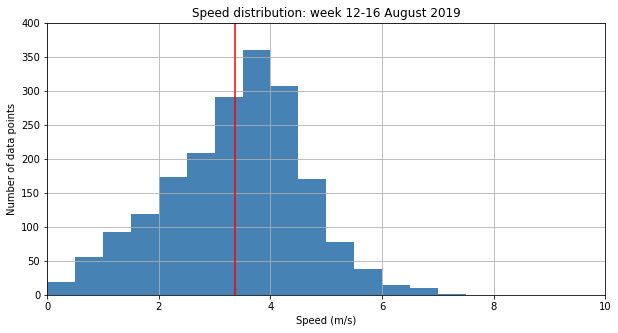

In [43]:
#The velocity distribution in the model: as you can see, average velocities > 6 m/s are not common

fig, ax = plt.subplots(figsize =(10, 5)) 
ax.hist(vessel_db.average_speed, bins = [0, 0.5, 1, 1.5, 2, 2.5, 3, 3.5, 4, 4.5, 5, 5.5, 6, 6.5, 7, 7.5, 8, 8.5, 9, 9.5, 10, 10.5, 11, 11.5, 12], color = 'steelblue')
plt.xlabel('Speed (m/s)')
plt.ylabel('Number of data points')
plt.title('Speed distribution: week 12-16 August 2019')
plt.grid()
plt.xlim(0,10)
plt.ylim(0, 400)
plt.axvline(vessel_db.average_speed.mean(), 0, 140000, color='red')
plt.show()

In [44]:
pd.options.mode.chained_assignment = None #To avoid a warning that you try to set a copy on a slice in the dataframe

In [45]:
df_high_speed = vessel_db[vessel_db['average_speed'] > 6.5]
print('There are', len(df_high_speed), 'ships in this dataset that have an average speed higher than 6.5 m/s')

There are 11 ships in this dataset that have an average speed higher than 6.5 m/s


### 3.2 Remove / change some data from the vessel database

In [46]:
#Remove average speeds that are higher than 6.5 m/s

vessel_db = vessel_db[vessel_db['average_speed'] < 6.5]

In [47]:
#The model does not work properly for really big ships with a relatively small draft
#This are not that much ships
#The draft of these large ships has been assumed to be equal to 3 if it was lower than 3

def filter_function_T(row):
    if row['L'] > 180:
        if row['T_e'] < 3:
            return 3
        else:
            return row['T_e']
    else:
        return row['T_e']

In [48]:
vessel_db['T_e'] = vessel_db.apply(filter_function_T, axis = 1)

In [49]:
#Information is added about if the ship is sailing northward or southward
#This is needed later on, in determining the route of the ship

vessel_db['direction'] = 'southward'

for i in range(len(vessel_db)):
    if vessel_db['latitude_O'].iloc[i] < vessel_db['latitude_D'].iloc[i]:
        vessel_db['direction'][i] = 'northward'

### 3.3 The vessel database

In [50]:
# Add fields that are necessary for adding data to the vessel attribute
vessel_db['T_f'] = vessel_db['T_e']
vessel_db['C_b'] = 0.85

#Please note that the values below are not used in the model - these are dummy values
vessel_db['capacity'] = 1000
vessel_db['H_e'] = 10
vessel_db['H_f'] = 5

In [51]:
# This table prsents all the information of the vessel_db resulting from the OD_matrix from AIS
vessel_db.head()

,shipname,latitude_O,longitude_O,L,B,T_e,RWS classification,P_installed,L_w,P_stat,...,Oude maas,Scheldt-Rhine,Zuid-Beveland,time_diff,T_f,direction,C_b,capacity,H_e,H_f
0,testschip-1002,51.885433,4.455268,52.5,6.0,2.3,M2,300,1,16,...,0,0,0,18827.0,2.3,southward,0.85,1000,10,5
1,testschip-1002-1,51.881367,4.444135,52.5,6.0,2.3,M2,300,1,16,...,0,0,0,39589.0,2.3,northward,0.85,1000,10,5
2,testschip-1002-2,51.885376,4.455358,52.5,6.0,2.3,M2,300,1,16,...,0,0,0,45802.0,2.3,northward,0.85,1000,10,5
3,testschip-1002-1-2,51.901802,4.382178,52.5,6.0,2.3,M2,300,1,16,...,0,0,0,51803.0,2.3,southward,0.85,1000,10,5
4,testschip-1008,51.884151,4.421427,110.0,14.0,3.3,M10,2400,3,81,...,0,0,0,27371.0,3.3,northward,0.85,1000,10,5


In [52]:
def calculate_engine_age(row):
        """Calculating the construction year of the engine, dependend on a Weibull function with 
        shape factor 'k', and scale factor 'lmb', which are determined by the weight class L_w"""
        
        #Determining which shape and scale factor to use, based on the weight class L_w = L1, L2 or L3
        if row['L_w'] == 1:     #Weight class L1
            k = 1.3
            lmb = 20.5
            age = int(np.random.weibull(k)*lmb) #age of engine
        elif row['L_w'] == 2:     #Weight class L2
            k = 1.12
            lmb = 18.5
            age = int(np.random.weibull(k)*lmb) #age of engine
        elif row['L_w'] == 3:     #Weight class L3
            k = 1.26
            lmb = 18.6
            age = int(np.random.weibull(k)*lmb) #age of engine
            

        #Current year (TO DO: fix hardcoded year)
        #self.year = datetime.date.year
        year = 2021
        
        #Construction year of the engine
        c_year = year - age
        
        return c_year

In [53]:
np.random.seed(4)

vessel_db['c_year'] = vessel_db.apply(calculate_engine_age, axis = 1)

In [54]:
vessel_db.head()

,shipname,latitude_O,longitude_O,L,B,T_e,RWS classification,P_installed,L_w,P_stat,...,Scheldt-Rhine,Zuid-Beveland,time_diff,T_f,direction,C_b,capacity,H_e,H_f,c_year
0,testschip-1002,51.885433,4.455268,52.5,6.0,2.3,M2,300,1,16,...,0,0,18827.0,2.3,southward,0.85,1000,10,5,1969
1,testschip-1002-1,51.881367,4.444135,52.5,6.0,2.3,M2,300,1,16,...,0,0,39589.0,2.3,northward,0.85,1000,10,5,2004
2,testschip-1002-2,51.885376,4.455358,52.5,6.0,2.3,M2,300,1,16,...,0,0,45802.0,2.3,northward,0.85,1000,10,5,1967
3,testschip-1002-1-2,51.901802,4.382178,52.5,6.0,2.3,M2,300,1,16,...,0,0,51803.0,2.3,southward,0.85,1000,10,5,1997
4,testschip-1008,51.884151,4.421427,110.0,14.0,3.3,M10,2400,3,81,...,0,0,27371.0,3.3,northward,0.85,1000,10,5,2000


### 3.4 Create a vessel object with the new mixins, and use this in the vessel generator

In [55]:
#All vessels from the vessel_db are added to the fleet

fleet = {}

for i in range(len(vessel_db)):
    fleet[i] = {'shipname': vessel_db['shipname'].iloc[i], 
                'start_point': shapely.geometry.Point(vessel_db['longitude_O'].iloc[i], vessel_db['latitude_O'].iloc[i]), 
                'end_point': shapely.geometry.Point(vessel_db['longitude_D'].iloc[i], vessel_db['latitude_D'].iloc[i])
               }

In [56]:
# Make a class out of mix-ins
TransportResource = type('TransportResource', 
                         (opentnsim.core.Identifiable, opentnsim.core.ContainerDependentMovable, 
                          opentnsim.core.HasResource, opentnsim.core.Routeable, 
                          VesselProperties, ConsumesEnergy), {})


#In the function below, we work with a fixed velocity, which results from the vessel database and varies per ship

def compute_v_provider(v_empty, v_full):
    return lambda x: v_empty 

In [57]:
vessels = []

vessel_delay = []

vessel_name_list = []

RWS_class_list = []

for ship in fleet:
    
    # identify which vessel type to extract from the vessel database (change the name to change the vessel used)
    vessel_name = fleet[ship]['shipname'] 

    # Add environment, start and end location to the vessel
    start_point = find_closest_node(FG_sim, fleet[ship]['start_point'])[0]
    end_point = find_closest_node(FG_sim, fleet[ship]['end_point'])[0]
    
    # Waterways that can be crossed
    maassluis = 8861158.0
    nieuwe_maas = 'B12602_B'
    oude_maas = find_closest_node(FG_sim, shapely.geometry.Point(4.574982, 51.808892))[0]
    scheldt_rhine = find_closest_node(FG_sim, shapely.geometry.Point(4.222012, 51.568345))[0]
    zuid_beveland = find_closest_node(FG_sim, shapely.geometry.Point(4.004463, 51.489940))[0]
    
    # Nodes northward and southward of the waterway sections above  
    maassluis_north = 8861674.0
    nieuwe_maas_north = 8866022.0
    oude_maas_north = 8867023.0
    scheldt_rhine_north = 'B37463_A'
    zuid_beveland_north = 'B21452_A'
    
    maassluis_south = 8861716.0
    nieuwe_maas_south = 'B12602_A'
    oude_maas_south = 8866899.0
    scheldt_rhine_south = 'B9108_A'
    zuid_beveland_south = 'B49592_A'
    
    #These values indicate if the vessel considered is crossing one of these waterway setions (if yes, value = 1)
    value_maassluis = vessel_db[vessel_db['shipname']==vessel_name]['Maassluis'].values[0]
    value_nieuwe_maas = vessel_db[vessel_db['shipname']==vessel_name]['Nieuwe maas'].values[0]
    value_oude_maas = vessel_db[vessel_db['shipname']==vessel_name]['Oude maas'].values[0]
    value_scheldt_rhine = vessel_db[vessel_db['shipname']==vessel_name]['Scheldt-Rhine'].values[0]
    value_zuid_beveland = vessel_db[vessel_db['shipname']==vessel_name]['Zuid-Beveland'].values[0]
    
    #This value indicates if the vessel is sailing northwards or southwards
    value_direction = vessel_db[vessel_db['shipname']==vessel_name]['direction'].values[0]
    

    #In the following code, the path of the vessel is determined according to the dijkstra algorithm
    #Since dijkstra takes the shortest path, and inland vessels do not always do that, the trajectory had to be cutted
    #Based on the 'crucial' waterway sections defined
    #If they cross one of them, this node is added to the route
    
    
    # In case not 1 of the waterways is crossed
    
    if value_maassluis + value_nieuwe_maas + value_oude_maas + value_scheldt_rhine + value_zuid_beveland == 0:
            path = nx.dijkstra_path(FG_sim, start_point, end_point, weight='length')
    
    # In case maassluis is crossed 
    
    elif value_maassluis != 0:
        if value_direction == 'northward':
            
            if value_nieuwe_maas + value_oude_maas + value_scheldt_rhine + value_zuid_beveland == 0:
                path = nx.dijkstra_path(FG_sim, start_point, maassluis, weight='length') + nx.dijkstra_path(FG_sim, maassluis_north, end_point, weight='length')
            elif value_nieuwe_maas > 0:
                path = nx.dijkstra_path(FG_sim, start_point, nieuwe_maas, weight='length') + nx.dijkstra_path(FG_sim, nieuwe_maas_north, maassluis, weight='length') + nx.dijkstra_path(FG_sim, maassluis_north, end_point, weight='length')
            elif value_oude_maas > 0:
                if value_scheldt_rhine > 0:
                    path = nx.dijkstra_path(FG_sim, start_point, scheldt_rhine, weight='length') + nx.dijkstra_path(FG_sim, scheldt_rhine_north, oude_maas, weight='length') + nx.dijkstra_path(FG_sim, oude_maas_north, maassluis, weight='length') + nx.dijkstra_path(FG_sim, maassluis_north, end_point, weight='length')
                else:
                    path = nx.dijkstra_path(FG_sim, start_point, oude_maas, weight='length') + nx.dijkstra_path(FG_sim, oude_maas_north, maassluis, weight='length') + nx.dijkstra_path(FG_sim, maassluis_north, end_point, weight='length')
                    
        if value_direction == 'southward':
            
            if value_nieuwe_maas + value_oude_maas + value_scheldt_rhine + value_zuid_beveland == 0:
                path = nx.dijkstra_path(FG_sim, start_point, maassluis, weight='length') + nx.dijkstra_path(FG_sim, maassluis_south, end_point, weight='length')
            elif value_nieuwe_maas > 0:
                path = nx.dijkstra_path(FG_sim, start_point, maassluis, weight='length') + nx.dijkstra_path(FG_sim, maassluis_south, nieuwe_maas, weight='length') + nx.dijkstra_path(FG_sim, nieuwe_maas_south, end_point, weight='length')
            elif value_oude_maas > 0:
                if value_scheldt_rhine > 0:
                    path = nx.dijkstra_path(FG_sim, start_point, maassluis, weight='length') + nx.dijkstra_path(FG_sim, maassluis_south, oude_maas, weight='length') + nx.dijkstra_path(FG_sim, oude_maas_south, scheldt_rhine, weight='length') + nx.dijkstra_path(FG_sim, scheldt_rhine_south, end_point, weight='length')
                else:
                    path = nx.dijkstra_path(FG_sim, start_point, maassluis, weight='length') + nx.dijkstra_path(FG_sim, maassluis_south, oude_maas, weight='length') + nx.dijkstra_path(FG_sim, oude_maas_south, end_point, weight='length')
                    
    
    
    # In case at least 1 of the other waterways is crossed
        
    elif value_nieuwe_maas + value_oude_maas + value_scheldt_rhine + value_zuid_beveland > 0:
        
        if value_direction == 'northward':
            
        # In case that the nieuwe/oude maas are not crossed, but the scheldt-rhine canal or zuid-beveland canal are:
            
            if value_nieuwe_maas + value_oude_maas == 0:
                if value_scheldt_rhine == 1:
                    path = nx.dijkstra_path(FG_sim, start_point, scheldt_rhine, weight='length') + nx.dijkstra_path(FG_sim, scheldt_rhine_north, end_point, weight='length')
                elif value_zuid_beveland == 1:
                    path = nx.dijkstra_path(FG_sim, start_point, zuid_beveland, weight='length') + nx.dijkstra_path(FG_sim, zuid_beveland_north, end_point, weight='length')

            # In case the scheldt-rhine canal or zuid-beveland canal are not crossed, but the nieuwe/oude maas are:

            elif value_scheldt_rhine + value_zuid_beveland == 0:
                if value_nieuwe_maas == 1:
                    path = nx.dijkstra_path(FG_sim, start_point, nieuwe_maas, weight='length') + nx.dijkstra_path(FG_sim, nieuwe_maas_north, end_point, weight='length')
                elif value_oude_maas == 1:
                    path = nx.dijkstra_path(FG_sim, start_point, oude_maas, weight='length') + nx.dijkstra_path(FG_sim, oude_maas_north, end_point, weight='length')

            # In case the scheldt-rhine or zuid-beveland canal AND the nieuwe/oude maas are crossed:
            else:

                if value_scheldt_rhine + value_nieuwe_maas > 1:
                    path = nx.dijkstra_path(FG_sim, start_point, scheldt_rhine, weight='length') + nx.dijkstra_path(FG_sim, scheldt_rhine_north, nieuwe_maas, weight='length') + nx.dijkstra_path(FG_sim, nieuwe_maas_north, end_point, weight='length')
                elif value_scheldt_rhine + value_oude_maas > 1:
                    path = nx.dijkstra_path(FG_sim, start_point, scheldt_rhine, weight='length') + nx.dijkstra_path(FG_sim, scheldt_rhine_north, oude_maas, weight='length') + nx.dijkstra_path(FG_sim, oude_maas_north, end_point, weight='length')
                elif value_zuid_beveland + value_nieuwe_maas > 1:
                    path = nx.dijkstra_path(FG_sim, start_point, zuid_beveland, weight='length') + nx.dijkstra_path(FG_sim, zuid_beveland_north, nieuwe_maas, weight='length') + nx.dijkstra_path(FG_sim, nieuwe_maas_north, end_point, weight='length')
                elif value_zuid_beveland + value_oude_maas > 1:
                    path = nx.dijkstra_path(FG_sim, start_point, zuid_beveland, weight='length') + nx.dijkstra_path(FG_sim, zuid_beveland_north, oude_maas, weight='length') + nx.dijkstra_path(FG_sim, oude_maas_north, end_point, weight='length')  
            

                
        elif value_direction == 'southward':
            
        # In case that the nieuwe/oude maas not crossed, but the scheldt-rhine canal or zuid-beveland canal are:
            
            if value_nieuwe_maas + value_oude_maas == 0:
                if value_scheldt_rhine == 1:
                    path = nx.dijkstra_path(FG_sim, start_point, scheldt_rhine, weight='length') + nx.dijkstra_path(FG_sim, scheldt_rhine_south, end_point, weight='length')
                elif value_zuid_beveland == 1:
                    path = nx.dijkstra_path(FG_sim, start_point, zuid_beveland, weight='length') + nx.dijkstra_path(FG_sim, zuid_beveland_south, end_point, weight='length')

            # In case the scheldt-rhine canal or zuid-beveland canal are not crossed, but the nieuwe/oude maas are:

            elif value_scheldt_rhine + value_zuid_beveland == 0:
                if value_nieuwe_maas == 1:
                    path = nx.dijkstra_path(FG_sim, start_point, nieuwe_maas, weight='length') + nx.dijkstra_path(FG_sim, nieuwe_maas_south, end_point, weight='length')
                elif value_oude_maas == 1:
                    path = nx.dijkstra_path(FG_sim, start_point, oude_maas, weight='length') + nx.dijkstra_path(FG_sim, oude_maas_south, end_point, weight='length')
        
            
            # In case the scheldt-rhine or zuid-beveland canal AND the nieuwe/oude maas are crossed:
            else:
                if value_nieuwe_maas + value_scheldt_rhine  > 1:
                    path = nx.dijkstra_path(FG_sim, start_point, nieuwe_maas, weight='length') + nx.dijkstra_path(FG_sim, nieuwe_maas_south, scheldt_rhine, weight='length') + nx.dijkstra_path(FG_sim, scheldt_rhine_south, end_point, weight='length')
                elif value_oude_maas + value_scheldt_rhine > 1:
                    path = nx.dijkstra_path(FG_sim, start_point, oude_maas, weight='length') + nx.dijkstra_path(FG_sim, oude_maas_south, scheldt_rhine, weight='length') + nx.dijkstra_path(FG_sim, scheldt_rhine_south, end_point, weight='length')
                elif value_nieuwe_maas + value_zuid_beveland > 1:
                    path = nx.dijkstra_path(FG_sim, start_point, nieuwe_maas, weight='length') + nx.dijkstra_path(FG_sim, nieuwe_maas_south, zuid_beveland, weight='length') + nx.dijkstra_path(FG_sim, zuid_beveland_south, end_point, weight='length')
                elif value_oude_maas + value_zuid_beveland > 1:
                    path = nx.dijkstra_path(FG_sim, start_point, oude_maas, weight='length') + nx.dijkstra_path(FG_sim, oude_maas_south, zuid_beveland, weight='length') + nx.dijkstra_path(FG_sim, zuid_beveland_south, end_point, weight='length')  
                
    delay = vessel_db[vessel_db['shipname']==vessel_name]['time_diff'].values[0]
    
    print(vessel_name)
    print(path)
    
    # prepare data for the vessel
    data_vessel = {"env": env,
                   #"name": "Vessel number " + str(ship),
                   "name":  vessel_db[vessel_db['shipname']==vessel_name]['shipname'].values[0],
                   "route": path,
                   "geometry": FG_sim.nodes[start_point]['geometry'],  # lon, lat
                   "capacity": vessel_db[vessel_db['shipname']==vessel_name]['capacity'].values[0],
                   "compute_v": compute_v_provider(v_empty=vessel_db[vessel_db['shipname']==vessel_name]['average_speed'].values[0], v_full=vessel_db[vessel_db['shipname']==vessel_name]['average_speed'].values[0]),
                   #"compute_v": vessel_db[vessel_db['shipname']==vessel_name]['average_speed'].values[0],
                   "type": vessel_db[vessel_db['shipname']==vessel_name]['RWS classification'].values[0],
                   "B": vessel_db[vessel_db['shipname']==vessel_name]['B'].values[0],
                   "L": vessel_db[vessel_db['shipname']==vessel_name]['L'].values[0],
                   "H_e": vessel_db[vessel_db['shipname']==vessel_name]['H_e'].values[0],
                   "H_f": vessel_db[vessel_db['shipname']==vessel_name]['H_f'].values[0],
                   "T_e": vessel_db[vessel_db['shipname']==vessel_name]['T_e'].values[0],
                   "T_f": vessel_db[vessel_db['shipname']==vessel_name]['T_f'].values[0],
                   "P_installed": vessel_db[vessel_db['shipname']==vessel_name]['P_installed'].values[0],
                   "P_stat": vessel_db[vessel_db['shipname']==vessel_name]['P_stat'].values[0],
                   "c_year": vessel_db[vessel_db['shipname']==vessel_name]['c_year'].values[0],
                   "L_w": vessel_db[vessel_db['shipname']==vessel_name]['L_w'].values[0],
                   "C_b": vessel_db[vessel_db['shipname']==vessel_name]['C_b'].values[0],
                  }
    if len(path)>1:
        # create the transport processing resource
        vessel_delay.append(delay)
        vessels.append(TransportResource(**data_vessel))
        vessel_name_list.append(vessel_db[vessel_db['shipname']==vessel_name]['shipname'].values[0])
        RWS_class_list.append(vessel_db[vessel_db['shipname']==vessel_name]['RWS classification'].values[0])
    
    #info.append(data_vessel)

testschip-1002
[8865264.0, 8865997.0, 8860787.0, 8864192.0, 8860954.0]
testschip-1002-1
[8860954.0, 8864192.0]
testschip-1002-2
[8861248.0, 8864192.0, 8860787.0, 8865997.0, 8860840.0, 8865972.0, 8861926.0, 8861552.0, 8860727.0, 8866900.0, 8865575.0, 8865385.0, 8865205.0, 8860668.0, 8865086.0, 8867672.0, 8861973.0, 8861986.0, 8863988.0, 8865942.0, 8866520.0, 8866182.0, 8861736.0, 8862750.0]
testschip-1002-1-2
[8862750.0, 8861736.0, 8866182.0, 8866520.0, 8865942.0, 8863988.0, 8861986.0, 8861973.0, 8867672.0, 8865086.0, 8860668.0, 8865205.0, 8865385.0, 8865575.0, 8866900.0, 8860727.0, 8861552.0, 8861926.0, 8865972.0, 8860840.0, 8865997.0, 8865264.0]
testschip-1008
[8862958.0, 8865151.0, 8866520.0, 8866182.0, 8861736.0, 8863496.0, 8863982.0]
testschip-1008-1
[8862087.0, 8863982.0, 8863496.0, 8863206.0, 8868239.0, 8864482.0, 8863623.0, 8862585.0, 8861716.0, 'B17838816_B', 'B17838816_A', 8865803.0, 8862143.0, 'B42792_B', 'B42792_A', 8867784.0, 8864737.0, 8867023.0, 8863810.0, 8866899.0, 8867

testschip-1064
['B48157_B', 'B48157_A', 8862138.0, 'FN317']
testschip-1067
[8860733.0, 'B45677_A', 8862239.0, 'B28977_B', 'B28977_A', 'B28203_B', 'B28203_A', 'S13154_B', 'S13154_A', 'B25254429_B', 'B25254429_A', 8865732.0, 8861674.0, 8861158.0, 8861716.0, 'B17838816_B', 'B17838816_A', 8865803.0, 8863200.0, 'B44072_A', 'B44072_B', 'S38127_A', 'S38127_B', 8867029.0, 8867154.0, 8861414.0, 8867008.0, 8866992.0, 'B7951_A', 'B7951_B', 'L4199_A', 'B27780191_A', 'B27780191_B', 8867741.0, 'B57361_A', 'B57361_B', 8860614.0, 'B5729_A', 'B5729_B', 8867449.0]
testschip-1067-1
[8867449.0, 'B5729_B', 'B5729_A', 8860614.0, 'B57361_B', 'B57361_A', 8867741.0, 'B27780191_B', 'B27780191_A', 'L4199_A', 'B7951_B', 'B7951_A', 8866992.0, 8867008.0, 8861414.0, 8867154.0, 8867029.0, 'B23888_B', 'B23888_A', 'L6951_B', 'L6951_A', 8863200.0, 8865803.0, 'B17838816_A', 'B17838816_B', 8861716.0, 8861158.0, 8861674.0, 8865732.0]
testschip-1081
[8862130.0, 8860742.0, 8862763.0, 8863979.0, 8867745.0, 8863119.0, 8860725.

testschip-1150
[8863475.0, 8865217.0, 8860596.0, 8867980.0, 8867547.0, 8861158.0, 8861716.0, 'B17838816_B', 'B17838816_A', 8865803.0, 8863200.0, 'B44072_A', 'B44072_B', 'S38127_A', 'S38127_B', 8867029.0, 8867154.0, 8861414.0, 8867008.0, 8866992.0, 'B7951_A', 'B7951_B', 'L4199_A', 'B27780191_A', 'B27780191_B', 8867741.0, 'B57361_A', 'B57361_B', 8860614.0, 'B5729_A', 'B5729_B', 8867449.0, 8864085.0, 8861610.0]
testschip-1150-1
[8861610.0, 8864085.0, 8867449.0, 'B5729_B', 'B5729_A', 8860614.0, 'B57361_B', 'B57361_A', 8867741.0, 'B27780191_B', 'B27780191_A', 'L4199_A', 'B7951_B', 'B7951_A', 8866992.0, 8867008.0, 8861414.0, 8867154.0]
testschip-1165
[8865217.0, 8860596.0, 8867980.0, 8866999.0, 8866859.0]
testschip-117
['B7438_A', 8865140.0, 8867500.0, 8863742.0, 8867374.0]
testschip-117-1
[8863742.0, 8867500.0, 8865140.0, 8866736.0]
testschip-1177
[8866859.0, 8866999.0, 8867980.0, 8867547.0, 8861158.0, 8861716.0, 8862585.0, 8863623.0, 8864482.0, 8868239.0, 8863206.0, 8863496.0, 8861736.0, 8

testschip-1241
[8863131.0, 8867986.0, 8864067.0]
testschip-1246
[8862490.0, 8862663.0, 8864989.0, 8867957.0, 8860725.0, 'B29137_B', 'B29137_A', 'B43966_B', 'B43966_A', 'B6652_B', 'B6652_A', 8861698.0, 22638259.0]
testschip-125
[8863941.0, 8862332.0, 8867449.0, 'B5729_B', 'B5729_A', 8860614.0, 'B57361_B', 'B57361_A', 8867741.0, 'B27780191_B', 'B27780191_A', 'L4199_A', 'B7951_B', 'B7951_A', 8866992.0, 8867008.0, 8861414.0, 8867154.0, 8867029.0, 'B23888_B', 'B23888_A', 'L6951_B', 'L6951_A', 8863200.0, 8865803.0, 8862143.0, 'B42792_B', 'B42792_A', 8867784.0, 8864737.0, 8867023.0, 8863810.0, 8866899.0, 8867922.0, 8867119.0, 8863665.0, 8866472.0, 8865003.0, 8865128.0, 8863166.0, 'B19218_B', 'B19218_A', 'B55925_B', 'B55925_A', 8866573.0, 8860833.0, 8864207.0, 8862369.0, 8862016.0, 8863131.0]
testschip-1252
[8864229.0, 8866736.0, 8865140.0, 8867500.0, 8863742.0, 8867588.0, 8861191.0, 'B4308_A', 'B4308_B', 8861193.0, 8866439.0, 8864009.0, 8863306.0, 'B12602_A', 'B12602_B', 8866022.0, 'B4705_A',

testschip-1321
[8868426.0, 8866727.0, 8865019.0, 8864258.0, 8864774.0, 8867060.0, 8865797.0, 8862801.0, 8864138.0, 'B30667_A', 'B30667_B', 'B37463_A', 'B37463_B', 'B9108_A', 'B9108_B', 8867083.0, 8868133.0, 8866632.0, 8868095.0, 8865574.0, 8868181.0, 8861380.0, 'B43908_A', 'B43908_B', 'L9305_A', 'L9305_B', 'B30870_A', 'B30870_B', 8867425.0, 'B20349_A', 'B20349_B', 'B18485_A', 'B18485_B', 'B41640_A', 'B41640_B', 'B25636_A', 'B25636_B', 'B22796_A', 'B22796_B', 26520070.0, 'B41483_A', 'B41483_B', 8862138.0, 'FN317']
testschip-1324
[8863982.0, 8863496.0, 8863206.0, 8868239.0, 8864482.0, 8863623.0, 8862585.0, 8861716.0, 'B17838816_B', 'B17838816_A', 8865803.0, 8862143.0, 'B42792_B', 'B42792_A', 8867784.0, 8864737.0, 8867023.0, 8863810.0, 8866899.0, 8867922.0, 8867119.0, 8863665.0, 8866472.0, 8865003.0, 8865128.0, 8863166.0, 26519918.0]
testschip-1324-1
['B19218_B', 'B19218_A', 'B55925_B', 'B55925_A', 8866573.0, 8860833.0, 8864207.0, 8862369.0, 8862016.0, 8863131.0, 8867986.0, 8864067.0]
tes

testschip-136-1
[8868404.0, 'B44477_A', 'B44477_B', 8860798.0, 8862611.0, 'B9536_A', 'B9536_B', 'B3563_A', 'B3563_B', 'B6597_A', 'B6597_B', 'B14037_A', 'B14037_B', 8864417.0, 8866694.0, 'B32420_A', 'B32420_B', 'B50290_A', 'B50290_B', 8861753.0, 'L57066_A', 'L57066_B', 'B57921_A', 'B57921_B', 'Berth26', 8866388.0, 8861047.0]
testschip-1365
['B7438_A', 8865140.0, 8866686.0, 8861666.0, 'B43523_B', 'B43523_A', 8863048.0, 8866570.0, 8863131.0, 8862016.0, 8862369.0, 8864207.0, 8860833.0, 8866573.0, 'B55925_A', 'B55925_B', 'B19218_A', 'B19218_B', 8863166.0, 8865128.0, 8865003.0, 8866472.0, 8863665.0, 8867119.0, 8867922.0, 8866899.0, 8863810.0, 8867023.0, 8864737.0, 8867784.0, 'B42792_A', 'B42792_B', 8862143.0, 8865803.0, 'B17838816_A', 'B17838816_B', 8861716.0, 8861158.0, 8861716.0, 8862585.0, 8863623.0, 8864482.0, 8868239.0, 8863206.0, 8863496.0, 8861736.0, 8866182.0, 8866520.0, 8865942.0, 8863988.0, 8861986.0, 8861973.0, 8867672.0, 8865086.0, 8860668.0, 8865205.0, 8865385.0, 8865818.0, 8865

testschip-1425
[8861142.0, 8863829.0, 8863979.0, 8867745.0, 8863119.0, 8860725.0, 8862132.0, 8866352.0, 8862228.0, 8860743.0, 8862498.0, 'L42863_A', 'L42863_B', 'B34113_A', 'B34113_B', 8868426.0, 8866727.0, 8865019.0, 8864258.0, 8864774.0, 8867060.0, 8865797.0, 8862801.0, 8864138.0, 'B30667_A', 'B30667_B', 'B37463_A', 'B37463_B', 'B9108_A', 'B9108_B', 8867083.0, 8868133.0, 8866632.0, 8868095.0, 8865574.0, 8868181.0, 8861380.0, 'B43908_A', 'B43908_B', 'L9305_A', 'L9305_B', 'B30870_A', 'B30870_B', 8867425.0, 'B20349_A', 'B20349_B', 'B18485_A', 'B18485_B', 'B41640_A', 'B41640_B', 'B25636_A', 'B25636_B', 'B22796_A', 'B22796_B', 26520070.0, 'B41483_A', 'B41483_B', 8862138.0, 'FN317']
testschip-1425-1
['FN317', 8862138.0, 'B48157_A', 'B48157_B', 'L12738_A', 'B17483_A', 'B17483_B']
testschip-1426
[8862757.0, 8866689.0, 8865151.0, 8866520.0, 8866182.0, 8861736.0, 8863496.0, 8863206.0, 8868239.0, 8864482.0, 8863623.0, 8862585.0, 8861716.0, 'B17838816_B', 'B17838816_A', 8865803.0, 8863200.0, 'B4

testschip-1455-1
[8867449.0, 'B5729_B', 'B5729_A', 8860614.0, 'B57361_B', 'B57361_A', 8867741.0, 'B27780191_B', 'B27780191_A', 'L4199_A', 'B7951_B', 'B7951_A', 8866992.0, 8867008.0, 8861414.0, 8867154.0, 8867029.0, 'B23888_B', 'B23888_A', 'L6951_B', 'L6951_A', 8863200.0, 8865803.0, 'B17838816_A', 'B17838816_B', 8861716.0, 8861158.0, 8861716.0, 8862585.0, 8863623.0, 8864482.0, 8868239.0, 8863206.0, 8863496.0, 8861736.0, 8866182.0, 8866520.0, 8865151.0, 8866689.0, 8862757.0, 8863191.0]
testschip-1465
[8868426.0, 8866727.0, 8865019.0, 8864258.0, 8864774.0, 8867060.0, 8865797.0, 8862801.0, 8864138.0, 'B30667_A', 'B30667_B', 'B37463_A', 'B37463_B', 'B9108_A', 'B9108_B', 8867083.0, 8868133.0, 8866632.0, 8868095.0, 8865574.0, 8868181.0, 8861380.0, 'B43908_A', 'B43908_B', 'L9305_A', 'L9305_B', 'B30870_A', 'B30870_B', 8867425.0, 'B20349_A', 'B20349_B', 'B18485_A', 'B18485_B', 'B41640_A', 'B41640_B', 'B25636_A', 'B25636_B', 'B22796_A', 'B22796_B', 26520070.0, 'B41483_A', 'B41483_B', 8862138.0, '

testschip-1517
[8861503.0, 8865003.0, 8865128.0, 8863166.0, 'B19218_B', 'B19218_A', 'B55925_B', 'B55925_A', 8866573.0, 8860833.0, 8864207.0, 8862369.0, 8862016.0, 8863131.0, 8867986.0, 8864067.0]
testschip-1518
[8864067.0, 8867986.0, 8863131.0, 8862016.0, 8862369.0, 8864207.0, 8860833.0, 8866573.0, 'B55925_A', 'B55925_B', 'B19218_A', 'B19218_B', 8863166.0, 8865128.0, 8865003.0, 8866472.0, 8863665.0, 8867119.0, 8867922.0, 8866899.0, 8863810.0, 8867023.0, 8864737.0, 8867784.0, 'B42792_A', 'B42792_B', 8862143.0, 8865803.0, 8863200.0, 'B44072_A', 'B44072_B', 'S38127_A', 'S38127_B', 8867029.0, 8867154.0, 8863786.0]
testschip-1519
['Berth9', 8862842.0, 8864490.0, 'B25858_A', 'B25858_B', 'L13242_A', 8868417.0, 'B16181_A', 'B16181_B', 8863469.0, 8863755.0, 8864039.0]
testschip-152
['B57361_A', 'B57361_B', 8860614.0, 8864283.0]
testschip-152-1
[8860614.0, 'B57361_B', 'B57361_A', 8867741.0, 'B27780191_B', 'B27780191_A', 'L4199_A', 'B7951_B', 'B7951_A', 8866992.0, 8867008.0, 8861414.0, 8867154.0,

testschip-1545-1
[8860727.0, 8866900.0, 8865575.0, 8865385.0, 8865818.0, 8865302.0, 8860697.0, 8861233.0, 8867789.0, 8860903.0, 8866388.0, 8861047.0, 8863104.0, 8867528.0, 8863710.0, 'B4705_B', 'B4705_A', 8866022.0, 'B12602_B', 8866022.0, 'B12602_B', 'B12602_A', 8863306.0, 8864009.0, 8866439.0, 8861193.0, 'B4308_B', 'B4308_A', 8861191.0, 8867588.0, 8863742.0, 8867500.0, 8865140.0, 8866736.0, 8864229.0]
testschip-1547
[22638259.0, 8861698.0, 'B6652_A', 'B6652_B', 'B43966_A', 'B43966_B', 'B29137_A', 'B29137_B', 8860725.0, 8862132.0, 8866352.0, 8862228.0, 8860743.0, 8862498.0, 'L42863_A', 'L42863_B', 'B34113_A', 'B34113_B', 8868426.0, 8866727.0, 8865019.0, 8864258.0, 8864774.0, 8867060.0, 8865797.0, 8862801.0, 8864138.0, 'B30667_A', 'B30667_B', 'B37463_A', 'B37463_B', 'B9108_A', 'B9108_B', 8867083.0, 8868133.0, 8866632.0, 8868095.0, 8865574.0, 8868181.0, 8861380.0, 'B43908_A', 'B43908_B', 'L9305_A', 'L9305_B', 'B30870_A', 'B30870_B', 8867425.0, 'B20349_A', 'B20349_B', 'B18485_A', 'B18485_

testschip-1583
[8866940.0, 'B49727_A', 'B49727_B', 'L25235_A', 'L25235_B', 'B2898_A', 'B2898_B', 8863537.0, 8861696.0, 8860620.0, 8865869.0, 8863814.0, 8867824.0, 8866868.0, 8864671.0, 8866800.0, 8861243.0, 8862858.0, 8863105.0, 8864039.0]
testschip-1583-1
[8865457.0, 8862975.0, 8864157.0, 8867824.0, 8863814.0, 8865869.0, 8860620.0, 8861696.0]
testschip-1593
[8861696.0, 8860620.0, 8865869.0, 8866898.0, 8860763.0, 8861857.0, 8865528.0]
testschip-1594
[8868404.0, 'B44477_A', 'B44477_B', 8860798.0, 8862611.0, 'B9536_A', 'B9536_B', 'B3563_A', 'B3563_B', 'B6597_A', 'B6597_B', 'B14037_A', 'B14037_B', 8864417.0, 8866694.0, 'B32420_A', 'B32420_B', 'B50290_A', 'B50290_B', 8861753.0, 'L57066_A', 'L57066_B', 'B57921_A', 'B57921_B', 'Berth26', 8866388.0, 8860903.0, 8867789.0, 8861233.0, 8860697.0, 8865302.0, 8865818.0, 8865385.0, 8865205.0, 8860668.0, 8865086.0, 8867672.0, 8861973.0, 8861986.0, 8863988.0, 8865942.0, 8866520.0, 8866182.0, 8861736.0, 8863496.0, 8863206.0, 8868239.0, 8864482.0, 88636

testschip-1633-1
['B17483_B', 8861333.0, 8865842.0, 8866093.0, 8861885.0, 8865131.0, 8860763.0, 8866898.0, 8865869.0, 8863814.0, 8867824.0, 8866868.0, 8864671.0, 8866800.0, 8861243.0, 8862858.0, 8863105.0, 8864039.0]
testschip-1637
[8866800.0, 8864671.0, 8866868.0, 8867824.0, 8863814.0, 8865869.0, 8866898.0, 8860763.0, 8865131.0, 8861885.0, 8866093.0, 8865842.0, 8861333.0]
testschip-1638
[8867449.0, 'B5729_B', 'B5729_A', 8860614.0, 'B57361_B', 'B57361_A', 8867741.0, 'B27780191_B', 'B27780191_A', 'L4199_A', 'B7951_B', 'B7951_A', 8866992.0, 8867008.0, 8861414.0, 8867154.0, 8867029.0, 'B23888_B', 'B23888_A', 'L6951_B', 'L6951_A', 8863200.0, 8865803.0, 'B17838816_A', 'B17838816_B', 8861716.0, 8861158.0, 8861716.0, 8861158.0, 8867547.0, 8867980.0, 8860596.0, 8865217.0, 8863475.0, 8868083.0, 8861732.0, 8860615.0]
testschip-1641
[8867170.0, 8864009.0, 8863306.0, 'B12602_A', 'B12602_B', 'B12602_A', 'B12602_B', 8866022.0, 'B4705_A', 'B4705_B', 8863710.0, 8867528.0, 8863104.0, 8861047.0, 8866388

testschip-1683
[8862498.0, 8860743.0, 8862228.0, 8866352.0, 8862132.0, 8860725.0, 8867957.0, 8864989.0, 8862663.0, 8867130.0, 8863665.0, 8866472.0, 8865003.0, 8865128.0, 8863166.0, 26519918.0, 8867304.0]
testschip-1683-1
[8867304.0, 26519918.0, 8863166.0, 'B19218_B', 'B19218_A', 'B55925_B', 'B55925_A', 8866573.0, 8860833.0, 8864207.0, 8862369.0, 8862016.0, 8863131.0, 8867986.0, 8864067.0]
testschip-1684
[22637850.0, 8864358.0, 22637902.0, 8861698.0, 'B6652_A', 'B6652_B', 'B43966_A', 'B43966_B', 'B29137_A', 'B29137_B', 8860725.0, 8862132.0, 8866352.0, 8862228.0, 8860743.0, 8862498.0, 'L42863_A', 'L42863_B', 'B34113_A', 'B34113_B', 8868426.0, 8866727.0, 8865019.0, 8864258.0, 8864774.0, 8867060.0, 8865797.0, 8862801.0, 8864138.0, 'B30667_A', 'B30667_B', 'B37463_A', 'B37463_B', 'B9108_A', 'B9108_B', 8867083.0, 8868133.0, 8866632.0, 8868095.0, 8865574.0, 8868181.0, 8861380.0, 'B43908_A', 'B43908_B', 'L9305_A', 'L9305_B', 'B30870_A', 'B30870_B', 8867425.0, 'B20349_A', 'B20349_B', 'B18485_A',

testschip-1742
['B17483_B', 8861333.0]
testschip-1742-1
[8861333.0]
testschip-1742-2
['B17483_B']
testschip-1750
['L42863_A', 'L42863_B', 'B34113_A', 'B34113_B', 8868426.0, 8866727.0, 8865019.0, 8864258.0, 8864774.0, 8867060.0, 8865797.0, 8862801.0, 8862255.0, 8864545.0, 8863092.0, 'B22185_A', 'B22185_B', 'L39446_A', 'L39446_B', 8866367.0, 8865908.0, 8868115.0, 8866248.0, 8863124.0, 8861799.0, 8863882.0, 8861119.0, 8865758.0, 8864877.0, 8865832.0, 8864867.0, 8860637.0, 8867275.0, 8861760.0, 8863529.0, 8867447.0, 8866026.0, 8862992.0, 'B21452_A', 'B21452_B', 'B49592_A', 'B49592_B', 'B3667_A', 'B3667_B', 8866940.0, 'B49727_A', 'B49727_B', 'L25235_A', 'L25235_B', 'B2898_A', 'B2898_B', 8863537.0, 8861696.0, 8860620.0, 8865869.0, 8863814.0, 8867824.0, 8866868.0, 8864671.0, 8866800.0, 8861243.0, 8862858.0, 8865927.0, 'B13626_B', 'B13626_A', 8866392.0, 'L12444_B', 'L12444_A', 'B57806_B', 'B57806_A', 8864490.0]
testschip-1752
[8867387.0, 8864653.0, 8864989.0, 8862663.0, 8867130.0, 8863665.0, 8

testschip-1796
[8867449.0, 'B5729_B', 'B5729_A', 8860614.0, 'B57361_B', 'B57361_A', 8867741.0, 'B27780191_B', 'B27780191_A', 'L4199_A', 'B7951_B', 'B7951_A', 8866992.0, 8867008.0, 8861414.0, 8867154.0, 8867029.0, 'B23888_B', 'B23888_A', 'L6951_B', 'L6951_A', 8863200.0, 8865803.0, 'B17838816_A', 'B17838816_B', 8861716.0, 8861158.0, 8861716.0, 8862585.0, 8863623.0, 8864482.0, 8868239.0, 8863206.0, 8863496.0, 8861736.0, 8866182.0, 8866520.0, 8865151.0]
testschip-1796-1
[8865151.0, 8866520.0, 8865942.0, 8863988.0, 8861986.0, 8861973.0, 8867672.0, 8865086.0, 8860668.0, 8865205.0, 8865385.0, 8865818.0, 8865302.0, 8860697.0, 8861233.0, 8867789.0, 8860903.0, 8866388.0, 8861047.0, 8863104.0, 8867528.0, 8863710.0, 'B4705_B', 'B4705_A', 8866022.0, 'B12602_B', 8866022.0, 'B12602_B', 'B12602_A', 8863306.0, 8864009.0, 8866439.0, 8861193.0, 'B4308_B', 'B4308_A', 8861191.0, 8867588.0, 8863742.0, 8867500.0, 8865140.0, 8866736.0]
testschip-18
[8867447.0, 8863529.0, 8861760.0, 8867275.0, 8860637.0, 88648

testschip-1857
['B7438_A', 8865140.0, 8866736.0, 8864229.0]
testschip-1858
['Berth9', 8862842.0, 8864490.0, 'B57806_A', 'B57806_B', 'L12444_A', 'L12444_B', 8866392.0, 'B13626_A', 'B13626_B', 8865927.0, 8862858.0, 8861243.0, 8866800.0, 8864671.0, 8866868.0, 8867824.0, 8863814.0, 8865869.0, 8860620.0, 8861696.0, 8863537.0, 'B2898_B', 'B2898_A', 'L25235_B', 'L25235_A', 'B49727_B', 'B49727_A', 8866940.0, 'B3667_B', 'B3667_A', 'B49592_B', 'B49592_A', 'B21452_B', 'B21452_A', 8862992.0, 8866026.0, 8867447.0, 8863529.0, 8861760.0, 8867275.0, 8860637.0, 8864867.0, 8865832.0, 8864877.0, 8865758.0, 8861119.0, 8863882.0, 8861799.0, 8863124.0, 8866248.0, 8868115.0, 8865908.0, 8866367.0, 'L39446_B', 'L39446_A']
testschip-1858-1
['L39446_A', 'B22185_B', 'B22185_A', 8863092.0, 8864545.0, 8862255.0, 8862801.0, 8865797.0, 8867060.0, 8864774.0, 8864258.0, 8865019.0, 8866727.0, 8868426.0, 'B34113_B', 'B34113_A', 'L42863_B', 'L42863_A', 8862498.0, 8860743.0, 8862228.0, 8866352.0, 8862132.0, 8860725.0, 8867

testschip-1882-1
['B54419_B', 8861333.0, 'B17483_B']
testschip-1883
[8864490.0, 'B57806_A', 'B57806_B', 'L12444_A', 'L12444_B', 8866392.0, 'B13626_A', 'B13626_B', 8865927.0, 8862858.0, 8861243.0, 8866800.0, 8864671.0, 8866868.0, 8867824.0, 8863814.0, 8865869.0, 8866898.0, 8860763.0, 8865131.0, 8861885.0, 8866093.0, 8865842.0, 8861333.0]
testschip-1889
[8864798.0, 'L24895_A', 'L24895_B', 'B4913_A', 'B4913_B', 8867374.0, 8863742.0, 8867500.0, 8865140.0, 'B7438_A']
testschip-1889-1
['B7438_A', 8865140.0, 8866686.0, 8861666.0, 'B43523_B', 'B43523_A', 8863048.0, 8866570.0, 8863131.0, 8862016.0, 8862369.0, 8864207.0, 8860833.0, 8866573.0, 'B55925_A', 'B55925_B', 'B19218_A', 'B19218_B', 8863166.0, 8865128.0, 8865003.0, 8866472.0, 8863665.0, 8867119.0, 8867922.0, 8866899.0, 8863810.0, 8867023.0, 8864737.0, 8867784.0, 'B42792_A', 'B42792_B', 8862143.0, 8865803.0, 'B17838816_A', 'B17838816_B', 8861716.0, 8861158.0, 8861716.0, 8862585.0, 8863623.0, 8864482.0, 8868239.0, 8863206.0, 8863496.0, 8861

testschip-1957-2
[8862973.0, 8867547.0, 8861158.0, 8861716.0, 8862585.0, 8863623.0, 8864482.0, 8868239.0, 8863206.0, 8863496.0, 8861736.0, 8866182.0, 8866520.0, 8865151.0, 8866689.0, 8862757.0]
testschip-1957-1-2
[8862757.0, 8866689.0, 8865151.0, 8866520.0, 8865942.0, 8863988.0, 8861986.0, 8861973.0, 8867672.0, 8865086.0, 8860668.0, 8865205.0, 8865385.0, 8865818.0, 8865302.0, 8860697.0, 8861233.0, 8867789.0, 8860903.0, 8866388.0, 8861047.0, 8863104.0, 8867528.0, 8863710.0, 'B4705_B', 'B4705_A', 8866022.0, 'B12602_B', 'B12602_A', 8863306.0, 8864009.0, 8866439.0, 8861193.0, 'B4308_B', 'B4308_A', 8861191.0, 8867588.0, 8863742.0, 8867500.0, 8865140.0, 8866686.0, 8861666.0, 'B43523_B', 'B43523_A', 8863048.0, 8866570.0, 8863131.0, 8867986.0, 8864067.0]
testschip-1957
[8864067.0, 8867986.0, 8863131.0, 8866570.0, 8863048.0]
testschip-1957-1
[8863048.0, 8866570.0, 8863131.0, 8867986.0, 8866679.0]
testschip-1958
[8867813.0, 8861718.0, 8866182.0, 8861736.0]
testschip-1958-1
[8863496.0, 8863206.0,

testschip-2001
[8863982.0, 8863496.0, 8863206.0, 8868239.0, 8864482.0, 8863623.0, 8862585.0, 8861716.0, 8861158.0, 8861674.0, 8861158.0, 8861716.0, 'B17838816_B', 'B17838816_A', 8865803.0, 8863200.0, 'B44072_A', 'B44072_B', 'S38127_A', 'S38127_B', 8867029.0, 8867154.0, 8861414.0, 8867008.0, 8866992.0, 'B7951_A', 'B7951_B', 'L4199_A', 'B27780191_A', 'B27780191_B', 8867741.0, 'B57361_A', 'B57361_B', 8860614.0, 'B5729_A', 'B5729_B', 8867449.0]
testschip-2003
[8860891.0, 8863525.0, 8862930.0, 8862332.0, 8867449.0, 'B5729_B', 'B5729_A', 8860614.0, 'B57361_B', 'B57361_A', 8867741.0, 'B27780191_B', 'B27780191_A', 'L4199_A', 'B7951_B', 'B7951_A', 8866992.0, 8867008.0, 8861414.0, 8867154.0, 8867029.0, 'B23888_B', 'B23888_A', 'L6951_B', 'L6951_A', 8863200.0, 8865803.0, 8862143.0, 'B42792_B', 'B42792_A', 8867784.0, 8864737.0, 8867023.0, 8863810.0, 8866899.0, 8867922.0, 8867119.0, 8863665.0, 8867130.0, 8862663.0, 8864989.0, 8867957.0, 8860725.0, 8862132.0, 8866352.0, 8862228.0, 8860743.0, 8862498.

testschip-2055
[8867449.0, 'B5729_B', 'B5729_A', 8860614.0, 'B57361_B', 'B57361_A', 8867741.0, 'B27780191_B', 'B27780191_A', 'L4199_A', 'B7951_B', 'B7951_A', 8866992.0, 8867008.0, 8861414.0, 8867154.0, 8867029.0, 'B23888_B', 'B23888_A', 'L6951_B', 'L6951_A', 8863200.0, 8865803.0, 'B17838816_A', 'B17838816_B', 8861716.0, 8861158.0, 8861716.0, 8862585.0, 8863623.0, 8864482.0, 8868239.0, 8863206.0, 8861764.0, 8865820.0]
testschip-2055-1
[8865820.0, 8861764.0, 8863206.0, 8868239.0, 8864482.0, 8863623.0, 8862585.0, 8861716.0, 8861158.0, 8861674.0, 8861158.0, 8861716.0, 'B17838816_B', 'B17838816_A', 8865803.0, 8863200.0, 'B44072_A', 'B44072_B', 'S38127_A', 'S38127_B', 8867029.0, 8867154.0, 8861414.0, 8867008.0, 8866992.0, 'B7951_A', 'B7951_B', 'L4199_A', 'B27780191_A', 'B27780191_B', 8867741.0, 'B57361_A', 'B57361_B', 8860614.0, 'B5729_A', 'B5729_B', 8867449.0]
testschip-2056
[22637850.0, 8864358.0, 22637902.0, 8861698.0, 'B6652_A', 'B6652_B', 'B43966_A', 'B43966_B', 'B29137_A', 'B29137_B', 

testschip-2110-2
[8861585.0, 8867083.0, 'B9108_B', 'B9108_A', 'B37463_B', 'B37463_A', 'B30667_B', 'B30667_A', 8864138.0, 8862801.0, 8865797.0, 8867060.0, 8864774.0, 8864258.0, 8865019.0, 8866727.0, 8868426.0, 'B34113_B', 'B34113_A', 'L42863_B', 'L42863_A', 8862498.0, 8860743.0, 8862228.0, 8866352.0, 8862132.0, 8860725.0, 8867957.0, 8864989.0, 8862663.0, 8867130.0, 8863665.0, 8867119.0, 8867922.0, 8866899.0, 8863810.0, 8867023.0, 8864737.0, 8867784.0, 'B42792_A', 'B42792_B', 8862143.0, 8865803.0, 8863200.0, 'B44072_A', 'B44072_B', 'S38127_A', 'S38127_B', 8867029.0, 8867154.0, 8861414.0, 8867008.0, 8866992.0, 'B7951_A', 'B7951_B', 'L4199_A', 'B27780191_A', 'B27780191_B', 8867741.0, 'B57361_A', 'B57361_B', 8860614.0, 'B5729_A', 'B5729_B', 8867449.0, 8862332.0, 8862930.0, 8863525.0, 8860891.0]
testschip-212
[8863941.0, 8862332.0, 8867449.0, 'B5729_B', 'B5729_A', 8860614.0, 'B57361_B', 'B57361_A', 8867741.0, 'B27780191_B', 'B27780191_A', 'L4199_A', 'B7951_B', 'B7951_A', 8866992.0, 8867008.0

testschip-2161
[8864067.0, 8867986.0, 8863131.0, 8862016.0, 8862369.0, 8864207.0, 8860833.0, 8866573.0, 'B55925_A', 'B55925_B', 'B19218_A', 'B19218_B', 8863166.0, 8865128.0, 8865003.0, 8866472.0, 8863665.0, 8867119.0, 8867922.0, 8866899.0, 8863810.0, 8867023.0, 8864737.0, 8867784.0, 'B42792_A', 'B42792_B', 8862143.0, 8865803.0, 'B17838816_A', 'B17838816_B', 8861716.0, 8862585.0, 8863623.0, 8864482.0, 8868239.0, 8863206.0, 8863496.0, 8863982.0]
testschip-2164
[8860618.0, 8862874.0, 8868149.0, 8862449.0]
testschip-2174
[8862973.0, 8867547.0, 8867980.0, 8866999.0]
testschip-2174-1
[8866999.0, 8867980.0, 8867547.0, 8862973.0]
testschip-2175
[8867449.0, 'B5729_B', 'B5729_A', 8860614.0, 'B57361_B', 'B57361_A', 8867741.0, 'B27780191_B', 'B27780191_A', 'L4199_A', 'B7951_B', 'B7951_A', 8866992.0, 8867008.0, 8861414.0, 8867154.0, 8867029.0, 'B23888_B', 'B23888_A', 'L6951_B', 'L6951_A', 8863200.0, 8865803.0, 'B17838816_A', 'B17838816_B', 8861716.0, 8861158.0, 8861716.0, 8862585.0, 8863623.0, 8864

testschip-2222-1
['B12602_A', 'B12602_B', 'B12602_A', 8863306.0, 8864009.0, 8866439.0, 8861193.0, 'B4308_B', 'B4308_A', 8861191.0, 8867588.0, 8863742.0, 8867500.0, 8865140.0, 8866686.0, 8861666.0, 'B43523_B', 'B43523_A', 8863048.0, 8866570.0, 8863131.0, 8862016.0, 8862369.0, 8864207.0, 8860833.0, 8866573.0, 'B55925_A', 'B55925_B', 'B19218_A', 'B19218_B', 8863166.0, 8865128.0, 8865003.0, 8866472.0, 8863665.0, 8867130.0, 8862663.0, 8864989.0, 8867957.0, 8860725.0, 8862132.0, 8866352.0, 8862228.0, 8860743.0, 8862498.0, 'L42863_A', 'L42863_B', 'B34113_A', 'B34113_B', 8868426.0, 8866727.0, 8865019.0, 8864258.0, 8864774.0, 8867060.0, 8865797.0, 8862801.0, 8862255.0, 8864545.0, 8863092.0, 'B22185_A', 'B22185_B', 'L39446_A', 'L39446_B', 8866367.0, 8865908.0, 8868115.0, 8866248.0, 8863124.0, 8861799.0, 8863882.0, 8861119.0, 8865758.0, 8864877.0, 8865832.0, 8864867.0, 8860637.0, 8867275.0, 8861760.0, 8863529.0, 8867447.0, 8866026.0, 8862992.0, 'B21452_A', 'B21452_B', 'B49592_A', 'B49592_B', 'B36

testschip-2274
[8863941.0, 8862332.0, 8867449.0, 'B5729_B', 'B5729_A', 8860614.0, 'B57361_B', 'B57361_A', 8867741.0, 'B27780191_B', 'B27780191_A', 'L4199_A', 'B7951_B', 'B7951_A', 8866992.0, 8867008.0, 8861414.0, 8867154.0, 8867029.0, 'B23888_B', 'B23888_A', 'L6951_B', 'L6951_A', 8863200.0, 8865803.0, 8862143.0, 'B42792_B', 'B42792_A', 8867784.0, 8864737.0, 8867023.0, 8863810.0, 8866899.0, 8867922.0, 8867119.0, 8863665.0, 8866472.0, 8865003.0, 8865128.0, 8863166.0, 26519918.0]
testschip-2274-1
[26519918.0, 8863166.0, 'B19218_B', 'B19218_A', 'B55925_B', 'B55925_A', 8866573.0, 8860833.0, 8864207.0, 8862369.0, 8862016.0, 8863131.0, 8867986.0, 8864067.0]
testschip-2277
[22637850.0, 8864358.0, 22637902.0, 8861698.0, 'B6652_A', 'B6652_B', 'B43966_A', 'B43966_B', 'B29137_A', 'B29137_B', 8860725.0, 8862132.0, 8866352.0, 8862228.0, 8860743.0, 8862498.0, 'L42863_A', 'L42863_B', 'B34113_A', 'B34113_B', 8868426.0, 8866727.0, 8865019.0, 8864258.0, 8864774.0, 8867060.0, 8865797.0, 8862801.0, 8864138

testschip-235-1
[8862540.0, 8865802.0, 8861689.0, 8867672.0, 8865086.0, 8860668.0, 8865205.0, 8865385.0, 8865575.0, 8866900.0, 8860727.0, 8861552.0, 8861926.0, 8865972.0, 8864025.0]
testschip-235-2
[8864025.0, 8865972.0, 8860840.0, 8865997.0, 8860787.0, 8864192.0]
testschip-2357
['B46967_B', 'L7960_A', 8866214.0, 'B18134_A', 'B18134_B', 8863755.0, 8864039.0, 8863105.0, 8862858.0, 8861243.0, 8866800.0, 8864671.0, 8866868.0, 8867824.0, 8863814.0, 8865869.0, 8866898.0, 8860763.0, 8865131.0, 8861885.0, 8866093.0, 8865842.0, 8861333.0]
testschip-2358
['FN317', 8862138.0, 'B41483_B', 'B41483_A', 26520070.0, 'B22796_B', 'B22796_A', 'B25636_B', 'B25636_A', 'B41640_B', 'B41640_A', 'B18485_B', 'B18485_A', 'B20349_B', 'B20349_A', 8867425.0, 'B30870_B', 'B30870_A', 'L9305_B', 'L9305_A', 'B43908_B', 'B43908_A', 8861380.0, 8868181.0, 8865574.0, 8868095.0, 8861353.0, 8868133.0, 8867083.0, 'B9108_B', 'B9108_A', 'B37463_B', 'B37463_A', 'B30667_B', 'B30667_A', 8864138.0, 8862801.0, 8865797.0, 8867060.0,

testschip-2421
[8867449.0, 'B5729_B', 'B5729_A', 8860614.0, 'B57361_B', 'B57361_A', 8867741.0, 'B27780191_B', 'B27780191_A', 'L4199_A', 'B7951_B', 'B7951_A', 8866992.0, 8867008.0, 8861414.0, 8867154.0, 8867029.0, 'B23888_B', 'B23888_A', 'L6951_B', 'L6951_A', 8863200.0, 8865803.0, 'B17838816_A', 'B17838816_B', 8861716.0, 8861158.0, 8861716.0, 'B17838816_B', 'B17838816_A', 8865803.0, 8862143.0, 'B42792_B', 'B42792_A', 8867784.0, 8864737.0, 8867023.0, 8863810.0, 8866899.0, 8867922.0, 8867119.0, 8863665.0, 8867130.0, 8862663.0, 8864989.0, 8867957.0, 8860725.0, 8863119.0, 8867745.0, 8863979.0, 8862763.0, 8860742.0, 26519656.0, 8865570.0, 8864978.0]
testschip-2424
[8867449.0, 'B5729_B', 'B5729_A', 8860614.0, 'B57361_B', 'B57361_A', 8867741.0, 'B27780191_B', 'B27780191_A', 'L4199_A', 'B7951_B', 'B7951_A', 8866992.0, 8867008.0, 8861414.0, 8867154.0, 8867029.0, 'B23888_B', 'B23888_A', 'L6951_B', 'L6951_A', 8863200.0, 8865803.0, 'B17838816_A', 'B17838816_B', 8861716.0, 8861158.0, 8861716.0, 8862

testschip-2477-1
[8867449.0, 'B5729_B', 'B5729_A', 8860614.0, 'B57361_B', 'B57361_A', 8867741.0, 'B27780191_B', 'B27780191_A', 'L4199_A', 'B7951_B', 'B7951_A', 8866992.0, 8867008.0, 8861414.0, 8867154.0, 8867029.0, 'B23888_B', 'B23888_A', 'L6951_B', 'L6951_A', 8863200.0, 8865803.0, 'B17838816_A', 'B17838816_B', 8861716.0, 8861158.0, 8861716.0, 8862585.0, 8863623.0, 8864482.0, 8868239.0, 8863206.0, 8863496.0, 8861736.0, 8866182.0, 8866520.0, 8865942.0, 8863988.0, 8861986.0, 8861973.0, 8867672.0, 8865086.0, 8860668.0, 8865205.0, 8865385.0, 8865818.0, 8865302.0, 8860697.0, 8861233.0, 8867789.0, 8860903.0, 8866388.0, 8861047.0, 8863104.0, 8867528.0, 8863710.0, 'B4705_B', 'B4705_A', 8866022.0, 'B12602_B', 'B12602_A', 8863306.0, 8864009.0, 8866439.0, 8861193.0, 'B4308_B', 'B4308_A', 8861191.0, 8867588.0, 8863742.0, 8867500.0, 8865140.0, 8866686.0, 8861666.0, 'B43523_B', 'B43523_A', 8863048.0]
testschip-2477-2
[8863048.0, 8866570.0, 8863131.0, 8862016.0, 8862369.0, 8864207.0, 8860833.0, 88665

testschip-251-1
[8860891.0, 8863525.0, 8862930.0, 8862332.0, 8867449.0, 'B5729_B', 'B5729_A', 8860614.0, 'B57361_B', 'B57361_A', 8867741.0, 'B27780191_B', 'B27780191_A', 'L4199_A', 'B7951_B', 'B7951_A', 8866992.0, 8867008.0, 8861414.0, 8867154.0, 8867029.0, 'B23888_B', 'B23888_A', 'L6951_B', 'L6951_A', 8863200.0, 8865803.0, 'B17838816_A', 'B17838816_B', 8861716.0, 8862585.0, 8863623.0, 8864482.0, 8868239.0, 8863206.0, 8863496.0, 8861736.0, 8866182.0, 8866520.0, 8865942.0, 8863988.0, 8861986.0, 8861973.0, 8867672.0, 8865086.0, 8860668.0, 8865205.0, 8865385.0, 8865818.0, 8865302.0, 8860697.0, 8861233.0, 8867789.0, 8860903.0, 8866388.0, 8861047.0, 8863104.0, 8867528.0, 8863710.0, 'B4705_B', 'B4705_A', 8866022.0, 'B12602_B', 'B12602_A', 'B12602_B', 8866022.0, 'B4705_A', 'B4705_B', 8863710.0, 8867528.0, 8863104.0, 8861047.0, 8866388.0, 8860903.0, 8867789.0, 8861233.0, 8860697.0, 8865302.0, 8865818.0, 8865385.0, 8865575.0, 8866900.0, 8860727.0, 8861552.0, 8861926.0, 8865972.0, 8860840.0, 886

testschip-2544-1
[8867449.0, 'B5729_B', 'B5729_A', 8860614.0, 'B57361_B', 'B57361_A', 8867741.0, 'B27780191_B', 'B27780191_A', 'L4199_A', 'B7951_B', 'B7951_A', 8866992.0, 8867008.0, 8861414.0, 8867154.0, 8867029.0, 'B23888_B', 'B23888_A', 'L6951_B', 'L6951_A', 8863200.0, 8865803.0, 'B17838816_A', 'B17838816_B', 8861716.0, 8861158.0, 8861716.0, 8862585.0, 8863623.0, 8864482.0, 8868239.0, 8863206.0, 8863496.0, 8861736.0, 8866182.0, 8866520.0, 8865942.0, 8863988.0, 8861986.0, 8861973.0, 8867672.0, 8865086.0, 8860668.0, 8865205.0, 8865385.0, 8865575.0, 8866900.0, 8860727.0, 8861552.0, 8860853.0]
testschip-2544-2
[8865558.0, 8860840.0, 8865972.0, 8861926.0, 8861552.0, 8860727.0, 8866900.0, 8865575.0, 8865385.0, 8865205.0, 8860668.0, 8865086.0, 8867672.0, 8861973.0, 8861986.0, 8863988.0, 8865942.0, 8866520.0, 8865151.0]
testschip-2544-1-2
[8865151.0, 8866520.0, 8865942.0, 8863988.0, 8861986.0, 8861973.0, 8867672.0, 8865086.0, 8860668.0, 8865205.0, 8865385.0, 8865818.0, 8865302.0, 8860697.0, 

testschip-2608
['FN316', 'FN317', 8862138.0, 'B48157_A']
testschip-2608-1
['B48157_B', 'L12738_A', 'B17483_A', 'B17483_B', 8861333.0]
testschip-2611
[8864067.0, 8867986.0, 8863131.0, 8866570.0, 8863048.0, 'B43523_A', 'B43523_B', 8861666.0, 8866686.0, 8865140.0, 8867500.0, 8863742.0, 8867588.0, 8861191.0, 'B4308_A', 'B4308_B', 8861193.0, 8866439.0, 8864009.0, 8863306.0, 'B12602_A', 'B12602_B', 8866022.0, 'B4705_A', 'B4705_B', 8863710.0, 8867528.0, 8863104.0, 8861047.0, 8866388.0, 8860903.0, 8867789.0, 8861233.0, 8860697.0, 8865302.0, 8865818.0, 8865385.0, 8865205.0, 8860668.0, 8865086.0, 8867672.0, 8861973.0, 8861688.0]
testschip-2615
[8862498.0, 8860743.0, 8862228.0, 8866352.0, 8862132.0, 8860725.0, 8867957.0, 8864989.0, 8864653.0, 8867387.0]
testschip-2616
[8862887.0, 8864235.0, 8866092.0, 8862946.0, 'B38144_B', 'B38144_A', 8863522.0, 8867821.0, 8861426.0, 'B46753_B', 'B46753_A', 8862945.0, 8868454.0, 'B31318_B', 'B31318_A', 'L18613_B', 'L18613_A', 8867818.0, 8868418.0, 8862143.0, 886

testschip-2693-1
[8868176.0, 8862763.0, 8860742.0, 8862130.0, 26519512.0]
testschip-2696
[8864050.0, 8860954.0, 8864192.0, 8860787.0, 8865997.0, 8860840.0, 8865972.0, 8861926.0, 8861552.0, 8860727.0, 8866900.0, 8865575.0, 8865385.0, 8865818.0, 8865302.0, 8860697.0, 8861233.0, 8867789.0, 8860903.0, 8866388.0, 8861047.0, 8863104.0, 8867528.0, 8863710.0, 'B4705_B', 'B4705_A', 8866022.0, 'B12602_B', 8866022.0, 'B12602_B', 'B12602_A', 8863306.0, 8864009.0, 8866439.0, 8861193.0, 'B4308_B', 'B4308_A', 8861191.0, 8867588.0, 8863742.0, 8867500.0, 8865140.0, 8866736.0]
testschip-2699
[8864067.0, 8867986.0, 8863131.0, 8862016.0, 8862369.0, 8864207.0, 8860833.0, 8866573.0, 'B55925_A', 'B55925_B', 'B19218_A', 'B19218_B', 8863166.0, 8865128.0, 8865003.0, 8866472.0, 8863665.0, 8867119.0, 8867922.0, 8866899.0, 8863810.0, 8866899.0, 8863810.0, 8867023.0, 8864737.0, 8867784.0, 'B42792_A', 'B42792_B', 8862143.0, 8865803.0, 8863200.0, 'B44072_A', 'B44072_B', 'S38127_A', 'S38127_B', 8867029.0, 8867154.0, 8

testschip-2743-1
['Berth9', 8862842.0, 8864490.0, 'B57806_A', 'B57806_B', 'L12444_A', 'L12444_B', 8866392.0, 'B13626_A', 'B13626_B', 8865927.0, 8862858.0, 8861243.0, 8866800.0, 8864671.0, 8866868.0, 8867824.0, 8863814.0, 8865869.0, 8866898.0, 8860763.0, 8865131.0, 8861885.0, 8866093.0, 8865842.0, 8861333.0, 'B17483_B']
testschip-2748
['FN317', 8862138.0, 'B41483_B', 'B41483_A', 26520070.0, 'B22796_B', 'B22796_A', 'B25636_B', 'B25636_A', 'B41640_B', 'B41640_A', 'B18485_B', 'B18485_A', 'B20349_B', 'B20349_A', 8867425.0, 'B30870_B', 'B30870_A', 'L9305_B', 'L9305_A', 'B43908_B', 'B43908_A', 8861380.0, 8868181.0, 8865574.0, 8868095.0, 8861353.0, 8868133.0, 8867083.0, 'B9108_B', 'B9108_A', 'B37463_B', 'B37463_A', 'B30667_B', 'B30667_A', 8864138.0, 8862801.0, 8865797.0, 8867060.0, 8864774.0, 8864258.0, 8865019.0, 8866727.0, 8868426.0, 'B34113_B', 'B34113_A', 'L42863_B', 'L42863_A', 8862498.0]
testschip-2756
['FN317', 8862138.0, 'B41483_B', 'B41483_A', 26520070.0, 'B22796_B', 'B22796_A', 'B256

testschip-2806
[8867275.0, 8860637.0, 8864867.0, 8865832.0, 8864877.0, 8865758.0, 8861119.0, 8863882.0, 8861799.0, 8863124.0, 8866248.0, 8868115.0, 8865908.0, 8866367.0, 'L39446_B', 'L39446_A', 'B22185_B', 'B22185_A', 8863092.0, 8864545.0, 8862255.0, 8862801.0, 8865797.0, 8867060.0, 8864774.0, 8864258.0, 8865019.0, 8866727.0, 8868426.0, 'B34113_B', 'B34113_A', 'L42863_B', 'L42863_A', 8862498.0, 8860743.0, 8862228.0, 8866352.0, 8862132.0, 8860725.0, 8867957.0, 8864989.0, 8862663.0, 8867130.0, 8863665.0, 8866472.0, 8865003.0, 8865128.0, 8863166.0, 'B19218_B', 'B19218_A', 'B55925_B', 'B55925_A', 8866573.0, 8860833.0, 8864207.0, 8862369.0, 8862016.0, 8863131.0, 8866570.0, 8863048.0, 'B43523_A', 'B43523_B', 8861666.0, 8866686.0, 8865140.0, 8866736.0, 8864229.0]
testschip-281
['B17483_B', 8861333.0]
testschip-281-1
['B17483_B', 8861333.0]
testschip-281-2
[8861333.0]
testschip-281-1-2
[8861333.0]
testschip-281
['B17483_B', 8861333.0]
testschip-281-1
[8861333.0]
testschip-281-2
['B17483_B', 88

testschip-2913
['B48157_B', 'B48157_A', 8862138.0, 'B41483_B', 'B41483_A', 26520070.0, 'B22796_B', 'B22796_A', 'B25636_B', 'B25636_A', 'B41640_B', 'B41640_A', 'B18485_B', 'B18485_A', 'B20349_B', 'B20349_A', 8867425.0, 'B30870_B', 'B30870_A', 'L9305_B', 'L9305_A', 'B43908_B', 'B43908_A', 8861380.0, 8868181.0, 8865574.0, 8868095.0, 8861353.0, 8868133.0, 8867083.0, 'B9108_B', 'B9108_A', 'B37463_B', 'B37463_A', 'B30667_B', 'B30667_A', 8864138.0, 8862801.0, 8865797.0, 8867060.0, 8864774.0, 8864258.0, 8865019.0, 8866727.0, 8868426.0, 'B34113_B', 'B34113_A', 'L42863_B', 'L42863_A', 8862498.0, 8860743.0, 8862228.0, 8866352.0, 8862132.0, 8860725.0, 8867957.0, 8864989.0, 8862663.0, 8867130.0, 8863665.0, 8867119.0, 8867922.0, 8866899.0, 8863810.0, 8866899.0, 8867922.0, 8867119.0, 8863665.0, 8867130.0, 8862663.0, 8864989.0, 8867957.0, 8860725.0, 8862132.0, 8866352.0, 8862228.0, 8860743.0, 8862498.0, 'L42863_A', 'L42863_B', 'B34113_A', 'B34113_B', 8868426.0, 8866727.0, 8865019.0, 8864258.0, 8864774

testschip-2975
[8867851.0, 8861047.0, 8866388.0, 8860903.0, 8867789.0, 8861233.0, 8860697.0, 8865302.0, 8865818.0, 8865385.0, 8865205.0, 8860668.0, 8865086.0, 8867672.0, 8861973.0, 8861986.0, 8863988.0, 8865942.0, 8866520.0, 8865151.0, 8866689.0, 8862757.0, 8863191.0, 8868161.0]
testschip-2979
[8864067.0, 8867986.0, 8863131.0, 8862016.0, 8862369.0, 8864207.0, 8860833.0, 8866573.0, 'B55925_A', 'B55925_B', 'B19218_A', 'B19218_B', 8863166.0, 8865128.0, 8865003.0, 8866472.0, 8863665.0, 8867119.0, 8867922.0, 8866899.0, 8863810.0, 8867023.0, 8864737.0, 8867784.0, 'B42792_A', 'B42792_B', 8862143.0, 8865803.0, 'B17838816_A', 'B17838816_B', 8861716.0, 8861158.0, 8861716.0, 'B17838816_B', 'B17838816_A', 8865803.0, 8862143.0, 'B42792_B', 'B42792_A', 8867784.0, 8864737.0, 8867023.0, 8863810.0, 8866899.0, 8863810.0, 8867023.0, 8864737.0, 8867784.0, 'B42792_A', 'B42792_B', 8862143.0, 8865803.0, 8863200.0, 'B44072_A', 'B44072_B', 'S38127_A', 'S38127_B', 8867029.0, 8867154.0, 8861414.0, 8867008.0, 886

testschip-3044
[8867449.0, 'B5729_B', 'B5729_A', 8860614.0, 'B57361_B', 'B57361_A', 8867741.0, 'B27780191_B', 'B27780191_A', 'L4199_A', 'B7951_B', 'B7951_A', 8866992.0, 8867008.0, 8861414.0, 8867154.0, 8867029.0, 'B23888_B', 'B23888_A', 'L6951_B', 'L6951_A', 8863200.0, 8865803.0, 'B17838816_A', 'B17838816_B', 8861716.0, 8861158.0, 8861674.0, 8861158.0, 8861716.0, 8862585.0, 8863623.0, 8864482.0, 8868239.0, 8863206.0, 8863496.0, 8861736.0, 8866182.0, 8866520.0, 8865942.0, 8863988.0, 8861986.0, 8861973.0, 8867672.0, 8861689.0, 8865802.0]
testschip-3048
['Berth9', 8862842.0, 8864490.0, 'B57806_A', 'B57806_B', 'L12444_A', 'L12444_B', 8866392.0, 'B13626_A', 'B13626_B', 8865927.0, 8862858.0, 8861243.0, 8866800.0, 8864671.0, 8866868.0, 8867824.0, 8863814.0, 8865869.0, 8866898.0, 8860763.0, 8865131.0, 8861885.0, 8866093.0, 8865842.0, 8861333.0]
testschip-3053
['Berth9', 8862842.0, 8864490.0, 'B57806_A', 'B57806_B', 'L12444_A', 'L12444_B', 8866392.0, 'B13626_A', 'B13626_B', 8865927.0, 8862858.0

testschip-3131-1
[8865217.0, 8860596.0, 8867980.0, 8867547.0, 8861158.0, 8861716.0, 'B17838816_B', 'B17838816_A', 8865803.0, 8862143.0, 'B42792_B', 'B42792_A', 8867784.0, 8864737.0, 8867023.0, 8863810.0, 8866899.0, 8867922.0, 8867119.0, 8863665.0, 8867130.0, 8862663.0, 8864989.0, 8867957.0, 8860725.0, 8862132.0, 8866352.0, 8862228.0, 8860743.0, 8862498.0, 'L42863_A', 'L42863_B', 'B34113_A', 'B34113_B', 8868426.0, 8866727.0, 8865019.0, 8864258.0, 8864774.0, 8867060.0, 8865797.0, 8862801.0, 8864138.0, 'B30667_A', 'B30667_B', 'B37463_A', 'B37463_B', 'B37463_A', 'B30667_B', 'B30667_A', 8864138.0, 8862801.0, 8865797.0, 8867060.0, 8864774.0, 8864258.0, 8865019.0, 8866727.0, 8868426.0, 'B34113_B', 'B34113_A', 'L42863_B', 'L42863_A', 8862498.0, 8860743.0, 8862228.0, 8866352.0, 8862132.0, 8860725.0, 8867957.0, 8864989.0, 8862663.0, 8867130.0, 8863665.0, 8867119.0, 8867922.0, 8866899.0, 8863810.0, 8867023.0, 8863810.0, 8866899.0, 8867922.0, 8867119.0, 8863665.0, 8867130.0, 8862663.0, 8864989.0, 

testschip-3197-1
[8862625.0, 8863988.0, 8865942.0, 8866520.0, 8865151.0, 8862958.0]
testschip-3197-2
[8862958.0, 8865151.0, 8866689.0]
testschip-3197-1-2
[8866961.0, 8861688.0, 8861973.0, 8861986.0, 8863988.0, 8865942.0, 8866520.0, 8865151.0, 8862958.0]
testschip-3197
[8862958.0, 8865151.0, 8866520.0, 8865942.0, 8863988.0, 8861986.0, 8861973.0, 8867672.0, 8865086.0, 8860668.0, 8865205.0, 8865385.0, 8865818.0, 8865302.0, 8860697.0, 8861233.0, 8867789.0, 8860903.0, 8866388.0, 8861047.0, 8863104.0, 8867528.0, 8863710.0, 'B4705_B', 'B4705_A', 8866022.0, 'B12602_B', 'B12602_A', 8863306.0, 8864009.0, 8866439.0, 8861193.0, 'B4308_B', 'B4308_A', 8861191.0, 8867588.0, 8863742.0, 8867500.0, 8865140.0, 8866736.0, 8864229.0]
testschip-3198
[8867449.0, 'B5729_B', 'B5729_A', 8860614.0, 'B57361_B', 'B57361_A', 8867741.0, 'B27780191_B', 'B27780191_A', 'L4199_A', 'B7951_B', 'B7951_A', 8866992.0, 8867008.0, 8861414.0, 8867154.0, 8867029.0, 'B23888_B', 'B23888_A', 'L6951_B', 'L6951_A', 8863200.0, 8865803

testschip-3256-2
['FN317', 8862138.0, 'B28928_A', 'B28928_B', 'B54419_A', 'B54419_B', 8861333.0]
testschip-3256-1-2
[8861333.0]
testschip-3259
[22638259.0, 8861698.0, 'B6652_A', 'B6652_B', 'B43966_A', 'B43966_B', 'B29137_A', 'B29137_B', 8860725.0, 8862132.0, 8866352.0, 8862228.0, 8860743.0, 8862498.0, 'L42863_A', 'L42863_B', 'B34113_A', 'B34113_B', 8868426.0, 8866727.0, 8865019.0, 8864258.0, 8864774.0, 8867060.0, 8865797.0, 8862801.0, 8864138.0, 'B30667_A', 'B30667_B', 'B37463_A', 'B37463_B', 'B9108_A', 'B9108_B', 8867083.0, 8868133.0, 8866632.0, 8868095.0, 8865574.0, 8868181.0, 8861380.0, 'B43908_A', 'B43908_B', 'L9305_A', 'L9305_B', 'B30870_A', 'B30870_B', 8867425.0, 'B20349_A', 'B20349_B', 'B18485_A', 'B18485_B', 'B41640_A', 'B41640_B', 'B25636_A', 'B25636_B', 'B22796_A', 'B22796_B', 26520070.0, 'B41483_A', 'B41483_B', 8862138.0, 'FN317']
testschip-3262
['L12738_A', 'B17483_A', 'B17483_B', 8861333.0]
testschip-3262-1
['B17483_B', 8861333.0]
testschip-3262-2
[8861333.0, 'B17483_B']
t

testschip-336-1
[8864159.0, 8866901.0, 8864595.0, 8862678.0]
testschip-3361
[8864025.0, 8865972.0, 8861926.0, 8861552.0, 8860727.0, 8866900.0, 8865575.0, 8865385.0, 8865205.0, 8860668.0, 8865086.0, 8867672.0, 8861973.0, 8861986.0, 8863988.0, 8865942.0, 8866520.0, 8866182.0, 8861736.0, 8863496.0, 8863206.0, 8868239.0, 8864482.0, 8863623.0, 8862585.0, 8861716.0, 'B17838816_B']
testschip-3361-1
[8862973.0, 8867547.0, 8861158.0, 8861716.0, 8862585.0, 8863623.0, 8864482.0, 8868239.0, 8863206.0, 8863496.0, 8861736.0, 8866182.0, 8866520.0, 8865942.0, 8863988.0, 8861986.0, 8861973.0, 8867672.0, 8865086.0, 8860668.0, 8865205.0, 8865385.0, 8865575.0, 8866900.0, 8867973.0]
testschip-3367
[22637850.0, 8864358.0, 22637902.0, 8861698.0, 'B6652_A', 'B6652_B', 'B43966_A', 'B43966_B', 'B29137_A', 'B29137_B', 8860725.0, 8862132.0, 8866352.0, 8862228.0, 8860743.0, 8862498.0, 'L42863_A', 'L42863_B', 'B34113_A', 'B34113_B', 8868426.0, 8866727.0, 8865019.0, 8864258.0, 8864774.0, 8867060.0, 8865797.0, 886280

testschip-3435
[8863941.0, 8862332.0, 8867449.0, 'B5729_B', 'B5729_A', 8860614.0, 8864283.0]
testschip-3435-1
[8864283.0, 8860614.0, 'B5729_A', 'B5729_B', 8867449.0, 8864085.0]
testschip-3435-2
[8867449.0, 'B5729_B', 'B5729_A', 8860614.0, 'B57361_B', 'B57361_A', 8867741.0, 'B27780191_B', 'B27780191_A', 'L4199_A', 'B7951_B', 'B7951_A', 8866992.0, 8867008.0, 8861414.0, 8867154.0, 8867029.0, 'B23888_B', 'B23888_A', 'L6951_B', 'L6951_A', 8863200.0, 8865803.0, 'B17838816_A', 'B17838816_B', 8861716.0, 8861158.0, 8861674.0, 8861158.0, 8867547.0, 8867980.0, 8866999.0, 8866859.0]
testschip-3435-1-2
[8866859.0, 8866999.0, 8867980.0, 8867547.0, 8861158.0, 8861716.0, 8861158.0, 8861674.0]
testschip-3437
[8867449.0, 'B5729_B', 'B5729_A', 8860614.0, 'B57361_B', 'B57361_A', 8867741.0, 'B27780191_B', 'B27780191_A', 'L4199_A', 'B7951_B', 'B7951_A', 8866992.0, 8867008.0, 8861414.0, 8867154.0, 8867029.0, 'B23888_B', 'B23888_A', 'L6951_B', 'L6951_A', 8863200.0, 8865803.0, 'B17838816_A', 'B17838816_B', 886

testschip-3493-1
['Berth9', 8862842.0, 8864490.0, 'B25858_A', 'B25858_B', 'L13242_A', 8868417.0, 'B16181_A', 'B16181_B', 8863469.0, 8863755.0, 8864039.0]
testschip-3493-2
[8864039.0, 8863755.0, 8863469.0, 8868310.0]
testschip-3495
[8864490.0, 'B57806_A', 'B57806_B', 'L12444_A', 'L12444_B', 8866392.0, 'B13626_A', 'B13626_B', 8865927.0, 8862858.0, 8861243.0, 8866800.0, 8864671.0, 8866868.0, 8867824.0, 8863814.0, 8865869.0, 8866898.0, 8860763.0, 8865131.0, 8861885.0, 8866093.0, 8865842.0, 8861333.0, 'B54419_B', 'B54419_A', 'B28928_B', 'B28928_A', 8862138.0, 'FN317']
testschip-3506
[8863678.0, 8865570.0, 26519656.0, 8860742.0, 8862763.0, 8863979.0, 8867745.0, 8863119.0, 8860725.0, 8862132.0, 8866352.0, 8862228.0, 8860743.0, 8862498.0, 'L42863_A', 'L42863_B', 'B34113_A', 'B34113_B', 8868426.0, 8866727.0, 8865019.0, 8864258.0, 8864774.0, 8867060.0, 8865797.0, 8862801.0, 8862255.0, 8864545.0, 8863092.0, 'B22185_A', 'B22185_B', 'L39446_A', 'L39446_B', 8866367.0, 8865908.0]
testschip-351
['B469

testschip-3561-1
[8865842.0, 8861333.0, 'B17483_B', 'B17483_A', 'L12738_A']
testschip-3561-2
['L12738_A', 'B48157_B', 'B48157_A', 8862138.0, 'B41483_B', 'B41483_A', 26520070.0, 'B22796_B', 'B22796_A', 'B25636_B', 'B25636_A', 'B41640_B', 'B41640_A', 'B18485_B', 'B18485_A', 'B20349_B', 'B20349_A', 8867425.0, 'B30870_B', 'B30870_A', 'L9305_B', 'L9305_A', 'B43908_B', 'B43908_A', 8861380.0, 8868181.0, 8865574.0, 8868095.0, 8861353.0, 8868133.0, 8867083.0, 'B9108_B', 'B9108_A', 'B37463_B', 'B37463_A', 'B30667_B', 'B30667_A', 8864138.0, 8862801.0, 8865797.0, 8867060.0, 8864774.0, 8864258.0, 8865019.0, 8866727.0, 8868426.0, 'B34113_B', 'B34113_A', 'L42863_B', 'L42863_A', 8862498.0, 8860743.0, 8860870.0, 8862724.0, 'B35761_A', 'B35761_B', 8863432.0, 8867893.0, 8860968.0, 8862201.0, 8862371.0, 8866459.0]
testschip-3563
[8864229.0, 8866736.0, 8865140.0, 'B7438_A']
testschip-3565
['B17483_B', 8861333.0, 8865842.0, 8866093.0, 8861885.0, 8865131.0, 8860763.0, 8866898.0, 8860695.0, 8862481.0, 8862594

testschip-3628
['B53310_A', 'B28397_B']
testschip-3628-1
[8864358.0, 22637902.0, 8861698.0, 'B6652_A', 'B6652_B', 'B43966_A', 'B43966_B', 'B29137_A', 'B29137_B', 8860725.0, 8863119.0, 8867745.0, 8863979.0, 8862763.0, 8860742.0, 8862130.0, 8867102.0]
testschip-3628-2
[8867102.0, 8862130.0, 8860742.0, 8862763.0, 8863979.0, 8867745.0, 8863119.0, 8860725.0, 8862132.0, 8866352.0, 8862228.0, 8860743.0, 8860870.0, 8866478.0]
testschip-3630
[8867449.0, 'B5729_B', 'B5729_A', 8860614.0, 'B57361_B', 'B57361_A', 8867741.0, 'B27780191_B', 'B27780191_A', 'L4199_A', 'B7951_B', 'B7951_A', 8866992.0, 8867008.0, 8861414.0, 8867154.0, 8867029.0, 'B23888_B', 'B23888_A', 'L6951_B', 'L6951_A', 8863200.0, 8865803.0, 'B17838816_A', 'B17838816_B', 8861716.0, 8861158.0, 8861674.0, 8861158.0, 8861716.0, 8862585.0, 8863623.0, 8864482.0, 8868239.0, 8863206.0, 8863496.0, 8861736.0, 8866182.0, 8866520.0, 8865151.0, 8866689.0, 8862757.0, 8867329.0]
testschip-3632
['B17483_B', 8861333.0, 8865842.0, 8866093.0, 8861885.

testschip-368-2
[8860891.0, 8863525.0, 8862930.0, 8862332.0, 8867449.0, 'B5729_B', 'B5729_A', 8860614.0, 'B57361_B', 'B57361_A', 8867741.0, 'B27780191_B', 'B27780191_A', 'L4199_A', 'B7951_B', 'B7951_A', 8866992.0, 8867008.0, 8861414.0, 8867154.0, 8867029.0, 'B23888_B', 'B23888_A', 'L6951_B', 'L6951_A', 8863200.0, 8865803.0, 'B17838816_A', 'B17838816_B', 8861716.0, 8862585.0, 8863623.0, 8864482.0, 8868239.0, 8863206.0, 8863496.0, 8861736.0, 8866182.0, 8866520.0, 8865942.0, 8863988.0, 8861986.0, 8861973.0, 8861688.0, 8866961.0]
testschip-3686
[8862540.0, 8865802.0, 8861689.0, 8867672.0, 8865086.0, 8860668.0, 8865205.0, 8865385.0, 8865818.0, 8865302.0, 8860697.0, 8861233.0, 8867789.0, 8860903.0, 8866388.0, 8861047.0, 8863104.0, 8867528.0, 8863710.0, 'B4705_B', 'B4705_A', 8866022.0, 'B12602_B', 'B12602_A', 8863306.0, 8864009.0, 8866439.0, 8861193.0, 'B4308_B', 'B4308_A', 8861191.0, 8867588.0, 8863742.0, 8867500.0, 8865140.0, 8866686.0, 8861666.0, 'B43523_B', 'B43523_A', 8863048.0, 8866570.

testschip-372-2
[8861610.0, 8864085.0, 8867449.0, 'B5729_B', 'B5729_A', 8860614.0, 'B57361_B', 'B57361_A', 8867741.0, 'B27780191_B', 'B27780191_A', 'L4199_A', 'B7951_B', 'B7951_A', 8866992.0, 8867008.0, 8861414.0, 8867154.0, 8867029.0, 'B23888_B', 'B23888_A', 'L6951_B', 'L6951_A', 8863200.0, 8865803.0, 'B17838816_A', 'B17838816_B', 8861716.0, 8862585.0, 8863623.0, 8864482.0, 8868239.0, 8863206.0, 8863496.0, 8861736.0, 8866182.0, 8866520.0, 8865942.0, 8863988.0, 8862625.0, 8864479.0]
testschip-3726
[8864169.0, 8865942.0, 8866520.0, 8866182.0, 8861736.0, 8863496.0, 8863206.0, 8868239.0, 8864482.0, 8863623.0, 8862585.0, 8861716.0, 8861158.0, 8861674.0, 8861158.0, 8861716.0, 'B17838816_B', 'B17838816_A', 8865803.0, 8863200.0, 'B44072_A', 'B44072_B', 'S38127_A', 'S38127_B', 8867029.0, 8867154.0, 8861414.0, 8867008.0, 8866992.0, 'B7951_A', 'B7951_B', 'L4199_A', 'B27780191_A', 'B27780191_B', 8867741.0, 'B57361_A', 'B57361_B', 8860614.0, 'B5729_A', 'B5729_B', 8867449.0]
testschip-3728
['L7960_

testschip-3794
[8863625.0, 8864545.0, 8862255.0, 8862801.0, 8865797.0, 8867060.0, 8864774.0, 8864258.0, 8865019.0, 8866727.0, 8868426.0, 'B34113_B', 'B34113_A', 'L42863_B', 'L42863_A', 8862498.0, 8860743.0, 8862228.0, 8866352.0, 8862132.0, 8860725.0, 8867957.0, 8864989.0, 8862663.0, 8867130.0, 8863665.0, 8866472.0, 8865003.0, 8865128.0, 8863166.0, 'B19218_B', 'B19218_A', 'B55925_B', 'B55925_A', 8866573.0, 'B24360_A']
testschip-3794-1
['B24360_A', 8866573.0, 8860833.0, 8864207.0, 8862369.0, 8862016.0, 8863131.0, 8867986.0, 8864067.0]
testschip-3796
['B25661_B', 'L32698_A', 'L32698_B', 8863640.0, 8864660.0, 8865019.0, 8866727.0, 8868426.0, 'B34113_B', 'B34113_A', 'L42863_B', 'L42863_A', 8862498.0, 8860743.0, 8862228.0, 8866352.0, 8862132.0, 8860725.0, 'B29137_B', 'B29137_A', 'B43966_B', 'B43966_A', 'B6652_B', 'B6652_A', 8861698.0, 22637902.0, 8864358.0, 8864523.0, 8866107.0]
testschip-380
[22637850.0, 8864358.0, 22637902.0, 8861698.0, 'B6652_A', 'B6652_B', 'B43966_A', 'B43966_B', 'B29137

testschip-3944
['FN317', 8862138.0, 'B41483_B', 'B41483_A', 26520070.0, 'B22796_B', 'B22796_A', 'B25636_B', 'B25636_A', 'B41640_B', 'B41640_A', 'B18485_B', 'B18485_A', 'B20349_B', 'B20349_A', 8867425.0, 'B30870_B', 'B30870_A', 'L9305_B', 'L9305_A', 'B43908_B', 'B43908_A', 8861380.0, 8868181.0]
testschip-3955
['B7438_A', 8865140.0, 8866686.0, 8861666.0, 'B43523_B', 'B43523_A', 8863048.0, 8866570.0, 8863131.0, 8862016.0, 'B41240_A', 'B41240_B']
testschip-3958
[8866364.0, 8867012.0, 8861233.0, 8860697.0, 8865302.0, 8865818.0, 8865385.0, 8865205.0, 8860668.0, 8865086.0, 8867672.0, 8861973.0, 8861986.0, 8863988.0, 8865942.0, 8866520.0, 8866182.0, 8861736.0, 8863496.0, 8863206.0, 8868239.0, 8864482.0, 8863623.0, 8862585.0, 8861716.0, 8861158.0, 8861716.0, 'B17838816_B', 'B17838816_A', 8865803.0, 8863200.0, 'B44072_A', 'B44072_B', 'S38127_A', 'S38127_B', 8867029.0, 8867154.0, 8861414.0, 8867008.0, 8866992.0, 'B7951_A', 'B7951_B', 'L4199_A', 'B27780191_A', 'B27780191_B', 8867741.0, 'B57361_A',

testschip-408
['B7438_A', 8865140.0, 8866686.0, 8861666.0, 'B43523_B', 'B43523_A', 8863048.0, 8866570.0, 8863131.0, 8862016.0, 8862369.0, 8864207.0, 8860833.0, 8866573.0, 'B55925_A', 'B55925_B', 'B19218_A', 'B19218_B', 8863166.0, 8865128.0, 8865003.0, 8866472.0, 8863665.0, 8867119.0, 8867922.0, 8866899.0, 8863810.0, 8867023.0, 8864737.0, 8867784.0, 'B42792_A', 'B42792_B', 8862143.0, 8865803.0, 'B17838816_A', 'B17838816_B', 8861716.0, 8861158.0, 8861716.0, 8862585.0, 8863623.0, 8864482.0, 8868239.0, 8863206.0, 8863496.0, 8861736.0, 8866182.0, 8866520.0, 8865942.0, 8863988.0, 8861986.0, 8861973.0, 8867672.0, 8865086.0, 8860668.0, 8865205.0, 8865385.0, 8865818.0, 8865302.0, 8860697.0, 8861233.0, 8867789.0, 8860903.0, 8866388.0, 8861047.0, 8863104.0, 8867528.0, 8863710.0, 'B4705_B', 'B4705_A', 8866022.0, 'B12602_B', 'B12602_A', 'B12602_B', 8866022.0, 'B4705_A', 'B4705_B', 8863710.0, 8867528.0, 8863104.0, 8861047.0, 8866388.0, 8860903.0, 8867789.0, 8861233.0, 8860697.0, 8865302.0, 8865818.0

testschip-4173-1
[8863903.0, 8860954.0, 8864192.0, 8860787.0, 8865997.0, 8860840.0, 8865972.0, 8861926.0, 8861552.0, 8860727.0, 8866900.0, 8865575.0, 8865385.0, 8865205.0, 8860668.0, 8865086.0, 8867672.0, 8861973.0, 8861986.0, 8863988.0, 8865942.0, 8866520.0, 8866182.0, 8861736.0, 8863496.0, 8863206.0, 8868239.0, 8864482.0, 8863623.0, 8862585.0, 8861716.0, 'B17838816_B', 'B17838816_A', 8865803.0, 8862143.0, 'B42792_B', 'B42792_A', 8867784.0, 8864737.0, 8867023.0, 8863810.0, 8867023.0, 8863810.0, 8866899.0, 8867922.0, 8867119.0, 8863665.0, 8867130.0, 8862663.0, 8864989.0, 8867957.0, 8860725.0, 'B29137_B', 'B29137_A', 'B43966_B', 'B43966_A', 'B6652_B', 'B6652_A', 8861698.0, 22637902.0, 8864358.0]
testschip-419
[8864753.0, 8867363.0, 8868239.0, 8864482.0, 8863623.0, 8862585.0, 8861716.0, 8861158.0, 8861674.0, 8861158.0, 8861716.0, 'B17838816_B', 'B17838816_A', 8865803.0, 8863200.0, 'B44072_A', 'B44072_B', 'S38127_A', 'S38127_B', 8867029.0, 8867154.0, 8861414.0, 8867008.0, 8866992.0, 'B795

testschip-4284
[8862087.0, 8863982.0, 8863496.0, 8861736.0, 8866182.0, 8866520.0, 8865942.0, 8863988.0, 8861986.0, 8861973.0, 8867672.0, 8865086.0, 8860668.0, 8865205.0, 8865385.0, 8865818.0, 8865302.0, 8860697.0, 8861233.0, 8867789.0, 8860903.0, 8866388.0, 8861047.0, 8863104.0, 8867528.0, 8863710.0, 'B4705_B', 'B4705_A', 8866022.0, 'B12602_B', 8866022.0, 'B12602_B', 'B12602_A', 8863306.0, 8864009.0, 8866439.0, 8861193.0, 'B4308_B', 'B4308_A', 8861191.0, 8867588.0, 8863742.0, 8867500.0, 8865140.0, 8866686.0, 8861666.0, 'B43523_B', 'B43523_A', 8863048.0, 8866570.0, 8863131.0, 8867986.0, 8864067.0]
testschip-430
[8860954.0, 8864192.0, 8860787.0, 8865997.0, 8860840.0, 8865972.0, 8861926.0, 8861552.0, 8860727.0, 8866900.0, 8865575.0, 8865385.0, 8865818.0, 8861378.0]
testschip-430-1
[8861378.0]
testschip-430-2
[8861552.0, 8861926.0]
testschip-430-1-2
[8861378.0, 8865818.0, 8865385.0, 8865575.0, 8866900.0, 8860727.0, 8861552.0, 8861926.0, 8865972.0, 8860840.0, 8865997.0, 8860787.0, 8864192.0

testschip-4452-1
['B17483_B', 8861333.0, 8865842.0, 8866093.0, 8861885.0, 8865131.0, 8860763.0, 8866898.0, 8865869.0, 8863814.0, 8867824.0, 8866868.0, 8864671.0, 8866800.0, 8861243.0, 8862858.0, 8863105.0, 8864039.0]
testschip-4453
[8865457.0, 8862975.0, 8864157.0, 8867824.0, 8863814.0, 8865869.0, 8860620.0, 8861696.0, 8863537.0, 'B2898_B', 'B2898_A', 'L25235_B', 'L25235_A', 'B49727_B', 'B49727_A', 8866940.0, 'B3667_B', 'B3667_A', 'B49592_B', 'B49592_A', 'B21452_B', 'B21452_A', 8862992.0, 8866026.0, 8867447.0, 8863529.0, 8861760.0, 8867275.0, 8860637.0, 8864867.0, 8865832.0, 8864877.0, 8865758.0, 8861119.0, 8863882.0, 8861799.0, 8863124.0, 8866248.0, 8868115.0, 8865908.0, 8866367.0, 'L39446_B']
testschip-4453-1
['L39446_B', 'L39446_A', 'B22185_B', 'B22185_A', 8863092.0, 8864545.0, 8862255.0, 8862801.0, 8865797.0, 8867060.0, 8864774.0, 8864258.0, 8865019.0, 8866727.0, 8868426.0, 'B34113_B', 'B34113_A', 'L42863_B', 'L42863_A', 8862498.0, 8860743.0, 8862228.0, 8866352.0, 8862132.0, 886072

testschip-4552-1
[8867449.0, 'B5729_B', 'B5729_A', 8860614.0, 'B57361_B', 'B57361_A', 8867741.0, 'B27780191_B', 'B27780191_A', 'L4199_A', 'B7951_B', 'B7951_A', 8866992.0, 8867008.0, 8861414.0, 8867154.0, 8867029.0, 'B23888_B', 'B23888_A', 'L6951_B', 'L6951_A', 8863200.0, 8865803.0, 'B17838816_A', 'B17838816_B', 8861716.0, 8861158.0, 8861716.0, 8862585.0, 8863623.0, 8864482.0, 8868239.0, 8863206.0, 8863496.0]
testschip-4553
[8864039.0, 8863755.0, 'B18134_B', 'B18134_A', 8866214.0, 'L7960_A', 'B46967_B']
testschip-4556
['L1361139_A']
testschip-4557
['B46967_B', 'L7960_A', 8866214.0, 'B18134_A', 'B18134_B', 8863755.0, 8864039.0]
testschip-4567
[8867449.0, 'B5729_B', 'B5729_A', 8860614.0, 'B57361_B', 'B57361_A', 8867741.0, 'B27780191_B', 'B27780191_A', 'L4199_A', 'B7951_B', 'B7951_A', 8866992.0, 8867008.0, 8861414.0, 8867154.0, 8867029.0, 'B23888_B', 'B23888_A', 'L6951_B', 'L6951_A', 8863200.0, 8865803.0, 'B17838816_A', 'B17838816_B', 8861716.0, 8861158.0, 8861716.0, 8862585.0, 8863623.0, 

testschip-4681
[8864229.0, 8866736.0, 8865140.0, 8866686.0, 8861666.0, 'B43523_B', 'B43523_A', 8863048.0, 8866570.0, 8863131.0, 8862016.0, 8862369.0, 8864207.0, 8860833.0, 8866573.0, 'B55925_A', 'B55925_B', 'B19218_A', 'B19218_B', 8863166.0, 8865128.0, 8865003.0, 8866472.0, 8863665.0, 8867130.0, 8862663.0, 8864989.0, 8867957.0, 8860725.0, 8863119.0, 8867745.0, 8863979.0, 8862763.0, 8860742.0, 26519656.0, 8865570.0, 8864978.0]
testschip-4684
[8866478.0, 8860870.0, 8866482.0, 8863813.0, 8862806.0, 8862132.0, 8860725.0, 'B29137_B', 'B29137_A', 'B43966_B', 'B43966_A', 'B6652_B', 'B6652_A', 8861698.0, 22638259.0]
testschip-470
['FN317', 8862138.0, 'B41483_B', 'B41483_A', 26520070.0, 'B22796_B', 'B22796_A', 'B25636_B', 'B25636_A', 'B41640_B', 'B41640_A', 'B18485_B', 'B18485_A', 'B20349_B', 'B20349_A', 8867425.0, 'B30870_B', 'B30870_A', 'L9305_B', 'L9305_A', 'B43908_B', 'B43908_A', 8861380.0, 8868181.0, 8865574.0, 8868095.0]
testschip-4716
[8864050.0, 8860954.0, 8864192.0, 8860787.0, 8865997.

testschip-4812
[8860615.0, 8861732.0, 8868083.0, 8863475.0, 8865217.0, 8860596.0, 8867980.0, 8867547.0, 8861158.0, 8861716.0, 8862585.0, 8863623.0, 8864482.0, 8868239.0, 8863206.0, 8863496.0, 8861736.0, 8866182.0, 8866520.0, 8865942.0, 8863988.0, 8861986.0, 8861973.0, 8867672.0, 8865086.0, 8860668.0, 8865205.0, 8865385.0, 8865818.0, 8865302.0, 8860697.0, 8861233.0, 8867789.0, 8860903.0, 8866388.0, 8861047.0, 8863104.0, 8867528.0, 8863710.0, 'B4705_B', 'B4705_A', 8866022.0, 'B12602_B', 8866022.0, 'B4705_A', 'B4705_B', 8863710.0, 8867528.0, 8863104.0, 8861047.0, 8866388.0, 8860903.0, 8867789.0, 8861233.0, 8860697.0, 8865302.0, 8865818.0, 8865385.0, 8865205.0, 8860668.0, 8865086.0, 8867672.0, 8861973.0, 8861986.0, 8863988.0, 8865942.0, 8866520.0, 8866182.0, 8861736.0, 8863496.0, 8863206.0, 8868239.0, 8864482.0, 8863623.0, 8862585.0, 8861716.0, 8861158.0, 8867547.0, 8867980.0, 8860596.0, 8865217.0, 8863475.0, 8868083.0, 8861732.0, 8860615.0]
testschip-4813
['FN317', 8862138.0, 'B41483_B', 

testschip-4988-1
[8865457.0, 8862975.0, 8864157.0, 8867824.0, 8863814.0, 8865869.0, 8860620.0, 8861696.0, 8863537.0, 'B2898_B', 'B2898_A', 'L25235_B', 'L25235_A', 'B49727_B', 'B49727_A', 8866940.0, 'B3667_B', 'B3667_A', 'B49592_B', 'B49592_A', 'B21452_B', 'B49592_A', 'B21452_B', 'B21452_A', 8862992.0, 8866026.0, 8867447.0, 8863529.0, 8861760.0, 8867275.0, 8860637.0, 8864867.0, 8865832.0, 8864877.0, 8865758.0, 8861119.0, 8863882.0, 8861799.0, 8863124.0, 8866248.0, 8868115.0, 8865908.0, 8866367.0, 'L39446_B']
testschip-4988-2
['L39446_B', 'L39446_A', 'B22185_B', 'B22185_A', 8863092.0, 8864545.0, 8863625.0]
testschip-499
[8863273.0, 'S34548_B', 'S34548_A', 8862350.0, 8865858.0, 8867067.0, 8868335.0, 8867160.0, 8864707.0, 8861046.0]
testschip-499-1
[8862449.0]
testschip-4993
['FN317', 8862138.0, 'B41483_B', 'B41483_A', 26520070.0, 'B22796_B', 'B22796_A', 'B25636_B', 'B25636_A', 'B41640_B', 'B41640_A', 'B18485_B', 'B18485_A', 'B20349_B', 'B20349_A', 8867425.0, 'B30870_B', 'B30870_A', 'L9305

testschip-5181
[8867449.0, 'B5729_B', 'B5729_A', 8860614.0, 'B57361_B', 'B57361_A', 8867741.0, 'B27780191_B', 'B27780191_A', 'L4199_A', 'B7951_B', 'B7951_A', 8866992.0, 8867008.0, 8861414.0, 8867154.0, 8867029.0, 'B23888_B', 'B23888_A', 'L6951_B', 'L6951_A', 8863200.0, 8865803.0, 'B17838816_A', 'B17838816_B', 8861716.0, 8861158.0, 8861716.0, 'B17838816_B', 'B17838816_A', 8865803.0, 8862143.0, 'B42792_B', 'B42792_A', 8867784.0, 8864737.0, 8867023.0, 8863810.0, 8866899.0, 8867922.0, 8867119.0, 8863665.0, 8866472.0, 8864137.0, 8864595.0]
testschip-5186
['B6652_A', 'B6652_B', 'B43966_A', 'B43966_B', 'B29137_A', 'B29137_B', 8860725.0, 8862132.0, 8866352.0, 8862228.0, 8860743.0, 8862498.0, 'L42863_A', 'L42863_B', 'B34113_A', 'B34113_B', 8868426.0, 8866727.0, 8865019.0, 8864258.0, 8864774.0, 8867060.0, 8865797.0, 8862801.0, 8864138.0, 'B30667_A', 'B30667_B', 'B37463_A', 'B37463_B', 'B37463_A', 'B37463_B', 'B9108_A', 'B9108_B', 8867083.0, 8868133.0, 8866632.0, 8868095.0, 8865574.0, 8868181.0, 

testschip-5288-1
[8865270.0, 8862594.0, 8862481.0, 8860695.0, 8866898.0, 8865869.0, 8863814.0, 8867824.0, 8864157.0, 8862975.0, 8865457.0]
testschip-5288-2
[8865457.0, 8862975.0, 8864157.0, 8867824.0, 8863814.0, 8865869.0, 8860620.0, 8861696.0]
testschip-529
[8863941.0, 8862332.0, 8867449.0, 8864085.0, 8861610.0]
testschip-5299
['FN317', 8862138.0, 'B28928_A', 'B28928_B', 'B54419_A', 'B54419_B', 8861333.0, 8865842.0, 8866093.0, 8861885.0, 8865131.0, 8860763.0, 8866898.0, 8865869.0, 8863814.0, 8867824.0, 8866868.0, 8864671.0, 8866800.0, 8861243.0, 8862858.0, 8863105.0, 8864039.0]
testschip-5301
[8867449.0, 'B5729_B', 'B5729_A', 8860614.0, 'B57361_B', 'B57361_A', 8867741.0, 'B27780191_B', 'B27780191_A', 'L4199_A', 'B7951_B', 'B7951_A', 8866992.0, 8867008.0, 8861414.0, 8867154.0, 8867029.0, 'B23888_B', 'B23888_A', 'L6951_B', 'L6951_A', 8863200.0, 8865803.0, 'B17838816_A', 'B17838816_B', 8861716.0, 8861158.0, 8861716.0, 'B17838816_B', 'B17838816_A', 8865803.0, 8862143.0, 'B42792_B', 'B4279

testschip-5477
[8866240.0, 8864667.0, 8863535.0, 8863284.0, 8863033.0, 8867447.0, 8862884.0, 8867733.0, 8867628.0, 8865656.0, 'B4235_A', 'B4235_B', 8866199.0, 8867072.0]
testschip-5477-1
[8861046.0, 8864707.0, 8867160.0, 8865578.0, 8867072.0, 8866199.0, 'B4235_B', 'B4235_A', 8865656.0, 8867628.0, 8867733.0, 8862884.0, 8867447.0, 8863033.0, 8863284.0, 8863535.0, 8864667.0, 8866240.0]
testschip-5477-2
[8866240.0, 8864667.0, 8863535.0, 8863284.0, 8863033.0, 8867447.0, 8862884.0, 8867733.0, 8867628.0, 8865656.0, 'B4235_A', 'B4235_B', 8866199.0, 8867072.0, 8865578.0, 8867160.0, 8864707.0, 8861046.0]
testschip-5495
[8860891.0, 8863525.0, 8862930.0, 8862332.0, 8867449.0, 'B5729_B', 'B5729_A', 8860614.0, 'B57361_B', 'B57361_A', 8867741.0, 'B27780191_B', 'B27780191_A', 'L4199_A', 'B7951_B', 'B7951_A', 8866992.0, 8867008.0, 8861414.0, 8867154.0, 8867029.0, 'B23888_B', 'B23888_A', 'L6951_B', 'L6951_A', 8863200.0, 8865803.0, 'B17838816_A', 'B17838816_B', 8861716.0, 8862585.0, 8863623.0, 8864482.0,

testschip-5595-2
[8864039.0, 8863105.0, 8862858.0, 8861243.0, 8866800.0, 8864671.0, 8866868.0, 8867824.0, 8863814.0, 8865869.0, 8866898.0, 8860763.0, 8865131.0, 8861885.0, 8866093.0, 8865842.0, 8861333.0]
testschip-56
[8866478.0, 8860870.0, 8866482.0, 8863813.0, 8862806.0, 8862132.0, 8860725.0, 'B29137_B', 'B29137_A', 'B43966_B', 'B43966_A', 'B6652_B', 'B6652_A', 8861698.0, 22637902.0]
testschip-5601
[8866573.0, 8860833.0, 8864207.0, 8862369.0, 8862016.0, 8863131.0, 8867986.0, 8866679.0, 'B8021_A']
testschip-5605
[8864067.0, 8867986.0, 8863131.0, 8866570.0, 8863048.0, 'B43523_A', 'B43523_B', 8861666.0, 8866686.0, 8865140.0, 8867500.0, 8863742.0, 8867588.0, 8861191.0, 'B4308_A', 'B4308_B', 8861193.0, 8866439.0, 8864009.0, 8863306.0, 'B12602_A', 'B12602_B', 'B12602_A', 'B12602_B', 8866022.0, 'B4705_A', 'B4705_B', 8863710.0, 8867528.0, 8863104.0, 8861047.0, 8867851.0]
testschip-563
[8860891.0, 8863525.0, 8862930.0, 8862332.0, 8867449.0, 'B5729_B', 'B5729_A', 8860614.0, 'B57361_B', 'B57361

testschip-5832
['Berth9', 8862842.0, 8864490.0, 'B57806_A', 'B57806_B', 'L12444_A', 'L12444_B', 8866392.0, 'B13626_A', 'B13626_B', 8865927.0, 8862858.0, 8861243.0, 8866800.0, 8864671.0, 8866868.0, 8867824.0, 8863814.0, 8865869.0, 8860620.0, 8861696.0, 8863537.0, 'B2898_B', 'B2898_A', 'L25235_B', 'L25235_A', 'B49727_B', 'B49727_A', 8866940.0]
testschip-5839
['B5979609_B', 'B5979609_A', 8863104.0, 8861047.0, 8866388.0, 8860903.0, 8867789.0, 8861233.0, 8860697.0, 8865302.0, 8865818.0, 8865385.0, 8865575.0, 8866900.0, 8860727.0, 8861552.0, 8861926.0, 8865972.0, 8860840.0, 8865997.0, 8865264.0]
testschip-5839-1
[8865264.0, 8865997.0, 8860840.0, 8865972.0, 8861926.0, 8861552.0, 8860727.0, 8866900.0, 8865575.0, 8865385.0, 8865205.0, 8860668.0, 8865086.0, 8867672.0, 8861973.0, 8861986.0, 8863988.0, 8865942.0, 8866520.0, 8866182.0, 8861736.0, 8863496.0, 8863206.0, 8868239.0, 8864482.0, 8863623.0, 8862585.0, 8861716.0, 8861158.0, 8861674.0]
testschip-5844
[8861610.0, 8864085.0, 8867449.0, 886233

testschip-598
['B7438_A', 8865140.0, 8867500.0, 8863742.0, 8867588.0, 8861191.0, 'B4308_A', 'B4308_B', 8861193.0, 8866439.0, 8864009.0, 8863306.0, 'B12602_A', 'B12602_B', 'B12602_A', 8863306.0, 8864009.0, 8866439.0, 8861193.0, 'B4308_B', 'B4308_A', 8861191.0, 8867588.0, 8863742.0, 8867500.0, 8865140.0, 'B7438_A']
testschip-6
[8863941.0, 8862332.0, 8867449.0, 'B5729_B', 'B5729_A', 8860614.0]
testschip-60
[8867851.0, 8861047.0, 8866388.0, 8860903.0, 8867789.0, 8861233.0, 8860697.0, 8865302.0, 8865818.0, 8865385.0, 8865205.0, 8860668.0, 8865086.0, 8867672.0, 8861973.0, 8861986.0, 8863988.0, 8865942.0, 8866520.0, 8865151.0, 8866689.0, 8862757.0]
testschip-60-1
[8863191.0, 8868161.0]
testschip-6022
[8867449.0, 'B5729_B', 'B5729_A', 8860614.0, 'B57361_B', 'B57361_A', 8867741.0, 'B27780191_B', 'B27780191_A', 'L4199_A', 'B7951_B', 'B7951_A', 8866992.0, 8867008.0, 8861414.0, 8867154.0, 8867029.0, 'B23888_B', 'B23888_A', 'L6951_B', 'L6951_A', 8863200.0, 8865803.0, 'B17838816_A', 'B17838816_B', 8

testschip-619
['FN317', 8862138.0, 'B41483_B', 'B41483_A', 26520070.0, 'B22796_B', 'B22796_A', 'B25636_B', 'B25636_A', 'B41640_B', 'B41640_A', 'B18485_B', 'B18485_A', 'B20349_B', 'B20349_A', 8867425.0, 'B30870_B', 'B30870_A', 'L9305_B', 'L9305_A', 'B43908_B', 'B43908_A', 8861380.0, 8868181.0, 8865574.0, 8868095.0, 8861353.0, 8868133.0, 8867083.0, 'B9108_B', 'B9108_A', 'B37463_B', 'B37463_A', 'B30667_B', 'B30667_A', 8864138.0, 8862801.0, 8865797.0, 8867060.0, 8864774.0, 8864258.0, 8865019.0, 8866727.0, 8868426.0, 'B34113_B', 'B34113_A', 'L42863_B', 'L42863_A', 8862498.0, 8860743.0, 8862228.0, 8866352.0, 8862132.0, 8860725.0, 8867957.0, 8864989.0, 8862663.0, 8867130.0, 8863665.0, 8867119.0, 8867922.0, 8866899.0, 8863810.0, 8867023.0, 8864737.0, 8867784.0, 'B42792_A', 'B42792_B', 8862143.0, 8865803.0, 'B17838816_A', 'B17838816_B', 8861716.0, 8861158.0, 8867547.0, 8867980.0, 8866999.0]
testschip-6198
[8866940.0, 'B49727_A', 'B49727_B', 'L25235_A', 'L25235_B', 'B2898_A', 'B2898_B', 8863537.

testschip-6280
[8866999.0, 8867980.0, 8867547.0, 8861158.0, 8861674.0, 8861158.0, 8861716.0, 'B17838816_B', 'B17838816_A', 8865803.0, 8863200.0, 'B44072_A', 'B44072_B', 'S38127_A', 'S38127_B', 8867029.0, 8867154.0, 8861414.0, 8867008.0, 8866992.0, 'B7951_A', 'B7951_B', 'L4199_A', 'B27780191_A', 'B27780191_B', 8867741.0, 'B57361_A', 'B57361_B', 8860614.0, 'B5729_A', 'B5729_B', 8867449.0]
testschip-629
[8862030.0]
testschip-63
[8867170.0, 8864009.0, 8866439.0, 8861193.0, 'B4308_B', 'B4308_A', 8861191.0, 8867588.0, 8863742.0, 8867500.0, 8865140.0, 8866686.0, 8861666.0, 'B43523_B', 'B43523_A', 8863048.0, 8866570.0, 8863131.0, 8867986.0, 8866679.0, 'B8021_A', 'B8021_B', 'B10519_A', 'B10519_B', 'B8466_A', 'B8466_B', 'B23574_A', 'B23574_B', 8867754.0, 8864841.0, 8867810.0, 'L6577_A', 'B9293_A', 'B9293_B', 22638438.0, 8862106.0, 8863142.0, 22638259.0, 8861698.0, 22637902.0, 8864358.0]
testschip-6301
[8864025.0, 8865972.0, 8861926.0, 8861552.0, 8860727.0, 8866900.0, 8865575.0, 8865385.0, 886520

testschip-6684
[8866590.0, 8867023.0, 8863810.0, 8867023.0, 8863810.0, 8866899.0, 8867922.0, 8867119.0, 8863665.0, 8866472.0, 8865003.0, 8865128.0, 8863166.0, 'B19218_B', 'B19218_A', 'B55925_B', 'B55925_A', 8866573.0, 8860833.0, 8864207.0, 8862369.0, 8862016.0, 8863131.0, 8867986.0, 8864067.0]
testschip-669
[8864067.0, 8867986.0, 8863131.0, 8866570.0, 8863048.0, 'B43523_A', 'B43523_B', 8861666.0, 8866686.0, 8865140.0, 8867500.0, 8863742.0, 8867588.0, 8861191.0, 'B4308_A', 'B4308_B', 8861193.0, 8866439.0, 8864009.0, 8863306.0, 'B12602_A', 'B12602_B', 'B12602_A', 'B12602_B', 8866022.0, 'B4705_A', 'B4705_B', 8863710.0, 8867528.0, 8863104.0, 8861047.0, 8866388.0, 'Berth26', 'B57921_B', 'B57921_A', 'L57066_B', 'L57066_A', 8861753.0, 'B50290_B', 'B50290_A', 'B32420_B', 'B32420_A', 8866694.0, 8864417.0, 'B14037_B', 'B14037_A', 'B6597_B', 'B6597_A', 'B3563_B', 'B3563_A', 'B9536_B', 'B9536_A', 8862611.0, 8860798.0, 'B44477_B', 'B44477_A', 8868404.0]
testschip-670
[8867982.0, 8864753.0, 8867363.

testschip-683
['FN317', 8862138.0, 'B41483_B', 'B41483_A', 26520070.0, 'B22796_B', 'B22796_A', 'B25636_B', 'B25636_A', 'B41640_B', 'B41640_A', 'B18485_B', 'B18485_A', 'B20349_B', 'B20349_A', 8867425.0, 'B30870_B', 'B30870_A', 'L9305_B', 'L9305_A', 'B43908_B', 'B43908_A', 8861380.0, 8868181.0, 8865574.0, 8868095.0, 8861353.0, 8868133.0, 8867083.0, 'B9108_B', 'B9108_A', 'B37463_B', 'B9108_A', 'B37463_B', 'B37463_A', 'B30667_B', 'B30667_A', 8864138.0, 8862801.0, 8865797.0, 8867060.0, 8864774.0, 8864258.0, 8865019.0, 8866727.0, 8868426.0]
testschip-683-1
[8868426.0, 'B34113_B', 'B34113_A', 'L42863_B', 'L42863_A', 8862498.0, 8860743.0, 8862228.0, 8866352.0, 8862132.0, 8860725.0, 8867957.0, 8864989.0, 8862663.0, 8867130.0, 8863665.0, 8867119.0, 8867922.0, 8866899.0, 8863810.0, 8866899.0, 8863810.0, 8867023.0, 8864737.0, 8867784.0, 'B42792_A', 'B42792_B', 8862143.0, 8865803.0, 8863200.0]
testschip-6859
[8861047.0, 8866388.0, 8860903.0, 8867789.0, 8861233.0, 8860697.0, 8865302.0, 8865818.0, 88

testschip-701-1
['B22796_A', 'B22796_B', 26520070.0, 'B41483_A', 'B41483_B', 8862138.0, 'FN317']
testschip-7010
[8868089.0, 8863535.0, 8863284.0, 8863033.0, 8867447.0, 8862884.0, 8867733.0, 8867628.0, 8865656.0, 'B4235_A', 'B4235_B', 8866199.0, 8867072.0, 8865578.0, 8867160.0, 8864707.0, 8861046.0]
testschip-7010-1
[8861046.0, 8864707.0, 8867160.0, 8865578.0, 8867072.0, 8866199.0, 'B4235_B', 'B4235_A', 8865656.0, 8867628.0, 8867733.0, 8862884.0, 8867447.0, 8863033.0, 8863284.0, 8863535.0, 8868089.0]
testschip-7013
[8860874.0, 8864667.0, 8863535.0, 8863284.0, 8863033.0, 8867447.0, 8862884.0, 8867733.0, 8867628.0, 8865656.0, 'B4235_A', 'B4235_B', 8866199.0]
testschip-7014
['B7438_A', 8865140.0, 8867500.0, 8863742.0]
testschip-7014-1
[8863742.0, 8867588.0, 8861191.0, 'B4308_A', 'B4308_B', 8861193.0, 8866439.0, 8864009.0, 8863306.0, 'B12602_A', 'B12602_B', 8866022.0, 'B4705_A', 'B4705_B', 8863710.0, 8867528.0, 8863104.0, 8861047.0, 8866388.0, 8860903.0, 8867789.0, 8861233.0, 8860697.0, 886

testschip-7180
[8861333.0, 8865842.0, 8866093.0, 8861885.0, 8865131.0, 8860763.0, 8866898.0, 8865869.0, 8863814.0, 8867824.0, 8866868.0, 8864671.0, 8866800.0, 8861243.0, 8862858.0, 8863105.0, 8864039.0]
testschip-7180-1
[8867449.0, 'B5729_B', 'B5729_A', 8860614.0, 'B57361_B', 'B57361_A', 8867741.0, 'B27780191_B', 'B27780191_A', 'L4199_A', 'B7951_B', 'B7951_A', 8866992.0, 8867008.0, 8861414.0, 8867154.0, 8867029.0, 'B23888_B', 'B23888_A', 'L6951_B', 'L6951_A', 8863200.0, 8865803.0, 'B17838816_A', 'B17838816_B', 8861716.0, 8861158.0, 8861674.0, 8861158.0, 8867547.0, 8867980.0, 8860596.0, 8865217.0, 8864069.0]
testschip-7194
[8864067.0, 8867986.0, 8863131.0, 8866570.0, 8863048.0, 'B43523_A', 'B43523_B', 8861666.0, 8866686.0, 8865140.0, 8867500.0, 8863742.0, 8867374.0, 'B4913_B', 'B4913_A', 'L24895_B', 'L24895_A', 8864798.0]
testschip-7197
['B9536_A', 'B9536_B', 'B3563_A', 'B3563_B', 'B6597_A', 'B6597_B', 'B14037_A', 'B14037_B', 8864417.0, 8866694.0, 'B32420_A', 'B32420_B', 'B50290_A', 'B5

testschip-7271
[8864159.0, 8866901.0, 8864595.0, 8864137.0, 8866472.0, 8865003.0, 8865128.0, 8863166.0, 'B19218_B', 'B19218_A', 'B55925_B', 'B55925_A', 8866573.0, 8860833.0, 8864207.0, 8862369.0, 8862016.0, 8863131.0, 8866570.0, 8863048.0, 'B43523_A', 'B43523_B', 8861666.0, 8866686.0, 8865140.0, 8867500.0, 8863742.0, 8867374.0, 'B4913_B', 'B4913_A', 'L24895_B', 'L24895_A', 8864798.0]
testschip-7272
[8867449.0, 'B5729_B', 'B5729_A', 8860614.0, 'B57361_B', 'B57361_A', 8867741.0, 'B27780191_B', 'B27780191_A', 'L4199_A', 'B7951_B', 'B7951_A', 8866992.0, 8867008.0, 8861414.0, 8867154.0, 8867029.0, 'B23888_B', 'B23888_A', 'L6951_B', 'L6951_A', 8863200.0, 8865803.0, 'B17838816_A', 'B17838816_B', 8861716.0, 8861158.0, 8861674.0, 8861158.0, 8861716.0, 8862585.0, 8863623.0, 8864482.0, 8868239.0, 8863206.0, 8863496.0, 8861736.0, 8866182.0, 8866520.0, 8865942.0, 8863988.0, 8861986.0, 8861973.0, 8867672.0, 8865086.0, 8860668.0, 8865205.0, 8865385.0, 8865818.0, 8865302.0, 8860697.0, 8861233.0, 88677

testschip-7350
['FN317', 8862138.0, 'B48157_A', 'B48157_B', 'L12738_A', 'B17483_A', 'B17483_B']
testschip-7350-1
['B17483_B', 8861333.0, 8865842.0, 8866093.0, 8861885.0, 8865131.0, 8860763.0, 8866898.0, 8865869.0, 8863814.0, 8867824.0, 8866868.0, 8864671.0, 8866800.0, 8861243.0, 8862858.0, 8863105.0, 8864039.0]
testschip-7355
[8867973.0, 8866900.0, 8865575.0, 8865385.0, 8865205.0, 8860668.0, 8865086.0, 8867672.0, 8861973.0, 8861986.0, 8863988.0, 8865942.0, 8866520.0, 8866182.0, 8861736.0, 8863496.0, 8863206.0, 8868239.0, 8864482.0, 8863623.0, 8862585.0, 8861716.0, 8861158.0, 8861716.0, 8861158.0, 8861674.0]
testschip-7358
[8863982.0, 8863496.0, 8863206.0, 8868239.0, 8864482.0, 8863623.0, 8862585.0, 8861716.0, 8861158.0, 8861716.0, 'B17838816_B', 'B17838816_A', 8865803.0, 8863200.0, 'B44072_A', 'B44072_B', 'S38127_A', 'S38127_B', 8867029.0, 8867154.0, 8861414.0, 8867008.0, 8866992.0, 'B7951_A', 'B7951_B', 'L4199_A', 'B27780191_A', 'B27780191_B', 8867741.0, 'B57361_A', 'B57361_B', 886061

testschip-7466
[8864025.0, 8865972.0, 8861926.0, 8861552.0, 8860727.0, 8866900.0, 8865575.0, 8865385.0, 8865818.0, 8861378.0]
testschip-7468
[8866439.0, 8864009.0, 8863306.0, 'B12602_A', 'B12602_B', 'B12602_A', 'B12602_B', 8866022.0, 'B4705_A', 'B4705_B', 8863710.0, 8867528.0, 8863104.0, 8861047.0, 8866388.0, 8860903.0, 8867789.0, 8861233.0, 8860697.0, 8865302.0, 8865818.0, 8865385.0, 8865205.0, 8860668.0, 8865086.0, 8867672.0, 8861973.0, 8861986.0, 8863988.0, 8865942.0, 8866520.0, 8865151.0, 8866689.0, 8862757.0, 8863191.0, 8868161.0]
testschip-7468-1
[8868161.0, 8863191.0, 8862757.0]
testschip-7468-2
[8862757.0, 8867329.0]
testschip-7468-1-2
[8867329.0, 8862757.0, 8866689.0, 8865151.0, 8866520.0, 8865942.0, 8863988.0, 8861986.0, 8861973.0, 8867672.0, 8865086.0, 8860668.0, 8865205.0, 8865385.0, 8865818.0, 8865302.0, 8860697.0, 8861233.0, 8867789.0, 8860903.0, 8866388.0, 8861047.0, 8863104.0, 8867528.0, 8863710.0, 'B4705_B', 'B4705_A', 8866022.0, 'B12602_B', 'B12602_A', 8863306.0, 8864

testschip-759
[8867448.0]
testschip-76
[8866940.0, 'B49727_A', 'B49727_B', 'L25235_A', 'L25235_B', 'B2898_A', 'B2898_B', 8863537.0, 8861696.0, 8860620.0, 8865869.0, 8863814.0, 8867824.0, 8866868.0, 8864671.0, 8866800.0, 8861243.0, 8862858.0, 8863105.0, 8864039.0]
testschip-76-1
[8864039.0, 8863105.0, 8862858.0, 8861243.0, 8866800.0, 8864671.0, 8866868.0, 8867824.0, 8863814.0, 8865869.0, 8866898.0, 8860763.0, 8865131.0, 8861885.0, 8866093.0, 8865842.0, 8861333.0]
testschip-7603
['B28928_B', 'B28928_A', 8862138.0, 'FN317']
testschip-7606
[8866940.0, 'B3667_B', 'B3667_A', 'B49592_B', 'B49592_A', 'B21452_B', 'B21452_A', 8862992.0, 8866026.0, 8867447.0, 8863529.0, 8861760.0, 8867275.0, 8860637.0, 8864867.0, 8865832.0, 8864877.0, 8865758.0, 8861119.0, 8863882.0, 8861799.0, 8863124.0, 8866248.0, 8868115.0, 8865908.0, 8866367.0, 'L39446_B', 'L39446_A']
testschip-7606-1
['L39446_A', 'B22185_B', 'B22185_A', 8863092.0, 8864545.0, 8862255.0, 8862801.0, 8865797.0, 8867060.0, 8864774.0, 8864258.0, 8

testschip-7646
[8864039.0, 8863755.0, 'B18134_B', 'B18134_A', 8866214.0, 'L7960_A', 'B46967_B']
testschip-7649
['B46967_B', 'L7960_A', 8866214.0, 'B18134_A', 'B18134_B', 8863755.0, 8864039.0, 8863105.0, 8862858.0, 8861243.0, 8866800.0, 8864671.0, 8866868.0, 8867824.0, 8863814.0, 8865869.0, 8860620.0, 8861696.0, 8863537.0, 'B2898_B', 'B2898_A', 'L25235_B', 'L25235_A', 'B49727_B', 'B49727_A', 8866940.0, 'B3667_B', 'B3667_A', 'B49592_B', 'B49592_A', 'B21452_B', 'B49592_A', 'B21452_B', 'B21452_A', 8862992.0, 8866026.0, 8867447.0, 8863529.0, 8861760.0, 8867275.0, 8860637.0, 8864867.0, 8865832.0, 8864877.0, 8865758.0, 8861119.0, 8863882.0, 8861799.0, 8863124.0, 8866248.0, 8868115.0, 8865908.0, 8866367.0, 'L39446_B']
testschip-7649-1
['L39446_A', 'B22185_B', 'B22185_A', 8863092.0, 8864545.0, 8862255.0, 8862801.0, 8865797.0, 8867060.0, 8864774.0, 8864258.0, 8865019.0, 8866727.0, 8868426.0, 'B34113_B', 'B34113_A', 'L42863_B', 'L42863_A', 8862498.0, 8860743.0, 8862228.0, 8866352.0, 8862132.0, 88

testschip-7673
[8864229.0, 8866736.0, 8865140.0, 8866686.0, 8861666.0, 'B43523_B', 'B43523_A', 8863048.0, 8866570.0, 8863131.0, 8862016.0, 8862369.0, 8864207.0, 8860833.0, 8866573.0, 'B55925_A', 'B55925_B', 'B19218_A', 'B19218_B', 8863166.0, 8865128.0, 8865003.0, 8866472.0, 8863665.0, 8867130.0, 8862663.0, 8864989.0, 8867957.0, 8860725.0, 8862132.0, 8866352.0, 8862228.0, 8860743.0, 8862498.0, 'L42863_A', 'L42863_B', 'B34113_A', 'B34113_B', 8868426.0, 8866727.0, 8865019.0, 8864660.0, 8863640.0, 'L32698_B']
testschip-7674
[8864067.0, 8867986.0, 8863131.0, 8866570.0, 8863048.0, 'B43523_A', 'B43523_B', 8861666.0, 8866686.0, 8865140.0, 8867500.0, 8863742.0, 8867588.0, 8861191.0, 'B4308_A', 'B4308_B', 8861193.0, 8866439.0, 8864009.0, 8863306.0, 'B12602_A', 'B12602_B', 8866022.0, 'B4705_A', 'B4705_B', 8863710.0, 8867528.0, 8863104.0, 8861047.0, 8866388.0, 8860903.0, 8867789.0, 8861233.0, 8860697.0, 8865302.0, 8865818.0, 8865385.0, 8865575.0, 8866900.0, 8860727.0, 8861552.0, 8861926.0]
testsch

testschip-7702
[8864229.0, 8866736.0, 8865140.0, 'B7438_A']
testschip-7705
[8867449.0, 'B5729_B', 'B5729_A', 8860614.0, 'B57361_B', 'B57361_A', 8867741.0, 'B27780191_B', 'B27780191_A', 'L4199_A', 'B7951_B', 'B7951_A', 8866992.0, 8867008.0, 8861414.0, 8867154.0, 8867029.0, 'B23888_B', 'B23888_A', 'L6951_B', 'L6951_A', 8863200.0, 8865803.0, 'B17838816_A', 'B17838816_B', 8861716.0, 8861158.0, 8861716.0, 8862585.0, 8863623.0, 8864482.0, 8868239.0, 8863206.0, 8863496.0, 8863982.0]
testschip-7706
[8864229.0, 8866736.0, 8865140.0, 'B7438_A']
testschip-7708
[8864039.0, 8863755.0, 'B18134_B', 'B18134_A', 8866214.0, 'L7960_A']
testschip-7709
['B7438_A', 8865140.0, 8866736.0, 8864229.0]
testschip-7712
[8867449.0, 'B5729_B', 'B5729_A', 8860614.0, 'B57361_B', 'B57361_A', 8867741.0, 'B27780191_B', 'B27780191_A', 'L4199_A', 'B7951_B', 'B7951_A', 8866992.0, 8867008.0, 8861414.0, 8867154.0, 8867029.0, 'B23888_B', 'B23888_A', 'L6951_B', 'L6951_A', 8863200.0, 8865803.0, 'B17838816_A', 'B17838816_B', 8861

testschip-788
[8865570.0, 26519656.0, 8860742.0, 8862763.0, 8863979.0, 8867745.0, 8863119.0, 8860725.0, 8867957.0, 8864989.0, 8862663.0, 8867130.0, 8863665.0, 8866472.0, 8865003.0, 8865128.0, 8863166.0, 'B19218_B', 'B19218_A', 'B55925_B', 'B55925_A', 8866573.0, 8860833.0, 8864207.0, 8862369.0, 8862016.0, 8863131.0, 8866570.0, 8863048.0]
testschip-788-1
[8863048.0, 'B43523_A', 'B43523_B', 8861666.0, 8866686.0, 8865140.0, 8866736.0, 8864229.0]
testschip-790
[8868178.0, 8866999.0, 8867980.0, 8867547.0, 8861158.0, 8861674.0]
testschip-796
['B17483_B', 8861333.0, 8865842.0, 8866093.0, 8861885.0, 8865131.0, 8860763.0, 8866898.0, 8865869.0, 8863814.0, 8867824.0, 8866868.0, 8864671.0, 8866800.0, 8861243.0, 8862858.0, 8863105.0, 8864039.0]
testschip-8
[8860891.0, 8863525.0, 8862930.0, 8862332.0, 8867449.0, 'B5729_B', 'B5729_A', 8860614.0, 'B57361_B', 'B57361_A', 8867741.0, 'B27780191_B', 'B27780191_A', 'L4199_A', 'B7951_B', 'B7951_A', 8866992.0, 8867008.0, 8861414.0, 8867154.0, 8867029.0, 'B238

testschip-86-1
[8867449.0, 'B5729_B', 'B5729_A', 8860614.0, 'B57361_B', 'B57361_A', 8867741.0, 'B27780191_B', 'B27780191_A', 'L4199_A', 'B7951_B', 'B7951_A', 8866992.0, 8867008.0, 8861414.0, 8867154.0, 8867029.0, 'B23888_B', 'B23888_A', 'L6951_B', 'L6951_A', 8863200.0, 8865803.0, 'B17838816_A', 'B17838816_B', 8861716.0, 8861158.0, 8861716.0, 8861158.0, 8861674.0]
testschip-86-2
[8867449.0, 'B5729_B', 'B5729_A', 8860614.0, 'B57361_B', 'B57361_A', 8867741.0, 'B27780191_B', 'B27780191_A', 'L4199_A', 'B7951_B', 'B7951_A', 8866992.0, 8867008.0, 8861414.0, 8867154.0, 8867029.0, 'B23888_B', 'B23888_A', 'L6951_B', 'L6951_A', 8863200.0, 8865803.0, 'B17838816_A', 'B17838816_B', 8861716.0, 8861158.0, 8861674.0, 8861158.0, 8861716.0, 'B17838816_B', 'B17838816_A', 8865803.0, 8863200.0, 'B44072_A', 'B44072_B', 'S38127_A', 'S38127_B', 8867029.0, 8867154.0, 8861414.0, 8867008.0, 8866992.0, 'B7951_A', 'B7951_B', 'L4199_A', 'B27780191_A', 'B27780191_B', 8867741.0, 'B57361_A', 'B57361_B', 8860614.0, 'B57

testschip-920
[8862132.0, 8860725.0, 'B29137_B', 'B29137_A', 'B43966_B', 'B43966_A', 'B6652_B', 'B6652_A', 8861698.0, 22637902.0, 8864358.0, 22637850.0]
testschip-921
[8864229.0, 8866736.0, 8865140.0, 8866686.0, 8861666.0, 'B43523_B', 'B43523_A', 8863048.0, 8866570.0, 8863131.0, 8862016.0, 8862369.0, 8864207.0, 8860833.0, 8866573.0, 'B55925_A', 'B55925_B', 'B19218_A', 'B19218_B', 8863166.0, 8865128.0, 8865003.0, 8866472.0, 8863665.0, 8867130.0, 8862663.0, 8864989.0, 8867957.0, 8860725.0, 8862132.0, 8866352.0, 8862228.0, 8860743.0, 8862498.0, 'L42863_A', 'L42863_B', 'B34113_A', 'B34113_B', 8868426.0, 8866727.0, 8865019.0, 8864258.0, 8864774.0, 8867060.0, 8865797.0, 8862801.0, 8864138.0, 'B30667_A', 'B30667_B', 'B37463_A', 'B37463_B', 'B9108_A', 'B9108_B', 8867083.0, 8868133.0, 8866632.0, 8868095.0, 8865574.0, 8868181.0, 8861380.0, 'B43908_A', 'B43908_B', 'L9305_A', 'L9305_B', 'B30870_A', 'B30870_B', 8867425.0]
testschip-922
[8862540.0, 8865802.0, 8861689.0, 8867672.0, 8861973.0, 8861986

testschip-956-1
[8862973.0, 8867547.0, 8861158.0, 8861716.0, 'B17838816_B', 'B17838816_A', 8865803.0, 8863200.0, 'B44072_A', 'B44072_B', 'S38127_A', 'S38127_B', 8867029.0, 8867154.0, 8861414.0, 8867008.0, 8866992.0, 'B7951_A', 'B7951_B', 'L4199_A', 'B27780191_A', 'B27780191_B', 8867741.0, 'B57361_A', 'B57361_B', 8860614.0, 'B5729_A', 'B5729_B', 8867449.0]
testschip-956-2
[8867449.0, 'B5729_B', 'B5729_A', 8860614.0, 'B57361_B', 'B57361_A', 8867741.0, 'B27780191_B', 'B27780191_A', 'L4199_A', 'B7951_B', 'B7951_A', 8866992.0, 8867008.0, 8861414.0, 8867154.0, 8867029.0, 'B23888_B', 'B23888_A', 'L6951_B', 'L6951_A', 8863200.0, 8865803.0, 'B17838816_A', 'B17838816_B', 8861716.0, 8861158.0, 8861716.0, 8861158.0, 8867547.0, 8862973.0]
testschip-957
[8863710.0, 'B4705_B', 'B4705_A', 8866022.0, 'B12602_B', 'B12602_A', 'B12602_B', 8866022.0, 'B4705_A', 'B4705_B', 8863710.0]
testschip-960
['B37463_A', 'B37463_B', 'B9108_A', 'B9108_B', 8867083.0, 8868133.0, 8866632.0, 8868095.0, 8865574.0, 8868181.0

## 4. Create locks on edges

Below, the main locks on the RA-corridor are placed on the network. The lock simulation element has a limitation that it can handle just 1 ship at the time. Therefore, we chose for more locks on the locations than there actually are, to avoid very long waiting times of ships.

#### Volkerak locks (1, 2 and 3)

In [58]:
volkerak_lock_nr_1 = core.IsLock(env = env, nr_resources = 1, priority = True, name = "Volkerak - 1", 
                        node_1 = "L42863_A", node_2 = "L42863_B",
                        lock_length = 330, lock_width = 24, lock_depth = 4.5, 
                        doors_open = 255, doors_close = 255, operating_time = 765)

volkerak_lock_nr_2 = core.IsLock(env = env, nr_resources = 1, priority = True, name = "Volkerak - 2", 
                        node_1 = "L42863_A", node_2 = "L42863_B",
                        lock_length = 330, lock_width = 24, lock_depth = 4.5, 
                        doors_open = 255, doors_close = 255, operating_time = 765)

volkerak_lock_nr_3 = core.IsLock(env = env, nr_resources = 1, priority = True, name = "Volkerak - 3", 
                        node_1 = "L42863_A", node_2 = "L42863_B",
                        lock_length = 330, lock_width = 24, lock_depth = 4.5, 
                        doors_open = 255, doors_close = 255, operating_time = 765)

#3 times as much locks to simulate properly
volkerak_lock_nr_4 = core.IsLock(env = env, nr_resources = 1, priority = True, name = "Volkerak - 4", 
                        node_1 = "L42863_A", node_2 = "L42863_B",
                        lock_length = 330, lock_width = 24, lock_depth = 4.5, 
                        doors_open = 255, doors_close = 255, operating_time = 765)

volkerak_lock_nr_5 = core.IsLock(env = env, nr_resources = 1, priority = True, name = "Volkerak - 5", 
                        node_1 = "L42863_A", node_2 = "L42863_B",
                        lock_length = 330, lock_width = 24, lock_depth = 4.5, 
                        doors_open = 255, doors_close = 255, operating_time = 765)

volkerak_lock_nr_6 = core.IsLock(env = env, nr_resources = 1, priority = True, name = "Volkerak - 6", 
                        node_1 = "L42863_A", node_2 = "L42863_B",
                        lock_length = 330, lock_width = 24, lock_depth = 4.5, 
                        doors_open = 255, doors_close = 255, operating_time = 765)

volkerak_lock_nr_7 = core.IsLock(env = env, nr_resources = 1, priority = True, name = "Volkerak - 7", 
                        node_1 = "L42863_A", node_2 = "L42863_B",
                        lock_length = 330, lock_width = 24, lock_depth = 4.5, 
                        doors_open = 255, doors_close = 255, operating_time = 765)

volkerak_lock_nr_8 = core.IsLock(env = env, nr_resources = 1, priority = True, name = "Volkerak - 8", 
                        node_1 = "L42863_A", node_2 = "L42863_B",
                        lock_length = 330, lock_width = 24, lock_depth = 4.5, 
                        doors_open = 255, doors_close = 255, operating_time = 765)

volkerak_lock_nr_9 = core.IsLock(env = env, nr_resources = 1, priority = True, name = "Volkerak - 9", 
                        node_1 = "L42863_A", node_2 = "L42863_B",
                        lock_length = 330, lock_width = 24, lock_depth = 4.5, 
                        doors_open = 255, doors_close = 255, operating_time = 765)

volkerak_lock_nr_10 = core.IsLock(env = env, nr_resources = 1, priority = True, name = "Volkerak - 10", 
                        node_1 = "L42863_A", node_2 = "L42863_B",
                        lock_length = 330, lock_width = 24, lock_depth = 4.5, 
                        doors_open = 255, doors_close = 255, operating_time = 765)

In [59]:
for edge in FG_sim.edges(data = True): #FG_new
    if edge[2]['Info']['StartJunctionId'] == 'L42863_A':
        # For testing, all locks have the water level at the right side
        volkerak_lock_nr_1.water_level = "L42863_A"
        volkerak_lock_nr_2.water_level = "L42863_A"
        volkerak_lock_nr_3.water_level = "L42863_A"
        volkerak_lock_nr_4.water_level = "L42863_A"
        volkerak_lock_nr_5.water_level = "L42863_A"
        volkerak_lock_nr_6.water_level = "L42863_A"
        volkerak_lock_nr_7.water_level = "L42863_A"
        volkerak_lock_nr_8.water_level = "L42863_A"
        volkerak_lock_nr_9.water_level = "L42863_A"
        volkerak_lock_nr_10.water_level = "L42863_A"
        
        # Add locks to the correct edge
        FG_sim.edges[edge[0], edge[1]]["Lock"] = [volkerak_lock_nr_1, volkerak_lock_nr_2, volkerak_lock_nr_3,
                                                 volkerak_lock_nr_4, volkerak_lock_nr_5, volkerak_lock_nr_6,
                                                 volkerak_lock_nr_7, volkerak_lock_nr_8, volkerak_lock_nr_9,
                                                 volkerak_lock_nr_10] 

#### Krammer locks (1 and 2)

In [60]:
krammer_lock_nr_1 = core.IsLock(env = env, nr_resources = 1, priority = True, name = "Krammer lock - 1", 
                        node_1 = "B22185_B", node_2 = "L39446_A",
                        lock_length = 280, lock_width = 24, lock_depth = 4.5, 
                        doors_open = 260, doors_close = 260, operating_time = 780)

krammer_lock_nr_2 = core.IsLock(env = env, nr_resources = 1, priority = True, name = "Krammer lock - 2", 
                        node_1 = "B22185_B", node_2 = "L39446_A",
                        lock_length = 280, lock_width = 24, lock_depth = 4.5, 
                        doors_open = 260, doors_close = 260, operating_time = 780)

#2 times as much locks to simulate properly
krammer_lock_nr_3 = core.IsLock(env = env, nr_resources = 1, priority = True, name = "Krammer lock - 3", 
                        node_1 = "B22185_B", node_2 = "L39446_A",
                        lock_length = 280, lock_width = 24, lock_depth = 4.5, 
                        doors_open = 260, doors_close = 260, operating_time = 780)


krammer_lock_nr_4 = core.IsLock(env = env, nr_resources = 1, priority = True, name = "Krammer lock - 4", 
                        node_1 = "B22185_B", node_2 = "L39446_A",
                        lock_length = 280, lock_width = 24, lock_depth = 4.5, 
                        doors_open = 260, doors_close = 260, operating_time = 780)

In [61]:
for edge in FG_sim.edges(data = True):
    if edge[2]['Info']["StartJunctionId"] == 'B22185_B':
        # For testing, all locks have the water level at the right side
        krammer_lock_nr_1.water_level = "B22185_B"
        krammer_lock_nr_2.water_level = "B22185_B"
        krammer_lock_nr_3.water_level = "B22185_B"
        krammer_lock_nr_4.water_level = "B22185_B"
        
        
        # Add locks to the correct edge
        FG_sim.edges[edge[0], edge[1]]["Lock"] = [krammer_lock_nr_1, krammer_lock_nr_2, krammer_lock_nr_3,
                                                 krammer_lock_nr_4]

#### Hansweert locks

In [62]:
hansweert_lock_nr_1 = core.IsLock(env = env, nr_resources = 1, priority = True, name = "Hansweert lock - 1", 
                        node_1 = "B49727_B", node_2 = "L25235_A",
                        lock_length = 280, lock_width = 24, lock_depth = 4.5, 
                        doors_open = 170, doors_close = 170, operating_time = 510)

hansweert_lock_nr_2 = core.IsLock(env = env, nr_resources = 1, priority = True, name = "Hansweert lock - 2", 
                        node_1 = "B49727_B", node_2 = "L25235_A",
                        lock_length = 280, lock_width = 24, lock_depth = 4.5, 
                        doors_open = 170, doors_close = 170, operating_time = 510)

#2 times as much locks to simulate properly

hansweert_lock_nr_3 = core.IsLock(env = env, nr_resources = 1, priority = True, name = "Hansweert lock - 3", 
                        node_1 = "B49727_B", node_2 = "L25235_A",
                        lock_length = 280, lock_width = 24, lock_depth = 4.5, 
                        doors_open = 170, doors_close = 170, operating_time = 510)

hansweert_lock_nr_4 = core.IsLock(env = env, nr_resources = 1, priority = True, name = "Hansweert lock - 4",
                        node_1 = "B49727_B", node_2 = "L25235_A",
                        lock_length = 280, lock_width = 24, lock_depth = 4.5, 
                        doors_open = 170, doors_close = 170, operating_time = 510)


In [63]:
for edge in FG_sim.edges(data = True):
    if edge[2]['Info']["StartJunctionId"] == 'B49727_B':
        # For testing, all locks have the water level at the right side
        hansweert_lock_nr_1.water_level = "B49727_B"
        hansweert_lock_nr_2.water_level = "B49727_B"
        hansweert_lock_nr_3.water_level = "B49727_B"
        hansweert_lock_nr_4.water_level = "B49727_B"
        
        # Add locks to the correct edge
        FG_sim.edges[edge[0], edge[1]]["Lock"] = [hansweert_lock_nr_1, hansweert_lock_nr_2, hansweert_lock_nr_3,
                                                 hansweert_lock_nr_4]

#### Kreekrak locks (1 and 2)

In [64]:
kreekrak_lock_nr_1 = core.IsLock(env = env, nr_resources = 1, priority = True, name = "Kreekrak lock - 1", 
                        node_1 = "B43908_B", node_2 = "L9305_A",
                        lock_length = 320, lock_width = 24, lock_depth = 4.5, 
                        doors_open = 210, doors_close = 210, operating_time = 630)

kreekrak_lock_nr_2 = core.IsLock(env = env, nr_resources = 1, priority = True, name = "Kreekrak lock - 2", 
                        node_1 = "B43908_B", node_2 = "L9305_A",
                        lock_length = 320, lock_width = 24, lock_depth = 4.5, 
                        doors_open = 210, doors_close = 210, operating_time = 630)

#3 times as much locks to simulate properly

kreekrak_lock_nr_3 = core.IsLock(env = env, nr_resources = 1, priority = True, name = "Kreekrak lock - 3", 
                        node_1 = "B43908_B", node_2 = "L9305_A",
                        lock_length = 320, lock_width = 24, lock_depth = 4.5, 
                        doors_open = 210, doors_close = 210, operating_time = 630)

kreekrak_lock_nr_4 = core.IsLock(env = env, nr_resources = 1, priority = True, name = "Kreekrak lock - 4", 
                        node_1 = "B43908_B", node_2 = "L9305_A",
                        lock_length = 320, lock_width = 24, lock_depth = 4.5, 
                        doors_open = 210, doors_close = 210, operating_time = 630)

kreekrak_lock_nr_5 = core.IsLock(env = env, nr_resources = 1, priority = True, name = "Kreekrak lock - 5", 
                        node_1 = "B43908_B", node_2 = "L9305_A",
                        lock_length = 320, lock_width = 24, lock_depth = 4.5, 
                        doors_open = 210, doors_close = 210, operating_time = 630)

kreekrak_lock_nr_6 = core.IsLock(env = env, nr_resources = 1, priority = True, name = "Kreekrak lock - 6", 
                        node_1 = "B43908_B", node_2 = "L9305_A",
                        lock_length = 320, lock_width = 24, lock_depth = 4.5, 
                        doors_open = 210, doors_close = 210, operating_time = 630)

In [65]:
for edge in FG_sim.edges(data = True):
    if edge[2]['Info']["StartJunctionId"] == 'B43908_B':
        # For testing, all locks have the water level at the right side
        kreekrak_lock_nr_1.water_level = "B43908_B"
        kreekrak_lock_nr_2.water_level = "B43908_B"
        kreekrak_lock_nr_3.water_level = "B43908_B"
        kreekrak_lock_nr_4.water_level = "B43908_B"
        kreekrak_lock_nr_5.water_level = "B43908_B"
        kreekrak_lock_nr_6.water_level = "B43908_B"
        
        # Add locks to the correct edge
        FG_sim.edges[edge[0], edge[1]]["Lock"] = [kreekrak_lock_nr_1, kreekrak_lock_nr_2, kreekrak_lock_nr_3,
                                                 kreekrak_lock_nr_4, kreekrak_lock_nr_5, kreekrak_lock_nr_6]

## 5. Run simulation

In [66]:
def start(env, vessel,delay):
    """The start process moves a vessel over the network 
    (from its 'vessel.geometry' position to the end of 'vessel.route')"""
    yield env.timeout(delay)
    
    vessel.log_entry("Start sailing", env.now, "", vessel.geometry)
    
    yield from vessel.move()
    
    vessel.log_entry("Stop sailing", env.now, "", vessel.geometry)
    
for i in range(len(vessels)):
    delay = vessel_delay[i]
    env.process(start(env, vessels[i], delay))
    
env.run()

### 5.1 Show vessel log of first vessel

In [67]:
# basic inspection of the first vessel of the dataset
vessel = vessels[0]
pd.DataFrame.from_dict(vessel.log)

,Message,Timestamp,Value,Geometry
0,Start sailing,2020-09-26 05:13:47.000000,,POINT (4.45569170148355 51.8867707898306)
1,Sailing from node 8865264.0 to node 8865997.0 ...,2020-09-26 05:13:47.000000,0,POINT (4.45569170148355 51.8867707898306)
2,Sailing from node 8865264.0 to node 8865997.0 ...,2020-09-26 05:21:05.311641,0,POINT (4.442904032788873 51.88817035853807)
3,Sailing from node 8865997.0 to node 8860787.0 ...,2020-09-26 05:21:05.311641,0,POINT (4.442904032788873 51.88817035853807)
4,Sailing from node 8865997.0 to node 8860787.0 ...,2020-09-26 05:21:56.435208,0,POINT (4.443546464708546 51.88732157071014)
5,Sailing from node 8860787.0 to node 8864192.0 ...,2020-09-26 05:21:56.435208,0,POINT (4.443546464708546 51.88732157071014)
6,Sailing from node 8860787.0 to node 8864192.0 ...,2020-09-26 05:24:21.476803,0,POINT (4.445253511808803 51.88488128924134)
7,Sailing from node 8864192.0 to node 8860954.0 ...,2020-09-26 05:24:21.476803,0,POINT (4.445253511808803 51.88488128924134)
8,Sailing from node 8864192.0 to node 8860954.0 ...,2020-09-26 05:27:20.694868,0,POINT (4.447407858697834 51.88187825836479)
9,Stop sailing,2020-09-26 05:27:20.694868,,POINT (4.45569170148355 51.8867707898306)


## 6. Calculate energy use and emissions

In [68]:
# create an EnergyCalculation object (vessel is used to initialise)
energycalculation = EnergyCalculation(vessel)

In [69]:
# apply EnergyCalculation method to post process vessel.log
energycalculation.calculate_energy_consumption()

# for now intermediate output is generated to show that the results are logical
#This calculation is performed for the first vessel

corrected velocity: 2.0399 m/s
original velocity: 2.0399 m/s
water depth: 15.2793 m
The construction year of the engine is 1969
corrected velocity: 2.0399 m/s
original velocity: 2.0399 m/s
water depth: 15.2793 m
The construction year of the engine is 1969
corrected velocity: 2.0399 m/s
original velocity: 2.0399 m/s
water depth: 15.2793 m
The construction year of the engine is 1969
corrected velocity: 2.0399 m/s
original velocity: 2.0399 m/s
water depth: 15.2793 m
The construction year of the engine is 1969


In [70]:
df = pd.DataFrame.from_dict(energycalculation.energy_use)
#the shipname is added to the dataframe
df.insert(0, "shipname", vessel_name_list[0], True)
df.insert(1, "RWS class", RWS_class_list[0], True)

In [71]:
%%time

#in the code below, the dataframe is extended with all other vessels from the fleet

df_tot = df

for i in range(len(vessels)-1):
    vessel_i = vessels[i+1]
    energycalculation = EnergyCalculation(vessel_i)
    energycalculation.calculate_energy_consumption()
    df_i = pd.DataFrame.from_dict(energycalculation.energy_use)
    df_i.insert(0, "shipname", vessel_name_list[i+1], True)
    df_i.insert(1, "RWS class", RWS_class_list[i+1], True)
    df_tot = df_tot.append(df_i)

corrected velocity: 2.0145 m/s
original velocity: 2.0145 m/s
water depth: 15.2793 m
The construction year of the engine is 2004
corrected velocity: 2.7078 m/s
original velocity: 2.7078 m/s
water depth: 15.2793 m
The construction year of the engine is 1967
corrected velocity: 2.7078 m/s
original velocity: 2.7078 m/s
water depth: 15.2793 m
The construction year of the engine is 1967
corrected velocity: 2.7078 m/s
original velocity: 2.7078 m/s
water depth: 15.2793 m
The construction year of the engine is 1967
corrected velocity: 2.7078 m/s
original velocity: 2.7078 m/s
water depth: 15.2793 m
The construction year of the engine is 1967
corrected velocity: 2.7078 m/s
original velocity: 2.7078 m/s
water depth: 15.2793 m
The construction year of the engine is 1967
corrected velocity: 2.7078 m/s
original velocity: 2.7078 m/s
water depth: 15.2793 m
The construction year of the engine is 1967
corrected velocity: 2.7078 m/s
original velocity: 2.7078 m/s
water depth: 15.2793 m
The construction yea

corrected velocity: 4.1443 m/s
original velocity: 4.1443 m/s
water depth: 13.1542 m
The construction year of the engine is 2015
corrected velocity: 4.1443 m/s
original velocity: 4.1443 m/s
water depth: 13.3427 m
The construction year of the engine is 2015
corrected velocity: 4.1443 m/s
original velocity: 4.1443 m/s
water depth: 14.3732 m
The construction year of the engine is 2015
corrected velocity: 4.1443 m/s
original velocity: 4.1443 m/s
water depth: 14.6295 m
The construction year of the engine is 2015
corrected velocity: 4.1443 m/s
original velocity: 4.1443 m/s
water depth: 13.9506 m
The construction year of the engine is 2015
corrected velocity: 3.5226 m/s
original velocity: 4.1443 m/s
water depth: 5.9205 m
The construction year of the engine is 2015
corrected velocity: 3.5226 m/s
original velocity: 4.1443 m/s
water depth: 5.9205 m
The construction year of the engine is 2015
corrected velocity: 4.1443 m/s
original velocity: 4.1443 m/s
water depth: 11.4205 m
The construction year 

corrected velocity: 3.8790 m/s
original velocity: 4.5636 m/s
water depth: 5.0364 m
The construction year of the engine is 1961
corrected velocity: 4.5636 m/s
original velocity: 4.5636 m/s
water depth: 8.0364 m
The construction year of the engine is 1961
corrected velocity: 4.5636 m/s
original velocity: 4.5636 m/s
water depth: 6.2590 m
The construction year of the engine is 1961
corrected velocity: 0.1134 m/s
original velocity: 0.1134 m/s
water depth: 7.5090 m
The construction year of the engine is 1961
corrected velocity: 0.1134 m/s
original velocity: 0.1134 m/s
water depth: 7.5090 m
The construction year of the engine is 1961
corrected velocity: 4.5636 m/s
original velocity: 4.5636 m/s
water depth: 7.5090 m
The construction year of the engine is 1961
corrected velocity: 4.5636 m/s
original velocity: 4.5636 m/s
water depth: 7.5090 m
The construction year of the engine is 1961
corrected velocity: 4.5636 m/s
original velocity: 4.5636 m/s
water depth: 7.5636 m
The construction year of the

corrected velocity: 3.8432 m/s
original velocity: 3.8432 m/s
water depth: 32.0991 m
The construction year of the engine is 2014
corrected velocity: 3.8432 m/s
original velocity: 3.8432 m/s
water depth: 25.3328 m
The construction year of the engine is 2014
corrected velocity: 2.5495 m/s
original velocity: 3.6422 m/s
water depth: 4.0000 m
The construction year of the engine is 2010
corrected velocity: 3.6422 m/s
original velocity: 3.6422 m/s
water depth: 5.7464 m
The construction year of the engine is 2010
corrected velocity: 3.6422 m/s
original velocity: 3.6422 m/s
water depth: 10.5247 m
The construction year of the engine is 2010
corrected velocity: 3.6422 m/s
original velocity: 3.6422 m/s
water depth: 10.5670 m
The construction year of the engine is 2010
corrected velocity: 3.6422 m/s
original velocity: 3.6422 m/s
water depth: 11.4552 m
The construction year of the engine is 2010
corrected velocity: 3.6422 m/s
original velocity: 3.6422 m/s
water depth: 11.4552 m
The construction year 

corrected velocity: 4.3246 m/s
original velocity: 4.3246 m/s
water depth: 13.9506 m
The construction year of the engine is 1996
corrected velocity: 4.3246 m/s
original velocity: 4.3246 m/s
water depth: 5.9205 m
The construction year of the engine is 1996
corrected velocity: 4.3246 m/s
original velocity: 4.3246 m/s
water depth: 5.9205 m
The construction year of the engine is 1996
corrected velocity: 4.3246 m/s
original velocity: 4.3246 m/s
water depth: 11.4205 m
The construction year of the engine is 1996
corrected velocity: 4.3246 m/s
original velocity: 4.3246 m/s
water depth: 11.4552 m
The construction year of the engine is 1996
corrected velocity: 4.3246 m/s
original velocity: 4.3246 m/s
water depth: 11.4552 m
The construction year of the engine is 1996
corrected velocity: 4.3246 m/s
original velocity: 4.3246 m/s
water depth: 11.4552 m
The construction year of the engine is 1996
corrected velocity: 4.3246 m/s
original velocity: 4.3246 m/s
water depth: 8.7624 m
The construction year o

corrected velocity: 0.9023 m/s
original velocity: 0.9023 m/s
water depth: 15.2828 m
The construction year of the engine is 1989
corrected velocity: 0.9023 m/s
original velocity: 0.9023 m/s
water depth: 15.2145 m
The construction year of the engine is 1989
corrected velocity: 0.9023 m/s
original velocity: 0.9023 m/s
water depth: 15.2828 m
The construction year of the engine is 1989
corrected velocity: 0.9023 m/s
original velocity: 0.9023 m/s
water depth: 15.2445 m
The construction year of the engine is 1989
corrected velocity: 0.9023 m/s
original velocity: 0.9023 m/s
water depth: 15.2732 m
The construction year of the engine is 1989
corrected velocity: 0.9023 m/s
original velocity: 0.9023 m/s
water depth: 15.3525 m
The construction year of the engine is 1989
corrected velocity: 0.9023 m/s
original velocity: 0.9023 m/s
water depth: 15.3697 m
The construction year of the engine is 1989
corrected velocity: 0.9023 m/s
original velocity: 0.9023 m/s
water depth: 15.4269 m
The construction yea

corrected velocity: 1.6206 m/s
original velocity: 1.6206 m/s
water depth: 15.2145 m
The construction year of the engine is 2017
corrected velocity: 1.6206 m/s
original velocity: 1.6206 m/s
water depth: 15.2828 m
The construction year of the engine is 2017
corrected velocity: 1.6206 m/s
original velocity: 1.6206 m/s
water depth: 15.2828 m
The construction year of the engine is 2017
corrected velocity: 1.6206 m/s
original velocity: 1.6206 m/s
water depth: 15.2828 m
The construction year of the engine is 2017
corrected velocity: 1.6206 m/s
original velocity: 1.6206 m/s
water depth: 15.2828 m
The construction year of the engine is 2017
corrected velocity: 1.0179 m/s
original velocity: 1.0179 m/s
water depth: 15.2828 m
The construction year of the engine is 2016
corrected velocity: 1.0179 m/s
original velocity: 1.0179 m/s
water depth: 15.2828 m
The construction year of the engine is 2016
corrected velocity: 1.0179 m/s
original velocity: 1.0179 m/s
water depth: 15.2828 m
The construction yea

corrected velocity: 0.9023 m/s
original velocity: 0.9023 m/s
water depth: 7.9205 m
The construction year of the engine is 1989
corrected velocity: 0.9023 m/s
original velocity: 0.9023 m/s
water depth: 7.9205 m
The construction year of the engine is 1989
corrected velocity: 0.9023 m/s
original velocity: 0.9023 m/s
water depth: 7.9205 m
The construction year of the engine is 1989
corrected velocity: 0.9023 m/s
original velocity: 0.9023 m/s
water depth: 8.4205 m
The construction year of the engine is 1989
corrected velocity: 0.9023 m/s
original velocity: 0.9023 m/s
water depth: 8.4205 m
The construction year of the engine is 1989
corrected velocity: 3.5404 m/s
original velocity: 3.5404 m/s
water depth: 15.2144 m
The construction year of the engine is 2011
corrected velocity: 3.5404 m/s
original velocity: 3.5404 m/s
water depth: 15.2144 m
The construction year of the engine is 2011
corrected velocity: 3.5404 m/s
original velocity: 3.5404 m/s
water depth: 15.2373 m
The construction year of 

corrected velocity: 5.1334 m/s
original velocity: 5.1334 m/s
water depth: 15.2828 m
The construction year of the engine is 2010
corrected velocity: 5.1334 m/s
original velocity: 5.1334 m/s
water depth: 15.2828 m
The construction year of the engine is 2010
corrected velocity: 5.1334 m/s
original velocity: 5.1334 m/s
water depth: 15.2145 m
The construction year of the engine is 2010
corrected velocity: 5.1334 m/s
original velocity: 5.1334 m/s
water depth: 15.4619 m
The construction year of the engine is 2010
corrected velocity: 5.1334 m/s
original velocity: 5.1334 m/s
water depth: 15.2149 m
The construction year of the engine is 2010
corrected velocity: 5.1334 m/s
original velocity: 5.1334 m/s
water depth: 15.3945 m
The construction year of the engine is 2010
corrected velocity: 5.1334 m/s
original velocity: 5.1334 m/s
water depth: 16.8215 m
The construction year of the engine is 2010
corrected velocity: 5.1334 m/s
original velocity: 5.1334 m/s
water depth: 17.1126 m
The construction yea

corrected velocity: 4.4203 m/s
original velocity: 4.4203 m/s
water depth: 17.0746 m
The construction year of the engine is 1977
corrected velocity: 4.4203 m/s
original velocity: 4.4203 m/s
water depth: 17.0746 m
The construction year of the engine is 1977
corrected velocity: 4.4203 m/s
original velocity: 4.4203 m/s
water depth: 17.4366 m
The construction year of the engine is 1977
corrected velocity: 4.4203 m/s
original velocity: 4.4203 m/s
water depth: 17.2682 m
The construction year of the engine is 1977
corrected velocity: 4.4203 m/s
original velocity: 4.4203 m/s
water depth: 17.1126 m
The construction year of the engine is 1977
corrected velocity: 4.4203 m/s
original velocity: 4.4203 m/s
water depth: 17.1085 m
The construction year of the engine is 1977
corrected velocity: 4.4203 m/s
original velocity: 4.4203 m/s
water depth: 17.1126 m
The construction year of the engine is 1977
corrected velocity: 4.4203 m/s
original velocity: 4.4203 m/s
water depth: 16.8215 m
The construction yea

corrected velocity: 4.0609 m/s
original velocity: 4.0609 m/s
water depth: 7.2864 m
The construction year of the engine is 2017
corrected velocity: 4.0609 m/s
original velocity: 4.0609 m/s
water depth: 7.2864 m
The construction year of the engine is 2017
corrected velocity: 4.0609 m/s
original velocity: 4.0609 m/s
water depth: 7.2864 m
The construction year of the engine is 2017
corrected velocity: 2.8426 m/s
original velocity: 4.0609 m/s
water depth: 5.0364 m
The construction year of the engine is 2017
corrected velocity: 2.8426 m/s
original velocity: 4.0609 m/s
water depth: 5.0364 m
The construction year of the engine is 2017
corrected velocity: 2.8426 m/s
original velocity: 4.0609 m/s
water depth: 5.0364 m
The construction year of the engine is 2017
corrected velocity: 4.0609 m/s
original velocity: 4.0609 m/s
water depth: 8.0364 m
The construction year of the engine is 2017
corrected velocity: 3.4517 m/s
original velocity: 4.0609 m/s
water depth: 6.2590 m
The construction year of the

original velocity: 3.5113 m/s
water depth: 8.2944 m
The construction year of the engine is 2017
corrected velocity: 3.5113 m/s
original velocity: 3.5113 m/s
water depth: 8.2944 m
The construction year of the engine is 2017
corrected velocity: 3.5113 m/s
original velocity: 3.5113 m/s
water depth: 8.2944 m
The construction year of the engine is 2017
corrected velocity: 3.5113 m/s
original velocity: 3.5113 m/s
water depth: 9.6322 m
The construction year of the engine is 2017
corrected velocity: 3.5113 m/s
original velocity: 3.5113 m/s
water depth: 7.1347 m
The construction year of the engine is 2017
corrected velocity: 3.5113 m/s
original velocity: 3.5113 m/s
water depth: 7.1944 m
The construction year of the engine is 2017
corrected velocity: 3.5113 m/s
original velocity: 3.5113 m/s
water depth: 7.5454 m
The construction year of the engine is 2017
corrected velocity: 3.5113 m/s
original velocity: 3.5113 m/s
water depth: 6.7944 m
The construction year of the engine is 2017
corrected veloc

original velocity: 4.6951 m/s
water depth: 13.2944 m
The construction year of the engine is 2011
corrected velocity: 4.6951 m/s
original velocity: 4.6951 m/s
water depth: 12.6834 m
The construction year of the engine is 2011
corrected velocity: 4.6951 m/s
original velocity: 4.6951 m/s
water depth: 15.2944 m
The construction year of the engine is 2011
corrected velocity: 4.6951 m/s
original velocity: 4.6951 m/s
water depth: 15.2944 m
The construction year of the engine is 2011
corrected velocity: 4.6951 m/s
original velocity: 4.6951 m/s
water depth: 15.2944 m
The construction year of the engine is 2011
corrected velocity: 4.6951 m/s
original velocity: 4.6951 m/s
water depth: 17.0746 m
The construction year of the engine is 2011
corrected velocity: 4.6951 m/s
original velocity: 4.6951 m/s
water depth: 17.2701 m
The construction year of the engine is 2011
corrected velocity: 4.6951 m/s
original velocity: 4.6951 m/s
water depth: 17.2701 m
The construction year of the engine is 2011
correct

corrected velocity: 4.7132 m/s
original velocity: 4.7132 m/s
water depth: 6.7944 m
The construction year of the engine is 1980
corrected velocity: 4.7132 m/s
original velocity: 4.7132 m/s
water depth: 6.7944 m
The construction year of the engine is 1980
corrected velocity: 4.7132 m/s
original velocity: 4.7132 m/s
water depth: 6.7944 m
The construction year of the engine is 1980
corrected velocity: 4.7132 m/s
original velocity: 4.7132 m/s
water depth: 6.7944 m
The construction year of the engine is 1980
corrected velocity: 4.7132 m/s
original velocity: 4.7132 m/s
water depth: 6.7944 m
The construction year of the engine is 1980
corrected velocity: 4.7132 m/s
original velocity: 4.7132 m/s
water depth: 6.7944 m
The construction year of the engine is 1980
corrected velocity: 4.7132 m/s
original velocity: 4.7132 m/s
water depth: 6.7944 m
The construction year of the engine is 1980
corrected velocity: 4.7132 m/s
original velocity: 4.7132 m/s
water depth: 7.5454 m
The construction year of the

corrected velocity: 4.3092 m/s
original velocity: 4.3092 m/s
water depth: 12.7072 m
The construction year of the engine is 2016
corrected velocity: 4.3092 m/s
original velocity: 4.3092 m/s
water depth: 13.0103 m
The construction year of the engine is 2016
corrected velocity: 4.3092 m/s
original velocity: 4.3092 m/s
water depth: 15.2054 m
The construction year of the engine is 2016
corrected velocity: 4.3092 m/s
original velocity: 4.3092 m/s
water depth: 15.5301 m
The construction year of the engine is 2016
corrected velocity: 4.3092 m/s
original velocity: 4.3092 m/s
water depth: 15.5125 m
The construction year of the engine is 2016
corrected velocity: 4.3092 m/s
original velocity: 4.3092 m/s
water depth: 15.4269 m
The construction year of the engine is 2016
corrected velocity: 4.3092 m/s
original velocity: 4.3092 m/s
water depth: 15.3697 m
The construction year of the engine is 2016
corrected velocity: 4.3092 m/s
original velocity: 4.3092 m/s
water depth: 15.3525 m
The construction yea

corrected velocity: 2.5630 m/s
original velocity: 2.5630 m/s
water depth: 8.2944 m
The construction year of the engine is 2004
corrected velocity: 2.5630 m/s
original velocity: 2.5630 m/s
water depth: 8.2944 m
The construction year of the engine is 2004
corrected velocity: 2.5630 m/s
original velocity: 2.5630 m/s
water depth: 8.2944 m
The construction year of the engine is 2004
corrected velocity: 2.5630 m/s
original velocity: 2.5630 m/s
water depth: 8.1981 m
The construction year of the engine is 2004
corrected velocity: 2.5630 m/s
original velocity: 2.5630 m/s
water depth: 15.2944 m
The construction year of the engine is 2004
corrected velocity: 2.5630 m/s
original velocity: 2.5630 m/s
water depth: 15.2944 m
The construction year of the engine is 2004
corrected velocity: 2.5630 m/s
original velocity: 2.5630 m/s
water depth: 15.2944 m
The construction year of the engine is 2004
corrected velocity: 2.5630 m/s
original velocity: 2.5630 m/s
water depth: 17.0746 m
The construction year of

corrected velocity: 4.1976 m/s
original velocity: 4.1976 m/s
water depth: 9.6272 m
The construction year of the engine is 2003
corrected velocity: 4.1976 m/s
original velocity: 4.1976 m/s
water depth: 9.5793 m
The construction year of the engine is 2003
corrected velocity: 4.1976 m/s
original velocity: 4.1976 m/s
water depth: 9.5793 m
The construction year of the engine is 2003
corrected velocity: 4.1976 m/s
original velocity: 4.1976 m/s
water depth: 11.3078 m
The construction year of the engine is 2003
corrected velocity: 4.1976 m/s
original velocity: 4.1976 m/s
water depth: 8.4667 m
The construction year of the engine is 2003
corrected velocity: 4.1976 m/s
original velocity: 4.1976 m/s
water depth: 8.4122 m
The construction year of the engine is 2003
corrected velocity: 4.1976 m/s
original velocity: 4.1976 m/s
water depth: 15.2793 m
The construction year of the engine is 2003
corrected velocity: 4.1976 m/s
original velocity: 4.1976 m/s
water depth: 15.2793 m
The construction year of 

corrected velocity: 4.1976 m/s
original velocity: 4.1976 m/s
water depth: 15.2144 m
The construction year of the engine is 2003
corrected velocity: 4.1976 m/s
original velocity: 4.1976 m/s
water depth: 15.2144 m
The construction year of the engine is 2003
corrected velocity: 3.0755 m/s
original velocity: 3.0755 m/s
water depth: 15.2144 m
The construction year of the engine is 2011
corrected velocity: 3.0755 m/s
original velocity: 3.0755 m/s
water depth: 15.2144 m
The construction year of the engine is 2011
corrected velocity: 3.0755 m/s
original velocity: 3.0755 m/s
water depth: 10.2144 m
The construction year of the engine is 2011
corrected velocity: 3.0755 m/s
original velocity: 3.0755 m/s
water depth: 10.2144 m
The construction year of the engine is 2011
corrected velocity: 3.0755 m/s
original velocity: 3.0755 m/s
water depth: 7.7144 m
The construction year of the engine is 2011
corrected velocity: 3.0755 m/s
original velocity: 3.0755 m/s
water depth: 6.7944 m
The construction year 

corrected velocity: 3.9775 m/s
original velocity: 3.9775 m/s
water depth: 15.2144 m
The construction year of the engine is 2009
corrected velocity: 3.9775 m/s
original velocity: 3.9775 m/s
water depth: 15.2144 m
The construction year of the engine is 2009
corrected velocity: 4.1805 m/s
original velocity: 4.1805 m/s
water depth: 15.2144 m
The construction year of the engine is 2001
corrected velocity: 4.1805 m/s
original velocity: 4.1805 m/s
water depth: 15.2144 m
The construction year of the engine is 2001
corrected velocity: 4.1805 m/s
original velocity: 4.1805 m/s
water depth: 15.2144 m
The construction year of the engine is 2001
corrected velocity: 4.1805 m/s
original velocity: 4.1805 m/s
water depth: 15.2373 m
The construction year of the engine is 2001
corrected velocity: 4.1805 m/s
original velocity: 4.1805 m/s
water depth: 17.2701 m
The construction year of the engine is 2001
corrected velocity: 4.1805 m/s
original velocity: 4.1805 m/s
water depth: 17.2701 m
The construction yea

corrected velocity: 3.9604 m/s
original velocity: 3.9604 m/s
water depth: 10.1354 m
The construction year of the engine is 1996
corrected velocity: 3.9604 m/s
original velocity: 3.9604 m/s
water depth: 15.7624 m
The construction year of the engine is 1996
corrected velocity: 3.9604 m/s
original velocity: 3.9604 m/s
water depth: 28.2319 m
The construction year of the engine is 1996
corrected velocity: 3.9604 m/s
original velocity: 3.9604 m/s
water depth: 20.1354 m
The construction year of the engine is 1996
corrected velocity: 3.9604 m/s
original velocity: 3.9604 m/s
water depth: 20.1354 m
The construction year of the engine is 1996
corrected velocity: 3.9604 m/s
original velocity: 3.9604 m/s
water depth: 15.6764 m
The construction year of the engine is 1996
corrected velocity: 3.9604 m/s
original velocity: 3.9604 m/s
water depth: 8.1354 m
The construction year of the engine is 1996
corrected velocity: 3.9604 m/s
original velocity: 3.9604 m/s
water depth: 8.1354 m
The construction year 

corrected velocity: 4.7915 m/s
original velocity: 4.7915 m/s
water depth: 7.3205 m
The construction year of the engine is 2012
corrected velocity: 4.7915 m/s
original velocity: 4.7915 m/s
water depth: 7.6566 m
The construction year of the engine is 2012
corrected velocity: 4.7915 m/s
original velocity: 4.7915 m/s
water depth: 7.9205 m
The construction year of the engine is 2012
corrected velocity: 4.7915 m/s
original velocity: 4.7915 m/s
water depth: 7.9205 m
The construction year of the engine is 2012
corrected velocity: 4.7915 m/s
original velocity: 4.7915 m/s
water depth: 7.9205 m
The construction year of the engine is 2012
corrected velocity: 4.7915 m/s
original velocity: 4.7915 m/s
water depth: 8.4205 m
The construction year of the engine is 2012
corrected velocity: 4.7915 m/s
original velocity: 4.7915 m/s
water depth: 8.4205 m
The construction year of the engine is 2012
corrected velocity: 4.7915 m/s
original velocity: 4.7915 m/s
water depth: 8.7606 m
The construction year of the

corrected velocity: 3.2261 m/s
original velocity: 3.2261 m/s
water depth: 15.2732 m
The construction year of the engine is 2001
corrected velocity: 3.2261 m/s
original velocity: 3.2261 m/s
water depth: 15.3525 m
The construction year of the engine is 2001
corrected velocity: 3.2261 m/s
original velocity: 3.2261 m/s
water depth: 15.3697 m
The construction year of the engine is 2001
corrected velocity: 3.2261 m/s
original velocity: 3.2261 m/s
water depth: 15.4269 m
The construction year of the engine is 2001
corrected velocity: 3.2261 m/s
original velocity: 3.2261 m/s
water depth: 15.5125 m
The construction year of the engine is 2001
corrected velocity: 3.2261 m/s
original velocity: 3.2261 m/s
water depth: 15.5301 m
The construction year of the engine is 2001
corrected velocity: 3.2261 m/s
original velocity: 3.2261 m/s
water depth: 15.2054 m
The construction year of the engine is 2001
corrected velocity: 3.2261 m/s
original velocity: 3.2261 m/s
water depth: 13.0103 m
The construction yea

corrected velocity: 3.4319 m/s
original velocity: 3.4319 m/s
water depth: 7.5240 m
The construction year of the engine is 2014
corrected velocity: 3.4319 m/s
original velocity: 3.4319 m/s
water depth: 7.5106 m
The construction year of the engine is 2014
corrected velocity: 3.4319 m/s
original velocity: 3.4319 m/s
water depth: 7.5106 m
The construction year of the engine is 2014
corrected velocity: 3.4319 m/s
original velocity: 3.4319 m/s
water depth: 7.5106 m
The construction year of the engine is 2014
corrected velocity: 3.4319 m/s
original velocity: 3.4319 m/s
water depth: 6.9106 m
The construction year of the engine is 2014
corrected velocity: 3.4319 m/s
original velocity: 3.4319 m/s
water depth: 6.9106 m
The construction year of the engine is 2014
corrected velocity: 3.4319 m/s
original velocity: 3.4319 m/s
water depth: 6.9106 m
The construction year of the engine is 2014
corrected velocity: 3.4319 m/s
original velocity: 3.4319 m/s
water depth: 6.9106 m
The construction year of the

corrected velocity: 2.6309 m/s
original velocity: 2.6309 m/s
water depth: 7.5454 m
The construction year of the engine is 2003
corrected velocity: 2.6309 m/s
original velocity: 2.6309 m/s
water depth: 7.1944 m
The construction year of the engine is 2003
corrected velocity: 2.6309 m/s
original velocity: 2.6309 m/s
water depth: 7.1347 m
The construction year of the engine is 2003
corrected velocity: 1.0867 m/s
original velocity: 1.0867 m/s
water depth: 15.2144 m
The construction year of the engine is 1986
corrected velocity: 1.0867 m/s
original velocity: 1.0867 m/s
water depth: 15.2144 m
The construction year of the engine is 1986
corrected velocity: 1.0867 m/s
original velocity: 1.0867 m/s
water depth: 15.2144 m
The construction year of the engine is 1986
corrected velocity: 1.0867 m/s
original velocity: 1.0867 m/s
water depth: 15.2144 m
The construction year of the engine is 1986
corrected velocity: 1.9655 m/s
original velocity: 1.9655 m/s
water depth: 6.5772 m
The construction year of

corrected velocity: 2.8603 m/s
original velocity: 4.0862 m/s
water depth: 4.9205 m
The construction year of the engine is 2010
corrected velocity: 2.8603 m/s
original velocity: 4.0862 m/s
water depth: 4.9205 m
The construction year of the engine is 2010
corrected velocity: 2.0431 m/s
original velocity: 4.0862 m/s
water depth: 4.0000 m
The construction year of the engine is 2010
corrected velocity: 2.0431 m/s
original velocity: 4.0862 m/s
water depth: 4.0000 m
The construction year of the engine is 2010
corrected velocity: 4.0862 m/s
original velocity: 4.0862 m/s
water depth: 6.6705 m
The construction year of the engine is 2010
corrected velocity: 4.0862 m/s
original velocity: 4.0862 m/s
water depth: 6.6705 m
The construction year of the engine is 2010
corrected velocity: 4.0862 m/s
original velocity: 4.0862 m/s
water depth: 6.9205 m
The construction year of the engine is 2010
corrected velocity: 4.0862 m/s
original velocity: 4.0862 m/s
water depth: 6.9205 m
The construction year of the

original velocity: 4.4985 m/s
water depth: 8.0276 m
The construction year of the engine is 1992
corrected velocity: 4.4985 m/s
original velocity: 4.4985 m/s
water depth: 8.0015 m
The construction year of the engine is 1992
corrected velocity: 4.4985 m/s
original velocity: 4.4985 m/s
water depth: 7.5087 m
The construction year of the engine is 1992
corrected velocity: 4.4985 m/s
original velocity: 4.4985 m/s
water depth: 7.5276 m
The construction year of the engine is 1992
corrected velocity: 4.4985 m/s
original velocity: 4.4985 m/s
water depth: 7.9505 m
The construction year of the engine is 1992
corrected velocity: 4.4985 m/s
original velocity: 4.4985 m/s
water depth: 6.7005 m
The construction year of the engine is 1992
corrected velocity: 0.0253 m/s
original velocity: 0.0253 m/s
water depth: 6.7005 m
The construction year of the engine is 1992
corrected velocity: 0.0253 m/s
original velocity: 0.0253 m/s
water depth: 6.7005 m
The construction year of the engine is 1992
corrected veloc

corrected velocity: 0.1134 m/s
original velocity: 0.1134 m/s
water depth: 7.5090 m
The construction year of the engine is 2005
corrected velocity: 3.1205 m/s
original velocity: 3.6712 m/s
water depth: 6.2590 m
The construction year of the engine is 2005
corrected velocity: 3.6712 m/s
original velocity: 3.6712 m/s
water depth: 8.0364 m
The construction year of the engine is 2005
corrected velocity: 2.5699 m/s
original velocity: 3.6712 m/s
water depth: 5.0364 m
The construction year of the engine is 2005
corrected velocity: 2.5699 m/s
original velocity: 3.6712 m/s
water depth: 5.0364 m
The construction year of the engine is 2005
corrected velocity: 2.5699 m/s
original velocity: 3.6712 m/s
water depth: 5.0364 m
The construction year of the engine is 2005
corrected velocity: 3.6712 m/s
original velocity: 3.6712 m/s
water depth: 7.2864 m
The construction year of the engine is 2005
corrected velocity: 3.6712 m/s
original velocity: 3.6712 m/s
water depth: 7.2864 m
The construction year of the

corrected velocity: 4.4688 m/s
original velocity: 4.4688 m/s
water depth: 7.2864 m
The construction year of the engine is 2004
corrected velocity: 4.4688 m/s
original velocity: 4.4688 m/s
water depth: 7.2864 m
The construction year of the engine is 2004
corrected velocity: 4.4688 m/s
original velocity: 4.4688 m/s
water depth: 7.2864 m
The construction year of the engine is 2004
corrected velocity: 3.1282 m/s
original velocity: 4.4688 m/s
water depth: 5.0364 m
The construction year of the engine is 2004
corrected velocity: 3.1282 m/s
original velocity: 4.4688 m/s
water depth: 5.0364 m
The construction year of the engine is 2004
corrected velocity: 3.1282 m/s
original velocity: 4.4688 m/s
water depth: 5.0364 m
The construction year of the engine is 2004
corrected velocity: 4.4688 m/s
original velocity: 4.4688 m/s
water depth: 8.0364 m
The construction year of the engine is 2004
corrected velocity: 3.7985 m/s
original velocity: 4.4688 m/s
water depth: 6.2590 m
The construction year of the

corrected velocity: 3.8765 m/s
original velocity: 3.8765 m/s
water depth: 15.2000 m
The construction year of the engine is 2016
corrected velocity: 3.8765 m/s
original velocity: 3.8765 m/s
water depth: 6.6726 m
The construction year of the engine is 2016
corrected velocity: 3.8765 m/s
original velocity: 3.8765 m/s
water depth: 6.2409 m
The construction year of the engine is 2016
corrected velocity: 3.8765 m/s
original velocity: 3.8765 m/s
water depth: 8.0276 m
The construction year of the engine is 2016
corrected velocity: 3.8765 m/s
original velocity: 3.8765 m/s
water depth: 8.0240 m
The construction year of the engine is 2016
corrected velocity: 3.8765 m/s
original velocity: 3.8765 m/s
water depth: 8.0240 m
The construction year of the engine is 2016
corrected velocity: 3.8765 m/s
original velocity: 3.8765 m/s
water depth: 7.5240 m
The construction year of the engine is 2016
corrected velocity: 3.8765 m/s
original velocity: 3.8765 m/s
water depth: 7.5240 m
The construction year of th

corrected velocity: 4.6797 m/s
original velocity: 4.6797 m/s
water depth: 16.8215 m
The construction year of the engine is 1998
corrected velocity: 4.6797 m/s
original velocity: 4.6797 m/s
water depth: 17.1126 m
The construction year of the engine is 1998
corrected velocity: 4.6797 m/s
original velocity: 4.6797 m/s
water depth: 17.1085 m
The construction year of the engine is 1998
corrected velocity: 4.6797 m/s
original velocity: 4.6797 m/s
water depth: 17.1126 m
The construction year of the engine is 1998
corrected velocity: 4.6797 m/s
original velocity: 4.6797 m/s
water depth: 17.2682 m
The construction year of the engine is 1998
corrected velocity: 4.6797 m/s
original velocity: 4.6797 m/s
water depth: 17.4366 m
The construction year of the engine is 1998
corrected velocity: 4.6797 m/s
original velocity: 4.6797 m/s
water depth: 17.0746 m
The construction year of the engine is 1998
corrected velocity: 4.6797 m/s
original velocity: 4.6797 m/s
water depth: 17.2701 m
The construction yea

corrected velocity: 3.2911 m/s
original velocity: 3.2911 m/s
water depth: 16.8215 m
The construction year of the engine is 1983
corrected velocity: 3.2911 m/s
original velocity: 3.2911 m/s
water depth: 15.3945 m
The construction year of the engine is 1983
corrected velocity: 3.2911 m/s
original velocity: 3.2911 m/s
water depth: 15.2149 m
The construction year of the engine is 1983
corrected velocity: 3.2911 m/s
original velocity: 3.2911 m/s
water depth: 15.4619 m
The construction year of the engine is 1983
corrected velocity: 3.2911 m/s
original velocity: 3.2911 m/s
water depth: 15.2828 m
The construction year of the engine is 1983
corrected velocity: 3.2911 m/s
original velocity: 3.2911 m/s
water depth: 15.2445 m
The construction year of the engine is 1983
corrected velocity: 3.2911 m/s
original velocity: 3.2911 m/s
water depth: 15.2732 m
The construction year of the engine is 1983
corrected velocity: 3.2911 m/s
original velocity: 3.2911 m/s
water depth: 15.3525 m
The construction yea

corrected velocity: 4.1382 m/s
original velocity: 4.1382 m/s
water depth: 14.3732 m
The construction year of the engine is 2006
corrected velocity: 4.1382 m/s
original velocity: 4.1382 m/s
water depth: 13.3427 m
The construction year of the engine is 2006
corrected velocity: 4.1382 m/s
original velocity: 4.1382 m/s
water depth: 13.1542 m
The construction year of the engine is 2006
corrected velocity: 4.1382 m/s
original velocity: 4.1382 m/s
water depth: 16.3675 m
The construction year of the engine is 2006
corrected velocity: 4.1382 m/s
original velocity: 4.1382 m/s
water depth: 10.2944 m
The construction year of the engine is 2006
corrected velocity: 4.1382 m/s
original velocity: 4.1382 m/s
water depth: 13.2944 m
The construction year of the engine is 2006
corrected velocity: 4.1382 m/s
original velocity: 4.1382 m/s
water depth: 13.2944 m
The construction year of the engine is 2006
corrected velocity: 4.1382 m/s
original velocity: 4.1382 m/s
water depth: 12.6834 m
The construction yea

corrected velocity: 4.2736 m/s
original velocity: 4.2736 m/s
water depth: 8.4667 m
The construction year of the engine is 2018
corrected velocity: 4.2736 m/s
original velocity: 4.2736 m/s
water depth: 11.3078 m
The construction year of the engine is 2018
corrected velocity: 4.2736 m/s
original velocity: 4.2736 m/s
water depth: 9.5793 m
The construction year of the engine is 2018
corrected velocity: 4.2736 m/s
original velocity: 4.2736 m/s
water depth: 9.5793 m
The construction year of the engine is 2018
corrected velocity: 4.2736 m/s
original velocity: 4.2736 m/s
water depth: 9.6272 m
The construction year of the engine is 2018
corrected velocity: 4.2736 m/s
original velocity: 4.2736 m/s
water depth: 8.3314 m
The construction year of the engine is 2018
corrected velocity: 4.2736 m/s
original velocity: 4.2736 m/s
water depth: 7.6478 m
The construction year of the engine is 2018
corrected velocity: 4.2736 m/s
original velocity: 4.2736 m/s
water depth: 9.9590 m
The construction year of th

corrected velocity: 3.4836 m/s
original velocity: 3.4836 m/s
water depth: 10.7487 m
The construction year of the engine is 1996
corrected velocity: 3.4836 m/s
original velocity: 3.4836 m/s
water depth: 9.8624 m
The construction year of the engine is 1996
corrected velocity: 3.4836 m/s
original velocity: 3.4836 m/s
water depth: 10.0234 m
The construction year of the engine is 1996
corrected velocity: 3.4836 m/s
original velocity: 3.4836 m/s
water depth: 8.7606 m
The construction year of the engine is 1996
corrected velocity: 3.4836 m/s
original velocity: 3.4836 m/s
water depth: 8.4205 m
The construction year of the engine is 1996
corrected velocity: 3.4836 m/s
original velocity: 3.4836 m/s
water depth: 8.4205 m
The construction year of the engine is 1996
corrected velocity: 3.4836 m/s
original velocity: 3.4836 m/s
water depth: 7.9205 m
The construction year of the engine is 1996
corrected velocity: 3.4836 m/s
original velocity: 3.4836 m/s
water depth: 7.9205 m
The construction year of t

corrected velocity: 3.6011 m/s
original velocity: 3.6011 m/s
water depth: 15.2944 m
The construction year of the engine is 2020
corrected velocity: 3.6011 m/s
original velocity: 3.6011 m/s
water depth: 8.1981 m
The construction year of the engine is 2020
corrected velocity: 3.6011 m/s
original velocity: 3.6011 m/s
water depth: 8.2944 m
The construction year of the engine is 2020
corrected velocity: 3.6011 m/s
original velocity: 3.6011 m/s
water depth: 8.2944 m
The construction year of the engine is 2020
corrected velocity: 3.6011 m/s
original velocity: 3.6011 m/s
water depth: 8.2944 m
The construction year of the engine is 2020
corrected velocity: 3.6011 m/s
original velocity: 3.6011 m/s
water depth: 8.2944 m
The construction year of the engine is 2020
corrected velocity: 3.6011 m/s
original velocity: 3.6011 m/s
water depth: 8.2944 m
The construction year of the engine is 2020
corrected velocity: 3.6011 m/s
original velocity: 3.6011 m/s
water depth: 9.6322 m
The construction year of th

original velocity: 3.2572 m/s
water depth: 7.8272 m
The construction year of the engine is 2007
corrected velocity: 3.2572 m/s
original velocity: 3.2572 m/s
water depth: 7.8272 m
The construction year of the engine is 2007
corrected velocity: 3.2572 m/s
original velocity: 3.2572 m/s
water depth: 8.9345 m
The construction year of the engine is 2007
corrected velocity: 3.2572 m/s
original velocity: 3.2572 m/s
water depth: 6.5772 m
The construction year of the engine is 2007
corrected velocity: 3.2572 m/s
original velocity: 3.2572 m/s
water depth: 9.9590 m
The construction year of the engine is 2007
corrected velocity: 3.2572 m/s
original velocity: 3.2572 m/s
water depth: 7.6478 m
The construction year of the engine is 2007
corrected velocity: 3.2572 m/s
original velocity: 3.2572 m/s
water depth: 8.3314 m
The construction year of the engine is 2007
corrected velocity: 3.2572 m/s
original velocity: 3.2572 m/s
water depth: 9.6272 m
The construction year of the engine is 2007
corrected veloc

corrected velocity: 4.0660 m/s
original velocity: 4.0660 m/s
water depth: 6.6354 m
The construction year of the engine is 2005
corrected velocity: 4.0660 m/s
original velocity: 4.0660 m/s
water depth: 6.6354 m
The construction year of the engine is 2005
corrected velocity: 4.0660 m/s
original velocity: 4.0660 m/s
water depth: 9.6576 m
The construction year of the engine is 2005
corrected velocity: 4.0660 m/s
original velocity: 4.0660 m/s
water depth: 23.8478 m
The construction year of the engine is 2005
corrected velocity: 4.0660 m/s
original velocity: 4.0660 m/s
water depth: 20.1354 m
The construction year of the engine is 2005
corrected velocity: 4.0660 m/s
original velocity: 4.0660 m/s
water depth: 20.1354 m
The construction year of the engine is 2005
corrected velocity: 4.0660 m/s
original velocity: 4.0660 m/s
water depth: 20.1354 m
The construction year of the engine is 2005
corrected velocity: 4.0660 m/s
original velocity: 4.0660 m/s
water depth: 20.1354 m
The construction year o

corrected velocity: 3.6010 m/s
original velocity: 3.6010 m/s
water depth: 15.2149 m
The construction year of the engine is 2007
corrected velocity: 3.6010 m/s
original velocity: 3.6010 m/s
water depth: 15.4619 m
The construction year of the engine is 2007
corrected velocity: 3.6010 m/s
original velocity: 3.6010 m/s
water depth: 15.2828 m
The construction year of the engine is 2007
corrected velocity: 3.6010 m/s
original velocity: 3.6010 m/s
water depth: 15.2445 m
The construction year of the engine is 2007
corrected velocity: 3.6010 m/s
original velocity: 3.6010 m/s
water depth: 15.2732 m
The construction year of the engine is 2007
corrected velocity: 3.6010 m/s
original velocity: 3.6010 m/s
water depth: 15.3525 m
The construction year of the engine is 2007
corrected velocity: 3.6010 m/s
original velocity: 3.6010 m/s
water depth: 15.3697 m
The construction year of the engine is 2007
corrected velocity: 3.6010 m/s
original velocity: 3.6010 m/s
water depth: 15.4269 m
The construction yea

corrected velocity: 4.1566 m/s
original velocity: 4.1566 m/s
water depth: 15.2828 m
The construction year of the engine is 2016
corrected velocity: 4.1566 m/s
original velocity: 4.1566 m/s
water depth: 15.2828 m
The construction year of the engine is 2016
corrected velocity: 4.1566 m/s
original velocity: 4.1566 m/s
water depth: 15.2145 m
The construction year of the engine is 2016
corrected velocity: 4.1566 m/s
original velocity: 4.1566 m/s
water depth: 15.4619 m
The construction year of the engine is 2016
corrected velocity: 4.1566 m/s
original velocity: 4.1566 m/s
water depth: 15.2149 m
The construction year of the engine is 2016
corrected velocity: 4.1566 m/s
original velocity: 4.1566 m/s
water depth: 15.3945 m
The construction year of the engine is 2016
corrected velocity: 4.1566 m/s
original velocity: 4.1566 m/s
water depth: 16.8215 m
The construction year of the engine is 2016
corrected velocity: 4.1566 m/s
original velocity: 4.1566 m/s
water depth: 17.1126 m
The construction yea

corrected velocity: 4.4009 m/s
original velocity: 4.4009 m/s
water depth: 15.2828 m
The construction year of the engine is 1989
corrected velocity: 4.4009 m/s
original velocity: 4.4009 m/s
water depth: 15.4619 m
The construction year of the engine is 1989
corrected velocity: 4.4009 m/s
original velocity: 4.4009 m/s
water depth: 15.2149 m
The construction year of the engine is 1989
corrected velocity: 4.4009 m/s
original velocity: 4.4009 m/s
water depth: 15.3945 m
The construction year of the engine is 1989
corrected velocity: 4.4009 m/s
original velocity: 4.4009 m/s
water depth: 16.8215 m
The construction year of the engine is 1989
corrected velocity: 4.4009 m/s
original velocity: 4.4009 m/s
water depth: 17.1126 m
The construction year of the engine is 1989
corrected velocity: 4.4009 m/s
original velocity: 4.4009 m/s
water depth: 17.1085 m
The construction year of the engine is 1989
corrected velocity: 4.4009 m/s
original velocity: 4.4009 m/s
water depth: 17.1126 m
The construction yea

corrected velocity: 4.0676 m/s
original velocity: 4.0676 m/s
water depth: 17.4366 m
The construction year of the engine is 2012
corrected velocity: 4.0676 m/s
original velocity: 4.0676 m/s
water depth: 17.2682 m
The construction year of the engine is 2012
corrected velocity: 4.0676 m/s
original velocity: 4.0676 m/s
water depth: 17.1126 m
The construction year of the engine is 2012
corrected velocity: 4.0676 m/s
original velocity: 4.0676 m/s
water depth: 17.1085 m
The construction year of the engine is 2012
corrected velocity: 4.0676 m/s
original velocity: 4.0676 m/s
water depth: 17.1126 m
The construction year of the engine is 2012
corrected velocity: 4.0676 m/s
original velocity: 4.0676 m/s
water depth: 16.8215 m
The construction year of the engine is 2012
corrected velocity: 4.0676 m/s
original velocity: 4.0676 m/s
water depth: 15.3945 m
The construction year of the engine is 2012
corrected velocity: 4.0676 m/s
original velocity: 4.0676 m/s
water depth: 15.2149 m
The construction yea

corrected velocity: 3.9523 m/s
original velocity: 3.9523 m/s
water depth: 8.8280 m
The construction year of the engine is 2008
corrected velocity: 3.9523 m/s
original velocity: 3.9523 m/s
water depth: 11.6631 m
The construction year of the engine is 2008
corrected velocity: 3.9523 m/s
original velocity: 3.9523 m/s
water depth: 11.3929 m
The construction year of the engine is 2008
corrected velocity: 3.9523 m/s
original velocity: 3.9523 m/s
water depth: 11.2423 m
The construction year of the engine is 2008
corrected velocity: 3.9523 m/s
original velocity: 3.9523 m/s
water depth: 11.2505 m
The construction year of the engine is 2008
corrected velocity: 0.0253 m/s
original velocity: 0.0253 m/s
water depth: 6.7005 m
The construction year of the engine is 2008
corrected velocity: 3.9523 m/s
original velocity: 3.9523 m/s
water depth: 6.7005 m
The construction year of the engine is 2008
corrected velocity: 3.9523 m/s
original velocity: 3.9523 m/s
water depth: 7.9505 m
The construction year of

corrected velocity: 1.5991 m/s
original velocity: 1.5991 m/s
water depth: 15.0793 m
The construction year of the engine is 2015
corrected velocity: 1.5991 m/s
original velocity: 1.5991 m/s
water depth: 20.1354 m
The construction year of the engine is 2015
corrected velocity: 1.5991 m/s
original velocity: 1.5991 m/s
water depth: 20.1354 m
The construction year of the engine is 2015
corrected velocity: 1.5991 m/s
original velocity: 1.5991 m/s
water depth: 20.1354 m
The construction year of the engine is 2015
corrected velocity: 1.5991 m/s
original velocity: 1.5991 m/s
water depth: 20.1354 m
The construction year of the engine is 2015
corrected velocity: 1.5991 m/s
original velocity: 1.5991 m/s
water depth: 15.1354 m
The construction year of the engine is 2015
corrected velocity: 1.5991 m/s
original velocity: 1.5991 m/s
water depth: 20.5739 m
The construction year of the engine is 2015
corrected velocity: 1.5991 m/s
original velocity: 1.5991 m/s
water depth: 23.2796 m
The construction yea

corrected velocity: 4.3621 m/s
original velocity: 4.3621 m/s
water depth: 6.9106 m
The construction year of the engine is 1967
corrected velocity: 4.3621 m/s
original velocity: 4.3621 m/s
water depth: 6.9106 m
The construction year of the engine is 1967
corrected velocity: 4.3621 m/s
original velocity: 4.3621 m/s
water depth: 6.9106 m
The construction year of the engine is 1967
corrected velocity: 4.3621 m/s
original velocity: 4.3621 m/s
water depth: 9.2692 m
The construction year of the engine is 1967
corrected velocity: 4.3621 m/s
original velocity: 4.3621 m/s
water depth: 8.3362 m
The construction year of the engine is 1967
corrected velocity: 4.3621 m/s
original velocity: 4.3621 m/s
water depth: 7.0000 m
The construction year of the engine is 1967
corrected velocity: 4.3621 m/s
original velocity: 4.3621 m/s
water depth: 7.1699 m
The construction year of the engine is 1967
corrected velocity: 4.3621 m/s
original velocity: 4.3621 m/s
water depth: 7.9195 m
The construction year of the

corrected velocity: 1.9065 m/s
original velocity: 2.2430 m/s
water depth: 6.2161 m
The construction year of the engine is 2019
corrected velocity: 1.9065 m/s
original velocity: 2.2430 m/s
water depth: 6.2432 m
The construction year of the engine is 2019
corrected velocity: 2.2430 m/s
original velocity: 2.2430 m/s
water depth: 7.2705 m
The construction year of the engine is 2019
corrected velocity: 2.0434 m/s
original velocity: 2.0434 m/s
water depth: 15.2793 m
The construction year of the engine is 1998
corrected velocity: 2.0434 m/s
original velocity: 2.0434 m/s
water depth: 15.2793 m
The construction year of the engine is 1998
corrected velocity: 2.0434 m/s
original velocity: 2.0434 m/s
water depth: 15.2793 m
The construction year of the engine is 1998
corrected velocity: 2.0434 m/s
original velocity: 2.0434 m/s
water depth: 15.2793 m
The construction year of the engine is 1998
corrected velocity: 2.0434 m/s
original velocity: 2.0434 m/s
water depth: 15.2793 m
The construction year o

corrected velocity: 2.8910 m/s
original velocity: 2.8910 m/s
water depth: 15.2944 m
The construction year of the engine is 1993
corrected velocity: 2.8910 m/s
original velocity: 2.8910 m/s
water depth: 8.1981 m
The construction year of the engine is 1993
corrected velocity: 2.8910 m/s
original velocity: 2.8910 m/s
water depth: 8.2944 m
The construction year of the engine is 1993
corrected velocity: 2.8910 m/s
original velocity: 2.8910 m/s
water depth: 8.2944 m
The construction year of the engine is 1993
corrected velocity: 2.8910 m/s
original velocity: 2.8910 m/s
water depth: 8.2944 m
The construction year of the engine is 1993
corrected velocity: 2.8910 m/s
original velocity: 2.8910 m/s
water depth: 8.2944 m
The construction year of the engine is 1993
corrected velocity: 2.8910 m/s
original velocity: 2.8910 m/s
water depth: 8.2944 m
The construction year of the engine is 1993
corrected velocity: 2.8910 m/s
original velocity: 2.8910 m/s
water depth: 9.6322 m
The construction year of th

corrected velocity: 4.2682 m/s
original velocity: 4.2682 m/s
water depth: 15.2000 m
The construction year of the engine is 2019
corrected velocity: 4.2682 m/s
original velocity: 4.2682 m/s
water depth: 15.2000 m
The construction year of the engine is 2019
corrected velocity: 4.2682 m/s
original velocity: 4.2682 m/s
water depth: 15.2000 m
The construction year of the engine is 2019
corrected velocity: 4.2682 m/s
original velocity: 4.2682 m/s
water depth: 15.2000 m
The construction year of the engine is 2019
corrected velocity: 4.2682 m/s
original velocity: 4.2682 m/s
water depth: 16.3918 m
The construction year of the engine is 2019
corrected velocity: 4.2682 m/s
original velocity: 4.2682 m/s
water depth: 25.3328 m
The construction year of the engine is 2019
corrected velocity: 4.2682 m/s
original velocity: 4.2682 m/s
water depth: 32.0991 m
The construction year of the engine is 2019
corrected velocity: 4.2682 m/s
original velocity: 4.2682 m/s
water depth: 36.3520 m
The construction yea

corrected velocity: 4.2482 m/s
original velocity: 4.2482 m/s
water depth: 8.9206 m
The construction year of the engine is 1997
corrected velocity: 4.2482 m/s
original velocity: 4.2482 m/s
water depth: 8.9505 m
The construction year of the engine is 1997
corrected velocity: 4.2482 m/s
original velocity: 4.2482 m/s
water depth: 8.9505 m
The construction year of the engine is 1997
corrected velocity: 4.2482 m/s
original velocity: 4.2482 m/s
water depth: 8.9505 m
The construction year of the engine is 1997
corrected velocity: 4.2482 m/s
original velocity: 4.2482 m/s
water depth: 8.3903 m
The construction year of the engine is 1997
corrected velocity: 4.2482 m/s
original velocity: 4.2482 m/s
water depth: 10.6584 m
The construction year of the engine is 1997
corrected velocity: 4.2482 m/s
original velocity: 4.2482 m/s
water depth: 11.2423 m
The construction year of the engine is 1997
corrected velocity: 4.2482 m/s
original velocity: 4.2482 m/s
water depth: 11.2505 m
The construction year of 

corrected velocity: 2.7892 m/s
original velocity: 2.7892 m/s
water depth: 15.5301 m
The construction year of the engine is 1978
corrected velocity: 2.7892 m/s
original velocity: 2.7892 m/s
water depth: 15.2054 m
The construction year of the engine is 1978
corrected velocity: 2.7892 m/s
original velocity: 2.7892 m/s
water depth: 15.1746 m
The construction year of the engine is 1978
corrected velocity: 2.7892 m/s
original velocity: 2.7892 m/s
water depth: 15.0956 m
The construction year of the engine is 1978
corrected velocity: 2.7892 m/s
original velocity: 2.7892 m/s
water depth: 15.2793 m
The construction year of the engine is 1978
corrected velocity: 4.3052 m/s
original velocity: 4.3052 m/s
water depth: 15.2793 m
The construction year of the engine is 2017
corrected velocity: 4.3052 m/s
original velocity: 4.3052 m/s
water depth: 15.2793 m
The construction year of the engine is 2017
corrected velocity: 4.3052 m/s
original velocity: 4.3052 m/s
water depth: 15.2793 m
The construction yea

corrected velocity: 5.3884 m/s
original velocity: 5.3884 m/s
water depth: 7.2864 m
The construction year of the engine is 1997
corrected velocity: 5.3884 m/s
original velocity: 5.3884 m/s
water depth: 7.2864 m
The construction year of the engine is 1997
corrected velocity: 5.3884 m/s
original velocity: 5.3884 m/s
water depth: 7.2864 m
The construction year of the engine is 1997
corrected velocity: 5.3884 m/s
original velocity: 5.3884 m/s
water depth: 7.2864 m
The construction year of the engine is 1997
corrected velocity: 5.3884 m/s
original velocity: 5.3884 m/s
water depth: 7.2864 m
The construction year of the engine is 1997
corrected velocity: 5.3884 m/s
original velocity: 5.3884 m/s
water depth: 7.2864 m
The construction year of the engine is 1997
corrected velocity: 5.3884 m/s
original velocity: 5.3884 m/s
water depth: 7.2864 m
The construction year of the engine is 1997
corrected velocity: 5.3884 m/s
original velocity: 5.3884 m/s
water depth: 7.2864 m
The construction year of the

corrected velocity: 5.3884 m/s
original velocity: 5.3884 m/s
water depth: 15.2944 m
The construction year of the engine is 1997
corrected velocity: 5.3884 m/s
original velocity: 5.3884 m/s
water depth: 17.0746 m
The construction year of the engine is 1997
corrected velocity: 5.3884 m/s
original velocity: 5.3884 m/s
water depth: 17.2701 m
The construction year of the engine is 1997
corrected velocity: 5.3884 m/s
original velocity: 5.3884 m/s
water depth: 10.3752 m
The construction year of the engine is 1997
corrected velocity: 5.3884 m/s
original velocity: 5.3884 m/s
water depth: 15.2144 m
The construction year of the engine is 1997
corrected velocity: 5.3884 m/s
original velocity: 5.3884 m/s
water depth: 15.2144 m
The construction year of the engine is 1997
corrected velocity: 5.3884 m/s
original velocity: 5.3884 m/s
water depth: 15.2144 m
The construction year of the engine is 1997
corrected velocity: 5.3884 m/s
original velocity: 5.3884 m/s
water depth: 15.2144 m
The construction yea

corrected velocity: 3.6030 m/s
original velocity: 3.6030 m/s
water depth: 8.1981 m
The construction year of the engine is 1970
corrected velocity: 3.6030 m/s
original velocity: 3.6030 m/s
water depth: 15.2944 m
The construction year of the engine is 1970
corrected velocity: 3.6030 m/s
original velocity: 3.6030 m/s
water depth: 15.2944 m
The construction year of the engine is 1970
corrected velocity: 3.6030 m/s
original velocity: 3.6030 m/s
water depth: 15.2944 m
The construction year of the engine is 1970
corrected velocity: 3.6030 m/s
original velocity: 3.6030 m/s
water depth: 17.0746 m
The construction year of the engine is 1970
corrected velocity: 3.6030 m/s
original velocity: 3.6030 m/s
water depth: 17.0746 m
The construction year of the engine is 1970
corrected velocity: 3.6030 m/s
original velocity: 3.6030 m/s
water depth: 17.4366 m
The construction year of the engine is 1970
corrected velocity: 3.6030 m/s
original velocity: 3.6030 m/s
water depth: 17.2682 m
The construction year

corrected velocity: 2.4812 m/s
original velocity: 2.4812 m/s
water depth: 6.7944 m
The construction year of the engine is 2020
corrected velocity: 2.4812 m/s
original velocity: 2.4812 m/s
water depth: 7.5454 m
The construction year of the engine is 2020
corrected velocity: 2.4812 m/s
original velocity: 2.4812 m/s
water depth: 7.1944 m
The construction year of the engine is 2020
corrected velocity: 2.4812 m/s
original velocity: 2.4812 m/s
water depth: 7.1347 m
The construction year of the engine is 2020
corrected velocity: 2.4812 m/s
original velocity: 2.4812 m/s
water depth: 9.6322 m
The construction year of the engine is 2020
corrected velocity: 2.4812 m/s
original velocity: 2.4812 m/s
water depth: 8.2944 m
The construction year of the engine is 2020
corrected velocity: 2.4812 m/s
original velocity: 2.4812 m/s
water depth: 8.2944 m
The construction year of the engine is 2020
corrected velocity: 2.4812 m/s
original velocity: 2.4812 m/s
water depth: 8.2944 m
The construction year of the

corrected velocity: 4.2612 m/s
original velocity: 4.2612 m/s
water depth: 20.5739 m
The construction year of the engine is 2002
corrected velocity: 4.2612 m/s
original velocity: 4.2612 m/s
water depth: 23.2796 m
The construction year of the engine is 2002
corrected velocity: 4.2612 m/s
original velocity: 4.2612 m/s
water depth: 10.1354 m
The construction year of the engine is 2002
corrected velocity: 4.2612 m/s
original velocity: 4.2612 m/s
water depth: 15.7624 m
The construction year of the engine is 2002
corrected velocity: 4.2612 m/s
original velocity: 4.2612 m/s
water depth: 28.2319 m
The construction year of the engine is 2002
corrected velocity: 4.2612 m/s
original velocity: 4.2612 m/s
water depth: 20.1354 m
The construction year of the engine is 2002
corrected velocity: 4.2612 m/s
original velocity: 4.2612 m/s
water depth: 20.1354 m
The construction year of the engine is 2002
corrected velocity: 4.2612 m/s
original velocity: 4.2612 m/s
water depth: 15.6764 m
The construction yea

corrected velocity: 1.4645 m/s
original velocity: 1.4645 m/s
water depth: 15.2793 m
The construction year of the engine is 1999
corrected velocity: 1.4645 m/s
original velocity: 1.4645 m/s
water depth: 15.2793 m
The construction year of the engine is 1999
corrected velocity: 1.4645 m/s
original velocity: 1.4645 m/s
water depth: 15.2793 m
The construction year of the engine is 1999
corrected velocity: 1.4645 m/s
original velocity: 1.4645 m/s
water depth: 15.2793 m
The construction year of the engine is 1999
corrected velocity: 1.4645 m/s
original velocity: 1.4645 m/s
water depth: 15.2793 m
The construction year of the engine is 1999
corrected velocity: 1.4645 m/s
original velocity: 1.4645 m/s
water depth: 15.2793 m
The construction year of the engine is 1999
corrected velocity: 1.4645 m/s
original velocity: 1.4645 m/s
water depth: 15.2793 m
The construction year of the engine is 1999
corrected velocity: 1.4645 m/s
original velocity: 1.4645 m/s
water depth: 15.2793 m
The construction yea

corrected velocity: 4.9709 m/s
original velocity: 4.9709 m/s
water depth: 14.6295 m
The construction year of the engine is 2014
corrected velocity: 4.9709 m/s
original velocity: 4.9709 m/s
water depth: 14.3732 m
The construction year of the engine is 2014
corrected velocity: 4.9709 m/s
original velocity: 4.9709 m/s
water depth: 13.3427 m
The construction year of the engine is 2014
corrected velocity: 4.9709 m/s
original velocity: 4.9709 m/s
water depth: 13.1542 m
The construction year of the engine is 2014
corrected velocity: 4.9709 m/s
original velocity: 4.9709 m/s
water depth: 16.3675 m
The construction year of the engine is 2014
corrected velocity: 4.9709 m/s
original velocity: 4.9709 m/s
water depth: 10.2944 m
The construction year of the engine is 2014
corrected velocity: 4.9709 m/s
original velocity: 4.9709 m/s
water depth: 13.2944 m
The construction year of the engine is 2014
corrected velocity: 4.9709 m/s
original velocity: 4.9709 m/s
water depth: 13.2944 m
The construction yea

corrected velocity: 4.9709 m/s
original velocity: 4.9709 m/s
water depth: 15.5125 m
The construction year of the engine is 2014
corrected velocity: 4.9709 m/s
original velocity: 4.9709 m/s
water depth: 15.4269 m
The construction year of the engine is 2014
corrected velocity: 4.9709 m/s
original velocity: 4.9709 m/s
water depth: 15.3697 m
The construction year of the engine is 2014
corrected velocity: 4.9709 m/s
original velocity: 4.9709 m/s
water depth: 15.3525 m
The construction year of the engine is 2014
corrected velocity: 4.9709 m/s
original velocity: 4.9709 m/s
water depth: 15.2732 m
The construction year of the engine is 2014
corrected velocity: 4.9709 m/s
original velocity: 4.9709 m/s
water depth: 15.2445 m
The construction year of the engine is 2014
corrected velocity: 4.9709 m/s
original velocity: 4.9709 m/s
water depth: 15.2828 m
The construction year of the engine is 2014
corrected velocity: 4.9709 m/s
original velocity: 4.9709 m/s
water depth: 15.4619 m
The construction yea

corrected velocity: 4.0283 m/s
original velocity: 4.0283 m/s
water depth: 17.0746 m
The construction year of the engine is 1977
corrected velocity: 4.0283 m/s
original velocity: 4.0283 m/s
water depth: 17.4366 m
The construction year of the engine is 1977
corrected velocity: 4.0283 m/s
original velocity: 4.0283 m/s
water depth: 17.2682 m
The construction year of the engine is 1977
corrected velocity: 4.0283 m/s
original velocity: 4.0283 m/s
water depth: 17.1126 m
The construction year of the engine is 1977
corrected velocity: 4.0283 m/s
original velocity: 4.0283 m/s
water depth: 17.1085 m
The construction year of the engine is 1977
corrected velocity: 4.0283 m/s
original velocity: 4.0283 m/s
water depth: 17.1126 m
The construction year of the engine is 1977
corrected velocity: 4.0283 m/s
original velocity: 4.0283 m/s
water depth: 16.8215 m
The construction year of the engine is 1977
corrected velocity: 4.0283 m/s
original velocity: 4.0283 m/s
water depth: 15.3945 m
The construction yea

corrected velocity: 3.9501 m/s
original velocity: 3.9501 m/s
water depth: 14.6295 m
The construction year of the engine is 2003
corrected velocity: 3.9501 m/s
original velocity: 3.9501 m/s
water depth: 14.3732 m
The construction year of the engine is 2003
corrected velocity: 3.9501 m/s
original velocity: 3.9501 m/s
water depth: 13.3427 m
The construction year of the engine is 2003
corrected velocity: 3.9501 m/s
original velocity: 3.9501 m/s
water depth: 13.1542 m
The construction year of the engine is 2003
corrected velocity: 3.9501 m/s
original velocity: 3.9501 m/s
water depth: 16.3675 m
The construction year of the engine is 2003
corrected velocity: 3.9501 m/s
original velocity: 3.9501 m/s
water depth: 10.2944 m
The construction year of the engine is 2003
corrected velocity: 3.9501 m/s
original velocity: 3.9501 m/s
water depth: 13.2944 m
The construction year of the engine is 2003
corrected velocity: 3.9501 m/s
original velocity: 3.9501 m/s
water depth: 13.2944 m
The construction yea

original velocity: 2.8488 m/s
water depth: 8.2944 m
The construction year of the engine is 1982
corrected velocity: 2.8488 m/s
original velocity: 2.8488 m/s
water depth: 8.2944 m
The construction year of the engine is 1982
corrected velocity: 2.8488 m/s
original velocity: 2.8488 m/s
water depth: 8.2944 m
The construction year of the engine is 1982
corrected velocity: 2.8488 m/s
original velocity: 2.8488 m/s
water depth: 8.1981 m
The construction year of the engine is 1982
corrected velocity: 2.8488 m/s
original velocity: 2.8488 m/s
water depth: 15.2944 m
The construction year of the engine is 1982
corrected velocity: 2.8488 m/s
original velocity: 2.8488 m/s
water depth: 15.2944 m
The construction year of the engine is 1982
corrected velocity: 2.8488 m/s
original velocity: 2.8488 m/s
water depth: 15.2944 m
The construction year of the engine is 1982
corrected velocity: 2.8488 m/s
original velocity: 2.8488 m/s
water depth: 17.0746 m
The construction year of the engine is 1982
corrected v

corrected velocity: 3.0979 m/s
original velocity: 3.0979 m/s
water depth: 14.6295 m
The construction year of the engine is 2016
corrected velocity: 2.2934 m/s
original velocity: 2.2934 m/s
water depth: 14.6295 m
The construction year of the engine is 2010
corrected velocity: 2.2934 m/s
original velocity: 2.2934 m/s
water depth: 13.9506 m
The construction year of the engine is 2010
corrected velocity: 1.9494 m/s
original velocity: 2.2934 m/s
water depth: 5.9205 m
The construction year of the engine is 2010
corrected velocity: 2.2934 m/s
original velocity: 2.2934 m/s
water depth: 10.7487 m
The construction year of the engine is 2010
corrected velocity: 2.2934 m/s
original velocity: 2.2934 m/s
water depth: 9.8624 m
The construction year of the engine is 2010
corrected velocity: 2.2934 m/s
original velocity: 2.2934 m/s
water depth: 10.0234 m
The construction year of the engine is 2010
corrected velocity: 2.2934 m/s
original velocity: 2.2934 m/s
water depth: 6.3142 m
The construction year o

corrected velocity: 3.6080 m/s
original velocity: 3.6080 m/s
water depth: 7.7144 m
The construction year of the engine is 2017
corrected velocity: 3.6080 m/s
original velocity: 3.6080 m/s
water depth: 10.2144 m
The construction year of the engine is 2017
corrected velocity: 3.6080 m/s
original velocity: 3.6080 m/s
water depth: 10.2144 m
The construction year of the engine is 2017
corrected velocity: 3.6080 m/s
original velocity: 3.6080 m/s
water depth: 15.2144 m
The construction year of the engine is 2017
corrected velocity: 3.6080 m/s
original velocity: 3.6080 m/s
water depth: 15.2144 m
The construction year of the engine is 2017
corrected velocity: 3.6080 m/s
original velocity: 3.6080 m/s
water depth: 15.2144 m
The construction year of the engine is 2017
corrected velocity: 3.6080 m/s
original velocity: 3.6080 m/s
water depth: 15.2144 m
The construction year of the engine is 2017
corrected velocity: 3.6080 m/s
original velocity: 3.6080 m/s
water depth: 15.2144 m
The construction year

corrected velocity: 3.4176 m/s
original velocity: 3.4176 m/s
water depth: 17.1126 m
The construction year of the engine is 2019
corrected velocity: 3.4176 m/s
original velocity: 3.4176 m/s
water depth: 16.8215 m
The construction year of the engine is 2019
corrected velocity: 3.4176 m/s
original velocity: 3.4176 m/s
water depth: 15.3945 m
The construction year of the engine is 2019
corrected velocity: 3.4176 m/s
original velocity: 3.4176 m/s
water depth: 15.2149 m
The construction year of the engine is 2019
corrected velocity: 3.4176 m/s
original velocity: 3.4176 m/s
water depth: 15.4619 m
The construction year of the engine is 2019
corrected velocity: 3.4176 m/s
original velocity: 3.4176 m/s
water depth: 15.2145 m
The construction year of the engine is 2019
corrected velocity: 3.4176 m/s
original velocity: 3.4176 m/s
water depth: 15.2828 m
The construction year of the engine is 2019
corrected velocity: 3.4176 m/s
original velocity: 3.4176 m/s
water depth: 15.2828 m
The construction yea

corrected velocity: 3.5251 m/s
original velocity: 3.5251 m/s
water depth: 15.2944 m
The construction year of the engine is 2000
corrected velocity: 3.5251 m/s
original velocity: 3.5251 m/s
water depth: 15.2944 m
The construction year of the engine is 2000
corrected velocity: 3.5251 m/s
original velocity: 3.5251 m/s
water depth: 8.1981 m
The construction year of the engine is 2000
corrected velocity: 3.5251 m/s
original velocity: 3.5251 m/s
water depth: 8.2944 m
The construction year of the engine is 2000
corrected velocity: 3.5251 m/s
original velocity: 3.5251 m/s
water depth: 8.2944 m
The construction year of the engine is 2000
corrected velocity: 3.5251 m/s
original velocity: 3.5251 m/s
water depth: 8.2944 m
The construction year of the engine is 2000
corrected velocity: 3.5251 m/s
original velocity: 3.5251 m/s
water depth: 8.2944 m
The construction year of the engine is 2000
corrected velocity: 3.5251 m/s
original velocity: 3.5251 m/s
water depth: 8.2944 m
The construction year of t

original velocity: 3.7878 m/s
water depth: 11.3929 m
The construction year of the engine is 2012
corrected velocity: 3.7878 m/s
original velocity: 3.7878 m/s
water depth: 11.2423 m
The construction year of the engine is 2012
corrected velocity: 3.7878 m/s
original velocity: 3.7878 m/s
water depth: 11.2505 m
The construction year of the engine is 2012
corrected velocity: 0.0253 m/s
original velocity: 0.0253 m/s
water depth: 6.7005 m
The construction year of the engine is 2012
corrected velocity: 3.7878 m/s
original velocity: 3.7878 m/s
water depth: 6.7005 m
The construction year of the engine is 2012
corrected velocity: 3.7878 m/s
original velocity: 3.7878 m/s
water depth: 7.9505 m
The construction year of the engine is 2012
corrected velocity: 3.7878 m/s
original velocity: 3.7878 m/s
water depth: 7.5276 m
The construction year of the engine is 2012
corrected velocity: 3.7878 m/s
original velocity: 3.7878 m/s
water depth: 7.5087 m
The construction year of the engine is 2012
corrected ve

corrected velocity: 3.3098 m/s
original velocity: 3.3098 m/s
water depth: 15.2000 m
The construction year of the engine is 1990
corrected velocity: 3.3098 m/s
original velocity: 3.3098 m/s
water depth: 15.2000 m
The construction year of the engine is 1990
corrected velocity: 3.3098 m/s
original velocity: 3.3098 m/s
water depth: 15.2000 m
The construction year of the engine is 1990
corrected velocity: 3.3098 m/s
original velocity: 3.3098 m/s
water depth: 15.2000 m
The construction year of the engine is 1990
corrected velocity: 3.3098 m/s
original velocity: 3.3098 m/s
water depth: 15.2000 m
The construction year of the engine is 1990
corrected velocity: 3.3098 m/s
original velocity: 3.3098 m/s
water depth: 15.2000 m
The construction year of the engine is 1990
corrected velocity: 3.9628 m/s
original velocity: 3.9628 m/s
water depth: 6.6035 m
The construction year of the engine is 2013
corrected velocity: 3.9628 m/s
original velocity: 3.9628 m/s
water depth: 6.2600 m
The construction year 

corrected velocity: 3.9628 m/s
original velocity: 3.9628 m/s
water depth: 7.2864 m
The construction year of the engine is 2013
corrected velocity: 3.9628 m/s
original velocity: 3.9628 m/s
water depth: 7.2864 m
The construction year of the engine is 2013
corrected velocity: 3.9628 m/s
original velocity: 3.9628 m/s
water depth: 7.2864 m
The construction year of the engine is 2013
corrected velocity: 3.1880 m/s
original velocity: 3.1880 m/s
water depth: 7.7581 m
The construction year of the engine is 2013
corrected velocity: 3.1880 m/s
original velocity: 3.1880 m/s
water depth: 9.8027 m
The construction year of the engine is 2013
corrected velocity: 3.1880 m/s
original velocity: 3.1880 m/s
water depth: 10.2282 m
The construction year of the engine is 2013
corrected velocity: 3.1880 m/s
original velocity: 3.1880 m/s
water depth: 10.5247 m
The construction year of the engine is 2013
corrected velocity: 3.1880 m/s
original velocity: 3.1880 m/s
water depth: 10.5670 m
The construction year of 

corrected velocity: 3.0696 m/s
original velocity: 3.0696 m/s
water depth: 15.2828 m
The construction year of the engine is 1983
corrected velocity: 3.0696 m/s
original velocity: 3.0696 m/s
water depth: 15.2828 m
The construction year of the engine is 1983
corrected velocity: 3.0696 m/s
original velocity: 3.0696 m/s
water depth: 15.2145 m
The construction year of the engine is 1983
corrected velocity: 3.0696 m/s
original velocity: 3.0696 m/s
water depth: 15.4619 m
The construction year of the engine is 1983
corrected velocity: 3.0696 m/s
original velocity: 3.0696 m/s
water depth: 15.2149 m
The construction year of the engine is 1983
corrected velocity: 3.0696 m/s
original velocity: 3.0696 m/s
water depth: 15.3945 m
The construction year of the engine is 1983
corrected velocity: 3.0696 m/s
original velocity: 3.0696 m/s
water depth: 16.8215 m
The construction year of the engine is 1983
corrected velocity: 3.0696 m/s
original velocity: 3.0696 m/s
water depth: 17.1126 m
The construction yea

corrected velocity: 4.3399 m/s
original velocity: 4.3399 m/s
water depth: 17.0746 m
The construction year of the engine is 1994
corrected velocity: 4.3399 m/s
original velocity: 4.3399 m/s
water depth: 17.4366 m
The construction year of the engine is 1994
corrected velocity: 4.3399 m/s
original velocity: 4.3399 m/s
water depth: 17.2682 m
The construction year of the engine is 1994
corrected velocity: 4.3399 m/s
original velocity: 4.3399 m/s
water depth: 17.1126 m
The construction year of the engine is 1994
corrected velocity: 4.3399 m/s
original velocity: 4.3399 m/s
water depth: 17.1085 m
The construction year of the engine is 1994
corrected velocity: 4.3399 m/s
original velocity: 4.3399 m/s
water depth: 17.1126 m
The construction year of the engine is 1994
corrected velocity: 4.3399 m/s
original velocity: 4.3399 m/s
water depth: 16.8215 m
The construction year of the engine is 1994
corrected velocity: 2.4958 m/s
original velocity: 2.4958 m/s
water depth: 16.8215 m
The construction yea

corrected velocity: 3.8450 m/s
original velocity: 3.8450 m/s
water depth: 7.0000 m
The construction year of the engine is 2006
corrected velocity: 3.8450 m/s
original velocity: 3.8450 m/s
water depth: 7.1699 m
The construction year of the engine is 2006
corrected velocity: 3.8450 m/s
original velocity: 3.8450 m/s
water depth: 7.9195 m
The construction year of the engine is 2006
corrected velocity: 3.8450 m/s
original velocity: 3.8450 m/s
water depth: 7.5636 m
The construction year of the engine is 2006
corrected velocity: 3.8450 m/s
original velocity: 3.8450 m/s
water depth: 7.5090 m
The construction year of the engine is 2006
corrected velocity: 3.8450 m/s
original velocity: 3.8450 m/s
water depth: 7.5090 m
The construction year of the engine is 2006
corrected velocity: 0.1134 m/s
original velocity: 0.1134 m/s
water depth: 7.5090 m
The construction year of the engine is 2006
corrected velocity: 0.1134 m/s
original velocity: 0.1134 m/s
water depth: 7.5090 m
The construction year of the

corrected velocity: 3.7173 m/s
original velocity: 3.7173 m/s
water depth: 17.2682 m
The construction year of the engine is 2003
corrected velocity: 3.7173 m/s
original velocity: 3.7173 m/s
water depth: 17.4366 m
The construction year of the engine is 2003
corrected velocity: 3.7173 m/s
original velocity: 3.7173 m/s
water depth: 15.2944 m
The construction year of the engine is 2003
corrected velocity: 3.7173 m/s
original velocity: 3.7173 m/s
water depth: 15.2944 m
The construction year of the engine is 2003
corrected velocity: 3.7173 m/s
original velocity: 3.7173 m/s
water depth: 15.2944 m
The construction year of the engine is 2003
corrected velocity: 3.7173 m/s
original velocity: 3.7173 m/s
water depth: 8.1981 m
The construction year of the engine is 2003
corrected velocity: 3.7173 m/s
original velocity: 3.7173 m/s
water depth: 8.2944 m
The construction year of the engine is 2003
corrected velocity: 3.7173 m/s
original velocity: 3.7173 m/s
water depth: 8.2944 m
The construction year o

corrected velocity: 3.0555 m/s
original velocity: 3.0555 m/s
water depth: 13.4070 m
The construction year of the engine is 1990
corrected velocity: 3.0555 m/s
original velocity: 3.0555 m/s
water depth: 15.2149 m
The construction year of the engine is 1990
corrected velocity: 3.0555 m/s
original velocity: 3.0555 m/s
water depth: 15.4619 m
The construction year of the engine is 1990
corrected velocity: 3.0555 m/s
original velocity: 3.0555 m/s
water depth: 15.2828 m
The construction year of the engine is 1990
corrected velocity: 3.0555 m/s
original velocity: 3.0555 m/s
water depth: 15.2445 m
The construction year of the engine is 1990
corrected velocity: 3.0555 m/s
original velocity: 3.0555 m/s
water depth: 11.8994 m
The construction year of the engine is 1990
corrected velocity: 2.7414 m/s
original velocity: 2.7414 m/s
water depth: 15.2828 m
The construction year of the engine is 2015
corrected velocity: 2.7414 m/s
original velocity: 2.7414 m/s
water depth: 7.7553 m
The construction year

corrected velocity: 4.0928 m/s
original velocity: 4.0928 m/s
water depth: 17.2682 m
The construction year of the engine is 2012
corrected velocity: 4.0928 m/s
original velocity: 4.0928 m/s
water depth: 17.1126 m
The construction year of the engine is 2012
corrected velocity: 4.0928 m/s
original velocity: 4.0928 m/s
water depth: 17.1085 m
The construction year of the engine is 2012
corrected velocity: 4.0928 m/s
original velocity: 4.0928 m/s
water depth: 17.1126 m
The construction year of the engine is 2012
corrected velocity: 4.0928 m/s
original velocity: 4.0928 m/s
water depth: 16.8215 m
The construction year of the engine is 2012
corrected velocity: 4.0928 m/s
original velocity: 4.0928 m/s
water depth: 15.3945 m
The construction year of the engine is 2012
corrected velocity: 4.0928 m/s
original velocity: 4.0928 m/s
water depth: 15.2149 m
The construction year of the engine is 2012
corrected velocity: 4.0928 m/s
original velocity: 4.0928 m/s
water depth: 15.4619 m
The construction yea

corrected velocity: 3.8954 m/s
original velocity: 3.8954 m/s
water depth: 8.2944 m
The construction year of the engine is 2013
corrected velocity: 3.8954 m/s
original velocity: 3.8954 m/s
water depth: 8.2944 m
The construction year of the engine is 2013
corrected velocity: 3.8954 m/s
original velocity: 3.8954 m/s
water depth: 8.2944 m
The construction year of the engine is 2013
corrected velocity: 3.8954 m/s
original velocity: 3.8954 m/s
water depth: 8.2944 m
The construction year of the engine is 2013
corrected velocity: 3.8954 m/s
original velocity: 3.8954 m/s
water depth: 8.1981 m
The construction year of the engine is 2013
corrected velocity: 3.8954 m/s
original velocity: 3.8954 m/s
water depth: 15.2944 m
The construction year of the engine is 2013
corrected velocity: 3.8954 m/s
original velocity: 3.8954 m/s
water depth: 15.2944 m
The construction year of the engine is 2013
corrected velocity: 3.8954 m/s
original velocity: 3.8954 m/s
water depth: 15.2944 m
The construction year of 

corrected velocity: 4.4825 m/s
original velocity: 4.4825 m/s
water depth: 8.4122 m
The construction year of the engine is 2018
corrected velocity: 4.4825 m/s
original velocity: 4.4825 m/s
water depth: 15.2793 m
The construction year of the engine is 2018
corrected velocity: 4.4825 m/s
original velocity: 4.4825 m/s
water depth: 15.2793 m
The construction year of the engine is 2018
corrected velocity: 4.4825 m/s
original velocity: 4.4825 m/s
water depth: 15.2793 m
The construction year of the engine is 2018
corrected velocity: 4.4825 m/s
original velocity: 4.4825 m/s
water depth: 15.2793 m
The construction year of the engine is 2018
corrected velocity: 4.4825 m/s
original velocity: 4.4825 m/s
water depth: 15.2793 m
The construction year of the engine is 2018
corrected velocity: 4.4825 m/s
original velocity: 4.4825 m/s
water depth: 15.2793 m
The construction year of the engine is 2018
corrected velocity: 4.4825 m/s
original velocity: 4.4825 m/s
water depth: 15.2793 m
The construction year

corrected velocity: 2.3443 m/s
original velocity: 2.3443 m/s
water depth: 12.7302 m
The construction year of the engine is 2020
corrected velocity: 2.3443 m/s
original velocity: 2.3443 m/s
water depth: 12.5502 m
The construction year of the engine is 2020
corrected velocity: 2.3443 m/s
original velocity: 2.3443 m/s
water depth: 12.6848 m
The construction year of the engine is 2020
corrected velocity: 2.3443 m/s
original velocity: 2.3443 m/s
water depth: 11.9012 m
The construction year of the engine is 2020
corrected velocity: 3.6412 m/s
original velocity: 3.6412 m/s
water depth: 11.9012 m
The construction year of the engine is 2006
corrected velocity: 3.6412 m/s
original velocity: 3.6412 m/s
water depth: 13.0784 m
The construction year of the engine is 2006
corrected velocity: 3.6412 m/s
original velocity: 3.6412 m/s
water depth: 13.2885 m
The construction year of the engine is 2006
corrected velocity: 3.6412 m/s
original velocity: 3.6412 m/s
water depth: 14.1131 m
The construction yea

corrected velocity: 3.5914 m/s
original velocity: 3.5914 m/s
water depth: 20.1354 m
The construction year of the engine is 2003
corrected velocity: 3.5914 m/s
original velocity: 3.5914 m/s
water depth: 20.1354 m
The construction year of the engine is 2003
corrected velocity: 3.5914 m/s
original velocity: 3.5914 m/s
water depth: 15.1354 m
The construction year of the engine is 2003
corrected velocity: 3.5914 m/s
original velocity: 3.5914 m/s
water depth: 20.5739 m
The construction year of the engine is 2003
corrected velocity: 3.5914 m/s
original velocity: 3.5914 m/s
water depth: 23.2796 m
The construction year of the engine is 2003
corrected velocity: 3.5914 m/s
original velocity: 3.5914 m/s
water depth: 10.1354 m
The construction year of the engine is 2003
corrected velocity: 3.5914 m/s
original velocity: 3.5914 m/s
water depth: 15.7624 m
The construction year of the engine is 2003
corrected velocity: 3.5914 m/s
original velocity: 3.5914 m/s
water depth: 28.2319 m
The construction yea

corrected velocity: 5.0594 m/s
original velocity: 5.0594 m/s
water depth: 15.2000 m
The construction year of the engine is 2004
corrected velocity: 5.0594 m/s
original velocity: 5.0594 m/s
water depth: 15.2000 m
The construction year of the engine is 2004
corrected velocity: 5.0594 m/s
original velocity: 5.0594 m/s
water depth: 15.2000 m
The construction year of the engine is 2004
corrected velocity: 5.0594 m/s
original velocity: 5.0594 m/s
water depth: 15.2000 m
The construction year of the engine is 2004
corrected velocity: 5.0594 m/s
original velocity: 5.0594 m/s
water depth: 15.2000 m
The construction year of the engine is 2004
corrected velocity: 5.0594 m/s
original velocity: 5.0594 m/s
water depth: 15.2000 m
The construction year of the engine is 2004
corrected velocity: 3.8594 m/s
original velocity: 3.8594 m/s
water depth: 6.5772 m
The construction year of the engine is 1980
corrected velocity: 3.8594 m/s
original velocity: 3.8594 m/s
water depth: 6.5772 m
The construction year 

original velocity: 3.8594 m/s
water depth: 7.1347 m
The construction year of the engine is 1980
corrected velocity: 3.8594 m/s
original velocity: 3.8594 m/s
water depth: 7.1944 m
The construction year of the engine is 1980
corrected velocity: 3.8594 m/s
original velocity: 3.8594 m/s
water depth: 7.5454 m
The construction year of the engine is 1980
corrected velocity: 3.8594 m/s
original velocity: 3.8594 m/s
water depth: 6.7944 m
The construction year of the engine is 1980
corrected velocity: 3.8594 m/s
original velocity: 3.8594 m/s
water depth: 6.7944 m
The construction year of the engine is 1980
corrected velocity: 3.8594 m/s
original velocity: 3.8594 m/s
water depth: 6.7944 m
The construction year of the engine is 1980
corrected velocity: 3.8594 m/s
original velocity: 3.8594 m/s
water depth: 6.7944 m
The construction year of the engine is 1980
corrected velocity: 3.8594 m/s
original velocity: 3.8594 m/s
water depth: 6.7944 m
The construction year of the engine is 1980
corrected veloc

corrected velocity: 3.7851 m/s
original velocity: 3.7851 m/s
water depth: 8.3362 m
The construction year of the engine is 1993
corrected velocity: 3.7851 m/s
original velocity: 3.7851 m/s
water depth: 7.0000 m
The construction year of the engine is 1993
corrected velocity: 3.7851 m/s
original velocity: 3.7851 m/s
water depth: 7.1699 m
The construction year of the engine is 1993
corrected velocity: 3.7851 m/s
original velocity: 3.7851 m/s
water depth: 7.9195 m
The construction year of the engine is 1993
corrected velocity: 3.7851 m/s
original velocity: 3.7851 m/s
water depth: 7.5636 m
The construction year of the engine is 1993
corrected velocity: 3.7851 m/s
original velocity: 3.7851 m/s
water depth: 7.5090 m
The construction year of the engine is 1993
corrected velocity: 3.7851 m/s
original velocity: 3.7851 m/s
water depth: 7.5090 m
The construction year of the engine is 1993
corrected velocity: 0.1134 m/s
original velocity: 0.1134 m/s
water depth: 7.5090 m
The construction year of the

corrected velocity: 3.7851 m/s
original velocity: 3.7851 m/s
water depth: 7.5106 m
The construction year of the engine is 1993
corrected velocity: 3.7851 m/s
original velocity: 3.7851 m/s
water depth: 9.2692 m
The construction year of the engine is 1993
corrected velocity: 3.7851 m/s
original velocity: 3.7851 m/s
water depth: 6.9106 m
The construction year of the engine is 1993
corrected velocity: 3.7851 m/s
original velocity: 3.7851 m/s
water depth: 6.9106 m
The construction year of the engine is 1993
corrected velocity: 3.7851 m/s
original velocity: 3.7851 m/s
water depth: 6.9106 m
The construction year of the engine is 1993
corrected velocity: 3.7851 m/s
original velocity: 3.7851 m/s
water depth: 6.9106 m
The construction year of the engine is 1993
corrected velocity: 3.7851 m/s
original velocity: 3.7851 m/s
water depth: 6.9106 m
The construction year of the engine is 1993
corrected velocity: 3.7851 m/s
original velocity: 3.7851 m/s
water depth: 6.9106 m
The construction year of the

corrected velocity: 4.2972 m/s
original velocity: 4.2972 m/s
water depth: 8.9345 m
The construction year of the engine is 2016
corrected velocity: 4.2972 m/s
original velocity: 4.2972 m/s
water depth: 7.8272 m
The construction year of the engine is 2016
corrected velocity: 4.2972 m/s
original velocity: 4.2972 m/s
water depth: 7.8272 m
The construction year of the engine is 2016
corrected velocity: 4.2972 m/s
original velocity: 4.2972 m/s
water depth: 7.9205 m
The construction year of the engine is 2016
corrected velocity: 4.2972 m/s
original velocity: 4.2972 m/s
water depth: 7.9205 m
The construction year of the engine is 2016
corrected velocity: 4.2972 m/s
original velocity: 4.2972 m/s
water depth: 5.1152 m
The construction year of the engine is 2016
corrected velocity: 4.2972 m/s
original velocity: 4.2972 m/s
water depth: 7.2327 m
The construction year of the engine is 2016
corrected velocity: 4.2972 m/s
original velocity: 4.2972 m/s
water depth: 6.2432 m
The construction year of the

corrected velocity: 1.7314 m/s
original velocity: 1.7314 m/s
water depth: 17.1126 m
The construction year of the engine is 1987
corrected velocity: 1.7314 m/s
original velocity: 1.7314 m/s
water depth: 17.2682 m
The construction year of the engine is 1987
corrected velocity: 1.7314 m/s
original velocity: 1.7314 m/s
water depth: 17.4366 m
The construction year of the engine is 1987
corrected velocity: 1.7314 m/s
original velocity: 1.7314 m/s
water depth: 17.0746 m
The construction year of the engine is 1987
corrected velocity: 1.7314 m/s
original velocity: 1.7314 m/s
water depth: 15.2373 m
The construction year of the engine is 1987
corrected velocity: 1.7314 m/s
original velocity: 1.7314 m/s
water depth: 15.2144 m
The construction year of the engine is 1987
corrected velocity: 1.7314 m/s
original velocity: 1.7314 m/s
water depth: 15.2144 m
The construction year of the engine is 1987
corrected velocity: 1.7314 m/s
original velocity: 1.7314 m/s
water depth: 15.2144 m
The construction yea

corrected velocity: 2.7081 m/s
original velocity: 2.7081 m/s
water depth: 17.0746 m
The construction year of the engine is 2009
corrected velocity: 2.7081 m/s
original velocity: 2.7081 m/s
water depth: 17.0746 m
The construction year of the engine is 2009
corrected velocity: 2.7081 m/s
original velocity: 2.7081 m/s
water depth: 17.4366 m
The construction year of the engine is 2009
corrected velocity: 2.7081 m/s
original velocity: 2.7081 m/s
water depth: 17.2682 m
The construction year of the engine is 2009
corrected velocity: 2.7081 m/s
original velocity: 2.7081 m/s
water depth: 17.1126 m
The construction year of the engine is 2009
corrected velocity: 2.7081 m/s
original velocity: 2.7081 m/s
water depth: 15.2828 m
The construction year of the engine is 2009
corrected velocity: 4.0253 m/s
original velocity: 4.0253 m/s
water depth: 11.2505 m
The construction year of the engine is 2014
corrected velocity: 0.0253 m/s
original velocity: 0.0253 m/s
water depth: 6.7005 m
The construction year

corrected velocity: 4.0855 m/s
original velocity: 4.0855 m/s
water depth: 21.1727 m
The construction year of the engine is 2018
corrected velocity: 1.6472 m/s
original velocity: 1.6472 m/s
water depth: 15.2000 m
The construction year of the engine is 2009
corrected velocity: 1.6472 m/s
original velocity: 1.6472 m/s
water depth: 15.2000 m
The construction year of the engine is 2009
corrected velocity: 1.6472 m/s
original velocity: 1.6472 m/s
water depth: 15.2000 m
The construction year of the engine is 2009
corrected velocity: 1.6472 m/s
original velocity: 1.6472 m/s
water depth: 15.2000 m
The construction year of the engine is 2009
corrected velocity: 1.6472 m/s
original velocity: 1.6472 m/s
water depth: 15.2000 m
The construction year of the engine is 2009
corrected velocity: 1.6472 m/s
original velocity: 1.6472 m/s
water depth: 15.2000 m
The construction year of the engine is 2009
corrected velocity: 1.6472 m/s
original velocity: 1.6472 m/s
water depth: 15.2000 m
The construction yea

corrected velocity: 3.7381 m/s
original velocity: 3.7381 m/s
water depth: 11.3929 m
The construction year of the engine is 2016
corrected velocity: 3.7381 m/s
original velocity: 3.7381 m/s
water depth: 11.2423 m
The construction year of the engine is 2016
corrected velocity: 3.7381 m/s
original velocity: 3.7381 m/s
water depth: 11.2505 m
The construction year of the engine is 2016
corrected velocity: 0.0253 m/s
original velocity: 0.0253 m/s
water depth: 6.7005 m
The construction year of the engine is 2016
corrected velocity: 3.7381 m/s
original velocity: 3.7381 m/s
water depth: 6.7005 m
The construction year of the engine is 2016
corrected velocity: 3.7381 m/s
original velocity: 3.7381 m/s
water depth: 7.9505 m
The construction year of the engine is 2016
corrected velocity: 3.7381 m/s
original velocity: 3.7381 m/s
water depth: 7.5276 m
The construction year of the engine is 2016
corrected velocity: 3.7381 m/s
original velocity: 3.7381 m/s
water depth: 7.5087 m
The construction year of 

corrected velocity: 2.9329 m/s
original velocity: 2.9329 m/s
water depth: 6.7944 m
The construction year of the engine is 1973
corrected velocity: 2.9329 m/s
original velocity: 2.9329 m/s
water depth: 6.7944 m
The construction year of the engine is 1973
corrected velocity: 2.9329 m/s
original velocity: 2.9329 m/s
water depth: 6.7944 m
The construction year of the engine is 1973
corrected velocity: 2.9329 m/s
original velocity: 2.9329 m/s
water depth: 7.5454 m
The construction year of the engine is 1973
corrected velocity: 2.9329 m/s
original velocity: 2.9329 m/s
water depth: 7.1944 m
The construction year of the engine is 1973
corrected velocity: 2.9329 m/s
original velocity: 2.9329 m/s
water depth: 7.1347 m
The construction year of the engine is 1973
corrected velocity: 2.9329 m/s
original velocity: 2.9329 m/s
water depth: 9.6322 m
The construction year of the engine is 1973
corrected velocity: 2.9329 m/s
original velocity: 2.9329 m/s
water depth: 8.2944 m
The construction year of the

corrected velocity: 4.4958 m/s
original velocity: 4.4958 m/s
water depth: 7.5087 m
The construction year of the engine is 2020
corrected velocity: 4.4958 m/s
original velocity: 4.4958 m/s
water depth: 7.5276 m
The construction year of the engine is 2020
corrected velocity: 4.4958 m/s
original velocity: 4.4958 m/s
water depth: 7.9505 m
The construction year of the engine is 2020
corrected velocity: 4.4958 m/s
original velocity: 4.4958 m/s
water depth: 6.7005 m
The construction year of the engine is 2020
corrected velocity: 0.0253 m/s
original velocity: 0.0253 m/s
water depth: 6.7005 m
The construction year of the engine is 2020
corrected velocity: 4.4958 m/s
original velocity: 4.4958 m/s
water depth: 11.2505 m
The construction year of the engine is 2020
corrected velocity: 4.4958 m/s
original velocity: 4.4958 m/s
water depth: 11.2423 m
The construction year of the engine is 2020
corrected velocity: 4.4958 m/s
original velocity: 4.4958 m/s
water depth: 11.3929 m
The construction year of 

corrected velocity: 4.2181 m/s
original velocity: 4.2181 m/s
water depth: 8.1354 m
The construction year of the engine is 2006
corrected velocity: 4.2181 m/s
original velocity: 4.2181 m/s
water depth: 8.1354 m
The construction year of the engine is 2006
corrected velocity: 4.2181 m/s
original velocity: 4.2181 m/s
water depth: 8.1354 m
The construction year of the engine is 2006
corrected velocity: 4.2181 m/s
original velocity: 4.2181 m/s
water depth: 15.6764 m
The construction year of the engine is 2006
corrected velocity: 4.2181 m/s
original velocity: 4.2181 m/s
water depth: 20.1354 m
The construction year of the engine is 2006
corrected velocity: 4.2181 m/s
original velocity: 4.2181 m/s
water depth: 20.1354 m
The construction year of the engine is 2006
corrected velocity: 4.2181 m/s
original velocity: 4.2181 m/s
water depth: 20.7314 m
The construction year of the engine is 2006
corrected velocity: 4.2181 m/s
original velocity: 4.2181 m/s
water depth: 6.6356 m
The construction year of

corrected velocity: 2.1390 m/s
original velocity: 2.1390 m/s
water depth: 15.2000 m
The construction year of the engine is 1982
corrected velocity: 2.1390 m/s
original velocity: 2.1390 m/s
water depth: 15.2000 m
The construction year of the engine is 1982
corrected velocity: 2.1390 m/s
original velocity: 2.1390 m/s
water depth: 15.2000 m
The construction year of the engine is 1982
corrected velocity: 2.1390 m/s
original velocity: 2.1390 m/s
water depth: 13.4469 m
The construction year of the engine is 1982
corrected velocity: 2.1390 m/s
original velocity: 2.1390 m/s
water depth: 16.3918 m
The construction year of the engine is 1982
corrected velocity: 1.3662 m/s
original velocity: 1.3662 m/s
water depth: 7.7144 m
The construction year of the engine is 2007
corrected velocity: 1.3662 m/s
original velocity: 1.3662 m/s
water depth: 10.2144 m
The construction year of the engine is 2007
corrected velocity: 1.3662 m/s
original velocity: 1.3662 m/s
water depth: 10.2144 m
The construction year

corrected velocity: 3.0706 m/s
original velocity: 3.0706 m/s
water depth: 6.6705 m
The construction year of the engine is 1996
corrected velocity: 3.0706 m/s
original velocity: 3.0706 m/s
water depth: 6.6705 m
The construction year of the engine is 1996
corrected velocity: 3.0706 m/s
original velocity: 3.0706 m/s
water depth: 6.9205 m
The construction year of the engine is 1996
corrected velocity: 3.0706 m/s
original velocity: 3.0706 m/s
water depth: 6.9205 m
The construction year of the engine is 1996
corrected velocity: 3.0706 m/s
original velocity: 3.0706 m/s
water depth: 6.9205 m
The construction year of the engine is 1996
corrected velocity: 3.0706 m/s
original velocity: 3.0706 m/s
water depth: 6.9205 m
The construction year of the engine is 1996
corrected velocity: 3.0706 m/s
original velocity: 3.0706 m/s
water depth: 6.9205 m
The construction year of the engine is 1996
corrected velocity: 3.0706 m/s
original velocity: 3.0706 m/s
water depth: 6.9205 m
The construction year of the

corrected velocity: 2.6100 m/s
original velocity: 3.0706 m/s
water depth: 4.4983 m
The construction year of the engine is 1996
corrected velocity: 3.0706 m/s
original velocity: 3.0706 m/s
water depth: 5.6371 m
The construction year of the engine is 1996
corrected velocity: 3.0706 m/s
original velocity: 3.0706 m/s
water depth: 6.1405 m
The construction year of the engine is 1996
corrected velocity: 3.0706 m/s
original velocity: 3.0706 m/s
water depth: 6.1290 m
The construction year of the engine is 1996
corrected velocity: 3.0706 m/s
original velocity: 3.0706 m/s
water depth: 6.6916 m
The construction year of the engine is 1996
corrected velocity: 3.0706 m/s
original velocity: 3.0706 m/s
water depth: 6.2600 m
The construction year of the engine is 1996
corrected velocity: 3.0706 m/s
original velocity: 3.0706 m/s
water depth: 5.7243 m
The construction year of the engine is 1996
corrected velocity: 2.1494 m/s
original velocity: 3.0706 m/s
water depth: 4.0000 m
The construction year of the

corrected velocity: 2.8653 m/s
original velocity: 2.8653 m/s
water depth: 15.2828 m
The construction year of the engine is 1975
corrected velocity: 2.8653 m/s
original velocity: 2.8653 m/s
water depth: 15.2828 m
The construction year of the engine is 1975
corrected velocity: 2.8653 m/s
original velocity: 2.8653 m/s
water depth: 15.2828 m
The construction year of the engine is 1975
corrected velocity: 2.8653 m/s
original velocity: 2.8653 m/s
water depth: 15.2145 m
The construction year of the engine is 1975
corrected velocity: 2.8653 m/s
original velocity: 2.8653 m/s
water depth: 15.2828 m
The construction year of the engine is 1975
corrected velocity: 2.8653 m/s
original velocity: 2.8653 m/s
water depth: 15.2445 m
The construction year of the engine is 1975
corrected velocity: 2.8653 m/s
original velocity: 2.8653 m/s
water depth: 15.2732 m
The construction year of the engine is 1975
corrected velocity: 2.8653 m/s
original velocity: 2.8653 m/s
water depth: 15.3525 m
The construction yea

corrected velocity: 2.6659 m/s
original velocity: 2.6659 m/s
water depth: 12.3769 m
The construction year of the engine is 1971
corrected velocity: 2.6659 m/s
original velocity: 2.6659 m/s
water depth: 12.7302 m
The construction year of the engine is 1971
corrected velocity: 2.6659 m/s
original velocity: 2.6659 m/s
water depth: 12.5502 m
The construction year of the engine is 1971
corrected velocity: 2.6659 m/s
original velocity: 2.6659 m/s
water depth: 12.6848 m
The construction year of the engine is 1971
corrected velocity: 2.6659 m/s
original velocity: 2.6659 m/s
water depth: 13.0784 m
The construction year of the engine is 1971
corrected velocity: 2.6659 m/s
original velocity: 2.6659 m/s
water depth: 13.2885 m
The construction year of the engine is 1971
corrected velocity: 2.6659 m/s
original velocity: 2.6659 m/s
water depth: 14.1131 m
The construction year of the engine is 1971
corrected velocity: 2.6659 m/s
original velocity: 2.6659 m/s
water depth: 15.2793 m
The construction yea

corrected velocity: 3.9313 m/s
original velocity: 3.9313 m/s
water depth: 9.2692 m
The construction year of the engine is 2010
corrected velocity: 3.9313 m/s
original velocity: 3.9313 m/s
water depth: 6.9106 m
The construction year of the engine is 2010
corrected velocity: 3.9313 m/s
original velocity: 3.9313 m/s
water depth: 6.9106 m
The construction year of the engine is 2010
corrected velocity: 3.9313 m/s
original velocity: 3.9313 m/s
water depth: 6.9106 m
The construction year of the engine is 2010
corrected velocity: 3.9313 m/s
original velocity: 3.9313 m/s
water depth: 6.9106 m
The construction year of the engine is 2010
corrected velocity: 3.9313 m/s
original velocity: 3.9313 m/s
water depth: 6.9106 m
The construction year of the engine is 2010
corrected velocity: 3.9313 m/s
original velocity: 3.9313 m/s
water depth: 6.9106 m
The construction year of the engine is 2010
corrected velocity: 3.9313 m/s
original velocity: 3.9313 m/s
water depth: 7.5106 m
The construction year of the

corrected velocity: 3.8789 m/s
original velocity: 3.8789 m/s
water depth: 15.4269 m
The construction year of the engine is 2005
corrected velocity: 3.8789 m/s
original velocity: 3.8789 m/s
water depth: 15.5125 m
The construction year of the engine is 2005
corrected velocity: 3.8789 m/s
original velocity: 3.8789 m/s
water depth: 15.5301 m
The construction year of the engine is 2005
corrected velocity: 3.8789 m/s
original velocity: 3.8789 m/s
water depth: 15.2054 m
The construction year of the engine is 2005
corrected velocity: 3.8789 m/s
original velocity: 3.8789 m/s
water depth: 13.0103 m
The construction year of the engine is 2005
corrected velocity: 3.8789 m/s
original velocity: 3.8789 m/s
water depth: 12.7072 m
The construction year of the engine is 2005
corrected velocity: 3.8789 m/s
original velocity: 3.8789 m/s
water depth: 12.7960 m
The construction year of the engine is 2005
corrected velocity: 3.8789 m/s
original velocity: 3.8789 m/s
water depth: 12.6511 m
The construction yea

original velocity: 3.4974 m/s
water depth: 7.5240 m
The construction year of the engine is 2014
corrected velocity: 3.4974 m/s
original velocity: 3.4974 m/s
water depth: 7.5240 m
The construction year of the engine is 2014
corrected velocity: 3.4974 m/s
original velocity: 3.4974 m/s
water depth: 7.5240 m
The construction year of the engine is 2014
corrected velocity: 3.4974 m/s
original velocity: 3.4974 m/s
water depth: 7.5106 m
The construction year of the engine is 2014
corrected velocity: 3.4974 m/s
original velocity: 3.4974 m/s
water depth: 7.5106 m
The construction year of the engine is 2014
corrected velocity: 3.4974 m/s
original velocity: 3.4974 m/s
water depth: 7.5106 m
The construction year of the engine is 2014
corrected velocity: 3.4974 m/s
original velocity: 3.4974 m/s
water depth: 6.9106 m
The construction year of the engine is 2014
corrected velocity: 3.4974 m/s
original velocity: 3.4974 m/s
water depth: 6.9106 m
The construction year of the engine is 2014
corrected veloc

corrected velocity: 4.0517 m/s
original velocity: 4.0517 m/s
water depth: 12.6848 m
The construction year of the engine is 2017
corrected velocity: 4.0517 m/s
original velocity: 4.0517 m/s
water depth: 12.5502 m
The construction year of the engine is 2017
corrected velocity: 4.0517 m/s
original velocity: 4.0517 m/s
water depth: 12.7302 m
The construction year of the engine is 2017
corrected velocity: 4.0517 m/s
original velocity: 4.0517 m/s
water depth: 12.3769 m
The construction year of the engine is 2017
corrected velocity: 4.0517 m/s
original velocity: 4.0517 m/s
water depth: 12.6511 m
The construction year of the engine is 2017
corrected velocity: 4.0517 m/s
original velocity: 4.0517 m/s
water depth: 12.7960 m
The construction year of the engine is 2017
corrected velocity: 4.0517 m/s
original velocity: 4.0517 m/s
water depth: 12.7072 m
The construction year of the engine is 2017
corrected velocity: 4.0517 m/s
original velocity: 4.0517 m/s
water depth: 13.0103 m
The construction yea

corrected velocity: 3.5630 m/s
original velocity: 3.5630 m/s
water depth: 12.7302 m
The construction year of the engine is 2014
corrected velocity: 3.5630 m/s
original velocity: 3.5630 m/s
water depth: 12.5502 m
The construction year of the engine is 2014
corrected velocity: 3.5630 m/s
original velocity: 3.5630 m/s
water depth: 12.6848 m
The construction year of the engine is 2014
corrected velocity: 3.5630 m/s
original velocity: 3.5630 m/s
water depth: 13.0784 m
The construction year of the engine is 2014
corrected velocity: 3.5630 m/s
original velocity: 3.5630 m/s
water depth: 13.2885 m
The construction year of the engine is 2014
corrected velocity: 3.5630 m/s
original velocity: 3.5630 m/s
water depth: 14.1131 m
The construction year of the engine is 2014
corrected velocity: 3.5630 m/s
original velocity: 3.5630 m/s
water depth: 15.2793 m
The construction year of the engine is 2014
corrected velocity: 3.5630 m/s
original velocity: 3.5630 m/s
water depth: 15.2793 m
The construction yea

corrected velocity: 3.1720 m/s
original velocity: 3.1720 m/s
water depth: 15.4619 m
The construction year of the engine is 2018
corrected velocity: 3.1720 m/s
original velocity: 3.1720 m/s
water depth: 15.2828 m
The construction year of the engine is 2018
corrected velocity: 3.1720 m/s
original velocity: 3.1720 m/s
water depth: 15.2445 m
The construction year of the engine is 2018
corrected velocity: 3.1720 m/s
original velocity: 3.1720 m/s
water depth: 15.2732 m
The construction year of the engine is 2018
corrected velocity: 3.1720 m/s
original velocity: 3.1720 m/s
water depth: 15.3525 m
The construction year of the engine is 2018
corrected velocity: 3.1720 m/s
original velocity: 3.1720 m/s
water depth: 15.3697 m
The construction year of the engine is 2018
corrected velocity: 3.1720 m/s
original velocity: 3.1720 m/s
water depth: 15.4269 m
The construction year of the engine is 2018
corrected velocity: 3.1720 m/s
original velocity: 3.1720 m/s
water depth: 15.5125 m
The construction yea

corrected velocity: 4.2578 m/s
original velocity: 4.2578 m/s
water depth: 7.5276 m
The construction year of the engine is 2010
corrected velocity: 4.2578 m/s
original velocity: 4.2578 m/s
water depth: 7.5087 m
The construction year of the engine is 2010
corrected velocity: 4.2578 m/s
original velocity: 4.2578 m/s
water depth: 8.0015 m
The construction year of the engine is 2010
corrected velocity: 4.2578 m/s
original velocity: 4.2578 m/s
water depth: 8.0276 m
The construction year of the engine is 2010
corrected velocity: 4.2578 m/s
original velocity: 4.2578 m/s
water depth: 8.0240 m
The construction year of the engine is 2010
corrected velocity: 4.2578 m/s
original velocity: 4.2578 m/s
water depth: 8.0240 m
The construction year of the engine is 2010
corrected velocity: 4.2578 m/s
original velocity: 4.2578 m/s
water depth: 7.5240 m
The construction year of the engine is 2010
corrected velocity: 4.2578 m/s
original velocity: 4.2578 m/s
water depth: 7.5240 m
The construction year of the

corrected velocity: 4.1317 m/s
original velocity: 4.1317 m/s
water depth: 7.8272 m
The construction year of the engine is 2020
corrected velocity: 4.1317 m/s
original velocity: 4.1317 m/s
water depth: 7.9205 m
The construction year of the engine is 2020
corrected velocity: 4.1317 m/s
original velocity: 4.1317 m/s
water depth: 7.9205 m
The construction year of the engine is 2020
corrected velocity: 3.5119 m/s
original velocity: 4.1317 m/s
water depth: 5.1152 m
The construction year of the engine is 2020
corrected velocity: 4.1317 m/s
original velocity: 4.1317 m/s
water depth: 7.2327 m
The construction year of the engine is 2020
corrected velocity: 4.1317 m/s
original velocity: 4.1317 m/s
water depth: 6.2161 m
The construction year of the engine is 2020
corrected velocity: 4.1317 m/s
original velocity: 4.1317 m/s
water depth: 6.9205 m
The construction year of the engine is 2020
corrected velocity: 4.1317 m/s
original velocity: 4.1317 m/s
water depth: 7.3205 m
The construction year of the

corrected velocity: 4.1317 m/s
original velocity: 4.1317 m/s
water depth: 9.6576 m
The construction year of the engine is 2020
corrected velocity: 4.1317 m/s
original velocity: 4.1317 m/s
water depth: 6.6354 m
The construction year of the engine is 2020
corrected velocity: 4.1317 m/s
original velocity: 4.1317 m/s
water depth: 6.6354 m
The construction year of the engine is 2020
corrected velocity: 4.1317 m/s
original velocity: 4.1317 m/s
water depth: 6.6354 m
The construction year of the engine is 2020
corrected velocity: 4.1317 m/s
original velocity: 4.1317 m/s
water depth: 6.6354 m
The construction year of the engine is 2020
corrected velocity: 4.1317 m/s
original velocity: 4.1317 m/s
water depth: 6.6354 m
The construction year of the engine is 2020
corrected velocity: 4.1317 m/s
original velocity: 4.1317 m/s
water depth: 6.6354 m
The construction year of the engine is 2020
corrected velocity: 4.1317 m/s
original velocity: 4.1317 m/s
water depth: 6.6354 m
The construction year of the

corrected velocity: 3.4500 m/s
original velocity: 3.4500 m/s
water depth: 8.4552 m
The construction year of the engine is 1992
corrected velocity: 3.4500 m/s
original velocity: 3.4500 m/s
water depth: 6.9552 m
The construction year of the engine is 1992
corrected velocity: 3.4500 m/s
original velocity: 3.4500 m/s
water depth: 6.9552 m
The construction year of the engine is 1992
corrected velocity: 3.4500 m/s
original velocity: 3.4500 m/s
water depth: 6.7052 m
The construction year of the engine is 1992
corrected velocity: 3.4500 m/s
original velocity: 3.4500 m/s
water depth: 6.6916 m
The construction year of the engine is 1992
corrected velocity: 2.9325 m/s
original velocity: 3.4500 m/s
water depth: 6.2600 m
The construction year of the engine is 1992
corrected velocity: 3.4500 m/s
original velocity: 3.4500 m/s
water depth: 6.6035 m
The construction year of the engine is 1992
corrected velocity: 2.8817 m/s
original velocity: 2.8817 m/s
water depth: 15.2000 m
The construction year of th

corrected velocity: 2.3532 m/s
original velocity: 2.3532 m/s
water depth: 7.5087 m
The construction year of the engine is 2003
corrected velocity: 2.3532 m/s
original velocity: 2.3532 m/s
water depth: 7.5276 m
The construction year of the engine is 2003
corrected velocity: 2.3532 m/s
original velocity: 2.3532 m/s
water depth: 7.9505 m
The construction year of the engine is 2003
corrected velocity: 2.3532 m/s
original velocity: 2.3532 m/s
water depth: 6.7005 m
The construction year of the engine is 2003
corrected velocity: 0.0253 m/s
original velocity: 0.0253 m/s
water depth: 6.7005 m
The construction year of the engine is 2003
corrected velocity: 2.3532 m/s
original velocity: 2.3532 m/s
water depth: 11.2505 m
The construction year of the engine is 2003
corrected velocity: 2.3532 m/s
original velocity: 2.3532 m/s
water depth: 11.2423 m
The construction year of the engine is 2003
corrected velocity: 2.3532 m/s
original velocity: 2.3532 m/s
water depth: 11.3929 m
The construction year of 

corrected velocity: 4.4108 m/s
original velocity: 4.4108 m/s
water depth: 32.2042 m
The construction year of the engine is 2019
corrected velocity: 4.4108 m/s
original velocity: 4.4108 m/s
water depth: 28.5748 m
The construction year of the engine is 2019
corrected velocity: 4.4108 m/s
original velocity: 4.4108 m/s
water depth: 11.7899 m
The construction year of the engine is 2019
corrected velocity: 4.4108 m/s
original velocity: 4.4108 m/s
water depth: 8.3650 m
The construction year of the engine is 2019
corrected velocity: 4.4108 m/s
original velocity: 4.4108 m/s
water depth: 8.1354 m
The construction year of the engine is 2019
corrected velocity: 4.4108 m/s
original velocity: 4.4108 m/s
water depth: 6.6354 m
The construction year of the engine is 2019
corrected velocity: 4.4108 m/s
original velocity: 4.4108 m/s
water depth: 6.6354 m
The construction year of the engine is 2019
corrected velocity: 4.4108 m/s
original velocity: 4.4108 m/s
water depth: 6.6354 m
The construction year of 

corrected velocity: 3.5391 m/s
original velocity: 3.5391 m/s
water depth: 15.2828 m
The construction year of the engine is 2010
corrected velocity: 3.5391 m/s
original velocity: 3.5391 m/s
water depth: 15.2828 m
The construction year of the engine is 2010
corrected velocity: 3.5391 m/s
original velocity: 3.5391 m/s
water depth: 15.2145 m
The construction year of the engine is 2010
corrected velocity: 3.5391 m/s
original velocity: 3.5391 m/s
water depth: 15.2828 m
The construction year of the engine is 2010
corrected velocity: 3.5391 m/s
original velocity: 3.5391 m/s
water depth: 15.2445 m
The construction year of the engine is 2010
corrected velocity: 3.5391 m/s
original velocity: 3.5391 m/s
water depth: 15.2732 m
The construction year of the engine is 2010
corrected velocity: 3.5391 m/s
original velocity: 3.5391 m/s
water depth: 15.3525 m
The construction year of the engine is 2010
corrected velocity: 3.5391 m/s
original velocity: 3.5391 m/s
water depth: 15.3697 m
The construction yea

corrected velocity: 5.0685 m/s
original velocity: 5.0685 m/s
water depth: 6.9205 m
The construction year of the engine is 1988
corrected velocity: 5.0685 m/s
original velocity: 5.0685 m/s
water depth: 6.9205 m
The construction year of the engine is 1988
corrected velocity: 5.0685 m/s
original velocity: 5.0685 m/s
water depth: 6.9205 m
The construction year of the engine is 1988
corrected velocity: 5.0685 m/s
original velocity: 5.0685 m/s
water depth: 6.9205 m
The construction year of the engine is 1988
corrected velocity: 5.0685 m/s
original velocity: 5.0685 m/s
water depth: 6.9205 m
The construction year of the engine is 1988
corrected velocity: 5.0685 m/s
original velocity: 5.0685 m/s
water depth: 6.6705 m
The construction year of the engine is 1988
corrected velocity: 5.0685 m/s
original velocity: 5.0685 m/s
water depth: 6.6705 m
The construction year of the engine is 1988
corrected velocity: 2.5343 m/s
original velocity: 5.0685 m/s
water depth: 4.0000 m
The construction year of the

corrected velocity: 3.7450 m/s
original velocity: 3.7450 m/s
water depth: 8.2944 m
The construction year of the engine is 2021
corrected velocity: 3.7450 m/s
original velocity: 3.7450 m/s
water depth: 8.2944 m
The construction year of the engine is 2021
corrected velocity: 3.7450 m/s
original velocity: 3.7450 m/s
water depth: 8.2944 m
The construction year of the engine is 2021
corrected velocity: 3.7450 m/s
original velocity: 3.7450 m/s
water depth: 9.6322 m
The construction year of the engine is 2021
corrected velocity: 3.7450 m/s
original velocity: 3.7450 m/s
water depth: 7.1347 m
The construction year of the engine is 2021
corrected velocity: 3.7450 m/s
original velocity: 3.7450 m/s
water depth: 7.1944 m
The construction year of the engine is 2021
corrected velocity: 3.7450 m/s
original velocity: 3.7450 m/s
water depth: 7.5454 m
The construction year of the engine is 2021
corrected velocity: 3.7450 m/s
original velocity: 3.7450 m/s
water depth: 6.7944 m
The construction year of the

corrected velocity: 2.9554 m/s
original velocity: 2.9554 m/s
water depth: 15.2793 m
The construction year of the engine is 2011
corrected velocity: 2.9554 m/s
original velocity: 2.9554 m/s
water depth: 15.2793 m
The construction year of the engine is 2011
corrected velocity: 2.9554 m/s
original velocity: 2.9554 m/s
water depth: 15.2793 m
The construction year of the engine is 2011
corrected velocity: 2.9554 m/s
original velocity: 2.9554 m/s
water depth: 15.2793 m
The construction year of the engine is 2011
corrected velocity: 2.9554 m/s
original velocity: 2.9554 m/s
water depth: 15.2793 m
The construction year of the engine is 2011
corrected velocity: 2.9554 m/s
original velocity: 2.9554 m/s
water depth: 15.2793 m
The construction year of the engine is 2011
corrected velocity: 2.9554 m/s
original velocity: 2.9554 m/s
water depth: 15.2793 m
The construction year of the engine is 2011
corrected velocity: 5.5340 m/s
original velocity: 5.5340 m/s
water depth: 8.2366 m
The construction year

corrected velocity: 3.0610 m/s
original velocity: 3.0610 m/s
water depth: 6.6354 m
The construction year of the engine is 2004
corrected velocity: 3.0610 m/s
original velocity: 3.0610 m/s
water depth: 6.6354 m
The construction year of the engine is 2004
corrected velocity: 0.1771 m/s
original velocity: 0.1771 m/s
water depth: 6.6354 m
The construction year of the engine is 2004
corrected velocity: 3.0610 m/s
original velocity: 3.0610 m/s
water depth: 6.6354 m
The construction year of the engine is 2004
corrected velocity: 3.0610 m/s
original velocity: 3.0610 m/s
water depth: 6.6354 m
The construction year of the engine is 2004
corrected velocity: 3.0610 m/s
original velocity: 3.0610 m/s
water depth: 6.6354 m
The construction year of the engine is 2004
corrected velocity: 3.0610 m/s
original velocity: 3.0610 m/s
water depth: 8.1354 m
The construction year of the engine is 2004
corrected velocity: 3.0610 m/s
original velocity: 3.0610 m/s
water depth: 8.3650 m
The construction year of the

corrected velocity: 5.1855 m/s
original velocity: 5.1855 m/s
water depth: 15.5301 m
The construction year of the engine is 2004
corrected velocity: 5.1855 m/s
original velocity: 5.1855 m/s
water depth: 15.5125 m
The construction year of the engine is 2004
corrected velocity: 5.1855 m/s
original velocity: 5.1855 m/s
water depth: 15.4269 m
The construction year of the engine is 2004
corrected velocity: 5.1855 m/s
original velocity: 5.1855 m/s
water depth: 15.3697 m
The construction year of the engine is 2004
corrected velocity: 5.1855 m/s
original velocity: 5.1855 m/s
water depth: 15.3525 m
The construction year of the engine is 2004
corrected velocity: 5.1855 m/s
original velocity: 5.1855 m/s
water depth: 15.2732 m
The construction year of the engine is 2004
corrected velocity: 5.1855 m/s
original velocity: 5.1855 m/s
water depth: 15.2445 m
The construction year of the engine is 2004
corrected velocity: 5.1855 m/s
original velocity: 5.1855 m/s
water depth: 15.2828 m
The construction yea

corrected velocity: 3.3856 m/s
original velocity: 3.3856 m/s
water depth: 8.2944 m
The construction year of the engine is 2016
corrected velocity: 3.3856 m/s
original velocity: 3.3856 m/s
water depth: 8.1981 m
The construction year of the engine is 2016
corrected velocity: 3.3856 m/s
original velocity: 3.3856 m/s
water depth: 15.2944 m
The construction year of the engine is 2016
corrected velocity: 3.3856 m/s
original velocity: 3.3856 m/s
water depth: 15.2944 m
The construction year of the engine is 2016
corrected velocity: 3.3856 m/s
original velocity: 3.3856 m/s
water depth: 15.2944 m
The construction year of the engine is 2016
corrected velocity: 3.3856 m/s
original velocity: 3.3856 m/s
water depth: 17.0746 m
The construction year of the engine is 2016
corrected velocity: 3.3856 m/s
original velocity: 3.3856 m/s
water depth: 17.0746 m
The construction year of the engine is 2016
corrected velocity: 3.3856 m/s
original velocity: 3.3856 m/s
water depth: 17.4366 m
The construction year 

corrected velocity: 3.3724 m/s
original velocity: 3.3724 m/s
water depth: 9.5944 m
The construction year of the engine is 2010
corrected velocity: 3.3724 m/s
original velocity: 3.3724 m/s
water depth: 8.2944 m
The construction year of the engine is 2010
corrected velocity: 3.3724 m/s
original velocity: 3.3724 m/s
water depth: 8.2944 m
The construction year of the engine is 2010
corrected velocity: 3.3724 m/s
original velocity: 3.3724 m/s
water depth: 8.2944 m
The construction year of the engine is 2010
corrected velocity: 3.3724 m/s
original velocity: 3.3724 m/s
water depth: 8.2944 m
The construction year of the engine is 2010
corrected velocity: 3.3724 m/s
original velocity: 3.3724 m/s
water depth: 8.2944 m
The construction year of the engine is 2010
corrected velocity: 3.3724 m/s
original velocity: 3.3724 m/s
water depth: 8.2944 m
The construction year of the engine is 2010
corrected velocity: 3.3724 m/s
original velocity: 3.3724 m/s
water depth: 8.7352 m
The construction year of the

corrected velocity: 3.4064 m/s
original velocity: 3.4064 m/s
water depth: 14.1131 m
The construction year of the engine is 2021
corrected velocity: 3.4064 m/s
original velocity: 3.4064 m/s
water depth: 15.2793 m
The construction year of the engine is 2021
corrected velocity: 3.4064 m/s
original velocity: 3.4064 m/s
water depth: 15.2793 m
The construction year of the engine is 2021
corrected velocity: 3.4064 m/s
original velocity: 3.4064 m/s
water depth: 15.2793 m
The construction year of the engine is 2021
corrected velocity: 3.4064 m/s
original velocity: 3.4064 m/s
water depth: 15.2793 m
The construction year of the engine is 2021
corrected velocity: 3.4064 m/s
original velocity: 3.4064 m/s
water depth: 15.2793 m
The construction year of the engine is 2021
corrected velocity: 3.4064 m/s
original velocity: 3.4064 m/s
water depth: 15.2793 m
The construction year of the engine is 2021
corrected velocity: 3.4064 m/s
original velocity: 3.4064 m/s
water depth: 15.2793 m
The construction yea

corrected velocity: 3.3917 m/s
original velocity: 3.3917 m/s
water depth: 6.7944 m
The construction year of the engine is 2003
corrected velocity: 3.3917 m/s
original velocity: 3.3917 m/s
water depth: 6.7944 m
The construction year of the engine is 2003
corrected velocity: 3.3917 m/s
original velocity: 3.3917 m/s
water depth: 6.7944 m
The construction year of the engine is 2003
corrected velocity: 3.3917 m/s
original velocity: 3.3917 m/s
water depth: 6.7944 m
The construction year of the engine is 2003
corrected velocity: 3.3917 m/s
original velocity: 3.3917 m/s
water depth: 7.7144 m
The construction year of the engine is 2003
corrected velocity: 3.3917 m/s
original velocity: 3.3917 m/s
water depth: 10.2144 m
The construction year of the engine is 2003
corrected velocity: 3.3917 m/s
original velocity: 3.3917 m/s
water depth: 10.2144 m
The construction year of the engine is 2003
corrected velocity: 3.3917 m/s
original velocity: 3.3917 m/s
water depth: 15.2144 m
The construction year of 

corrected velocity: 4.0832 m/s
original velocity: 4.0832 m/s
water depth: 7.9205 m
The construction year of the engine is 1991
corrected velocity: 4.0832 m/s
original velocity: 4.0832 m/s
water depth: 7.9205 m
The construction year of the engine is 1991
corrected velocity: 4.0832 m/s
original velocity: 4.0832 m/s
water depth: 7.6566 m
The construction year of the engine is 1991
corrected velocity: 4.0832 m/s
original velocity: 4.0832 m/s
water depth: 7.3205 m
The construction year of the engine is 1991
corrected velocity: 4.0832 m/s
original velocity: 4.0832 m/s
water depth: 7.3205 m
The construction year of the engine is 1991
corrected velocity: 4.0832 m/s
original velocity: 4.0832 m/s
water depth: 6.9205 m
The construction year of the engine is 1991
corrected velocity: 4.0832 m/s
original velocity: 4.0832 m/s
water depth: 6.2161 m
The construction year of the engine is 1991
corrected velocity: 4.0832 m/s
original velocity: 4.0832 m/s
water depth: 6.2432 m
The construction year of the

corrected velocity: 3.0732 m/s
original velocity: 3.0732 m/s
water depth: 9.6322 m
The construction year of the engine is 2001
corrected velocity: 3.0732 m/s
original velocity: 3.0732 m/s
water depth: 8.2944 m
The construction year of the engine is 2001
corrected velocity: 3.0732 m/s
original velocity: 3.0732 m/s
water depth: 8.2944 m
The construction year of the engine is 2001
corrected velocity: 3.0732 m/s
original velocity: 3.0732 m/s
water depth: 8.2944 m
The construction year of the engine is 2001
corrected velocity: 3.0732 m/s
original velocity: 3.0732 m/s
water depth: 8.2944 m
The construction year of the engine is 2001
corrected velocity: 3.0732 m/s
original velocity: 3.0732 m/s
water depth: 8.2944 m
The construction year of the engine is 2001
corrected velocity: 3.0732 m/s
original velocity: 3.0732 m/s
water depth: 8.1981 m
The construction year of the engine is 2001
corrected velocity: 3.0732 m/s
original velocity: 3.0732 m/s
water depth: 12.6834 m
The construction year of th

corrected velocity: 3.0732 m/s
original velocity: 3.0732 m/s
water depth: 7.2864 m
The construction year of the engine is 2001
corrected velocity: 3.0732 m/s
original velocity: 3.0732 m/s
water depth: 7.2864 m
The construction year of the engine is 2001
corrected velocity: 3.0732 m/s
original velocity: 3.0732 m/s
water depth: 7.2864 m
The construction year of the engine is 2001
corrected velocity: 3.0732 m/s
original velocity: 3.0732 m/s
water depth: 7.2864 m
The construction year of the engine is 2001
corrected velocity: 3.0732 m/s
original velocity: 3.0732 m/s
water depth: 7.2864 m
The construction year of the engine is 2001
corrected velocity: 3.0732 m/s
original velocity: 3.0732 m/s
water depth: 7.2864 m
The construction year of the engine is 2001
corrected velocity: 3.0732 m/s
original velocity: 3.0732 m/s
water depth: 7.2864 m
The construction year of the engine is 2001
corrected velocity: 3.0732 m/s
original velocity: 3.0732 m/s
water depth: 7.2864 m
The construction year of the

corrected velocity: 4.1613 m/s
original velocity: 4.1613 m/s
water depth: 15.2793 m
The construction year of the engine is 2010
corrected velocity: 4.1613 m/s
original velocity: 4.1613 m/s
water depth: 15.2793 m
The construction year of the engine is 2010
corrected velocity: 4.1613 m/s
original velocity: 4.1613 m/s
water depth: 15.2793 m
The construction year of the engine is 2010
corrected velocity: 4.1613 m/s
original velocity: 4.1613 m/s
water depth: 15.2793 m
The construction year of the engine is 2010
corrected velocity: 4.1613 m/s
original velocity: 4.1613 m/s
water depth: 14.1131 m
The construction year of the engine is 2010
corrected velocity: 4.1613 m/s
original velocity: 4.1613 m/s
water depth: 13.2885 m
The construction year of the engine is 2010
corrected velocity: 4.1613 m/s
original velocity: 4.1613 m/s
water depth: 13.0784 m
The construction year of the engine is 2010
corrected velocity: 4.1613 m/s
original velocity: 4.1613 m/s
water depth: 12.6848 m
The construction yea

corrected velocity: 0.9964 m/s
original velocity: 0.9964 m/s
water depth: 15.2144 m
The construction year of the engine is 1988
corrected velocity: 4.6829 m/s
original velocity: 4.6829 m/s
water depth: 7.2864 m
The construction year of the engine is 1990
corrected velocity: 4.6829 m/s
original velocity: 4.6829 m/s
water depth: 7.2864 m
The construction year of the engine is 1990
corrected velocity: 4.6829 m/s
original velocity: 4.6829 m/s
water depth: 7.2864 m
The construction year of the engine is 1990
corrected velocity: 4.6829 m/s
original velocity: 4.6829 m/s
water depth: 7.2864 m
The construction year of the engine is 1990
corrected velocity: 4.6829 m/s
original velocity: 4.6829 m/s
water depth: 7.2864 m
The construction year of the engine is 1990
corrected velocity: 4.6829 m/s
original velocity: 4.6829 m/s
water depth: 7.2864 m
The construction year of the engine is 1990
corrected velocity: 4.6829 m/s
original velocity: 4.6829 m/s
water depth: 7.2864 m
The construction year of th

corrected velocity: 3.1877 m/s
original velocity: 3.1877 m/s
water depth: 15.2793 m
The construction year of the engine is 1989
corrected velocity: 3.1877 m/s
original velocity: 3.1877 m/s
water depth: 15.2793 m
The construction year of the engine is 1989
corrected velocity: 3.1877 m/s
original velocity: 3.1877 m/s
water depth: 15.2793 m
The construction year of the engine is 1989
corrected velocity: 3.1877 m/s
original velocity: 3.1877 m/s
water depth: 15.2793 m
The construction year of the engine is 1989
corrected velocity: 3.1877 m/s
original velocity: 3.1877 m/s
water depth: 15.2793 m
The construction year of the engine is 1989
corrected velocity: 3.1877 m/s
original velocity: 3.1877 m/s
water depth: 8.4122 m
The construction year of the engine is 1989
corrected velocity: 3.1877 m/s
original velocity: 3.1877 m/s
water depth: 8.4667 m
The construction year of the engine is 1989
corrected velocity: 3.1877 m/s
original velocity: 3.1877 m/s
water depth: 11.3078 m
The construction year 

corrected velocity: 4.5812 m/s
original velocity: 4.5812 m/s
water depth: 27.8409 m
The construction year of the engine is 2016
corrected velocity: 4.5812 m/s
original velocity: 4.5812 m/s
water depth: 22.4429 m
The construction year of the engine is 2016
corrected velocity: 4.5812 m/s
original velocity: 4.5812 m/s
water depth: 36.3520 m
The construction year of the engine is 2016
corrected velocity: 4.5812 m/s
original velocity: 4.5812 m/s
water depth: 32.0991 m
The construction year of the engine is 2016
corrected velocity: 4.5812 m/s
original velocity: 4.5812 m/s
water depth: 25.3328 m
The construction year of the engine is 2016
corrected velocity: 6.0204 m/s
original velocity: 6.0204 m/s
water depth: 27.8409 m
The construction year of the engine is 2003
corrected velocity: 6.0204 m/s
original velocity: 6.0204 m/s
water depth: 25.1752 m
The construction year of the engine is 2003
corrected velocity: 6.0204 m/s
original velocity: 6.0204 m/s
water depth: 21.9487 m
The construction yea

corrected velocity: 2.3942 m/s
original velocity: 2.3942 m/s
water depth: 13.0784 m
The construction year of the engine is 2008
corrected velocity: 2.3942 m/s
original velocity: 2.3942 m/s
water depth: 12.6848 m
The construction year of the engine is 2008
corrected velocity: 2.3942 m/s
original velocity: 2.3942 m/s
water depth: 12.5502 m
The construction year of the engine is 2008
corrected velocity: 2.3942 m/s
original velocity: 2.3942 m/s
water depth: 12.7302 m
The construction year of the engine is 2008
corrected velocity: 2.3942 m/s
original velocity: 2.3942 m/s
water depth: 12.3769 m
The construction year of the engine is 2008
corrected velocity: 2.3942 m/s
original velocity: 2.3942 m/s
water depth: 12.6511 m
The construction year of the engine is 2008
corrected velocity: 2.3942 m/s
original velocity: 2.3942 m/s
water depth: 12.7960 m
The construction year of the engine is 2008
corrected velocity: 2.3942 m/s
original velocity: 2.3942 m/s
water depth: 12.7072 m
The construction yea

corrected velocity: 4.1142 m/s
original velocity: 4.1142 m/s
water depth: 15.2793 m
The construction year of the engine is 1993
corrected velocity: 4.1142 m/s
original velocity: 4.1142 m/s
water depth: 15.2793 m
The construction year of the engine is 1993
corrected velocity: 4.1142 m/s
original velocity: 4.1142 m/s
water depth: 15.2793 m
The construction year of the engine is 1993
corrected velocity: 4.1142 m/s
original velocity: 4.1142 m/s
water depth: 8.4122 m
The construction year of the engine is 1993
corrected velocity: 4.1142 m/s
original velocity: 4.1142 m/s
water depth: 8.4667 m
The construction year of the engine is 1993
corrected velocity: 4.1142 m/s
original velocity: 4.1142 m/s
water depth: 11.3078 m
The construction year of the engine is 1993
corrected velocity: 4.1142 m/s
original velocity: 4.1142 m/s
water depth: 9.5793 m
The construction year of the engine is 1993
corrected velocity: 4.1142 m/s
original velocity: 4.1142 m/s
water depth: 9.5793 m
The construction year of

corrected velocity: 3.9708 m/s
original velocity: 3.9708 m/s
water depth: 7.2864 m
The construction year of the engine is 2001
corrected velocity: 3.9708 m/s
original velocity: 3.9708 m/s
water depth: 7.2864 m
The construction year of the engine is 2001
corrected velocity: 3.9708 m/s
original velocity: 3.9708 m/s
water depth: 7.2864 m
The construction year of the engine is 2001
corrected velocity: 3.9708 m/s
original velocity: 3.9708 m/s
water depth: 7.2864 m
The construction year of the engine is 2001
corrected velocity: 3.3751 m/s
original velocity: 3.9708 m/s
water depth: 5.0364 m
The construction year of the engine is 2001
corrected velocity: 3.3751 m/s
original velocity: 3.9708 m/s
water depth: 5.0364 m
The construction year of the engine is 2001
corrected velocity: 3.3751 m/s
original velocity: 3.9708 m/s
water depth: 5.0364 m
The construction year of the engine is 2001
corrected velocity: 3.9708 m/s
original velocity: 3.9708 m/s
water depth: 8.0364 m
The construction year of the

corrected velocity: 3.9708 m/s
original velocity: 3.9708 m/s
water depth: 7.5454 m
The construction year of the engine is 2001
corrected velocity: 3.9708 m/s
original velocity: 3.9708 m/s
water depth: 6.7944 m
The construction year of the engine is 2001
corrected velocity: 3.9708 m/s
original velocity: 3.9708 m/s
water depth: 6.7944 m
The construction year of the engine is 2001
corrected velocity: 3.9708 m/s
original velocity: 3.9708 m/s
water depth: 6.7944 m
The construction year of the engine is 2001
corrected velocity: 3.9708 m/s
original velocity: 3.9708 m/s
water depth: 6.7944 m
The construction year of the engine is 2001
corrected velocity: 3.9708 m/s
original velocity: 3.9708 m/s
water depth: 6.7944 m
The construction year of the engine is 2001
corrected velocity: 3.9708 m/s
original velocity: 3.9708 m/s
water depth: 6.7944 m
The construction year of the engine is 2001
corrected velocity: 3.9708 m/s
original velocity: 3.9708 m/s
water depth: 6.7944 m
The construction year of the

corrected velocity: 2.6026 m/s
original velocity: 2.6026 m/s
water depth: 6.6354 m
The construction year of the engine is 1996
corrected velocity: 2.6026 m/s
original velocity: 2.6026 m/s
water depth: 6.6354 m
The construction year of the engine is 1996
corrected velocity: 2.6026 m/s
original velocity: 2.6026 m/s
water depth: 6.6354 m
The construction year of the engine is 1996
corrected velocity: 2.6026 m/s
original velocity: 2.6026 m/s
water depth: 6.6354 m
The construction year of the engine is 1996
corrected velocity: 2.6026 m/s
original velocity: 2.6026 m/s
water depth: 6.6354 m
The construction year of the engine is 1996
corrected velocity: 2.6026 m/s
original velocity: 2.6026 m/s
water depth: 6.6354 m
The construction year of the engine is 1996
corrected velocity: 2.6026 m/s
original velocity: 2.6026 m/s
water depth: 6.6354 m
The construction year of the engine is 1996
corrected velocity: 2.6026 m/s
original velocity: 2.6026 m/s
water depth: 6.6354 m
The construction year of the

corrected velocity: 5.1077 m/s
original velocity: 5.1077 m/s
water depth: 10.5247 m
The construction year of the engine is 2008
corrected velocity: 5.1077 m/s
original velocity: 5.1077 m/s
water depth: 10.2282 m
The construction year of the engine is 2008
corrected velocity: 5.1077 m/s
original velocity: 5.1077 m/s
water depth: 10.1784 m
The construction year of the engine is 2008
corrected velocity: 5.1077 m/s
original velocity: 5.1077 m/s
water depth: 7.5112 m
The construction year of the engine is 2008
corrected velocity: 5.1077 m/s
original velocity: 5.1077 m/s
water depth: 9.5935 m
The construction year of the engine is 2008
corrected velocity: 5.1077 m/s
original velocity: 5.1077 m/s
water depth: 10.2369 m
The construction year of the engine is 2008
corrected velocity: 5.1077 m/s
original velocity: 5.1077 m/s
water depth: 9.5570 m
The construction year of the engine is 2008
corrected velocity: 4.2645 m/s
original velocity: 4.2645 m/s
water depth: 9.5570 m
The construction year of

corrected velocity: 4.1989 m/s
original velocity: 4.1989 m/s
water depth: 8.3314 m
The construction year of the engine is 2016
corrected velocity: 4.1989 m/s
original velocity: 4.1989 m/s
water depth: 9.6272 m
The construction year of the engine is 2016
corrected velocity: 4.1989 m/s
original velocity: 4.1989 m/s
water depth: 9.5793 m
The construction year of the engine is 2016
corrected velocity: 4.1989 m/s
original velocity: 4.1989 m/s
water depth: 9.5793 m
The construction year of the engine is 2016
corrected velocity: 4.1989 m/s
original velocity: 4.1989 m/s
water depth: 11.3078 m
The construction year of the engine is 2016
corrected velocity: 4.1989 m/s
original velocity: 4.1989 m/s
water depth: 8.4667 m
The construction year of the engine is 2016
corrected velocity: 4.1989 m/s
original velocity: 4.1989 m/s
water depth: 8.4122 m
The construction year of the engine is 2016
corrected velocity: 4.1989 m/s
original velocity: 4.1989 m/s
water depth: 15.2793 m
The construction year of t

corrected velocity: 3.9387 m/s
original velocity: 3.9387 m/s
water depth: 8.4552 m
The construction year of the engine is 2008
corrected velocity: 3.9387 m/s
original velocity: 3.9387 m/s
water depth: 8.4552 m
The construction year of the engine is 2008
corrected velocity: 3.9387 m/s
original velocity: 3.9387 m/s
water depth: 6.9552 m
The construction year of the engine is 2008
corrected velocity: 3.9387 m/s
original velocity: 3.9387 m/s
water depth: 6.9552 m
The construction year of the engine is 2008
corrected velocity: 3.9387 m/s
original velocity: 3.9387 m/s
water depth: 6.7052 m
The construction year of the engine is 2008
corrected velocity: 3.9387 m/s
original velocity: 3.9387 m/s
water depth: 6.6916 m
The construction year of the engine is 2008
corrected velocity: 3.9387 m/s
original velocity: 3.9387 m/s
water depth: 6.2600 m
The construction year of the engine is 2008
corrected velocity: 4.0518 m/s
original velocity: 4.0518 m/s
water depth: 15.2793 m
The construction year of th

corrected velocity: 4.0518 m/s
original velocity: 4.0518 m/s
water depth: 7.7144 m
The construction year of the engine is 2020
corrected velocity: 4.0518 m/s
original velocity: 4.0518 m/s
water depth: 10.2144 m
The construction year of the engine is 2020
corrected velocity: 4.0518 m/s
original velocity: 4.0518 m/s
water depth: 10.2144 m
The construction year of the engine is 2020
corrected velocity: 4.0518 m/s
original velocity: 4.0518 m/s
water depth: 15.2144 m
The construction year of the engine is 2020
corrected velocity: 4.0518 m/s
original velocity: 4.0518 m/s
water depth: 15.2144 m
The construction year of the engine is 2020
corrected velocity: 3.3931 m/s
original velocity: 3.3931 m/s
water depth: 15.2144 m
The construction year of the engine is 2013
corrected velocity: 3.3931 m/s
original velocity: 3.3931 m/s
water depth: 15.2144 m
The construction year of the engine is 2013
corrected velocity: 3.3931 m/s
original velocity: 3.3931 m/s
water depth: 10.2144 m
The construction year

corrected velocity: 3.3931 m/s
original velocity: 3.3931 m/s
water depth: 15.2793 m
The construction year of the engine is 2013
corrected velocity: 3.3685 m/s
original velocity: 3.3685 m/s
water depth: 11.2423 m
The construction year of the engine is 2007
corrected velocity: 3.3685 m/s
original velocity: 3.3685 m/s
water depth: 11.3929 m
The construction year of the engine is 2007
corrected velocity: 3.3685 m/s
original velocity: 3.3685 m/s
water depth: 11.6631 m
The construction year of the engine is 2007
corrected velocity: 3.3685 m/s
original velocity: 3.3685 m/s
water depth: 8.8280 m
The construction year of the engine is 2007
corrected velocity: 3.3685 m/s
original velocity: 3.3685 m/s
water depth: 8.7624 m
The construction year of the engine is 2007
corrected velocity: 3.3685 m/s
original velocity: 3.3685 m/s
water depth: 11.4552 m
The construction year of the engine is 2007
corrected velocity: 3.3685 m/s
original velocity: 3.3685 m/s
water depth: 11.4552 m
The construction year 

corrected velocity: 4.7081 m/s
original velocity: 4.7081 m/s
water depth: 6.9106 m
The construction year of the engine is 1989
corrected velocity: 4.7081 m/s
original velocity: 4.7081 m/s
water depth: 9.2692 m
The construction year of the engine is 1989
corrected velocity: 4.7081 m/s
original velocity: 4.7081 m/s
water depth: 8.3362 m
The construction year of the engine is 1989
corrected velocity: 4.7081 m/s
original velocity: 4.7081 m/s
water depth: 7.0000 m
The construction year of the engine is 1989
corrected velocity: 4.7081 m/s
original velocity: 4.7081 m/s
water depth: 7.1699 m
The construction year of the engine is 1989
corrected velocity: 4.7081 m/s
original velocity: 4.7081 m/s
water depth: 7.9195 m
The construction year of the engine is 1989
corrected velocity: 4.7081 m/s
original velocity: 4.7081 m/s
water depth: 7.5636 m
The construction year of the engine is 1989
corrected velocity: 4.7081 m/s
original velocity: 4.7081 m/s
water depth: 7.5090 m
The construction year of the

original velocity: 0.1771 m/s
water depth: 6.6354 m
The construction year of the engine is 2011
corrected velocity: 3.5829 m/s
original velocity: 3.5829 m/s
water depth: 6.6354 m
The construction year of the engine is 2011
corrected velocity: 3.5829 m/s
original velocity: 3.5829 m/s
water depth: 6.6354 m
The construction year of the engine is 2011
corrected velocity: 3.5829 m/s
original velocity: 3.5829 m/s
water depth: 6.6354 m
The construction year of the engine is 2011
corrected velocity: 3.5829 m/s
original velocity: 3.5829 m/s
water depth: 6.6354 m
The construction year of the engine is 2011
corrected velocity: 3.5829 m/s
original velocity: 3.5829 m/s
water depth: 6.6354 m
The construction year of the engine is 2011
corrected velocity: 3.5829 m/s
original velocity: 3.5829 m/s
water depth: 6.6354 m
The construction year of the engine is 2011
corrected velocity: 3.5829 m/s
original velocity: 3.5829 m/s
water depth: 6.6354 m
The construction year of the engine is 2011
corrected veloc

corrected velocity: 3.5829 m/s
original velocity: 3.5829 m/s
water depth: 7.3205 m
The construction year of the engine is 2011
corrected velocity: 3.5829 m/s
original velocity: 3.5829 m/s
water depth: 7.3205 m
The construction year of the engine is 2011
corrected velocity: 3.5829 m/s
original velocity: 3.5829 m/s
water depth: 6.9205 m
The construction year of the engine is 2011
corrected velocity: 3.0455 m/s
original velocity: 3.5829 m/s
water depth: 6.2161 m
The construction year of the engine is 2011
corrected velocity: 3.5829 m/s
original velocity: 3.5829 m/s
water depth: 7.2327 m
The construction year of the engine is 2011
corrected velocity: 2.5080 m/s
original velocity: 3.5829 m/s
water depth: 5.1152 m
The construction year of the engine is 2011
corrected velocity: 3.5829 m/s
original velocity: 3.5829 m/s
water depth: 7.9205 m
The construction year of the engine is 2011
corrected velocity: 3.5829 m/s
original velocity: 3.5829 m/s
water depth: 7.9205 m
The construction year of the

corrected velocity: 4.0673 m/s
original velocity: 4.0673 m/s
water depth: 7.5276 m
The construction year of the engine is 1995
corrected velocity: 4.0673 m/s
original velocity: 4.0673 m/s
water depth: 7.9505 m
The construction year of the engine is 1995
corrected velocity: 4.0673 m/s
original velocity: 4.0673 m/s
water depth: 6.7005 m
The construction year of the engine is 1995
corrected velocity: 0.0253 m/s
original velocity: 0.0253 m/s
water depth: 6.7005 m
The construction year of the engine is 1995
corrected velocity: 0.0253 m/s
original velocity: 0.0253 m/s
water depth: 6.7005 m
The construction year of the engine is 1995
corrected velocity: 4.0673 m/s
original velocity: 4.0673 m/s
water depth: 11.2505 m
The construction year of the engine is 1995
corrected velocity: 4.0673 m/s
original velocity: 4.0673 m/s
water depth: 11.2423 m
The construction year of the engine is 1995
corrected velocity: 4.0673 m/s
original velocity: 4.0673 m/s
water depth: 11.3929 m
The construction year of 

corrected velocity: 3.4317 m/s
original velocity: 3.4317 m/s
water depth: 6.8183 m
The construction year of the engine is 2012
corrected velocity: 3.7276 m/s
original velocity: 3.7276 m/s
water depth: 9.6322 m
The construction year of the engine is 2018
corrected velocity: 3.7276 m/s
original velocity: 3.7276 m/s
water depth: 7.1347 m
The construction year of the engine is 2018
corrected velocity: 3.7276 m/s
original velocity: 3.7276 m/s
water depth: 7.1944 m
The construction year of the engine is 2018
corrected velocity: 3.7276 m/s
original velocity: 3.7276 m/s
water depth: 10.2944 m
The construction year of the engine is 2018
corrected velocity: 4.0888 m/s
original velocity: 4.0888 m/s
water depth: 6.4500 m
The construction year of the engine is 2000
corrected velocity: 4.0888 m/s
original velocity: 4.0888 m/s
water depth: 6.4500 m
The construction year of the engine is 2000
corrected velocity: 4.0888 m/s
original velocity: 4.0888 m/s
water depth: 6.4500 m
The construction year of th

corrected velocity: 4.6326 m/s
original velocity: 4.6326 m/s
water depth: 15.2000 m
The construction year of the engine is 2006
corrected velocity: 4.6326 m/s
original velocity: 4.6326 m/s
water depth: 21.1727 m
The construction year of the engine is 2006
corrected velocity: 4.6326 m/s
original velocity: 4.6326 m/s
water depth: 36.3520 m
The construction year of the engine is 2006
corrected velocity: 4.6326 m/s
original velocity: 4.6326 m/s
water depth: 22.4429 m
The construction year of the engine is 2006
corrected velocity: 4.6326 m/s
original velocity: 4.6326 m/s
water depth: 27.8409 m
The construction year of the engine is 2006
corrected velocity: 4.6326 m/s
original velocity: 4.6326 m/s
water depth: 25.1752 m
The construction year of the engine is 2006
corrected velocity: 4.6326 m/s
original velocity: 4.6326 m/s
water depth: 21.9487 m
The construction year of the engine is 2006
corrected velocity: 4.6326 m/s
original velocity: 4.6326 m/s
water depth: 32.9693 m
The construction yea

corrected velocity: 2.3252 m/s
original velocity: 2.3252 m/s
water depth: 23.2796 m
The construction year of the engine is 2004
corrected velocity: 2.3252 m/s
original velocity: 2.3252 m/s
water depth: 20.5739 m
The construction year of the engine is 2004
corrected velocity: 2.3252 m/s
original velocity: 2.3252 m/s
water depth: 15.1354 m
The construction year of the engine is 2004
corrected velocity: 2.3252 m/s
original velocity: 2.3252 m/s
water depth: 20.1354 m
The construction year of the engine is 2004
corrected velocity: 2.3252 m/s
original velocity: 2.3252 m/s
water depth: 20.1354 m
The construction year of the engine is 2004
corrected velocity: 2.3252 m/s
original velocity: 2.3252 m/s
water depth: 20.1354 m
The construction year of the engine is 2004
corrected velocity: 2.3252 m/s
original velocity: 2.3252 m/s
water depth: 20.1354 m
The construction year of the engine is 2004
corrected velocity: 2.3252 m/s
original velocity: 2.3252 m/s
water depth: 15.0793 m
The construction yea

corrected velocity: 5.9011 m/s
original velocity: 5.9011 m/s
water depth: 13.1542 m
The construction year of the engine is 2002
corrected velocity: 5.9011 m/s
original velocity: 5.9011 m/s
water depth: 16.3675 m
The construction year of the engine is 2002
corrected velocity: 5.9011 m/s
original velocity: 5.9011 m/s
water depth: 10.2944 m
The construction year of the engine is 2002
corrected velocity: 5.9011 m/s
original velocity: 5.9011 m/s
water depth: 13.2944 m
The construction year of the engine is 2002
corrected velocity: 5.9011 m/s
original velocity: 5.9011 m/s
water depth: 13.2944 m
The construction year of the engine is 2002
corrected velocity: 5.9011 m/s
original velocity: 5.9011 m/s
water depth: 12.6834 m
The construction year of the engine is 2002
corrected velocity: 5.9011 m/s
original velocity: 5.9011 m/s
water depth: 15.2944 m
The construction year of the engine is 2002
corrected velocity: 5.9011 m/s
original velocity: 5.9011 m/s
water depth: 15.2944 m
The construction yea

corrected velocity: 4.3968 m/s
original velocity: 4.3968 m/s
water depth: 8.2944 m
The construction year of the engine is 2019
corrected velocity: 4.3968 m/s
original velocity: 4.3968 m/s
water depth: 8.2944 m
The construction year of the engine is 2019
corrected velocity: 4.3968 m/s
original velocity: 4.3968 m/s
water depth: 8.2944 m
The construction year of the engine is 2019
corrected velocity: 4.3968 m/s
original velocity: 4.3968 m/s
water depth: 9.6322 m
The construction year of the engine is 2019
corrected velocity: 4.3968 m/s
original velocity: 4.3968 m/s
water depth: 7.1347 m
The construction year of the engine is 2019
corrected velocity: 4.3968 m/s
original velocity: 4.3968 m/s
water depth: 7.1944 m
The construction year of the engine is 2019
corrected velocity: 4.3968 m/s
original velocity: 4.3968 m/s
water depth: 7.5454 m
The construction year of the engine is 2019
corrected velocity: 4.3968 m/s
original velocity: 4.3968 m/s
water depth: 6.7944 m
The construction year of the

corrected velocity: 3.5610 m/s
original velocity: 3.5610 m/s
water depth: 6.5772 m
The construction year of the engine is 1976
corrected velocity: 3.5610 m/s
original velocity: 3.5610 m/s
water depth: 8.9345 m
The construction year of the engine is 1976
corrected velocity: 3.5610 m/s
original velocity: 3.5610 m/s
water depth: 7.8272 m
The construction year of the engine is 1976
corrected velocity: 3.5610 m/s
original velocity: 3.5610 m/s
water depth: 7.8272 m
The construction year of the engine is 1976
corrected velocity: 3.5610 m/s
original velocity: 3.5610 m/s
water depth: 7.9205 m
The construction year of the engine is 1976
corrected velocity: 3.5610 m/s
original velocity: 3.5610 m/s
water depth: 7.9205 m
The construction year of the engine is 1976
corrected velocity: 3.0269 m/s
original velocity: 3.5610 m/s
water depth: 5.1152 m
The construction year of the engine is 1976
corrected velocity: 3.5610 m/s
original velocity: 3.5610 m/s
water depth: 7.2327 m
The construction year of the

corrected velocity: 4.2837 m/s
original velocity: 4.2837 m/s
water depth: 32.9693 m
The construction year of the engine is 2019
corrected velocity: 4.2837 m/s
original velocity: 4.2837 m/s
water depth: 21.9487 m
The construction year of the engine is 2019
corrected velocity: 4.2837 m/s
original velocity: 4.2837 m/s
water depth: 25.1752 m
The construction year of the engine is 2019
corrected velocity: 4.2837 m/s
original velocity: 4.2837 m/s
water depth: 27.8409 m
The construction year of the engine is 2019
corrected velocity: 4.2837 m/s
original velocity: 4.2837 m/s
water depth: 22.4429 m
The construction year of the engine is 2019
corrected velocity: 4.2837 m/s
original velocity: 4.2837 m/s
water depth: 36.3520 m
The construction year of the engine is 2019
corrected velocity: 4.2837 m/s
original velocity: 4.2837 m/s
water depth: 32.0991 m
The construction year of the engine is 2019
corrected velocity: 4.2837 m/s
original velocity: 4.2837 m/s
water depth: 25.3328 m
The construction yea

corrected velocity: 4.0658 m/s
original velocity: 4.0658 m/s
water depth: 28.5748 m
The construction year of the engine is 1984
corrected velocity: 4.0658 m/s
original velocity: 4.0658 m/s
water depth: 32.2042 m
The construction year of the engine is 1984
corrected velocity: 4.0658 m/s
original velocity: 4.0658 m/s
water depth: 32.9693 m
The construction year of the engine is 1984
corrected velocity: 4.0658 m/s
original velocity: 4.0658 m/s
water depth: 21.9487 m
The construction year of the engine is 1984
corrected velocity: 4.0658 m/s
original velocity: 4.0658 m/s
water depth: 25.1752 m
The construction year of the engine is 1984
corrected velocity: 4.0658 m/s
original velocity: 4.0658 m/s
water depth: 27.8409 m
The construction year of the engine is 1984
corrected velocity: 4.0658 m/s
original velocity: 4.0658 m/s
water depth: 22.4429 m
The construction year of the engine is 1984
corrected velocity: 4.0658 m/s
original velocity: 4.0658 m/s
water depth: 36.3520 m
The construction yea

corrected velocity: 4.4630 m/s
original velocity: 4.4630 m/s
water depth: 6.9106 m
The construction year of the engine is 1991
corrected velocity: 4.4630 m/s
original velocity: 4.4630 m/s
water depth: 6.9106 m
The construction year of the engine is 1991
corrected velocity: 4.4630 m/s
original velocity: 4.4630 m/s
water depth: 6.9106 m
The construction year of the engine is 1991
corrected velocity: 4.4630 m/s
original velocity: 4.4630 m/s
water depth: 6.9106 m
The construction year of the engine is 1991
corrected velocity: 4.4630 m/s
original velocity: 4.4630 m/s
water depth: 7.5106 m
The construction year of the engine is 1991
corrected velocity: 4.4630 m/s
original velocity: 4.4630 m/s
water depth: 7.5106 m
The construction year of the engine is 1991
corrected velocity: 4.4630 m/s
original velocity: 4.4630 m/s
water depth: 7.5106 m
The construction year of the engine is 1991
corrected velocity: 4.4630 m/s
original velocity: 4.4630 m/s
water depth: 7.5240 m
The construction year of the

original velocity: 4.4630 m/s
water depth: 15.2144 m
The construction year of the engine is 1991
corrected velocity: 4.4630 m/s
original velocity: 4.4630 m/s
water depth: 15.2144 m
The construction year of the engine is 1991
corrected velocity: 4.4630 m/s
original velocity: 4.4630 m/s
water depth: 15.2144 m
The construction year of the engine is 1991
corrected velocity: 5.3843 m/s
original velocity: 5.3843 m/s
water depth: 15.2144 m
The construction year of the engine is 2010
corrected velocity: 5.3843 m/s
original velocity: 5.3843 m/s
water depth: 15.2144 m
The construction year of the engine is 2010
corrected velocity: 5.3843 m/s
original velocity: 5.3843 m/s
water depth: 15.2144 m
The construction year of the engine is 2010
corrected velocity: 5.3843 m/s
original velocity: 5.3843 m/s
water depth: 15.2373 m
The construction year of the engine is 2010
corrected velocity: 5.3843 m/s
original velocity: 5.3843 m/s
water depth: 17.0746 m
The construction year of the engine is 2010
correct

corrected velocity: 3.8410 m/s
original velocity: 3.8410 m/s
water depth: 15.2944 m
The construction year of the engine is 2014
corrected velocity: 3.8410 m/s
original velocity: 3.8410 m/s
water depth: 12.6834 m
The construction year of the engine is 2014
corrected velocity: 3.8410 m/s
original velocity: 3.8410 m/s
water depth: 13.2944 m
The construction year of the engine is 2014
corrected velocity: 3.8410 m/s
original velocity: 3.8410 m/s
water depth: 13.2944 m
The construction year of the engine is 2014
corrected velocity: 3.8410 m/s
original velocity: 3.8410 m/s
water depth: 10.2944 m
The construction year of the engine is 2014
corrected velocity: 3.8410 m/s
original velocity: 3.8410 m/s
water depth: 16.3675 m
The construction year of the engine is 2014
corrected velocity: 3.8410 m/s
original velocity: 3.8410 m/s
water depth: 13.1542 m
The construction year of the engine is 2014
corrected velocity: 3.8410 m/s
original velocity: 3.8410 m/s
water depth: 13.3427 m
The construction yea

corrected velocity: 3.8410 m/s
original velocity: 3.8410 m/s
water depth: 7.2864 m
The construction year of the engine is 2014
corrected velocity: 3.8410 m/s
original velocity: 3.8410 m/s
water depth: 7.2864 m
The construction year of the engine is 2014
corrected velocity: 3.8410 m/s
original velocity: 3.8410 m/s
water depth: 7.2864 m
The construction year of the engine is 2014
corrected velocity: 3.8410 m/s
original velocity: 3.8410 m/s
water depth: 7.2864 m
The construction year of the engine is 2014
corrected velocity: 2.5271 m/s
original velocity: 2.5271 m/s
water depth: 15.2793 m
The construction year of the engine is 2004
corrected velocity: 2.5271 m/s
original velocity: 2.5271 m/s
water depth: 15.2793 m
The construction year of the engine is 2004
corrected velocity: 2.5271 m/s
original velocity: 2.5271 m/s
water depth: 15.2793 m
The construction year of the engine is 2004
corrected velocity: 2.5271 m/s
original velocity: 2.5271 m/s
water depth: 15.2793 m
The construction year of

corrected velocity: 3.0524 m/s
original velocity: 3.0524 m/s
water depth: 15.3697 m
The construction year of the engine is 2013
corrected velocity: 3.0524 m/s
original velocity: 3.0524 m/s
water depth: 15.4269 m
The construction year of the engine is 2013
corrected velocity: 3.0524 m/s
original velocity: 3.0524 m/s
water depth: 15.5125 m
The construction year of the engine is 2013
corrected velocity: 3.0524 m/s
original velocity: 3.0524 m/s
water depth: 15.5301 m
The construction year of the engine is 2013
corrected velocity: 3.0524 m/s
original velocity: 3.0524 m/s
water depth: 15.2054 m
The construction year of the engine is 2013
corrected velocity: 3.0524 m/s
original velocity: 3.0524 m/s
water depth: 13.0103 m
The construction year of the engine is 2013
corrected velocity: 3.0524 m/s
original velocity: 3.0524 m/s
water depth: 12.7072 m
The construction year of the engine is 2013
corrected velocity: 3.0524 m/s
original velocity: 3.0524 m/s
water depth: 12.7960 m
The construction yea

corrected velocity: 3.8889 m/s
original velocity: 3.8889 m/s
water depth: 20.0448 m
The construction year of the engine is 2006
corrected velocity: 3.8889 m/s
original velocity: 3.8889 m/s
water depth: 10.2366 m
The construction year of the engine is 2006
corrected velocity: 3.8889 m/s
original velocity: 3.8889 m/s
water depth: 8.2366 m
The construction year of the engine is 2006
corrected velocity: 3.7185 m/s
original velocity: 3.7185 m/s
water depth: 15.2144 m
The construction year of the engine is 2014
corrected velocity: 3.7185 m/s
original velocity: 3.7185 m/s
water depth: 15.2144 m
The construction year of the engine is 2014
corrected velocity: 3.7185 m/s
original velocity: 3.7185 m/s
water depth: 15.2144 m
The construction year of the engine is 2014
corrected velocity: 3.7185 m/s
original velocity: 3.7185 m/s
water depth: 15.2144 m
The construction year of the engine is 2014
corrected velocity: 3.7185 m/s
original velocity: 3.7185 m/s
water depth: 10.2144 m
The construction year

corrected velocity: 3.7185 m/s
original velocity: 3.7185 m/s
water depth: 6.9106 m
The construction year of the engine is 2014
corrected velocity: 3.7185 m/s
original velocity: 3.7185 m/s
water depth: 6.9106 m
The construction year of the engine is 2014
corrected velocity: 3.7185 m/s
original velocity: 3.7185 m/s
water depth: 6.9106 m
The construction year of the engine is 2014
corrected velocity: 3.7185 m/s
original velocity: 3.7185 m/s
water depth: 9.2692 m
The construction year of the engine is 2014
corrected velocity: 3.7185 m/s
original velocity: 3.7185 m/s
water depth: 8.3362 m
The construction year of the engine is 2014
corrected velocity: 3.7185 m/s
original velocity: 3.7185 m/s
water depth: 7.0000 m
The construction year of the engine is 2014
corrected velocity: 3.7185 m/s
original velocity: 3.7185 m/s
water depth: 7.1699 m
The construction year of the engine is 2014
corrected velocity: 3.7185 m/s
original velocity: 3.7185 m/s
water depth: 7.9195 m
The construction year of the

corrected velocity: 3.9302 m/s
original velocity: 3.9302 m/s
water depth: 7.5240 m
The construction year of the engine is 2000
corrected velocity: 3.9302 m/s
original velocity: 3.9302 m/s
water depth: 7.5240 m
The construction year of the engine is 2000
corrected velocity: 3.9302 m/s
original velocity: 3.9302 m/s
water depth: 8.0240 m
The construction year of the engine is 2000
corrected velocity: 3.9302 m/s
original velocity: 3.9302 m/s
water depth: 8.0240 m
The construction year of the engine is 2000
corrected velocity: 3.9302 m/s
original velocity: 3.9302 m/s
water depth: 8.0276 m
The construction year of the engine is 2000
corrected velocity: 3.9302 m/s
original velocity: 3.9302 m/s
water depth: 8.0015 m
The construction year of the engine is 2000
corrected velocity: 3.9302 m/s
original velocity: 3.9302 m/s
water depth: 7.5087 m
The construction year of the engine is 2000
corrected velocity: 3.9302 m/s
original velocity: 3.9302 m/s
water depth: 7.5276 m
The construction year of the

corrected velocity: 4.5009 m/s
original velocity: 4.5009 m/s
water depth: 20.0448 m
The construction year of the engine is 2019
corrected velocity: 4.5009 m/s
original velocity: 4.5009 m/s
water depth: 10.2366 m
The construction year of the engine is 2019
corrected velocity: 3.4469 m/s
original velocity: 3.4469 m/s
water depth: 6.2600 m
The construction year of the engine is 2000
corrected velocity: 3.4469 m/s
original velocity: 3.4469 m/s
water depth: 6.6916 m
The construction year of the engine is 2000
corrected velocity: 3.4469 m/s
original velocity: 3.4469 m/s
water depth: 6.7052 m
The construction year of the engine is 2000
corrected velocity: 3.4469 m/s
original velocity: 3.4469 m/s
water depth: 6.9552 m
The construction year of the engine is 2000
corrected velocity: 3.4469 m/s
original velocity: 3.4469 m/s
water depth: 6.9552 m
The construction year of the engine is 2000
corrected velocity: 3.4469 m/s
original velocity: 3.4469 m/s
water depth: 8.4552 m
The construction year of t

corrected velocity: 3.7810 m/s
original velocity: 3.7810 m/s
water depth: 8.2944 m
The construction year of the engine is 2008
corrected velocity: 3.7810 m/s
original velocity: 3.7810 m/s
water depth: 8.2944 m
The construction year of the engine is 2008
corrected velocity: 3.7810 m/s
original velocity: 3.7810 m/s
water depth: 8.2944 m
The construction year of the engine is 2008
corrected velocity: 3.7810 m/s
original velocity: 3.7810 m/s
water depth: 8.2944 m
The construction year of the engine is 2008
corrected velocity: 3.7810 m/s
original velocity: 3.7810 m/s
water depth: 8.2944 m
The construction year of the engine is 2008
corrected velocity: 3.7810 m/s
original velocity: 3.7810 m/s
water depth: 8.1981 m
The construction year of the engine is 2008
corrected velocity: 3.7810 m/s
original velocity: 3.7810 m/s
water depth: 12.6834 m
The construction year of the engine is 2008
corrected velocity: 3.7810 m/s
original velocity: 3.7810 m/s
water depth: 13.2944 m
The construction year of t

corrected velocity: 2.0876 m/s
original velocity: 2.0876 m/s
water depth: 15.2145 m
The construction year of the engine is 2019
corrected velocity: 3.5145 m/s
original velocity: 3.5145 m/s
water depth: 15.2145 m
The construction year of the engine is 2008
corrected velocity: 3.5145 m/s
original velocity: 3.5145 m/s
water depth: 15.2828 m
The construction year of the engine is 2008
corrected velocity: 3.5145 m/s
original velocity: 3.5145 m/s
water depth: 15.2445 m
The construction year of the engine is 2008
corrected velocity: 3.5145 m/s
original velocity: 3.5145 m/s
water depth: 15.2732 m
The construction year of the engine is 2008
corrected velocity: 3.5145 m/s
original velocity: 3.5145 m/s
water depth: 15.3525 m
The construction year of the engine is 2008
corrected velocity: 3.5145 m/s
original velocity: 3.5145 m/s
water depth: 15.3697 m
The construction year of the engine is 2008
corrected velocity: 3.5145 m/s
original velocity: 3.5145 m/s
water depth: 15.4269 m
The construction yea

corrected velocity: 3.5665 m/s
original velocity: 3.5665 m/s
water depth: 7.5240 m
The construction year of the engine is 2004
corrected velocity: 3.5665 m/s
original velocity: 3.5665 m/s
water depth: 7.5240 m
The construction year of the engine is 2004
corrected velocity: 3.5665 m/s
original velocity: 3.5665 m/s
water depth: 8.0240 m
The construction year of the engine is 2004
corrected velocity: 3.5665 m/s
original velocity: 3.5665 m/s
water depth: 8.0240 m
The construction year of the engine is 2004
corrected velocity: 3.5665 m/s
original velocity: 3.5665 m/s
water depth: 8.0276 m
The construction year of the engine is 2004
corrected velocity: 3.5665 m/s
original velocity: 3.5665 m/s
water depth: 8.0015 m
The construction year of the engine is 2004
corrected velocity: 3.5665 m/s
original velocity: 3.5665 m/s
water depth: 7.5087 m
The construction year of the engine is 2004
corrected velocity: 3.5665 m/s
original velocity: 3.5665 m/s
water depth: 7.5276 m
The construction year of the

corrected velocity: 4.5235 m/s
original velocity: 4.5235 m/s
water depth: 7.5087 m
The construction year of the engine is 1961
corrected velocity: 4.5235 m/s
original velocity: 4.5235 m/s
water depth: 8.0015 m
The construction year of the engine is 1961
corrected velocity: 4.5235 m/s
original velocity: 4.5235 m/s
water depth: 8.0276 m
The construction year of the engine is 1961
corrected velocity: 4.5235 m/s
original velocity: 4.5235 m/s
water depth: 8.0240 m
The construction year of the engine is 1961
corrected velocity: 4.5235 m/s
original velocity: 4.5235 m/s
water depth: 8.0240 m
The construction year of the engine is 1961
corrected velocity: 4.5235 m/s
original velocity: 4.5235 m/s
water depth: 7.5240 m
The construction year of the engine is 1961
corrected velocity: 4.5235 m/s
original velocity: 4.5235 m/s
water depth: 7.5240 m
The construction year of the engine is 1961
corrected velocity: 4.5235 m/s
original velocity: 4.5235 m/s
water depth: 7.5240 m
The construction year of the

corrected velocity: 3.5756 m/s
original velocity: 3.5756 m/s
water depth: 7.3205 m
The construction year of the engine is 2008
corrected velocity: 3.5756 m/s
original velocity: 3.5756 m/s
water depth: 6.9205 m
The construction year of the engine is 2008
corrected velocity: 3.5756 m/s
original velocity: 3.5756 m/s
water depth: 6.2161 m
The construction year of the engine is 2008
corrected velocity: 3.5756 m/s
original velocity: 3.5756 m/s
water depth: 7.2327 m
The construction year of the engine is 2008
corrected velocity: 3.0393 m/s
original velocity: 3.5756 m/s
water depth: 5.1152 m
The construction year of the engine is 2008
corrected velocity: 3.5756 m/s
original velocity: 3.5756 m/s
water depth: 7.9205 m
The construction year of the engine is 2008
corrected velocity: 3.5756 m/s
original velocity: 3.5756 m/s
water depth: 7.9205 m
The construction year of the engine is 2008
corrected velocity: 3.5756 m/s
original velocity: 3.5756 m/s
water depth: 7.8272 m
The construction year of the

corrected velocity: 4.9447 m/s
original velocity: 4.9447 m/s
water depth: 11.3929 m
The construction year of the engine is 1988
corrected velocity: 4.9447 m/s
original velocity: 4.9447 m/s
water depth: 11.6631 m
The construction year of the engine is 1988
corrected velocity: 4.9447 m/s
original velocity: 4.9447 m/s
water depth: 8.8280 m
The construction year of the engine is 1988
corrected velocity: 4.9447 m/s
original velocity: 4.9447 m/s
water depth: 8.7624 m
The construction year of the engine is 1988
corrected velocity: 4.9447 m/s
original velocity: 4.9447 m/s
water depth: 11.4552 m
The construction year of the engine is 1988
corrected velocity: 4.9447 m/s
original velocity: 4.9447 m/s
water depth: 11.4552 m
The construction year of the engine is 1988
corrected velocity: 4.9447 m/s
original velocity: 4.9447 m/s
water depth: 11.4552 m
The construction year of the engine is 1988
corrected velocity: 4.9447 m/s
original velocity: 4.9447 m/s
water depth: 11.4205 m
The construction year 

corrected velocity: 3.2059 m/s
original velocity: 3.2059 m/s
water depth: 7.1347 m
The construction year of the engine is 2005
corrected velocity: 3.2059 m/s
original velocity: 3.2059 m/s
water depth: 9.6322 m
The construction year of the engine is 2005
corrected velocity: 3.2059 m/s
original velocity: 3.2059 m/s
water depth: 8.2944 m
The construction year of the engine is 2005
corrected velocity: 3.2059 m/s
original velocity: 3.2059 m/s
water depth: 8.2944 m
The construction year of the engine is 2005
corrected velocity: 3.2059 m/s
original velocity: 3.2059 m/s
water depth: 8.2944 m
The construction year of the engine is 2005
corrected velocity: 3.2059 m/s
original velocity: 3.2059 m/s
water depth: 8.2944 m
The construction year of the engine is 2005
corrected velocity: 3.2059 m/s
original velocity: 3.2059 m/s
water depth: 8.2944 m
The construction year of the engine is 2005
corrected velocity: 3.2059 m/s
original velocity: 3.2059 m/s
water depth: 8.1981 m
The construction year of the

corrected velocity: 2.9720 m/s
original velocity: 2.9720 m/s
water depth: 6.8183 m
The construction year of the engine is 2008
corrected velocity: 2.9720 m/s
original velocity: 2.9720 m/s
water depth: 6.5772 m
The construction year of the engine is 2008
corrected velocity: 2.9720 m/s
original velocity: 2.9720 m/s
water depth: 9.9590 m
The construction year of the engine is 2008
corrected velocity: 2.9720 m/s
original velocity: 2.9720 m/s
water depth: 6.5772 m
The construction year of the engine is 2008
corrected velocity: 3.3946 m/s
original velocity: 3.3946 m/s
water depth: 15.2144 m
The construction year of the engine is 1995
corrected velocity: 3.3946 m/s
original velocity: 3.3946 m/s
water depth: 15.2144 m
The construction year of the engine is 1995
corrected velocity: 3.3946 m/s
original velocity: 3.3946 m/s
water depth: 10.2144 m
The construction year of the engine is 1995
corrected velocity: 3.3946 m/s
original velocity: 3.3946 m/s
water depth: 10.2144 m
The construction year of

corrected velocity: 3.1599 m/s
original velocity: 3.1599 m/s
water depth: 32.9693 m
The construction year of the engine is 2010
corrected velocity: 3.1599 m/s
original velocity: 3.1599 m/s
water depth: 32.2042 m
The construction year of the engine is 2010
corrected velocity: 3.1599 m/s
original velocity: 3.1599 m/s
water depth: 28.5748 m
The construction year of the engine is 2010
corrected velocity: 3.1599 m/s
original velocity: 3.1599 m/s
water depth: 11.7899 m
The construction year of the engine is 2010
corrected velocity: 3.1599 m/s
original velocity: 3.1599 m/s
water depth: 8.3650 m
The construction year of the engine is 2010
corrected velocity: 3.1599 m/s
original velocity: 3.1599 m/s
water depth: 8.1354 m
The construction year of the engine is 2010
corrected velocity: 3.1599 m/s
original velocity: 3.1599 m/s
water depth: 6.6354 m
The construction year of the engine is 2010
corrected velocity: 3.1599 m/s
original velocity: 3.1599 m/s
water depth: 6.6354 m
The construction year of

corrected velocity: 5.5133 m/s
original velocity: 5.5133 m/s
water depth: 14.3732 m
The construction year of the engine is 1994
corrected velocity: 5.5133 m/s
original velocity: 5.5133 m/s
water depth: 14.6295 m
The construction year of the engine is 1994
corrected velocity: 5.5133 m/s
original velocity: 5.5133 m/s
water depth: 13.9506 m
The construction year of the engine is 1994
corrected velocity: 4.6863 m/s
original velocity: 5.5133 m/s
water depth: 5.9205 m
The construction year of the engine is 1994
corrected velocity: 5.5133 m/s
original velocity: 5.5133 m/s
water depth: 10.7487 m
The construction year of the engine is 1994
corrected velocity: 5.5133 m/s
original velocity: 5.5133 m/s
water depth: 9.8624 m
The construction year of the engine is 1994
corrected velocity: 5.5133 m/s
original velocity: 5.5133 m/s
water depth: 10.0234 m
The construction year of the engine is 1994
corrected velocity: 5.5133 m/s
original velocity: 5.5133 m/s
water depth: 8.7606 m
The construction year o

corrected velocity: 3.1560 m/s
original velocity: 3.7130 m/s
water depth: 5.0364 m
The construction year of the engine is 1998
corrected velocity: 3.1560 m/s
original velocity: 3.7130 m/s
water depth: 5.0364 m
The construction year of the engine is 1998
corrected velocity: 3.7130 m/s
original velocity: 3.7130 m/s
water depth: 7.2864 m
The construction year of the engine is 1998
corrected velocity: 3.7130 m/s
original velocity: 3.7130 m/s
water depth: 7.2864 m
The construction year of the engine is 1998
corrected velocity: 3.7130 m/s
original velocity: 3.7130 m/s
water depth: 7.2864 m
The construction year of the engine is 1998
corrected velocity: 3.7130 m/s
original velocity: 3.7130 m/s
water depth: 7.2864 m
The construction year of the engine is 1998
corrected velocity: 3.7130 m/s
original velocity: 3.7130 m/s
water depth: 7.2864 m
The construction year of the engine is 1998
corrected velocity: 3.7130 m/s
original velocity: 3.7130 m/s
water depth: 7.2864 m
The construction year of the

corrected velocity: 3.1075 m/s
original velocity: 3.1075 m/s
water depth: 15.2793 m
The construction year of the engine is 2003
corrected velocity: 3.1075 m/s
original velocity: 3.1075 m/s
water depth: 15.2793 m
The construction year of the engine is 2003
corrected velocity: 3.1075 m/s
original velocity: 3.1075 m/s
water depth: 15.0956 m
The construction year of the engine is 2003
corrected velocity: 3.1075 m/s
original velocity: 3.1075 m/s
water depth: 15.1746 m
The construction year of the engine is 2003
corrected velocity: 3.1075 m/s
original velocity: 3.1075 m/s
water depth: 13.0103 m
The construction year of the engine is 2003
corrected velocity: 3.1075 m/s
original velocity: 3.1075 m/s
water depth: 12.7072 m
The construction year of the engine is 2003
corrected velocity: 3.1075 m/s
original velocity: 3.1075 m/s
water depth: 12.7960 m
The construction year of the engine is 2003
corrected velocity: 3.1075 m/s
original velocity: 3.1075 m/s
water depth: 12.6511 m
The construction yea

corrected velocity: 4.6719 m/s
original velocity: 4.6719 m/s
water depth: 6.6354 m
The construction year of the engine is 1996
corrected velocity: 4.6719 m/s
original velocity: 4.6719 m/s
water depth: 6.6354 m
The construction year of the engine is 1996
corrected velocity: 4.6719 m/s
original velocity: 4.6719 m/s
water depth: 6.6354 m
The construction year of the engine is 1996
corrected velocity: 4.6719 m/s
original velocity: 4.6719 m/s
water depth: 6.6354 m
The construction year of the engine is 1996
corrected velocity: 4.6719 m/s
original velocity: 4.6719 m/s
water depth: 6.6354 m
The construction year of the engine is 1996
corrected velocity: 4.6719 m/s
original velocity: 4.6719 m/s
water depth: 6.6354 m
The construction year of the engine is 1996
corrected velocity: 4.6719 m/s
original velocity: 4.6719 m/s
water depth: 6.6354 m
The construction year of the engine is 1996
corrected velocity: 4.6719 m/s
original velocity: 4.6719 m/s
water depth: 6.6354 m
The construction year of the

corrected velocity: 4.5235 m/s
original velocity: 4.5235 m/s
water depth: 13.2944 m
The construction year of the engine is 1989
corrected velocity: 4.5235 m/s
original velocity: 4.5235 m/s
water depth: 13.2944 m
The construction year of the engine is 1989
corrected velocity: 4.5235 m/s
original velocity: 4.5235 m/s
water depth: 12.6834 m
The construction year of the engine is 1989
corrected velocity: 4.5235 m/s
original velocity: 4.5235 m/s
water depth: 15.2944 m
The construction year of the engine is 1989
corrected velocity: 4.5235 m/s
original velocity: 4.5235 m/s
water depth: 15.2944 m
The construction year of the engine is 1989
corrected velocity: 4.5235 m/s
original velocity: 4.5235 m/s
water depth: 15.2944 m
The construction year of the engine is 1989
corrected velocity: 4.5235 m/s
original velocity: 4.5235 m/s
water depth: 17.0746 m
The construction year of the engine is 1989
corrected velocity: 4.5235 m/s
original velocity: 4.5235 m/s
water depth: 15.2373 m
The construction yea

corrected velocity: 3.1893 m/s
original velocity: 3.1893 m/s
water depth: 22.4429 m
The construction year of the engine is 2013
corrected velocity: 3.1893 m/s
original velocity: 3.1893 m/s
water depth: 27.8409 m
The construction year of the engine is 2013
corrected velocity: 3.1893 m/s
original velocity: 3.1893 m/s
water depth: 25.1752 m
The construction year of the engine is 2013
corrected velocity: 3.1893 m/s
original velocity: 3.1893 m/s
water depth: 21.9487 m
The construction year of the engine is 2013
corrected velocity: 3.1893 m/s
original velocity: 3.1893 m/s
water depth: 32.9693 m
The construction year of the engine is 2013
corrected velocity: 3.1893 m/s
original velocity: 3.1893 m/s
water depth: 32.2042 m
The construction year of the engine is 2013
corrected velocity: 3.1893 m/s
original velocity: 3.1893 m/s
water depth: 21.5638 m
The construction year of the engine is 2013
corrected velocity: 3.1893 m/s
original velocity: 3.1893 m/s
water depth: 11.5123 m
The construction yea

corrected velocity: 5.1988 m/s
original velocity: 5.1988 m/s
water depth: 13.2944 m
The construction year of the engine is 2014
corrected velocity: 5.1988 m/s
original velocity: 5.1988 m/s
water depth: 13.2944 m
The construction year of the engine is 2014
corrected velocity: 5.1988 m/s
original velocity: 5.1988 m/s
water depth: 10.2944 m
The construction year of the engine is 2014
corrected velocity: 5.1988 m/s
original velocity: 5.1988 m/s
water depth: 16.3675 m
The construction year of the engine is 2014
corrected velocity: 5.1988 m/s
original velocity: 5.1988 m/s
water depth: 13.1542 m
The construction year of the engine is 2014
corrected velocity: 5.1988 m/s
original velocity: 5.1988 m/s
water depth: 13.3427 m
The construction year of the engine is 2014
corrected velocity: 5.1988 m/s
original velocity: 5.1988 m/s
water depth: 14.3732 m
The construction year of the engine is 2014
corrected velocity: 5.1988 m/s
original velocity: 5.1988 m/s
water depth: 14.6295 m
The construction yea

original velocity: 4.0326 m/s
water depth: 7.3205 m
The construction year of the engine is 2014
corrected velocity: 4.0326 m/s
original velocity: 4.0326 m/s
water depth: 7.3205 m
The construction year of the engine is 2014
corrected velocity: 4.0326 m/s
original velocity: 4.0326 m/s
water depth: 6.9205 m
The construction year of the engine is 2014
corrected velocity: 3.4277 m/s
original velocity: 4.0326 m/s
water depth: 6.2161 m
The construction year of the engine is 2014
corrected velocity: 3.4277 m/s
original velocity: 4.0326 m/s
water depth: 6.2432 m
The construction year of the engine is 2014
corrected velocity: 4.0326 m/s
original velocity: 4.0326 m/s
water depth: 7.2705 m
The construction year of the engine is 2014
corrected velocity: 4.8557 m/s
original velocity: 4.8557 m/s
water depth: 6.8489 m
The construction year of the engine is 1998
corrected velocity: 4.8557 m/s
original velocity: 4.8557 m/s
water depth: 11.8994 m
The construction year of the engine is 1998
corrected velo

corrected velocity: 2.2309 m/s
original velocity: 2.2309 m/s
water depth: 15.2793 m
The construction year of the engine is 2001
corrected velocity: 2.2309 m/s
original velocity: 2.2309 m/s
water depth: 15.2793 m
The construction year of the engine is 2001
corrected velocity: 2.2309 m/s
original velocity: 2.2309 m/s
water depth: 15.0956 m
The construction year of the engine is 2001
corrected velocity: 2.2309 m/s
original velocity: 2.2309 m/s
water depth: 15.1746 m
The construction year of the engine is 2001
corrected velocity: 2.2309 m/s
original velocity: 2.2309 m/s
water depth: 15.2054 m
The construction year of the engine is 2001
corrected velocity: 2.2309 m/s
original velocity: 2.2309 m/s
water depth: 15.5301 m
The construction year of the engine is 2001
corrected velocity: 2.2309 m/s
original velocity: 2.2309 m/s
water depth: 15.5125 m
The construction year of the engine is 2001
corrected velocity: 2.2309 m/s
original velocity: 2.2309 m/s
water depth: 15.4269 m
The construction yea

corrected velocity: 2.1024 m/s
original velocity: 2.1024 m/s
water depth: 15.2144 m
The construction year of the engine is 1968
corrected velocity: 2.1024 m/s
original velocity: 2.1024 m/s
water depth: 10.2144 m
The construction year of the engine is 1968
corrected velocity: 2.1024 m/s
original velocity: 2.1024 m/s
water depth: 10.2144 m
The construction year of the engine is 1968
corrected velocity: 2.1024 m/s
original velocity: 2.1024 m/s
water depth: 7.7144 m
The construction year of the engine is 1968
corrected velocity: 2.1024 m/s
original velocity: 2.1024 m/s
water depth: 6.7944 m
The construction year of the engine is 1968
corrected velocity: 2.1024 m/s
original velocity: 2.1024 m/s
water depth: 6.7944 m
The construction year of the engine is 1968
corrected velocity: 2.1024 m/s
original velocity: 2.1024 m/s
water depth: 6.7944 m
The construction year of the engine is 1968
corrected velocity: 2.1024 m/s
original velocity: 2.1024 m/s
water depth: 6.7944 m
The construction year of 

corrected velocity: 2.1024 m/s
original velocity: 2.1024 m/s
water depth: 15.2000 m
The construction year of the engine is 1968
corrected velocity: 2.1024 m/s
original velocity: 2.1024 m/s
water depth: 15.2000 m
The construction year of the engine is 1968
corrected velocity: 2.1024 m/s
original velocity: 2.1024 m/s
water depth: 15.2000 m
The construction year of the engine is 1968
corrected velocity: 2.1024 m/s
original velocity: 2.1024 m/s
water depth: 15.2000 m
The construction year of the engine is 1968
corrected velocity: 2.1024 m/s
original velocity: 2.1024 m/s
water depth: 15.2000 m
The construction year of the engine is 1968
corrected velocity: 2.1024 m/s
original velocity: 2.1024 m/s
water depth: 15.2000 m
The construction year of the engine is 1968
corrected velocity: 4.3191 m/s
original velocity: 4.3191 m/s
water depth: 7.5636 m
The construction year of the engine is 1994
corrected velocity: 4.3191 m/s
original velocity: 4.3191 m/s
water depth: 7.9195 m
The construction year 

corrected velocity: 4.1647 m/s
original velocity: 4.1647 m/s
water depth: 15.3945 m
The construction year of the engine is 1973
corrected velocity: 4.1647 m/s
original velocity: 4.1647 m/s
water depth: 15.2149 m
The construction year of the engine is 1973
corrected velocity: 4.1647 m/s
original velocity: 4.1647 m/s
water depth: 15.4619 m
The construction year of the engine is 1973
corrected velocity: 4.1647 m/s
original velocity: 4.1647 m/s
water depth: 15.2145 m
The construction year of the engine is 1973
corrected velocity: 4.1647 m/s
original velocity: 4.1647 m/s
water depth: 15.2828 m
The construction year of the engine is 1973
corrected velocity: 4.1647 m/s
original velocity: 4.1647 m/s
water depth: 15.2828 m
The construction year of the engine is 1973
corrected velocity: 3.1429 m/s
original velocity: 3.1429 m/s
water depth: 15.2828 m
The construction year of the engine is 2000
corrected velocity: 3.1429 m/s
original velocity: 3.1429 m/s
water depth: 15.2828 m
The construction yea

corrected velocity: 4.9108 m/s
original velocity: 4.9108 m/s
water depth: 7.1347 m
The construction year of the engine is 1994
corrected velocity: 4.9108 m/s
original velocity: 4.9108 m/s
water depth: 9.6322 m
The construction year of the engine is 1994
corrected velocity: 4.9108 m/s
original velocity: 4.9108 m/s
water depth: 8.2944 m
The construction year of the engine is 1994
corrected velocity: 4.9108 m/s
original velocity: 4.9108 m/s
water depth: 8.2944 m
The construction year of the engine is 1994
corrected velocity: 4.9108 m/s
original velocity: 4.9108 m/s
water depth: 8.2944 m
The construction year of the engine is 1994
corrected velocity: 4.9108 m/s
original velocity: 4.9108 m/s
water depth: 8.2944 m
The construction year of the engine is 1994
corrected velocity: 4.9108 m/s
original velocity: 4.9108 m/s
water depth: 8.2944 m
The construction year of the engine is 1994
corrected velocity: 4.9108 m/s
original velocity: 4.9108 m/s
water depth: 8.1981 m
The construction year of the

corrected velocity: 4.2215 m/s
original velocity: 4.2215 m/s
water depth: 10.2144 m
The construction year of the engine is 1997
corrected velocity: 4.2215 m/s
original velocity: 4.2215 m/s
water depth: 15.2144 m
The construction year of the engine is 1997
corrected velocity: 4.2215 m/s
original velocity: 4.2215 m/s
water depth: 15.2144 m
The construction year of the engine is 1997
corrected velocity: 4.2215 m/s
original velocity: 4.2215 m/s
water depth: 15.2144 m
The construction year of the engine is 1997
corrected velocity: 4.2215 m/s
original velocity: 4.2215 m/s
water depth: 15.2144 m
The construction year of the engine is 1997
corrected velocity: 4.2215 m/s
original velocity: 4.2215 m/s
water depth: 15.2144 m
The construction year of the engine is 1997
corrected velocity: 4.2215 m/s
original velocity: 4.2215 m/s
water depth: 15.2144 m
The construction year of the engine is 1997
corrected velocity: 3.6768 m/s
original velocity: 3.6768 m/s
water depth: 7.2864 m
The construction year

corrected velocity: 4.6818 m/s
original velocity: 4.6818 m/s
water depth: 14.3732 m
The construction year of the engine is 2020
corrected velocity: 4.6818 m/s
original velocity: 4.6818 m/s
water depth: 13.3427 m
The construction year of the engine is 2020
corrected velocity: 4.6818 m/s
original velocity: 4.6818 m/s
water depth: 13.1542 m
The construction year of the engine is 2020
corrected velocity: 4.6818 m/s
original velocity: 4.6818 m/s
water depth: 16.3675 m
The construction year of the engine is 2020
corrected velocity: 4.6818 m/s
original velocity: 4.6818 m/s
water depth: 10.2944 m
The construction year of the engine is 2020
corrected velocity: 4.6818 m/s
original velocity: 4.6818 m/s
water depth: 13.2944 m
The construction year of the engine is 2020
corrected velocity: 4.6818 m/s
original velocity: 4.6818 m/s
water depth: 13.2944 m
The construction year of the engine is 2020
corrected velocity: 4.6818 m/s
original velocity: 4.6818 m/s
water depth: 12.6834 m
The construction yea

corrected velocity: 4.6818 m/s
original velocity: 4.6818 m/s
water depth: 15.3525 m
The construction year of the engine is 2020
corrected velocity: 4.6818 m/s
original velocity: 4.6818 m/s
water depth: 15.2732 m
The construction year of the engine is 2020
corrected velocity: 4.6818 m/s
original velocity: 4.6818 m/s
water depth: 15.2445 m
The construction year of the engine is 2020
corrected velocity: 4.6818 m/s
original velocity: 4.6818 m/s
water depth: 15.2828 m
The construction year of the engine is 2020
corrected velocity: 4.6818 m/s
original velocity: 4.6818 m/s
water depth: 15.4619 m
The construction year of the engine is 2020
corrected velocity: 4.6818 m/s
original velocity: 4.6818 m/s
water depth: 15.2149 m
The construction year of the engine is 2020
corrected velocity: 4.6818 m/s
original velocity: 4.6818 m/s
water depth: 15.3945 m
The construction year of the engine is 2020
corrected velocity: 4.6818 m/s
original velocity: 4.6818 m/s
water depth: 16.8215 m
The construction yea

original velocity: 3.1200 m/s
water depth: 12.5502 m
The construction year of the engine is 1968
corrected velocity: 3.1200 m/s
original velocity: 3.1200 m/s
water depth: 12.6848 m
The construction year of the engine is 1968
corrected velocity: 3.1200 m/s
original velocity: 3.1200 m/s
water depth: 13.0784 m
The construction year of the engine is 1968
corrected velocity: 3.1200 m/s
original velocity: 3.1200 m/s
water depth: 13.2885 m
The construction year of the engine is 1968
corrected velocity: 3.1200 m/s
original velocity: 3.1200 m/s
water depth: 14.1131 m
The construction year of the engine is 1968
corrected velocity: 3.1200 m/s
original velocity: 3.1200 m/s
water depth: 15.2793 m
The construction year of the engine is 1968
corrected velocity: 3.1200 m/s
original velocity: 3.1200 m/s
water depth: 15.2793 m
The construction year of the engine is 1968
corrected velocity: 3.1200 m/s
original velocity: 3.1200 m/s
water depth: 15.2793 m
The construction year of the engine is 1968
correct

corrected velocity: 3.0618 m/s
original velocity: 3.0618 m/s
water depth: 10.5670 m
The construction year of the engine is 2018
corrected velocity: 3.0618 m/s
original velocity: 3.0618 m/s
water depth: 10.5247 m
The construction year of the engine is 2018
corrected velocity: 3.0618 m/s
original velocity: 3.0618 m/s
water depth: 10.2282 m
The construction year of the engine is 2018
corrected velocity: 3.0618 m/s
original velocity: 3.0618 m/s
water depth: 10.1784 m
The construction year of the engine is 2018
corrected velocity: 3.0618 m/s
original velocity: 3.0618 m/s
water depth: 7.5112 m
The construction year of the engine is 2018
corrected velocity: 4.7405 m/s
original velocity: 4.7405 m/s
water depth: 9.5570 m
The construction year of the engine is 2018
corrected velocity: 4.7405 m/s
original velocity: 4.7405 m/s
water depth: 10.2369 m
The construction year of the engine is 2018
corrected velocity: 4.7405 m/s
original velocity: 4.7405 m/s
water depth: 9.5935 m
The construction year o

corrected velocity: 5.1117 m/s
original velocity: 5.1117 m/s
water depth: 8.2944 m
The construction year of the engine is 2002
corrected velocity: 5.1117 m/s
original velocity: 5.1117 m/s
water depth: 8.2944 m
The construction year of the engine is 2002
corrected velocity: 5.1117 m/s
original velocity: 5.1117 m/s
water depth: 8.2944 m
The construction year of the engine is 2002
corrected velocity: 5.1117 m/s
original velocity: 5.1117 m/s
water depth: 9.5944 m
The construction year of the engine is 2002
corrected velocity: 5.1117 m/s
original velocity: 5.1117 m/s
water depth: 9.5944 m
The construction year of the engine is 2002
corrected velocity: 5.1117 m/s
original velocity: 5.1117 m/s
water depth: 9.5944 m
The construction year of the engine is 2002
corrected velocity: 5.1117 m/s
original velocity: 5.1117 m/s
water depth: 9.5944 m
The construction year of the engine is 2002
corrected velocity: 5.1117 m/s
original velocity: 5.1117 m/s
water depth: 10.2944 m
The construction year of th

corrected velocity: 4.5401 m/s
original velocity: 4.5401 m/s
water depth: 11.4552 m
The construction year of the engine is 2005
corrected velocity: 4.5401 m/s
original velocity: 4.5401 m/s
water depth: 11.4552 m
The construction year of the engine is 2005
corrected velocity: 4.5401 m/s
original velocity: 4.5401 m/s
water depth: 11.4552 m
The construction year of the engine is 2005
corrected velocity: 4.5401 m/s
original velocity: 4.5401 m/s
water depth: 8.7624 m
The construction year of the engine is 2005
corrected velocity: 4.5401 m/s
original velocity: 4.5401 m/s
water depth: 8.8280 m
The construction year of the engine is 2005
corrected velocity: 4.5401 m/s
original velocity: 4.5401 m/s
water depth: 11.6631 m
The construction year of the engine is 2005
corrected velocity: 4.5401 m/s
original velocity: 4.5401 m/s
water depth: 11.3929 m
The construction year of the engine is 2005
corrected velocity: 4.5401 m/s
original velocity: 4.5401 m/s
water depth: 11.2423 m
The construction year 

corrected velocity: 2.9173 m/s
original velocity: 2.9173 m/s
water depth: 15.3697 m
The construction year of the engine is 2012
corrected velocity: 2.9173 m/s
original velocity: 2.9173 m/s
water depth: 15.3525 m
The construction year of the engine is 2012
corrected velocity: 2.9173 m/s
original velocity: 2.9173 m/s
water depth: 15.2732 m
The construction year of the engine is 2012
corrected velocity: 2.9173 m/s
original velocity: 2.9173 m/s
water depth: 15.2445 m
The construction year of the engine is 2012
corrected velocity: 2.9173 m/s
original velocity: 2.9173 m/s
water depth: 15.2828 m
The construction year of the engine is 2012
corrected velocity: 2.9173 m/s
original velocity: 2.9173 m/s
water depth: 15.4619 m
The construction year of the engine is 2012
corrected velocity: 2.9173 m/s
original velocity: 2.9173 m/s
water depth: 15.2149 m
The construction year of the engine is 2012
corrected velocity: 2.9173 m/s
original velocity: 2.9173 m/s
water depth: 15.3945 m
The construction yea

corrected velocity: 2.3991 m/s
original velocity: 2.3991 m/s
water depth: 15.3945 m
The construction year of the engine is 2012
corrected velocity: 2.3991 m/s
original velocity: 2.3991 m/s
water depth: 15.2149 m
The construction year of the engine is 2012
corrected velocity: 2.3991 m/s
original velocity: 2.3991 m/s
water depth: 15.4619 m
The construction year of the engine is 2012
corrected velocity: 2.3991 m/s
original velocity: 2.3991 m/s
water depth: 15.2828 m
The construction year of the engine is 2012
corrected velocity: 2.3991 m/s
original velocity: 2.3991 m/s
water depth: 15.2445 m
The construction year of the engine is 2012
corrected velocity: 2.3991 m/s
original velocity: 2.3991 m/s
water depth: 15.2732 m
The construction year of the engine is 2012
corrected velocity: 2.3991 m/s
original velocity: 2.3991 m/s
water depth: 15.3525 m
The construction year of the engine is 2012
corrected velocity: 2.3991 m/s
original velocity: 2.3991 m/s
water depth: 15.3697 m
The construction yea

original velocity: 4.9084 m/s
water depth: 8.3314 m
The construction year of the engine is 2001
corrected velocity: 4.9084 m/s
original velocity: 4.9084 m/s
water depth: 9.6272 m
The construction year of the engine is 2001
corrected velocity: 4.9084 m/s
original velocity: 4.9084 m/s
water depth: 9.5793 m
The construction year of the engine is 2001
corrected velocity: 4.9084 m/s
original velocity: 4.9084 m/s
water depth: 9.5793 m
The construction year of the engine is 2001
corrected velocity: 4.9084 m/s
original velocity: 4.9084 m/s
water depth: 11.3078 m
The construction year of the engine is 2001
corrected velocity: 4.9084 m/s
original velocity: 4.9084 m/s
water depth: 8.4667 m
The construction year of the engine is 2001
corrected velocity: 4.9084 m/s
original velocity: 4.9084 m/s
water depth: 8.4122 m
The construction year of the engine is 2001
corrected velocity: 4.9084 m/s
original velocity: 4.9084 m/s
water depth: 15.2793 m
The construction year of the engine is 2001
corrected vel

corrected velocity: 2.0500 m/s
original velocity: 2.0500 m/s
water depth: 8.4122 m
The construction year of the engine is 2007
corrected velocity: 2.0500 m/s
original velocity: 2.0500 m/s
water depth: 8.4667 m
The construction year of the engine is 2007
corrected velocity: 2.0500 m/s
original velocity: 2.0500 m/s
water depth: 11.3078 m
The construction year of the engine is 2007
corrected velocity: 2.0500 m/s
original velocity: 2.0500 m/s
water depth: 9.5793 m
The construction year of the engine is 2007
corrected velocity: 2.0500 m/s
original velocity: 2.0500 m/s
water depth: 9.5793 m
The construction year of the engine is 2007
corrected velocity: 2.0500 m/s
original velocity: 2.0500 m/s
water depth: 9.6272 m
The construction year of the engine is 2007
corrected velocity: 2.0500 m/s
original velocity: 2.0500 m/s
water depth: 8.3314 m
The construction year of the engine is 2007
corrected velocity: 2.0500 m/s
original velocity: 2.0500 m/s
water depth: 7.6478 m
The construction year of th

corrected velocity: 3.1466 m/s
original velocity: 3.1466 m/s
water depth: 8.4667 m
The construction year of the engine is 1991
corrected velocity: 3.1466 m/s
original velocity: 3.1466 m/s
water depth: 8.4122 m
The construction year of the engine is 1991
corrected velocity: 3.1466 m/s
original velocity: 3.1466 m/s
water depth: 15.2793 m
The construction year of the engine is 1991
corrected velocity: 3.1466 m/s
original velocity: 3.1466 m/s
water depth: 15.2793 m
The construction year of the engine is 1991
corrected velocity: 3.1466 m/s
original velocity: 3.1466 m/s
water depth: 15.2793 m
The construction year of the engine is 1991
corrected velocity: 3.1466 m/s
original velocity: 3.1466 m/s
water depth: 15.2793 m
The construction year of the engine is 1991
corrected velocity: 3.1466 m/s
original velocity: 3.1466 m/s
water depth: 15.2793 m
The construction year of the engine is 1991
corrected velocity: 3.1466 m/s
original velocity: 3.1466 m/s
water depth: 15.2793 m
The construction year 

corrected velocity: 2.6749 m/s
original velocity: 2.6749 m/s
water depth: 17.2701 m
The construction year of the engine is 2011
corrected velocity: 2.6749 m/s
original velocity: 2.6749 m/s
water depth: 17.0746 m
The construction year of the engine is 2011
corrected velocity: 2.6749 m/s
original velocity: 2.6749 m/s
water depth: 15.2944 m
The construction year of the engine is 2011
corrected velocity: 2.6749 m/s
original velocity: 2.6749 m/s
water depth: 15.2944 m
The construction year of the engine is 2011
corrected velocity: 2.6749 m/s
original velocity: 2.6749 m/s
water depth: 15.2944 m
The construction year of the engine is 2011
corrected velocity: 2.6749 m/s
original velocity: 2.6749 m/s
water depth: 8.1981 m
The construction year of the engine is 2011
corrected velocity: 2.6749 m/s
original velocity: 2.6749 m/s
water depth: 8.2944 m
The construction year of the engine is 2011
corrected velocity: 2.6749 m/s
original velocity: 2.6749 m/s
water depth: 8.2944 m
The construction year o

corrected velocity: 3.6048 m/s
original velocity: 3.6048 m/s
water depth: 15.2149 m
The construction year of the engine is 2003
corrected velocity: 3.6048 m/s
original velocity: 3.6048 m/s
water depth: 15.4619 m
The construction year of the engine is 2003
corrected velocity: 3.6048 m/s
original velocity: 3.6048 m/s
water depth: 15.2145 m
The construction year of the engine is 2003
corrected velocity: 3.6048 m/s
original velocity: 3.6048 m/s
water depth: 15.2828 m
The construction year of the engine is 2003
corrected velocity: 3.6048 m/s
original velocity: 3.6048 m/s
water depth: 15.2828 m
The construction year of the engine is 2003
corrected velocity: 4.1596 m/s
original velocity: 4.1596 m/s
water depth: 15.2828 m
The construction year of the engine is 1998
corrected velocity: 4.1596 m/s
original velocity: 4.1596 m/s
water depth: 15.2828 m
The construction year of the engine is 1998
corrected velocity: 4.1596 m/s
original velocity: 4.1596 m/s
water depth: 15.2145 m
The construction yea

corrected velocity: 4.7135 m/s
original velocity: 4.7135 m/s
water depth: 17.1126 m
The construction year of the engine is 2019
corrected velocity: 4.7135 m/s
original velocity: 4.7135 m/s
water depth: 17.2682 m
The construction year of the engine is 2019
corrected velocity: 4.7135 m/s
original velocity: 4.7135 m/s
water depth: 17.4366 m
The construction year of the engine is 2019
corrected velocity: 4.7135 m/s
original velocity: 4.7135 m/s
water depth: 17.0746 m
The construction year of the engine is 2019
corrected velocity: 4.7135 m/s
original velocity: 4.7135 m/s
water depth: 17.2701 m
The construction year of the engine is 2019
corrected velocity: 4.7135 m/s
original velocity: 4.7135 m/s
water depth: 17.2701 m
The construction year of the engine is 2019
corrected velocity: 4.7135 m/s
original velocity: 4.7135 m/s
water depth: 17.0746 m
The construction year of the engine is 2019
corrected velocity: 4.7135 m/s
original velocity: 4.7135 m/s
water depth: 15.2944 m
The construction yea

corrected velocity: 4.1472 m/s
original velocity: 4.1472 m/s
water depth: 7.1944 m
The construction year of the engine is 2009
corrected velocity: 4.1472 m/s
original velocity: 4.1472 m/s
water depth: 7.5454 m
The construction year of the engine is 2009
corrected velocity: 4.1472 m/s
original velocity: 4.1472 m/s
water depth: 6.7944 m
The construction year of the engine is 2009
corrected velocity: 4.1472 m/s
original velocity: 4.1472 m/s
water depth: 6.7944 m
The construction year of the engine is 2009
corrected velocity: 4.1472 m/s
original velocity: 4.1472 m/s
water depth: 6.7944 m
The construction year of the engine is 2009
corrected velocity: 4.1472 m/s
original velocity: 4.1472 m/s
water depth: 6.7944 m
The construction year of the engine is 2009
corrected velocity: 4.1472 m/s
original velocity: 4.1472 m/s
water depth: 6.7944 m
The construction year of the engine is 2009
corrected velocity: 4.1472 m/s
original velocity: 4.1472 m/s
water depth: 6.7944 m
The construction year of the

corrected velocity: 3.8103 m/s
original velocity: 3.8103 m/s
water depth: 6.6916 m
The construction year of the engine is 2019
corrected velocity: 3.8103 m/s
original velocity: 3.8103 m/s
water depth: 6.2600 m
The construction year of the engine is 2019
corrected velocity: 1.9196 m/s
original velocity: 1.9196 m/s
water depth: 8.2944 m
The construction year of the engine is 1973
corrected velocity: 1.9196 m/s
original velocity: 1.9196 m/s
water depth: 8.2944 m
The construction year of the engine is 1973
corrected velocity: 1.9196 m/s
original velocity: 1.9196 m/s
water depth: 8.2944 m
The construction year of the engine is 1973
corrected velocity: 1.9196 m/s
original velocity: 1.9196 m/s
water depth: 8.2944 m
The construction year of the engine is 1973
corrected velocity: 1.9196 m/s
original velocity: 1.9196 m/s
water depth: 8.2944 m
The construction year of the engine is 1973
corrected velocity: 1.9196 m/s
original velocity: 1.9196 m/s
water depth: 8.1981 m
The construction year of the

corrected velocity: 2.3157 m/s
original velocity: 2.3157 m/s
water depth: 6.5772 m
The construction year of the engine is 2014
corrected velocity: 3.6635 m/s
original velocity: 3.6635 m/s
water depth: 15.2144 m
The construction year of the engine is 1991
corrected velocity: 3.6635 m/s
original velocity: 3.6635 m/s
water depth: 15.2144 m
The construction year of the engine is 1991
corrected velocity: 3.6635 m/s
original velocity: 3.6635 m/s
water depth: 10.2144 m
The construction year of the engine is 1991
corrected velocity: 3.6635 m/s
original velocity: 3.6635 m/s
water depth: 10.2144 m
The construction year of the engine is 1991
corrected velocity: 3.6635 m/s
original velocity: 3.6635 m/s
water depth: 7.7144 m
The construction year of the engine is 1991
corrected velocity: 3.6635 m/s
original velocity: 3.6635 m/s
water depth: 6.7944 m
The construction year of the engine is 1991
corrected velocity: 3.6635 m/s
original velocity: 3.6635 m/s
water depth: 6.7944 m
The construction year of

corrected velocity: 4.1230 m/s
original velocity: 4.1230 m/s
water depth: 12.3769 m
The construction year of the engine is 2018
corrected velocity: 4.1230 m/s
original velocity: 4.1230 m/s
water depth: 12.6511 m
The construction year of the engine is 2018
corrected velocity: 4.1230 m/s
original velocity: 4.1230 m/s
water depth: 12.7960 m
The construction year of the engine is 2018
corrected velocity: 4.1230 m/s
original velocity: 4.1230 m/s
water depth: 12.7072 m
The construction year of the engine is 2018
corrected velocity: 4.1230 m/s
original velocity: 4.1230 m/s
water depth: 13.0103 m
The construction year of the engine is 2018
corrected velocity: 4.1230 m/s
original velocity: 4.1230 m/s
water depth: 15.2054 m
The construction year of the engine is 2018
corrected velocity: 4.1230 m/s
original velocity: 4.1230 m/s
water depth: 15.5301 m
The construction year of the engine is 2018
corrected velocity: 4.1230 m/s
original velocity: 4.1230 m/s
water depth: 15.5125 m
The construction yea

corrected velocity: 3.9895 m/s
original velocity: 3.9895 m/s
water depth: 6.7944 m
The construction year of the engine is 2003
corrected velocity: 3.9895 m/s
original velocity: 3.9895 m/s
water depth: 6.7944 m
The construction year of the engine is 2003
corrected velocity: 3.9895 m/s
original velocity: 3.9895 m/s
water depth: 7.5454 m
The construction year of the engine is 2003
corrected velocity: 3.9895 m/s
original velocity: 3.9895 m/s
water depth: 7.1944 m
The construction year of the engine is 2003
corrected velocity: 3.9895 m/s
original velocity: 3.9895 m/s
water depth: 7.1347 m
The construction year of the engine is 2003
corrected velocity: 3.9895 m/s
original velocity: 3.9895 m/s
water depth: 9.6322 m
The construction year of the engine is 2003
corrected velocity: 3.9895 m/s
original velocity: 3.9895 m/s
water depth: 8.2944 m
The construction year of the engine is 2003
corrected velocity: 3.9895 m/s
original velocity: 3.9895 m/s
water depth: 8.2944 m
The construction year of the

corrected velocity: 4.1538 m/s
original velocity: 4.1538 m/s
water depth: 6.9106 m
The construction year of the engine is 2000
corrected velocity: 4.1538 m/s
original velocity: 4.1538 m/s
water depth: 6.9106 m
The construction year of the engine is 2000
corrected velocity: 4.1538 m/s
original velocity: 4.1538 m/s
water depth: 7.5106 m
The construction year of the engine is 2000
corrected velocity: 4.1538 m/s
original velocity: 4.1538 m/s
water depth: 7.5106 m
The construction year of the engine is 2000
corrected velocity: 4.1538 m/s
original velocity: 4.1538 m/s
water depth: 7.5106 m
The construction year of the engine is 2000
corrected velocity: 4.1538 m/s
original velocity: 4.1538 m/s
water depth: 7.5240 m
The construction year of the engine is 2000
corrected velocity: 4.1538 m/s
original velocity: 4.1538 m/s
water depth: 7.5240 m
The construction year of the engine is 2000
corrected velocity: 4.1538 m/s
original velocity: 4.1538 m/s
water depth: 7.5240 m
The construction year of the

corrected velocity: 4.2496 m/s
original velocity: 4.2496 m/s
water depth: 11.4552 m
The construction year of the engine is 2012
corrected velocity: 4.2496 m/s
original velocity: 4.2496 m/s
water depth: 11.4552 m
The construction year of the engine is 2012
corrected velocity: 4.2496 m/s
original velocity: 4.2496 m/s
water depth: 8.7624 m
The construction year of the engine is 2012
corrected velocity: 4.2496 m/s
original velocity: 4.2496 m/s
water depth: 8.8280 m
The construction year of the engine is 2012
corrected velocity: 4.2496 m/s
original velocity: 4.2496 m/s
water depth: 11.6631 m
The construction year of the engine is 2012
corrected velocity: 4.2496 m/s
original velocity: 4.2496 m/s
water depth: 11.3929 m
The construction year of the engine is 2012
corrected velocity: 4.2496 m/s
original velocity: 4.2496 m/s
water depth: 11.2423 m
The construction year of the engine is 2012
corrected velocity: 4.2496 m/s
original velocity: 4.2496 m/s
water depth: 11.2505 m
The construction year 

corrected velocity: 4.0626 m/s
original velocity: 4.0626 m/s
water depth: 21.9487 m
The construction year of the engine is 2008
corrected velocity: 4.0626 m/s
original velocity: 4.0626 m/s
water depth: 25.1752 m
The construction year of the engine is 2008
corrected velocity: 4.0626 m/s
original velocity: 4.0626 m/s
water depth: 27.8409 m
The construction year of the engine is 2008
corrected velocity: 4.0626 m/s
original velocity: 4.0626 m/s
water depth: 22.4429 m
The construction year of the engine is 2008
corrected velocity: 4.0626 m/s
original velocity: 4.0626 m/s
water depth: 36.3520 m
The construction year of the engine is 2008
corrected velocity: 4.0626 m/s
original velocity: 4.0626 m/s
water depth: 21.1727 m
The construction year of the engine is 2008
corrected velocity: 4.0626 m/s
original velocity: 4.0626 m/s
water depth: 15.2000 m
The construction year of the engine is 2008
corrected velocity: 4.0626 m/s
original velocity: 4.0626 m/s
water depth: 15.2000 m
The construction yea

corrected velocity: 4.1144 m/s
original velocity: 4.1144 m/s
water depth: 7.6566 m
The construction year of the engine is 1997
corrected velocity: 4.1144 m/s
original velocity: 4.1144 m/s
water depth: 7.3205 m
The construction year of the engine is 1997
corrected velocity: 4.1144 m/s
original velocity: 4.1144 m/s
water depth: 7.3205 m
The construction year of the engine is 1997
corrected velocity: 4.1144 m/s
original velocity: 4.1144 m/s
water depth: 6.9205 m
The construction year of the engine is 1997
corrected velocity: 3.4972 m/s
original velocity: 4.1144 m/s
water depth: 6.2161 m
The construction year of the engine is 1997
corrected velocity: 3.4972 m/s
original velocity: 4.1144 m/s
water depth: 6.2432 m
The construction year of the engine is 1997
corrected velocity: 4.1144 m/s
original velocity: 4.1144 m/s
water depth: 7.2705 m
The construction year of the engine is 1997
corrected velocity: 3.1683 m/s
original velocity: 3.1683 m/s
water depth: 16.1756 m
The construction year of th

corrected velocity: 3.6400 m/s
original velocity: 3.6400 m/s
water depth: 8.2944 m
The construction year of the engine is 2016
corrected velocity: 3.6400 m/s
original velocity: 3.6400 m/s
water depth: 8.2944 m
The construction year of the engine is 2016
corrected velocity: 3.6400 m/s
original velocity: 3.6400 m/s
water depth: 8.1981 m
The construction year of the engine is 2016
corrected velocity: 3.6400 m/s
original velocity: 3.6400 m/s
water depth: 12.6834 m
The construction year of the engine is 2016
corrected velocity: 3.6400 m/s
original velocity: 3.6400 m/s
water depth: 13.2944 m
The construction year of the engine is 2016
corrected velocity: 3.6400 m/s
original velocity: 3.6400 m/s
water depth: 13.2944 m
The construction year of the engine is 2016
corrected velocity: 3.6400 m/s
original velocity: 3.6400 m/s
water depth: 10.2944 m
The construction year of the engine is 2016
corrected velocity: 3.6400 m/s
original velocity: 3.6400 m/s
water depth: 16.3675 m
The construction year o

corrected velocity: 3.6400 m/s
original velocity: 3.6400 m/s
water depth: 6.6354 m
The construction year of the engine is 2016
corrected velocity: 3.6400 m/s
original velocity: 3.6400 m/s
water depth: 6.6354 m
The construction year of the engine is 2016
corrected velocity: 3.6400 m/s
original velocity: 3.6400 m/s
water depth: 6.6354 m
The construction year of the engine is 2016
corrected velocity: 3.6400 m/s
original velocity: 3.6400 m/s
water depth: 6.6354 m
The construction year of the engine is 2016
corrected velocity: 3.6400 m/s
original velocity: 3.6400 m/s
water depth: 6.6354 m
The construction year of the engine is 2016
corrected velocity: 3.6400 m/s
original velocity: 3.6400 m/s
water depth: 6.6354 m
The construction year of the engine is 2016
corrected velocity: 0.1771 m/s
original velocity: 0.1771 m/s
water depth: 6.6354 m
The construction year of the engine is 2016
corrected velocity: 0.1771 m/s
original velocity: 0.1771 m/s
water depth: 6.6354 m
The construction year of the

corrected velocity: 2.0971 m/s
original velocity: 2.0971 m/s
water depth: 15.2793 m
The construction year of the engine is 1997
corrected velocity: 2.0971 m/s
original velocity: 2.0971 m/s
water depth: 15.2793 m
The construction year of the engine is 1997
corrected velocity: 2.0971 m/s
original velocity: 2.0971 m/s
water depth: 15.2793 m
The construction year of the engine is 1997
corrected velocity: 2.0971 m/s
original velocity: 2.0971 m/s
water depth: 15.0956 m
The construction year of the engine is 1997
corrected velocity: 2.0971 m/s
original velocity: 2.0971 m/s
water depth: 15.1746 m
The construction year of the engine is 1997
corrected velocity: 2.0971 m/s
original velocity: 2.0971 m/s
water depth: 13.0103 m
The construction year of the engine is 1997
corrected velocity: 2.0971 m/s
original velocity: 2.0971 m/s
water depth: 12.7072 m
The construction year of the engine is 1997
corrected velocity: 2.0971 m/s
original velocity: 2.0971 m/s
water depth: 11.0585 m
The construction yea

corrected velocity: 3.0985 m/s
original velocity: 3.0985 m/s
water depth: 8.1354 m
The construction year of the engine is 1997
corrected velocity: 3.0985 m/s
original velocity: 3.0985 m/s
water depth: 8.3650 m
The construction year of the engine is 1997
corrected velocity: 3.0985 m/s
original velocity: 3.0985 m/s
water depth: 11.7899 m
The construction year of the engine is 1997
corrected velocity: 3.0985 m/s
original velocity: 3.0985 m/s
water depth: 28.5748 m
The construction year of the engine is 1997
corrected velocity: 3.0985 m/s
original velocity: 3.0985 m/s
water depth: 21.5638 m
The construction year of the engine is 1997
corrected velocity: 3.0985 m/s
original velocity: 3.0985 m/s
water depth: 11.5123 m
The construction year of the engine is 1997
corrected velocity: 3.0985 m/s
original velocity: 3.0985 m/s
water depth: 22.6773 m
The construction year of the engine is 1997
corrected velocity: 3.0985 m/s
original velocity: 3.0985 m/s
water depth: 20.2366 m
The construction year 

corrected velocity: 4.1890 m/s
original velocity: 4.1890 m/s
water depth: 12.5502 m
The construction year of the engine is 1999
corrected velocity: 4.1890 m/s
original velocity: 4.1890 m/s
water depth: 12.7302 m
The construction year of the engine is 1999
corrected velocity: 4.1890 m/s
original velocity: 4.1890 m/s
water depth: 12.3769 m
The construction year of the engine is 1999
corrected velocity: 4.1890 m/s
original velocity: 4.1890 m/s
water depth: 12.6511 m
The construction year of the engine is 1999
corrected velocity: 4.1890 m/s
original velocity: 4.1890 m/s
water depth: 12.7960 m
The construction year of the engine is 1999
corrected velocity: 4.1890 m/s
original velocity: 4.1890 m/s
water depth: 12.7072 m
The construction year of the engine is 1999
corrected velocity: 4.1890 m/s
original velocity: 4.1890 m/s
water depth: 13.0103 m
The construction year of the engine is 1999
corrected velocity: 4.1890 m/s
original velocity: 4.1890 m/s
water depth: 15.2054 m
The construction yea

corrected velocity: 3.5397 m/s
original velocity: 3.5397 m/s
water depth: 7.0000 m
The construction year of the engine is 1987
corrected velocity: 3.5397 m/s
original velocity: 3.5397 m/s
water depth: 7.1699 m
The construction year of the engine is 1987
corrected velocity: 3.5397 m/s
original velocity: 3.5397 m/s
water depth: 7.9195 m
The construction year of the engine is 1987
corrected velocity: 3.5397 m/s
original velocity: 3.5397 m/s
water depth: 7.5636 m
The construction year of the engine is 1987
corrected velocity: 3.5397 m/s
original velocity: 3.5397 m/s
water depth: 7.5090 m
The construction year of the engine is 1987
corrected velocity: 3.5397 m/s
original velocity: 3.5397 m/s
water depth: 7.5090 m
The construction year of the engine is 1987
corrected velocity: 0.1134 m/s
original velocity: 0.1134 m/s
water depth: 7.5090 m
The construction year of the engine is 1987
corrected velocity: 3.0087 m/s
original velocity: 3.5397 m/s
water depth: 6.2590 m
The construction year of the

corrected velocity: 3.0941 m/s
original velocity: 3.0941 m/s
water depth: 15.2000 m
The construction year of the engine is 2005
corrected velocity: 3.0941 m/s
original velocity: 3.0941 m/s
water depth: 15.2000 m
The construction year of the engine is 2005
corrected velocity: 3.0941 m/s
original velocity: 3.0941 m/s
water depth: 15.2000 m
The construction year of the engine is 2005
corrected velocity: 3.0941 m/s
original velocity: 3.0941 m/s
water depth: 15.2000 m
The construction year of the engine is 2005
corrected velocity: 3.0941 m/s
original velocity: 3.0941 m/s
water depth: 15.2000 m
The construction year of the engine is 2005
corrected velocity: 3.0941 m/s
original velocity: 3.0941 m/s
water depth: 15.2000 m
The construction year of the engine is 2005
corrected velocity: 3.0941 m/s
original velocity: 3.0941 m/s
water depth: 15.2000 m
The construction year of the engine is 2005
corrected velocity: 3.0941 m/s
original velocity: 3.0941 m/s
water depth: 13.4469 m
The construction yea

corrected velocity: 2.8349 m/s
original velocity: 2.8349 m/s
water depth: 15.2054 m
The construction year of the engine is 1977
corrected velocity: 2.8349 m/s
original velocity: 2.8349 m/s
water depth: 13.0103 m
The construction year of the engine is 1977
corrected velocity: 2.8349 m/s
original velocity: 2.8349 m/s
water depth: 12.7072 m
The construction year of the engine is 1977
corrected velocity: 2.8349 m/s
original velocity: 2.8349 m/s
water depth: 12.7960 m
The construction year of the engine is 1977
corrected velocity: 2.8349 m/s
original velocity: 2.8349 m/s
water depth: 12.6511 m
The construction year of the engine is 1977
corrected velocity: 2.8349 m/s
original velocity: 2.8349 m/s
water depth: 12.3769 m
The construction year of the engine is 1977
corrected velocity: 2.8349 m/s
original velocity: 2.8349 m/s
water depth: 12.7302 m
The construction year of the engine is 1977
corrected velocity: 2.8349 m/s
original velocity: 2.8349 m/s
water depth: 12.5502 m
The construction yea

corrected velocity: 4.1184 m/s
original velocity: 4.1184 m/s
water depth: 15.4619 m
The construction year of the engine is 2005
corrected velocity: 4.1184 m/s
original velocity: 4.1184 m/s
water depth: 15.2828 m
The construction year of the engine is 2005
corrected velocity: 4.1184 m/s
original velocity: 4.1184 m/s
water depth: 15.2445 m
The construction year of the engine is 2005
corrected velocity: 4.1184 m/s
original velocity: 4.1184 m/s
water depth: 15.2732 m
The construction year of the engine is 2005
corrected velocity: 4.1184 m/s
original velocity: 4.1184 m/s
water depth: 15.3525 m
The construction year of the engine is 2005
corrected velocity: 4.1184 m/s
original velocity: 4.1184 m/s
water depth: 15.3697 m
The construction year of the engine is 2005
corrected velocity: 4.1184 m/s
original velocity: 4.1184 m/s
water depth: 15.4269 m
The construction year of the engine is 2005
corrected velocity: 4.1184 m/s
original velocity: 4.1184 m/s
water depth: 15.5125 m
The construction yea

corrected velocity: 4.0490 m/s
original velocity: 4.0490 m/s
water depth: 7.2864 m
The construction year of the engine is 2008
corrected velocity: 4.0490 m/s
original velocity: 4.0490 m/s
water depth: 7.2864 m
The construction year of the engine is 2008
corrected velocity: 4.0490 m/s
original velocity: 4.0490 m/s
water depth: 7.2864 m
The construction year of the engine is 2008
corrected velocity: 4.0490 m/s
original velocity: 4.0490 m/s
water depth: 7.2864 m
The construction year of the engine is 2008
corrected velocity: 4.0490 m/s
original velocity: 4.0490 m/s
water depth: 7.2864 m
The construction year of the engine is 2008
corrected velocity: 4.0490 m/s
original velocity: 4.0490 m/s
water depth: 7.2864 m
The construction year of the engine is 2008
corrected velocity: 4.0490 m/s
original velocity: 4.0490 m/s
water depth: 7.2864 m
The construction year of the engine is 2008
corrected velocity: 4.0490 m/s
original velocity: 4.0490 m/s
water depth: 7.2864 m
The construction year of the

corrected velocity: 3.5124 m/s
original velocity: 3.5124 m/s
water depth: 6.7944 m
The construction year of the engine is 1964
corrected velocity: 3.5124 m/s
original velocity: 3.5124 m/s
water depth: 6.7944 m
The construction year of the engine is 1964
corrected velocity: 3.5124 m/s
original velocity: 3.5124 m/s
water depth: 6.7944 m
The construction year of the engine is 1964
corrected velocity: 3.5124 m/s
original velocity: 3.5124 m/s
water depth: 6.7944 m
The construction year of the engine is 1964
corrected velocity: 3.5124 m/s
original velocity: 3.5124 m/s
water depth: 6.7944 m
The construction year of the engine is 1964
corrected velocity: 3.5124 m/s
original velocity: 3.5124 m/s
water depth: 6.7944 m
The construction year of the engine is 1964
corrected velocity: 3.5124 m/s
original velocity: 3.5124 m/s
water depth: 6.7944 m
The construction year of the engine is 1964
corrected velocity: 3.5124 m/s
original velocity: 3.5124 m/s
water depth: 7.5454 m
The construction year of the

corrected velocity: 3.6754 m/s
original velocity: 3.6754 m/s
water depth: 6.2600 m
The construction year of the engine is 2012
corrected velocity: 3.6754 m/s
original velocity: 3.6754 m/s
water depth: 6.6916 m
The construction year of the engine is 2012
corrected velocity: 3.6754 m/s
original velocity: 3.6754 m/s
water depth: 6.7052 m
The construction year of the engine is 2012
corrected velocity: 3.6754 m/s
original velocity: 3.6754 m/s
water depth: 6.9552 m
The construction year of the engine is 2012
corrected velocity: 3.6754 m/s
original velocity: 3.6754 m/s
water depth: 6.9552 m
The construction year of the engine is 2012
corrected velocity: 3.6754 m/s
original velocity: 3.6754 m/s
water depth: 8.4552 m
The construction year of the engine is 2012
corrected velocity: 3.6754 m/s
original velocity: 3.6754 m/s
water depth: 8.4552 m
The construction year of the engine is 2012
corrected velocity: 3.6754 m/s
original velocity: 3.6754 m/s
water depth: 8.4505 m
The construction year of the

corrected velocity: 2.0780 m/s
original velocity: 2.0780 m/s
water depth: 15.2144 m
The construction year of the engine is 2008
corrected velocity: 2.0780 m/s
original velocity: 2.0780 m/s
water depth: 15.2144 m
The construction year of the engine is 2008
corrected velocity: 2.0780 m/s
original velocity: 2.0780 m/s
water depth: 15.2144 m
The construction year of the engine is 2008
corrected velocity: 2.2074 m/s
original velocity: 2.2074 m/s
water depth: 13.4825 m
The construction year of the engine is 2015
corrected velocity: 2.2074 m/s
original velocity: 2.2074 m/s
water depth: 15.2144 m
The construction year of the engine is 2015
corrected velocity: 2.2074 m/s
original velocity: 2.2074 m/s
water depth: 15.2144 m
The construction year of the engine is 2015
corrected velocity: 3.5553 m/s
original velocity: 3.5553 m/s
water depth: 15.2144 m
The construction year of the engine is 2014
corrected velocity: 3.5553 m/s
original velocity: 3.5553 m/s
water depth: 15.2144 m
The construction yea

corrected velocity: 3.0332 m/s
original velocity: 3.0332 m/s
water depth: 6.7944 m
The construction year of the engine is 1992
corrected velocity: 3.0332 m/s
original velocity: 3.0332 m/s
water depth: 6.7944 m
The construction year of the engine is 1992
corrected velocity: 3.0332 m/s
original velocity: 3.0332 m/s
water depth: 6.7944 m
The construction year of the engine is 1992
corrected velocity: 3.0332 m/s
original velocity: 3.0332 m/s
water depth: 7.5454 m
The construction year of the engine is 1992
corrected velocity: 3.0332 m/s
original velocity: 3.0332 m/s
water depth: 7.1944 m
The construction year of the engine is 1992
corrected velocity: 3.0332 m/s
original velocity: 3.0332 m/s
water depth: 7.1347 m
The construction year of the engine is 1992
corrected velocity: 3.0332 m/s
original velocity: 3.0332 m/s
water depth: 9.6322 m
The construction year of the engine is 1992
corrected velocity: 3.0332 m/s
original velocity: 3.0332 m/s
water depth: 8.2944 m
The construction year of the

corrected velocity: 3.6898 m/s
original velocity: 3.6898 m/s
water depth: 15.2793 m
The construction year of the engine is 2009
corrected velocity: 3.6898 m/s
original velocity: 3.6898 m/s
water depth: 15.2793 m
The construction year of the engine is 2009
corrected velocity: 3.6898 m/s
original velocity: 3.6898 m/s
water depth: 13.0784 m
The construction year of the engine is 2009
corrected velocity: 3.6898 m/s
original velocity: 3.6898 m/s
water depth: 12.6848 m
The construction year of the engine is 2009
corrected velocity: 3.6898 m/s
original velocity: 3.6898 m/s
water depth: 12.5502 m
The construction year of the engine is 2009
corrected velocity: 3.6898 m/s
original velocity: 3.6898 m/s
water depth: 12.7302 m
The construction year of the engine is 2009
corrected velocity: 3.6898 m/s
original velocity: 3.6898 m/s
water depth: 12.3769 m
The construction year of the engine is 2009
corrected velocity: 3.6898 m/s
original velocity: 3.6898 m/s
water depth: 12.6511 m
The construction yea

corrected velocity: 4.1116 m/s
original velocity: 4.1116 m/s
water depth: 8.3650 m
The construction year of the engine is 1999
corrected velocity: 4.1116 m/s
original velocity: 4.1116 m/s
water depth: 8.1354 m
The construction year of the engine is 1999
corrected velocity: 4.1116 m/s
original velocity: 4.1116 m/s
water depth: 6.6354 m
The construction year of the engine is 1999
corrected velocity: 4.1116 m/s
original velocity: 4.1116 m/s
water depth: 6.6354 m
The construction year of the engine is 1999
corrected velocity: 4.1116 m/s
original velocity: 4.1116 m/s
water depth: 6.6354 m
The construction year of the engine is 1999
corrected velocity: 0.1523 m/s
original velocity: 0.1523 m/s
water depth: 6.6354 m
The construction year of the engine is 1999
corrected velocity: 0.1771 m/s
original velocity: 0.1771 m/s
water depth: 6.6354 m
The construction year of the engine is 1999
corrected velocity: 4.1116 m/s
original velocity: 4.1116 m/s
water depth: 6.6354 m
The construction year of the

corrected velocity: 4.5215 m/s
original velocity: 4.5215 m/s
water depth: 14.3732 m
The construction year of the engine is 2009
corrected velocity: 4.5215 m/s
original velocity: 4.5215 m/s
water depth: 13.3427 m
The construction year of the engine is 2009
corrected velocity: 4.5215 m/s
original velocity: 4.5215 m/s
water depth: 13.1542 m
The construction year of the engine is 2009
corrected velocity: 4.5215 m/s
original velocity: 4.5215 m/s
water depth: 16.3675 m
The construction year of the engine is 2009
corrected velocity: 3.8231 m/s
original velocity: 3.8231 m/s
water depth: 7.2705 m
The construction year of the engine is 1975
corrected velocity: 3.2496 m/s
original velocity: 3.8231 m/s
water depth: 6.2432 m
The construction year of the engine is 1975
corrected velocity: 3.2496 m/s
original velocity: 3.8231 m/s
water depth: 6.2161 m
The construction year of the engine is 1975
corrected velocity: 3.8231 m/s
original velocity: 3.8231 m/s
water depth: 6.9205 m
The construction year of

corrected velocity: 3.7483 m/s
original velocity: 3.7483 m/s
water depth: 7.2864 m
The construction year of the engine is 2016
corrected velocity: 3.7483 m/s
original velocity: 3.7483 m/s
water depth: 7.2864 m
The construction year of the engine is 2016
corrected velocity: 3.7483 m/s
original velocity: 3.7483 m/s
water depth: 7.2864 m
The construction year of the engine is 2016
corrected velocity: 3.7483 m/s
original velocity: 3.7483 m/s
water depth: 7.2864 m
The construction year of the engine is 2016
corrected velocity: 3.7483 m/s
original velocity: 3.7483 m/s
water depth: 7.2864 m
The construction year of the engine is 2016
corrected velocity: 3.7483 m/s
original velocity: 3.7483 m/s
water depth: 7.2864 m
The construction year of the engine is 2016
corrected velocity: 3.7483 m/s
original velocity: 3.7483 m/s
water depth: 7.2864 m
The construction year of the engine is 2016
corrected velocity: 3.7483 m/s
original velocity: 3.7483 m/s
water depth: 7.2864 m
The construction year of the

corrected velocity: 4.1176 m/s
original velocity: 4.1176 m/s
water depth: 7.5454 m
The construction year of the engine is 1994
corrected velocity: 4.1176 m/s
original velocity: 4.1176 m/s
water depth: 7.1944 m
The construction year of the engine is 1994
corrected velocity: 4.1176 m/s
original velocity: 4.1176 m/s
water depth: 7.1347 m
The construction year of the engine is 1994
corrected velocity: 4.1176 m/s
original velocity: 4.1176 m/s
water depth: 9.6322 m
The construction year of the engine is 1994
corrected velocity: 4.1176 m/s
original velocity: 4.1176 m/s
water depth: 8.2944 m
The construction year of the engine is 1994
corrected velocity: 4.1176 m/s
original velocity: 4.1176 m/s
water depth: 8.2944 m
The construction year of the engine is 1994
corrected velocity: 4.1176 m/s
original velocity: 4.1176 m/s
water depth: 8.2944 m
The construction year of the engine is 1994
corrected velocity: 4.1176 m/s
original velocity: 4.1176 m/s
water depth: 8.2944 m
The construction year of the

corrected velocity: 0.1134 m/s
original velocity: 0.1134 m/s
water depth: 7.5090 m
The construction year of the engine is 2021
corrected velocity: 0.1134 m/s
original velocity: 0.1134 m/s
water depth: 7.5090 m
The construction year of the engine is 2021
corrected velocity: 2.5002 m/s
original velocity: 2.9415 m/s
water depth: 6.2590 m
The construction year of the engine is 2021
corrected velocity: 2.9415 m/s
original velocity: 2.9415 m/s
water depth: 8.0364 m
The construction year of the engine is 2021
corrected velocity: 2.0590 m/s
original velocity: 2.9415 m/s
water depth: 5.0364 m
The construction year of the engine is 2021
corrected velocity: 2.0590 m/s
original velocity: 2.9415 m/s
water depth: 5.0364 m
The construction year of the engine is 2021
corrected velocity: 2.0590 m/s
original velocity: 2.9415 m/s
water depth: 5.0364 m
The construction year of the engine is 2021
corrected velocity: 2.9415 m/s
original velocity: 2.9415 m/s
water depth: 7.2864 m
The construction year of the

corrected velocity: 3.9067 m/s
original velocity: 3.9067 m/s
water depth: 11.2505 m
The construction year of the engine is 2003
corrected velocity: 0.0253 m/s
original velocity: 0.0253 m/s
water depth: 6.7005 m
The construction year of the engine is 2003
corrected velocity: 3.9067 m/s
original velocity: 3.9067 m/s
water depth: 6.7005 m
The construction year of the engine is 2003
corrected velocity: 3.9067 m/s
original velocity: 3.9067 m/s
water depth: 7.9505 m
The construction year of the engine is 2003
corrected velocity: 3.9067 m/s
original velocity: 3.9067 m/s
water depth: 7.5276 m
The construction year of the engine is 2003
corrected velocity: 3.9067 m/s
original velocity: 3.9067 m/s
water depth: 7.5087 m
The construction year of the engine is 2003
corrected velocity: 3.9067 m/s
original velocity: 3.9067 m/s
water depth: 8.0015 m
The construction year of the engine is 2003
corrected velocity: 3.9067 m/s
original velocity: 3.9067 m/s
water depth: 8.0276 m
The construction year of th

corrected velocity: 2.3439 m/s
original velocity: 2.7575 m/s
water depth: 5.0364 m
The construction year of the engine is 2014
corrected velocity: 2.3439 m/s
original velocity: 2.7575 m/s
water depth: 5.0364 m
The construction year of the engine is 2014
corrected velocity: 2.7575 m/s
original velocity: 2.7575 m/s
water depth: 8.0364 m
The construction year of the engine is 2014
corrected velocity: 2.7575 m/s
original velocity: 2.7575 m/s
water depth: 6.2590 m
The construction year of the engine is 2014
corrected velocity: 0.3697 m/s
original velocity: 0.3697 m/s
water depth: 7.5090 m
The construction year of the engine is 2014
corrected velocity: 0.1134 m/s
original velocity: 0.1134 m/s
water depth: 7.5090 m
The construction year of the engine is 2014
corrected velocity: 2.7575 m/s
original velocity: 2.7575 m/s
water depth: 7.5090 m
The construction year of the engine is 2014
corrected velocity: 2.7575 m/s
original velocity: 2.7575 m/s
water depth: 7.5090 m
The construction year of the

corrected velocity: 3.5649 m/s
original velocity: 3.5649 m/s
water depth: 6.7944 m
The construction year of the engine is 2017
corrected velocity: 3.5649 m/s
original velocity: 3.5649 m/s
water depth: 6.7944 m
The construction year of the engine is 2017
corrected velocity: 3.5649 m/s
original velocity: 3.5649 m/s
water depth: 6.7944 m
The construction year of the engine is 2017
corrected velocity: 3.5649 m/s
original velocity: 3.5649 m/s
water depth: 6.7944 m
The construction year of the engine is 2017
corrected velocity: 3.5649 m/s
original velocity: 3.5649 m/s
water depth: 6.7944 m
The construction year of the engine is 2017
corrected velocity: 3.5649 m/s
original velocity: 3.5649 m/s
water depth: 6.7944 m
The construction year of the engine is 2017
corrected velocity: 3.5649 m/s
original velocity: 3.5649 m/s
water depth: 6.7944 m
The construction year of the engine is 2017
corrected velocity: 3.5649 m/s
original velocity: 3.5649 m/s
water depth: 7.7144 m
The construction year of the

corrected velocity: 3.8738 m/s
original velocity: 3.8738 m/s
water depth: 7.5087 m
The construction year of the engine is 1987
corrected velocity: 3.8738 m/s
original velocity: 3.8738 m/s
water depth: 8.0015 m
The construction year of the engine is 1987
corrected velocity: 3.8738 m/s
original velocity: 3.8738 m/s
water depth: 8.0276 m
The construction year of the engine is 1987
corrected velocity: 3.8738 m/s
original velocity: 3.8738 m/s
water depth: 8.0240 m
The construction year of the engine is 1987
corrected velocity: 3.8738 m/s
original velocity: 3.8738 m/s
water depth: 8.0240 m
The construction year of the engine is 1987
corrected velocity: 3.8738 m/s
original velocity: 3.8738 m/s
water depth: 7.5240 m
The construction year of the engine is 1987
corrected velocity: 3.8738 m/s
original velocity: 3.8738 m/s
water depth: 7.5240 m
The construction year of the engine is 1987
corrected velocity: 3.8738 m/s
original velocity: 3.8738 m/s
water depth: 7.5240 m
The construction year of the

corrected velocity: 4.5115 m/s
original velocity: 4.5115 m/s
water depth: 13.9506 m
The construction year of the engine is 1996
corrected velocity: 4.5115 m/s
original velocity: 4.5115 m/s
water depth: 14.6295 m
The construction year of the engine is 1996
corrected velocity: 4.5115 m/s
original velocity: 4.5115 m/s
water depth: 14.3732 m
The construction year of the engine is 1996
corrected velocity: 4.5115 m/s
original velocity: 4.5115 m/s
water depth: 13.3427 m
The construction year of the engine is 1996
corrected velocity: 4.5115 m/s
original velocity: 4.5115 m/s
water depth: 13.1542 m
The construction year of the engine is 1996
corrected velocity: 4.5115 m/s
original velocity: 4.5115 m/s
water depth: 16.3675 m
The construction year of the engine is 1996
corrected velocity: 4.5115 m/s
original velocity: 4.5115 m/s
water depth: 10.2944 m
The construction year of the engine is 1996
corrected velocity: 4.5115 m/s
original velocity: 4.5115 m/s
water depth: 13.2944 m
The construction yea

corrected velocity: 4.3264 m/s
original velocity: 4.3264 m/s
water depth: 7.7144 m
The construction year of the engine is 2000
corrected velocity: 4.3264 m/s
original velocity: 4.3264 m/s
water depth: 6.7944 m
The construction year of the engine is 2000
corrected velocity: 4.3264 m/s
original velocity: 4.3264 m/s
water depth: 6.7944 m
The construction year of the engine is 2000
corrected velocity: 4.3264 m/s
original velocity: 4.3264 m/s
water depth: 6.7944 m
The construction year of the engine is 2000
corrected velocity: 4.3264 m/s
original velocity: 4.3264 m/s
water depth: 6.7944 m
The construction year of the engine is 2000
corrected velocity: 4.3264 m/s
original velocity: 4.3264 m/s
water depth: 6.7944 m
The construction year of the engine is 2000
corrected velocity: 4.3264 m/s
original velocity: 4.3264 m/s
water depth: 6.7944 m
The construction year of the engine is 2000
corrected velocity: 4.3264 m/s
original velocity: 4.3264 m/s
water depth: 6.7944 m
The construction year of the

corrected velocity: 4.3264 m/s
original velocity: 4.3264 m/s
water depth: 6.8183 m
The construction year of the engine is 2000
corrected velocity: 4.3264 m/s
original velocity: 4.3264 m/s
water depth: 8.1120 m
The construction year of the engine is 2000
corrected velocity: 4.7374 m/s
original velocity: 4.7374 m/s
water depth: 15.2144 m
The construction year of the engine is 1996
corrected velocity: 4.7374 m/s
original velocity: 4.7374 m/s
water depth: 15.2144 m
The construction year of the engine is 1996
corrected velocity: 4.7374 m/s
original velocity: 4.7374 m/s
water depth: 15.2144 m
The construction year of the engine is 1996
corrected velocity: 4.7374 m/s
original velocity: 4.7374 m/s
water depth: 15.2144 m
The construction year of the engine is 1996
corrected velocity: 4.7374 m/s
original velocity: 4.7374 m/s
water depth: 15.2144 m
The construction year of the engine is 1996
corrected velocity: 4.7374 m/s
original velocity: 4.7374 m/s
water depth: 15.2144 m
The construction year 

corrected velocity: 4.0425 m/s
original velocity: 4.0425 m/s
water depth: 9.6272 m
The construction year of the engine is 1985
corrected velocity: 4.0425 m/s
original velocity: 4.0425 m/s
water depth: 8.3314 m
The construction year of the engine is 1985
corrected velocity: 4.0425 m/s
original velocity: 4.0425 m/s
water depth: 7.6478 m
The construction year of the engine is 1985
corrected velocity: 4.0425 m/s
original velocity: 4.0425 m/s
water depth: 9.9590 m
The construction year of the engine is 1985
corrected velocity: 4.0425 m/s
original velocity: 4.0425 m/s
water depth: 6.5772 m
The construction year of the engine is 1985
corrected velocity: 4.0425 m/s
original velocity: 4.0425 m/s
water depth: 6.8183 m
The construction year of the engine is 1985
corrected velocity: 4.0425 m/s
original velocity: 4.0425 m/s
water depth: 8.1120 m
The construction year of the engine is 1985
corrected velocity: 6.2723 m/s
original velocity: 6.2723 m/s
water depth: 10.2366 m
The construction year of th

corrected velocity: 4.6888 m/s
original velocity: 4.6888 m/s
water depth: 15.2054 m
The construction year of the engine is 1999
corrected velocity: 4.6888 m/s
original velocity: 4.6888 m/s
water depth: 15.5301 m
The construction year of the engine is 1999
corrected velocity: 4.6888 m/s
original velocity: 4.6888 m/s
water depth: 15.5125 m
The construction year of the engine is 1999
corrected velocity: 4.6888 m/s
original velocity: 4.6888 m/s
water depth: 15.4269 m
The construction year of the engine is 1999
corrected velocity: 4.6888 m/s
original velocity: 4.6888 m/s
water depth: 15.3697 m
The construction year of the engine is 1999
corrected velocity: 4.6888 m/s
original velocity: 4.6888 m/s
water depth: 15.3525 m
The construction year of the engine is 1999
corrected velocity: 4.6888 m/s
original velocity: 4.6888 m/s
water depth: 15.2732 m
The construction year of the engine is 1999
corrected velocity: 4.6888 m/s
original velocity: 4.6888 m/s
water depth: 15.2445 m
The construction yea

corrected velocity: 4.6202 m/s
original velocity: 4.6202 m/s
water depth: 7.2864 m
The construction year of the engine is 1994
corrected velocity: 4.6202 m/s
original velocity: 4.6202 m/s
water depth: 7.2864 m
The construction year of the engine is 1994
corrected velocity: 4.6202 m/s
original velocity: 4.6202 m/s
water depth: 7.2864 m
The construction year of the engine is 1994
corrected velocity: 4.6202 m/s
original velocity: 4.6202 m/s
water depth: 7.2864 m
The construction year of the engine is 1994
corrected velocity: 4.6202 m/s
original velocity: 4.6202 m/s
water depth: 7.2864 m
The construction year of the engine is 1994
corrected velocity: 2.4819 m/s
original velocity: 2.4819 m/s
water depth: 9.5088 m
The construction year of the engine is 1986
corrected velocity: 2.4819 m/s
original velocity: 2.4819 m/s
water depth: 13.6002 m
The construction year of the engine is 1986
corrected velocity: 2.4819 m/s
original velocity: 2.4819 m/s
water depth: 15.2445 m
The construction year of t

corrected velocity: 1.3110 m/s
original velocity: 1.3110 m/s
water depth: 17.4366 m
The construction year of the engine is 2015
corrected velocity: 1.3110 m/s
original velocity: 1.3110 m/s
water depth: 17.2682 m
The construction year of the engine is 2015
corrected velocity: 1.3110 m/s
original velocity: 1.3110 m/s
water depth: 17.1126 m
The construction year of the engine is 2015
corrected velocity: 1.3110 m/s
original velocity: 1.3110 m/s
water depth: 17.1085 m
The construction year of the engine is 2015
corrected velocity: 1.3110 m/s
original velocity: 1.3110 m/s
water depth: 17.1126 m
The construction year of the engine is 2015
corrected velocity: 1.3110 m/s
original velocity: 1.3110 m/s
water depth: 16.8215 m
The construction year of the engine is 2015
corrected velocity: 1.3110 m/s
original velocity: 1.3110 m/s
water depth: 15.3945 m
The construction year of the engine is 2015
corrected velocity: 1.3110 m/s
original velocity: 1.3110 m/s
water depth: 15.2149 m
The construction yea

corrected velocity: 3.6205 m/s
original velocity: 3.6205 m/s
water depth: 8.0240 m
The construction year of the engine is 2019
corrected velocity: 3.6205 m/s
original velocity: 3.6205 m/s
water depth: 8.0240 m
The construction year of the engine is 2019
corrected velocity: 3.6205 m/s
original velocity: 3.6205 m/s
water depth: 7.5240 m
The construction year of the engine is 2019
corrected velocity: 3.6205 m/s
original velocity: 3.6205 m/s
water depth: 7.5240 m
The construction year of the engine is 2019
corrected velocity: 3.6205 m/s
original velocity: 3.6205 m/s
water depth: 7.5240 m
The construction year of the engine is 2019
corrected velocity: 3.6205 m/s
original velocity: 3.6205 m/s
water depth: 7.5106 m
The construction year of the engine is 2019
corrected velocity: 3.6205 m/s
original velocity: 3.6205 m/s
water depth: 7.5106 m
The construction year of the engine is 2019
corrected velocity: 3.6205 m/s
original velocity: 3.6205 m/s
water depth: 7.5106 m
The construction year of the

corrected velocity: 0.1464 m/s
original velocity: 0.1464 m/s
water depth: 7.5090 m
The construction year of the engine is 2019
corrected velocity: 0.1134 m/s
original velocity: 0.1134 m/s
water depth: 7.5090 m
The construction year of the engine is 2019
corrected velocity: 4.4196 m/s
original velocity: 4.4196 m/s
water depth: 7.5090 m
The construction year of the engine is 2019
corrected velocity: 4.4196 m/s
original velocity: 4.4196 m/s
water depth: 7.5090 m
The construction year of the engine is 2019
corrected velocity: 4.4196 m/s
original velocity: 4.4196 m/s
water depth: 7.5636 m
The construction year of the engine is 2019
corrected velocity: 4.4196 m/s
original velocity: 4.4196 m/s
water depth: 7.9195 m
The construction year of the engine is 2019
corrected velocity: 4.4196 m/s
original velocity: 4.4196 m/s
water depth: 7.1699 m
The construction year of the engine is 2019
corrected velocity: 4.4196 m/s
original velocity: 4.4196 m/s
water depth: 8.8950 m
The construction year of the

corrected velocity: 4.4196 m/s
original velocity: 4.4196 m/s
water depth: 9.6322 m
The construction year of the engine is 2019
corrected velocity: 4.4196 m/s
original velocity: 4.4196 m/s
water depth: 7.1347 m
The construction year of the engine is 2019
corrected velocity: 4.4196 m/s
original velocity: 4.4196 m/s
water depth: 7.1944 m
The construction year of the engine is 2019
corrected velocity: 4.4196 m/s
original velocity: 4.4196 m/s
water depth: 7.5454 m
The construction year of the engine is 2019
corrected velocity: 4.4196 m/s
original velocity: 4.4196 m/s
water depth: 6.7944 m
The construction year of the engine is 2019
corrected velocity: 4.4196 m/s
original velocity: 4.4196 m/s
water depth: 6.7944 m
The construction year of the engine is 2019
corrected velocity: 4.4196 m/s
original velocity: 4.4196 m/s
water depth: 6.7944 m
The construction year of the engine is 2019
corrected velocity: 4.4196 m/s
original velocity: 4.4196 m/s
water depth: 6.7944 m
The construction year of the

corrected velocity: 4.2270 m/s
original velocity: 4.2270 m/s
water depth: 8.4205 m
The construction year of the engine is 2015
corrected velocity: 4.2270 m/s
original velocity: 4.2270 m/s
water depth: 8.7606 m
The construction year of the engine is 2015
corrected velocity: 4.2270 m/s
original velocity: 4.2270 m/s
water depth: 10.0234 m
The construction year of the engine is 2015
corrected velocity: 4.2270 m/s
original velocity: 4.2270 m/s
water depth: 9.8624 m
The construction year of the engine is 2015
corrected velocity: 4.2270 m/s
original velocity: 4.2270 m/s
water depth: 10.7487 m
The construction year of the engine is 2015
corrected velocity: 4.2270 m/s
original velocity: 4.2270 m/s
water depth: 5.9205 m
The construction year of the engine is 2015
corrected velocity: 4.2270 m/s
original velocity: 4.2270 m/s
water depth: 13.9506 m
The construction year of the engine is 2015
corrected velocity: 4.2270 m/s
original velocity: 4.2270 m/s
water depth: 14.6295 m
The construction year of

corrected velocity: 3.7265 m/s
original velocity: 3.7265 m/s
water depth: 7.9195 m
The construction year of the engine is 2009
corrected velocity: 3.7265 m/s
original velocity: 3.7265 m/s
water depth: 7.1699 m
The construction year of the engine is 2009
corrected velocity: 3.7265 m/s
original velocity: 3.7265 m/s
water depth: 8.8950 m
The construction year of the engine is 2009
corrected velocity: 3.7265 m/s
original velocity: 3.7265 m/s
water depth: 7.5106 m
The construction year of the engine is 2009
corrected velocity: 3.7265 m/s
original velocity: 3.7265 m/s
water depth: 9.2692 m
The construction year of the engine is 2009
corrected velocity: 3.7265 m/s
original velocity: 3.7265 m/s
water depth: 6.9106 m
The construction year of the engine is 2009
corrected velocity: 3.7265 m/s
original velocity: 3.7265 m/s
water depth: 6.9106 m
The construction year of the engine is 2009
corrected velocity: 3.7265 m/s
original velocity: 3.7265 m/s
water depth: 6.9106 m
The construction year of the

corrected velocity: 2.3514 m/s
original velocity: 2.3514 m/s
water depth: 7.2864 m
The construction year of the engine is 1980
corrected velocity: 2.3514 m/s
original velocity: 2.3514 m/s
water depth: 7.2864 m
The construction year of the engine is 1980
corrected velocity: 2.3514 m/s
original velocity: 2.3514 m/s
water depth: 7.2864 m
The construction year of the engine is 1980
corrected velocity: 2.3514 m/s
original velocity: 2.3514 m/s
water depth: 7.2864 m
The construction year of the engine is 1980
corrected velocity: 2.3514 m/s
original velocity: 2.3514 m/s
water depth: 7.2864 m
The construction year of the engine is 1980
corrected velocity: 2.3514 m/s
original velocity: 2.3514 m/s
water depth: 7.2864 m
The construction year of the engine is 1980
corrected velocity: 2.3514 m/s
original velocity: 2.3514 m/s
water depth: 7.2864 m
The construction year of the engine is 1980
corrected velocity: 2.3514 m/s
original velocity: 2.3514 m/s
water depth: 7.2864 m
The construction year of the

corrected velocity: 3.3760 m/s
original velocity: 3.3760 m/s
water depth: 13.3427 m
The construction year of the engine is 2019
corrected velocity: 3.3760 m/s
original velocity: 3.3760 m/s
water depth: 14.3732 m
The construction year of the engine is 2019
corrected velocity: 3.3760 m/s
original velocity: 3.3760 m/s
water depth: 14.6295 m
The construction year of the engine is 2019
corrected velocity: 3.3760 m/s
original velocity: 3.3760 m/s
water depth: 13.9506 m
The construction year of the engine is 2019
corrected velocity: 3.3760 m/s
original velocity: 3.3760 m/s
water depth: 5.9205 m
The construction year of the engine is 2019
corrected velocity: 3.3760 m/s
original velocity: 3.3760 m/s
water depth: 5.9205 m
The construction year of the engine is 2019
corrected velocity: 3.3760 m/s
original velocity: 3.3760 m/s
water depth: 11.4205 m
The construction year of the engine is 2019
corrected velocity: 3.3760 m/s
original velocity: 3.3760 m/s
water depth: 11.4552 m
The construction year 

corrected velocity: 2.7108 m/s
original velocity: 2.7108 m/s
water depth: 8.1120 m
The construction year of the engine is 1980
corrected velocity: 2.7108 m/s
original velocity: 2.7108 m/s
water depth: 6.8183 m
The construction year of the engine is 1980
corrected velocity: 2.7108 m/s
original velocity: 2.7108 m/s
water depth: 6.5772 m
The construction year of the engine is 1980
corrected velocity: 2.7108 m/s
original velocity: 2.7108 m/s
water depth: 9.9590 m
The construction year of the engine is 1980
corrected velocity: 2.7108 m/s
original velocity: 2.7108 m/s
water depth: 7.6478 m
The construction year of the engine is 1980
corrected velocity: 2.7108 m/s
original velocity: 2.7108 m/s
water depth: 8.3314 m
The construction year of the engine is 1980
corrected velocity: 2.7108 m/s
original velocity: 2.7108 m/s
water depth: 9.6272 m
The construction year of the engine is 1980
corrected velocity: 2.7108 m/s
original velocity: 2.7108 m/s
water depth: 9.5793 m
The construction year of the

corrected velocity: 3.8485 m/s
original velocity: 3.8485 m/s
water depth: 11.3929 m
The construction year of the engine is 1995
corrected velocity: 3.8485 m/s
original velocity: 3.8485 m/s
water depth: 11.6631 m
The construction year of the engine is 1995
corrected velocity: 3.8485 m/s
original velocity: 3.8485 m/s
water depth: 8.8280 m
The construction year of the engine is 1995
corrected velocity: 3.8485 m/s
original velocity: 3.8485 m/s
water depth: 8.7624 m
The construction year of the engine is 1995
corrected velocity: 3.8485 m/s
original velocity: 3.8485 m/s
water depth: 9.7552 m
The construction year of the engine is 1995
corrected velocity: 3.8485 m/s
original velocity: 3.8485 m/s
water depth: 8.4505 m
The construction year of the engine is 1995
corrected velocity: 3.8485 m/s
original velocity: 3.8485 m/s
water depth: 8.4552 m
The construction year of the engine is 1995
corrected velocity: 3.8485 m/s
original velocity: 3.8485 m/s
water depth: 8.4552 m
The construction year of t

corrected velocity: 4.6320 m/s
original velocity: 4.6320 m/s
water depth: 16.8215 m
The construction year of the engine is 2020
corrected velocity: 4.6320 m/s
original velocity: 4.6320 m/s
water depth: 17.1126 m
The construction year of the engine is 2020
corrected velocity: 4.6320 m/s
original velocity: 4.6320 m/s
water depth: 17.1085 m
The construction year of the engine is 2020
corrected velocity: 4.6320 m/s
original velocity: 4.6320 m/s
water depth: 17.1126 m
The construction year of the engine is 2020
corrected velocity: 4.6320 m/s
original velocity: 4.6320 m/s
water depth: 17.2682 m
The construction year of the engine is 2020
corrected velocity: 4.6320 m/s
original velocity: 4.6320 m/s
water depth: 17.4366 m
The construction year of the engine is 2020
corrected velocity: 4.6320 m/s
original velocity: 4.6320 m/s
water depth: 17.0746 m
The construction year of the engine is 2020
corrected velocity: 4.6320 m/s
original velocity: 4.6320 m/s
water depth: 17.2701 m
The construction yea

corrected velocity: 3.5653 m/s
original velocity: 3.5653 m/s
water depth: 6.6354 m
The construction year of the engine is 2016
corrected velocity: 3.5653 m/s
original velocity: 3.5653 m/s
water depth: 8.1354 m
The construction year of the engine is 2016
corrected velocity: 3.5653 m/s
original velocity: 3.5653 m/s
water depth: 8.3650 m
The construction year of the engine is 2016
corrected velocity: 3.5653 m/s
original velocity: 3.5653 m/s
water depth: 11.7899 m
The construction year of the engine is 2016
corrected velocity: 3.5653 m/s
original velocity: 3.5653 m/s
water depth: 28.5748 m
The construction year of the engine is 2016
corrected velocity: 3.5653 m/s
original velocity: 3.5653 m/s
water depth: 32.2042 m
The construction year of the engine is 2016
corrected velocity: 3.5653 m/s
original velocity: 3.5653 m/s
water depth: 32.9693 m
The construction year of the engine is 2016
corrected velocity: 3.5653 m/s
original velocity: 3.5653 m/s
water depth: 21.9487 m
The construction year o

corrected velocity: 3.8638 m/s
original velocity: 3.8638 m/s
water depth: 6.7005 m
The construction year of the engine is 2021
corrected velocity: 0.0253 m/s
original velocity: 0.0253 m/s
water depth: 6.7005 m
The construction year of the engine is 2021
corrected velocity: 3.8638 m/s
original velocity: 3.8638 m/s
water depth: 11.2505 m
The construction year of the engine is 2021
corrected velocity: 3.8638 m/s
original velocity: 3.8638 m/s
water depth: 11.2423 m
The construction year of the engine is 2021
corrected velocity: 3.8638 m/s
original velocity: 3.8638 m/s
water depth: 11.3929 m
The construction year of the engine is 2021
corrected velocity: 3.8638 m/s
original velocity: 3.8638 m/s
water depth: 11.6631 m
The construction year of the engine is 2021
corrected velocity: 3.8638 m/s
original velocity: 3.8638 m/s
water depth: 8.8280 m
The construction year of the engine is 2021
corrected velocity: 3.8638 m/s
original velocity: 3.8638 m/s
water depth: 8.7624 m
The construction year of

corrected velocity: 3.6069 m/s
original velocity: 3.6069 m/s
water depth: 12.7302 m
The construction year of the engine is 1968
corrected velocity: 3.6069 m/s
original velocity: 3.6069 m/s
water depth: 12.5502 m
The construction year of the engine is 1968
corrected velocity: 3.6069 m/s
original velocity: 3.6069 m/s
water depth: 12.6848 m
The construction year of the engine is 1968
corrected velocity: 3.6069 m/s
original velocity: 3.6069 m/s
water depth: 13.0784 m
The construction year of the engine is 1968
corrected velocity: 3.6069 m/s
original velocity: 3.6069 m/s
water depth: 13.2885 m
The construction year of the engine is 1968
corrected velocity: 3.6069 m/s
original velocity: 3.6069 m/s
water depth: 14.1131 m
The construction year of the engine is 1968
corrected velocity: 3.6069 m/s
original velocity: 3.6069 m/s
water depth: 15.2793 m
The construction year of the engine is 1968
corrected velocity: 3.6069 m/s
original velocity: 3.6069 m/s
water depth: 15.2793 m
The construction yea

corrected velocity: 0.0253 m/s
original velocity: 0.0253 m/s
water depth: 6.7005 m
The construction year of the engine is 2006
corrected velocity: 3.8292 m/s
original velocity: 3.8292 m/s
water depth: 6.7005 m
The construction year of the engine is 2006
corrected velocity: 3.8292 m/s
original velocity: 3.8292 m/s
water depth: 7.9505 m
The construction year of the engine is 2006
corrected velocity: 3.8292 m/s
original velocity: 3.8292 m/s
water depth: 7.5276 m
The construction year of the engine is 2006
corrected velocity: 3.8292 m/s
original velocity: 3.8292 m/s
water depth: 7.5087 m
The construction year of the engine is 2006
corrected velocity: 3.8292 m/s
original velocity: 3.8292 m/s
water depth: 8.0015 m
The construction year of the engine is 2006
corrected velocity: 3.8292 m/s
original velocity: 3.8292 m/s
water depth: 8.0276 m
The construction year of the engine is 2006
corrected velocity: 3.8292 m/s
original velocity: 3.8292 m/s
water depth: 8.0240 m
The construction year of the

corrected velocity: 3.8247 m/s
original velocity: 3.8247 m/s
water depth: 8.4667 m
The construction year of the engine is 2017
corrected velocity: 3.8247 m/s
original velocity: 3.8247 m/s
water depth: 11.3078 m
The construction year of the engine is 2017
corrected velocity: 3.8247 m/s
original velocity: 3.8247 m/s
water depth: 9.5793 m
The construction year of the engine is 2017
corrected velocity: 3.8247 m/s
original velocity: 3.8247 m/s
water depth: 9.5793 m
The construction year of the engine is 2017
corrected velocity: 3.8247 m/s
original velocity: 3.8247 m/s
water depth: 9.6272 m
The construction year of the engine is 2017
corrected velocity: 3.8247 m/s
original velocity: 3.8247 m/s
water depth: 8.3314 m
The construction year of the engine is 2017
corrected velocity: 3.8247 m/s
original velocity: 3.8247 m/s
water depth: 7.6478 m
The construction year of the engine is 2017
corrected velocity: 3.8247 m/s
original velocity: 3.8247 m/s
water depth: 9.9590 m
The construction year of th

corrected velocity: 3.8247 m/s
original velocity: 3.8247 m/s
water depth: 20.1354 m
The construction year of the engine is 2017
corrected velocity: 3.8247 m/s
original velocity: 3.8247 m/s
water depth: 20.1354 m
The construction year of the engine is 2017
corrected velocity: 3.8247 m/s
original velocity: 3.8247 m/s
water depth: 28.2319 m
The construction year of the engine is 2017
corrected velocity: 3.8247 m/s
original velocity: 3.8247 m/s
water depth: 15.7624 m
The construction year of the engine is 2017
corrected velocity: 3.8247 m/s
original velocity: 3.8247 m/s
water depth: 10.1354 m
The construction year of the engine is 2017
corrected velocity: 3.8247 m/s
original velocity: 3.8247 m/s
water depth: 23.2796 m
The construction year of the engine is 2017
corrected velocity: 3.8247 m/s
original velocity: 3.8247 m/s
water depth: 20.5739 m
The construction year of the engine is 2017
corrected velocity: 3.8247 m/s
original velocity: 3.8247 m/s
water depth: 15.1354 m
The construction yea

corrected velocity: 4.0630 m/s
original velocity: 4.0630 m/s
water depth: 21.9487 m
The construction year of the engine is 1983
corrected velocity: 4.0630 m/s
original velocity: 4.0630 m/s
water depth: 32.9693 m
The construction year of the engine is 1983
corrected velocity: 4.0630 m/s
original velocity: 4.0630 m/s
water depth: 32.2042 m
The construction year of the engine is 1983
corrected velocity: 4.0630 m/s
original velocity: 4.0630 m/s
water depth: 21.5638 m
The construction year of the engine is 1983
corrected velocity: 4.0630 m/s
original velocity: 4.0630 m/s
water depth: 11.5123 m
The construction year of the engine is 1983
corrected velocity: 4.0630 m/s
original velocity: 4.0630 m/s
water depth: 22.6773 m
The construction year of the engine is 1983
corrected velocity: 4.0630 m/s
original velocity: 4.0630 m/s
water depth: 20.2366 m
The construction year of the engine is 1983
corrected velocity: 4.0630 m/s
original velocity: 4.0630 m/s
water depth: 20.2465 m
The construction yea

corrected velocity: 3.7197 m/s
original velocity: 3.7197 m/s
water depth: 15.2793 m
The construction year of the engine is 2002
corrected velocity: 3.7197 m/s
original velocity: 3.7197 m/s
water depth: 14.1131 m
The construction year of the engine is 2002
corrected velocity: 3.7197 m/s
original velocity: 3.7197 m/s
water depth: 13.2885 m
The construction year of the engine is 2002
corrected velocity: 3.7197 m/s
original velocity: 3.7197 m/s
water depth: 13.0784 m
The construction year of the engine is 2002
corrected velocity: 3.7197 m/s
original velocity: 3.7197 m/s
water depth: 12.6848 m
The construction year of the engine is 2002
corrected velocity: 3.7197 m/s
original velocity: 3.7197 m/s
water depth: 12.5502 m
The construction year of the engine is 2002
corrected velocity: 3.7197 m/s
original velocity: 3.7197 m/s
water depth: 12.7302 m
The construction year of the engine is 2002
corrected velocity: 3.7197 m/s
original velocity: 3.7197 m/s
water depth: 12.3769 m
The construction yea

corrected velocity: 3.7940 m/s
original velocity: 3.7940 m/s
water depth: 32.9693 m
The construction year of the engine is 2019
corrected velocity: 3.7940 m/s
original velocity: 3.7940 m/s
water depth: 32.2042 m
The construction year of the engine is 2019
corrected velocity: 3.7940 m/s
original velocity: 3.7940 m/s
water depth: 28.5748 m
The construction year of the engine is 2019
corrected velocity: 3.7940 m/s
original velocity: 3.7940 m/s
water depth: 11.7899 m
The construction year of the engine is 2019
corrected velocity: 3.7940 m/s
original velocity: 3.7940 m/s
water depth: 8.3650 m
The construction year of the engine is 2019
corrected velocity: 3.7940 m/s
original velocity: 3.7940 m/s
water depth: 8.1354 m
The construction year of the engine is 2019
corrected velocity: 3.7940 m/s
original velocity: 3.7940 m/s
water depth: 6.6354 m
The construction year of the engine is 2019
corrected velocity: 3.7940 m/s
original velocity: 3.7940 m/s
water depth: 6.6354 m
The construction year of

original velocity: 3.5482 m/s
water depth: 8.7624 m
The construction year of the engine is 2019
corrected velocity: 3.5482 m/s
original velocity: 3.5482 m/s
water depth: 10.5670 m
The construction year of the engine is 2019
corrected velocity: 3.5482 m/s
original velocity: 3.5482 m/s
water depth: 10.5247 m
The construction year of the engine is 2019
corrected velocity: 3.5482 m/s
original velocity: 3.5482 m/s
water depth: 10.2282 m
The construction year of the engine is 2019
corrected velocity: 3.5482 m/s
original velocity: 3.5482 m/s
water depth: 10.1784 m
The construction year of the engine is 2019
corrected velocity: 3.5482 m/s
original velocity: 3.5482 m/s
water depth: 7.5112 m
The construction year of the engine is 2019
corrected velocity: 4.8778 m/s
original velocity: 4.8778 m/s
water depth: 7.2705 m
The construction year of the engine is 2002
corrected velocity: 4.8778 m/s
original velocity: 4.8778 m/s
water depth: 6.2432 m
The construction year of the engine is 2002
corrected v

<ipython-input-10-977a6801a17a>:259: RuntimeWarning:

invalid value encountered in double_scalars



corrected velocity: 2.9048 m/s
original velocity: 2.9048 m/s
water depth: 10.2366 m
The construction year of the engine is 1985
corrected velocity: 3.8338 m/s
original velocity: 3.8338 m/s
water depth: 8.1120 m
The construction year of the engine is 1975
corrected velocity: 3.8338 m/s
original velocity: 3.8338 m/s
water depth: 6.8183 m
The construction year of the engine is 1975
corrected velocity: 3.8338 m/s
original velocity: 3.8338 m/s
water depth: 6.5772 m
The construction year of the engine is 1975
corrected velocity: 3.8338 m/s
original velocity: 3.8338 m/s
water depth: 9.9590 m
The construction year of the engine is 1975
corrected velocity: 3.8338 m/s
original velocity: 3.8338 m/s
water depth: 7.6478 m
The construction year of the engine is 1975
corrected velocity: 3.8338 m/s
original velocity: 3.8338 m/s
water depth: 8.3314 m
The construction year of the engine is 1975
corrected velocity: 3.8338 m/s
original velocity: 3.8338 m/s
water depth: 9.6272 m
The construction year of th

corrected velocity: 3.8369 m/s
original velocity: 3.8369 m/s
water depth: 9.2692 m
The construction year of the engine is 2019
corrected velocity: 3.8369 m/s
original velocity: 3.8369 m/s
water depth: 8.3362 m
The construction year of the engine is 2019
corrected velocity: 3.8369 m/s
original velocity: 3.8369 m/s
water depth: 7.0000 m
The construction year of the engine is 2019
corrected velocity: 3.8369 m/s
original velocity: 3.8369 m/s
water depth: 7.1699 m
The construction year of the engine is 2019
corrected velocity: 3.8369 m/s
original velocity: 3.8369 m/s
water depth: 7.9195 m
The construction year of the engine is 2019
corrected velocity: 3.8369 m/s
original velocity: 3.8369 m/s
water depth: 7.5636 m
The construction year of the engine is 2019
corrected velocity: 4.1312 m/s
original velocity: 4.1312 m/s
water depth: 7.5090 m
The construction year of the engine is 2016
corrected velocity: 0.1134 m/s
original velocity: 0.1134 m/s
water depth: 7.5090 m
The construction year of the

corrected velocity: 3.3469 m/s
original velocity: 3.3469 m/s
water depth: 11.3078 m
The construction year of the engine is 2001
corrected velocity: 3.3469 m/s
original velocity: 3.3469 m/s
water depth: 9.5793 m
The construction year of the engine is 2001
corrected velocity: 3.3469 m/s
original velocity: 3.3469 m/s
water depth: 9.5793 m
The construction year of the engine is 2001
corrected velocity: 3.3469 m/s
original velocity: 3.3469 m/s
water depth: 9.6272 m
The construction year of the engine is 2001
corrected velocity: 3.3469 m/s
original velocity: 3.3469 m/s
water depth: 8.3314 m
The construction year of the engine is 2001
corrected velocity: 3.3469 m/s
original velocity: 3.3469 m/s
water depth: 7.6478 m
The construction year of the engine is 2001
corrected velocity: 3.3469 m/s
original velocity: 3.3469 m/s
water depth: 6.5772 m
The construction year of the engine is 2001
corrected velocity: 3.3469 m/s
original velocity: 3.3469 m/s
water depth: 6.4500 m
The construction year of th

corrected velocity: 2.9020 m/s
original velocity: 2.9020 m/s
water depth: 11.4552 m
The construction year of the engine is 2008
corrected velocity: 2.9020 m/s
original velocity: 2.9020 m/s
water depth: 11.4552 m
The construction year of the engine is 2008
corrected velocity: 2.9020 m/s
original velocity: 2.9020 m/s
water depth: 11.4552 m
The construction year of the engine is 2008
corrected velocity: 2.9020 m/s
original velocity: 2.9020 m/s
water depth: 9.7552 m
The construction year of the engine is 2008
corrected velocity: 2.9020 m/s
original velocity: 2.9020 m/s
water depth: 8.4505 m
The construction year of the engine is 2008
corrected velocity: 2.9020 m/s
original velocity: 2.9020 m/s
water depth: 8.4552 m
The construction year of the engine is 2008
corrected velocity: 2.9020 m/s
original velocity: 2.9020 m/s
water depth: 8.4552 m
The construction year of the engine is 2008
corrected velocity: 2.9020 m/s
original velocity: 2.9020 m/s
water depth: 6.9552 m
The construction year of 

corrected velocity: 4.6707 m/s
original velocity: 4.6707 m/s
water depth: 8.7606 m
The construction year of the engine is 1996
corrected velocity: 4.6707 m/s
original velocity: 4.6707 m/s
water depth: 10.0234 m
The construction year of the engine is 1996
corrected velocity: 4.6707 m/s
original velocity: 4.6707 m/s
water depth: 9.8624 m
The construction year of the engine is 1996
corrected velocity: 4.6707 m/s
original velocity: 4.6707 m/s
water depth: 10.7487 m
The construction year of the engine is 1996
corrected velocity: 3.9701 m/s
original velocity: 4.6707 m/s
water depth: 5.9205 m
The construction year of the engine is 1996
corrected velocity: 4.6707 m/s
original velocity: 4.6707 m/s
water depth: 13.9506 m
The construction year of the engine is 1996
corrected velocity: 4.6707 m/s
original velocity: 4.6707 m/s
water depth: 14.6295 m
The construction year of the engine is 1996
corrected velocity: 4.6707 m/s
original velocity: 4.6707 m/s
water depth: 14.3732 m
The construction year o

corrected velocity: 3.8526 m/s
original velocity: 3.8526 m/s
water depth: 12.6834 m
The construction year of the engine is 2003
corrected velocity: 3.8526 m/s
original velocity: 3.8526 m/s
water depth: 13.2944 m
The construction year of the engine is 2003
corrected velocity: 3.8526 m/s
original velocity: 3.8526 m/s
water depth: 13.2944 m
The construction year of the engine is 2003
corrected velocity: 3.8526 m/s
original velocity: 3.8526 m/s
water depth: 10.2944 m
The construction year of the engine is 2003
corrected velocity: 3.8526 m/s
original velocity: 3.8526 m/s
water depth: 16.3675 m
The construction year of the engine is 2003
corrected velocity: 3.8526 m/s
original velocity: 3.8526 m/s
water depth: 13.1542 m
The construction year of the engine is 2003
corrected velocity: 3.8526 m/s
original velocity: 3.8526 m/s
water depth: 13.3427 m
The construction year of the engine is 2003
corrected velocity: 3.8526 m/s
original velocity: 3.8526 m/s
water depth: 14.3732 m
The construction yea

corrected velocity: 4.5680 m/s
original velocity: 4.5680 m/s
water depth: 8.3362 m
The construction year of the engine is 1999
corrected velocity: 4.5680 m/s
original velocity: 4.5680 m/s
water depth: 7.0000 m
The construction year of the engine is 1999
corrected velocity: 4.5680 m/s
original velocity: 4.5680 m/s
water depth: 7.1699 m
The construction year of the engine is 1999
corrected velocity: 4.5680 m/s
original velocity: 4.5680 m/s
water depth: 7.9195 m
The construction year of the engine is 1999
corrected velocity: 4.5680 m/s
original velocity: 4.5680 m/s
water depth: 7.5636 m
The construction year of the engine is 1999
corrected velocity: 4.5680 m/s
original velocity: 4.5680 m/s
water depth: 7.5090 m
The construction year of the engine is 1999
corrected velocity: 4.5680 m/s
original velocity: 4.5680 m/s
water depth: 7.5090 m
The construction year of the engine is 1999
corrected velocity: 0.1134 m/s
original velocity: 0.1134 m/s
water depth: 7.5090 m
The construction year of the

corrected velocity: 4.0626 m/s
original velocity: 4.0626 m/s
water depth: 7.1944 m
The construction year of the engine is 2005
corrected velocity: 4.0626 m/s
original velocity: 4.0626 m/s
water depth: 7.1347 m
The construction year of the engine is 2005
corrected velocity: 4.0626 m/s
original velocity: 4.0626 m/s
water depth: 9.6322 m
The construction year of the engine is 2005
corrected velocity: 4.0626 m/s
original velocity: 4.0626 m/s
water depth: 8.2944 m
The construction year of the engine is 2005
corrected velocity: 4.0626 m/s
original velocity: 4.0626 m/s
water depth: 8.2944 m
The construction year of the engine is 2005
corrected velocity: 4.0626 m/s
original velocity: 4.0626 m/s
water depth: 8.2944 m
The construction year of the engine is 2005
corrected velocity: 4.0626 m/s
original velocity: 4.0626 m/s
water depth: 8.2944 m
The construction year of the engine is 2005
corrected velocity: 4.0626 m/s
original velocity: 4.0626 m/s
water depth: 8.2944 m
The construction year of the

corrected velocity: 3.6612 m/s
original velocity: 3.6612 m/s
water depth: 15.3945 m
The construction year of the engine is 1989
corrected velocity: 3.6612 m/s
original velocity: 3.6612 m/s
water depth: 16.8215 m
The construction year of the engine is 1989
corrected velocity: 3.6612 m/s
original velocity: 3.6612 m/s
water depth: 17.1126 m
The construction year of the engine is 1989
corrected velocity: 3.6612 m/s
original velocity: 3.6612 m/s
water depth: 17.1085 m
The construction year of the engine is 1989
corrected velocity: 3.6612 m/s
original velocity: 3.6612 m/s
water depth: 17.1126 m
The construction year of the engine is 1989
corrected velocity: 3.6612 m/s
original velocity: 3.6612 m/s
water depth: 17.2682 m
The construction year of the engine is 1989
corrected velocity: 3.6612 m/s
original velocity: 3.6612 m/s
water depth: 17.4366 m
The construction year of the engine is 1989
corrected velocity: 3.6612 m/s
original velocity: 3.6612 m/s
water depth: 15.2944 m
The construction yea

corrected velocity: 3.6886 m/s
original velocity: 3.6886 m/s
water depth: 17.1126 m
The construction year of the engine is 1978
corrected velocity: 3.6886 m/s
original velocity: 3.6886 m/s
water depth: 17.1085 m
The construction year of the engine is 1978
corrected velocity: 3.6886 m/s
original velocity: 3.6886 m/s
water depth: 17.1126 m
The construction year of the engine is 1978
corrected velocity: 3.6886 m/s
original velocity: 3.6886 m/s
water depth: 16.8215 m
The construction year of the engine is 1978
corrected velocity: 3.6886 m/s
original velocity: 3.6886 m/s
water depth: 15.3945 m
The construction year of the engine is 1978
corrected velocity: 3.6886 m/s
original velocity: 3.6886 m/s
water depth: 15.2149 m
The construction year of the engine is 1978
corrected velocity: 3.6886 m/s
original velocity: 3.6886 m/s
water depth: 15.4619 m
The construction year of the engine is 1978
corrected velocity: 3.6886 m/s
original velocity: 3.6886 m/s
water depth: 15.2828 m
The construction yea

corrected velocity: 3.1518 m/s
original velocity: 3.1518 m/s
water depth: 15.2000 m
The construction year of the engine is 2019
corrected velocity: 3.1518 m/s
original velocity: 3.1518 m/s
water depth: 15.2000 m
The construction year of the engine is 2019
corrected velocity: 3.1518 m/s
original velocity: 3.1518 m/s
water depth: 15.2000 m
The construction year of the engine is 2019
corrected velocity: 3.1518 m/s
original velocity: 3.1518 m/s
water depth: 15.2000 m
The construction year of the engine is 2019
corrected velocity: 3.1518 m/s
original velocity: 3.1518 m/s
water depth: 15.2000 m
The construction year of the engine is 2019
corrected velocity: 3.1518 m/s
original velocity: 3.1518 m/s
water depth: 15.2000 m
The construction year of the engine is 2019
corrected velocity: 3.1518 m/s
original velocity: 3.1518 m/s
water depth: 21.1727 m
The construction year of the engine is 2019
corrected velocity: 3.1518 m/s
original velocity: 3.1518 m/s
water depth: 36.3520 m
The construction yea

corrected velocity: 3.6848 m/s
original velocity: 3.6848 m/s
water depth: 15.2144 m
The construction year of the engine is 2018
corrected velocity: 2.5006 m/s
original velocity: 2.9419 m/s
water depth: 5.0364 m
The construction year of the engine is 2011
corrected velocity: 2.5006 m/s
original velocity: 2.9419 m/s
water depth: 5.0364 m
The construction year of the engine is 2011
corrected velocity: 2.9419 m/s
original velocity: 2.9419 m/s
water depth: 8.0364 m
The construction year of the engine is 2011
corrected velocity: 2.9419 m/s
original velocity: 2.9419 m/s
water depth: 6.2590 m
The construction year of the engine is 2011
corrected velocity: 0.1134 m/s
original velocity: 0.1134 m/s
water depth: 7.5090 m
The construction year of the engine is 2011
corrected velocity: 2.9419 m/s
original velocity: 2.9419 m/s
water depth: 7.5090 m
The construction year of the engine is 2011
corrected velocity: 2.9419 m/s
original velocity: 2.9419 m/s
water depth: 7.5090 m
The construction year of th

corrected velocity: 2.9419 m/s
original velocity: 2.9419 m/s
water depth: 8.3314 m
The construction year of the engine is 2011
corrected velocity: 2.9419 m/s
original velocity: 2.9419 m/s
water depth: 9.6272 m
The construction year of the engine is 2011
corrected velocity: 2.9419 m/s
original velocity: 2.9419 m/s
water depth: 9.5793 m
The construction year of the engine is 2011
corrected velocity: 2.9419 m/s
original velocity: 2.9419 m/s
water depth: 9.5793 m
The construction year of the engine is 2011
corrected velocity: 2.9419 m/s
original velocity: 2.9419 m/s
water depth: 11.3078 m
The construction year of the engine is 2011
corrected velocity: 2.9419 m/s
original velocity: 2.9419 m/s
water depth: 8.4667 m
The construction year of the engine is 2011
corrected velocity: 2.9419 m/s
original velocity: 2.9419 m/s
water depth: 8.4122 m
The construction year of the engine is 2011
corrected velocity: 2.9419 m/s
original velocity: 2.9419 m/s
water depth: 15.2793 m
The construction year of t

corrected velocity: 4.5160 m/s
original velocity: 4.5160 m/s
water depth: 7.6478 m
The construction year of the engine is 2001
corrected velocity: 4.5160 m/s
original velocity: 4.5160 m/s
water depth: 8.3314 m
The construction year of the engine is 2001
corrected velocity: 4.5160 m/s
original velocity: 4.5160 m/s
water depth: 9.6272 m
The construction year of the engine is 2001
corrected velocity: 4.5160 m/s
original velocity: 4.5160 m/s
water depth: 9.5793 m
The construction year of the engine is 2001
corrected velocity: 4.5160 m/s
original velocity: 4.5160 m/s
water depth: 9.5793 m
The construction year of the engine is 2001
corrected velocity: 4.5160 m/s
original velocity: 4.5160 m/s
water depth: 11.3078 m
The construction year of the engine is 2001
corrected velocity: 4.5160 m/s
original velocity: 4.5160 m/s
water depth: 8.4667 m
The construction year of the engine is 2001
corrected velocity: 4.5160 m/s
original velocity: 4.5160 m/s
water depth: 8.4122 m
The construction year of th

corrected velocity: 4.2661 m/s
original velocity: 4.2661 m/s
water depth: 10.0234 m
The construction year of the engine is 2017
corrected velocity: 4.2661 m/s
original velocity: 4.2661 m/s
water depth: 9.8624 m
The construction year of the engine is 2017
corrected velocity: 4.2661 m/s
original velocity: 4.2661 m/s
water depth: 10.7487 m
The construction year of the engine is 2017
corrected velocity: 3.6262 m/s
original velocity: 4.2661 m/s
water depth: 5.9205 m
The construction year of the engine is 2017
corrected velocity: 4.2661 m/s
original velocity: 4.2661 m/s
water depth: 13.9506 m
The construction year of the engine is 2017
corrected velocity: 4.2661 m/s
original velocity: 4.2661 m/s
water depth: 14.6295 m
The construction year of the engine is 2017
corrected velocity: 4.2661 m/s
original velocity: 4.2661 m/s
water depth: 14.3732 m
The construction year of the engine is 2017
corrected velocity: 4.2661 m/s
original velocity: 4.2661 m/s
water depth: 13.3427 m
The construction year 

corrected velocity: 2.5526 m/s
original velocity: 2.5526 m/s
water depth: 14.0248 m
The construction year of the engine is 2014
corrected velocity: 2.5526 m/s
original velocity: 2.5526 m/s
water depth: 15.4269 m
The construction year of the engine is 2014
corrected velocity: 2.5526 m/s
original velocity: 2.5526 m/s
water depth: 15.5125 m
The construction year of the engine is 2014
corrected velocity: 2.5526 m/s
original velocity: 2.5526 m/s
water depth: 15.5301 m
The construction year of the engine is 2014
corrected velocity: 2.5526 m/s
original velocity: 2.5526 m/s
water depth: 15.2054 m
The construction year of the engine is 2014
corrected velocity: 2.5526 m/s
original velocity: 2.5526 m/s
water depth: 15.1746 m
The construction year of the engine is 2014
corrected velocity: 2.5526 m/s
original velocity: 2.5526 m/s
water depth: 15.0956 m
The construction year of the engine is 2014
corrected velocity: 2.5526 m/s
original velocity: 2.5526 m/s
water depth: 15.2793 m
The construction yea

corrected velocity: 3.7177 m/s
original velocity: 3.7177 m/s
water depth: 7.5106 m
The construction year of the engine is 2012
corrected velocity: 3.7177 m/s
original velocity: 3.7177 m/s
water depth: 9.2692 m
The construction year of the engine is 2012
corrected velocity: 3.7177 m/s
original velocity: 3.7177 m/s
water depth: 6.9106 m
The construction year of the engine is 2012
corrected velocity: 3.7177 m/s
original velocity: 3.7177 m/s
water depth: 6.9106 m
The construction year of the engine is 2012
corrected velocity: 3.7177 m/s
original velocity: 3.7177 m/s
water depth: 6.9106 m
The construction year of the engine is 2012
corrected velocity: 3.7177 m/s
original velocity: 3.7177 m/s
water depth: 6.9106 m
The construction year of the engine is 2012
corrected velocity: 3.7177 m/s
original velocity: 3.7177 m/s
water depth: 7.5106 m
The construction year of the engine is 2012
corrected velocity: 3.7177 m/s
original velocity: 3.7177 m/s
water depth: 7.5106 m
The construction year of the

corrected velocity: 4.6288 m/s
original velocity: 4.6288 m/s
water depth: 13.0103 m
The construction year of the engine is 2013
corrected velocity: 4.6288 m/s
original velocity: 4.6288 m/s
water depth: 15.2054 m
The construction year of the engine is 2013
corrected velocity: 4.6288 m/s
original velocity: 4.6288 m/s
water depth: 15.5301 m
The construction year of the engine is 2013
corrected velocity: 4.6288 m/s
original velocity: 4.6288 m/s
water depth: 15.5125 m
The construction year of the engine is 2013
corrected velocity: 4.6288 m/s
original velocity: 4.6288 m/s
water depth: 15.4269 m
The construction year of the engine is 2013
corrected velocity: 4.6288 m/s
original velocity: 4.6288 m/s
water depth: 15.3697 m
The construction year of the engine is 2013
corrected velocity: 4.6288 m/s
original velocity: 4.6288 m/s
water depth: 15.3525 m
The construction year of the engine is 2013
corrected velocity: 4.6288 m/s
original velocity: 4.6288 m/s
water depth: 15.2732 m
The construction yea

corrected velocity: 2.8430 m/s
original velocity: 2.8430 m/s
water depth: 17.1126 m
The construction year of the engine is 2010
corrected velocity: 2.8430 m/s
original velocity: 2.8430 m/s
water depth: 17.1085 m
The construction year of the engine is 2010
corrected velocity: 2.8430 m/s
original velocity: 2.8430 m/s
water depth: 17.1126 m
The construction year of the engine is 2010
corrected velocity: 2.8430 m/s
original velocity: 2.8430 m/s
water depth: 17.2682 m
The construction year of the engine is 2010
corrected velocity: 2.8430 m/s
original velocity: 2.8430 m/s
water depth: 17.4366 m
The construction year of the engine is 2010
corrected velocity: 2.8430 m/s
original velocity: 2.8430 m/s
water depth: 17.0746 m
The construction year of the engine is 2010
corrected velocity: 2.8430 m/s
original velocity: 2.8430 m/s
water depth: 15.2373 m
The construction year of the engine is 2010
corrected velocity: 2.8430 m/s
original velocity: 2.8430 m/s
water depth: 15.2144 m
The construction yea

corrected velocity: 4.5470 m/s
original velocity: 4.5470 m/s
water depth: 7.5090 m
The construction year of the engine is 2013
corrected velocity: 0.1134 m/s
original velocity: 0.1134 m/s
water depth: 7.5090 m
The construction year of the engine is 2013
corrected velocity: 0.1134 m/s
original velocity: 0.1134 m/s
water depth: 7.5090 m
The construction year of the engine is 2013
corrected velocity: 4.5470 m/s
original velocity: 4.5470 m/s
water depth: 6.2590 m
The construction year of the engine is 2013
corrected velocity: 4.5470 m/s
original velocity: 4.5470 m/s
water depth: 8.0364 m
The construction year of the engine is 2013
corrected velocity: 3.8650 m/s
original velocity: 4.5470 m/s
water depth: 5.0364 m
The construction year of the engine is 2013
corrected velocity: 3.8650 m/s
original velocity: 4.5470 m/s
water depth: 5.0364 m
The construction year of the engine is 2013
corrected velocity: 3.8650 m/s
original velocity: 4.5470 m/s
water depth: 5.0364 m
The construction year of the

corrected velocity: 1.6796 m/s
original velocity: 2.3994 m/s
water depth: 5.0364 m
The construction year of the engine is 2019
corrected velocity: 2.3994 m/s
original velocity: 2.3994 m/s
water depth: 7.2864 m
The construction year of the engine is 2019
corrected velocity: 2.3994 m/s
original velocity: 2.3994 m/s
water depth: 7.2864 m
The construction year of the engine is 2019
corrected velocity: 2.3994 m/s
original velocity: 2.3994 m/s
water depth: 7.2864 m
The construction year of the engine is 2019
corrected velocity: 2.3994 m/s
original velocity: 2.3994 m/s
water depth: 7.2864 m
The construction year of the engine is 2019
corrected velocity: 2.3994 m/s
original velocity: 2.3994 m/s
water depth: 7.2864 m
The construction year of the engine is 2019
corrected velocity: 2.3994 m/s
original velocity: 2.3994 m/s
water depth: 7.2864 m
The construction year of the engine is 2019
corrected velocity: 2.3994 m/s
original velocity: 2.3994 m/s
water depth: 7.2864 m
The construction year of the

corrected velocity: 5.1232 m/s
original velocity: 5.1232 m/s
water depth: 10.2144 m
The construction year of the engine is 2019
corrected velocity: 5.1232 m/s
original velocity: 5.1232 m/s
water depth: 15.2144 m
The construction year of the engine is 2019
corrected velocity: 5.1232 m/s
original velocity: 5.1232 m/s
water depth: 15.2144 m
The construction year of the engine is 2019
corrected velocity: 5.1232 m/s
original velocity: 5.1232 m/s
water depth: 15.2144 m
The construction year of the engine is 2019
corrected velocity: 5.1232 m/s
original velocity: 5.1232 m/s
water depth: 15.2144 m
The construction year of the engine is 2019
corrected velocity: 5.1232 m/s
original velocity: 5.1232 m/s
water depth: 15.2144 m
The construction year of the engine is 2019
corrected velocity: 5.1232 m/s
original velocity: 5.1232 m/s
water depth: 15.2144 m
The construction year of the engine is 2019
corrected velocity: 2.8940 m/s
original velocity: 2.8940 m/s
water depth: 15.2000 m
The construction yea

corrected velocity: 4.7966 m/s
original velocity: 4.7966 m/s
water depth: 17.1126 m
The construction year of the engine is 1971
corrected velocity: 4.7966 m/s
original velocity: 4.7966 m/s
water depth: 17.2682 m
The construction year of the engine is 1971
corrected velocity: 4.7966 m/s
original velocity: 4.7966 m/s
water depth: 17.4366 m
The construction year of the engine is 1971
corrected velocity: 4.7966 m/s
original velocity: 4.7966 m/s
water depth: 17.0746 m
The construction year of the engine is 1971
corrected velocity: 4.7966 m/s
original velocity: 4.7966 m/s
water depth: 17.2701 m
The construction year of the engine is 1971
corrected velocity: 4.7966 m/s
original velocity: 4.7966 m/s
water depth: 17.2701 m
The construction year of the engine is 1971
corrected velocity: 4.7966 m/s
original velocity: 4.7966 m/s
water depth: 17.0746 m
The construction year of the engine is 1971
corrected velocity: 4.7966 m/s
original velocity: 4.7966 m/s
water depth: 15.2944 m
The construction yea

corrected velocity: 3.5731 m/s
original velocity: 3.5731 m/s
water depth: 9.5793 m
The construction year of the engine is 2016
corrected velocity: 3.5731 m/s
original velocity: 3.5731 m/s
water depth: 9.5793 m
The construction year of the engine is 2016
corrected velocity: 4.0517 m/s
original velocity: 4.0517 m/s
water depth: 9.5793 m
The construction year of the engine is 2012
corrected velocity: 4.0517 m/s
original velocity: 4.0517 m/s
water depth: 9.6272 m
The construction year of the engine is 2012
corrected velocity: 4.0517 m/s
original velocity: 4.0517 m/s
water depth: 8.3314 m
The construction year of the engine is 2012
corrected velocity: 4.0517 m/s
original velocity: 4.0517 m/s
water depth: 7.6478 m
The construction year of the engine is 2012
corrected velocity: 4.0517 m/s
original velocity: 4.0517 m/s
water depth: 9.9590 m
The construction year of the engine is 2012
corrected velocity: 4.0517 m/s
original velocity: 4.0517 m/s
water depth: 6.5772 m
The construction year of the

corrected velocity: 4.3638 m/s
original velocity: 4.3638 m/s
water depth: 8.4667 m
The construction year of the engine is 2020
corrected velocity: 4.3638 m/s
original velocity: 4.3638 m/s
water depth: 8.4122 m
The construction year of the engine is 2020
corrected velocity: 4.3638 m/s
original velocity: 4.3638 m/s
water depth: 15.2793 m
The construction year of the engine is 2020
corrected velocity: 4.3638 m/s
original velocity: 4.3638 m/s
water depth: 15.2793 m
The construction year of the engine is 2020
corrected velocity: 4.3638 m/s
original velocity: 4.3638 m/s
water depth: 15.2793 m
The construction year of the engine is 2020
corrected velocity: 4.3638 m/s
original velocity: 4.3638 m/s
water depth: 15.2793 m
The construction year of the engine is 2020
corrected velocity: 4.3638 m/s
original velocity: 4.3638 m/s
water depth: 15.2793 m
The construction year of the engine is 2020
corrected velocity: 4.3638 m/s
original velocity: 4.3638 m/s
water depth: 15.2793 m
The construction year 

corrected velocity: 4.3301 m/s
original velocity: 4.3301 m/s
water depth: 5.9205 m
The construction year of the engine is 2009
corrected velocity: 4.3301 m/s
original velocity: 4.3301 m/s
water depth: 10.7487 m
The construction year of the engine is 2009
corrected velocity: 4.3301 m/s
original velocity: 4.3301 m/s
water depth: 9.8624 m
The construction year of the engine is 2009
corrected velocity: 4.3301 m/s
original velocity: 4.3301 m/s
water depth: 10.0234 m
The construction year of the engine is 2009
corrected velocity: 4.3301 m/s
original velocity: 4.3301 m/s
water depth: 8.7606 m
The construction year of the engine is 2009
corrected velocity: 4.3301 m/s
original velocity: 4.3301 m/s
water depth: 8.4205 m
The construction year of the engine is 2009
corrected velocity: 4.3301 m/s
original velocity: 4.3301 m/s
water depth: 8.4205 m
The construction year of the engine is 2009
corrected velocity: 4.3301 m/s
original velocity: 4.3301 m/s
water depth: 7.9205 m
The construction year of t

corrected velocity: 3.1820 m/s
original velocity: 3.1820 m/s
water depth: 15.2944 m
The construction year of the engine is 2006
corrected velocity: 3.1820 m/s
original velocity: 3.1820 m/s
water depth: 8.1981 m
The construction year of the engine is 2006
corrected velocity: 3.1820 m/s
original velocity: 3.1820 m/s
water depth: 8.2944 m
The construction year of the engine is 2006
corrected velocity: 3.1820 m/s
original velocity: 3.1820 m/s
water depth: 8.2944 m
The construction year of the engine is 2006
corrected velocity: 3.1820 m/s
original velocity: 3.1820 m/s
water depth: 8.2944 m
The construction year of the engine is 2006
corrected velocity: 3.1820 m/s
original velocity: 3.1820 m/s
water depth: 8.2944 m
The construction year of the engine is 2006
corrected velocity: 3.1820 m/s
original velocity: 3.1820 m/s
water depth: 8.2944 m
The construction year of the engine is 2006
corrected velocity: 3.1820 m/s
original velocity: 3.1820 m/s
water depth: 9.6322 m
The construction year of th

corrected velocity: 3.1363 m/s
original velocity: 3.1363 m/s
water depth: 11.4552 m
The construction year of the engine is 1987
corrected velocity: 3.1363 m/s
original velocity: 3.1363 m/s
water depth: 11.4552 m
The construction year of the engine is 1987
corrected velocity: 3.1363 m/s
original velocity: 3.1363 m/s
water depth: 5.9107 m
The construction year of the engine is 1987
corrected velocity: 4.6629 m/s
original velocity: 4.6629 m/s
water depth: 15.2144 m
The construction year of the engine is 2018
corrected velocity: 4.6629 m/s
original velocity: 4.6629 m/s
water depth: 15.2144 m
The construction year of the engine is 2018
corrected velocity: 4.6629 m/s
original velocity: 4.6629 m/s
water depth: 10.2144 m
The construction year of the engine is 2018
corrected velocity: 4.6629 m/s
original velocity: 4.6629 m/s
water depth: 10.2144 m
The construction year of the engine is 2018
corrected velocity: 4.6629 m/s
original velocity: 4.6629 m/s
water depth: 7.7144 m
The construction year 

corrected velocity: 3.4520 m/s
original velocity: 3.4520 m/s
water depth: 7.1347 m
The construction year of the engine is 2015
corrected velocity: 3.4520 m/s
original velocity: 3.4520 m/s
water depth: 9.6322 m
The construction year of the engine is 2015
corrected velocity: 3.4520 m/s
original velocity: 3.4520 m/s
water depth: 8.2944 m
The construction year of the engine is 2015
corrected velocity: 3.4520 m/s
original velocity: 3.4520 m/s
water depth: 8.2944 m
The construction year of the engine is 2015
corrected velocity: 3.4520 m/s
original velocity: 3.4520 m/s
water depth: 8.2944 m
The construction year of the engine is 2015
corrected velocity: 3.4520 m/s
original velocity: 3.4520 m/s
water depth: 8.2944 m
The construction year of the engine is 2015
corrected velocity: 3.4520 m/s
original velocity: 3.4520 m/s
water depth: 8.2944 m
The construction year of the engine is 2015
corrected velocity: 3.4520 m/s
original velocity: 3.4520 m/s
water depth: 8.1981 m
The construction year of the

corrected velocity: 4.5932 m/s
original velocity: 4.5932 m/s
water depth: 7.5240 m
The construction year of the engine is 2013
corrected velocity: 4.5932 m/s
original velocity: 4.5932 m/s
water depth: 7.5240 m
The construction year of the engine is 2013
corrected velocity: 4.5932 m/s
original velocity: 4.5932 m/s
water depth: 7.5106 m
The construction year of the engine is 2013
corrected velocity: 4.5932 m/s
original velocity: 4.5932 m/s
water depth: 7.5106 m
The construction year of the engine is 2013
corrected velocity: 4.5932 m/s
original velocity: 4.5932 m/s
water depth: 7.5106 m
The construction year of the engine is 2013
corrected velocity: 4.5932 m/s
original velocity: 4.5932 m/s
water depth: 6.9106 m
The construction year of the engine is 2013
corrected velocity: 4.5932 m/s
original velocity: 4.5932 m/s
water depth: 6.9106 m
The construction year of the engine is 2013
corrected velocity: 4.5932 m/s
original velocity: 4.5932 m/s
water depth: 6.9106 m
The construction year of the

corrected velocity: 4.4051 m/s
original velocity: 4.4051 m/s
water depth: 7.9205 m
The construction year of the engine is 1981
corrected velocity: 4.4051 m/s
original velocity: 4.4051 m/s
water depth: 7.9205 m
The construction year of the engine is 1981
corrected velocity: 4.4051 m/s
original velocity: 4.4051 m/s
water depth: 8.4205 m
The construction year of the engine is 1981
corrected velocity: 4.4051 m/s
original velocity: 4.4051 m/s
water depth: 8.4205 m
The construction year of the engine is 1981
corrected velocity: 4.4051 m/s
original velocity: 4.4051 m/s
water depth: 8.7606 m
The construction year of the engine is 1981
corrected velocity: 4.4051 m/s
original velocity: 4.4051 m/s
water depth: 10.0234 m
The construction year of the engine is 1981
corrected velocity: 4.4051 m/s
original velocity: 4.4051 m/s
water depth: 9.8624 m
The construction year of the engine is 1981
corrected velocity: 4.4051 m/s
original velocity: 4.4051 m/s
water depth: 10.7487 m
The construction year of t

original velocity: 4.5650 m/s
water depth: 16.8215 m
The construction year of the engine is 1954
corrected velocity: 4.5650 m/s
original velocity: 4.5650 m/s
water depth: 17.1126 m
The construction year of the engine is 1954
corrected velocity: 4.5650 m/s
original velocity: 4.5650 m/s
water depth: 17.1085 m
The construction year of the engine is 1954
corrected velocity: 4.5650 m/s
original velocity: 4.5650 m/s
water depth: 17.1126 m
The construction year of the engine is 1954
corrected velocity: 4.5650 m/s
original velocity: 4.5650 m/s
water depth: 17.2682 m
The construction year of the engine is 1954
corrected velocity: 4.5650 m/s
original velocity: 4.5650 m/s
water depth: 17.4366 m
The construction year of the engine is 1954
corrected velocity: 4.5650 m/s
original velocity: 4.5650 m/s
water depth: 17.0746 m
The construction year of the engine is 1954
corrected velocity: 4.5650 m/s
original velocity: 4.5650 m/s
water depth: 15.2373 m
The construction year of the engine is 1954
correct

corrected velocity: 3.6096 m/s
original velocity: 3.6096 m/s
water depth: 12.7960 m
The construction year of the engine is 2017
corrected velocity: 3.6096 m/s
original velocity: 3.6096 m/s
water depth: 12.6511 m
The construction year of the engine is 2017
corrected velocity: 3.6096 m/s
original velocity: 3.6096 m/s
water depth: 12.3769 m
The construction year of the engine is 2017
corrected velocity: 3.6096 m/s
original velocity: 3.6096 m/s
water depth: 12.7302 m
The construction year of the engine is 2017
corrected velocity: 3.6096 m/s
original velocity: 3.6096 m/s
water depth: 12.5502 m
The construction year of the engine is 2017
corrected velocity: 3.6096 m/s
original velocity: 3.6096 m/s
water depth: 12.6848 m
The construction year of the engine is 2017
corrected velocity: 3.6096 m/s
original velocity: 3.6096 m/s
water depth: 13.0784 m
The construction year of the engine is 2017
corrected velocity: 3.6096 m/s
original velocity: 3.6096 m/s
water depth: 13.2885 m
The construction yea

corrected velocity: 3.3244 m/s
original velocity: 3.3244 m/s
water depth: 13.2944 m
The construction year of the engine is 2021
corrected velocity: 3.3244 m/s
original velocity: 3.3244 m/s
water depth: 13.2944 m
The construction year of the engine is 2021
corrected velocity: 3.3244 m/s
original velocity: 3.3244 m/s
water depth: 12.6834 m
The construction year of the engine is 2021
corrected velocity: 3.3244 m/s
original velocity: 3.3244 m/s
water depth: 15.2944 m
The construction year of the engine is 2021
corrected velocity: 3.3244 m/s
original velocity: 3.3244 m/s
water depth: 15.2944 m
The construction year of the engine is 2021
corrected velocity: 3.3244 m/s
original velocity: 3.3244 m/s
water depth: 15.2944 m
The construction year of the engine is 2021
corrected velocity: 3.3244 m/s
original velocity: 3.3244 m/s
water depth: 17.0746 m
The construction year of the engine is 2021
corrected velocity: 3.3244 m/s
original velocity: 3.3244 m/s
water depth: 17.2701 m
The construction yea

corrected velocity: 3.9706 m/s
original velocity: 3.9706 m/s
water depth: 11.3929 m
The construction year of the engine is 2018
corrected velocity: 3.9706 m/s
original velocity: 3.9706 m/s
water depth: 11.6631 m
The construction year of the engine is 2018
corrected velocity: 3.9706 m/s
original velocity: 3.9706 m/s
water depth: 8.8280 m
The construction year of the engine is 2018
corrected velocity: 3.9706 m/s
original velocity: 3.9706 m/s
water depth: 8.7624 m
The construction year of the engine is 2018
corrected velocity: 3.9706 m/s
original velocity: 3.9706 m/s
water depth: 9.7552 m
The construction year of the engine is 2018
corrected velocity: 3.9706 m/s
original velocity: 3.9706 m/s
water depth: 8.4505 m
The construction year of the engine is 2018
corrected velocity: 3.9706 m/s
original velocity: 3.9706 m/s
water depth: 8.4552 m
The construction year of the engine is 2018
corrected velocity: 3.9706 m/s
original velocity: 3.9706 m/s
water depth: 8.4552 m
The construction year of t

corrected velocity: 4.8170 m/s
original velocity: 4.8170 m/s
water depth: 9.5088 m
The construction year of the engine is 2001
corrected velocity: 4.8170 m/s
original velocity: 4.8170 m/s
water depth: 13.6002 m
The construction year of the engine is 2001
corrected velocity: 4.8170 m/s
original velocity: 4.8170 m/s
water depth: 15.2828 m
The construction year of the engine is 2001
corrected velocity: 4.8170 m/s
original velocity: 4.8170 m/s
water depth: 15.4619 m
The construction year of the engine is 2001
corrected velocity: 4.8170 m/s
original velocity: 4.8170 m/s
water depth: 15.2149 m
The construction year of the engine is 2001
corrected velocity: 4.8170 m/s
original velocity: 4.8170 m/s
water depth: 15.3945 m
The construction year of the engine is 2001
corrected velocity: 4.8170 m/s
original velocity: 4.8170 m/s
water depth: 16.8215 m
The construction year of the engine is 2001
corrected velocity: 4.8170 m/s
original velocity: 4.8170 m/s
water depth: 17.1126 m
The construction year

corrected velocity: 4.1920 m/s
original velocity: 4.1920 m/s
water depth: 17.0746 m
The construction year of the engine is 2021
corrected velocity: 4.1920 m/s
original velocity: 4.1920 m/s
water depth: 17.0746 m
The construction year of the engine is 2021
corrected velocity: 4.1920 m/s
original velocity: 4.1920 m/s
water depth: 15.2944 m
The construction year of the engine is 2021
corrected velocity: 4.1920 m/s
original velocity: 4.1920 m/s
water depth: 15.2944 m
The construction year of the engine is 2021
corrected velocity: 4.1920 m/s
original velocity: 4.1920 m/s
water depth: 15.2944 m
The construction year of the engine is 2021
corrected velocity: 4.1920 m/s
original velocity: 4.1920 m/s
water depth: 12.6834 m
The construction year of the engine is 2021
corrected velocity: 4.1920 m/s
original velocity: 4.1920 m/s
water depth: 13.2944 m
The construction year of the engine is 2021
corrected velocity: 4.1920 m/s
original velocity: 4.1920 m/s
water depth: 13.2944 m
The construction yea

corrected velocity: 3.8820 m/s
original velocity: 3.8820 m/s
water depth: 17.0746 m
The construction year of the engine is 2019
corrected velocity: 3.8820 m/s
original velocity: 3.8820 m/s
water depth: 17.2701 m
The construction year of the engine is 2019
corrected velocity: 3.8820 m/s
original velocity: 3.8820 m/s
water depth: 17.2701 m
The construction year of the engine is 2019
corrected velocity: 3.8820 m/s
original velocity: 3.8820 m/s
water depth: 17.0746 m
The construction year of the engine is 2019
corrected velocity: 3.8820 m/s
original velocity: 3.8820 m/s
water depth: 15.2944 m
The construction year of the engine is 2019
corrected velocity: 3.8820 m/s
original velocity: 3.8820 m/s
water depth: 15.2944 m
The construction year of the engine is 2019
corrected velocity: 3.8820 m/s
original velocity: 3.8820 m/s
water depth: 15.2944 m
The construction year of the engine is 2019
corrected velocity: 3.8820 m/s
original velocity: 3.8820 m/s
water depth: 8.1981 m
The construction year

corrected velocity: 3.3308 m/s
original velocity: 3.3308 m/s
water depth: 15.2732 m
The construction year of the engine is 2007
corrected velocity: 3.3308 m/s
original velocity: 3.3308 m/s
water depth: 15.3525 m
The construction year of the engine is 2007
corrected velocity: 3.3308 m/s
original velocity: 3.3308 m/s
water depth: 15.3697 m
The construction year of the engine is 2007
corrected velocity: 3.3308 m/s
original velocity: 3.3308 m/s
water depth: 15.4269 m
The construction year of the engine is 2007
corrected velocity: 3.3308 m/s
original velocity: 3.3308 m/s
water depth: 15.5125 m
The construction year of the engine is 2007
corrected velocity: 3.3308 m/s
original velocity: 3.3308 m/s
water depth: 15.5301 m
The construction year of the engine is 2007
corrected velocity: 3.3308 m/s
original velocity: 3.3308 m/s
water depth: 15.2054 m
The construction year of the engine is 2007
corrected velocity: 3.3308 m/s
original velocity: 3.3308 m/s
water depth: 13.0103 m
The construction yea

corrected velocity: 3.7010 m/s
original velocity: 3.7010 m/s
water depth: 11.2505 m
The construction year of the engine is 1999
corrected velocity: 0.0253 m/s
original velocity: 0.0253 m/s
water depth: 6.7005 m
The construction year of the engine is 1999
corrected velocity: 3.7010 m/s
original velocity: 3.7010 m/s
water depth: 6.7005 m
The construction year of the engine is 1999
corrected velocity: 3.7010 m/s
original velocity: 3.7010 m/s
water depth: 7.9505 m
The construction year of the engine is 1999
corrected velocity: 3.7010 m/s
original velocity: 3.7010 m/s
water depth: 7.5276 m
The construction year of the engine is 1999
corrected velocity: 3.7010 m/s
original velocity: 3.7010 m/s
water depth: 7.5087 m
The construction year of the engine is 1999
corrected velocity: 3.7010 m/s
original velocity: 3.7010 m/s
water depth: 8.0015 m
The construction year of the engine is 1999
corrected velocity: 3.7010 m/s
original velocity: 3.7010 m/s
water depth: 8.0276 m
The construction year of th

corrected velocity: 4.2524 m/s
original velocity: 4.2524 m/s
water depth: 6.6354 m
The construction year of the engine is 2020
corrected velocity: 4.2524 m/s
original velocity: 4.2524 m/s
water depth: 6.6354 m
The construction year of the engine is 2020
corrected velocity: 4.2524 m/s
original velocity: 4.2524 m/s
water depth: 6.6354 m
The construction year of the engine is 2020
corrected velocity: 4.2524 m/s
original velocity: 4.2524 m/s
water depth: 8.1354 m
The construction year of the engine is 2020
corrected velocity: 4.2524 m/s
original velocity: 4.2524 m/s
water depth: 8.3650 m
The construction year of the engine is 2020
corrected velocity: 4.2524 m/s
original velocity: 4.2524 m/s
water depth: 11.7899 m
The construction year of the engine is 2020
corrected velocity: 4.2524 m/s
original velocity: 4.2524 m/s
water depth: 28.5748 m
The construction year of the engine is 2020
corrected velocity: 4.2524 m/s
original velocity: 4.2524 m/s
water depth: 32.2042 m
The construction year of 

corrected velocity: 4.0997 m/s
original velocity: 4.0997 m/s
water depth: 6.5772 m
The construction year of the engine is 2019
corrected velocity: 4.0997 m/s
original velocity: 4.0997 m/s
water depth: 8.9345 m
The construction year of the engine is 2019
corrected velocity: 4.0997 m/s
original velocity: 4.0997 m/s
water depth: 7.8272 m
The construction year of the engine is 2019
corrected velocity: 4.0997 m/s
original velocity: 4.0997 m/s
water depth: 7.8272 m
The construction year of the engine is 2019
corrected velocity: 4.0997 m/s
original velocity: 4.0997 m/s
water depth: 7.9205 m
The construction year of the engine is 2019
corrected velocity: 4.0997 m/s
original velocity: 4.0997 m/s
water depth: 7.9205 m
The construction year of the engine is 2019
corrected velocity: 3.4848 m/s
original velocity: 4.0997 m/s
water depth: 5.1152 m
The construction year of the engine is 2019
corrected velocity: 4.0997 m/s
original velocity: 4.0997 m/s
water depth: 7.2327 m
The construction year of the

corrected velocity: 3.2504 m/s
original velocity: 3.2504 m/s
water depth: 8.0276 m
The construction year of the engine is 2005
corrected velocity: 3.2504 m/s
original velocity: 3.2504 m/s
water depth: 8.0240 m
The construction year of the engine is 2005
corrected velocity: 3.2504 m/s
original velocity: 3.2504 m/s
water depth: 8.0240 m
The construction year of the engine is 2005
corrected velocity: 3.2504 m/s
original velocity: 3.2504 m/s
water depth: 7.5240 m
The construction year of the engine is 2005
corrected velocity: 3.2504 m/s
original velocity: 3.2504 m/s
water depth: 7.5240 m
The construction year of the engine is 2005
corrected velocity: 3.2504 m/s
original velocity: 3.2504 m/s
water depth: 7.5240 m
The construction year of the engine is 2005
corrected velocity: 3.2504 m/s
original velocity: 3.2504 m/s
water depth: 7.5240 m
The construction year of the engine is 2005
corrected velocity: 3.2504 m/s
original velocity: 3.2504 m/s
water depth: 8.0052 m
The construction year of the

corrected velocity: 3.5772 m/s
original velocity: 3.5772 m/s
water depth: 8.2366 m
The construction year of the engine is 2019
corrected velocity: 3.5772 m/s
original velocity: 3.5772 m/s
water depth: 8.2366 m
The construction year of the engine is 2019
corrected velocity: 3.5772 m/s
original velocity: 3.5772 m/s
water depth: 7.2864 m
The construction year of the engine is 2019
corrected velocity: 3.5772 m/s
original velocity: 3.5772 m/s
water depth: 7.2864 m
The construction year of the engine is 2019
corrected velocity: 3.5772 m/s
original velocity: 3.5772 m/s
water depth: 7.2864 m
The construction year of the engine is 2019
corrected velocity: 3.5772 m/s
original velocity: 3.5772 m/s
water depth: 7.2864 m
The construction year of the engine is 2019
corrected velocity: 3.5772 m/s
original velocity: 3.5772 m/s
water depth: 7.2864 m
The construction year of the engine is 2019
corrected velocity: 3.5772 m/s
original velocity: 3.5772 m/s
water depth: 7.2864 m
The construction year of the

corrected velocity: 5.2156 m/s
original velocity: 5.2156 m/s
water depth: 6.5772 m
The construction year of the engine is 2000
corrected velocity: 5.2156 m/s
original velocity: 5.2156 m/s
water depth: 8.9345 m
The construction year of the engine is 2000
corrected velocity: 5.2156 m/s
original velocity: 5.2156 m/s
water depth: 7.8272 m
The construction year of the engine is 2000
corrected velocity: 5.2156 m/s
original velocity: 5.2156 m/s
water depth: 7.8272 m
The construction year of the engine is 2000
corrected velocity: 5.2156 m/s
original velocity: 5.2156 m/s
water depth: 7.9205 m
The construction year of the engine is 2000
corrected velocity: 5.2156 m/s
original velocity: 5.2156 m/s
water depth: 7.9205 m
The construction year of the engine is 2000
corrected velocity: 5.2156 m/s
original velocity: 5.2156 m/s
water depth: 5.1152 m
The construction year of the engine is 2000
corrected velocity: 5.2156 m/s
original velocity: 5.2156 m/s
water depth: 7.2327 m
The construction year of the

corrected velocity: 5.2156 m/s
original velocity: 5.2156 m/s
water depth: 13.2885 m
The construction year of the engine is 2000
corrected velocity: 5.2156 m/s
original velocity: 5.2156 m/s
water depth: 14.1131 m
The construction year of the engine is 2000
corrected velocity: 5.2156 m/s
original velocity: 5.2156 m/s
water depth: 15.2793 m
The construction year of the engine is 2000
corrected velocity: 5.2156 m/s
original velocity: 5.2156 m/s
water depth: 15.2793 m
The construction year of the engine is 2000
corrected velocity: 5.2156 m/s
original velocity: 5.2156 m/s
water depth: 15.2793 m
The construction year of the engine is 2000
corrected velocity: 5.2156 m/s
original velocity: 5.2156 m/s
water depth: 15.2793 m
The construction year of the engine is 2000
corrected velocity: 5.2156 m/s
original velocity: 5.2156 m/s
water depth: 15.2793 m
The construction year of the engine is 2000
corrected velocity: 5.2156 m/s
original velocity: 5.2156 m/s
water depth: 15.2793 m
The construction yea

corrected velocity: 5.2156 m/s
original velocity: 5.2156 m/s
water depth: 15.2144 m
The construction year of the engine is 2000
corrected velocity: 4.0005 m/s
original velocity: 4.0005 m/s
water depth: 15.2144 m
The construction year of the engine is 2008
corrected velocity: 4.0005 m/s
original velocity: 4.0005 m/s
water depth: 15.2144 m
The construction year of the engine is 2008
corrected velocity: 4.0005 m/s
original velocity: 4.0005 m/s
water depth: 10.2144 m
The construction year of the engine is 2008
corrected velocity: 4.0005 m/s
original velocity: 4.0005 m/s
water depth: 10.2144 m
The construction year of the engine is 2008
corrected velocity: 4.0005 m/s
original velocity: 4.0005 m/s
water depth: 7.7144 m
The construction year of the engine is 2008
corrected velocity: 4.0005 m/s
original velocity: 4.0005 m/s
water depth: 6.7944 m
The construction year of the engine is 2008
corrected velocity: 4.0005 m/s
original velocity: 4.0005 m/s
water depth: 6.7944 m
The construction year o

corrected velocity: 4.0005 m/s
original velocity: 4.0005 m/s
water depth: 9.5793 m
The construction year of the engine is 2008
corrected velocity: 4.0005 m/s
original velocity: 4.0005 m/s
water depth: 9.5793 m
The construction year of the engine is 2008
corrected velocity: 4.0005 m/s
original velocity: 4.0005 m/s
water depth: 9.6272 m
The construction year of the engine is 2008
corrected velocity: 4.0005 m/s
original velocity: 4.0005 m/s
water depth: 8.3314 m
The construction year of the engine is 2008
corrected velocity: 4.0005 m/s
original velocity: 4.0005 m/s
water depth: 7.6478 m
The construction year of the engine is 2008
corrected velocity: 4.0005 m/s
original velocity: 4.0005 m/s
water depth: 9.9590 m
The construction year of the engine is 2008
corrected velocity: 4.0005 m/s
original velocity: 4.0005 m/s
water depth: 6.5772 m
The construction year of the engine is 2008
corrected velocity: 4.0005 m/s
original velocity: 4.0005 m/s
water depth: 6.5772 m
The construction year of the

corrected velocity: 3.4911 m/s
original velocity: 3.4911 m/s
water depth: 7.5240 m
The construction year of the engine is 1987
corrected velocity: 3.4911 m/s
original velocity: 3.4911 m/s
water depth: 7.5240 m
The construction year of the engine is 1987
corrected velocity: 3.4911 m/s
original velocity: 3.4911 m/s
water depth: 8.0240 m
The construction year of the engine is 1987
corrected velocity: 3.4911 m/s
original velocity: 3.4911 m/s
water depth: 8.0240 m
The construction year of the engine is 1987
corrected velocity: 3.4911 m/s
original velocity: 3.4911 m/s
water depth: 8.0276 m
The construction year of the engine is 1987
corrected velocity: 3.4911 m/s
original velocity: 3.4911 m/s
water depth: 8.0015 m
The construction year of the engine is 1987
corrected velocity: 3.4911 m/s
original velocity: 3.4911 m/s
water depth: 7.5087 m
The construction year of the engine is 1987
corrected velocity: 3.4911 m/s
original velocity: 3.4911 m/s
water depth: 7.5276 m
The construction year of the

corrected velocity: 3.3094 m/s
original velocity: 3.3094 m/s
water depth: 15.2054 m
The construction year of the engine is 2009
corrected velocity: 3.3094 m/s
original velocity: 3.3094 m/s
water depth: 15.5301 m
The construction year of the engine is 2009
corrected velocity: 3.3094 m/s
original velocity: 3.3094 m/s
water depth: 15.5125 m
The construction year of the engine is 2009
corrected velocity: 3.3094 m/s
original velocity: 3.3094 m/s
water depth: 15.4269 m
The construction year of the engine is 2009
corrected velocity: 3.3094 m/s
original velocity: 3.3094 m/s
water depth: 15.3697 m
The construction year of the engine is 2009
corrected velocity: 3.3094 m/s
original velocity: 3.3094 m/s
water depth: 15.3525 m
The construction year of the engine is 2009
corrected velocity: 3.3094 m/s
original velocity: 3.3094 m/s
water depth: 15.2732 m
The construction year of the engine is 2009
corrected velocity: 3.3094 m/s
original velocity: 3.3094 m/s
water depth: 15.2445 m
The construction yea

corrected velocity: 2.9800 m/s
original velocity: 2.9800 m/s
water depth: 8.1981 m
The construction year of the engine is 1988
corrected velocity: 2.9800 m/s
original velocity: 2.9800 m/s
water depth: 15.2944 m
The construction year of the engine is 1988
corrected velocity: 2.9800 m/s
original velocity: 2.9800 m/s
water depth: 15.2944 m
The construction year of the engine is 1988
corrected velocity: 2.9800 m/s
original velocity: 2.9800 m/s
water depth: 15.2944 m
The construction year of the engine is 1988
corrected velocity: 2.9800 m/s
original velocity: 2.9800 m/s
water depth: 17.4366 m
The construction year of the engine is 1988
corrected velocity: 2.9800 m/s
original velocity: 2.9800 m/s
water depth: 17.2682 m
The construction year of the engine is 1988
corrected velocity: 2.9800 m/s
original velocity: 2.9800 m/s
water depth: 17.1126 m
The construction year of the engine is 1988
corrected velocity: 2.9800 m/s
original velocity: 2.9800 m/s
water depth: 17.1085 m
The construction year

corrected velocity: 2.3636 m/s
original velocity: 2.3636 m/s
water depth: 15.4619 m
The construction year of the engine is 2012
corrected velocity: 2.3636 m/s
original velocity: 2.3636 m/s
water depth: 15.2149 m
The construction year of the engine is 2012
corrected velocity: 2.3636 m/s
original velocity: 2.3636 m/s
water depth: 15.3945 m
The construction year of the engine is 2012
corrected velocity: 2.3636 m/s
original velocity: 2.3636 m/s
water depth: 16.8215 m
The construction year of the engine is 2012
corrected velocity: 2.3636 m/s
original velocity: 2.3636 m/s
water depth: 17.1126 m
The construction year of the engine is 2012
corrected velocity: 2.3636 m/s
original velocity: 2.3636 m/s
water depth: 17.1085 m
The construction year of the engine is 2012
corrected velocity: 2.3636 m/s
original velocity: 2.3636 m/s
water depth: 17.1126 m
The construction year of the engine is 2012
corrected velocity: 2.3636 m/s
original velocity: 2.3636 m/s
water depth: 17.2682 m
The construction yea

corrected velocity: 1.3982 m/s
original velocity: 1.3982 m/s
water depth: 17.1126 m
The construction year of the engine is 2008
corrected velocity: 1.3982 m/s
original velocity: 1.3982 m/s
water depth: 17.2682 m
The construction year of the engine is 2008
corrected velocity: 1.3982 m/s
original velocity: 1.3982 m/s
water depth: 17.4366 m
The construction year of the engine is 2008
corrected velocity: 1.3982 m/s
original velocity: 1.3982 m/s
water depth: 15.2944 m
The construction year of the engine is 2008
corrected velocity: 1.3982 m/s
original velocity: 1.3982 m/s
water depth: 15.2944 m
The construction year of the engine is 2008
corrected velocity: 1.3982 m/s
original velocity: 1.3982 m/s
water depth: 15.2944 m
The construction year of the engine is 2008
corrected velocity: 1.3982 m/s
original velocity: 1.3982 m/s
water depth: 8.1981 m
The construction year of the engine is 2008
corrected velocity: 1.3982 m/s
original velocity: 1.3982 m/s
water depth: 8.2944 m
The construction year 

corrected velocity: 3.5373 m/s
original velocity: 3.5373 m/s
water depth: 8.1354 m
The construction year of the engine is 2002
corrected velocity: 3.5373 m/s
original velocity: 3.5373 m/s
water depth: 15.6764 m
The construction year of the engine is 2002
corrected velocity: 3.5373 m/s
original velocity: 3.5373 m/s
water depth: 20.1354 m
The construction year of the engine is 2002
corrected velocity: 3.5373 m/s
original velocity: 3.5373 m/s
water depth: 20.1354 m
The construction year of the engine is 2002
corrected velocity: 3.5373 m/s
original velocity: 3.5373 m/s
water depth: 28.2319 m
The construction year of the engine is 2002
corrected velocity: 3.5373 m/s
original velocity: 3.5373 m/s
water depth: 15.7624 m
The construction year of the engine is 2002
corrected velocity: 3.5373 m/s
original velocity: 3.5373 m/s
water depth: 10.1354 m
The construction year of the engine is 2002
corrected velocity: 3.5373 m/s
original velocity: 3.5373 m/s
water depth: 23.2796 m
The construction year

original velocity: 4.9355 m/s
water depth: 5.0364 m
The construction year of the engine is 2000
corrected velocity: 3.4549 m/s
original velocity: 4.9355 m/s
water depth: 5.0364 m
The construction year of the engine is 2000
corrected velocity: 4.9355 m/s
original velocity: 4.9355 m/s
water depth: 8.0364 m
The construction year of the engine is 2000
corrected velocity: 4.1952 m/s
original velocity: 4.9355 m/s
water depth: 6.2590 m
The construction year of the engine is 2000
corrected velocity: 0.1134 m/s
original velocity: 0.1134 m/s
water depth: 7.5090 m
The construction year of the engine is 2000
corrected velocity: 4.9355 m/s
original velocity: 4.9355 m/s
water depth: 7.5090 m
The construction year of the engine is 2000
corrected velocity: 4.9355 m/s
original velocity: 4.9355 m/s
water depth: 7.5090 m
The construction year of the engine is 2000
corrected velocity: 4.9355 m/s
original velocity: 4.9355 m/s
water depth: 7.5636 m
The construction year of the engine is 2000
corrected veloc

corrected velocity: 2.5166 m/s
original velocity: 2.5166 m/s
water depth: 6.7944 m
The construction year of the engine is 2013
corrected velocity: 2.5166 m/s
original velocity: 2.5166 m/s
water depth: 6.7944 m
The construction year of the engine is 2013
corrected velocity: 2.5166 m/s
original velocity: 2.5166 m/s
water depth: 6.7944 m
The construction year of the engine is 2013
corrected velocity: 2.5166 m/s
original velocity: 2.5166 m/s
water depth: 6.7944 m
The construction year of the engine is 2013
corrected velocity: 2.5166 m/s
original velocity: 2.5166 m/s
water depth: 6.7944 m
The construction year of the engine is 2013
corrected velocity: 2.5166 m/s
original velocity: 2.5166 m/s
water depth: 7.7144 m
The construction year of the engine is 2013
corrected velocity: 2.5166 m/s
original velocity: 2.5166 m/s
water depth: 10.2144 m
The construction year of the engine is 2013
corrected velocity: 2.5166 m/s
original velocity: 2.5166 m/s
water depth: 10.2144 m
The construction year of t

corrected velocity: 4.3474 m/s
original velocity: 4.3474 m/s
water depth: 15.3945 m
The construction year of the engine is 1996
corrected velocity: 4.3474 m/s
original velocity: 4.3474 m/s
water depth: 16.8215 m
The construction year of the engine is 1996
corrected velocity: 4.3474 m/s
original velocity: 4.3474 m/s
water depth: 17.1126 m
The construction year of the engine is 1996
corrected velocity: 4.3474 m/s
original velocity: 4.3474 m/s
water depth: 12.9873 m
The construction year of the engine is 1996
corrected velocity: 4.3474 m/s
original velocity: 4.3474 m/s
water depth: 7.7553 m
The construction year of the engine is 1996
corrected velocity: 4.3474 m/s
original velocity: 4.3474 m/s
water depth: 15.2828 m
The construction year of the engine is 1996
corrected velocity: 3.3011 m/s
original velocity: 3.3011 m/s
water depth: 7.7553 m
The construction year of the engine is 1985
corrected velocity: 3.3011 m/s
original velocity: 3.3011 m/s
water depth: 12.9873 m
The construction year 

corrected velocity: 3.7197 m/s
original velocity: 3.7197 m/s
water depth: 9.5793 m
The construction year of the engine is 1995
corrected velocity: 3.7197 m/s
original velocity: 3.7197 m/s
water depth: 11.3078 m
The construction year of the engine is 1995
corrected velocity: 3.7197 m/s
original velocity: 3.7197 m/s
water depth: 8.4667 m
The construction year of the engine is 1995
corrected velocity: 3.7197 m/s
original velocity: 3.7197 m/s
water depth: 8.4122 m
The construction year of the engine is 1995
corrected velocity: 3.7197 m/s
original velocity: 3.7197 m/s
water depth: 15.2793 m
The construction year of the engine is 1995
corrected velocity: 3.7197 m/s
original velocity: 3.7197 m/s
water depth: 15.2793 m
The construction year of the engine is 1995
corrected velocity: 3.7197 m/s
original velocity: 3.7197 m/s
water depth: 15.2793 m
The construction year of the engine is 1995
corrected velocity: 3.7197 m/s
original velocity: 3.7197 m/s
water depth: 15.2793 m
The construction year o

corrected velocity: 4.0112 m/s
original velocity: 4.0112 m/s
water depth: 15.5125 m
The construction year of the engine is 2016
corrected velocity: 4.0112 m/s
original velocity: 4.0112 m/s
water depth: 15.4269 m
The construction year of the engine is 2016
corrected velocity: 4.0112 m/s
original velocity: 4.0112 m/s
water depth: 15.3697 m
The construction year of the engine is 2016
corrected velocity: 4.0112 m/s
original velocity: 4.0112 m/s
water depth: 15.3525 m
The construction year of the engine is 2016
corrected velocity: 4.0112 m/s
original velocity: 4.0112 m/s
water depth: 15.2732 m
The construction year of the engine is 2016
corrected velocity: 4.0112 m/s
original velocity: 4.0112 m/s
water depth: 15.2445 m
The construction year of the engine is 2016
corrected velocity: 4.0112 m/s
original velocity: 4.0112 m/s
water depth: 15.2828 m
The construction year of the engine is 2016
corrected velocity: 4.0112 m/s
original velocity: 4.0112 m/s
water depth: 15.4619 m
The construction yea

The construction year of the engine is 2011
corrected velocity: 0.1771 m/s
original velocity: 0.1771 m/s
water depth: 6.6354 m
The construction year of the engine is 2011
corrected velocity: 4.4998 m/s
original velocity: 4.4998 m/s
water depth: 6.6354 m
The construction year of the engine is 2011
corrected velocity: 4.4998 m/s
original velocity: 4.4998 m/s
water depth: 6.6354 m
The construction year of the engine is 2011
corrected velocity: 4.3875 m/s
original velocity: 4.3875 m/s
water depth: 6.6354 m
The construction year of the engine is 2012
corrected velocity: 4.3875 m/s
original velocity: 4.3875 m/s
water depth: 6.6354 m
The construction year of the engine is 2012
corrected velocity: 4.3875 m/s
original velocity: 4.3875 m/s
water depth: 6.6354 m
The construction year of the engine is 2012
corrected velocity: 4.3875 m/s
original velocity: 4.3875 m/s
water depth: 6.6354 m
The construction year of the engine is 2012
corrected velocity: 4.3875 m/s
original velocity: 4.3875 m/s
water 

corrected velocity: 4.7169 m/s
original velocity: 4.7169 m/s
water depth: 7.7144 m
The construction year of the engine is 2013
corrected velocity: 4.7169 m/s
original velocity: 4.7169 m/s
water depth: 10.2144 m
The construction year of the engine is 2013
corrected velocity: 4.7169 m/s
original velocity: 4.7169 m/s
water depth: 10.2144 m
The construction year of the engine is 2013
corrected velocity: 4.7169 m/s
original velocity: 4.7169 m/s
water depth: 15.2144 m
The construction year of the engine is 2013
corrected velocity: 4.7169 m/s
original velocity: 4.7169 m/s
water depth: 15.2144 m
The construction year of the engine is 2013
corrected velocity: 4.7169 m/s
original velocity: 4.7169 m/s
water depth: 15.2144 m
The construction year of the engine is 2013
corrected velocity: 4.7169 m/s
original velocity: 4.7169 m/s
water depth: 15.2144 m
The construction year of the engine is 2013
corrected velocity: 4.7169 m/s
original velocity: 4.7169 m/s
water depth: 15.2144 m
The construction year

corrected velocity: 2.9503 m/s
original velocity: 2.9503 m/s
water depth: 15.0956 m
The construction year of the engine is 1992
corrected velocity: 2.9503 m/s
original velocity: 2.9503 m/s
water depth: 15.1746 m
The construction year of the engine is 1992
corrected velocity: 2.9503 m/s
original velocity: 2.9503 m/s
water depth: 15.2054 m
The construction year of the engine is 1992
corrected velocity: 2.9503 m/s
original velocity: 2.9503 m/s
water depth: 15.5301 m
The construction year of the engine is 1992
corrected velocity: 2.9503 m/s
original velocity: 2.9503 m/s
water depth: 15.5125 m
The construction year of the engine is 1992
corrected velocity: 2.9503 m/s
original velocity: 2.9503 m/s
water depth: 15.4269 m
The construction year of the engine is 1992
corrected velocity: 2.9503 m/s
original velocity: 2.9503 m/s
water depth: 15.3697 m
The construction year of the engine is 1992
corrected velocity: 2.9503 m/s
original velocity: 2.9503 m/s
water depth: 15.3525 m
The construction yea

corrected velocity: 6.4828 m/s
original velocity: 6.4828 m/s
water depth: 32.0991 m
The construction year of the engine is 1998
corrected velocity: 6.4828 m/s
original velocity: 6.4828 m/s
water depth: 25.3328 m
The construction year of the engine is 1998
corrected velocity: 3.7198 m/s
original velocity: 3.7198 m/s
water depth: 7.2705 m
The construction year of the engine is 2004
corrected velocity: 3.1619 m/s
original velocity: 3.7198 m/s
water depth: 6.2432 m
The construction year of the engine is 2004
corrected velocity: 3.7198 m/s
original velocity: 3.7198 m/s
water depth: 7.2327 m
The construction year of the engine is 2004
corrected velocity: 2.6039 m/s
original velocity: 3.7198 m/s
water depth: 5.1152 m
The construction year of the engine is 2004
corrected velocity: 4.4449 m/s
original velocity: 4.4449 m/s
water depth: 7.9205 m
The construction year of the engine is 2000
corrected velocity: 4.4449 m/s
original velocity: 4.4449 m/s
water depth: 7.9205 m
The construction year of t

corrected velocity: 1.8662 m/s
original velocity: 1.8662 m/s
water depth: 15.2000 m
The construction year of the engine is 2004
corrected velocity: 1.8662 m/s
original velocity: 1.8662 m/s
water depth: 15.2000 m
The construction year of the engine is 2004
corrected velocity: 3.9209 m/s
original velocity: 3.9209 m/s
water depth: 8.1120 m
The construction year of the engine is 2017
corrected velocity: 3.9209 m/s
original velocity: 3.9209 m/s
water depth: 6.8183 m
The construction year of the engine is 2017
corrected velocity: 3.9209 m/s
original velocity: 3.9209 m/s
water depth: 6.5772 m
The construction year of the engine is 2017
corrected velocity: 3.9209 m/s
original velocity: 3.9209 m/s
water depth: 9.9590 m
The construction year of the engine is 2017
corrected velocity: 3.9209 m/s
original velocity: 3.9209 m/s
water depth: 7.6478 m
The construction year of the engine is 2017
corrected velocity: 3.9209 m/s
original velocity: 3.9209 m/s
water depth: 8.3314 m
The construction year of t

corrected velocity: 3.9209 m/s
original velocity: 3.9209 m/s
water depth: 6.7944 m
The construction year of the engine is 2017
corrected velocity: 3.9209 m/s
original velocity: 3.9209 m/s
water depth: 6.7944 m
The construction year of the engine is 2017
corrected velocity: 3.9209 m/s
original velocity: 3.9209 m/s
water depth: 6.7944 m
The construction year of the engine is 2017
corrected velocity: 3.9209 m/s
original velocity: 3.9209 m/s
water depth: 6.7944 m
The construction year of the engine is 2017
corrected velocity: 3.9209 m/s
original velocity: 3.9209 m/s
water depth: 7.7144 m
The construction year of the engine is 2017
corrected velocity: 3.9209 m/s
original velocity: 3.9209 m/s
water depth: 10.2144 m
The construction year of the engine is 2017
corrected velocity: 3.9209 m/s
original velocity: 3.9209 m/s
water depth: 10.2144 m
The construction year of the engine is 2017
corrected velocity: 3.9209 m/s
original velocity: 3.9209 m/s
water depth: 15.2144 m
The construction year of 

corrected velocity: 4.6428 m/s
original velocity: 4.6428 m/s
water depth: 8.2944 m
The construction year of the engine is 2001
corrected velocity: 4.6428 m/s
original velocity: 4.6428 m/s
water depth: 8.2944 m
The construction year of the engine is 2001
corrected velocity: 4.6428 m/s
original velocity: 4.6428 m/s
water depth: 8.2944 m
The construction year of the engine is 2001
corrected velocity: 4.6428 m/s
original velocity: 4.6428 m/s
water depth: 8.1981 m
The construction year of the engine is 2001
corrected velocity: 4.6428 m/s
original velocity: 4.6428 m/s
water depth: 15.2944 m
The construction year of the engine is 2001
corrected velocity: 4.6428 m/s
original velocity: 4.6428 m/s
water depth: 15.2944 m
The construction year of the engine is 2001
corrected velocity: 4.6428 m/s
original velocity: 4.6428 m/s
water depth: 15.2944 m
The construction year of the engine is 2001
corrected velocity: 4.6428 m/s
original velocity: 4.6428 m/s
water depth: 17.0746 m
The construction year of

corrected velocity: 4.0929 m/s
original velocity: 4.0929 m/s
water depth: 28.5748 m
The construction year of the engine is 1978
corrected velocity: 4.0929 m/s
original velocity: 4.0929 m/s
water depth: 32.2042 m
The construction year of the engine is 1978
corrected velocity: 4.0929 m/s
original velocity: 4.0929 m/s
water depth: 32.9693 m
The construction year of the engine is 1978
corrected velocity: 4.0929 m/s
original velocity: 4.0929 m/s
water depth: 21.9487 m
The construction year of the engine is 1978
corrected velocity: 4.0929 m/s
original velocity: 4.0929 m/s
water depth: 25.1752 m
The construction year of the engine is 1978
corrected velocity: 4.0929 m/s
original velocity: 4.0929 m/s
water depth: 27.8409 m
The construction year of the engine is 1978
corrected velocity: 4.0929 m/s
original velocity: 4.0929 m/s
water depth: 22.4429 m
The construction year of the engine is 1978
corrected velocity: 4.0929 m/s
original velocity: 4.0929 m/s
water depth: 36.3520 m
The construction yea

corrected velocity: 2.7046 m/s
original velocity: 2.7046 m/s
water depth: 12.5502 m
The construction year of the engine is 2005
corrected velocity: 2.7046 m/s
original velocity: 2.7046 m/s
water depth: 12.7302 m
The construction year of the engine is 2005
corrected velocity: 2.7046 m/s
original velocity: 2.7046 m/s
water depth: 12.3769 m
The construction year of the engine is 2005
corrected velocity: 2.7046 m/s
original velocity: 2.7046 m/s
water depth: 12.6511 m
The construction year of the engine is 2005
corrected velocity: 2.7046 m/s
original velocity: 2.7046 m/s
water depth: 12.7960 m
The construction year of the engine is 2005
corrected velocity: 2.7046 m/s
original velocity: 2.7046 m/s
water depth: 12.7072 m
The construction year of the engine is 2005
corrected velocity: 2.7046 m/s
original velocity: 2.7046 m/s
water depth: 13.0103 m
The construction year of the engine is 2005
corrected velocity: 2.7046 m/s
original velocity: 2.7046 m/s
water depth: 15.2054 m
The construction yea

original velocity: 3.3754 m/s
water depth: 7.2327 m
The construction year of the engine is 1998
corrected velocity: 3.3754 m/s
original velocity: 3.3754 m/s
water depth: 6.2161 m
The construction year of the engine is 1998
corrected velocity: 3.3754 m/s
original velocity: 3.3754 m/s
water depth: 6.9205 m
The construction year of the engine is 1998
corrected velocity: 3.3754 m/s
original velocity: 3.3754 m/s
water depth: 7.3205 m
The construction year of the engine is 1998
corrected velocity: 3.3754 m/s
original velocity: 3.3754 m/s
water depth: 7.3205 m
The construction year of the engine is 1998
corrected velocity: 3.3754 m/s
original velocity: 3.3754 m/s
water depth: 7.6566 m
The construction year of the engine is 1998
corrected velocity: 3.3754 m/s
original velocity: 3.3754 m/s
water depth: 7.9205 m
The construction year of the engine is 1998
corrected velocity: 3.3754 m/s
original velocity: 3.3754 m/s
water depth: 7.9205 m
The construction year of the engine is 1998
corrected veloc

corrected velocity: 4.6766 m/s
original velocity: 4.6766 m/s
water depth: 15.2144 m
The construction year of the engine is 2019
corrected velocity: 4.6766 m/s
original velocity: 4.6766 m/s
water depth: 15.2144 m
The construction year of the engine is 2019
corrected velocity: 4.6766 m/s
original velocity: 4.6766 m/s
water depth: 15.2144 m
The construction year of the engine is 2019
corrected velocity: 4.6766 m/s
original velocity: 4.6766 m/s
water depth: 15.2144 m
The construction year of the engine is 2019
corrected velocity: 4.6766 m/s
original velocity: 4.6766 m/s
water depth: 15.2144 m
The construction year of the engine is 2019
corrected velocity: 4.6766 m/s
original velocity: 4.6766 m/s
water depth: 15.2144 m
The construction year of the engine is 2019
corrected velocity: 4.1906 m/s
original velocity: 4.1906 m/s
water depth: 15.2144 m
The construction year of the engine is 2018
corrected velocity: 4.1906 m/s
original velocity: 4.1906 m/s
water depth: 15.2144 m
The construction yea

corrected velocity: 4.2816 m/s
original velocity: 4.2816 m/s
water depth: 10.7487 m
The construction year of the engine is 2016
corrected velocity: 4.2816 m/s
original velocity: 4.2816 m/s
water depth: 9.8624 m
The construction year of the engine is 2016
corrected velocity: 4.2816 m/s
original velocity: 4.2816 m/s
water depth: 10.0234 m
The construction year of the engine is 2016
corrected velocity: 4.2816 m/s
original velocity: 4.2816 m/s
water depth: 8.7606 m
The construction year of the engine is 2016
corrected velocity: 4.2816 m/s
original velocity: 4.2816 m/s
water depth: 8.4205 m
The construction year of the engine is 2016
corrected velocity: 4.2816 m/s
original velocity: 4.2816 m/s
water depth: 8.4205 m
The construction year of the engine is 2016
corrected velocity: 4.2816 m/s
original velocity: 4.2816 m/s
water depth: 7.9205 m
The construction year of the engine is 2016
corrected velocity: 4.2816 m/s
original velocity: 4.2816 m/s
water depth: 7.9205 m
The construction year of t

corrected velocity: 4.4420 m/s
original velocity: 4.4420 m/s
water depth: 15.5301 m
The construction year of the engine is 2002
corrected velocity: 4.4420 m/s
original velocity: 4.4420 m/s
water depth: 15.5125 m
The construction year of the engine is 2002
corrected velocity: 4.4420 m/s
original velocity: 4.4420 m/s
water depth: 15.4269 m
The construction year of the engine is 2002
corrected velocity: 4.4420 m/s
original velocity: 4.4420 m/s
water depth: 15.3697 m
The construction year of the engine is 2002
corrected velocity: 4.4420 m/s
original velocity: 4.4420 m/s
water depth: 12.7687 m
The construction year of the engine is 2002
corrected velocity: 3.3080 m/s
original velocity: 3.3080 m/s
water depth: 11.2423 m
The construction year of the engine is 1968
corrected velocity: 3.3080 m/s
original velocity: 3.3080 m/s
water depth: 11.3929 m
The construction year of the engine is 1968
corrected velocity: 3.3080 m/s
original velocity: 3.3080 m/s
water depth: 11.6631 m
The construction yea

corrected velocity: 4.5330 m/s
original velocity: 4.5330 m/s
water depth: 10.2144 m
The construction year of the engine is 2017
corrected velocity: 4.5330 m/s
original velocity: 4.5330 m/s
water depth: 7.7144 m
The construction year of the engine is 2017
corrected velocity: 4.5330 m/s
original velocity: 4.5330 m/s
water depth: 6.7944 m
The construction year of the engine is 2017
corrected velocity: 4.5330 m/s
original velocity: 4.5330 m/s
water depth: 6.7944 m
The construction year of the engine is 2017
corrected velocity: 4.5330 m/s
original velocity: 4.5330 m/s
water depth: 6.7944 m
The construction year of the engine is 2017
corrected velocity: 4.5330 m/s
original velocity: 4.5330 m/s
water depth: 6.7944 m
The construction year of the engine is 2017
corrected velocity: 4.5330 m/s
original velocity: 4.5330 m/s
water depth: 6.7944 m
The construction year of the engine is 2017
corrected velocity: 4.5330 m/s
original velocity: 4.5330 m/s
water depth: 6.7944 m
The construction year of th

corrected velocity: 4.0156 m/s
original velocity: 4.0156 m/s
water depth: 15.2000 m
The construction year of the engine is 2012
corrected velocity: 4.0156 m/s
original velocity: 4.0156 m/s
water depth: 15.2000 m
The construction year of the engine is 2012
corrected velocity: 4.0156 m/s
original velocity: 4.0156 m/s
water depth: 15.2000 m
The construction year of the engine is 2012
corrected velocity: 4.0156 m/s
original velocity: 4.0156 m/s
water depth: 15.2000 m
The construction year of the engine is 2012
corrected velocity: 4.0156 m/s
original velocity: 4.0156 m/s
water depth: 6.6726 m
The construction year of the engine is 2012
corrected velocity: 4.0156 m/s
original velocity: 4.0156 m/s
water depth: 6.2409 m
The construction year of the engine is 2012
corrected velocity: 4.0156 m/s
original velocity: 4.0156 m/s
water depth: 8.0276 m
The construction year of the engine is 2012
corrected velocity: 4.0156 m/s
original velocity: 4.0156 m/s
water depth: 8.0240 m
The construction year of

corrected velocity: 4.2457 m/s
original velocity: 4.2457 m/s
water depth: 15.2000 m
The construction year of the engine is 2015
corrected velocity: 4.2457 m/s
original velocity: 4.2457 m/s
water depth: 15.2000 m
The construction year of the engine is 2015
corrected velocity: 4.2457 m/s
original velocity: 4.2457 m/s
water depth: 15.2000 m
The construction year of the engine is 2015
corrected velocity: 4.2457 m/s
original velocity: 4.2457 m/s
water depth: 15.2000 m
The construction year of the engine is 2015
corrected velocity: 4.2457 m/s
original velocity: 4.2457 m/s
water depth: 15.2000 m
The construction year of the engine is 2015
corrected velocity: 4.2457 m/s
original velocity: 4.2457 m/s
water depth: 15.2000 m
The construction year of the engine is 2015
corrected velocity: 4.2457 m/s
original velocity: 4.2457 m/s
water depth: 15.2000 m
The construction year of the engine is 2015
corrected velocity: 4.2457 m/s
original velocity: 4.2457 m/s
water depth: 15.2000 m
The construction yea

corrected velocity: 3.8441 m/s
original velocity: 3.8441 m/s
water depth: 8.0015 m
The construction year of the engine is 1999
corrected velocity: 3.8441 m/s
original velocity: 3.8441 m/s
water depth: 7.5087 m
The construction year of the engine is 1999
corrected velocity: 3.8441 m/s
original velocity: 3.8441 m/s
water depth: 7.5276 m
The construction year of the engine is 1999
corrected velocity: 3.8441 m/s
original velocity: 3.8441 m/s
water depth: 7.9505 m
The construction year of the engine is 1999
corrected velocity: 3.8441 m/s
original velocity: 3.8441 m/s
water depth: 6.7005 m
The construction year of the engine is 1999
corrected velocity: 0.0253 m/s
original velocity: 0.0253 m/s
water depth: 6.7005 m
The construction year of the engine is 1999
corrected velocity: 0.0253 m/s
original velocity: 0.0253 m/s
water depth: 6.7005 m
The construction year of the engine is 1999
corrected velocity: 3.8441 m/s
original velocity: 3.8441 m/s
water depth: 11.2505 m
The construction year of th

corrected velocity: 3.2946 m/s
original velocity: 3.2946 m/s
water depth: 15.2000 m
The construction year of the engine is 2003
corrected velocity: 3.2946 m/s
original velocity: 3.2946 m/s
water depth: 15.2000 m
The construction year of the engine is 2003
corrected velocity: 3.2946 m/s
original velocity: 3.2946 m/s
water depth: 15.2000 m
The construction year of the engine is 2003
corrected velocity: 3.2946 m/s
original velocity: 3.2946 m/s
water depth: 15.2000 m
The construction year of the engine is 2003
corrected velocity: 3.9293 m/s
original velocity: 3.9293 m/s
water depth: 7.2864 m
The construction year of the engine is 2004
corrected velocity: 3.9293 m/s
original velocity: 3.9293 m/s
water depth: 7.2864 m
The construction year of the engine is 2004
corrected velocity: 3.9293 m/s
original velocity: 3.9293 m/s
water depth: 7.2864 m
The construction year of the engine is 2004
corrected velocity: 3.9293 m/s
original velocity: 3.9293 m/s
water depth: 7.2864 m
The construction year of

corrected velocity: 3.7018 m/s
original velocity: 3.7018 m/s
water depth: 8.4205 m
The construction year of the engine is 1955
corrected velocity: 3.7018 m/s
original velocity: 3.7018 m/s
water depth: 7.9205 m
The construction year of the engine is 1955
corrected velocity: 3.7018 m/s
original velocity: 3.7018 m/s
water depth: 7.9205 m
The construction year of the engine is 1955
corrected velocity: 3.7018 m/s
original velocity: 3.7018 m/s
water depth: 7.9205 m
The construction year of the engine is 1955
corrected velocity: 3.7018 m/s
original velocity: 3.7018 m/s
water depth: 7.6566 m
The construction year of the engine is 1955
corrected velocity: 3.7018 m/s
original velocity: 3.7018 m/s
water depth: 7.3205 m
The construction year of the engine is 1955
corrected velocity: 3.7018 m/s
original velocity: 3.7018 m/s
water depth: 7.3205 m
The construction year of the engine is 1955
corrected velocity: 3.7018 m/s
original velocity: 3.7018 m/s
water depth: 6.9205 m
The construction year of the

corrected velocity: 3.9007 m/s
original velocity: 3.9007 m/s
water depth: 7.9505 m
The construction year of the engine is 2015
corrected velocity: 3.9007 m/s
original velocity: 3.9007 m/s
water depth: 6.7005 m
The construction year of the engine is 2015
corrected velocity: 0.0253 m/s
original velocity: 0.0253 m/s
water depth: 6.7005 m
The construction year of the engine is 2015
corrected velocity: 0.0253 m/s
original velocity: 0.0253 m/s
water depth: 6.7005 m
The construction year of the engine is 2015
corrected velocity: 3.9007 m/s
original velocity: 3.9007 m/s
water depth: 11.2505 m
The construction year of the engine is 2015
corrected velocity: 3.9007 m/s
original velocity: 3.9007 m/s
water depth: 11.2423 m
The construction year of the engine is 2015
corrected velocity: 3.9007 m/s
original velocity: 3.9007 m/s
water depth: 11.3929 m
The construction year of the engine is 2015
corrected velocity: 3.9007 m/s
original velocity: 3.9007 m/s
water depth: 11.6631 m
The construction year of

corrected velocity: 4.8570 m/s
original velocity: 4.8570 m/s
water depth: 10.2282 m
The construction year of the engine is 2003
corrected velocity: 4.8570 m/s
original velocity: 4.8570 m/s
water depth: 10.1784 m
The construction year of the engine is 2003
corrected velocity: 4.8570 m/s
original velocity: 4.8570 m/s
water depth: 7.5112 m
The construction year of the engine is 2003
corrected velocity: 4.8570 m/s
original velocity: 4.8570 m/s
water depth: 9.5935 m
The construction year of the engine is 2003
corrected velocity: 4.8570 m/s
original velocity: 4.8570 m/s
water depth: 10.2369 m
The construction year of the engine is 2003
corrected velocity: 4.8570 m/s
original velocity: 4.8570 m/s
water depth: 9.5570 m
The construction year of the engine is 2003
corrected velocity: 2.2979 m/s
original velocity: 2.2979 m/s
water depth: 15.2144 m
The construction year of the engine is 2011
corrected velocity: 2.2979 m/s
original velocity: 2.2979 m/s
water depth: 15.2144 m
The construction year o

corrected velocity: 3.2019 m/s
original velocity: 3.2019 m/s
water depth: 9.9590 m
The construction year of the engine is 1990
corrected velocity: 3.2019 m/s
original velocity: 3.2019 m/s
water depth: 7.6478 m
The construction year of the engine is 1990
corrected velocity: 3.2019 m/s
original velocity: 3.2019 m/s
water depth: 8.3314 m
The construction year of the engine is 1990
corrected velocity: 3.2019 m/s
original velocity: 3.2019 m/s
water depth: 9.6272 m
The construction year of the engine is 1990
corrected velocity: 3.2019 m/s
original velocity: 3.2019 m/s
water depth: 9.5793 m
The construction year of the engine is 1990
corrected velocity: 3.2019 m/s
original velocity: 3.2019 m/s
water depth: 9.5793 m
The construction year of the engine is 1990
corrected velocity: 3.2019 m/s
original velocity: 3.2019 m/s
water depth: 11.3078 m
The construction year of the engine is 1990
corrected velocity: 3.2019 m/s
original velocity: 3.2019 m/s
water depth: 8.4667 m
The construction year of th

corrected velocity: 0.0253 m/s
original velocity: 0.0253 m/s
water depth: 6.7005 m
The construction year of the engine is 2014
corrected velocity: 4.5423 m/s
original velocity: 4.5423 m/s
water depth: 11.2505 m
The construction year of the engine is 2014
corrected velocity: 4.5423 m/s
original velocity: 4.5423 m/s
water depth: 11.2423 m
The construction year of the engine is 2014
corrected velocity: 4.5423 m/s
original velocity: 4.5423 m/s
water depth: 11.3929 m
The construction year of the engine is 2014
corrected velocity: 4.5423 m/s
original velocity: 4.5423 m/s
water depth: 11.6631 m
The construction year of the engine is 2014
corrected velocity: 4.5423 m/s
original velocity: 4.5423 m/s
water depth: 8.8280 m
The construction year of the engine is 2014
corrected velocity: 4.5423 m/s
original velocity: 4.5423 m/s
water depth: 8.7624 m
The construction year of the engine is 2014
corrected velocity: 4.5423 m/s
original velocity: 4.5423 m/s
water depth: 11.4552 m
The construction year o

corrected velocity: 4.5423 m/s
original velocity: 4.5423 m/s
water depth: 11.3929 m
The construction year of the engine is 2014
corrected velocity: 4.5423 m/s
original velocity: 4.5423 m/s
water depth: 11.6631 m
The construction year of the engine is 2014
corrected velocity: 4.5423 m/s
original velocity: 4.5423 m/s
water depth: 8.8280 m
The construction year of the engine is 2014
corrected velocity: 4.5423 m/s
original velocity: 4.5423 m/s
water depth: 8.7624 m
The construction year of the engine is 2014
corrected velocity: 4.5423 m/s
original velocity: 4.5423 m/s
water depth: 11.4552 m
The construction year of the engine is 2014
corrected velocity: 4.5423 m/s
original velocity: 4.5423 m/s
water depth: 11.4552 m
The construction year of the engine is 2014
corrected velocity: 4.5423 m/s
original velocity: 4.5423 m/s
water depth: 11.4552 m
The construction year of the engine is 2014
corrected velocity: 4.5423 m/s
original velocity: 4.5423 m/s
water depth: 11.4205 m
The construction year 

corrected velocity: 3.6154 m/s
original velocity: 3.6154 m/s
water depth: 10.0234 m
The construction year of the engine is 1998
corrected velocity: 3.6154 m/s
original velocity: 3.6154 m/s
water depth: 9.8624 m
The construction year of the engine is 1998
corrected velocity: 3.6154 m/s
original velocity: 3.6154 m/s
water depth: 10.7487 m
The construction year of the engine is 1998
corrected velocity: 3.6154 m/s
original velocity: 3.6154 m/s
water depth: 5.9205 m
The construction year of the engine is 1998
corrected velocity: 3.6154 m/s
original velocity: 3.6154 m/s
water depth: 11.4205 m
The construction year of the engine is 1998
corrected velocity: 3.6154 m/s
original velocity: 3.6154 m/s
water depth: 11.4552 m
The construction year of the engine is 1998
corrected velocity: 3.6154 m/s
original velocity: 3.6154 m/s
water depth: 11.4552 m
The construction year of the engine is 1998
corrected velocity: 3.6154 m/s
original velocity: 3.6154 m/s
water depth: 11.4552 m
The construction year 

corrected velocity: 5.0439 m/s
original velocity: 5.0439 m/s
water depth: 15.2944 m
The construction year of the engine is 2016
corrected velocity: 5.0439 m/s
original velocity: 5.0439 m/s
water depth: 15.2944 m
The construction year of the engine is 2016
corrected velocity: 5.0439 m/s
original velocity: 5.0439 m/s
water depth: 15.2944 m
The construction year of the engine is 2016
corrected velocity: 5.0439 m/s
original velocity: 5.0439 m/s
water depth: 12.6834 m
The construction year of the engine is 2016
corrected velocity: 5.0439 m/s
original velocity: 5.0439 m/s
water depth: 13.2944 m
The construction year of the engine is 2016
corrected velocity: 5.0439 m/s
original velocity: 5.0439 m/s
water depth: 13.2944 m
The construction year of the engine is 2016
corrected velocity: 5.0439 m/s
original velocity: 5.0439 m/s
water depth: 10.2944 m
The construction year of the engine is 2016
corrected velocity: 5.0439 m/s
original velocity: 5.0439 m/s
water depth: 16.3675 m
The construction yea

corrected velocity: 3.4839 m/s
original velocity: 3.4839 m/s
water depth: 7.6478 m
The construction year of the engine is 2007
corrected velocity: 3.4839 m/s
original velocity: 3.4839 m/s
water depth: 9.9590 m
The construction year of the engine is 2007
corrected velocity: 3.4839 m/s
original velocity: 3.4839 m/s
water depth: 6.5772 m
The construction year of the engine is 2007
corrected velocity: 3.4839 m/s
original velocity: 3.4839 m/s
water depth: 6.8183 m
The construction year of the engine is 2007
corrected velocity: 2.0719 m/s
original velocity: 2.0719 m/s
water depth: 7.2705 m
The construction year of the engine is 2015
corrected velocity: 2.0719 m/s
original velocity: 2.0719 m/s
water depth: 6.2432 m
The construction year of the engine is 2015
corrected velocity: 2.0719 m/s
original velocity: 2.0719 m/s
water depth: 6.2161 m
The construction year of the engine is 2015
corrected velocity: 2.0719 m/s
original velocity: 2.0719 m/s
water depth: 6.9205 m
The construction year of the

corrected velocity: 5.8841 m/s
original velocity: 5.8841 m/s
water depth: 32.2042 m
The construction year of the engine is 1998
corrected velocity: 5.8841 m/s
original velocity: 5.8841 m/s
water depth: 21.5638 m
The construction year of the engine is 1998
corrected velocity: 5.8841 m/s
original velocity: 5.8841 m/s
water depth: 11.5123 m
The construction year of the engine is 1998
corrected velocity: 5.8841 m/s
original velocity: 5.8841 m/s
water depth: 22.6773 m
The construction year of the engine is 1998
corrected velocity: 5.8841 m/s
original velocity: 5.8841 m/s
water depth: 20.2366 m
The construction year of the engine is 1998
corrected velocity: 5.8841 m/s
original velocity: 5.8841 m/s
water depth: 20.2465 m
The construction year of the engine is 1998
corrected velocity: 5.8841 m/s
original velocity: 5.8841 m/s
water depth: 20.0448 m
The construction year of the engine is 1998
corrected velocity: 5.8841 m/s
original velocity: 5.8841 m/s
water depth: 10.2366 m
The construction yea

corrected velocity: 3.6074 m/s
original velocity: 3.6074 m/s
water depth: 15.2793 m
The construction year of the engine is 2018
corrected velocity: 3.6074 m/s
original velocity: 3.6074 m/s
water depth: 15.2793 m
The construction year of the engine is 2018
corrected velocity: 3.6074 m/s
original velocity: 3.6074 m/s
water depth: 15.2793 m
The construction year of the engine is 2018
corrected velocity: 3.6074 m/s
original velocity: 3.6074 m/s
water depth: 8.4122 m
The construction year of the engine is 2018
corrected velocity: 3.6074 m/s
original velocity: 3.6074 m/s
water depth: 8.4667 m
The construction year of the engine is 2018
corrected velocity: 3.6074 m/s
original velocity: 3.6074 m/s
water depth: 11.3078 m
The construction year of the engine is 2018
corrected velocity: 3.6074 m/s
original velocity: 3.6074 m/s
water depth: 9.5793 m
The construction year of the engine is 2018
corrected velocity: 3.6074 m/s
original velocity: 3.6074 m/s
water depth: 9.5793 m
The construction year of

corrected velocity: 3.0921 m/s
original velocity: 3.0921 m/s
water depth: 12.7072 m
The construction year of the engine is 1999
corrected velocity: 3.0921 m/s
original velocity: 3.0921 m/s
water depth: 12.7960 m
The construction year of the engine is 1999
corrected velocity: 3.0921 m/s
original velocity: 3.0921 m/s
water depth: 12.6511 m
The construction year of the engine is 1999
corrected velocity: 3.0921 m/s
original velocity: 3.0921 m/s
water depth: 12.3769 m
The construction year of the engine is 1999
corrected velocity: 3.0921 m/s
original velocity: 3.0921 m/s
water depth: 12.7302 m
The construction year of the engine is 1999
corrected velocity: 3.0921 m/s
original velocity: 3.0921 m/s
water depth: 12.5502 m
The construction year of the engine is 1999
corrected velocity: 3.0921 m/s
original velocity: 3.0921 m/s
water depth: 12.6848 m
The construction year of the engine is 1999
corrected velocity: 3.0921 m/s
original velocity: 3.0921 m/s
water depth: 13.0784 m
The construction yea

corrected velocity: 3.0921 m/s
original velocity: 3.0921 m/s
water depth: 9.8624 m
The construction year of the engine is 1999
corrected velocity: 3.0921 m/s
original velocity: 3.0921 m/s
water depth: 10.0234 m
The construction year of the engine is 1999
corrected velocity: 3.0921 m/s
original velocity: 3.0921 m/s
water depth: 8.7606 m
The construction year of the engine is 1999
corrected velocity: 3.0921 m/s
original velocity: 3.0921 m/s
water depth: 8.4205 m
The construction year of the engine is 1999
corrected velocity: 3.0921 m/s
original velocity: 3.0921 m/s
water depth: 8.4205 m
The construction year of the engine is 1999
corrected velocity: 3.0921 m/s
original velocity: 3.0921 m/s
water depth: 7.9205 m
The construction year of the engine is 1999
corrected velocity: 3.0921 m/s
original velocity: 3.0921 m/s
water depth: 7.9205 m
The construction year of the engine is 1999
corrected velocity: 3.0921 m/s
original velocity: 3.0921 m/s
water depth: 7.9205 m
The construction year of th

corrected velocity: 2.8649 m/s
original velocity: 2.8649 m/s
water depth: 15.2000 m
The construction year of the engine is 2006
corrected velocity: 2.8649 m/s
original velocity: 2.8649 m/s
water depth: 15.2000 m
The construction year of the engine is 2006
corrected velocity: 2.8649 m/s
original velocity: 2.8649 m/s
water depth: 15.2000 m
The construction year of the engine is 2006
corrected velocity: 2.8649 m/s
original velocity: 2.8649 m/s
water depth: 15.2000 m
The construction year of the engine is 2006
corrected velocity: 2.8649 m/s
original velocity: 2.8649 m/s
water depth: 15.2000 m
The construction year of the engine is 2006
corrected velocity: 2.8649 m/s
original velocity: 2.8649 m/s
water depth: 15.2000 m
The construction year of the engine is 2006
corrected velocity: 2.8649 m/s
original velocity: 2.8649 m/s
water depth: 15.2000 m
The construction year of the engine is 2006
corrected velocity: 2.8649 m/s
original velocity: 2.8649 m/s
water depth: 21.1727 m
The construction yea

corrected velocity: 2.8649 m/s
original velocity: 2.8649 m/s
water depth: 7.5087 m
The construction year of the engine is 2006
corrected velocity: 2.8649 m/s
original velocity: 2.8649 m/s
water depth: 7.5276 m
The construction year of the engine is 2006
corrected velocity: 2.8649 m/s
original velocity: 2.8649 m/s
water depth: 7.9505 m
The construction year of the engine is 2006
corrected velocity: 2.8649 m/s
original velocity: 2.8649 m/s
water depth: 6.7005 m
The construction year of the engine is 2006
corrected velocity: 0.0253 m/s
original velocity: 0.0253 m/s
water depth: 6.7005 m
The construction year of the engine is 2006
corrected velocity: 2.8649 m/s
original velocity: 2.8649 m/s
water depth: 11.2505 m
The construction year of the engine is 2006
corrected velocity: 2.8649 m/s
original velocity: 2.8649 m/s
water depth: 11.2423 m
The construction year of the engine is 2006
corrected velocity: 2.8649 m/s
original velocity: 2.8649 m/s
water depth: 11.3929 m
The construction year of 

corrected velocity: 5.8062 m/s
original velocity: 5.8062 m/s
water depth: 25.1752 m
The construction year of the engine is 2005
corrected velocity: 5.8062 m/s
original velocity: 5.8062 m/s
water depth: 21.9487 m
The construction year of the engine is 2005
corrected velocity: 5.8062 m/s
original velocity: 5.8062 m/s
water depth: 32.9693 m
The construction year of the engine is 2005
corrected velocity: 5.8062 m/s
original velocity: 5.8062 m/s
water depth: 32.2042 m
The construction year of the engine is 2005
corrected velocity: 5.8062 m/s
original velocity: 5.8062 m/s
water depth: 21.5638 m
The construction year of the engine is 2005
corrected velocity: 5.8062 m/s
original velocity: 5.8062 m/s
water depth: 11.5123 m
The construction year of the engine is 2005
corrected velocity: 5.8062 m/s
original velocity: 5.8062 m/s
water depth: 22.6773 m
The construction year of the engine is 2005
corrected velocity: 5.8062 m/s
original velocity: 5.8062 m/s
water depth: 20.2366 m
The construction yea

original velocity: 5.6568 m/s
water depth: 15.2793 m
The construction year of the engine is 2019
corrected velocity: 5.6568 m/s
original velocity: 5.6568 m/s
water depth: 15.2793 m
The construction year of the engine is 2019
corrected velocity: 5.6568 m/s
original velocity: 5.6568 m/s
water depth: 15.2793 m
The construction year of the engine is 2019
corrected velocity: 5.6568 m/s
original velocity: 5.6568 m/s
water depth: 15.2793 m
The construction year of the engine is 2019
corrected velocity: 5.6568 m/s
original velocity: 5.6568 m/s
water depth: 8.4122 m
The construction year of the engine is 2019
corrected velocity: 5.6568 m/s
original velocity: 5.6568 m/s
water depth: 8.4667 m
The construction year of the engine is 2019
corrected velocity: 5.6568 m/s
original velocity: 5.6568 m/s
water depth: 11.3078 m
The construction year of the engine is 2019
corrected velocity: 5.6568 m/s
original velocity: 5.6568 m/s
water depth: 9.5793 m
The construction year of the engine is 2019
corrected 

corrected velocity: 3.8985 m/s
original velocity: 3.8985 m/s
water depth: 6.9106 m
The construction year of the engine is 2020
corrected velocity: 3.8985 m/s
original velocity: 3.8985 m/s
water depth: 6.9106 m
The construction year of the engine is 2020
corrected velocity: 3.8985 m/s
original velocity: 3.8985 m/s
water depth: 6.9106 m
The construction year of the engine is 2020
corrected velocity: 3.8985 m/s
original velocity: 3.8985 m/s
water depth: 9.2692 m
The construction year of the engine is 2020
corrected velocity: 3.8985 m/s
original velocity: 3.8985 m/s
water depth: 8.3362 m
The construction year of the engine is 2020
corrected velocity: 3.8985 m/s
original velocity: 3.8985 m/s
water depth: 7.0000 m
The construction year of the engine is 2020
corrected velocity: 3.8985 m/s
original velocity: 3.8985 m/s
water depth: 7.1699 m
The construction year of the engine is 2020
corrected velocity: 3.8985 m/s
original velocity: 3.8985 m/s
water depth: 7.9195 m
The construction year of the

corrected velocity: 4.5820 m/s
original velocity: 4.5820 m/s
water depth: 15.2373 m
The construction year of the engine is 2008
corrected velocity: 4.5820 m/s
original velocity: 4.5820 m/s
water depth: 13.4825 m
The construction year of the engine is 2008
corrected velocity: 1.7347 m/s
original velocity: 1.7347 m/s
water depth: 25.3328 m
The construction year of the engine is 2002
corrected velocity: 1.7347 m/s
original velocity: 1.7347 m/s
water depth: 32.0991 m
The construction year of the engine is 2002
corrected velocity: 1.7347 m/s
original velocity: 1.7347 m/s
water depth: 21.1727 m
The construction year of the engine is 2002
corrected velocity: 1.7347 m/s
original velocity: 1.7347 m/s
water depth: 15.2000 m
The construction year of the engine is 2002
corrected velocity: 1.7347 m/s
original velocity: 1.7347 m/s
water depth: 15.2000 m
The construction year of the engine is 2002
corrected velocity: 1.7347 m/s
original velocity: 1.7347 m/s
water depth: 15.2000 m
The construction yea

original velocity: 3.8682 m/s
water depth: 7.5240 m
The construction year of the engine is 2012
corrected velocity: 3.8682 m/s
original velocity: 3.8682 m/s
water depth: 7.5240 m
The construction year of the engine is 2012
corrected velocity: 3.8682 m/s
original velocity: 3.8682 m/s
water depth: 8.0240 m
The construction year of the engine is 2012
corrected velocity: 3.8682 m/s
original velocity: 3.8682 m/s
water depth: 8.0240 m
The construction year of the engine is 2012
corrected velocity: 3.8682 m/s
original velocity: 3.8682 m/s
water depth: 8.0276 m
The construction year of the engine is 2012
corrected velocity: 3.8682 m/s
original velocity: 3.8682 m/s
water depth: 8.0015 m
The construction year of the engine is 2012
corrected velocity: 3.8682 m/s
original velocity: 3.8682 m/s
water depth: 7.5087 m
The construction year of the engine is 2012
corrected velocity: 3.8682 m/s
original velocity: 3.8682 m/s
water depth: 7.5276 m
The construction year of the engine is 2012
corrected veloc

corrected velocity: 4.5683 m/s
original velocity: 4.5683 m/s
water depth: 11.4552 m
The construction year of the engine is 2013
corrected velocity: 4.5683 m/s
original velocity: 4.5683 m/s
water depth: 11.4205 m
The construction year of the engine is 2013
corrected velocity: 3.8830 m/s
original velocity: 4.5683 m/s
water depth: 5.9205 m
The construction year of the engine is 2013
corrected velocity: 3.8830 m/s
original velocity: 4.5683 m/s
water depth: 5.9205 m
The construction year of the engine is 2013
corrected velocity: 4.5683 m/s
original velocity: 4.5683 m/s
water depth: 13.9506 m
The construction year of the engine is 2013
corrected velocity: 4.5683 m/s
original velocity: 4.5683 m/s
water depth: 14.6295 m
The construction year of the engine is 2013
corrected velocity: 4.5683 m/s
original velocity: 4.5683 m/s
water depth: 14.3732 m
The construction year of the engine is 2013
corrected velocity: 4.5683 m/s
original velocity: 4.5683 m/s
water depth: 13.3427 m
The construction year 

corrected velocity: 3.6619 m/s
original velocity: 3.6619 m/s
water depth: 17.4366 m
The construction year of the engine is 1969
corrected velocity: 3.6619 m/s
original velocity: 3.6619 m/s
water depth: 17.2682 m
The construction year of the engine is 1969
corrected velocity: 3.6619 m/s
original velocity: 3.6619 m/s
water depth: 17.1126 m
The construction year of the engine is 1969
corrected velocity: 3.6619 m/s
original velocity: 3.6619 m/s
water depth: 17.1085 m
The construction year of the engine is 1969
corrected velocity: 3.6619 m/s
original velocity: 3.6619 m/s
water depth: 17.1126 m
The construction year of the engine is 1969
corrected velocity: 3.6619 m/s
original velocity: 3.6619 m/s
water depth: 16.8215 m
The construction year of the engine is 1969
corrected velocity: 3.6619 m/s
original velocity: 3.6619 m/s
water depth: 15.3945 m
The construction year of the engine is 1969
corrected velocity: 3.6619 m/s
original velocity: 3.6619 m/s
water depth: 15.2149 m
The construction yea

corrected velocity: 4.1424 m/s
original velocity: 4.1424 m/s
water depth: 10.1784 m
The construction year of the engine is 2009
corrected velocity: 4.1424 m/s
original velocity: 4.1424 m/s
water depth: 10.2282 m
The construction year of the engine is 2009
corrected velocity: 4.1424 m/s
original velocity: 4.1424 m/s
water depth: 10.5247 m
The construction year of the engine is 2009
corrected velocity: 4.1424 m/s
original velocity: 4.1424 m/s
water depth: 10.5670 m
The construction year of the engine is 2009
corrected velocity: 4.1424 m/s
original velocity: 4.1424 m/s
water depth: 8.7624 m
The construction year of the engine is 2009
corrected velocity: 4.1424 m/s
original velocity: 4.1424 m/s
water depth: 8.8280 m
The construction year of the engine is 2009
corrected velocity: 4.1424 m/s
original velocity: 4.1424 m/s
water depth: 11.6631 m
The construction year of the engine is 2009
corrected velocity: 4.1424 m/s
original velocity: 4.1424 m/s
water depth: 11.3929 m
The construction year 

corrected velocity: 3.7177 m/s
original velocity: 4.3738 m/s
water depth: 6.2161 m
The construction year of the engine is 1986
corrected velocity: 4.3738 m/s
original velocity: 4.3738 m/s
water depth: 6.9205 m
The construction year of the engine is 1986
corrected velocity: 4.3738 m/s
original velocity: 4.3738 m/s
water depth: 7.3205 m
The construction year of the engine is 1986
corrected velocity: 4.3738 m/s
original velocity: 4.3738 m/s
water depth: 7.3205 m
The construction year of the engine is 1986
corrected velocity: 4.3738 m/s
original velocity: 4.3738 m/s
water depth: 7.6566 m
The construction year of the engine is 1986
corrected velocity: 4.3738 m/s
original velocity: 4.3738 m/s
water depth: 7.9205 m
The construction year of the engine is 1986
corrected velocity: 4.3737 m/s
original velocity: 4.3737 m/s
water depth: 7.9205 m
The construction year of the engine is 1986
corrected velocity: 4.3738 m/s
original velocity: 4.3738 m/s
water depth: 7.9205 m
The construction year of the

corrected velocity: 4.7518 m/s
original velocity: 4.7518 m/s
water depth: 15.2828 m
The construction year of the engine is 2016
corrected velocity: 4.7518 m/s
original velocity: 4.7518 m/s
water depth: 15.2145 m
The construction year of the engine is 2016
corrected velocity: 4.7518 m/s
original velocity: 4.7518 m/s
water depth: 15.2828 m
The construction year of the engine is 2016
corrected velocity: 4.7518 m/s
original velocity: 4.7518 m/s
water depth: 15.2445 m
The construction year of the engine is 2016
corrected velocity: 4.7518 m/s
original velocity: 4.7518 m/s
water depth: 15.2732 m
The construction year of the engine is 2016
corrected velocity: 4.7518 m/s
original velocity: 4.7518 m/s
water depth: 15.3525 m
The construction year of the engine is 2016
corrected velocity: 4.7518 m/s
original velocity: 4.7518 m/s
water depth: 15.3697 m
The construction year of the engine is 2016
corrected velocity: 4.7518 m/s
original velocity: 4.7518 m/s
water depth: 15.4269 m
The construction yea

corrected velocity: 3.5962 m/s
original velocity: 3.5962 m/s
water depth: 13.2944 m
The construction year of the engine is 2006
corrected velocity: 3.5962 m/s
original velocity: 3.5962 m/s
water depth: 10.2944 m
The construction year of the engine is 2006
corrected velocity: 3.5962 m/s
original velocity: 3.5962 m/s
water depth: 16.3675 m
The construction year of the engine is 2006
corrected velocity: 3.5962 m/s
original velocity: 3.5962 m/s
water depth: 13.1542 m
The construction year of the engine is 2006
corrected velocity: 3.5962 m/s
original velocity: 3.5962 m/s
water depth: 13.3427 m
The construction year of the engine is 2006
corrected velocity: 3.5962 m/s
original velocity: 3.5962 m/s
water depth: 13.3427 m
The construction year of the engine is 2006
corrected velocity: 3.5962 m/s
original velocity: 3.5962 m/s
water depth: 13.3427 m
The construction year of the engine is 2006
corrected velocity: 3.5962 m/s
original velocity: 3.5962 m/s
water depth: 14.3732 m
The construction yea

corrected velocity: 2.7912 m/s
original velocity: 2.7912 m/s
water depth: 10.2144 m
The construction year of the engine is 2010
corrected velocity: 2.7912 m/s
original velocity: 2.7912 m/s
water depth: 10.2144 m
The construction year of the engine is 2010
corrected velocity: 2.7912 m/s
original velocity: 2.7912 m/s
water depth: 7.7144 m
The construction year of the engine is 2010
corrected velocity: 2.7912 m/s
original velocity: 2.7912 m/s
water depth: 6.7944 m
The construction year of the engine is 2010
corrected velocity: 2.7912 m/s
original velocity: 2.7912 m/s
water depth: 6.7944 m
The construction year of the engine is 2010
corrected velocity: 2.7912 m/s
original velocity: 2.7912 m/s
water depth: 6.7944 m
The construction year of the engine is 2010
corrected velocity: 2.7912 m/s
original velocity: 2.7912 m/s
water depth: 6.7944 m
The construction year of the engine is 2010
corrected velocity: 2.7912 m/s
original velocity: 2.7912 m/s
water depth: 6.7944 m
The construction year of t

corrected velocity: 4.5346 m/s
original velocity: 4.5346 m/s
water depth: 20.1354 m
The construction year of the engine is 2018
corrected velocity: 4.5346 m/s
original velocity: 4.5346 m/s
water depth: 20.1354 m
The construction year of the engine is 2018
corrected velocity: 4.5346 m/s
original velocity: 4.5346 m/s
water depth: 15.6764 m
The construction year of the engine is 2018
corrected velocity: 4.5346 m/s
original velocity: 4.5346 m/s
water depth: 8.1354 m
The construction year of the engine is 2018
corrected velocity: 4.5346 m/s
original velocity: 4.5346 m/s
water depth: 8.1354 m
The construction year of the engine is 2018
corrected velocity: 4.5346 m/s
original velocity: 4.5346 m/s
water depth: 8.1354 m
The construction year of the engine is 2018
corrected velocity: 4.5346 m/s
original velocity: 4.5346 m/s
water depth: 8.1354 m
The construction year of the engine is 2018
corrected velocity: 5.2181 m/s
original velocity: 5.2181 m/s
water depth: 8.0240 m
The construction year of 

corrected velocity: 5.2181 m/s
original velocity: 5.2181 m/s
water depth: 7.7144 m
The construction year of the engine is 2007
corrected velocity: 5.2181 m/s
original velocity: 5.2181 m/s
water depth: 10.2144 m
The construction year of the engine is 2007
corrected velocity: 5.2181 m/s
original velocity: 5.2181 m/s
water depth: 10.2144 m
The construction year of the engine is 2007
corrected velocity: 5.2181 m/s
original velocity: 5.2181 m/s
water depth: 15.2144 m
The construction year of the engine is 2007
corrected velocity: 5.2181 m/s
original velocity: 5.2181 m/s
water depth: 15.2144 m
The construction year of the engine is 2007
corrected velocity: 5.2181 m/s
original velocity: 5.2181 m/s
water depth: 15.2144 m
The construction year of the engine is 2007
corrected velocity: 4.5552 m/s
original velocity: 4.5552 m/s
water depth: 20.1354 m
The construction year of the engine is 1992
corrected velocity: 4.5552 m/s
original velocity: 4.5552 m/s
water depth: 15.1354 m
The construction year

corrected velocity: 4.5552 m/s
original velocity: 4.5552 m/s
water depth: 7.9205 m
The construction year of the engine is 1992
corrected velocity: 4.5552 m/s
original velocity: 4.5552 m/s
water depth: 7.9205 m
The construction year of the engine is 1992
corrected velocity: 4.5552 m/s
original velocity: 4.5552 m/s
water depth: 7.8272 m
The construction year of the engine is 1992
corrected velocity: 4.5552 m/s
original velocity: 4.5552 m/s
water depth: 7.8272 m
The construction year of the engine is 1992
corrected velocity: 4.5552 m/s
original velocity: 4.5552 m/s
water depth: 8.9345 m
The construction year of the engine is 1992
corrected velocity: 4.5552 m/s
original velocity: 4.5552 m/s
water depth: 6.8183 m
The construction year of the engine is 1992
corrected velocity: 4.5552 m/s
original velocity: 4.5552 m/s
water depth: 8.1120 m
The construction year of the engine is 1992
corrected velocity: 2.1249 m/s
original velocity: 2.1249 m/s
water depth: 8.2366 m
The construction year of the

corrected velocity: 4.1358 m/s
original velocity: 4.1358 m/s
water depth: 8.2944 m
The construction year of the engine is 2010
corrected velocity: 4.1358 m/s
original velocity: 4.1358 m/s
water depth: 8.2944 m
The construction year of the engine is 2010
corrected velocity: 4.1358 m/s
original velocity: 4.1358 m/s
water depth: 8.2944 m
The construction year of the engine is 2010
corrected velocity: 4.1358 m/s
original velocity: 4.1358 m/s
water depth: 8.1981 m
The construction year of the engine is 2010
corrected velocity: 4.1358 m/s
original velocity: 4.1358 m/s
water depth: 15.2944 m
The construction year of the engine is 2010
corrected velocity: 4.1358 m/s
original velocity: 4.1358 m/s
water depth: 15.2944 m
The construction year of the engine is 2010
corrected velocity: 4.1358 m/s
original velocity: 4.1358 m/s
water depth: 15.2944 m
The construction year of the engine is 2010
corrected velocity: 4.1358 m/s
original velocity: 4.1358 m/s
water depth: 17.0746 m
The construction year of

corrected velocity: 3.5497 m/s
original velocity: 3.5497 m/s
water depth: 6.7944 m
The construction year of the engine is 2017
corrected velocity: 3.5497 m/s
original velocity: 3.5497 m/s
water depth: 6.7944 m
The construction year of the engine is 2017
corrected velocity: 3.5497 m/s
original velocity: 3.5497 m/s
water depth: 6.7944 m
The construction year of the engine is 2017
corrected velocity: 3.5497 m/s
original velocity: 3.5497 m/s
water depth: 6.7944 m
The construction year of the engine is 2017
corrected velocity: 3.5497 m/s
original velocity: 3.5497 m/s
water depth: 6.7944 m
The construction year of the engine is 2017
corrected velocity: 3.5497 m/s
original velocity: 3.5497 m/s
water depth: 6.7944 m
The construction year of the engine is 2017
corrected velocity: 3.5497 m/s
original velocity: 3.5497 m/s
water depth: 7.5454 m
The construction year of the engine is 2017
corrected velocity: 3.5497 m/s
original velocity: 3.5497 m/s
water depth: 7.1944 m
The construction year of the

corrected velocity: 4.6825 m/s
original velocity: 4.6825 m/s
water depth: 15.2944 m
The construction year of the engine is 2007
corrected velocity: 4.6825 m/s
original velocity: 4.6825 m/s
water depth: 15.2944 m
The construction year of the engine is 2007
corrected velocity: 4.6825 m/s
original velocity: 4.6825 m/s
water depth: 15.2944 m
The construction year of the engine is 2007
corrected velocity: 4.6825 m/s
original velocity: 4.6825 m/s
water depth: 17.4366 m
The construction year of the engine is 2007
corrected velocity: 4.6825 m/s
original velocity: 4.6825 m/s
water depth: 17.2682 m
The construction year of the engine is 2007
corrected velocity: 4.6825 m/s
original velocity: 4.6825 m/s
water depth: 17.1126 m
The construction year of the engine is 2007
corrected velocity: 4.6825 m/s
original velocity: 4.6825 m/s
water depth: 17.1085 m
The construction year of the engine is 2007
corrected velocity: 4.6825 m/s
original velocity: 4.6825 m/s
water depth: 17.1126 m
The construction yea

corrected velocity: 4.6825 m/s
original velocity: 4.6825 m/s
water depth: 17.2682 m
The construction year of the engine is 2007
corrected velocity: 4.6825 m/s
original velocity: 4.6825 m/s
water depth: 17.4366 m
The construction year of the engine is 2007
corrected velocity: 4.6825 m/s
original velocity: 4.6825 m/s
water depth: 17.0746 m
The construction year of the engine is 2007
corrected velocity: 4.6825 m/s
original velocity: 4.6825 m/s
water depth: 17.2701 m
The construction year of the engine is 2007
corrected velocity: 4.6825 m/s
original velocity: 4.6825 m/s
water depth: 17.2701 m
The construction year of the engine is 2007
corrected velocity: 4.6825 m/s
original velocity: 4.6825 m/s
water depth: 17.0746 m
The construction year of the engine is 2007
corrected velocity: 4.6825 m/s
original velocity: 4.6825 m/s
water depth: 15.2944 m
The construction year of the engine is 2007
corrected velocity: 4.6825 m/s
original velocity: 4.6825 m/s
water depth: 15.2944 m
The construction yea

corrected velocity: 4.4047 m/s
original velocity: 4.4047 m/s
water depth: 10.0234 m
The construction year of the engine is 1997
corrected velocity: 4.4047 m/s
original velocity: 4.4047 m/s
water depth: 8.7606 m
The construction year of the engine is 1997
corrected velocity: 4.4047 m/s
original velocity: 4.4047 m/s
water depth: 8.4205 m
The construction year of the engine is 1997
corrected velocity: 4.4047 m/s
original velocity: 4.4047 m/s
water depth: 8.4205 m
The construction year of the engine is 1997
corrected velocity: 4.4047 m/s
original velocity: 4.4047 m/s
water depth: 7.9205 m
The construction year of the engine is 1997
corrected velocity: 4.4047 m/s
original velocity: 4.4047 m/s
water depth: 7.9205 m
The construction year of the engine is 1997
corrected velocity: 4.4047 m/s
original velocity: 4.4047 m/s
water depth: 7.9205 m
The construction year of the engine is 1997
corrected velocity: 4.4047 m/s
original velocity: 4.4047 m/s
water depth: 7.6566 m
The construction year of th

corrected velocity: 3.6570 m/s
original velocity: 3.6570 m/s
water depth: 8.9345 m
The construction year of the engine is 2018
corrected velocity: 3.6570 m/s
original velocity: 3.6570 m/s
water depth: 7.8272 m
The construction year of the engine is 2018
corrected velocity: 3.6570 m/s
original velocity: 3.6570 m/s
water depth: 7.8272 m
The construction year of the engine is 2018
corrected velocity: 3.6570 m/s
original velocity: 3.6570 m/s
water depth: 7.9205 m
The construction year of the engine is 2018
corrected velocity: 3.6570 m/s
original velocity: 3.6570 m/s
water depth: 7.9205 m
The construction year of the engine is 2018
corrected velocity: 3.1084 m/s
original velocity: 3.6570 m/s
water depth: 5.1152 m
The construction year of the engine is 2018
corrected velocity: 3.6570 m/s
original velocity: 3.6570 m/s
water depth: 7.2327 m
The construction year of the engine is 2018
corrected velocity: 3.6570 m/s
original velocity: 3.6570 m/s
water depth: 6.2432 m
The construction year of the

corrected velocity: 4.5273 m/s
original velocity: 4.5273 m/s
water depth: 7.2864 m
The construction year of the engine is 1987
corrected velocity: 4.5273 m/s
original velocity: 4.5273 m/s
water depth: 7.2864 m
The construction year of the engine is 1987
corrected velocity: 4.5273 m/s
original velocity: 4.5273 m/s
water depth: 7.2864 m
The construction year of the engine is 1987
corrected velocity: 4.5273 m/s
original velocity: 4.5273 m/s
water depth: 7.2864 m
The construction year of the engine is 1987
corrected velocity: 4.5273 m/s
original velocity: 4.5273 m/s
water depth: 7.2864 m
The construction year of the engine is 1987
corrected velocity: 4.5273 m/s
original velocity: 4.5273 m/s
water depth: 7.2864 m
The construction year of the engine is 1987
corrected velocity: 4.5273 m/s
original velocity: 4.5273 m/s
water depth: 7.2864 m
The construction year of the engine is 1987
corrected velocity: 4.5273 m/s
original velocity: 4.5273 m/s
water depth: 7.2864 m
The construction year of the

corrected velocity: 4.5273 m/s
original velocity: 4.5273 m/s
water depth: 17.0746 m
The construction year of the engine is 1987
corrected velocity: 4.5273 m/s
original velocity: 4.5273 m/s
water depth: 15.2373 m
The construction year of the engine is 1987
corrected velocity: 4.5273 m/s
original velocity: 4.5273 m/s
water depth: 15.2144 m
The construction year of the engine is 1987
corrected velocity: 4.5273 m/s
original velocity: 4.5273 m/s
water depth: 15.2144 m
The construction year of the engine is 1987
corrected velocity: 4.5273 m/s
original velocity: 4.5273 m/s
water depth: 15.2144 m
The construction year of the engine is 1987
corrected velocity: 1.9877 m/s
original velocity: 1.9877 m/s
water depth: 7.2705 m
The construction year of the engine is 1977
corrected velocity: 1.9877 m/s
original velocity: 1.9877 m/s
water depth: 6.2432 m
The construction year of the engine is 1977
corrected velocity: 1.9877 m/s
original velocity: 1.9877 m/s
water depth: 7.2327 m
The construction year o

original velocity: 3.9774 m/s
water depth: 6.2590 m
The construction year of the engine is 2016
corrected velocity: 3.9774 m/s
original velocity: 3.9774 m/s
water depth: 8.0364 m
The construction year of the engine is 2016
corrected velocity: 2.7842 m/s
original velocity: 3.9774 m/s
water depth: 5.0364 m
The construction year of the engine is 2016
corrected velocity: 2.7842 m/s
original velocity: 3.9774 m/s
water depth: 5.0364 m
The construction year of the engine is 2016
corrected velocity: 2.7842 m/s
original velocity: 3.9774 m/s
water depth: 5.0364 m
The construction year of the engine is 2016
corrected velocity: 3.9774 m/s
original velocity: 3.9774 m/s
water depth: 7.2864 m
The construction year of the engine is 2016
corrected velocity: 3.9774 m/s
original velocity: 3.9774 m/s
water depth: 7.2864 m
The construction year of the engine is 2016
corrected velocity: 3.9774 m/s
original velocity: 3.9774 m/s
water depth: 7.2864 m
The construction year of the engine is 2016
corrected veloc

corrected velocity: 3.9087 m/s
original velocity: 3.9087 m/s
water depth: 15.1354 m
The construction year of the engine is 2000
corrected velocity: 3.9087 m/s
original velocity: 3.9087 m/s
water depth: 20.1354 m
The construction year of the engine is 2000
corrected velocity: 3.9087 m/s
original velocity: 3.9087 m/s
water depth: 20.1354 m
The construction year of the engine is 2000
corrected velocity: 3.9087 m/s
original velocity: 3.9087 m/s
water depth: 20.1354 m
The construction year of the engine is 2000
corrected velocity: 3.9087 m/s
original velocity: 3.9087 m/s
water depth: 20.1354 m
The construction year of the engine is 2000
corrected velocity: 3.9087 m/s
original velocity: 3.9087 m/s
water depth: 23.8478 m
The construction year of the engine is 2000
corrected velocity: 3.9087 m/s
original velocity: 3.9087 m/s
water depth: 9.6576 m
The construction year of the engine is 2000
corrected velocity: 3.9087 m/s
original velocity: 3.9087 m/s
water depth: 6.6354 m
The construction year 

corrected velocity: 3.5914 m/s
original velocity: 3.5914 m/s
water depth: 7.2864 m
The construction year of the engine is 1945
corrected velocity: 3.5914 m/s
original velocity: 3.5914 m/s
water depth: 7.2864 m
The construction year of the engine is 1945
corrected velocity: 3.5914 m/s
original velocity: 3.5914 m/s
water depth: 7.2864 m
The construction year of the engine is 1945
corrected velocity: 3.5914 m/s
original velocity: 3.5914 m/s
water depth: 7.2864 m
The construction year of the engine is 1945
corrected velocity: 3.5914 m/s
original velocity: 3.5914 m/s
water depth: 7.2864 m
The construction year of the engine is 1945
corrected velocity: 3.5914 m/s
original velocity: 3.5914 m/s
water depth: 7.2864 m
The construction year of the engine is 1945
corrected velocity: 3.5914 m/s
original velocity: 3.5914 m/s
water depth: 7.2864 m
The construction year of the engine is 1945
corrected velocity: 3.5914 m/s
original velocity: 3.5914 m/s
water depth: 7.2864 m
The construction year of the

corrected velocity: 3.5914 m/s
original velocity: 3.5914 m/s
water depth: 11.4552 m
The construction year of the engine is 1945
corrected velocity: 3.5914 m/s
original velocity: 3.5914 m/s
water depth: 11.4552 m
The construction year of the engine is 1945
corrected velocity: 3.5914 m/s
original velocity: 3.5914 m/s
water depth: 11.4552 m
The construction year of the engine is 1945
corrected velocity: 3.5914 m/s
original velocity: 3.5914 m/s
water depth: 8.7624 m
The construction year of the engine is 1945
corrected velocity: 3.5914 m/s
original velocity: 3.5914 m/s
water depth: 8.8280 m
The construction year of the engine is 1945
corrected velocity: 3.5914 m/s
original velocity: 3.5914 m/s
water depth: 11.6631 m
The construction year of the engine is 1945
corrected velocity: 3.5914 m/s
original velocity: 3.5914 m/s
water depth: 11.3929 m
The construction year of the engine is 1945
corrected velocity: 3.5914 m/s
original velocity: 3.5914 m/s
water depth: 11.2423 m
The construction year 

corrected velocity: 3.5914 m/s
original velocity: 3.5914 m/s
water depth: 15.2944 m
The construction year of the engine is 1945
corrected velocity: 3.5914 m/s
original velocity: 3.5914 m/s
water depth: 17.0746 m
The construction year of the engine is 1945
corrected velocity: 3.5914 m/s
original velocity: 3.5914 m/s
water depth: 15.2373 m
The construction year of the engine is 1945
corrected velocity: 3.5914 m/s
original velocity: 3.5914 m/s
water depth: 13.4825 m
The construction year of the engine is 1945
corrected velocity: 1.4303 m/s
original velocity: 1.4303 m/s
water depth: 13.4825 m
The construction year of the engine is 2013
corrected velocity: 1.4303 m/s
original velocity: 1.4303 m/s
water depth: 15.2144 m
The construction year of the engine is 2013
corrected velocity: 1.4303 m/s
original velocity: 1.4303 m/s
water depth: 15.2144 m
The construction year of the engine is 2013
corrected velocity: 1.4303 m/s
original velocity: 1.4303 m/s
water depth: 15.2144 m
The construction yea

corrected velocity: 5.1354 m/s
original velocity: 5.1354 m/s
water depth: 15.2944 m
The construction year of the engine is 2013
corrected velocity: 5.1354 m/s
original velocity: 5.1354 m/s
water depth: 17.0746 m
The construction year of the engine is 2013
corrected velocity: 5.1354 m/s
original velocity: 5.1354 m/s
water depth: 17.0746 m
The construction year of the engine is 2013
corrected velocity: 5.1354 m/s
original velocity: 5.1354 m/s
water depth: 15.2944 m
The construction year of the engine is 2013
corrected velocity: 5.1354 m/s
original velocity: 5.1354 m/s
water depth: 15.2944 m
The construction year of the engine is 2013
corrected velocity: 5.1354 m/s
original velocity: 5.1354 m/s
water depth: 15.2944 m
The construction year of the engine is 2013
corrected velocity: 5.1354 m/s
original velocity: 5.1354 m/s
water depth: 12.6834 m
The construction year of the engine is 2013
corrected velocity: 5.1354 m/s
original velocity: 5.1354 m/s
water depth: 13.2944 m
The construction yea

corrected velocity: 3.3249 m/s
original velocity: 3.3249 m/s
water depth: 17.2682 m
The construction year of the engine is 2001
corrected velocity: 3.3249 m/s
original velocity: 3.3249 m/s
water depth: 17.1126 m
The construction year of the engine is 2001
corrected velocity: 3.3249 m/s
original velocity: 3.3249 m/s
water depth: 17.1085 m
The construction year of the engine is 2001
corrected velocity: 3.3249 m/s
original velocity: 3.3249 m/s
water depth: 17.1126 m
The construction year of the engine is 2001
corrected velocity: 3.3249 m/s
original velocity: 3.3249 m/s
water depth: 16.8215 m
The construction year of the engine is 2001
corrected velocity: 3.3249 m/s
original velocity: 3.3249 m/s
water depth: 15.3945 m
The construction year of the engine is 2001
corrected velocity: 3.3249 m/s
original velocity: 3.3249 m/s
water depth: 15.2149 m
The construction year of the engine is 2001
corrected velocity: 3.3249 m/s
original velocity: 3.3249 m/s
water depth: 15.4619 m
The construction yea

corrected velocity: 4.0532 m/s
original velocity: 4.0532 m/s
water depth: 8.2944 m
The construction year of the engine is 2010
corrected velocity: 4.0532 m/s
original velocity: 4.0532 m/s
water depth: 8.2944 m
The construction year of the engine is 2010
corrected velocity: 4.0532 m/s
original velocity: 4.0532 m/s
water depth: 8.2944 m
The construction year of the engine is 2010
corrected velocity: 4.0532 m/s
original velocity: 4.0532 m/s
water depth: 8.2944 m
The construction year of the engine is 2010
corrected velocity: 4.0532 m/s
original velocity: 4.0532 m/s
water depth: 8.2944 m
The construction year of the engine is 2010
corrected velocity: 4.0532 m/s
original velocity: 4.0532 m/s
water depth: 8.2944 m
The construction year of the engine is 2010
corrected velocity: 4.0532 m/s
original velocity: 4.0532 m/s
water depth: 8.7352 m
The construction year of the engine is 2010
corrected velocity: 4.0532 m/s
original velocity: 4.0532 m/s
water depth: 13.2944 m
The construction year of th

corrected velocity: 4.0532 m/s
original velocity: 4.0532 m/s
water depth: 15.2373 m
The construction year of the engine is 2010
corrected velocity: 4.0532 m/s
original velocity: 4.0532 m/s
water depth: 17.0746 m
The construction year of the engine is 2010
corrected velocity: 4.0532 m/s
original velocity: 4.0532 m/s
water depth: 15.2944 m
The construction year of the engine is 2010
corrected velocity: 4.0532 m/s
original velocity: 4.0532 m/s
water depth: 15.2944 m
The construction year of the engine is 2010
corrected velocity: 4.0532 m/s
original velocity: 4.0532 m/s
water depth: 15.2944 m
The construction year of the engine is 2010
corrected velocity: 4.0532 m/s
original velocity: 4.0532 m/s
water depth: 12.6834 m
The construction year of the engine is 2010
corrected velocity: 4.0532 m/s
original velocity: 4.0532 m/s
water depth: 13.2944 m
The construction year of the engine is 2010
corrected velocity: 4.0532 m/s
original velocity: 4.0532 m/s
water depth: 13.2944 m
The construction yea

corrected velocity: 4.0387 m/s
original velocity: 4.0387 m/s
water depth: 8.3650 m
The construction year of the engine is 2010
corrected velocity: 4.0387 m/s
original velocity: 4.0387 m/s
water depth: 8.1354 m
The construction year of the engine is 2010
corrected velocity: 4.0387 m/s
original velocity: 4.0387 m/s
water depth: 6.6354 m
The construction year of the engine is 2010
corrected velocity: 4.0387 m/s
original velocity: 4.0387 m/s
water depth: 6.6354 m
The construction year of the engine is 2010
corrected velocity: 4.0387 m/s
original velocity: 4.0387 m/s
water depth: 6.6354 m
The construction year of the engine is 2010
corrected velocity: 0.1771 m/s
original velocity: 0.1771 m/s
water depth: 6.6354 m
The construction year of the engine is 2010
corrected velocity: 4.0387 m/s
original velocity: 4.0387 m/s
water depth: 6.6354 m
The construction year of the engine is 2010
corrected velocity: 4.0387 m/s
original velocity: 4.0387 m/s
water depth: 6.6354 m
The construction year of the

corrected velocity: 4.2745 m/s
original velocity: 4.2745 m/s
water depth: 6.6916 m
The construction year of the engine is 1996
corrected velocity: 3.6334 m/s
original velocity: 4.2745 m/s
water depth: 6.2600 m
The construction year of the engine is 1996
corrected velocity: 4.2745 m/s
original velocity: 4.2745 m/s
water depth: 6.6035 m
The construction year of the engine is 1996
corrected velocity: 2.4882 m/s
original velocity: 2.4882 m/s
water depth: 6.2600 m
The construction year of the engine is 1984
corrected velocity: 2.4882 m/s
original velocity: 2.4882 m/s
water depth: 6.6916 m
The construction year of the engine is 1984
corrected velocity: 2.4882 m/s
original velocity: 2.4882 m/s
water depth: 6.7052 m
The construction year of the engine is 1984
corrected velocity: 2.4882 m/s
original velocity: 2.4882 m/s
water depth: 6.9552 m
The construction year of the engine is 1984
corrected velocity: 2.4882 m/s
original velocity: 2.4882 m/s
water depth: 6.9552 m
The construction year of the

corrected velocity: 5.1677 m/s
original velocity: 5.1677 m/s
water depth: 20.1354 m
The construction year of the engine is 2005
corrected velocity: 5.1677 m/s
original velocity: 5.1677 m/s
water depth: 20.1354 m
The construction year of the engine is 2005
corrected velocity: 5.1677 m/s
original velocity: 5.1677 m/s
water depth: 15.1354 m
The construction year of the engine is 2005
corrected velocity: 5.1677 m/s
original velocity: 5.1677 m/s
water depth: 20.5739 m
The construction year of the engine is 2005
corrected velocity: 5.1677 m/s
original velocity: 5.1677 m/s
water depth: 23.2796 m
The construction year of the engine is 2005
corrected velocity: 5.1677 m/s
original velocity: 5.1677 m/s
water depth: 10.1354 m
The construction year of the engine is 2005
corrected velocity: 5.1677 m/s
original velocity: 5.1677 m/s
water depth: 15.7624 m
The construction year of the engine is 2005
corrected velocity: 5.1677 m/s
original velocity: 5.1677 m/s
water depth: 28.2319 m
The construction yea

corrected velocity: 5.2589 m/s
original velocity: 5.2589 m/s
water depth: 9.5944 m
The construction year of the engine is 1998
corrected velocity: 5.2589 m/s
original velocity: 5.2589 m/s
water depth: 10.2944 m
The construction year of the engine is 1998
corrected velocity: 5.2589 m/s
original velocity: 5.2589 m/s
water depth: 10.2944 m
The construction year of the engine is 1998
corrected velocity: 5.2589 m/s
original velocity: 5.2589 m/s
water depth: 10.2944 m
The construction year of the engine is 1998
corrected velocity: 5.2589 m/s
original velocity: 5.2589 m/s
water depth: 10.2944 m
The construction year of the engine is 1998
corrected velocity: 5.2589 m/s
original velocity: 5.2589 m/s
water depth: 10.2944 m
The construction year of the engine is 1998
corrected velocity: 5.2589 m/s
original velocity: 5.2589 m/s
water depth: 10.2944 m
The construction year of the engine is 1998
corrected velocity: 5.2589 m/s
original velocity: 5.2589 m/s
water depth: 10.2944 m
The construction year

corrected velocity: 3.7239 m/s
original velocity: 3.7239 m/s
water depth: 16.3675 m
The construction year of the engine is 2010
corrected velocity: 3.7239 m/s
original velocity: 3.7239 m/s
water depth: 13.1542 m
The construction year of the engine is 2010
corrected velocity: 3.7239 m/s
original velocity: 3.7239 m/s
water depth: 13.3427 m
The construction year of the engine is 2010
corrected velocity: 3.7239 m/s
original velocity: 3.7239 m/s
water depth: 14.3732 m
The construction year of the engine is 2010
corrected velocity: 3.7239 m/s
original velocity: 3.7239 m/s
water depth: 14.3732 m
The construction year of the engine is 2010
corrected velocity: 3.7239 m/s
original velocity: 3.7239 m/s
water depth: 13.3427 m
The construction year of the engine is 2010
corrected velocity: 3.7239 m/s
original velocity: 3.7239 m/s
water depth: 13.1542 m
The construction year of the engine is 2010
corrected velocity: 3.7239 m/s
original velocity: 3.7239 m/s
water depth: 16.3675 m
The construction yea

corrected velocity: 3.4708 m/s
original velocity: 3.4708 m/s
water depth: 15.2144 m
The construction year of the engine is 1995
corrected velocity: 3.4708 m/s
original velocity: 3.4708 m/s
water depth: 15.2144 m
The construction year of the engine is 1995
corrected velocity: 3.4708 m/s
original velocity: 3.4708 m/s
water depth: 10.2144 m
The construction year of the engine is 1995
corrected velocity: 3.4708 m/s
original velocity: 3.4708 m/s
water depth: 10.2144 m
The construction year of the engine is 1995
corrected velocity: 3.4708 m/s
original velocity: 3.4708 m/s
water depth: 7.7144 m
The construction year of the engine is 1995
corrected velocity: 3.4708 m/s
original velocity: 3.4708 m/s
water depth: 6.7944 m
The construction year of the engine is 1995
corrected velocity: 3.4708 m/s
original velocity: 3.4708 m/s
water depth: 6.7944 m
The construction year of the engine is 1995
corrected velocity: 3.4708 m/s
original velocity: 3.4708 m/s
water depth: 6.7944 m
The construction year of

corrected velocity: 3.4708 m/s
original velocity: 3.4708 m/s
water depth: 10.2369 m
The construction year of the engine is 1995
corrected velocity: 3.4708 m/s
original velocity: 3.4708 m/s
water depth: 9.5570 m
The construction year of the engine is 1995
corrected velocity: 2.8522 m/s
original velocity: 2.8522 m/s
water depth: 8.1120 m
The construction year of the engine is 2006
corrected velocity: 2.8522 m/s
original velocity: 2.8522 m/s
water depth: 6.8183 m
The construction year of the engine is 2006
corrected velocity: 2.8522 m/s
original velocity: 2.8522 m/s
water depth: 6.5772 m
The construction year of the engine is 2006
corrected velocity: 2.8522 m/s
original velocity: 2.8522 m/s
water depth: 9.9590 m
The construction year of the engine is 2006
corrected velocity: 2.8522 m/s
original velocity: 2.8522 m/s
water depth: 7.6478 m
The construction year of the engine is 2006
corrected velocity: 2.8522 m/s
original velocity: 2.8522 m/s
water depth: 8.3314 m
The construction year of th

corrected velocity: 4.4020 m/s
original velocity: 4.4020 m/s
water depth: 7.1699 m
The construction year of the engine is 2006
corrected velocity: 4.4020 m/s
original velocity: 4.4020 m/s
water depth: 7.9195 m
The construction year of the engine is 2006
corrected velocity: 4.4020 m/s
original velocity: 4.4020 m/s
water depth: 7.5636 m
The construction year of the engine is 2006
corrected velocity: 4.7751 m/s
original velocity: 4.7751 m/s
water depth: 7.5090 m
The construction year of the engine is 2014
corrected velocity: 4.7751 m/s
original velocity: 4.7751 m/s
water depth: 7.5090 m
The construction year of the engine is 2014
corrected velocity: 0.1134 m/s
original velocity: 0.1134 m/s
water depth: 7.5090 m
The construction year of the engine is 2014
corrected velocity: 4.0589 m/s
original velocity: 4.7751 m/s
water depth: 6.2590 m
The construction year of the engine is 2014
corrected velocity: 4.7751 m/s
original velocity: 4.7751 m/s
water depth: 8.0364 m
The construction year of the

corrected velocity: 5.3976 m/s
original velocity: 5.3976 m/s
water depth: 15.4619 m
The construction year of the engine is 2012
corrected velocity: 5.3976 m/s
original velocity: 5.3976 m/s
water depth: 15.2149 m
The construction year of the engine is 2012
corrected velocity: 5.3976 m/s
original velocity: 5.3976 m/s
water depth: 15.3945 m
The construction year of the engine is 2012
corrected velocity: 5.3976 m/s
original velocity: 5.3976 m/s
water depth: 16.8215 m
The construction year of the engine is 2012
corrected velocity: 5.3976 m/s
original velocity: 5.3976 m/s
water depth: 17.1126 m
The construction year of the engine is 2012
corrected velocity: 5.3976 m/s
original velocity: 5.3976 m/s
water depth: 17.1085 m
The construction year of the engine is 2012
corrected velocity: 5.3976 m/s
original velocity: 5.3976 m/s
water depth: 17.1126 m
The construction year of the engine is 2012
corrected velocity: 5.3976 m/s
original velocity: 5.3976 m/s
water depth: 17.2682 m
The construction yea

corrected velocity: 4.4070 m/s
original velocity: 4.4070 m/s
water depth: 8.0240 m
The construction year of the engine is 2015
corrected velocity: 4.4070 m/s
original velocity: 4.4070 m/s
water depth: 8.0240 m
The construction year of the engine is 2015
corrected velocity: 0.1144 m/s
original velocity: 0.1144 m/s
water depth: 8.0240 m
The construction year of the engine is 2015
corrected velocity: 4.4070 m/s
original velocity: 4.4070 m/s
water depth: 8.0240 m
The construction year of the engine is 2015
corrected velocity: 4.4070 m/s
original velocity: 4.4070 m/s
water depth: 8.1354 m
The construction year of the engine is 2015
corrected velocity: 4.4070 m/s
original velocity: 4.4070 m/s
water depth: 8.1354 m
The construction year of the engine is 2015
corrected velocity: 4.4070 m/s
original velocity: 4.4070 m/s
water depth: 8.1354 m
The construction year of the engine is 2015
corrected velocity: 4.4070 m/s
original velocity: 4.4070 m/s
water depth: 8.1354 m
The construction year of the

corrected velocity: 3.9491 m/s
original velocity: 3.9491 m/s
water depth: 12.7960 m
The construction year of the engine is 2011
corrected velocity: 3.9491 m/s
original velocity: 3.9491 m/s
water depth: 12.6511 m
The construction year of the engine is 2011
corrected velocity: 3.9491 m/s
original velocity: 3.9491 m/s
water depth: 12.3769 m
The construction year of the engine is 2011
corrected velocity: 3.9491 m/s
original velocity: 3.9491 m/s
water depth: 12.7302 m
The construction year of the engine is 2011
corrected velocity: 3.9491 m/s
original velocity: 3.9491 m/s
water depth: 12.5502 m
The construction year of the engine is 2011
corrected velocity: 3.9491 m/s
original velocity: 3.9491 m/s
water depth: 12.6848 m
The construction year of the engine is 2011
corrected velocity: 3.9491 m/s
original velocity: 3.9491 m/s
water depth: 13.0784 m
The construction year of the engine is 2011
corrected velocity: 3.9491 m/s
original velocity: 3.9491 m/s
water depth: 13.2885 m
The construction yea

corrected velocity: 6.2400 m/s
original velocity: 6.2400 m/s
water depth: 20.2465 m
The construction year of the engine is 1971
corrected velocity: 6.2400 m/s
original velocity: 6.2400 m/s
water depth: 20.0448 m
The construction year of the engine is 1971
corrected velocity: 4.6167 m/s
original velocity: 4.6167 m/s
water depth: 15.2144 m
The construction year of the engine is 2015
corrected velocity: 4.6167 m/s
original velocity: 4.6167 m/s
water depth: 15.2144 m
The construction year of the engine is 2015
corrected velocity: 4.6167 m/s
original velocity: 4.6167 m/s
water depth: 15.2144 m
The construction year of the engine is 2015
corrected velocity: 4.6167 m/s
original velocity: 4.6167 m/s
water depth: 15.2144 m
The construction year of the engine is 2015
corrected velocity: 4.6167 m/s
original velocity: 4.6167 m/s
water depth: 15.2144 m
The construction year of the engine is 2015
corrected velocity: 4.6167 m/s
original velocity: 4.6167 m/s
water depth: 15.2144 m
The construction yea

corrected velocity: 4.1535 m/s
original velocity: 4.1535 m/s
water depth: 15.4205 m
The construction year of the engine is 2014
corrected velocity: 4.1535 m/s
original velocity: 4.1535 m/s
water depth: 15.4205 m
The construction year of the engine is 2014
corrected velocity: 2.1325 m/s
original velocity: 2.1325 m/s
water depth: 15.4205 m
The construction year of the engine is 1988
corrected velocity: 2.1325 m/s
original velocity: 2.1325 m/s
water depth: 15.4205 m
The construction year of the engine is 1988
corrected velocity: 2.1325 m/s
original velocity: 2.1325 m/s
water depth: 15.4205 m
The construction year of the engine is 1988
corrected velocity: 2.1325 m/s
original velocity: 2.1325 m/s
water depth: 15.4205 m
The construction year of the engine is 1988
corrected velocity: 2.1325 m/s
original velocity: 2.1325 m/s
water depth: 11.1832 m
The construction year of the engine is 1988
corrected velocity: 2.1325 m/s
original velocity: 2.1325 m/s
water depth: 10.7487 m
The construction yea

original velocity: 3.8945 m/s
water depth: 11.4552 m
The construction year of the engine is 1987
corrected velocity: 3.8945 m/s
original velocity: 3.8945 m/s
water depth: 11.4205 m
The construction year of the engine is 1987
corrected velocity: 3.8945 m/s
original velocity: 3.8945 m/s
water depth: 5.9205 m
The construction year of the engine is 1987
corrected velocity: 3.8945 m/s
original velocity: 3.8945 m/s
water depth: 10.7487 m
The construction year of the engine is 1987
corrected velocity: 3.8945 m/s
original velocity: 3.8945 m/s
water depth: 9.8624 m
The construction year of the engine is 1987
corrected velocity: 3.8945 m/s
original velocity: 3.8945 m/s
water depth: 10.0234 m
The construction year of the engine is 1987
corrected velocity: 3.8945 m/s
original velocity: 3.8945 m/s
water depth: 8.7606 m
The construction year of the engine is 1987
corrected velocity: 3.8945 m/s
original velocity: 3.8945 m/s
water depth: 15.4205 m
The construction year of the engine is 1987
corrected 

corrected velocity: 3.1783 m/s
original velocity: 3.1783 m/s
water depth: 17.1126 m
The construction year of the engine is 1953
corrected velocity: 3.1783 m/s
original velocity: 3.1783 m/s
water depth: 16.8215 m
The construction year of the engine is 1953
corrected velocity: 3.1783 m/s
original velocity: 3.1783 m/s
water depth: 15.3945 m
The construction year of the engine is 1953
corrected velocity: 3.1783 m/s
original velocity: 3.1783 m/s
water depth: 15.2149 m
The construction year of the engine is 1953
corrected velocity: 3.1783 m/s
original velocity: 3.1783 m/s
water depth: 15.4619 m
The construction year of the engine is 1953
corrected velocity: 3.1783 m/s
original velocity: 3.1783 m/s
water depth: 15.2828 m
The construction year of the engine is 1953
corrected velocity: 3.1783 m/s
original velocity: 3.1783 m/s
water depth: 15.2445 m
The construction year of the engine is 1953
corrected velocity: 3.1783 m/s
original velocity: 3.1783 m/s
water depth: 15.2732 m
The construction yea

original velocity: 4.2779 m/s
water depth: 6.6354 m
The construction year of the engine is 2003
corrected velocity: 4.2779 m/s
original velocity: 4.2779 m/s
water depth: 6.6354 m
The construction year of the engine is 2003
corrected velocity: 4.2779 m/s
original velocity: 4.2779 m/s
water depth: 6.6354 m
The construction year of the engine is 2003
corrected velocity: 4.2779 m/s
original velocity: 4.2779 m/s
water depth: 6.6354 m
The construction year of the engine is 2003
corrected velocity: 4.2779 m/s
original velocity: 4.2779 m/s
water depth: 6.6354 m
The construction year of the engine is 2003
corrected velocity: 4.2779 m/s
original velocity: 4.2779 m/s
water depth: 6.6354 m
The construction year of the engine is 2003
corrected velocity: 4.2779 m/s
original velocity: 4.2779 m/s
water depth: 6.6354 m
The construction year of the engine is 2003
corrected velocity: 4.2779 m/s
original velocity: 4.2779 m/s
water depth: 6.6354 m
The construction year of the engine is 2003
corrected veloc

corrected velocity: 4.0899 m/s
original velocity: 4.0899 m/s
water depth: 17.1126 m
The construction year of the engine is 2008
corrected velocity: 4.0899 m/s
original velocity: 4.0899 m/s
water depth: 16.8215 m
The construction year of the engine is 2008
corrected velocity: 4.0899 m/s
original velocity: 4.0899 m/s
water depth: 15.3945 m
The construction year of the engine is 2008
corrected velocity: 4.0899 m/s
original velocity: 4.0899 m/s
water depth: 15.2149 m
The construction year of the engine is 2008
corrected velocity: 4.0899 m/s
original velocity: 4.0899 m/s
water depth: 15.4619 m
The construction year of the engine is 2008
corrected velocity: 4.0899 m/s
original velocity: 4.0899 m/s
water depth: 15.2828 m
The construction year of the engine is 2008
corrected velocity: 4.0899 m/s
original velocity: 4.0899 m/s
water depth: 15.2445 m
The construction year of the engine is 2008
corrected velocity: 4.0899 m/s
original velocity: 4.0899 m/s
water depth: 15.2732 m
The construction yea

corrected velocity: 3.0988 m/s
original velocity: 3.6456 m/s
water depth: 5.9205 m
The construction year of the engine is 1988
corrected velocity: 3.6456 m/s
original velocity: 3.6456 m/s
water depth: 11.4205 m
The construction year of the engine is 1988
corrected velocity: 3.6456 m/s
original velocity: 3.6456 m/s
water depth: 11.4552 m
The construction year of the engine is 1988
corrected velocity: 3.6456 m/s
original velocity: 3.6456 m/s
water depth: 11.4552 m
The construction year of the engine is 1988
corrected velocity: 3.6456 m/s
original velocity: 3.6456 m/s
water depth: 11.4552 m
The construction year of the engine is 1988
corrected velocity: 3.6456 m/s
original velocity: 3.6456 m/s
water depth: 8.7624 m
The construction year of the engine is 1988
corrected velocity: 3.6456 m/s
original velocity: 3.6456 m/s
water depth: 8.8280 m
The construction year of the engine is 1988
corrected velocity: 3.6456 m/s
original velocity: 3.6456 m/s
water depth: 11.6631 m
The construction year o

corrected velocity: 4.8759 m/s
original velocity: 4.8759 m/s
water depth: 6.9205 m
The construction year of the engine is 1978
corrected velocity: 4.8759 m/s
original velocity: 4.8759 m/s
water depth: 7.3205 m
The construction year of the engine is 1978
corrected velocity: 4.8759 m/s
original velocity: 4.8759 m/s
water depth: 7.3205 m
The construction year of the engine is 1978
corrected velocity: 4.8759 m/s
original velocity: 4.8759 m/s
water depth: 7.6566 m
The construction year of the engine is 1978
corrected velocity: 4.8759 m/s
original velocity: 4.8759 m/s
water depth: 7.9205 m
The construction year of the engine is 1978
corrected velocity: 4.8759 m/s
original velocity: 4.8759 m/s
water depth: 7.9205 m
The construction year of the engine is 1978
corrected velocity: 4.8759 m/s
original velocity: 4.8759 m/s
water depth: 7.9205 m
The construction year of the engine is 1978
corrected velocity: 4.8759 m/s
original velocity: 4.8759 m/s
water depth: 8.4205 m
The construction year of the

corrected velocity: 3.2312 m/s
original velocity: 3.2312 m/s
water depth: 10.2944 m
The construction year of the engine is 1997
corrected velocity: 4.4156 m/s
original velocity: 4.4156 m/s
water depth: 8.2366 m
The construction year of the engine is 2005
corrected velocity: 4.4156 m/s
original velocity: 4.4156 m/s
water depth: 10.2366 m
The construction year of the engine is 2005
corrected velocity: 4.4156 m/s
original velocity: 4.4156 m/s
water depth: 20.0448 m
The construction year of the engine is 2005
corrected velocity: 4.4156 m/s
original velocity: 4.4156 m/s
water depth: 20.2465 m
The construction year of the engine is 2005
corrected velocity: 4.4156 m/s
original velocity: 4.4156 m/s
water depth: 20.2366 m
The construction year of the engine is 2005
corrected velocity: 4.4156 m/s
original velocity: 4.4156 m/s
water depth: 22.6773 m
The construction year of the engine is 2005
corrected velocity: 4.4156 m/s
original velocity: 4.4156 m/s
water depth: 11.5123 m
The construction year

corrected velocity: 3.9735 m/s
original velocity: 3.9735 m/s
water depth: 7.2864 m
The construction year of the engine is 2017
corrected velocity: 3.9735 m/s
original velocity: 3.9735 m/s
water depth: 7.2864 m
The construction year of the engine is 2017
corrected velocity: 3.9735 m/s
original velocity: 3.9735 m/s
water depth: 7.2864 m
The construction year of the engine is 2017
corrected velocity: 3.9735 m/s
original velocity: 3.9735 m/s
water depth: 7.2864 m
The construction year of the engine is 2017
corrected velocity: 2.7814 m/s
original velocity: 3.9735 m/s
water depth: 5.0364 m
The construction year of the engine is 2017
corrected velocity: 2.7814 m/s
original velocity: 3.9735 m/s
water depth: 5.0364 m
The construction year of the engine is 2017
corrected velocity: 2.7814 m/s
original velocity: 3.9735 m/s
water depth: 5.0364 m
The construction year of the engine is 2017
corrected velocity: 3.9735 m/s
original velocity: 3.9735 m/s
water depth: 8.0364 m
The construction year of the

corrected velocity: 4.5060 m/s
original velocity: 4.5060 m/s
water depth: 15.2828 m
The construction year of the engine is 1996
corrected velocity: 4.5060 m/s
original velocity: 4.5060 m/s
water depth: 15.4619 m
The construction year of the engine is 1996
corrected velocity: 4.5060 m/s
original velocity: 4.5060 m/s
water depth: 15.2149 m
The construction year of the engine is 1996
corrected velocity: 4.5060 m/s
original velocity: 4.5060 m/s
water depth: 15.3945 m
The construction year of the engine is 1996
corrected velocity: 4.5060 m/s
original velocity: 4.5060 m/s
water depth: 16.8215 m
The construction year of the engine is 1996
corrected velocity: 4.5060 m/s
original velocity: 4.5060 m/s
water depth: 17.1126 m
The construction year of the engine is 1996
corrected velocity: 4.5060 m/s
original velocity: 4.5060 m/s
water depth: 17.1085 m
The construction year of the engine is 1996
corrected velocity: 4.5060 m/s
original velocity: 4.5060 m/s
water depth: 17.1126 m
The construction yea

corrected velocity: 1.7366 m/s
original velocity: 1.7366 m/s
water depth: 15.2793 m
The construction year of the engine is 2009
corrected velocity: 1.7366 m/s
original velocity: 1.7366 m/s
water depth: 15.2793 m
The construction year of the engine is 2009
corrected velocity: 1.7366 m/s
original velocity: 1.7366 m/s
water depth: 15.2793 m
The construction year of the engine is 2009
corrected velocity: 1.7366 m/s
original velocity: 1.7366 m/s
water depth: 15.2793 m
The construction year of the engine is 2009
corrected velocity: 1.7366 m/s
original velocity: 1.7366 m/s
water depth: 15.2793 m
The construction year of the engine is 2009
corrected velocity: 1.7366 m/s
original velocity: 1.7366 m/s
water depth: 15.0956 m
The construction year of the engine is 2009
corrected velocity: 1.7366 m/s
original velocity: 1.7366 m/s
water depth: 15.1746 m
The construction year of the engine is 2009
corrected velocity: 1.7366 m/s
original velocity: 1.7366 m/s
water depth: 15.2054 m
The construction yea

corrected velocity: 6.4440 m/s
original velocity: 6.4440 m/s
water depth: 36.3520 m
The construction year of the engine is 2020
corrected velocity: 6.4440 m/s
original velocity: 6.4440 m/s
water depth: 32.0991 m
The construction year of the engine is 2020
corrected velocity: 6.4440 m/s
original velocity: 6.4440 m/s
water depth: 25.3328 m
The construction year of the engine is 2020
corrected velocity: 4.2738 m/s
original velocity: 4.2738 m/s
water depth: 7.9505 m
The construction year of the engine is 1999
corrected velocity: 4.2738 m/s
original velocity: 4.2738 m/s
water depth: 6.7005 m
The construction year of the engine is 1999
corrected velocity: 0.0253 m/s
original velocity: 0.0253 m/s
water depth: 6.7005 m
The construction year of the engine is 1999
corrected velocity: 0.0253 m/s
original velocity: 0.0253 m/s
water depth: 6.7005 m
The construction year of the engine is 1999
corrected velocity: 4.2738 m/s
original velocity: 4.2738 m/s
water depth: 11.2505 m
The construction year of

corrected velocity: 4.4917 m/s
original velocity: 4.4917 m/s
water depth: 11.3929 m
The construction year of the engine is 2014
corrected velocity: 4.4917 m/s
original velocity: 4.4917 m/s
water depth: 11.2423 m
The construction year of the engine is 2014
corrected velocity: 4.4917 m/s
original velocity: 4.4917 m/s
water depth: 11.2505 m
The construction year of the engine is 2014
corrected velocity: 0.0253 m/s
original velocity: 0.0253 m/s
water depth: 6.7005 m
The construction year of the engine is 2014
corrected velocity: 4.4917 m/s
original velocity: 4.4917 m/s
water depth: 6.7005 m
The construction year of the engine is 2014
corrected velocity: 4.4917 m/s
original velocity: 4.4917 m/s
water depth: 7.9505 m
The construction year of the engine is 2014
corrected velocity: 4.4917 m/s
original velocity: 4.4917 m/s
water depth: 7.5276 m
The construction year of the engine is 2014
corrected velocity: 4.4917 m/s
original velocity: 4.4917 m/s
water depth: 7.5087 m
The construction year of 

corrected velocity: 4.4917 m/s
original velocity: 4.4917 m/s
water depth: 11.2423 m
The construction year of the engine is 2014
corrected velocity: 4.4917 m/s
original velocity: 4.4917 m/s
water depth: 11.2505 m
The construction year of the engine is 2014
corrected velocity: 0.0253 m/s
original velocity: 0.0253 m/s
water depth: 6.7005 m
The construction year of the engine is 2014
corrected velocity: 0.0253 m/s
original velocity: 0.0253 m/s
water depth: 6.7005 m
The construction year of the engine is 2014
corrected velocity: 4.4917 m/s
original velocity: 4.4917 m/s
water depth: 6.7005 m
The construction year of the engine is 2014
corrected velocity: 4.4917 m/s
original velocity: 4.4917 m/s
water depth: 7.9505 m
The construction year of the engine is 2014
corrected velocity: 4.4917 m/s
original velocity: 4.4917 m/s
water depth: 7.5276 m
The construction year of the engine is 2014
corrected velocity: 4.4917 m/s
original velocity: 4.4917 m/s
water depth: 7.5087 m
The construction year of t

corrected velocity: 3.6649 m/s
original velocity: 3.6649 m/s
water depth: 6.7944 m
The construction year of the engine is 2003
corrected velocity: 3.6649 m/s
original velocity: 3.6649 m/s
water depth: 6.7944 m
The construction year of the engine is 2003
corrected velocity: 3.6649 m/s
original velocity: 3.6649 m/s
water depth: 6.7944 m
The construction year of the engine is 2003
corrected velocity: 3.6649 m/s
original velocity: 3.6649 m/s
water depth: 6.7944 m
The construction year of the engine is 2003
corrected velocity: 3.6649 m/s
original velocity: 3.6649 m/s
water depth: 6.7944 m
The construction year of the engine is 2003
corrected velocity: 3.6649 m/s
original velocity: 3.6649 m/s
water depth: 6.7944 m
The construction year of the engine is 2003
corrected velocity: 3.6649 m/s
original velocity: 3.6649 m/s
water depth: 7.5454 m
The construction year of the engine is 2003
corrected velocity: 3.6649 m/s
original velocity: 3.6649 m/s
water depth: 7.1944 m
The construction year of the

corrected velocity: 4.7258 m/s
original velocity: 4.7258 m/s
water depth: 12.5502 m
The construction year of the engine is 2020
corrected velocity: 4.7258 m/s
original velocity: 4.7258 m/s
water depth: 12.7302 m
The construction year of the engine is 2020
corrected velocity: 4.7258 m/s
original velocity: 4.7258 m/s
water depth: 12.3769 m
The construction year of the engine is 2020
corrected velocity: 4.7258 m/s
original velocity: 4.7258 m/s
water depth: 12.6511 m
The construction year of the engine is 2020
corrected velocity: 4.7258 m/s
original velocity: 4.7258 m/s
water depth: 12.7960 m
The construction year of the engine is 2020
corrected velocity: 4.7258 m/s
original velocity: 4.7258 m/s
water depth: 12.7072 m
The construction year of the engine is 2020
corrected velocity: 4.7258 m/s
original velocity: 4.7258 m/s
water depth: 13.0103 m
The construction year of the engine is 2020
corrected velocity: 4.7258 m/s
original velocity: 4.7258 m/s
water depth: 15.2054 m
The construction yea

corrected velocity: 3.8517 m/s
original velocity: 3.8517 m/s
water depth: 7.0000 m
The construction year of the engine is 2009
corrected velocity: 3.8517 m/s
original velocity: 3.8517 m/s
water depth: 7.1699 m
The construction year of the engine is 2009
corrected velocity: 3.8517 m/s
original velocity: 3.8517 m/s
water depth: 7.9195 m
The construction year of the engine is 2009
corrected velocity: 3.8517 m/s
original velocity: 3.8517 m/s
water depth: 7.5636 m
The construction year of the engine is 2009
corrected velocity: 3.8517 m/s
original velocity: 3.8517 m/s
water depth: 7.5090 m
The construction year of the engine is 2009
corrected velocity: 3.8517 m/s
original velocity: 3.8517 m/s
water depth: 7.5090 m
The construction year of the engine is 2009
corrected velocity: 0.1134 m/s
original velocity: 0.1134 m/s
water depth: 7.5090 m
The construction year of the engine is 2009
corrected velocity: 3.2740 m/s
original velocity: 3.8517 m/s
water depth: 6.2590 m
The construction year of the

corrected velocity: 3.6641 m/s
original velocity: 3.6641 m/s
water depth: 7.9205 m
The construction year of the engine is 1963
corrected velocity: 3.6641 m/s
original velocity: 3.6641 m/s
water depth: 7.8272 m
The construction year of the engine is 1963
corrected velocity: 3.6641 m/s
original velocity: 3.6641 m/s
water depth: 7.8272 m
The construction year of the engine is 1963
corrected velocity: 3.6641 m/s
original velocity: 3.6641 m/s
water depth: 8.9345 m
The construction year of the engine is 1963
corrected velocity: 3.6641 m/s
original velocity: 3.6641 m/s
water depth: 6.5772 m
The construction year of the engine is 1963
corrected velocity: 3.6641 m/s
original velocity: 3.6641 m/s
water depth: 9.9590 m
The construction year of the engine is 1963
corrected velocity: 3.6641 m/s
original velocity: 3.6641 m/s
water depth: 7.6478 m
The construction year of the engine is 1963
corrected velocity: 3.6641 m/s
original velocity: 3.6641 m/s
water depth: 8.3314 m
The construction year of the

corrected velocity: 4.4860 m/s
original velocity: 4.4860 m/s
water depth: 7.1699 m
The construction year of the engine is 2009
corrected velocity: 4.4860 m/s
original velocity: 4.4860 m/s
water depth: 8.8950 m
The construction year of the engine is 2009
corrected velocity: 4.4860 m/s
original velocity: 4.4860 m/s
water depth: 7.5106 m
The construction year of the engine is 2009
corrected velocity: 4.4860 m/s
original velocity: 4.4860 m/s
water depth: 9.2692 m
The construction year of the engine is 2009
corrected velocity: 4.4860 m/s
original velocity: 4.4860 m/s
water depth: 6.9106 m
The construction year of the engine is 2009
corrected velocity: 4.4860 m/s
original velocity: 4.4860 m/s
water depth: 6.9106 m
The construction year of the engine is 2009
corrected velocity: 4.4860 m/s
original velocity: 4.4860 m/s
water depth: 6.9106 m
The construction year of the engine is 2009
corrected velocity: 4.4860 m/s
original velocity: 4.4860 m/s
water depth: 6.9106 m
The construction year of the

corrected velocity: 5.3494 m/s
original velocity: 5.3494 m/s
water depth: 22.6773 m
The construction year of the engine is 2008
corrected velocity: 5.3494 m/s
original velocity: 5.3494 m/s
water depth: 11.5123 m
The construction year of the engine is 2008
corrected velocity: 5.3494 m/s
original velocity: 5.3494 m/s
water depth: 21.5638 m
The construction year of the engine is 2008
corrected velocity: 5.3494 m/s
original velocity: 5.3494 m/s
water depth: 32.2042 m
The construction year of the engine is 2008
corrected velocity: 5.3494 m/s
original velocity: 5.3494 m/s
water depth: 32.9693 m
The construction year of the engine is 2008
corrected velocity: 5.3494 m/s
original velocity: 5.3494 m/s
water depth: 21.9487 m
The construction year of the engine is 2008
corrected velocity: 5.3494 m/s
original velocity: 5.3494 m/s
water depth: 25.1752 m
The construction year of the engine is 2008
corrected velocity: 5.3494 m/s
original velocity: 5.3494 m/s
water depth: 27.8409 m
The construction yea

corrected velocity: 3.8613 m/s
original velocity: 3.8613 m/s
water depth: 6.7944 m
The construction year of the engine is 2014
corrected velocity: 3.8613 m/s
original velocity: 3.8613 m/s
water depth: 7.5454 m
The construction year of the engine is 2014
corrected velocity: 3.8613 m/s
original velocity: 3.8613 m/s
water depth: 7.1944 m
The construction year of the engine is 2014
corrected velocity: 3.8613 m/s
original velocity: 3.8613 m/s
water depth: 7.1347 m
The construction year of the engine is 2014
corrected velocity: 3.8613 m/s
original velocity: 3.8613 m/s
water depth: 9.6322 m
The construction year of the engine is 2014
corrected velocity: 3.8613 m/s
original velocity: 3.8613 m/s
water depth: 8.2944 m
The construction year of the engine is 2014
corrected velocity: 3.8613 m/s
original velocity: 3.8613 m/s
water depth: 8.2944 m
The construction year of the engine is 2014
corrected velocity: 3.8613 m/s
original velocity: 3.8613 m/s
water depth: 8.2944 m
The construction year of the

corrected velocity: 3.8357 m/s
original velocity: 3.8357 m/s
water depth: 15.2732 m
The construction year of the engine is 1999
corrected velocity: 3.8357 m/s
original velocity: 3.8357 m/s
water depth: 15.3525 m
The construction year of the engine is 1999
corrected velocity: 3.8357 m/s
original velocity: 3.8357 m/s
water depth: 15.3697 m
The construction year of the engine is 1999
corrected velocity: 3.8357 m/s
original velocity: 3.8357 m/s
water depth: 15.4269 m
The construction year of the engine is 1999
corrected velocity: 3.8357 m/s
original velocity: 3.8357 m/s
water depth: 15.5125 m
The construction year of the engine is 1999
corrected velocity: 3.8357 m/s
original velocity: 3.8357 m/s
water depth: 15.5301 m
The construction year of the engine is 1999
corrected velocity: 3.8357 m/s
original velocity: 3.8357 m/s
water depth: 15.2054 m
The construction year of the engine is 1999
corrected velocity: 3.8357 m/s
original velocity: 3.8357 m/s
water depth: 13.0103 m
The construction yea

corrected velocity: 3.4513 m/s
original velocity: 3.4513 m/s
water depth: 6.6354 m
The construction year of the engine is 2004
corrected velocity: 3.4513 m/s
original velocity: 3.4513 m/s
water depth: 6.6354 m
The construction year of the engine is 2004
corrected velocity: 3.4513 m/s
original velocity: 3.4513 m/s
water depth: 6.6354 m
The construction year of the engine is 2004
corrected velocity: 3.4513 m/s
original velocity: 3.4513 m/s
water depth: 6.6354 m
The construction year of the engine is 2004
corrected velocity: 3.4513 m/s
original velocity: 3.4513 m/s
water depth: 6.6354 m
The construction year of the engine is 2004
corrected velocity: 3.4513 m/s
original velocity: 3.4513 m/s
water depth: 6.6354 m
The construction year of the engine is 2004
corrected velocity: 3.4513 m/s
original velocity: 3.4513 m/s
water depth: 9.6576 m
The construction year of the engine is 2004
corrected velocity: 3.4513 m/s
original velocity: 3.4513 m/s
water depth: 23.8478 m
The construction year of th

corrected velocity: 4.0524 m/s
original velocity: 4.0524 m/s
water depth: 7.1944 m
The construction year of the engine is 2010
corrected velocity: 4.0524 m/s
original velocity: 4.0524 m/s
water depth: 7.1347 m
The construction year of the engine is 2010
corrected velocity: 4.0524 m/s
original velocity: 4.0524 m/s
water depth: 9.6322 m
The construction year of the engine is 2010
corrected velocity: 4.0524 m/s
original velocity: 4.0524 m/s
water depth: 8.2944 m
The construction year of the engine is 2010
corrected velocity: 4.0524 m/s
original velocity: 4.0524 m/s
water depth: 8.2944 m
The construction year of the engine is 2010
corrected velocity: 4.0524 m/s
original velocity: 4.0524 m/s
water depth: 8.2944 m
The construction year of the engine is 2010
corrected velocity: 4.0524 m/s
original velocity: 4.0524 m/s
water depth: 8.2944 m
The construction year of the engine is 2010
corrected velocity: 4.0524 m/s
original velocity: 4.0524 m/s
water depth: 8.2944 m
The construction year of the

corrected velocity: 4.0524 m/s
original velocity: 4.0524 m/s
water depth: 15.3697 m
The construction year of the engine is 2010
corrected velocity: 4.0524 m/s
original velocity: 4.0524 m/s
water depth: 15.3525 m
The construction year of the engine is 2010
corrected velocity: 4.0524 m/s
original velocity: 4.0524 m/s
water depth: 15.2732 m
The construction year of the engine is 2010
corrected velocity: 4.0524 m/s
original velocity: 4.0524 m/s
water depth: 11.8994 m
The construction year of the engine is 2010
corrected velocity: 2.8087 m/s
original velocity: 2.8087 m/s
water depth: 11.8994 m
The construction year of the engine is 2002
corrected velocity: 2.8087 m/s
original velocity: 2.8087 m/s
water depth: 15.2445 m
The construction year of the engine is 2002
corrected velocity: 2.8087 m/s
original velocity: 2.8087 m/s
water depth: 15.2828 m
The construction year of the engine is 2002
corrected velocity: 2.8087 m/s
original velocity: 2.8087 m/s
water depth: 15.2145 m
The construction yea

corrected velocity: 3.9422 m/s
original velocity: 3.9422 m/s
water depth: 6.7944 m
The construction year of the engine is 2005
corrected velocity: 3.9422 m/s
original velocity: 3.9422 m/s
water depth: 6.7944 m
The construction year of the engine is 2005
corrected velocity: 3.9422 m/s
original velocity: 3.9422 m/s
water depth: 6.7944 m
The construction year of the engine is 2005
corrected velocity: 3.9422 m/s
original velocity: 3.9422 m/s
water depth: 6.7944 m
The construction year of the engine is 2005
corrected velocity: 3.9422 m/s
original velocity: 3.9422 m/s
water depth: 6.7944 m
The construction year of the engine is 2005
corrected velocity: 3.9422 m/s
original velocity: 3.9422 m/s
water depth: 6.7944 m
The construction year of the engine is 2005
corrected velocity: 3.9422 m/s
original velocity: 3.9422 m/s
water depth: 7.5454 m
The construction year of the engine is 2005
corrected velocity: 3.9422 m/s
original velocity: 3.9422 m/s
water depth: 7.1944 m
The construction year of the

corrected velocity: 4.3642 m/s
original velocity: 4.3642 m/s
water depth: 6.9106 m
The construction year of the engine is 1979
corrected velocity: 4.3642 m/s
original velocity: 4.3642 m/s
water depth: 7.5106 m
The construction year of the engine is 1979
corrected velocity: 4.3642 m/s
original velocity: 4.3642 m/s
water depth: 7.5106 m
The construction year of the engine is 1979
corrected velocity: 4.3642 m/s
original velocity: 4.3642 m/s
water depth: 7.5106 m
The construction year of the engine is 1979
corrected velocity: 4.3642 m/s
original velocity: 4.3642 m/s
water depth: 7.5240 m
The construction year of the engine is 1979
corrected velocity: 4.3642 m/s
original velocity: 4.3642 m/s
water depth: 7.5240 m
The construction year of the engine is 1979
corrected velocity: 4.3642 m/s
original velocity: 4.3642 m/s
water depth: 7.5240 m
The construction year of the engine is 1979
corrected velocity: 4.3642 m/s
original velocity: 4.3642 m/s
water depth: 8.0240 m
The construction year of the

corrected velocity: 3.3862 m/s
original velocity: 3.3862 m/s
water depth: 6.9106 m
The construction year of the engine is 2007
corrected velocity: 3.3862 m/s
original velocity: 3.3862 m/s
water depth: 6.9106 m
The construction year of the engine is 2007
corrected velocity: 3.3862 m/s
original velocity: 3.3862 m/s
water depth: 7.5106 m
The construction year of the engine is 2007
corrected velocity: 3.3862 m/s
original velocity: 3.3862 m/s
water depth: 7.5106 m
The construction year of the engine is 2007
corrected velocity: 3.3862 m/s
original velocity: 3.3862 m/s
water depth: 7.5106 m
The construction year of the engine is 2007
corrected velocity: 3.3862 m/s
original velocity: 3.3862 m/s
water depth: 7.5240 m
The construction year of the engine is 2007
corrected velocity: 3.3862 m/s
original velocity: 3.3862 m/s
water depth: 7.5240 m
The construction year of the engine is 2007
corrected velocity: 3.3862 m/s
original velocity: 3.3862 m/s
water depth: 7.5240 m
The construction year of the

corrected velocity: 1.6666 m/s
original velocity: 1.6666 m/s
water depth: 15.2793 m
The construction year of the engine is 1995
corrected velocity: 1.6666 m/s
original velocity: 1.6666 m/s
water depth: 15.2793 m
The construction year of the engine is 1995
corrected velocity: 1.6666 m/s
original velocity: 1.6666 m/s
water depth: 15.2793 m
The construction year of the engine is 1995
corrected velocity: 1.6666 m/s
original velocity: 1.6666 m/s
water depth: 15.2793 m
The construction year of the engine is 1995
corrected velocity: 1.6666 m/s
original velocity: 1.6666 m/s
water depth: 15.2793 m
The construction year of the engine is 1995
corrected velocity: 1.6666 m/s
original velocity: 1.6666 m/s
water depth: 15.2793 m
The construction year of the engine is 1995
corrected velocity: 1.6666 m/s
original velocity: 1.6666 m/s
water depth: 15.2793 m
The construction year of the engine is 1995
corrected velocity: 1.6666 m/s
original velocity: 1.6666 m/s
water depth: 15.2793 m
The construction yea

corrected velocity: 4.8813 m/s
original velocity: 4.8813 m/s
water depth: 15.3945 m
The construction year of the engine is 2011
corrected velocity: 4.8813 m/s
original velocity: 4.8813 m/s
water depth: 16.8215 m
The construction year of the engine is 2011
corrected velocity: 4.8813 m/s
original velocity: 4.8813 m/s
water depth: 17.1126 m
The construction year of the engine is 2011
corrected velocity: 4.8813 m/s
original velocity: 4.8813 m/s
water depth: 17.1085 m
The construction year of the engine is 2011
corrected velocity: 4.8813 m/s
original velocity: 4.8813 m/s
water depth: 17.1126 m
The construction year of the engine is 2011
corrected velocity: 4.8813 m/s
original velocity: 4.8813 m/s
water depth: 17.2682 m
The construction year of the engine is 2011
corrected velocity: 4.8813 m/s
original velocity: 4.8813 m/s
water depth: 17.4366 m
The construction year of the engine is 2011
corrected velocity: 4.8813 m/s
original velocity: 4.8813 m/s
water depth: 17.0746 m
The construction yea

corrected velocity: 4.2959 m/s
original velocity: 4.2959 m/s
water depth: 7.2864 m
The construction year of the engine is 1995
corrected velocity: 4.2959 m/s
original velocity: 4.2959 m/s
water depth: 7.2864 m
The construction year of the engine is 1995
corrected velocity: 4.2959 m/s
original velocity: 4.2959 m/s
water depth: 7.2864 m
The construction year of the engine is 1995
corrected velocity: 4.2959 m/s
original velocity: 4.2959 m/s
water depth: 7.2864 m
The construction year of the engine is 1995
corrected velocity: 4.2959 m/s
original velocity: 4.2959 m/s
water depth: 7.2864 m
The construction year of the engine is 1995
corrected velocity: 4.2959 m/s
original velocity: 4.2959 m/s
water depth: 7.2864 m
The construction year of the engine is 1995
corrected velocity: 4.2959 m/s
original velocity: 4.2959 m/s
water depth: 7.2864 m
The construction year of the engine is 1995
corrected velocity: 4.2959 m/s
original velocity: 4.2959 m/s
water depth: 7.2864 m
The construction year of the

corrected velocity: 4.2959 m/s
original velocity: 4.2959 m/s
water depth: 13.2944 m
The construction year of the engine is 1995
corrected velocity: 4.2959 m/s
original velocity: 4.2959 m/s
water depth: 12.6834 m
The construction year of the engine is 1995
corrected velocity: 4.2959 m/s
original velocity: 4.2959 m/s
water depth: 8.1981 m
The construction year of the engine is 1995
corrected velocity: 4.2959 m/s
original velocity: 4.2959 m/s
water depth: 8.2944 m
The construction year of the engine is 1995
corrected velocity: 4.2959 m/s
original velocity: 4.2959 m/s
water depth: 8.2944 m
The construction year of the engine is 1995
corrected velocity: 4.2959 m/s
original velocity: 4.2959 m/s
water depth: 8.2944 m
The construction year of the engine is 1995
corrected velocity: 4.2959 m/s
original velocity: 4.2959 m/s
water depth: 8.2944 m
The construction year of the engine is 1995
corrected velocity: 4.2959 m/s
original velocity: 4.2959 m/s
water depth: 8.2944 m
The construction year of t

corrected velocity: 3.9708 m/s
original velocity: 3.9708 m/s
water depth: 7.9205 m
The construction year of the engine is 2008
corrected velocity: 3.9708 m/s
original velocity: 3.9708 m/s
water depth: 8.4205 m
The construction year of the engine is 2008
corrected velocity: 3.9708 m/s
original velocity: 3.9708 m/s
water depth: 8.4205 m
The construction year of the engine is 2008
corrected velocity: 3.9708 m/s
original velocity: 3.9708 m/s
water depth: 8.7606 m
The construction year of the engine is 2008
corrected velocity: 3.9708 m/s
original velocity: 3.9708 m/s
water depth: 10.0234 m
The construction year of the engine is 2008
corrected velocity: 3.9708 m/s
original velocity: 3.9708 m/s
water depth: 9.8624 m
The construction year of the engine is 2008
corrected velocity: 3.9708 m/s
original velocity: 3.9708 m/s
water depth: 10.7487 m
The construction year of the engine is 2008
corrected velocity: 3.9708 m/s
original velocity: 3.9708 m/s
water depth: 5.9205 m
The construction year of t

corrected velocity: 4.4043 m/s
original velocity: 4.4043 m/s
water depth: 6.9106 m
The construction year of the engine is 2016
corrected velocity: 4.4043 m/s
original velocity: 4.4043 m/s
water depth: 6.9106 m
The construction year of the engine is 2016
corrected velocity: 4.4043 m/s
original velocity: 4.4043 m/s
water depth: 6.9856 m
The construction year of the engine is 2016
corrected velocity: 3.2933 m/s
original velocity: 3.2933 m/s
water depth: 6.9856 m
The construction year of the engine is 2010
corrected velocity: 3.2933 m/s
original velocity: 3.2933 m/s
water depth: 9.2692 m
The construction year of the engine is 2010
corrected velocity: 3.2933 m/s
original velocity: 3.2933 m/s
water depth: 8.3362 m
The construction year of the engine is 2010
corrected velocity: 3.2933 m/s
original velocity: 3.2933 m/s
water depth: 7.0000 m
The construction year of the engine is 2010
corrected velocity: 3.2933 m/s
original velocity: 3.2933 m/s
water depth: 7.1699 m
The construction year of the

corrected velocity: 2.7424 m/s
original velocity: 2.7424 m/s
water depth: 11.2423 m
The construction year of the engine is 1999
corrected velocity: 2.7424 m/s
original velocity: 2.7424 m/s
water depth: 11.2505 m
The construction year of the engine is 1999
corrected velocity: 0.0253 m/s
original velocity: 0.0253 m/s
water depth: 6.7005 m
The construction year of the engine is 1999
corrected velocity: 0.0253 m/s
original velocity: 0.0253 m/s
water depth: 6.7005 m
The construction year of the engine is 1999
corrected velocity: 2.7424 m/s
original velocity: 2.7424 m/s
water depth: 6.7005 m
The construction year of the engine is 1999
corrected velocity: 2.7424 m/s
original velocity: 2.7424 m/s
water depth: 7.9505 m
The construction year of the engine is 1999
corrected velocity: 2.7424 m/s
original velocity: 2.7424 m/s
water depth: 7.5276 m
The construction year of the engine is 1999
corrected velocity: 2.7424 m/s
original velocity: 2.7424 m/s
water depth: 7.5087 m
The construction year of t

corrected velocity: 1.2739 m/s
original velocity: 1.2739 m/s
water depth: 8.2366 m
The construction year of the engine is 2001
corrected velocity: 4.1234 m/s
original velocity: 4.8510 m/s
water depth: 6.1290 m
The construction year of the engine is 2001
corrected velocity: 4.8510 m/s
original velocity: 4.8510 m/s
water depth: 6.7052 m
The construction year of the engine is 2001
corrected velocity: 4.8510 m/s
original velocity: 4.8510 m/s
water depth: 6.9552 m
The construction year of the engine is 2001
corrected velocity: 4.8510 m/s
original velocity: 4.8510 m/s
water depth: 6.9552 m
The construction year of the engine is 2001
corrected velocity: 4.8510 m/s
original velocity: 4.8510 m/s
water depth: 8.4552 m
The construction year of the engine is 2001
corrected velocity: 4.8510 m/s
original velocity: 4.8510 m/s
water depth: 8.4552 m
The construction year of the engine is 2001
corrected velocity: 4.8510 m/s
original velocity: 4.8510 m/s
water depth: 8.4505 m
The construction year of the

corrected velocity: 2.2336 m/s
original velocity: 2.2336 m/s
water depth: 15.2828 m
The construction year of the engine is 2019
corrected velocity: 2.2336 m/s
original velocity: 2.2336 m/s
water depth: 15.2828 m
The construction year of the engine is 2019
corrected velocity: 2.2336 m/s
original velocity: 2.2336 m/s
water depth: 15.2828 m
The construction year of the engine is 2019
corrected velocity: 2.2336 m/s
original velocity: 2.2336 m/s
water depth: 15.2145 m
The construction year of the engine is 2019
corrected velocity: 2.2336 m/s
original velocity: 2.2336 m/s
water depth: 15.2828 m
The construction year of the engine is 2019
corrected velocity: 2.2336 m/s
original velocity: 2.2336 m/s
water depth: 15.2445 m
The construction year of the engine is 2019
corrected velocity: 2.2336 m/s
original velocity: 2.2336 m/s
water depth: 15.2732 m
The construction year of the engine is 2019
corrected velocity: 2.2336 m/s
original velocity: 2.2336 m/s
water depth: 15.3525 m
The construction yea

corrected velocity: 4.5559 m/s
original velocity: 4.5559 m/s
water depth: 6.6354 m
The construction year of the engine is 2009
corrected velocity: 0.1771 m/s
original velocity: 0.1771 m/s
water depth: 6.6354 m
The construction year of the engine is 2009
corrected velocity: 4.5559 m/s
original velocity: 4.5559 m/s
water depth: 6.6354 m
The construction year of the engine is 2009
corrected velocity: 4.5559 m/s
original velocity: 4.5559 m/s
water depth: 6.6354 m
The construction year of the engine is 2009
corrected velocity: 4.5559 m/s
original velocity: 4.5559 m/s
water depth: 6.6354 m
The construction year of the engine is 2009
corrected velocity: 4.5559 m/s
original velocity: 4.5559 m/s
water depth: 6.6354 m
The construction year of the engine is 2009
corrected velocity: 4.5559 m/s
original velocity: 4.5559 m/s
water depth: 6.6354 m
The construction year of the engine is 2009
corrected velocity: 4.5559 m/s
original velocity: 4.5559 m/s
water depth: 6.6354 m
The construction year of the

corrected velocity: 4.5943 m/s
original velocity: 4.5943 m/s
water depth: 21.5638 m
The construction year of the engine is 2021
corrected velocity: 4.5943 m/s
original velocity: 4.5943 m/s
water depth: 32.2042 m
The construction year of the engine is 2021
corrected velocity: 4.5943 m/s
original velocity: 4.5943 m/s
water depth: 32.9693 m
The construction year of the engine is 2021
corrected velocity: 4.5943 m/s
original velocity: 4.5943 m/s
water depth: 21.9487 m
The construction year of the engine is 2021
corrected velocity: 4.5943 m/s
original velocity: 4.5943 m/s
water depth: 25.1752 m
The construction year of the engine is 2021
corrected velocity: 4.5943 m/s
original velocity: 4.5943 m/s
water depth: 27.8409 m
The construction year of the engine is 2021
corrected velocity: 4.5943 m/s
original velocity: 4.5943 m/s
water depth: 22.4429 m
The construction year of the engine is 2021
corrected velocity: 4.5943 m/s
original velocity: 4.5943 m/s
water depth: 36.3520 m
The construction yea

corrected velocity: 4.1848 m/s
original velocity: 4.1848 m/s
water depth: 6.7944 m
The construction year of the engine is 1982
corrected velocity: 4.1848 m/s
original velocity: 4.1848 m/s
water depth: 6.7944 m
The construction year of the engine is 1982
corrected velocity: 4.1848 m/s
original velocity: 4.1848 m/s
water depth: 6.7944 m
The construction year of the engine is 1982
corrected velocity: 4.1848 m/s
original velocity: 4.1848 m/s
water depth: 6.7944 m
The construction year of the engine is 1982
corrected velocity: 4.1848 m/s
original velocity: 4.1848 m/s
water depth: 6.7944 m
The construction year of the engine is 1982
corrected velocity: 4.1848 m/s
original velocity: 4.1848 m/s
water depth: 6.7944 m
The construction year of the engine is 1982
corrected velocity: 4.1848 m/s
original velocity: 4.1848 m/s
water depth: 6.7944 m
The construction year of the engine is 1982
corrected velocity: 4.1848 m/s
original velocity: 4.1848 m/s
water depth: 7.5454 m
The construction year of the

corrected velocity: 4.1848 m/s
original velocity: 4.1848 m/s
water depth: 7.1699 m
The construction year of the engine is 1982
corrected velocity: 4.1848 m/s
original velocity: 4.1848 m/s
water depth: 7.9195 m
The construction year of the engine is 1982
corrected velocity: 4.1848 m/s
original velocity: 4.1848 m/s
water depth: 7.5636 m
The construction year of the engine is 1982
corrected velocity: 4.1848 m/s
original velocity: 4.1848 m/s
water depth: 7.5090 m
The construction year of the engine is 1982
corrected velocity: 4.1848 m/s
original velocity: 4.1848 m/s
water depth: 7.5090 m
The construction year of the engine is 1982
corrected velocity: 0.1134 m/s
original velocity: 0.1134 m/s
water depth: 7.5090 m
The construction year of the engine is 1982
corrected velocity: 0.1134 m/s
original velocity: 0.1134 m/s
water depth: 7.5090 m
The construction year of the engine is 1982
corrected velocity: 4.1848 m/s
original velocity: 4.1848 m/s
water depth: 6.2590 m
The construction year of the

corrected velocity: 3.3539 m/s
original velocity: 3.3539 m/s
water depth: 7.1699 m
The construction year of the engine is 2003
corrected velocity: 3.3539 m/s
original velocity: 3.3539 m/s
water depth: 7.9195 m
The construction year of the engine is 2003
corrected velocity: 3.3539 m/s
original velocity: 3.3539 m/s
water depth: 7.5636 m
The construction year of the engine is 2003
corrected velocity: 3.3539 m/s
original velocity: 3.3539 m/s
water depth: 7.5090 m
The construction year of the engine is 2003
corrected velocity: 3.3539 m/s
original velocity: 3.3539 m/s
water depth: 7.5090 m
The construction year of the engine is 2003
corrected velocity: 0.0973 m/s
original velocity: 0.0973 m/s
water depth: 7.5090 m
The construction year of the engine is 2003
corrected velocity: 0.1134 m/s
original velocity: 0.1134 m/s
water depth: 7.5090 m
The construction year of the engine is 2003
corrected velocity: 3.3539 m/s
original velocity: 3.3539 m/s
water depth: 6.2590 m
The construction year of the

corrected velocity: 1.8117 m/s
original velocity: 1.8117 m/s
water depth: 15.2000 m
The construction year of the engine is 2018
corrected velocity: 1.8117 m/s
original velocity: 1.8117 m/s
water depth: 15.2000 m
The construction year of the engine is 2018
corrected velocity: 1.8117 m/s
original velocity: 1.8117 m/s
water depth: 15.2000 m
The construction year of the engine is 2018
corrected velocity: 1.8117 m/s
original velocity: 1.8117 m/s
water depth: 15.2000 m
The construction year of the engine is 2018
corrected velocity: 1.8117 m/s
original velocity: 1.8117 m/s
water depth: 15.2000 m
The construction year of the engine is 2018
corrected velocity: 1.8117 m/s
original velocity: 1.8117 m/s
water depth: 15.2000 m
The construction year of the engine is 2018
corrected velocity: 1.8117 m/s
original velocity: 1.8117 m/s
water depth: 15.2000 m
The construction year of the engine is 2018
corrected velocity: 1.8117 m/s
original velocity: 1.8117 m/s
water depth: 15.2000 m
The construction yea

corrected velocity: 3.9998 m/s
original velocity: 3.9998 m/s
water depth: 8.4552 m
The construction year of the engine is 2004
corrected velocity: 3.9998 m/s
original velocity: 3.9998 m/s
water depth: 6.9552 m
The construction year of the engine is 2004
corrected velocity: 3.9998 m/s
original velocity: 3.9998 m/s
water depth: 6.9552 m
The construction year of the engine is 2004
corrected velocity: 3.9998 m/s
original velocity: 3.9998 m/s
water depth: 6.7052 m
The construction year of the engine is 2004
corrected velocity: 3.9998 m/s
original velocity: 3.9998 m/s
water depth: 6.6916 m
The construction year of the engine is 2004
corrected velocity: 3.3998 m/s
original velocity: 3.9998 m/s
water depth: 6.2600 m
The construction year of the engine is 2004
corrected velocity: 3.9998 m/s
original velocity: 3.9998 m/s
water depth: 6.6035 m
The construction year of the engine is 2004
corrected velocity: 4.0534 m/s
original velocity: 4.0534 m/s
water depth: 7.2705 m
The construction year of the

corrected velocity: 4.1470 m/s
original velocity: 4.1470 m/s
water depth: 6.5772 m
The construction year of the engine is 2017
corrected velocity: 4.1470 m/s
original velocity: 4.1470 m/s
water depth: 6.8183 m
The construction year of the engine is 2017
corrected velocity: 4.1470 m/s
original velocity: 4.1470 m/s
water depth: 8.1120 m
The construction year of the engine is 2017
corrected velocity: 3.6359 m/s
original velocity: 3.6359 m/s
water depth: 24.8982 m
The construction year of the engine is 1988
corrected velocity: 3.6359 m/s
original velocity: 3.6359 m/s
water depth: 19.6733 m
The construction year of the engine is 1988
corrected velocity: 3.6359 m/s
original velocity: 3.6359 m/s
water depth: 21.5638 m
The construction year of the engine is 1988
corrected velocity: 3.6359 m/s
original velocity: 3.6359 m/s
water depth: 32.2042 m
The construction year of the engine is 1988
corrected velocity: 3.6359 m/s
original velocity: 3.6359 m/s
water depth: 32.9693 m
The construction year o

corrected velocity: 2.6875 m/s
original velocity: 2.6875 m/s
water depth: 8.2944 m
The construction year of the engine is 1993
corrected velocity: 2.6875 m/s
original velocity: 2.6875 m/s
water depth: 8.2944 m
The construction year of the engine is 1993
corrected velocity: 2.6875 m/s
original velocity: 2.6875 m/s
water depth: 8.2944 m
The construction year of the engine is 1993
corrected velocity: 2.6875 m/s
original velocity: 2.6875 m/s
water depth: 8.2944 m
The construction year of the engine is 1993
corrected velocity: 2.6875 m/s
original velocity: 2.6875 m/s
water depth: 8.2944 m
The construction year of the engine is 1993
corrected velocity: 2.6875 m/s
original velocity: 2.6875 m/s
water depth: 8.7352 m
The construction year of the engine is 1993
corrected velocity: 2.6875 m/s
original velocity: 2.6875 m/s
water depth: 12.6834 m
The construction year of the engine is 1993
corrected velocity: 2.6875 m/s
original velocity: 2.6875 m/s
water depth: 8.1981 m
The construction year of th

corrected velocity: 2.4575 m/s
original velocity: 2.4575 m/s
water depth: 15.2793 m
The construction year of the engine is 1989
corrected velocity: 2.4575 m/s
original velocity: 2.4575 m/s
water depth: 15.2793 m
The construction year of the engine is 1989
corrected velocity: 2.4575 m/s
original velocity: 2.4575 m/s
water depth: 15.2793 m
The construction year of the engine is 1989
corrected velocity: 2.4575 m/s
original velocity: 2.4575 m/s
water depth: 15.0956 m
The construction year of the engine is 1989
corrected velocity: 2.4575 m/s
original velocity: 2.4575 m/s
water depth: 15.1746 m
The construction year of the engine is 1989
corrected velocity: 2.4575 m/s
original velocity: 2.4575 m/s
water depth: 15.2054 m
The construction year of the engine is 1989
corrected velocity: 2.4575 m/s
original velocity: 2.4575 m/s
water depth: 15.5301 m
The construction year of the engine is 1989
corrected velocity: 2.4575 m/s
original velocity: 2.4575 m/s
water depth: 15.5125 m
The construction yea

corrected velocity: 3.3454 m/s
original velocity: 3.3454 m/s
water depth: 8.0276 m
The construction year of the engine is 1992
corrected velocity: 3.3454 m/s
original velocity: 3.3454 m/s
water depth: 8.0240 m
The construction year of the engine is 1992
corrected velocity: 3.3454 m/s
original velocity: 3.3454 m/s
water depth: 8.0240 m
The construction year of the engine is 1992
corrected velocity: 3.3454 m/s
original velocity: 3.3454 m/s
water depth: 7.5240 m
The construction year of the engine is 1992
corrected velocity: 3.3454 m/s
original velocity: 3.3454 m/s
water depth: 7.5240 m
The construction year of the engine is 1992
corrected velocity: 3.3454 m/s
original velocity: 3.3454 m/s
water depth: 7.5240 m
The construction year of the engine is 1992
corrected velocity: 3.3454 m/s
original velocity: 3.3454 m/s
water depth: 7.5106 m
The construction year of the engine is 1992
corrected velocity: 3.3454 m/s
original velocity: 3.3454 m/s
water depth: 7.5106 m
The construction year of the

corrected velocity: 4.6152 m/s
original velocity: 4.6152 m/s
water depth: 7.1347 m
The construction year of the engine is 2017
corrected velocity: 4.6152 m/s
original velocity: 4.6152 m/s
water depth: 7.1944 m
The construction year of the engine is 2017
corrected velocity: 4.6152 m/s
original velocity: 4.6152 m/s
water depth: 7.5454 m
The construction year of the engine is 2017
corrected velocity: 4.6152 m/s
original velocity: 4.6152 m/s
water depth: 6.7944 m
The construction year of the engine is 2017
corrected velocity: 4.6152 m/s
original velocity: 4.6152 m/s
water depth: 6.7944 m
The construction year of the engine is 2017
corrected velocity: 4.6152 m/s
original velocity: 4.6152 m/s
water depth: 6.7944 m
The construction year of the engine is 2017
corrected velocity: 4.6152 m/s
original velocity: 4.6152 m/s
water depth: 6.7944 m
The construction year of the engine is 2017
corrected velocity: 4.6152 m/s
original velocity: 4.6152 m/s
water depth: 6.7944 m
The construction year of the

corrected velocity: 4.7193 m/s
original velocity: 4.7193 m/s
water depth: 13.1542 m
The construction year of the engine is 1988
corrected velocity: 4.7193 m/s
original velocity: 4.7193 m/s
water depth: 16.3675 m
The construction year of the engine is 1988
corrected velocity: 4.7193 m/s
original velocity: 4.7193 m/s
water depth: 10.2944 m
The construction year of the engine is 1988
corrected velocity: 4.7193 m/s
original velocity: 4.7193 m/s
water depth: 13.2944 m
The construction year of the engine is 1988
corrected velocity: 4.7193 m/s
original velocity: 4.7193 m/s
water depth: 13.2944 m
The construction year of the engine is 1988
corrected velocity: 4.7193 m/s
original velocity: 4.7193 m/s
water depth: 12.6834 m
The construction year of the engine is 1988
corrected velocity: 4.7193 m/s
original velocity: 4.7193 m/s
water depth: 8.1981 m
The construction year of the engine is 1988
corrected velocity: 4.7193 m/s
original velocity: 4.7193 m/s
water depth: 8.2944 m
The construction year 

corrected velocity: 4.2702 m/s
original velocity: 4.2702 m/s
water depth: 7.5240 m
The construction year of the engine is 2008
corrected velocity: 4.2702 m/s
original velocity: 4.2702 m/s
water depth: 7.5240 m
The construction year of the engine is 2008
corrected velocity: 4.2702 m/s
original velocity: 4.2702 m/s
water depth: 7.5240 m
The construction year of the engine is 2008
corrected velocity: 4.2702 m/s
original velocity: 4.2702 m/s
water depth: 7.5240 m
The construction year of the engine is 2008
corrected velocity: 4.2702 m/s
original velocity: 4.2702 m/s
water depth: 8.0052 m
The construction year of the engine is 2008
corrected velocity: 4.2702 m/s
original velocity: 4.2702 m/s
water depth: 8.0240 m
The construction year of the engine is 2008
corrected velocity: 4.2702 m/s
original velocity: 4.2702 m/s
water depth: 8.0240 m
The construction year of the engine is 2008
corrected velocity: 0.1144 m/s
original velocity: 0.1144 m/s
water depth: 8.0240 m
The construction year of the

corrected velocity: 4.0076 m/s
original velocity: 4.0076 m/s
water depth: 7.3205 m
The construction year of the engine is 2018
corrected velocity: 4.0076 m/s
original velocity: 4.0076 m/s
water depth: 7.3205 m
The construction year of the engine is 2018
corrected velocity: 4.0076 m/s
original velocity: 4.0076 m/s
water depth: 7.6566 m
The construction year of the engine is 2018
corrected velocity: 4.0076 m/s
original velocity: 4.0076 m/s
water depth: 7.9205 m
The construction year of the engine is 2018
corrected velocity: 4.0076 m/s
original velocity: 4.0076 m/s
water depth: 7.9205 m
The construction year of the engine is 2018
corrected velocity: 4.0076 m/s
original velocity: 4.0076 m/s
water depth: 7.9205 m
The construction year of the engine is 2018
corrected velocity: 4.0076 m/s
original velocity: 4.0076 m/s
water depth: 8.4205 m
The construction year of the engine is 2018
corrected velocity: 4.0076 m/s
original velocity: 4.0076 m/s
water depth: 8.4205 m
The construction year of the

corrected velocity: 4.0076 m/s
original velocity: 4.0076 m/s
water depth: 6.6354 m
The construction year of the engine is 2018
corrected velocity: 4.0076 m/s
original velocity: 4.0076 m/s
water depth: 6.6354 m
The construction year of the engine is 2018
corrected velocity: 4.0076 m/s
original velocity: 4.0076 m/s
water depth: 6.6354 m
The construction year of the engine is 2018
corrected velocity: 4.0076 m/s
original velocity: 4.0076 m/s
water depth: 6.6354 m
The construction year of the engine is 2018
corrected velocity: 4.0076 m/s
original velocity: 4.0076 m/s
water depth: 6.6354 m
The construction year of the engine is 2018
corrected velocity: 0.1771 m/s
original velocity: 0.1771 m/s
water depth: 6.6354 m
The construction year of the engine is 2018
corrected velocity: 0.1771 m/s
original velocity: 0.1771 m/s
water depth: 6.6354 m
The construction year of the engine is 2018
corrected velocity: 4.0076 m/s
original velocity: 4.0076 m/s
water depth: 6.6354 m
The construction year of the

corrected velocity: 2.9291 m/s
original velocity: 2.9291 m/s
water depth: 15.2793 m
The construction year of the engine is 2017
corrected velocity: 2.9291 m/s
original velocity: 2.9291 m/s
water depth: 14.1131 m
The construction year of the engine is 2017
corrected velocity: 2.9291 m/s
original velocity: 2.9291 m/s
water depth: 13.2885 m
The construction year of the engine is 2017
corrected velocity: 2.9291 m/s
original velocity: 2.9291 m/s
water depth: 13.0784 m
The construction year of the engine is 2017
corrected velocity: 2.9291 m/s
original velocity: 2.9291 m/s
water depth: 12.6848 m
The construction year of the engine is 2017
corrected velocity: 2.9291 m/s
original velocity: 2.9291 m/s
water depth: 12.5502 m
The construction year of the engine is 2017
corrected velocity: 2.9291 m/s
original velocity: 2.9291 m/s
water depth: 12.7302 m
The construction year of the engine is 2017
corrected velocity: 2.9291 m/s
original velocity: 2.9291 m/s
water depth: 12.3769 m
The construction yea

corrected velocity: 2.3862 m/s
original velocity: 2.3862 m/s
water depth: 15.2445 m
The construction year of the engine is 1996
corrected velocity: 2.3862 m/s
original velocity: 2.3862 m/s
water depth: 15.2732 m
The construction year of the engine is 1996
corrected velocity: 2.3862 m/s
original velocity: 2.3862 m/s
water depth: 15.3525 m
The construction year of the engine is 1996
corrected velocity: 2.3862 m/s
original velocity: 2.3862 m/s
water depth: 15.3697 m
The construction year of the engine is 1996
corrected velocity: 2.3862 m/s
original velocity: 2.3862 m/s
water depth: 15.4269 m
The construction year of the engine is 1996
corrected velocity: 2.3862 m/s
original velocity: 2.3862 m/s
water depth: 15.5125 m
The construction year of the engine is 1996
corrected velocity: 2.3862 m/s
original velocity: 2.3862 m/s
water depth: 15.5301 m
The construction year of the engine is 1996
corrected velocity: 2.3862 m/s
original velocity: 2.3862 m/s
water depth: 15.2054 m
The construction yea

corrected velocity: 2.1832 m/s
original velocity: 2.1832 m/s
water depth: 8.0240 m
The construction year of the engine is 2004
corrected velocity: 2.1832 m/s
original velocity: 2.1832 m/s
water depth: 8.0240 m
The construction year of the engine is 2004
corrected velocity: 2.1832 m/s
original velocity: 2.1832 m/s
water depth: 7.5240 m
The construction year of the engine is 2004
corrected velocity: 2.1832 m/s
original velocity: 2.1832 m/s
water depth: 7.5240 m
The construction year of the engine is 2004
corrected velocity: 2.1832 m/s
original velocity: 2.1832 m/s
water depth: 7.5240 m
The construction year of the engine is 2004
corrected velocity: 2.1832 m/s
original velocity: 2.1832 m/s
water depth: 7.5106 m
The construction year of the engine is 2004
corrected velocity: 2.1832 m/s
original velocity: 2.1832 m/s
water depth: 7.5106 m
The construction year of the engine is 2004
corrected velocity: 2.1832 m/s
original velocity: 2.1832 m/s
water depth: 7.5106 m
The construction year of the

corrected velocity: 2.7695 m/s
original velocity: 2.7695 m/s
water depth: 7.3205 m
The construction year of the engine is 1970
corrected velocity: 2.7695 m/s
original velocity: 2.7695 m/s
water depth: 7.6566 m
The construction year of the engine is 1970
corrected velocity: 2.7695 m/s
original velocity: 2.7695 m/s
water depth: 7.9205 m
The construction year of the engine is 1970
corrected velocity: 2.7695 m/s
original velocity: 2.7695 m/s
water depth: 7.9205 m
The construction year of the engine is 1970
corrected velocity: 2.7695 m/s
original velocity: 2.7695 m/s
water depth: 7.9205 m
The construction year of the engine is 1970
corrected velocity: 2.7695 m/s
original velocity: 2.7695 m/s
water depth: 8.4205 m
The construction year of the engine is 1970
corrected velocity: 2.7695 m/s
original velocity: 2.7695 m/s
water depth: 8.4205 m
The construction year of the engine is 1970
corrected velocity: 2.7695 m/s
original velocity: 2.7695 m/s
water depth: 8.7606 m
The construction year of the

corrected velocity: 2.2464 m/s
original velocity: 2.2464 m/s
water depth: 15.2144 m
The construction year of the engine is 2019
corrected velocity: 2.2464 m/s
original velocity: 2.2464 m/s
water depth: 10.2144 m
The construction year of the engine is 2019
corrected velocity: 2.2464 m/s
original velocity: 2.2464 m/s
water depth: 10.2144 m
The construction year of the engine is 2019
corrected velocity: 2.2464 m/s
original velocity: 2.2464 m/s
water depth: 7.7144 m
The construction year of the engine is 2019
corrected velocity: 2.2464 m/s
original velocity: 2.2464 m/s
water depth: 6.7944 m
The construction year of the engine is 2019
corrected velocity: 2.2464 m/s
original velocity: 2.2464 m/s
water depth: 6.7944 m
The construction year of the engine is 2019
corrected velocity: 2.2464 m/s
original velocity: 2.2464 m/s
water depth: 6.7944 m
The construction year of the engine is 2019
corrected velocity: 2.2464 m/s
original velocity: 2.2464 m/s
water depth: 6.7944 m
The construction year of 

corrected velocity: 3.3974 m/s
original velocity: 3.3974 m/s
water depth: 17.0746 m
The construction year of the engine is 2010
corrected velocity: 3.3974 m/s
original velocity: 3.3974 m/s
water depth: 17.4366 m
The construction year of the engine is 2010
corrected velocity: 3.3974 m/s
original velocity: 3.3974 m/s
water depth: 17.2682 m
The construction year of the engine is 2010
corrected velocity: 3.3974 m/s
original velocity: 3.3974 m/s
water depth: 17.1126 m
The construction year of the engine is 2010
corrected velocity: 3.3974 m/s
original velocity: 3.3974 m/s
water depth: 17.1085 m
The construction year of the engine is 2010
corrected velocity: 3.3974 m/s
original velocity: 3.3974 m/s
water depth: 17.1126 m
The construction year of the engine is 2010
corrected velocity: 3.3974 m/s
original velocity: 3.3974 m/s
water depth: 16.8215 m
The construction year of the engine is 2010
corrected velocity: 3.3974 m/s
original velocity: 3.3974 m/s
water depth: 15.3945 m
The construction yea

corrected velocity: 2.8506 m/s
original velocity: 2.8506 m/s
water depth: 8.4122 m
The construction year of the engine is 2019
corrected velocity: 2.8506 m/s
original velocity: 2.8506 m/s
water depth: 8.4667 m
The construction year of the engine is 2019
corrected velocity: 2.8506 m/s
original velocity: 2.8506 m/s
water depth: 11.3078 m
The construction year of the engine is 2019
corrected velocity: 2.8506 m/s
original velocity: 2.8506 m/s
water depth: 9.5793 m
The construction year of the engine is 2019
corrected velocity: 2.8506 m/s
original velocity: 2.8506 m/s
water depth: 9.5793 m
The construction year of the engine is 2019
corrected velocity: 2.8506 m/s
original velocity: 2.8506 m/s
water depth: 9.6272 m
The construction year of the engine is 2019
corrected velocity: 2.8506 m/s
original velocity: 2.8506 m/s
water depth: 8.3314 m
The construction year of the engine is 2019
corrected velocity: 2.8506 m/s
original velocity: 2.8506 m/s
water depth: 7.6478 m
The construction year of th

corrected velocity: 4.1188 m/s
original velocity: 4.1188 m/s
water depth: 17.0746 m
The construction year of the engine is 1979
corrected velocity: 4.1188 m/s
original velocity: 4.1188 m/s
water depth: 17.4366 m
The construction year of the engine is 1979
corrected velocity: 4.1188 m/s
original velocity: 4.1188 m/s
water depth: 17.2682 m
The construction year of the engine is 1979
corrected velocity: 4.1188 m/s
original velocity: 4.1188 m/s
water depth: 17.1126 m
The construction year of the engine is 1979
corrected velocity: 4.1188 m/s
original velocity: 4.1188 m/s
water depth: 17.1085 m
The construction year of the engine is 1979
corrected velocity: 4.1188 m/s
original velocity: 4.1188 m/s
water depth: 17.1126 m
The construction year of the engine is 1979
corrected velocity: 4.1188 m/s
original velocity: 4.1188 m/s
water depth: 16.8215 m
The construction year of the engine is 1979
corrected velocity: 4.1188 m/s
original velocity: 4.1188 m/s
water depth: 15.3945 m
The construction yea

original velocity: 1.7617 m/s
water depth: 15.2144 m
The construction year of the engine is 2014
corrected velocity: 1.7617 m/s
original velocity: 1.7617 m/s
water depth: 10.2144 m
The construction year of the engine is 2014
corrected velocity: 1.7617 m/s
original velocity: 1.7617 m/s
water depth: 10.2144 m
The construction year of the engine is 2014
corrected velocity: 1.9727 m/s
original velocity: 1.9727 m/s
water depth: 10.2144 m
The construction year of the engine is 2012
corrected velocity: 1.9727 m/s
original velocity: 1.9727 m/s
water depth: 10.2144 m
The construction year of the engine is 2012
corrected velocity: 2.4401 m/s
original velocity: 2.4401 m/s
water depth: 10.2144 m
The construction year of the engine is 2002
corrected velocity: 2.4401 m/s
original velocity: 2.4401 m/s
water depth: 10.2144 m
The construction year of the engine is 2002
corrected velocity: 2.4401 m/s
original velocity: 2.4401 m/s
water depth: 15.2144 m
The construction year of the engine is 2002
correct

corrected velocity: 4.3526 m/s
original velocity: 4.3526 m/s
water depth: 7.9205 m
The construction year of the engine is 1947
corrected velocity: 4.3526 m/s
original velocity: 4.3526 m/s
water depth: 7.9205 m
The construction year of the engine is 1947
corrected velocity: 3.6997 m/s
original velocity: 4.3526 m/s
water depth: 5.1152 m
The construction year of the engine is 1947
corrected velocity: 4.3526 m/s
original velocity: 4.3526 m/s
water depth: 7.2327 m
The construction year of the engine is 1947
corrected velocity: 4.3526 m/s
original velocity: 4.3526 m/s
water depth: 6.2432 m
The construction year of the engine is 1947
corrected velocity: 4.3526 m/s
original velocity: 4.3526 m/s
water depth: 7.0329 m
The construction year of the engine is 1947
corrected velocity: 4.3526 m/s
original velocity: 4.3526 m/s
water depth: 6.9205 m
The construction year of the engine is 1947
corrected velocity: 5.4849 m/s
original velocity: 5.4849 m/s
water depth: 13.9506 m
The construction year of th

corrected velocity: 3.9096 m/s
original velocity: 3.9096 m/s
water depth: 6.7944 m
The construction year of the engine is 2011
corrected velocity: 3.9096 m/s
original velocity: 3.9096 m/s
water depth: 6.7944 m
The construction year of the engine is 2011
corrected velocity: 3.9096 m/s
original velocity: 3.9096 m/s
water depth: 6.7944 m
The construction year of the engine is 2011
corrected velocity: 3.9096 m/s
original velocity: 3.9096 m/s
water depth: 6.7944 m
The construction year of the engine is 2011
corrected velocity: 3.9096 m/s
original velocity: 3.9096 m/s
water depth: 6.7944 m
The construction year of the engine is 2011
corrected velocity: 3.9096 m/s
original velocity: 3.9096 m/s
water depth: 7.5454 m
The construction year of the engine is 2011
corrected velocity: 3.9096 m/s
original velocity: 3.9096 m/s
water depth: 7.1944 m
The construction year of the engine is 2011
corrected velocity: 3.9096 m/s
original velocity: 3.9096 m/s
water depth: 7.1347 m
The construction year of the

corrected velocity: 3.9096 m/s
original velocity: 3.9096 m/s
water depth: 15.5301 m
The construction year of the engine is 2011
corrected velocity: 3.9096 m/s
original velocity: 3.9096 m/s
water depth: 15.5125 m
The construction year of the engine is 2011
corrected velocity: 3.9096 m/s
original velocity: 3.9096 m/s
water depth: 15.4269 m
The construction year of the engine is 2011
corrected velocity: 3.9096 m/s
original velocity: 3.9096 m/s
water depth: 15.3697 m
The construction year of the engine is 2011
corrected velocity: 3.9096 m/s
original velocity: 3.9096 m/s
water depth: 15.3525 m
The construction year of the engine is 2011
corrected velocity: 3.9096 m/s
original velocity: 3.9096 m/s
water depth: 15.2732 m
The construction year of the engine is 2011
corrected velocity: 3.9096 m/s
original velocity: 3.9096 m/s
water depth: 15.2445 m
The construction year of the engine is 2011
corrected velocity: 3.9096 m/s
original velocity: 3.9096 m/s
water depth: 15.2828 m
The construction yea

corrected velocity: 5.0194 m/s
original velocity: 5.0194 m/s
water depth: 9.7552 m
The construction year of the engine is 1989
corrected velocity: 5.0194 m/s
original velocity: 5.0194 m/s
water depth: 11.4552 m
The construction year of the engine is 1989
corrected velocity: 5.0194 m/s
original velocity: 5.0194 m/s
water depth: 11.4552 m
The construction year of the engine is 1989
corrected velocity: 5.0194 m/s
original velocity: 5.0194 m/s
water depth: 11.4552 m
The construction year of the engine is 1989
corrected velocity: 5.0194 m/s
original velocity: 5.0194 m/s
water depth: 11.4205 m
The construction year of the engine is 1989
corrected velocity: 5.0194 m/s
original velocity: 5.0194 m/s
water depth: 5.9205 m
The construction year of the engine is 1989
corrected velocity: 5.0194 m/s
original velocity: 5.0194 m/s
water depth: 5.9205 m
The construction year of the engine is 1989
corrected velocity: 5.0194 m/s
original velocity: 5.0194 m/s
water depth: 13.9506 m
The construction year o

corrected velocity: 4.7814 m/s
original velocity: 4.7814 m/s
water depth: 8.2944 m
The construction year of the engine is 2006
corrected velocity: 4.7814 m/s
original velocity: 4.7814 m/s
water depth: 8.2944 m
The construction year of the engine is 2006
corrected velocity: 4.7814 m/s
original velocity: 4.7814 m/s
water depth: 8.2944 m
The construction year of the engine is 2006
corrected velocity: 4.7814 m/s
original velocity: 4.7814 m/s
water depth: 8.1981 m
The construction year of the engine is 2006
corrected velocity: 4.7814 m/s
original velocity: 4.7814 m/s
water depth: 12.6834 m
The construction year of the engine is 2006
corrected velocity: 4.7814 m/s
original velocity: 4.7814 m/s
water depth: 13.2944 m
The construction year of the engine is 2006
corrected velocity: 4.7814 m/s
original velocity: 4.7814 m/s
water depth: 13.2944 m
The construction year of the engine is 2006
corrected velocity: 4.7814 m/s
original velocity: 4.7814 m/s
water depth: 10.2944 m
The construction year of

original velocity: 3.6047 m/s
water depth: 7.1699 m
The construction year of the engine is 2007
corrected velocity: 3.6047 m/s
original velocity: 3.6047 m/s
water depth: 7.9195 m
The construction year of the engine is 2007
corrected velocity: 3.6047 m/s
original velocity: 3.6047 m/s
water depth: 7.5636 m
The construction year of the engine is 2007
corrected velocity: 3.6047 m/s
original velocity: 3.6047 m/s
water depth: 7.5090 m
The construction year of the engine is 2007
corrected velocity: 3.6047 m/s
original velocity: 3.6047 m/s
water depth: 7.5090 m
The construction year of the engine is 2007
corrected velocity: 0.1134 m/s
original velocity: 0.1134 m/s
water depth: 7.5090 m
The construction year of the engine is 2007
corrected velocity: 0.1134 m/s
original velocity: 0.1134 m/s
water depth: 7.5090 m
The construction year of the engine is 2007
corrected velocity: 3.6047 m/s
original velocity: 3.6047 m/s
water depth: 6.2590 m
The construction year of the engine is 2007
corrected veloc

corrected velocity: 4.4320 m/s
original velocity: 4.4320 m/s
water depth: 22.6773 m
The construction year of the engine is 2001
corrected velocity: 4.4320 m/s
original velocity: 4.4320 m/s
water depth: 20.2366 m
The construction year of the engine is 2001
corrected velocity: 4.4320 m/s
original velocity: 4.4320 m/s
water depth: 20.2465 m
The construction year of the engine is 2001
corrected velocity: 4.4320 m/s
original velocity: 4.4320 m/s
water depth: 20.0448 m
The construction year of the engine is 2001
corrected velocity: 4.4320 m/s
original velocity: 4.4320 m/s
water depth: 10.2366 m
The construction year of the engine is 2001
corrected velocity: 4.4320 m/s
original velocity: 4.4320 m/s
water depth: 8.2366 m
The construction year of the engine is 2001
corrected velocity: 4.4320 m/s
original velocity: 4.4320 m/s
water depth: 8.2366 m
The construction year of the engine is 2001
corrected velocity: 4.4320 m/s
original velocity: 4.4320 m/s
water depth: 7.2864 m
The construction year o

corrected velocity: 3.7420 m/s
original velocity: 3.7420 m/s
water depth: 8.1354 m
The construction year of the engine is 2001
corrected velocity: 3.7420 m/s
original velocity: 3.7420 m/s
water depth: 6.6354 m
The construction year of the engine is 2001
corrected velocity: 3.7420 m/s
original velocity: 3.7420 m/s
water depth: 6.6354 m
The construction year of the engine is 2001
corrected velocity: 3.7420 m/s
original velocity: 3.7420 m/s
water depth: 6.6354 m
The construction year of the engine is 2001
corrected velocity: 0.1771 m/s
original velocity: 0.1771 m/s
water depth: 6.6354 m
The construction year of the engine is 2001
corrected velocity: 0.1771 m/s
original velocity: 0.1771 m/s
water depth: 6.6354 m
The construction year of the engine is 2001
corrected velocity: 3.7420 m/s
original velocity: 3.7420 m/s
water depth: 6.6354 m
The construction year of the engine is 2001
corrected velocity: 3.7420 m/s
original velocity: 3.7420 m/s
water depth: 6.6354 m
The construction year of the

corrected velocity: 3.7420 m/s
original velocity: 3.7420 m/s
water depth: 6.2600 m
The construction year of the engine is 2001
corrected velocity: 1.7175 m/s
original velocity: 1.7175 m/s
water depth: 15.2793 m
The construction year of the engine is 1973
corrected velocity: 1.7175 m/s
original velocity: 1.7175 m/s
water depth: 15.2793 m
The construction year of the engine is 1973
corrected velocity: 1.7175 m/s
original velocity: 1.7175 m/s
water depth: 15.2793 m
The construction year of the engine is 1973
corrected velocity: 1.7175 m/s
original velocity: 1.7175 m/s
water depth: 15.2793 m
The construction year of the engine is 1973
corrected velocity: 1.7175 m/s
original velocity: 1.7175 m/s
water depth: 15.2793 m
The construction year of the engine is 1973
corrected velocity: 1.7175 m/s
original velocity: 1.7175 m/s
water depth: 15.2793 m
The construction year of the engine is 1973
corrected velocity: 1.7175 m/s
original velocity: 1.7175 m/s
water depth: 15.2793 m
The construction year

corrected velocity: 3.8757 m/s
original velocity: 3.8757 m/s
water depth: 7.2327 m
The construction year of the engine is 1989
corrected velocity: 3.2944 m/s
original velocity: 3.8757 m/s
water depth: 5.1152 m
The construction year of the engine is 1989
corrected velocity: 3.8757 m/s
original velocity: 3.8757 m/s
water depth: 7.9205 m
The construction year of the engine is 1989
corrected velocity: 3.8757 m/s
original velocity: 3.8757 m/s
water depth: 7.9205 m
The construction year of the engine is 1989
corrected velocity: 3.8757 m/s
original velocity: 3.8757 m/s
water depth: 7.8272 m
The construction year of the engine is 1989
corrected velocity: 3.8757 m/s
original velocity: 3.8757 m/s
water depth: 7.8272 m
The construction year of the engine is 1989
corrected velocity: 3.8757 m/s
original velocity: 3.8757 m/s
water depth: 8.9345 m
The construction year of the engine is 1989
corrected velocity: 3.8757 m/s
original velocity: 3.8757 m/s
water depth: 6.5772 m
The construction year of the

corrected velocity: 2.1344 m/s
original velocity: 2.1344 m/s
water depth: 7.2864 m
The construction year of the engine is 1983
corrected velocity: 2.1344 m/s
original velocity: 2.1344 m/s
water depth: 7.2864 m
The construction year of the engine is 1983
corrected velocity: 2.1344 m/s
original velocity: 2.1344 m/s
water depth: 7.2864 m
The construction year of the engine is 1983
corrected velocity: 2.1344 m/s
original velocity: 2.1344 m/s
water depth: 7.2864 m
The construction year of the engine is 1983
corrected velocity: 2.1344 m/s
original velocity: 2.1344 m/s
water depth: 7.2864 m
The construction year of the engine is 1983
corrected velocity: 2.1344 m/s
original velocity: 2.1344 m/s
water depth: 7.2864 m
The construction year of the engine is 1983
corrected velocity: 2.1344 m/s
original velocity: 2.1344 m/s
water depth: 7.2864 m
The construction year of the engine is 1983
corrected velocity: 2.1344 m/s
original velocity: 2.1344 m/s
water depth: 7.2864 m
The construction year of the

corrected velocity: 0.0253 m/s
original velocity: 0.0253 m/s
water depth: 6.7005 m
The construction year of the engine is 2012
corrected velocity: 3.1307 m/s
original velocity: 3.1307 m/s
water depth: 11.2505 m
The construction year of the engine is 2012
corrected velocity: 3.1307 m/s
original velocity: 3.1307 m/s
water depth: 11.2423 m
The construction year of the engine is 2012
corrected velocity: 3.1307 m/s
original velocity: 3.1307 m/s
water depth: 11.3929 m
The construction year of the engine is 2012
corrected velocity: 3.1307 m/s
original velocity: 3.1307 m/s
water depth: 11.6631 m
The construction year of the engine is 2012
corrected velocity: 3.1307 m/s
original velocity: 3.1307 m/s
water depth: 8.8280 m
The construction year of the engine is 2012
corrected velocity: 3.1307 m/s
original velocity: 3.1307 m/s
water depth: 8.7624 m
The construction year of the engine is 2012
corrected velocity: 3.1307 m/s
original velocity: 3.1307 m/s
water depth: 11.4552 m
The construction year o

corrected velocity: 4.3276 m/s
original velocity: 4.3276 m/s
water depth: 6.7944 m
The construction year of the engine is 1967
corrected velocity: 4.3276 m/s
original velocity: 4.3276 m/s
water depth: 7.5454 m
The construction year of the engine is 1967
corrected velocity: 4.3276 m/s
original velocity: 4.3276 m/s
water depth: 7.1944 m
The construction year of the engine is 1967
corrected velocity: 4.3276 m/s
original velocity: 4.3276 m/s
water depth: 7.1347 m
The construction year of the engine is 1967
corrected velocity: 4.3276 m/s
original velocity: 4.3276 m/s
water depth: 9.6322 m
The construction year of the engine is 1967
corrected velocity: 4.3276 m/s
original velocity: 4.3276 m/s
water depth: 8.2944 m
The construction year of the engine is 1967
corrected velocity: 4.3276 m/s
original velocity: 4.3276 m/s
water depth: 8.2944 m
The construction year of the engine is 1967
corrected velocity: 4.3276 m/s
original velocity: 4.3276 m/s
water depth: 8.2944 m
The construction year of the

corrected velocity: 4.2417 m/s
original velocity: 4.2417 m/s
water depth: 12.6834 m
The construction year of the engine is 2012
corrected velocity: 4.2417 m/s
original velocity: 4.2417 m/s
water depth: 8.1981 m
The construction year of the engine is 2012
corrected velocity: 4.2417 m/s
original velocity: 4.2417 m/s
water depth: 8.2944 m
The construction year of the engine is 2012
corrected velocity: 4.2417 m/s
original velocity: 4.2417 m/s
water depth: 8.2944 m
The construction year of the engine is 2012
corrected velocity: 4.2417 m/s
original velocity: 4.2417 m/s
water depth: 8.2944 m
The construction year of the engine is 2012
corrected velocity: 4.2417 m/s
original velocity: 4.2417 m/s
water depth: 8.2944 m
The construction year of the engine is 2012
corrected velocity: 4.2417 m/s
original velocity: 4.2417 m/s
water depth: 8.2944 m
The construction year of the engine is 2012
corrected velocity: 4.2417 m/s
original velocity: 4.2417 m/s
water depth: 9.6322 m
The construction year of th

corrected velocity: 3.2193 m/s
original velocity: 3.2193 m/s
water depth: 7.5240 m
The construction year of the engine is 2018
corrected velocity: 3.2193 m/s
original velocity: 3.2193 m/s
water depth: 7.5240 m
The construction year of the engine is 2018
corrected velocity: 3.2193 m/s
original velocity: 3.2193 m/s
water depth: 8.0052 m
The construction year of the engine is 2018
corrected velocity: 3.2193 m/s
original velocity: 3.2193 m/s
water depth: 8.0240 m
The construction year of the engine is 2018
corrected velocity: 3.2193 m/s
original velocity: 3.2193 m/s
water depth: 8.0240 m
The construction year of the engine is 2018
corrected velocity: 0.1144 m/s
original velocity: 0.1144 m/s
water depth: 8.0240 m
The construction year of the engine is 2018
corrected velocity: 3.2193 m/s
original velocity: 3.2193 m/s
water depth: 8.0240 m
The construction year of the engine is 2018
corrected velocity: 3.2193 m/s
original velocity: 3.2193 m/s
water depth: 8.1354 m
The construction year of the

corrected velocity: 0.0253 m/s
original velocity: 0.0253 m/s
water depth: 6.7005 m
The construction year of the engine is 2014
corrected velocity: 0.0253 m/s
original velocity: 0.0253 m/s
water depth: 6.7005 m
The construction year of the engine is 2014
corrected velocity: 3.8446 m/s
original velocity: 3.8446 m/s
water depth: 6.7005 m
The construction year of the engine is 2014
corrected velocity: 3.8446 m/s
original velocity: 3.8446 m/s
water depth: 7.9505 m
The construction year of the engine is 2014
corrected velocity: 3.8446 m/s
original velocity: 3.8446 m/s
water depth: 7.5276 m
The construction year of the engine is 2014
corrected velocity: 3.8446 m/s
original velocity: 3.8446 m/s
water depth: 7.5087 m
The construction year of the engine is 2014
corrected velocity: 3.8446 m/s
original velocity: 3.8446 m/s
water depth: 8.0015 m
The construction year of the engine is 2014
corrected velocity: 3.8446 m/s
original velocity: 3.8446 m/s
water depth: 8.0276 m
The construction year of the

corrected velocity: 4.0589 m/s
original velocity: 4.0589 m/s
water depth: 15.2944 m
The construction year of the engine is 2001
corrected velocity: 4.0589 m/s
original velocity: 4.0589 m/s
water depth: 15.2944 m
The construction year of the engine is 2001
corrected velocity: 4.0589 m/s
original velocity: 4.0589 m/s
water depth: 8.1981 m
The construction year of the engine is 2001
corrected velocity: 4.0589 m/s
original velocity: 4.0589 m/s
water depth: 8.2944 m
The construction year of the engine is 2001
corrected velocity: 4.0589 m/s
original velocity: 4.0589 m/s
water depth: 8.2944 m
The construction year of the engine is 2001
corrected velocity: 4.0589 m/s
original velocity: 4.0589 m/s
water depth: 8.2944 m
The construction year of the engine is 2001
corrected velocity: 4.0589 m/s
original velocity: 4.0589 m/s
water depth: 8.2944 m
The construction year of the engine is 2001
corrected velocity: 4.0589 m/s
original velocity: 4.0589 m/s
water depth: 8.2944 m
The construction year of t

corrected velocity: 3.5027 m/s
original velocity: 3.5027 m/s
water depth: 15.4619 m
The construction year of the engine is 2020
corrected velocity: 3.5027 m/s
original velocity: 3.5027 m/s
water depth: 15.2145 m
The construction year of the engine is 2020
corrected velocity: 3.5027 m/s
original velocity: 3.5027 m/s
water depth: 15.2828 m
The construction year of the engine is 2020
corrected velocity: 3.5027 m/s
original velocity: 3.5027 m/s
water depth: 15.2828 m
The construction year of the engine is 2020
corrected velocity: 3.7274 m/s
original velocity: 3.7274 m/s
water depth: 8.2366 m
The construction year of the engine is 1957
corrected velocity: 3.7274 m/s
original velocity: 3.7274 m/s
water depth: 10.2366 m
The construction year of the engine is 1957
corrected velocity: 1.0916 m/s
original velocity: 1.0916 m/s
water depth: 10.2366 m
The construction year of the engine is 2015
corrected velocity: 1.0916 m/s
original velocity: 1.0916 m/s
water depth: 8.2366 m
The construction year 

corrected velocity: 3.4822 m/s
original velocity: 3.4822 m/s
water depth: 8.9505 m
The construction year of the engine is 2012
corrected velocity: 3.4822 m/s
original velocity: 3.4822 m/s
water depth: 8.9505 m
The construction year of the engine is 2012
corrected velocity: 3.4822 m/s
original velocity: 3.4822 m/s
water depth: 8.9206 m
The construction year of the engine is 2012
corrected velocity: 3.4822 m/s
original velocity: 3.4822 m/s
water depth: 9.7355 m
The construction year of the engine is 2012
corrected velocity: 3.4822 m/s
original velocity: 3.4822 m/s
water depth: 9.6544 m
The construction year of the engine is 2012
corrected velocity: 2.9599 m/s
original velocity: 3.4822 m/s
water depth: 5.9047 m
The construction year of the engine is 2012
corrected velocity: 3.4822 m/s
original velocity: 3.4822 m/s
water depth: 6.4500 m
The construction year of the engine is 2012
corrected velocity: 4.3342 m/s
original velocity: 4.3342 m/s
water depth: 8.1120 m
The construction year of the

corrected velocity: 4.2638 m/s
original velocity: 4.2638 m/s
water depth: 15.1354 m
The construction year of the engine is 2013
corrected velocity: 4.2638 m/s
original velocity: 4.2638 m/s
water depth: 15.1354 m
The construction year of the engine is 2013
corrected velocity: 4.2638 m/s
original velocity: 4.2638 m/s
water depth: 15.1354 m
The construction year of the engine is 2013
corrected velocity: 4.2638 m/s
original velocity: 4.2638 m/s
water depth: 15.1354 m
The construction year of the engine is 2013
corrected velocity: 4.2638 m/s
original velocity: 4.2638 m/s
water depth: 15.1354 m
The construction year of the engine is 2013
corrected velocity: 4.2638 m/s
original velocity: 4.2638 m/s
water depth: 15.1354 m
The construction year of the engine is 2013
corrected velocity: 4.2638 m/s
original velocity: 4.2638 m/s
water depth: 15.1354 m
The construction year of the engine is 2013
corrected velocity: 4.2638 m/s
original velocity: 4.2638 m/s
water depth: 28.3770 m
The construction yea

corrected velocity: 1.8381 m/s
original velocity: 1.8381 m/s
water depth: 11.0585 m
The construction year of the engine is 2005
corrected velocity: 1.8381 m/s
original velocity: 1.8381 m/s
water depth: 12.7072 m
The construction year of the engine is 2005
corrected velocity: 1.8381 m/s
original velocity: 1.8381 m/s
water depth: 13.0103 m
The construction year of the engine is 2005
corrected velocity: 1.8381 m/s
original velocity: 1.8381 m/s
water depth: 15.1746 m
The construction year of the engine is 2005
corrected velocity: 1.8381 m/s
original velocity: 1.8381 m/s
water depth: 12.3231 m
The construction year of the engine is 2005
corrected velocity: 1.7913 m/s
original velocity: 1.7913 m/s
water depth: 12.3231 m
The construction year of the engine is 2007
corrected velocity: 1.7913 m/s
original velocity: 1.7913 m/s
water depth: 15.0956 m
The construction year of the engine is 2007
corrected velocity: 1.7913 m/s
original velocity: 1.7913 m/s
water depth: 15.2793 m
The construction yea

corrected velocity: 4.2691 m/s
original velocity: 4.2691 m/s
water depth: 7.5636 m
The construction year of the engine is 2018
corrected velocity: 3.4881 m/s
original velocity: 3.4881 m/s
water depth: 7.5090 m
The construction year of the engine is 2017
corrected velocity: 3.4881 m/s
original velocity: 3.4881 m/s
water depth: 7.5090 m
The construction year of the engine is 2017
corrected velocity: 0.1134 m/s
original velocity: 0.1134 m/s
water depth: 7.5090 m
The construction year of the engine is 2017
corrected velocity: 0.1134 m/s
original velocity: 0.1134 m/s
water depth: 7.5090 m
The construction year of the engine is 2017
corrected velocity: 3.4881 m/s
original velocity: 3.4881 m/s
water depth: 6.2590 m
The construction year of the engine is 2017
corrected velocity: 3.4881 m/s
original velocity: 3.4881 m/s
water depth: 8.0364 m
The construction year of the engine is 2017
corrected velocity: 2.4417 m/s
original velocity: 3.4881 m/s
water depth: 5.0364 m
The construction year of the

corrected velocity: 4.5492 m/s
original velocity: 4.5492 m/s
water depth: 6.7944 m
The construction year of the engine is 1998
corrected velocity: 4.5492 m/s
original velocity: 4.5492 m/s
water depth: 6.7944 m
The construction year of the engine is 1998
corrected velocity: 4.5492 m/s
original velocity: 4.5492 m/s
water depth: 6.7944 m
The construction year of the engine is 1998
corrected velocity: 4.5492 m/s
original velocity: 4.5492 m/s
water depth: 6.7944 m
The construction year of the engine is 1998
corrected velocity: 4.5492 m/s
original velocity: 4.5492 m/s
water depth: 6.7944 m
The construction year of the engine is 1998
corrected velocity: 4.5492 m/s
original velocity: 4.5492 m/s
water depth: 6.7944 m
The construction year of the engine is 1998
corrected velocity: 4.5492 m/s
original velocity: 4.5492 m/s
water depth: 7.5454 m
The construction year of the engine is 1998
corrected velocity: 4.5492 m/s
original velocity: 4.5492 m/s
water depth: 7.1944 m
The construction year of the

corrected velocity: 4.8119 m/s
original velocity: 4.8119 m/s
water depth: 7.8272 m
The construction year of the engine is 1995
corrected velocity: 4.8119 m/s
original velocity: 4.8119 m/s
water depth: 7.8272 m
The construction year of the engine is 1995
corrected velocity: 5.5028 m/s
original velocity: 5.5028 m/s
water depth: 8.9345 m
The construction year of the engine is 1999
corrected velocity: 5.5028 m/s
original velocity: 5.5028 m/s
water depth: 6.8183 m
The construction year of the engine is 1999
corrected velocity: 2.8780 m/s
original velocity: 2.8780 m/s
water depth: 7.2705 m
The construction year of the engine is 2006
corrected velocity: 2.8780 m/s
original velocity: 2.8780 m/s
water depth: 6.2432 m
The construction year of the engine is 2006
corrected velocity: 2.8780 m/s
original velocity: 2.8780 m/s
water depth: 7.2327 m
The construction year of the engine is 2006
corrected velocity: 2.4463 m/s
original velocity: 2.8780 m/s
water depth: 5.1152 m
The construction year of the

corrected velocity: 3.6219 m/s
original velocity: 3.6219 m/s
water depth: 7.2864 m
The construction year of the engine is 1990
corrected velocity: 3.6219 m/s
original velocity: 3.6219 m/s
water depth: 7.2864 m
The construction year of the engine is 1990
corrected velocity: 3.6219 m/s
original velocity: 3.6219 m/s
water depth: 7.2864 m
The construction year of the engine is 1990
corrected velocity: 3.0787 m/s
original velocity: 3.6219 m/s
water depth: 5.0364 m
The construction year of the engine is 1990
corrected velocity: 3.0787 m/s
original velocity: 3.6219 m/s
water depth: 5.0364 m
The construction year of the engine is 1990
corrected velocity: 3.0787 m/s
original velocity: 3.6219 m/s
water depth: 5.0364 m
The construction year of the engine is 1990
corrected velocity: 3.6219 m/s
original velocity: 3.6219 m/s
water depth: 8.0364 m
The construction year of the engine is 1990
corrected velocity: 3.6219 m/s
original velocity: 3.6219 m/s
water depth: 6.2590 m
The construction year of the

corrected velocity: 0.0253 m/s
original velocity: 0.0253 m/s
water depth: 6.7005 m
The construction year of the engine is 1990
corrected velocity: 0.0253 m/s
original velocity: 0.0253 m/s
water depth: 6.7005 m
The construction year of the engine is 1990
corrected velocity: 3.6219 m/s
original velocity: 3.6219 m/s
water depth: 6.7005 m
The construction year of the engine is 1990
corrected velocity: 3.6219 m/s
original velocity: 3.6219 m/s
water depth: 7.9505 m
The construction year of the engine is 1990
corrected velocity: 3.6219 m/s
original velocity: 3.6219 m/s
water depth: 7.5276 m
The construction year of the engine is 1990
corrected velocity: 3.6219 m/s
original velocity: 3.6219 m/s
water depth: 7.5087 m
The construction year of the engine is 1990
corrected velocity: 3.6219 m/s
original velocity: 3.6219 m/s
water depth: 8.0015 m
The construction year of the engine is 1990
corrected velocity: 3.6219 m/s
original velocity: 3.6219 m/s
water depth: 8.0276 m
The construction year of the

corrected velocity: 3.6219 m/s
original velocity: 3.6219 m/s
water depth: 7.5454 m
The construction year of the engine is 1990
corrected velocity: 3.6219 m/s
original velocity: 3.6219 m/s
water depth: 6.7944 m
The construction year of the engine is 1990
corrected velocity: 3.6219 m/s
original velocity: 3.6219 m/s
water depth: 6.7944 m
The construction year of the engine is 1990
corrected velocity: 3.6219 m/s
original velocity: 3.6219 m/s
water depth: 6.7944 m
The construction year of the engine is 1990
corrected velocity: 3.6219 m/s
original velocity: 3.6219 m/s
water depth: 6.7944 m
The construction year of the engine is 1990
corrected velocity: 3.6219 m/s
original velocity: 3.6219 m/s
water depth: 6.7944 m
The construction year of the engine is 1990
corrected velocity: 3.6219 m/s
original velocity: 3.6219 m/s
water depth: 6.7944 m
The construction year of the engine is 1990
corrected velocity: 3.6219 m/s
original velocity: 3.6219 m/s
water depth: 6.7944 m
The construction year of the

corrected velocity: 4.9654 m/s
original velocity: 4.9654 m/s
water depth: 13.9506 m
The construction year of the engine is 2006
corrected velocity: 4.9654 m/s
original velocity: 4.9654 m/s
water depth: 14.6295 m
The construction year of the engine is 2006
corrected velocity: 4.9654 m/s
original velocity: 4.9654 m/s
water depth: 14.3732 m
The construction year of the engine is 2006
corrected velocity: 4.9654 m/s
original velocity: 4.9654 m/s
water depth: 13.3427 m
The construction year of the engine is 2006
corrected velocity: 4.9654 m/s
original velocity: 4.9654 m/s
water depth: 13.1542 m
The construction year of the engine is 2006
corrected velocity: 4.9654 m/s
original velocity: 4.9654 m/s
water depth: 16.3675 m
The construction year of the engine is 2006
corrected velocity: 4.9654 m/s
original velocity: 4.9654 m/s
water depth: 10.2944 m
The construction year of the engine is 2006
corrected velocity: 4.9654 m/s
original velocity: 4.9654 m/s
water depth: 13.2944 m
The construction yea

corrected velocity: 3.8371 m/s
original velocity: 3.8371 m/s
water depth: 6.7944 m
The construction year of the engine is 2004
corrected velocity: 3.8371 m/s
original velocity: 3.8371 m/s
water depth: 6.7944 m
The construction year of the engine is 2004
corrected velocity: 3.8371 m/s
original velocity: 3.8371 m/s
water depth: 6.7944 m
The construction year of the engine is 2004
corrected velocity: 3.8371 m/s
original velocity: 3.8371 m/s
water depth: 6.7944 m
The construction year of the engine is 2004
corrected velocity: 3.8371 m/s
original velocity: 3.8371 m/s
water depth: 7.5454 m
The construction year of the engine is 2004
corrected velocity: 3.8371 m/s
original velocity: 3.8371 m/s
water depth: 7.1944 m
The construction year of the engine is 2004
corrected velocity: 3.8371 m/s
original velocity: 3.8371 m/s
water depth: 7.1347 m
The construction year of the engine is 2004
corrected velocity: 3.8371 m/s
original velocity: 3.8371 m/s
water depth: 9.6322 m
The construction year of the

corrected velocity: 3.4665 m/s
original velocity: 3.4665 m/s
water depth: 11.6631 m
The construction year of the engine is 2014
corrected velocity: 3.4665 m/s
original velocity: 3.4665 m/s
water depth: 8.8280 m
The construction year of the engine is 2014
corrected velocity: 3.4665 m/s
original velocity: 3.4665 m/s
water depth: 8.7624 m
The construction year of the engine is 2014
corrected velocity: 3.4665 m/s
original velocity: 3.4665 m/s
water depth: 9.7552 m
The construction year of the engine is 2014
corrected velocity: 3.4665 m/s
original velocity: 3.4665 m/s
water depth: 8.4505 m
The construction year of the engine is 2014
corrected velocity: 3.4665 m/s
original velocity: 3.4665 m/s
water depth: 8.4552 m
The construction year of the engine is 2014
corrected velocity: 3.4665 m/s
original velocity: 3.4665 m/s
water depth: 8.4552 m
The construction year of the engine is 2014
corrected velocity: 3.4665 m/s
original velocity: 3.4665 m/s
water depth: 6.9552 m
The construction year of th

corrected velocity: 3.8672 m/s
original velocity: 3.8672 m/s
water depth: 7.7144 m
The construction year of the engine is 2006
corrected velocity: 3.8672 m/s
original velocity: 3.8672 m/s
water depth: 6.7944 m
The construction year of the engine is 2006
corrected velocity: 3.8672 m/s
original velocity: 3.8672 m/s
water depth: 6.7944 m
The construction year of the engine is 2006
corrected velocity: 3.8672 m/s
original velocity: 3.8672 m/s
water depth: 6.7944 m
The construction year of the engine is 2006
corrected velocity: 3.8672 m/s
original velocity: 3.8672 m/s
water depth: 6.7944 m
The construction year of the engine is 2006
corrected velocity: 3.8672 m/s
original velocity: 3.8672 m/s
water depth: 6.7944 m
The construction year of the engine is 2006
corrected velocity: 3.8672 m/s
original velocity: 3.8672 m/s
water depth: 6.7944 m
The construction year of the engine is 2006
corrected velocity: 3.8672 m/s
original velocity: 3.8672 m/s
water depth: 6.7944 m
The construction year of the

corrected velocity: 2.7422 m/s
original velocity: 2.7422 m/s
water depth: 8.0276 m
The construction year of the engine is 2016
corrected velocity: 2.7422 m/s
original velocity: 2.7422 m/s
water depth: 8.0240 m
The construction year of the engine is 2016
corrected velocity: 2.7422 m/s
original velocity: 2.7422 m/s
water depth: 8.0240 m
The construction year of the engine is 2016
corrected velocity: 2.7422 m/s
original velocity: 2.7422 m/s
water depth: 7.5240 m
The construction year of the engine is 2016
corrected velocity: 2.7422 m/s
original velocity: 2.7422 m/s
water depth: 7.5240 m
The construction year of the engine is 2016
corrected velocity: 2.7422 m/s
original velocity: 2.7422 m/s
water depth: 7.5240 m
The construction year of the engine is 2016
corrected velocity: 2.7422 m/s
original velocity: 2.7422 m/s
water depth: 7.5106 m
The construction year of the engine is 2016
corrected velocity: 2.7422 m/s
original velocity: 2.7422 m/s
water depth: 7.5106 m
The construction year of the

corrected velocity: 4.1404 m/s
original velocity: 4.1404 m/s
water depth: 8.0240 m
The construction year of the engine is 1976
corrected velocity: 4.1404 m/s
original velocity: 4.1404 m/s
water depth: 8.0240 m
The construction year of the engine is 1976
corrected velocity: 4.1404 m/s
original velocity: 4.1404 m/s
water depth: 8.0276 m
The construction year of the engine is 1976
corrected velocity: 4.1404 m/s
original velocity: 4.1404 m/s
water depth: 8.0015 m
The construction year of the engine is 1976
corrected velocity: 4.1404 m/s
original velocity: 4.1404 m/s
water depth: 7.5087 m
The construction year of the engine is 1976
corrected velocity: 4.1404 m/s
original velocity: 4.1404 m/s
water depth: 7.5276 m
The construction year of the engine is 1976
corrected velocity: 4.1404 m/s
original velocity: 4.1404 m/s
water depth: 7.9505 m
The construction year of the engine is 1976
corrected velocity: 4.1404 m/s
original velocity: 4.1404 m/s
water depth: 6.7005 m
The construction year of the

corrected velocity: 3.0433 m/s
original velocity: 3.0433 m/s
water depth: 13.2885 m
The construction year of the engine is 2007
corrected velocity: 3.0433 m/s
original velocity: 3.0433 m/s
water depth: 13.0784 m
The construction year of the engine is 2007
corrected velocity: 3.0433 m/s
original velocity: 3.0433 m/s
water depth: 12.6848 m
The construction year of the engine is 2007
corrected velocity: 3.0433 m/s
original velocity: 3.0433 m/s
water depth: 12.5502 m
The construction year of the engine is 2007
corrected velocity: 3.0433 m/s
original velocity: 3.0433 m/s
water depth: 12.7302 m
The construction year of the engine is 2007
corrected velocity: 3.0433 m/s
original velocity: 3.0433 m/s
water depth: 12.3769 m
The construction year of the engine is 2007
corrected velocity: 3.0433 m/s
original velocity: 3.0433 m/s
water depth: 12.6511 m
The construction year of the engine is 2007
corrected velocity: 3.0433 m/s
original velocity: 3.0433 m/s
water depth: 12.7960 m
The construction yea

water depth: 6.6354 m
The construction year of the engine is 2015
corrected velocity: 4.7384 m/s
original velocity: 4.7384 m/s
water depth: 6.6354 m
The construction year of the engine is 2015
corrected velocity: 4.7384 m/s
original velocity: 4.7384 m/s
water depth: 6.6354 m
The construction year of the engine is 2015
corrected velocity: 4.7384 m/s
original velocity: 4.7384 m/s
water depth: 9.6576 m
The construction year of the engine is 2015
corrected velocity: 4.7384 m/s
original velocity: 4.7384 m/s
water depth: 23.8478 m
The construction year of the engine is 2015
corrected velocity: 4.7384 m/s
original velocity: 4.7384 m/s
water depth: 20.1354 m
The construction year of the engine is 2015
corrected velocity: 4.7384 m/s
original velocity: 4.7384 m/s
water depth: 20.1354 m
The construction year of the engine is 2015
corrected velocity: 4.7384 m/s
original velocity: 4.7384 m/s
water depth: 20.1354 m
The construction year of the engine is 2015
corrected velocity: 4.7384 m/s
original v

corrected velocity: 4.7384 m/s
original velocity: 4.7384 m/s
water depth: 8.2944 m
The construction year of the engine is 2015
corrected velocity: 4.7384 m/s
original velocity: 4.7384 m/s
water depth: 8.2944 m
The construction year of the engine is 2015
corrected velocity: 4.7384 m/s
original velocity: 4.7384 m/s
water depth: 8.2944 m
The construction year of the engine is 2015
corrected velocity: 4.7384 m/s
original velocity: 4.7384 m/s
water depth: 8.2944 m
The construction year of the engine is 2015
corrected velocity: 4.7384 m/s
original velocity: 4.7384 m/s
water depth: 9.5944 m
The construction year of the engine is 2015
corrected velocity: 4.7384 m/s
original velocity: 4.7384 m/s
water depth: 9.5944 m
The construction year of the engine is 2015
corrected velocity: 4.7384 m/s
original velocity: 4.7384 m/s
water depth: 9.5944 m
The construction year of the engine is 2015
corrected velocity: 4.7384 m/s
original velocity: 4.7384 m/s
water depth: 9.5944 m
The construction year of the

corrected velocity: 2.9009 m/s
original velocity: 2.9009 m/s
water depth: 6.5772 m
The construction year of the engine is 2008
corrected velocity: 2.9009 m/s
original velocity: 2.9009 m/s
water depth: 9.9590 m
The construction year of the engine is 2008
corrected velocity: 2.9009 m/s
original velocity: 2.9009 m/s
water depth: 7.6478 m
The construction year of the engine is 2008
corrected velocity: 2.9009 m/s
original velocity: 2.9009 m/s
water depth: 8.3314 m
The construction year of the engine is 2008
corrected velocity: 2.9009 m/s
original velocity: 2.9009 m/s
water depth: 9.6272 m
The construction year of the engine is 2008
corrected velocity: 2.9009 m/s
original velocity: 2.9009 m/s
water depth: 9.5793 m
The construction year of the engine is 2008
corrected velocity: 3.1628 m/s
original velocity: 3.1628 m/s
water depth: 9.5793 m
The construction year of the engine is 2021
corrected velocity: 3.1628 m/s
original velocity: 3.1628 m/s
water depth: 11.3078 m
The construction year of th

corrected velocity: 3.9545 m/s
original velocity: 3.9545 m/s
water depth: 20.2224 m
The construction year of the engine is 2001
corrected velocity: 3.9545 m/s
original velocity: 3.9545 m/s
water depth: 14.5988 m
The construction year of the engine is 2001
corrected velocity: 3.3953 m/s
original velocity: 3.3953 m/s
water depth: 7.2705 m
The construction year of the engine is 2002
corrected velocity: 3.3953 m/s
original velocity: 3.3953 m/s
water depth: 6.2432 m
The construction year of the engine is 2002
corrected velocity: 3.3953 m/s
original velocity: 3.3953 m/s
water depth: 7.2327 m
The construction year of the engine is 2002
corrected velocity: 2.8860 m/s
original velocity: 3.3953 m/s
water depth: 5.1152 m
The construction year of the engine is 2002
corrected velocity: 3.1388 m/s
original velocity: 3.6927 m/s
water depth: 5.1152 m
The construction year of the engine is 1978
corrected velocity: 3.6927 m/s
original velocity: 3.6927 m/s
water depth: 7.2327 m
The construction year of t

corrected velocity: 4.1144 m/s
original velocity: 4.1144 m/s
water depth: 8.4505 m
The construction year of the engine is 2012
corrected velocity: 4.1144 m/s
original velocity: 4.1144 m/s
water depth: 8.4552 m
The construction year of the engine is 2012
corrected velocity: 4.1144 m/s
original velocity: 4.1144 m/s
water depth: 8.4552 m
The construction year of the engine is 2012
corrected velocity: 4.1144 m/s
original velocity: 4.1144 m/s
water depth: 6.9552 m
The construction year of the engine is 2012
corrected velocity: 4.1144 m/s
original velocity: 4.1144 m/s
water depth: 6.9552 m
The construction year of the engine is 2012
corrected velocity: 4.1144 m/s
original velocity: 4.1144 m/s
water depth: 6.7052 m
The construction year of the engine is 2012
corrected velocity: 4.1144 m/s
original velocity: 4.1144 m/s
water depth: 6.6916 m
The construction year of the engine is 2012
corrected velocity: 4.1144 m/s
original velocity: 4.1144 m/s
water depth: 6.2600 m
The construction year of the

corrected velocity: 4.9895 m/s
original velocity: 4.9895 m/s
water depth: 7.5454 m
The construction year of the engine is 2000
corrected velocity: 4.9895 m/s
original velocity: 4.9895 m/s
water depth: 6.7944 m
The construction year of the engine is 2000
corrected velocity: 4.9895 m/s
original velocity: 4.9895 m/s
water depth: 6.7944 m
The construction year of the engine is 2000
corrected velocity: 4.9895 m/s
original velocity: 4.9895 m/s
water depth: 6.7944 m
The construction year of the engine is 2000
corrected velocity: 4.9895 m/s
original velocity: 4.9895 m/s
water depth: 6.7944 m
The construction year of the engine is 2000
corrected velocity: 4.9895 m/s
original velocity: 4.9895 m/s
water depth: 6.7944 m
The construction year of the engine is 2000
corrected velocity: 4.9895 m/s
original velocity: 4.9895 m/s
water depth: 6.7944 m
The construction year of the engine is 2000
corrected velocity: 4.9895 m/s
original velocity: 4.9895 m/s
water depth: 6.7944 m
The construction year of the

corrected velocity: 4.2148 m/s
original velocity: 4.2148 m/s
water depth: 12.7302 m
The construction year of the engine is 2000
corrected velocity: 4.2148 m/s
original velocity: 4.2148 m/s
water depth: 12.5502 m
The construction year of the engine is 2000
corrected velocity: 4.2148 m/s
original velocity: 4.2148 m/s
water depth: 12.6848 m
The construction year of the engine is 2000
corrected velocity: 4.2148 m/s
original velocity: 4.2148 m/s
water depth: 13.0784 m
The construction year of the engine is 2000
corrected velocity: 4.2148 m/s
original velocity: 4.2148 m/s
water depth: 13.2885 m
The construction year of the engine is 2000
corrected velocity: 4.2148 m/s
original velocity: 4.2148 m/s
water depth: 14.1131 m
The construction year of the engine is 2000
corrected velocity: 4.2148 m/s
original velocity: 4.2148 m/s
water depth: 15.2793 m
The construction year of the engine is 2000
corrected velocity: 4.2148 m/s
original velocity: 4.2148 m/s
water depth: 15.2793 m
The construction yea

corrected velocity: 4.7096 m/s
original velocity: 4.7096 m/s
water depth: 6.2432 m
The construction year of the engine is 2020
corrected velocity: 4.7096 m/s
original velocity: 4.7096 m/s
water depth: 7.2705 m
The construction year of the engine is 2020
corrected velocity: 3.2448 m/s
original velocity: 3.2448 m/s
water depth: 7.2864 m
The construction year of the engine is 2016
corrected velocity: 3.2448 m/s
original velocity: 3.2448 m/s
water depth: 7.2864 m
The construction year of the engine is 2016
corrected velocity: 3.2448 m/s
original velocity: 3.2448 m/s
water depth: 7.2864 m
The construction year of the engine is 2016
corrected velocity: 3.2448 m/s
original velocity: 3.2448 m/s
water depth: 7.2864 m
The construction year of the engine is 2016
corrected velocity: 3.2448 m/s
original velocity: 3.2448 m/s
water depth: 7.2864 m
The construction year of the engine is 2016
corrected velocity: 3.2448 m/s
original velocity: 3.2448 m/s
water depth: 7.2864 m
The construction year of the

corrected velocity: 3.2448 m/s
original velocity: 3.2448 m/s
water depth: 14.3732 m
The construction year of the engine is 2016
corrected velocity: 3.2448 m/s
original velocity: 3.2448 m/s
water depth: 14.6295 m
The construction year of the engine is 2016
corrected velocity: 3.2448 m/s
original velocity: 3.2448 m/s
water depth: 13.9506 m
The construction year of the engine is 2016
corrected velocity: 3.2448 m/s
original velocity: 3.2448 m/s
water depth: 5.9205 m
The construction year of the engine is 2016
corrected velocity: 3.2448 m/s
original velocity: 3.2448 m/s
water depth: 5.9205 m
The construction year of the engine is 2016
corrected velocity: 3.2448 m/s
original velocity: 3.2448 m/s
water depth: 11.4205 m
The construction year of the engine is 2016
corrected velocity: 3.2448 m/s
original velocity: 3.2448 m/s
water depth: 11.4552 m
The construction year of the engine is 2016
corrected velocity: 3.2448 m/s
original velocity: 3.2448 m/s
water depth: 11.4552 m
The construction year 

corrected velocity: 3.2448 m/s
original velocity: 3.2448 m/s
water depth: 16.3675 m
The construction year of the engine is 2016
corrected velocity: 3.2448 m/s
original velocity: 3.2448 m/s
water depth: 10.2944 m
The construction year of the engine is 2016
corrected velocity: 3.2448 m/s
original velocity: 3.2448 m/s
water depth: 13.2944 m
The construction year of the engine is 2016
corrected velocity: 3.2448 m/s
original velocity: 3.2448 m/s
water depth: 13.2944 m
The construction year of the engine is 2016
corrected velocity: 3.2448 m/s
original velocity: 3.2448 m/s
water depth: 12.6834 m
The construction year of the engine is 2016
corrected velocity: 3.2448 m/s
original velocity: 3.2448 m/s
water depth: 8.1981 m
The construction year of the engine is 2016
corrected velocity: 3.2448 m/s
original velocity: 3.2448 m/s
water depth: 8.2944 m
The construction year of the engine is 2016
corrected velocity: 3.2448 m/s
original velocity: 3.2448 m/s
water depth: 8.2944 m
The construction year o

corrected velocity: 3.8648 m/s
original velocity: 3.8648 m/s
water depth: 8.3362 m
The construction year of the engine is 2005
corrected velocity: 3.8648 m/s
original velocity: 3.8648 m/s
water depth: 7.0000 m
The construction year of the engine is 2005
corrected velocity: 3.8648 m/s
original velocity: 3.8648 m/s
water depth: 7.1699 m
The construction year of the engine is 2005
corrected velocity: 3.8648 m/s
original velocity: 3.8648 m/s
water depth: 7.9195 m
The construction year of the engine is 2005
corrected velocity: 3.8648 m/s
original velocity: 3.8648 m/s
water depth: 7.5636 m
The construction year of the engine is 2005
corrected velocity: 3.8648 m/s
original velocity: 3.8648 m/s
water depth: 7.5090 m
The construction year of the engine is 2005
corrected velocity: 3.8648 m/s
original velocity: 3.8648 m/s
water depth: 7.5090 m
The construction year of the engine is 2005
corrected velocity: 0.1134 m/s
original velocity: 0.1134 m/s
water depth: 7.5090 m
The construction year of the

corrected velocity: 4.3131 m/s
original velocity: 4.3131 m/s
water depth: 8.2944 m
The construction year of the engine is 1971
corrected velocity: 4.3131 m/s
original velocity: 4.3131 m/s
water depth: 8.2944 m
The construction year of the engine is 1971
corrected velocity: 4.3131 m/s
original velocity: 4.3131 m/s
water depth: 8.2944 m
The construction year of the engine is 1971
corrected velocity: 4.3131 m/s
original velocity: 4.3131 m/s
water depth: 8.2944 m
The construction year of the engine is 1971
corrected velocity: 4.3131 m/s
original velocity: 4.3131 m/s
water depth: 8.2944 m
The construction year of the engine is 1971
corrected velocity: 4.3131 m/s
original velocity: 4.3131 m/s
water depth: 8.1981 m
The construction year of the engine is 1971
corrected velocity: 4.3131 m/s
original velocity: 4.3131 m/s
water depth: 12.6834 m
The construction year of the engine is 1971
corrected velocity: 4.3131 m/s
original velocity: 4.3131 m/s
water depth: 13.2944 m
The construction year of t

corrected velocity: 4.3131 m/s
original velocity: 4.3131 m/s
water depth: 8.7624 m
The construction year of the engine is 1971
corrected velocity: 4.3131 m/s
original velocity: 4.3131 m/s
water depth: 11.4552 m
The construction year of the engine is 1971
corrected velocity: 4.3131 m/s
original velocity: 4.3131 m/s
water depth: 11.4552 m
The construction year of the engine is 1971
corrected velocity: 4.3131 m/s
original velocity: 4.3131 m/s
water depth: 11.4552 m
The construction year of the engine is 1971
corrected velocity: 4.3131 m/s
original velocity: 4.3131 m/s
water depth: 11.4205 m
The construction year of the engine is 1971
corrected velocity: 3.6661 m/s
original velocity: 4.3131 m/s
water depth: 5.9205 m
The construction year of the engine is 1971
corrected velocity: 3.6661 m/s
original velocity: 4.3131 m/s
water depth: 5.9205 m
The construction year of the engine is 1971
corrected velocity: 4.3131 m/s
original velocity: 4.3131 m/s
water depth: 13.9506 m
The construction year o

corrected velocity: 4.3131 m/s
original velocity: 4.3131 m/s
water depth: 7.2864 m
The construction year of the engine is 1971
corrected velocity: 4.3131 m/s
original velocity: 4.3131 m/s
water depth: 7.2864 m
The construction year of the engine is 1971
corrected velocity: 4.3131 m/s
original velocity: 4.3131 m/s
water depth: 7.2864 m
The construction year of the engine is 1971
corrected velocity: 4.3131 m/s
original velocity: 4.3131 m/s
water depth: 7.2864 m
The construction year of the engine is 1971
corrected velocity: 4.3131 m/s
original velocity: 4.3131 m/s
water depth: 7.2864 m
The construction year of the engine is 1971
corrected velocity: 4.3131 m/s
original velocity: 4.3131 m/s
water depth: 7.2864 m
The construction year of the engine is 1971
corrected velocity: 4.3131 m/s
original velocity: 4.3131 m/s
water depth: 7.2864 m
The construction year of the engine is 1971
corrected velocity: 4.3131 m/s
original velocity: 4.3131 m/s
water depth: 7.2864 m
The construction year of the

corrected velocity: 4.2515 m/s
original velocity: 4.2515 m/s
water depth: 8.4552 m
The construction year of the engine is 2005
corrected velocity: 4.2515 m/s
original velocity: 4.2515 m/s
water depth: 6.9552 m
The construction year of the engine is 2005
corrected velocity: 4.2515 m/s
original velocity: 4.2515 m/s
water depth: 6.9552 m
The construction year of the engine is 2005
corrected velocity: 4.2515 m/s
original velocity: 4.2515 m/s
water depth: 6.7052 m
The construction year of the engine is 2005
corrected velocity: 3.6138 m/s
original velocity: 4.2515 m/s
water depth: 6.1290 m
The construction year of the engine is 2005
corrected velocity: 5.2502 m/s
original velocity: 5.2502 m/s
water depth: 8.1120 m
The construction year of the engine is 1991
corrected velocity: 5.2502 m/s
original velocity: 5.2502 m/s
water depth: 6.8183 m
The construction year of the engine is 1991
corrected velocity: 5.2502 m/s
original velocity: 5.2502 m/s
water depth: 8.9345 m
The construction year of the

corrected velocity: 5.2502 m/s
original velocity: 5.2502 m/s
water depth: 13.0784 m
The construction year of the engine is 1991
corrected velocity: 5.2502 m/s
original velocity: 5.2502 m/s
water depth: 13.2885 m
The construction year of the engine is 1991
corrected velocity: 5.2502 m/s
original velocity: 5.2502 m/s
water depth: 14.1131 m
The construction year of the engine is 1991
corrected velocity: 5.2502 m/s
original velocity: 5.2502 m/s
water depth: 15.2793 m
The construction year of the engine is 1991
corrected velocity: 5.2502 m/s
original velocity: 5.2502 m/s
water depth: 15.2793 m
The construction year of the engine is 1991
corrected velocity: 5.2502 m/s
original velocity: 5.2502 m/s
water depth: 15.2793 m
The construction year of the engine is 1991
corrected velocity: 5.2502 m/s
original velocity: 5.2502 m/s
water depth: 15.2793 m
The construction year of the engine is 1991
corrected velocity: 5.2502 m/s
original velocity: 5.2502 m/s
water depth: 15.2793 m
The construction yea

corrected velocity: 3.2594 m/s
original velocity: 3.2594 m/s
water depth: 15.2144 m
The construction year of the engine is 2001
corrected velocity: 3.2594 m/s
original velocity: 3.2594 m/s
water depth: 10.2144 m
The construction year of the engine is 2001
corrected velocity: 3.2594 m/s
original velocity: 3.2594 m/s
water depth: 10.2144 m
The construction year of the engine is 2001
corrected velocity: 3.2594 m/s
original velocity: 3.2594 m/s
water depth: 7.7144 m
The construction year of the engine is 2001
corrected velocity: 3.2594 m/s
original velocity: 3.2594 m/s
water depth: 6.7944 m
The construction year of the engine is 2001
corrected velocity: 3.2594 m/s
original velocity: 3.2594 m/s
water depth: 6.7944 m
The construction year of the engine is 2001
corrected velocity: 3.2594 m/s
original velocity: 3.2594 m/s
water depth: 6.7944 m
The construction year of the engine is 2001
corrected velocity: 3.2594 m/s
original velocity: 3.2594 m/s
water depth: 6.7944 m
The construction year of 

corrected velocity: 5.3085 m/s
original velocity: 5.3085 m/s
water depth: 8.2944 m
The construction year of the engine is 2011
corrected velocity: 5.3085 m/s
original velocity: 5.3085 m/s
water depth: 8.2944 m
The construction year of the engine is 2011
corrected velocity: 5.3085 m/s
original velocity: 5.3085 m/s
water depth: 8.2944 m
The construction year of the engine is 2011
corrected velocity: 5.3085 m/s
original velocity: 5.3085 m/s
water depth: 9.6322 m
The construction year of the engine is 2011
corrected velocity: 5.3085 m/s
original velocity: 5.3085 m/s
water depth: 7.1347 m
The construction year of the engine is 2011
corrected velocity: 5.3085 m/s
original velocity: 5.3085 m/s
water depth: 7.1944 m
The construction year of the engine is 2011
corrected velocity: 5.3085 m/s
original velocity: 5.3085 m/s
water depth: 7.5454 m
The construction year of the engine is 2011
corrected velocity: 5.3085 m/s
original velocity: 5.3085 m/s
water depth: 6.7944 m
The construction year of the

corrected velocity: 3.3501 m/s
original velocity: 3.3501 m/s
water depth: 15.4619 m
The construction year of the engine is 2009
corrected velocity: 3.3501 m/s
original velocity: 3.3501 m/s
water depth: 15.2149 m
The construction year of the engine is 2009
corrected velocity: 3.3501 m/s
original velocity: 3.3501 m/s
water depth: 15.3945 m
The construction year of the engine is 2009
corrected velocity: 3.3501 m/s
original velocity: 3.3501 m/s
water depth: 16.8215 m
The construction year of the engine is 2009
corrected velocity: 3.3501 m/s
original velocity: 3.3501 m/s
water depth: 17.1126 m
The construction year of the engine is 2009
corrected velocity: 3.3501 m/s
original velocity: 3.3501 m/s
water depth: 17.1085 m
The construction year of the engine is 2009
corrected velocity: 3.3501 m/s
original velocity: 3.3501 m/s
water depth: 17.1126 m
The construction year of the engine is 2009
corrected velocity: 3.3501 m/s
original velocity: 3.3501 m/s
water depth: 17.2682 m
The construction yea

original velocity: 4.1971 m/s
water depth: 10.7487 m
The construction year of the engine is 1995
corrected velocity: 3.5675 m/s
original velocity: 4.1971 m/s
water depth: 5.9205 m
The construction year of the engine is 1995
corrected velocity: 4.1971 m/s
original velocity: 4.1971 m/s
water depth: 11.4205 m
The construction year of the engine is 1995
corrected velocity: 4.1971 m/s
original velocity: 4.1971 m/s
water depth: 11.4552 m
The construction year of the engine is 1995
corrected velocity: 4.1971 m/s
original velocity: 4.1971 m/s
water depth: 11.4552 m
The construction year of the engine is 1995
corrected velocity: 4.1971 m/s
original velocity: 4.1971 m/s
water depth: 11.4552 m
The construction year of the engine is 1995
corrected velocity: 4.1971 m/s
original velocity: 4.1971 m/s
water depth: 8.7624 m
The construction year of the engine is 1995
corrected velocity: 4.1971 m/s
original velocity: 4.1971 m/s
water depth: 8.8280 m
The construction year of the engine is 1995
corrected 

corrected velocity: 4.9700 m/s
original velocity: 4.9700 m/s
water depth: 7.7144 m
The construction year of the engine is 2002
corrected velocity: 4.9700 m/s
original velocity: 4.9700 m/s
water depth: 6.7944 m
The construction year of the engine is 2002
corrected velocity: 4.9700 m/s
original velocity: 4.9700 m/s
water depth: 6.7944 m
The construction year of the engine is 2002
corrected velocity: 4.9700 m/s
original velocity: 4.9700 m/s
water depth: 6.7944 m
The construction year of the engine is 2002
corrected velocity: 4.9700 m/s
original velocity: 4.9700 m/s
water depth: 6.7944 m
The construction year of the engine is 2002
corrected velocity: 4.9700 m/s
original velocity: 4.9700 m/s
water depth: 6.7944 m
The construction year of the engine is 2002
corrected velocity: 4.9700 m/s
original velocity: 4.9700 m/s
water depth: 6.7944 m
The construction year of the engine is 2002
corrected velocity: 4.9700 m/s
original velocity: 4.9700 m/s
water depth: 6.7944 m
The construction year of the

corrected velocity: 4.9726 m/s
original velocity: 4.9726 m/s
water depth: 13.2944 m
The construction year of the engine is 1991
corrected velocity: 4.9726 m/s
original velocity: 4.9726 m/s
water depth: 13.2944 m
The construction year of the engine is 1991
corrected velocity: 4.9726 m/s
original velocity: 4.9726 m/s
water depth: 12.6834 m
The construction year of the engine is 1991
corrected velocity: 4.9726 m/s
original velocity: 4.9726 m/s
water depth: 8.1981 m
The construction year of the engine is 1991
corrected velocity: 4.9726 m/s
original velocity: 4.9726 m/s
water depth: 8.2944 m
The construction year of the engine is 1991
corrected velocity: 4.9726 m/s
original velocity: 4.9726 m/s
water depth: 8.2944 m
The construction year of the engine is 1991
corrected velocity: 4.9726 m/s
original velocity: 4.9726 m/s
water depth: 8.2944 m
The construction year of the engine is 1991
corrected velocity: 4.9726 m/s
original velocity: 4.9726 m/s
water depth: 8.2944 m
The construction year of 

corrected velocity: 4.7100 m/s
original velocity: 4.7100 m/s
water depth: 25.1752 m
The construction year of the engine is 1982
corrected velocity: 4.7100 m/s
original velocity: 4.7100 m/s
water depth: 21.9487 m
The construction year of the engine is 1982
corrected velocity: 4.7100 m/s
original velocity: 4.7100 m/s
water depth: 32.9693 m
The construction year of the engine is 1982
corrected velocity: 4.7100 m/s
original velocity: 4.7100 m/s
water depth: 32.2042 m
The construction year of the engine is 1982
corrected velocity: 4.7100 m/s
original velocity: 4.7100 m/s
water depth: 21.5638 m
The construction year of the engine is 1982
corrected velocity: 4.7100 m/s
original velocity: 4.7100 m/s
water depth: 11.5123 m
The construction year of the engine is 1982
corrected velocity: 4.7100 m/s
original velocity: 4.7100 m/s
water depth: 22.6773 m
The construction year of the engine is 1982
corrected velocity: 4.7100 m/s
original velocity: 4.7100 m/s
water depth: 20.2366 m
The construction yea

corrected velocity: 4.1135 m/s
original velocity: 4.1135 m/s
water depth: 7.2864 m
The construction year of the engine is 2003
corrected velocity: 4.1135 m/s
original velocity: 4.1135 m/s
water depth: 7.2864 m
The construction year of the engine is 2003
corrected velocity: 4.1135 m/s
original velocity: 4.1135 m/s
water depth: 7.2864 m
The construction year of the engine is 2003
corrected velocity: 4.1135 m/s
original velocity: 4.1135 m/s
water depth: 7.2864 m
The construction year of the engine is 2003
corrected velocity: 4.1135 m/s
original velocity: 4.1135 m/s
water depth: 7.2864 m
The construction year of the engine is 2003
corrected velocity: 4.1135 m/s
original velocity: 4.1135 m/s
water depth: 7.2864 m
The construction year of the engine is 2003
corrected velocity: 4.1135 m/s
original velocity: 4.1135 m/s
water depth: 7.2864 m
The construction year of the engine is 2003
corrected velocity: 4.1135 m/s
original velocity: 4.1135 m/s
water depth: 7.2864 m
The construction year of the

corrected velocity: 3.1952 m/s
original velocity: 3.1952 m/s
water depth: 7.2864 m
The construction year of the engine is 2014
corrected velocity: 3.1952 m/s
original velocity: 3.1952 m/s
water depth: 7.2864 m
The construction year of the engine is 2014
corrected velocity: 3.1952 m/s
original velocity: 3.1952 m/s
water depth: 7.2864 m
The construction year of the engine is 2014
corrected velocity: 3.1952 m/s
original velocity: 3.1952 m/s
water depth: 7.2864 m
The construction year of the engine is 2014
corrected velocity: 3.1952 m/s
original velocity: 3.1952 m/s
water depth: 7.2864 m
The construction year of the engine is 2014
corrected velocity: 3.1952 m/s
original velocity: 3.1952 m/s
water depth: 7.2864 m
The construction year of the engine is 2014
corrected velocity: 3.1952 m/s
original velocity: 3.1952 m/s
water depth: 7.2864 m
The construction year of the engine is 2014
corrected velocity: 3.1952 m/s
original velocity: 3.1952 m/s
water depth: 7.2864 m
The construction year of the

corrected velocity: 4.1685 m/s
original velocity: 4.1685 m/s
water depth: 7.5240 m
The construction year of the engine is 2008
corrected velocity: 4.1685 m/s
original velocity: 4.1685 m/s
water depth: 7.5240 m
The construction year of the engine is 2008
corrected velocity: 4.1685 m/s
original velocity: 4.1685 m/s
water depth: 7.5240 m
The construction year of the engine is 2008
corrected velocity: 4.1685 m/s
original velocity: 4.1685 m/s
water depth: 8.0240 m
The construction year of the engine is 2008
corrected velocity: 4.1685 m/s
original velocity: 4.1685 m/s
water depth: 8.0240 m
The construction year of the engine is 2008
corrected velocity: 4.1685 m/s
original velocity: 4.1685 m/s
water depth: 8.0276 m
The construction year of the engine is 2008
corrected velocity: 4.1685 m/s
original velocity: 4.1685 m/s
water depth: 8.0015 m
The construction year of the engine is 2008
corrected velocity: 4.1685 m/s
original velocity: 4.1685 m/s
water depth: 7.5087 m
The construction year of the

corrected velocity: 5.4141 m/s
original velocity: 5.4141 m/s
water depth: 16.3675 m
The construction year of the engine is 1975
corrected velocity: 5.4141 m/s
original velocity: 5.4141 m/s
water depth: 10.2944 m
The construction year of the engine is 1975
corrected velocity: 5.4141 m/s
original velocity: 5.4141 m/s
water depth: 13.2944 m
The construction year of the engine is 1975
corrected velocity: 5.4141 m/s
original velocity: 5.4141 m/s
water depth: 13.2944 m
The construction year of the engine is 1975
corrected velocity: 5.4141 m/s
original velocity: 5.4141 m/s
water depth: 12.6834 m
The construction year of the engine is 1975
corrected velocity: 5.4141 m/s
original velocity: 5.4141 m/s
water depth: 15.2944 m
The construction year of the engine is 1975
corrected velocity: 5.4142 m/s
original velocity: 5.4142 m/s
water depth: 15.2944 m
The construction year of the engine is 1975
corrected velocity: 5.4141 m/s
original velocity: 5.4141 m/s
water depth: 15.2944 m
The construction yea

corrected velocity: 2.9236 m/s
original velocity: 2.9236 m/s
water depth: 9.6322 m
The construction year of the engine is 1995
corrected velocity: 2.9236 m/s
original velocity: 2.9236 m/s
water depth: 8.2944 m
The construction year of the engine is 1995
corrected velocity: 2.9236 m/s
original velocity: 2.9236 m/s
water depth: 8.2944 m
The construction year of the engine is 1995
corrected velocity: 2.9236 m/s
original velocity: 2.9236 m/s
water depth: 8.2944 m
The construction year of the engine is 1995
corrected velocity: 2.9236 m/s
original velocity: 2.9236 m/s
water depth: 8.2944 m
The construction year of the engine is 1995
corrected velocity: 2.9236 m/s
original velocity: 2.9236 m/s
water depth: 8.2944 m
The construction year of the engine is 1995
corrected velocity: 2.9236 m/s
original velocity: 2.9236 m/s
water depth: 8.1981 m
The construction year of the engine is 1995
corrected velocity: 2.9236 m/s
original velocity: 2.9236 m/s
water depth: 15.2944 m
The construction year of th

corrected velocity: 3.1914 m/s
original velocity: 3.1914 m/s
water depth: 15.2000 m
The construction year of the engine is 2011
corrected velocity: 3.1914 m/s
original velocity: 3.1914 m/s
water depth: 15.2000 m
The construction year of the engine is 2011
corrected velocity: 3.1914 m/s
original velocity: 3.1914 m/s
water depth: 15.2000 m
The construction year of the engine is 2011
corrected velocity: 3.1914 m/s
original velocity: 3.1914 m/s
water depth: 15.2000 m
The construction year of the engine is 2011
corrected velocity: 3.1914 m/s
original velocity: 3.1914 m/s
water depth: 15.2000 m
The construction year of the engine is 2011
corrected velocity: 3.1914 m/s
original velocity: 3.1914 m/s
water depth: 15.2000 m
The construction year of the engine is 2011
corrected velocity: 3.1914 m/s
original velocity: 3.1914 m/s
water depth: 15.2000 m
The construction year of the engine is 2011
corrected velocity: 3.1914 m/s
original velocity: 3.1914 m/s
water depth: 15.2000 m
The construction yea

corrected velocity: 3.1914 m/s
original velocity: 3.1914 m/s
water depth: 6.7944 m
The construction year of the engine is 2011
corrected velocity: 3.1914 m/s
original velocity: 3.1914 m/s
water depth: 6.7944 m
The construction year of the engine is 2011
corrected velocity: 3.1914 m/s
original velocity: 3.1914 m/s
water depth: 6.7944 m
The construction year of the engine is 2011
corrected velocity: 3.1914 m/s
original velocity: 3.1914 m/s
water depth: 6.7944 m
The construction year of the engine is 2011
corrected velocity: 3.1914 m/s
original velocity: 3.1914 m/s
water depth: 6.7944 m
The construction year of the engine is 2011
corrected velocity: 3.1914 m/s
original velocity: 3.1914 m/s
water depth: 7.7144 m
The construction year of the engine is 2011
corrected velocity: 3.1914 m/s
original velocity: 3.1914 m/s
water depth: 10.2144 m
The construction year of the engine is 2011
corrected velocity: 3.1914 m/s
original velocity: 3.1914 m/s
water depth: 10.2144 m
The construction year of t

corrected velocity: 3.9621 m/s
original velocity: 3.9621 m/s
water depth: 15.2793 m
The construction year of the engine is 2012
corrected velocity: 3.9621 m/s
original velocity: 3.9621 m/s
water depth: 8.4122 m
The construction year of the engine is 2012
corrected velocity: 3.9621 m/s
original velocity: 3.9621 m/s
water depth: 8.4667 m
The construction year of the engine is 2012
corrected velocity: 5.4780 m/s
original velocity: 5.4780 m/s
water depth: 6.5772 m
The construction year of the engine is 1995
corrected velocity: 5.4780 m/s
original velocity: 5.4780 m/s
water depth: 6.5772 m
The construction year of the engine is 1995
corrected velocity: 5.4780 m/s
original velocity: 5.4780 m/s
water depth: 9.9590 m
The construction year of the engine is 1995
corrected velocity: 5.4780 m/s
original velocity: 5.4780 m/s
water depth: 7.6478 m
The construction year of the engine is 1995
corrected velocity: 5.4780 m/s
original velocity: 5.4780 m/s
water depth: 8.3314 m
The construction year of th

corrected velocity: 4.2050 m/s
original velocity: 4.2050 m/s
water depth: 11.2423 m
The construction year of the engine is 2011
corrected velocity: 4.2050 m/s
original velocity: 4.2050 m/s
water depth: 11.3929 m
The construction year of the engine is 2011
corrected velocity: 4.2050 m/s
original velocity: 4.2050 m/s
water depth: 11.6631 m
The construction year of the engine is 2011
corrected velocity: 4.2050 m/s
original velocity: 4.2050 m/s
water depth: 8.8280 m
The construction year of the engine is 2011
corrected velocity: 4.2050 m/s
original velocity: 4.2050 m/s
water depth: 8.7624 m
The construction year of the engine is 2011
corrected velocity: 4.2050 m/s
original velocity: 4.2050 m/s
water depth: 11.4552 m
The construction year of the engine is 2011
corrected velocity: 4.2050 m/s
original velocity: 4.2050 m/s
water depth: 11.4552 m
The construction year of the engine is 2011
corrected velocity: 4.2050 m/s
original velocity: 4.2050 m/s
water depth: 11.4552 m
The construction year 

corrected velocity: 0.0253 m/s
original velocity: 0.0253 m/s
water depth: 6.7005 m
The construction year of the engine is 2013
corrected velocity: 0.0253 m/s
original velocity: 0.0253 m/s
water depth: 6.7005 m
The construction year of the engine is 2013
corrected velocity: 3.7751 m/s
original velocity: 3.7751 m/s
water depth: 6.7005 m
The construction year of the engine is 2013
corrected velocity: 3.7751 m/s
original velocity: 3.7751 m/s
water depth: 7.9505 m
The construction year of the engine is 2013
corrected velocity: 3.7751 m/s
original velocity: 3.7751 m/s
water depth: 7.5276 m
The construction year of the engine is 2013
corrected velocity: 3.7751 m/s
original velocity: 3.7751 m/s
water depth: 7.5087 m
The construction year of the engine is 2013
corrected velocity: 3.7751 m/s
original velocity: 3.7751 m/s
water depth: 8.0015 m
The construction year of the engine is 2013
corrected velocity: 3.7751 m/s
original velocity: 3.7751 m/s
water depth: 8.0276 m
The construction year of the

corrected velocity: 2.0548 m/s
original velocity: 2.0548 m/s
water depth: 15.2000 m
The construction year of the engine is 2001
corrected velocity: 2.0548 m/s
original velocity: 2.0548 m/s
water depth: 15.2000 m
The construction year of the engine is 2001
corrected velocity: 2.0548 m/s
original velocity: 2.0548 m/s
water depth: 15.2000 m
The construction year of the engine is 2001
corrected velocity: 2.0548 m/s
original velocity: 2.0548 m/s
water depth: 15.2000 m
The construction year of the engine is 2001
corrected velocity: 2.0548 m/s
original velocity: 2.0548 m/s
water depth: 15.2000 m
The construction year of the engine is 2001
corrected velocity: 2.0548 m/s
original velocity: 2.0548 m/s
water depth: 15.2000 m
The construction year of the engine is 2001
corrected velocity: 2.0548 m/s
original velocity: 2.0548 m/s
water depth: 13.4469 m
The construction year of the engine is 2001
corrected velocity: 2.0548 m/s
original velocity: 2.0548 m/s
water depth: 16.3918 m
The construction yea

corrected velocity: 4.3554 m/s
original velocity: 4.3554 m/s
water depth: 11.1832 m
The construction year of the engine is 1995
corrected velocity: 4.3554 m/s
original velocity: 4.3554 m/s
water depth: 15.4205 m
The construction year of the engine is 1995
corrected velocity: 4.3554 m/s
original velocity: 4.3554 m/s
water depth: 15.4205 m
The construction year of the engine is 1995
corrected velocity: 4.3554 m/s
original velocity: 4.3554 m/s
water depth: 15.4205 m
The construction year of the engine is 1995
corrected velocity: 4.3554 m/s
original velocity: 4.3554 m/s
water depth: 15.4205 m
The construction year of the engine is 1995
corrected velocity: 2.4360 m/s
original velocity: 2.4360 m/s
water depth: 15.4205 m
The construction year of the engine is 2000
corrected velocity: 2.4360 m/s
original velocity: 2.4360 m/s
water depth: 15.4205 m
The construction year of the engine is 2000
corrected velocity: 2.4360 m/s
original velocity: 2.4360 m/s
water depth: 15.4205 m
The construction yea

corrected velocity: 5.0844 m/s
original velocity: 5.0844 m/s
water depth: 28.2319 m
The construction year of the engine is 1971
corrected velocity: 5.0844 m/s
original velocity: 5.0844 m/s
water depth: 20.1354 m
The construction year of the engine is 1971
corrected velocity: 5.0844 m/s
original velocity: 5.0844 m/s
water depth: 20.1354 m
The construction year of the engine is 1971
corrected velocity: 5.0844 m/s
original velocity: 5.0844 m/s
water depth: 15.6764 m
The construction year of the engine is 1971
corrected velocity: 5.0844 m/s
original velocity: 5.0844 m/s
water depth: 8.1354 m
The construction year of the engine is 1971
corrected velocity: 5.0844 m/s
original velocity: 5.0844 m/s
water depth: 8.1354 m
The construction year of the engine is 1971
corrected velocity: 5.0844 m/s
original velocity: 5.0844 m/s
water depth: 8.1354 m
The construction year of the engine is 1971
corrected velocity: 5.0844 m/s
original velocity: 5.0844 m/s
water depth: 8.1354 m
The construction year of

corrected velocity: 2.8470 m/s
original velocity: 2.8470 m/s
water depth: 15.3945 m
The construction year of the engine is 2016
corrected velocity: 2.8470 m/s
original velocity: 2.8470 m/s
water depth: 15.2149 m
The construction year of the engine is 2016
corrected velocity: 2.8470 m/s
original velocity: 2.8470 m/s
water depth: 15.4619 m
The construction year of the engine is 2016
corrected velocity: 2.8470 m/s
original velocity: 2.8470 m/s
water depth: 15.2828 m
The construction year of the engine is 2016
corrected velocity: 2.8470 m/s
original velocity: 2.8470 m/s
water depth: 15.2445 m
The construction year of the engine is 2016
corrected velocity: 2.8470 m/s
original velocity: 2.8470 m/s
water depth: 15.2732 m
The construction year of the engine is 2016
corrected velocity: 2.8470 m/s
original velocity: 2.8470 m/s
water depth: 15.3525 m
The construction year of the engine is 2016
corrected velocity: 2.8470 m/s
original velocity: 2.8470 m/s
water depth: 15.3697 m
The construction yea

corrected velocity: 2.8522 m/s
original velocity: 2.8522 m/s
water depth: 5.0364 m
The construction year of the engine is 1983
corrected velocity: 2.8522 m/s
original velocity: 2.8522 m/s
water depth: 5.0364 m
The construction year of the engine is 1983
corrected velocity: 2.8522 m/s
original velocity: 2.8522 m/s
water depth: 8.0364 m
The construction year of the engine is 1983
corrected velocity: 2.8522 m/s
original velocity: 2.8522 m/s
water depth: 6.2590 m
The construction year of the engine is 1983
corrected velocity: 0.1134 m/s
original velocity: 0.1134 m/s
water depth: 7.5090 m
The construction year of the engine is 1983
corrected velocity: 0.1134 m/s
original velocity: 0.1134 m/s
water depth: 7.5090 m
The construction year of the engine is 1983
corrected velocity: 2.8522 m/s
original velocity: 2.8522 m/s
water depth: 7.5090 m
The construction year of the engine is 1983
corrected velocity: 2.8522 m/s
original velocity: 2.8522 m/s
water depth: 7.5090 m
The construction year of the

corrected velocity: 4.2510 m/s
original velocity: 4.2510 m/s
water depth: 11.4552 m
The construction year of the engine is 1978
corrected velocity: 4.2510 m/s
original velocity: 4.2510 m/s
water depth: 11.4552 m
The construction year of the engine is 1978
corrected velocity: 4.2510 m/s
original velocity: 4.2510 m/s
water depth: 9.7552 m
The construction year of the engine is 1978
corrected velocity: 4.2510 m/s
original velocity: 4.2510 m/s
water depth: 8.4505 m
The construction year of the engine is 1978
corrected velocity: 4.2510 m/s
original velocity: 4.2510 m/s
water depth: 8.4552 m
The construction year of the engine is 1978
corrected velocity: 4.2510 m/s
original velocity: 4.2510 m/s
water depth: 8.4552 m
The construction year of the engine is 1978
corrected velocity: 4.2510 m/s
original velocity: 4.2510 m/s
water depth: 6.9552 m
The construction year of the engine is 1978
corrected velocity: 4.2510 m/s
original velocity: 4.2510 m/s
water depth: 6.9552 m
The construction year of t

corrected velocity: 3.2705 m/s
original velocity: 3.2705 m/s
water depth: 8.2944 m
The construction year of the engine is 2013
corrected velocity: 3.2705 m/s
original velocity: 3.2705 m/s
water depth: 8.2944 m
The construction year of the engine is 2013
corrected velocity: 3.2705 m/s
original velocity: 3.2705 m/s
water depth: 8.2944 m
The construction year of the engine is 2013
corrected velocity: 3.2705 m/s
original velocity: 3.2705 m/s
water depth: 8.2944 m
The construction year of the engine is 2013
corrected velocity: 3.2705 m/s
original velocity: 3.2705 m/s
water depth: 8.1981 m
The construction year of the engine is 2013
corrected velocity: 3.2705 m/s
original velocity: 3.2705 m/s
water depth: 15.2944 m
The construction year of the engine is 2013
corrected velocity: 3.2705 m/s
original velocity: 3.2705 m/s
water depth: 15.2944 m
The construction year of the engine is 2013
corrected velocity: 3.2705 m/s
original velocity: 3.2705 m/s
water depth: 15.2944 m
The construction year of 

corrected velocity: 4.1129 m/s
original velocity: 4.1129 m/s
water depth: 8.4122 m
The construction year of the engine is 1999
corrected velocity: 4.1129 m/s
original velocity: 4.1129 m/s
water depth: 15.2793 m
The construction year of the engine is 1999
corrected velocity: 4.1129 m/s
original velocity: 4.1129 m/s
water depth: 15.2793 m
The construction year of the engine is 1999
corrected velocity: 4.1129 m/s
original velocity: 4.1129 m/s
water depth: 15.2793 m
The construction year of the engine is 1999
corrected velocity: 4.1129 m/s
original velocity: 4.1129 m/s
water depth: 15.2793 m
The construction year of the engine is 1999
corrected velocity: 4.1129 m/s
original velocity: 4.1129 m/s
water depth: 15.2793 m
The construction year of the engine is 1999
corrected velocity: 4.1129 m/s
original velocity: 4.1129 m/s
water depth: 15.2793 m
The construction year of the engine is 1999
corrected velocity: 4.1129 m/s
original velocity: 4.1129 m/s
water depth: 15.2793 m
The construction year

original velocity: 4.3660 m/s
water depth: 12.6848 m
The construction year of the engine is 2020
corrected velocity: 4.3660 m/s
original velocity: 4.3660 m/s
water depth: 13.0784 m
The construction year of the engine is 2020
corrected velocity: 4.3660 m/s
original velocity: 4.3660 m/s
water depth: 13.2885 m
The construction year of the engine is 2020
corrected velocity: 4.3660 m/s
original velocity: 4.3660 m/s
water depth: 14.1131 m
The construction year of the engine is 2020
corrected velocity: 4.3660 m/s
original velocity: 4.3660 m/s
water depth: 15.2793 m
The construction year of the engine is 2020
corrected velocity: 4.3660 m/s
original velocity: 4.3660 m/s
water depth: 15.2793 m
The construction year of the engine is 2020
corrected velocity: 4.3660 m/s
original velocity: 4.3660 m/s
water depth: 15.2793 m
The construction year of the engine is 2020
corrected velocity: 4.3660 m/s
original velocity: 4.3660 m/s
water depth: 15.2793 m
The construction year of the engine is 2020
correct

corrected velocity: 0.1134 m/s
original velocity: 0.1134 m/s
water depth: 7.5090 m
The construction year of the engine is 2017
corrected velocity: 3.2587 m/s
original velocity: 3.2587 m/s
water depth: 7.5090 m
The construction year of the engine is 2017
corrected velocity: 3.2587 m/s
original velocity: 3.2587 m/s
water depth: 7.5090 m
The construction year of the engine is 2017
corrected velocity: 3.2587 m/s
original velocity: 3.2587 m/s
water depth: 7.5636 m
The construction year of the engine is 2017
corrected velocity: 2.2273 m/s
original velocity: 2.2273 m/s
water depth: 6.5772 m
The construction year of the engine is 2012
corrected velocity: 2.2273 m/s
original velocity: 2.2273 m/s
water depth: 8.9345 m
The construction year of the engine is 2012
corrected velocity: 2.2273 m/s
original velocity: 2.2273 m/s
water depth: 7.8272 m
The construction year of the engine is 2012
corrected velocity: 2.2273 m/s
original velocity: 2.2273 m/s
water depth: 7.8272 m
The construction year of the

corrected velocity: 3.0621 m/s
original velocity: 3.0621 m/s
water depth: 15.2144 m
The construction year of the engine is 2018
corrected velocity: 3.0621 m/s
original velocity: 3.0621 m/s
water depth: 15.2144 m
The construction year of the engine is 2018
corrected velocity: 3.0621 m/s
original velocity: 3.0621 m/s
water depth: 10.2144 m
The construction year of the engine is 2018
corrected velocity: 3.0621 m/s
original velocity: 3.0621 m/s
water depth: 10.2144 m
The construction year of the engine is 2018
corrected velocity: 3.0621 m/s
original velocity: 3.0621 m/s
water depth: 7.7144 m
The construction year of the engine is 2018
corrected velocity: 3.0621 m/s
original velocity: 3.0621 m/s
water depth: 6.7944 m
The construction year of the engine is 2018
corrected velocity: 3.0621 m/s
original velocity: 3.0621 m/s
water depth: 6.7944 m
The construction year of the engine is 2018
corrected velocity: 3.0621 m/s
original velocity: 3.0621 m/s
water depth: 6.7944 m
The construction year of

corrected velocity: 4.0932 m/s
original velocity: 4.0932 m/s
water depth: 7.2864 m
The construction year of the engine is 1962
corrected velocity: 3.4792 m/s
original velocity: 4.0932 m/s
water depth: 5.0364 m
The construction year of the engine is 1962
corrected velocity: 3.4792 m/s
original velocity: 4.0932 m/s
water depth: 5.0364 m
The construction year of the engine is 1962
corrected velocity: 3.4792 m/s
original velocity: 4.0932 m/s
water depth: 5.0364 m
The construction year of the engine is 1962
corrected velocity: 4.0932 m/s
original velocity: 4.0932 m/s
water depth: 8.0364 m
The construction year of the engine is 1962
corrected velocity: 4.0932 m/s
original velocity: 4.0932 m/s
water depth: 6.2590 m
The construction year of the engine is 1962
corrected velocity: 0.1134 m/s
original velocity: 0.1134 m/s
water depth: 7.5090 m
The construction year of the engine is 1962
corrected velocity: 4.0932 m/s
original velocity: 4.0932 m/s
water depth: 7.5090 m
The construction year of the

corrected velocity: 2.9359 m/s
original velocity: 2.9359 m/s
water depth: 10.2944 m
The construction year of the engine is 1997
corrected velocity: 2.9359 m/s
original velocity: 2.9359 m/s
water depth: 16.3675 m
The construction year of the engine is 1997
corrected velocity: 3.7717 m/s
original velocity: 3.7717 m/s
water depth: 15.2000 m
The construction year of the engine is 1993
corrected velocity: 3.7717 m/s
original velocity: 3.7717 m/s
water depth: 15.2000 m
The construction year of the engine is 1993
corrected velocity: 3.7717 m/s
original velocity: 3.7717 m/s
water depth: 15.2000 m
The construction year of the engine is 1993
corrected velocity: 3.7717 m/s
original velocity: 3.7717 m/s
water depth: 15.2000 m
The construction year of the engine is 1993
corrected velocity: 3.7717 m/s
original velocity: 3.7717 m/s
water depth: 15.2000 m
The construction year of the engine is 1993
corrected velocity: 3.7717 m/s
original velocity: 3.7717 m/s
water depth: 16.3918 m
The construction yea

original velocity: 3.9209 m/s
water depth: 15.2054 m
The construction year of the engine is 1985
corrected velocity: 3.9209 m/s
original velocity: 3.9209 m/s
water depth: 15.5301 m
The construction year of the engine is 1985
corrected velocity: 3.9209 m/s
original velocity: 3.9209 m/s
water depth: 15.5125 m
The construction year of the engine is 1985
corrected velocity: 3.9209 m/s
original velocity: 3.9209 m/s
water depth: 15.4269 m
The construction year of the engine is 1985
corrected velocity: 3.9209 m/s
original velocity: 3.9209 m/s
water depth: 15.3697 m
The construction year of the engine is 1985
corrected velocity: 3.9209 m/s
original velocity: 3.9209 m/s
water depth: 15.3525 m
The construction year of the engine is 1985
corrected velocity: 3.9209 m/s
original velocity: 3.9209 m/s
water depth: 15.2732 m
The construction year of the engine is 1985
corrected velocity: 3.9209 m/s
original velocity: 3.9209 m/s
water depth: 15.2445 m
The construction year of the engine is 1985
correct

corrected velocity: 3.3390 m/s
original velocity: 3.3390 m/s
water depth: 15.2793 m
The construction year of the engine is 1971
corrected velocity: 3.3390 m/s
original velocity: 3.3390 m/s
water depth: 15.2793 m
The construction year of the engine is 1971
corrected velocity: 3.3390 m/s
original velocity: 3.3390 m/s
water depth: 15.2793 m
The construction year of the engine is 1971
corrected velocity: 3.3390 m/s
original velocity: 3.3390 m/s
water depth: 8.4122 m
The construction year of the engine is 1971
corrected velocity: 3.3390 m/s
original velocity: 3.3390 m/s
water depth: 8.4667 m
The construction year of the engine is 1971
corrected velocity: 3.3390 m/s
original velocity: 3.3390 m/s
water depth: 11.3078 m
The construction year of the engine is 1971
corrected velocity: 3.3390 m/s
original velocity: 3.3390 m/s
water depth: 9.5793 m
The construction year of the engine is 1971
corrected velocity: 3.3390 m/s
original velocity: 3.3390 m/s
water depth: 9.5793 m
The construction year of

corrected velocity: 5.8939 m/s
original velocity: 5.8939 m/s
water depth: 6.7944 m
The construction year of the engine is 2014
corrected velocity: 5.8939 m/s
original velocity: 5.8939 m/s
water depth: 6.7944 m
The construction year of the engine is 2014
corrected velocity: 5.8939 m/s
original velocity: 5.8939 m/s
water depth: 6.7944 m
The construction year of the engine is 2014
corrected velocity: 5.8939 m/s
original velocity: 5.8939 m/s
water depth: 6.7944 m
The construction year of the engine is 2014
corrected velocity: 5.8939 m/s
original velocity: 5.8939 m/s
water depth: 7.5454 m
The construction year of the engine is 2014
corrected velocity: 5.8939 m/s
original velocity: 5.8939 m/s
water depth: 7.1944 m
The construction year of the engine is 2014
corrected velocity: 5.8939 m/s
original velocity: 5.8939 m/s
water depth: 7.1347 m
The construction year of the engine is 2014
corrected velocity: 5.8939 m/s
original velocity: 5.8939 m/s
water depth: 9.6322 m
The construction year of the

original velocity: 3.6372 m/s
water depth: 15.2144 m
The construction year of the engine is 2021
corrected velocity: 3.6372 m/s
original velocity: 3.6372 m/s
water depth: 15.2144 m
The construction year of the engine is 2021
corrected velocity: 3.6372 m/s
original velocity: 3.6372 m/s
water depth: 15.2144 m
The construction year of the engine is 2021
corrected velocity: 3.6372 m/s
original velocity: 3.6372 m/s
water depth: 15.2144 m
The construction year of the engine is 2021
corrected velocity: 3.6372 m/s
original velocity: 3.6372 m/s
water depth: 15.2144 m
The construction year of the engine is 2021
corrected velocity: 3.6372 m/s
original velocity: 3.6372 m/s
water depth: 15.2373 m
The construction year of the engine is 2021
corrected velocity: 3.6372 m/s
original velocity: 3.6372 m/s
water depth: 17.0746 m
The construction year of the engine is 2021
corrected velocity: 3.6372 m/s
original velocity: 3.6372 m/s
water depth: 17.4366 m
The construction year of the engine is 2021
correct

corrected velocity: 4.0434 m/s
original velocity: 4.0434 m/s
water depth: 8.0240 m
The construction year of the engine is 1999
corrected velocity: 4.0434 m/s
original velocity: 4.0434 m/s
water depth: 7.5240 m
The construction year of the engine is 1999
corrected velocity: 4.0434 m/s
original velocity: 4.0434 m/s
water depth: 7.5240 m
The construction year of the engine is 1999
corrected velocity: 4.0434 m/s
original velocity: 4.0434 m/s
water depth: 7.5240 m
The construction year of the engine is 1999
corrected velocity: 4.0434 m/s
original velocity: 4.0434 m/s
water depth: 7.5106 m
The construction year of the engine is 1999
corrected velocity: 4.0434 m/s
original velocity: 4.0434 m/s
water depth: 7.5106 m
The construction year of the engine is 1999
corrected velocity: 4.0434 m/s
original velocity: 4.0434 m/s
water depth: 7.5106 m
The construction year of the engine is 1999
corrected velocity: 4.0434 m/s
original velocity: 4.0434 m/s
water depth: 6.9106 m
The construction year of the

corrected velocity: 3.6008 m/s
original velocity: 3.6008 m/s
water depth: 13.2944 m
The construction year of the engine is 2007
corrected velocity: 3.6008 m/s
original velocity: 3.6008 m/s
water depth: 13.2944 m
The construction year of the engine is 2007
corrected velocity: 3.6008 m/s
original velocity: 3.6008 m/s
water depth: 12.6834 m
The construction year of the engine is 2007
corrected velocity: 3.6008 m/s
original velocity: 3.6008 m/s
water depth: 15.2944 m
The construction year of the engine is 2007
corrected velocity: 3.6008 m/s
original velocity: 3.6008 m/s
water depth: 15.2944 m
The construction year of the engine is 2007
corrected velocity: 3.6008 m/s
original velocity: 3.6008 m/s
water depth: 15.2944 m
The construction year of the engine is 2007
corrected velocity: 3.6008 m/s
original velocity: 3.6008 m/s
water depth: 17.0746 m
The construction year of the engine is 2007
corrected velocity: 3.6008 m/s
original velocity: 3.6008 m/s
water depth: 15.2373 m
The construction yea

corrected velocity: 4.4077 m/s
original velocity: 4.4077 m/s
water depth: 15.2793 m
The construction year of the engine is 1995
corrected velocity: 4.4077 m/s
original velocity: 4.4077 m/s
water depth: 15.2793 m
The construction year of the engine is 1995
corrected velocity: 4.4077 m/s
original velocity: 4.4077 m/s
water depth: 15.2793 m
The construction year of the engine is 1995
corrected velocity: 4.4077 m/s
original velocity: 4.4077 m/s
water depth: 15.2793 m
The construction year of the engine is 1995
corrected velocity: 4.4077 m/s
original velocity: 4.4077 m/s
water depth: 14.1131 m
The construction year of the engine is 1995
corrected velocity: 4.4077 m/s
original velocity: 4.4077 m/s
water depth: 13.2885 m
The construction year of the engine is 1995
corrected velocity: 4.4077 m/s
original velocity: 4.4077 m/s
water depth: 13.0784 m
The construction year of the engine is 1995
corrected velocity: 4.4077 m/s
original velocity: 4.4077 m/s
water depth: 12.6848 m
The construction yea

corrected velocity: 5.4582 m/s
original velocity: 5.4582 m/s
water depth: 7.9205 m
The construction year of the engine is 1996
corrected velocity: 5.4582 m/s
original velocity: 5.4582 m/s
water depth: 7.9205 m
The construction year of the engine is 1996
corrected velocity: 5.4582 m/s
original velocity: 5.4582 m/s
water depth: 7.9205 m
The construction year of the engine is 1996
corrected velocity: 5.4582 m/s
original velocity: 5.4582 m/s
water depth: 8.4205 m
The construction year of the engine is 1996
corrected velocity: 5.4582 m/s
original velocity: 5.4582 m/s
water depth: 8.4205 m
The construction year of the engine is 1996
corrected velocity: 5.4582 m/s
original velocity: 5.4582 m/s
water depth: 8.7606 m
The construction year of the engine is 1996
corrected velocity: 5.4582 m/s
original velocity: 5.4582 m/s
water depth: 10.0234 m
The construction year of the engine is 1996
corrected velocity: 5.4582 m/s
original velocity: 5.4582 m/s
water depth: 9.8624 m
The construction year of th

corrected velocity: 5.4582 m/s
original velocity: 5.4582 m/s
water depth: 13.2885 m
The construction year of the engine is 1996
corrected velocity: 5.4582 m/s
original velocity: 5.4582 m/s
water depth: 13.0784 m
The construction year of the engine is 1996
corrected velocity: 5.4582 m/s
original velocity: 5.4582 m/s
water depth: 12.6848 m
The construction year of the engine is 1996
corrected velocity: 5.4582 m/s
original velocity: 5.4582 m/s
water depth: 12.5502 m
The construction year of the engine is 1996
corrected velocity: 5.4582 m/s
original velocity: 5.4582 m/s
water depth: 12.7302 m
The construction year of the engine is 1996
corrected velocity: 5.4582 m/s
original velocity: 5.4582 m/s
water depth: 12.3769 m
The construction year of the engine is 1996
corrected velocity: 5.4582 m/s
original velocity: 5.4582 m/s
water depth: 12.6511 m
The construction year of the engine is 1996
corrected velocity: 5.4582 m/s
original velocity: 5.4582 m/s
water depth: 12.7960 m
The construction yea

corrected velocity: 2.6906 m/s
original velocity: 2.6906 m/s
water depth: 8.0276 m
The construction year of the engine is 2014
corrected velocity: 2.6906 m/s
original velocity: 2.6906 m/s
water depth: 8.0015 m
The construction year of the engine is 2014
corrected velocity: 2.6906 m/s
original velocity: 2.6906 m/s
water depth: 7.5087 m
The construction year of the engine is 2014
corrected velocity: 2.6906 m/s
original velocity: 2.6906 m/s
water depth: 7.5276 m
The construction year of the engine is 2014
corrected velocity: 2.6906 m/s
original velocity: 2.6906 m/s
water depth: 7.9505 m
The construction year of the engine is 2014
corrected velocity: 2.6906 m/s
original velocity: 2.6906 m/s
water depth: 6.7005 m
The construction year of the engine is 2014
corrected velocity: 0.0253 m/s
original velocity: 0.0253 m/s
water depth: 6.7005 m
The construction year of the engine is 2014
corrected velocity: 0.0253 m/s
original velocity: 0.0253 m/s
water depth: 6.7005 m
The construction year of the

corrected velocity: 5.6460 m/s
original velocity: 5.6460 m/s
water depth: 21.5638 m
The construction year of the engine is 2019
corrected velocity: 5.6460 m/s
original velocity: 5.6460 m/s
water depth: 11.5123 m
The construction year of the engine is 2019
corrected velocity: 5.6460 m/s
original velocity: 5.6460 m/s
water depth: 22.6773 m
The construction year of the engine is 2019
corrected velocity: 5.6460 m/s
original velocity: 5.6460 m/s
water depth: 20.2366 m
The construction year of the engine is 2019
corrected velocity: 5.6460 m/s
original velocity: 5.6460 m/s
water depth: 20.2465 m
The construction year of the engine is 2019
corrected velocity: 5.6460 m/s
original velocity: 5.6460 m/s
water depth: 20.0448 m
The construction year of the engine is 2019
corrected velocity: 5.6460 m/s
original velocity: 5.6460 m/s
water depth: 10.2366 m
The construction year of the engine is 2019
corrected velocity: 5.1838 m/s
original velocity: 5.1838 m/s
water depth: 15.2828 m
The construction yea

corrected velocity: 3.5957 m/s
original velocity: 3.5957 m/s
water depth: 16.3675 m
The construction year of the engine is 1993
corrected velocity: 3.5957 m/s
original velocity: 3.5957 m/s
water depth: 13.1542 m
The construction year of the engine is 1993
corrected velocity: 3.5957 m/s
original velocity: 3.5957 m/s
water depth: 13.3427 m
The construction year of the engine is 1993
corrected velocity: 3.5957 m/s
original velocity: 3.5957 m/s
water depth: 14.3732 m
The construction year of the engine is 1993
corrected velocity: 3.5957 m/s
original velocity: 3.5957 m/s
water depth: 14.6295 m
The construction year of the engine is 1993
corrected velocity: 3.5957 m/s
original velocity: 3.5957 m/s
water depth: 13.9506 m
The construction year of the engine is 1993
corrected velocity: 3.0564 m/s
original velocity: 3.5957 m/s
water depth: 5.9205 m
The construction year of the engine is 1993
corrected velocity: 3.0564 m/s
original velocity: 3.5957 m/s
water depth: 5.9205 m
The construction year 

corrected velocity: 3.5957 m/s
original velocity: 3.5957 m/s
water depth: 20.1354 m
The construction year of the engine is 1993
corrected velocity: 3.5957 m/s
original velocity: 3.5957 m/s
water depth: 15.1354 m
The construction year of the engine is 1993
corrected velocity: 3.5957 m/s
original velocity: 3.5957 m/s
water depth: 20.5739 m
The construction year of the engine is 1993
corrected velocity: 3.5957 m/s
original velocity: 3.5957 m/s
water depth: 23.2796 m
The construction year of the engine is 1993
corrected velocity: 3.5957 m/s
original velocity: 3.5957 m/s
water depth: 10.1354 m
The construction year of the engine is 1993
corrected velocity: 3.5957 m/s
original velocity: 3.5957 m/s
water depth: 15.7624 m
The construction year of the engine is 1993
corrected velocity: 3.5957 m/s
original velocity: 3.5957 m/s
water depth: 28.2319 m
The construction year of the engine is 1993
corrected velocity: 3.5957 m/s
original velocity: 3.5957 m/s
water depth: 20.1354 m
The construction yea

corrected velocity: 3.5957 m/s
original velocity: 3.5957 m/s
water depth: 7.9505 m
The construction year of the engine is 1993
corrected velocity: 3.5957 m/s
original velocity: 3.5957 m/s
water depth: 7.5276 m
The construction year of the engine is 1993
corrected velocity: 3.5957 m/s
original velocity: 3.5957 m/s
water depth: 7.5087 m
The construction year of the engine is 1993
corrected velocity: 3.5957 m/s
original velocity: 3.5957 m/s
water depth: 8.0015 m
The construction year of the engine is 1993
corrected velocity: 3.5957 m/s
original velocity: 3.5957 m/s
water depth: 8.0276 m
The construction year of the engine is 1993
corrected velocity: 3.5957 m/s
original velocity: 3.5957 m/s
water depth: 8.0240 m
The construction year of the engine is 1993
corrected velocity: 3.5957 m/s
original velocity: 3.5957 m/s
water depth: 8.0240 m
The construction year of the engine is 1993
corrected velocity: 3.5957 m/s
original velocity: 3.5957 m/s
water depth: 7.5240 m
The construction year of the

corrected velocity: 3.7480 m/s
original velocity: 3.7480 m/s
water depth: 6.9106 m
The construction year of the engine is 2018
corrected velocity: 3.7480 m/s
original velocity: 3.7480 m/s
water depth: 6.9106 m
The construction year of the engine is 2018
corrected velocity: 3.7480 m/s
original velocity: 3.7480 m/s
water depth: 7.5106 m
The construction year of the engine is 2018
corrected velocity: 3.7480 m/s
original velocity: 3.7480 m/s
water depth: 7.5106 m
The construction year of the engine is 2018
corrected velocity: 3.7480 m/s
original velocity: 3.7480 m/s
water depth: 7.5106 m
The construction year of the engine is 2018
corrected velocity: 3.7480 m/s
original velocity: 3.7480 m/s
water depth: 7.5240 m
The construction year of the engine is 2018
corrected velocity: 3.7480 m/s
original velocity: 3.7480 m/s
water depth: 7.5240 m
The construction year of the engine is 2018
corrected velocity: 3.7480 m/s
original velocity: 3.7480 m/s
water depth: 7.5240 m
The construction year of the

corrected velocity: 4.4537 m/s
original velocity: 4.4537 m/s
water depth: 7.5240 m
The construction year of the engine is 2017
corrected velocity: 4.4537 m/s
original velocity: 4.4537 m/s
water depth: 7.5240 m
The construction year of the engine is 2017
corrected velocity: 4.4537 m/s
original velocity: 4.4537 m/s
water depth: 7.5240 m
The construction year of the engine is 2017
corrected velocity: 4.4537 m/s
original velocity: 4.4537 m/s
water depth: 8.0240 m
The construction year of the engine is 2017
corrected velocity: 4.4537 m/s
original velocity: 4.4537 m/s
water depth: 8.0240 m
The construction year of the engine is 2017
corrected velocity: 4.4537 m/s
original velocity: 4.4537 m/s
water depth: 8.0276 m
The construction year of the engine is 2017
corrected velocity: 4.4537 m/s
original velocity: 4.4537 m/s
water depth: 8.0015 m
The construction year of the engine is 2017
corrected velocity: 4.4537 m/s
original velocity: 4.4537 m/s
water depth: 7.5087 m
The construction year of the

corrected velocity: 3.5672 m/s
original velocity: 3.5672 m/s
water depth: 13.3427 m
The construction year of the engine is 1991
corrected velocity: 3.5672 m/s
original velocity: 3.5672 m/s
water depth: 13.3427 m
The construction year of the engine is 1991
corrected velocity: 3.5672 m/s
original velocity: 3.5672 m/s
water depth: 14.3732 m
The construction year of the engine is 1991
corrected velocity: 3.5672 m/s
original velocity: 3.5672 m/s
water depth: 14.6295 m
The construction year of the engine is 1991
corrected velocity: 3.5672 m/s
original velocity: 3.5672 m/s
water depth: 13.9506 m
The construction year of the engine is 1991
corrected velocity: 3.0321 m/s
original velocity: 3.5672 m/s
water depth: 5.9205 m
The construction year of the engine is 1991
corrected velocity: 3.0321 m/s
original velocity: 3.5672 m/s
water depth: 5.9205 m
The construction year of the engine is 1991
corrected velocity: 3.5672 m/s
original velocity: 3.5672 m/s
water depth: 11.4205 m
The construction year 

corrected velocity: 3.4281 m/s
original velocity: 3.4281 m/s
water depth: 10.7487 m
The construction year of the engine is 2016
corrected velocity: 3.4281 m/s
original velocity: 3.4281 m/s
water depth: 5.9205 m
The construction year of the engine is 2016
corrected velocity: 3.4281 m/s
original velocity: 3.4281 m/s
water depth: 11.4205 m
The construction year of the engine is 2016
corrected velocity: 3.4281 m/s
original velocity: 3.4281 m/s
water depth: 11.4552 m
The construction year of the engine is 2016
corrected velocity: 3.4281 m/s
original velocity: 3.4281 m/s
water depth: 11.4552 m
The construction year of the engine is 2016
corrected velocity: 3.4281 m/s
original velocity: 3.4281 m/s
water depth: 11.4552 m
The construction year of the engine is 2016
corrected velocity: 3.4281 m/s
original velocity: 3.4281 m/s
water depth: 8.7624 m
The construction year of the engine is 2016
corrected velocity: 3.4281 m/s
original velocity: 3.4281 m/s
water depth: 8.8280 m
The construction year o

corrected velocity: 3.8453 m/s
original velocity: 3.8453 m/s
water depth: 6.6354 m
The construction year of the engine is 2010
corrected velocity: 0.1771 m/s
original velocity: 0.1771 m/s
water depth: 6.6354 m
The construction year of the engine is 2010
corrected velocity: 0.1771 m/s
original velocity: 0.1771 m/s
water depth: 6.6354 m
The construction year of the engine is 2010
corrected velocity: 3.8453 m/s
original velocity: 3.8453 m/s
water depth: 6.6354 m
The construction year of the engine is 2010
corrected velocity: 3.8453 m/s
original velocity: 3.8453 m/s
water depth: 6.6354 m
The construction year of the engine is 2010
corrected velocity: 3.8453 m/s
original velocity: 3.8453 m/s
water depth: 6.6354 m
The construction year of the engine is 2010
corrected velocity: 3.8453 m/s
original velocity: 3.8453 m/s
water depth: 6.6354 m
The construction year of the engine is 2010
corrected velocity: 3.8453 m/s
original velocity: 3.8453 m/s
water depth: 6.6354 m
The construction year of the

corrected velocity: 3.8453 m/s
original velocity: 3.8453 m/s
water depth: 7.9205 m
The construction year of the engine is 2010
corrected velocity: 3.8453 m/s
original velocity: 3.8453 m/s
water depth: 7.9205 m
The construction year of the engine is 2010
corrected velocity: 3.8453 m/s
original velocity: 3.8453 m/s
water depth: 7.9205 m
The construction year of the engine is 2010
corrected velocity: 3.8453 m/s
original velocity: 3.8453 m/s
water depth: 7.6566 m
The construction year of the engine is 2010
corrected velocity: 3.8453 m/s
original velocity: 3.8453 m/s
water depth: 7.3205 m
The construction year of the engine is 2010
corrected velocity: 3.8453 m/s
original velocity: 3.8453 m/s
water depth: 7.3205 m
The construction year of the engine is 2010
corrected velocity: 3.8453 m/s
original velocity: 3.8453 m/s
water depth: 6.9205 m
The construction year of the engine is 2010
corrected velocity: 3.8453 m/s
original velocity: 3.8453 m/s
water depth: 6.2161 m
The construction year of the

corrected velocity: 2.0498 m/s
original velocity: 2.0498 m/s
water depth: 15.2149 m
The construction year of the engine is 2011
corrected velocity: 2.0498 m/s
original velocity: 2.0498 m/s
water depth: 15.3945 m
The construction year of the engine is 2011
corrected velocity: 2.0498 m/s
original velocity: 2.0498 m/s
water depth: 16.8215 m
The construction year of the engine is 2011
corrected velocity: 2.0498 m/s
original velocity: 2.0498 m/s
water depth: 17.1126 m
The construction year of the engine is 2011
corrected velocity: 2.0498 m/s
original velocity: 2.0498 m/s
water depth: 17.1085 m
The construction year of the engine is 2011
corrected velocity: 2.0498 m/s
original velocity: 2.0498 m/s
water depth: 17.1126 m
The construction year of the engine is 2011
corrected velocity: 2.0498 m/s
original velocity: 2.0498 m/s
water depth: 17.2682 m
The construction year of the engine is 2011
corrected velocity: 2.0498 m/s
original velocity: 2.0498 m/s
water depth: 17.4366 m
The construction yea

corrected velocity: 3.6883 m/s
original velocity: 3.6883 m/s
water depth: 6.7944 m
The construction year of the engine is 2006
corrected velocity: 3.6883 m/s
original velocity: 3.6883 m/s
water depth: 6.7944 m
The construction year of the engine is 2006
corrected velocity: 3.6883 m/s
original velocity: 3.6883 m/s
water depth: 7.7144 m
The construction year of the engine is 2006
corrected velocity: 3.6883 m/s
original velocity: 3.6883 m/s
water depth: 10.2144 m
The construction year of the engine is 2006
corrected velocity: 3.6883 m/s
original velocity: 3.6883 m/s
water depth: 10.2144 m
The construction year of the engine is 2006
corrected velocity: 3.6883 m/s
original velocity: 3.6883 m/s
water depth: 15.2144 m
The construction year of the engine is 2006
corrected velocity: 3.6883 m/s
original velocity: 3.6883 m/s
water depth: 15.2144 m
The construction year of the engine is 2006
corrected velocity: 4.9939 m/s
original velocity: 4.9939 m/s
water depth: 6.4623 m
The construction year of

corrected velocity: 4.5285 m/s
original velocity: 4.5285 m/s
water depth: 8.3650 m
The construction year of the engine is 2010
corrected velocity: 4.5285 m/s
original velocity: 4.5285 m/s
water depth: 8.1354 m
The construction year of the engine is 2010
corrected velocity: 4.5285 m/s
original velocity: 4.5285 m/s
water depth: 6.6354 m
The construction year of the engine is 2010
corrected velocity: 4.5285 m/s
original velocity: 4.5285 m/s
water depth: 6.6354 m
The construction year of the engine is 2010
corrected velocity: 4.5285 m/s
original velocity: 4.5285 m/s
water depth: 6.6354 m
The construction year of the engine is 2010
corrected velocity: 0.2456 m/s
original velocity: 0.2456 m/s
water depth: 6.6354 m
The construction year of the engine is 2010
corrected velocity: 0.1771 m/s
original velocity: 0.1771 m/s
water depth: 6.6354 m
The construction year of the engine is 2010
corrected velocity: 4.5285 m/s
original velocity: 4.5285 m/s
water depth: 6.6354 m
The construction year of the

corrected velocity: 4.5285 m/s
original velocity: 4.5285 m/s
water depth: 5.9205 m
The construction year of the engine is 2010
corrected velocity: 4.5285 m/s
original velocity: 4.5285 m/s
water depth: 13.9506 m
The construction year of the engine is 2010
corrected velocity: 4.5285 m/s
original velocity: 4.5285 m/s
water depth: 14.6295 m
The construction year of the engine is 2010
corrected velocity: 4.5285 m/s
original velocity: 4.5285 m/s
water depth: 14.3732 m
The construction year of the engine is 2010
corrected velocity: 4.5285 m/s
original velocity: 4.5285 m/s
water depth: 14.3732 m
The construction year of the engine is 2010
corrected velocity: 4.5285 m/s
original velocity: 4.5285 m/s
water depth: 14.6295 m
The construction year of the engine is 2010
corrected velocity: 4.5285 m/s
original velocity: 4.5285 m/s
water depth: 13.9506 m
The construction year of the engine is 2010
corrected velocity: 4.5285 m/s
original velocity: 4.5285 m/s
water depth: 5.9205 m
The construction year 

corrected velocity: 4.5285 m/s
original velocity: 4.5285 m/s
water depth: 20.1354 m
The construction year of the engine is 2010
corrected velocity: 4.5285 m/s
original velocity: 4.5285 m/s
water depth: 20.1354 m
The construction year of the engine is 2010
corrected velocity: 4.5285 m/s
original velocity: 4.5285 m/s
water depth: 20.1354 m
The construction year of the engine is 2010
corrected velocity: 4.5285 m/s
original velocity: 4.5285 m/s
water depth: 20.1354 m
The construction year of the engine is 2010
corrected velocity: 4.5285 m/s
original velocity: 4.5285 m/s
water depth: 15.1354 m
The construction year of the engine is 2010
corrected velocity: 4.5285 m/s
original velocity: 4.5285 m/s
water depth: 20.5739 m
The construction year of the engine is 2010
corrected velocity: 4.5285 m/s
original velocity: 4.5285 m/s
water depth: 23.2796 m
The construction year of the engine is 2010
corrected velocity: 4.5285 m/s
original velocity: 4.5285 m/s
water depth: 10.1354 m
The construction yea

corrected velocity: 4.5285 m/s
original velocity: 4.5285 m/s
water depth: 7.1944 m
The construction year of the engine is 2010
corrected velocity: 4.5285 m/s
original velocity: 4.5285 m/s
water depth: 7.5454 m
The construction year of the engine is 2010
corrected velocity: 4.5285 m/s
original velocity: 4.5285 m/s
water depth: 6.7944 m
The construction year of the engine is 2010
corrected velocity: 4.5285 m/s
original velocity: 4.5285 m/s
water depth: 6.7944 m
The construction year of the engine is 2010
corrected velocity: 4.5285 m/s
original velocity: 4.5285 m/s
water depth: 6.7944 m
The construction year of the engine is 2010
corrected velocity: 4.5285 m/s
original velocity: 4.5285 m/s
water depth: 6.7944 m
The construction year of the engine is 2010
corrected velocity: 4.5285 m/s
original velocity: 4.5285 m/s
water depth: 6.7944 m
The construction year of the engine is 2010
corrected velocity: 4.5285 m/s
original velocity: 4.5285 m/s
water depth: 6.7944 m
The construction year of the

corrected velocity: 4.4757 m/s
original velocity: 4.4757 m/s
water depth: 9.7552 m
The construction year of the engine is 1993
corrected velocity: 4.4757 m/s
original velocity: 4.4757 m/s
water depth: 11.4552 m
The construction year of the engine is 1993
corrected velocity: 4.4757 m/s
original velocity: 4.4757 m/s
water depth: 11.4552 m
The construction year of the engine is 1993
corrected velocity: 4.4757 m/s
original velocity: 4.4757 m/s
water depth: 11.4552 m
The construction year of the engine is 1993
corrected velocity: 4.4757 m/s
original velocity: 4.4757 m/s
water depth: 11.4205 m
The construction year of the engine is 1993
corrected velocity: 4.4757 m/s
original velocity: 4.4757 m/s
water depth: 5.9205 m
The construction year of the engine is 1993
corrected velocity: 4.4757 m/s
original velocity: 4.4757 m/s
water depth: 5.9205 m
The construction year of the engine is 1993
corrected velocity: 4.4757 m/s
original velocity: 4.4757 m/s
water depth: 13.9506 m
The construction year o

corrected velocity: 4.0012 m/s
original velocity: 4.0012 m/s
water depth: 7.5090 m
The construction year of the engine is 1955
corrected velocity: 4.0012 m/s
original velocity: 4.0012 m/s
water depth: 7.5090 m
The construction year of the engine is 1955
corrected velocity: 4.0012 m/s
original velocity: 4.0012 m/s
water depth: 7.5636 m
The construction year of the engine is 1955
corrected velocity: 4.0012 m/s
original velocity: 4.0012 m/s
water depth: 7.9195 m
The construction year of the engine is 1955
corrected velocity: 4.0012 m/s
original velocity: 4.0012 m/s
water depth: 7.1699 m
The construction year of the engine is 1955
corrected velocity: 4.0012 m/s
original velocity: 4.0012 m/s
water depth: 8.8950 m
The construction year of the engine is 1955
corrected velocity: 4.0012 m/s
original velocity: 4.0012 m/s
water depth: 7.5106 m
The construction year of the engine is 1955
corrected velocity: 4.0012 m/s
original velocity: 4.0012 m/s
water depth: 9.2692 m
The construction year of the

corrected velocity: 4.1836 m/s
original velocity: 4.1836 m/s
water depth: 14.3732 m
The construction year of the engine is 2014
corrected velocity: 4.1836 m/s
original velocity: 4.1836 m/s
water depth: 13.3427 m
The construction year of the engine is 2014
corrected velocity: 4.1836 m/s
original velocity: 4.1836 m/s
water depth: 13.1542 m
The construction year of the engine is 2014
corrected velocity: 4.1836 m/s
original velocity: 4.1836 m/s
water depth: 16.3675 m
The construction year of the engine is 2014
corrected velocity: 4.1836 m/s
original velocity: 4.1836 m/s
water depth: 10.2944 m
The construction year of the engine is 2014
corrected velocity: 4.1836 m/s
original velocity: 4.1836 m/s
water depth: 13.2944 m
The construction year of the engine is 2014
corrected velocity: 4.1836 m/s
original velocity: 4.1836 m/s
water depth: 13.2944 m
The construction year of the engine is 2014
corrected velocity: 4.1836 m/s
original velocity: 4.1836 m/s
water depth: 12.6834 m
The construction yea

corrected velocity: 4.7157 m/s
original velocity: 4.7157 m/s
water depth: 7.5087 m
The construction year of the engine is 2004
corrected velocity: 4.7157 m/s
original velocity: 4.7157 m/s
water depth: 8.0015 m
The construction year of the engine is 2004
corrected velocity: 4.7157 m/s
original velocity: 4.7157 m/s
water depth: 8.0276 m
The construction year of the engine is 2004
corrected velocity: 4.7157 m/s
original velocity: 4.7157 m/s
water depth: 8.0240 m
The construction year of the engine is 2004
corrected velocity: 4.7157 m/s
original velocity: 4.7157 m/s
water depth: 8.0240 m
The construction year of the engine is 2004
corrected velocity: 4.7157 m/s
original velocity: 4.7157 m/s
water depth: 7.5240 m
The construction year of the engine is 2004
corrected velocity: 4.7157 m/s
original velocity: 4.7157 m/s
water depth: 7.5240 m
The construction year of the engine is 2004
corrected velocity: 4.7157 m/s
original velocity: 4.7157 m/s
water depth: 7.5240 m
The construction year of the

corrected velocity: 2.9388 m/s
original velocity: 2.9388 m/s
water depth: 15.3945 m
The construction year of the engine is 1970
corrected velocity: 2.9388 m/s
original velocity: 2.9388 m/s
water depth: 15.2149 m
The construction year of the engine is 1970
corrected velocity: 2.9388 m/s
original velocity: 2.9388 m/s
water depth: 15.4619 m
The construction year of the engine is 1970
corrected velocity: 2.9388 m/s
original velocity: 2.9388 m/s
water depth: 15.2828 m
The construction year of the engine is 1970
corrected velocity: 2.9388 m/s
original velocity: 2.9388 m/s
water depth: 15.2445 m
The construction year of the engine is 1970
corrected velocity: 2.9388 m/s
original velocity: 2.9388 m/s
water depth: 15.2732 m
The construction year of the engine is 1970
corrected velocity: 2.9388 m/s
original velocity: 2.9388 m/s
water depth: 15.3525 m
The construction year of the engine is 1970
corrected velocity: 2.9388 m/s
original velocity: 2.9388 m/s
water depth: 15.3697 m
The construction yea

corrected velocity: 0.8933 m/s
original velocity: 0.8933 m/s
water depth: 15.0956 m
The construction year of the engine is 2016
corrected velocity: 0.8933 m/s
original velocity: 0.8933 m/s
water depth: 15.2793 m
The construction year of the engine is 2016
corrected velocity: 0.8933 m/s
original velocity: 0.8933 m/s
water depth: 15.2793 m
The construction year of the engine is 2016
corrected velocity: 0.8933 m/s
original velocity: 0.8933 m/s
water depth: 15.2793 m
The construction year of the engine is 2016
corrected velocity: 0.8933 m/s
original velocity: 0.8933 m/s
water depth: 15.2793 m
The construction year of the engine is 2016
corrected velocity: 0.8933 m/s
original velocity: 0.8933 m/s
water depth: 15.2793 m
The construction year of the engine is 2016
corrected velocity: 0.8933 m/s
original velocity: 0.8933 m/s
water depth: 15.2793 m
The construction year of the engine is 2016
corrected velocity: 0.8933 m/s
original velocity: 0.8933 m/s
water depth: 15.2793 m
The construction yea

corrected velocity: 4.4143 m/s
original velocity: 4.4143 m/s
water depth: 7.5454 m
The construction year of the engine is 2014
corrected velocity: 4.4143 m/s
original velocity: 4.4143 m/s
water depth: 7.1944 m
The construction year of the engine is 2014
corrected velocity: 4.4143 m/s
original velocity: 4.4143 m/s
water depth: 7.1347 m
The construction year of the engine is 2014
corrected velocity: 4.4143 m/s
original velocity: 4.4143 m/s
water depth: 9.6322 m
The construction year of the engine is 2014
corrected velocity: 4.4143 m/s
original velocity: 4.4143 m/s
water depth: 8.2944 m
The construction year of the engine is 2014
corrected velocity: 4.4143 m/s
original velocity: 4.4143 m/s
water depth: 8.2944 m
The construction year of the engine is 2014
corrected velocity: 4.4143 m/s
original velocity: 4.4143 m/s
water depth: 8.2944 m
The construction year of the engine is 2014
corrected velocity: 4.4143 m/s
original velocity: 4.4143 m/s
water depth: 8.2944 m
The construction year of the

corrected velocity: 3.1570 m/s
original velocity: 3.1570 m/s
water depth: 7.6478 m
The construction year of the engine is 1991
corrected velocity: 3.1570 m/s
original velocity: 3.1570 m/s
water depth: 8.3314 m
The construction year of the engine is 1991
corrected velocity: 3.1570 m/s
original velocity: 3.1570 m/s
water depth: 9.6272 m
The construction year of the engine is 1991
corrected velocity: 3.1570 m/s
original velocity: 3.1570 m/s
water depth: 9.5793 m
The construction year of the engine is 1991
corrected velocity: 3.1570 m/s
original velocity: 3.1570 m/s
water depth: 9.5793 m
The construction year of the engine is 1991
corrected velocity: 3.1570 m/s
original velocity: 3.1570 m/s
water depth: 11.3078 m
The construction year of the engine is 1991
corrected velocity: 3.1570 m/s
original velocity: 3.1570 m/s
water depth: 8.4667 m
The construction year of the engine is 1991
corrected velocity: 3.1570 m/s
original velocity: 3.1570 m/s
water depth: 8.4122 m
The construction year of th

corrected velocity: 4.1758 m/s
original velocity: 4.1758 m/s
water depth: 8.0240 m
The construction year of the engine is 1973
corrected velocity: 4.1758 m/s
original velocity: 4.1758 m/s
water depth: 8.0240 m
The construction year of the engine is 1973
corrected velocity: 4.1758 m/s
original velocity: 4.1758 m/s
water depth: 8.0276 m
The construction year of the engine is 1973
corrected velocity: 4.1758 m/s
original velocity: 4.1758 m/s
water depth: 8.0015 m
The construction year of the engine is 1973
corrected velocity: 4.1758 m/s
original velocity: 4.1758 m/s
water depth: 7.5087 m
The construction year of the engine is 1973
corrected velocity: 4.1758 m/s
original velocity: 4.1758 m/s
water depth: 7.5276 m
The construction year of the engine is 1973
corrected velocity: 4.1758 m/s
original velocity: 4.1758 m/s
water depth: 7.9505 m
The construction year of the engine is 1973
corrected velocity: 4.1758 m/s
original velocity: 4.1758 m/s
water depth: 6.7005 m
The construction year of the

corrected velocity: 3.8185 m/s
original velocity: 3.8185 m/s
water depth: 9.3730 m
The construction year of the engine is 1994
corrected velocity: 3.8185 m/s
original velocity: 3.8185 m/s
water depth: 7.9367 m
The construction year of the engine is 1994
corrected velocity: 3.8185 m/s
original velocity: 3.8185 m/s
water depth: 7.2354 m
The construction year of the engine is 1994
corrected velocity: 3.2457 m/s
original velocity: 3.8185 m/s
water depth: 5.6331 m
The construction year of the engine is 1994
corrected velocity: 3.8185 m/s
original velocity: 3.8185 m/s
water depth: 6.0293 m
The construction year of the engine is 1994
corrected velocity: 3.8185 m/s
original velocity: 3.8185 m/s
water depth: 8.7624 m
The construction year of the engine is 1994
corrected velocity: 3.8185 m/s
original velocity: 3.8185 m/s
water depth: 11.4552 m
The construction year of the engine is 1994
corrected velocity: 3.8185 m/s
original velocity: 3.8185 m/s
water depth: 11.4552 m
The construction year of t

corrected velocity: 4.5840 m/s
original velocity: 4.5840 m/s
water depth: 13.1542 m
The construction year of the engine is 2013
corrected velocity: 4.5840 m/s
original velocity: 4.5840 m/s
water depth: 13.3427 m
The construction year of the engine is 2013
corrected velocity: 4.5840 m/s
original velocity: 4.5840 m/s
water depth: 13.3427 m
The construction year of the engine is 2013
corrected velocity: 4.5840 m/s
original velocity: 4.5840 m/s
water depth: 13.3427 m
The construction year of the engine is 2013
corrected velocity: 4.5840 m/s
original velocity: 4.5840 m/s
water depth: 14.3732 m
The construction year of the engine is 2013
corrected velocity: 4.5840 m/s
original velocity: 4.5840 m/s
water depth: 14.6295 m
The construction year of the engine is 2013
corrected velocity: 4.5840 m/s
original velocity: 4.5840 m/s
water depth: 13.9506 m
The construction year of the engine is 2013
corrected velocity: 4.5840 m/s
original velocity: 4.5840 m/s
water depth: 5.9205 m
The construction year

corrected velocity: 3.2847 m/s
original velocity: 3.2847 m/s
water depth: 13.0784 m
The construction year of the engine is 2011
corrected velocity: 3.2847 m/s
original velocity: 3.2847 m/s
water depth: 12.6848 m
The construction year of the engine is 2011
corrected velocity: 3.2847 m/s
original velocity: 3.2847 m/s
water depth: 12.5502 m
The construction year of the engine is 2011
corrected velocity: 3.2847 m/s
original velocity: 3.2847 m/s
water depth: 12.7302 m
The construction year of the engine is 2011
corrected velocity: 3.2847 m/s
original velocity: 3.2847 m/s
water depth: 12.3769 m
The construction year of the engine is 2011
corrected velocity: 3.2847 m/s
original velocity: 3.2847 m/s
water depth: 12.6511 m
The construction year of the engine is 2011
corrected velocity: 3.2847 m/s
original velocity: 3.2847 m/s
water depth: 12.7960 m
The construction year of the engine is 2011
corrected velocity: 3.2847 m/s
original velocity: 3.2847 m/s
water depth: 12.7072 m
The construction yea

corrected velocity: 4.0179 m/s
original velocity: 4.0179 m/s
water depth: 15.2828 m
The construction year of the engine is 2019
corrected velocity: 4.0179 m/s
original velocity: 4.0179 m/s
water depth: 15.2828 m
The construction year of the engine is 2019
corrected velocity: 4.0179 m/s
original velocity: 4.0179 m/s
water depth: 15.2828 m
The construction year of the engine is 2019
corrected velocity: 4.0179 m/s
original velocity: 4.0179 m/s
water depth: 15.2145 m
The construction year of the engine is 2019
corrected velocity: 4.0179 m/s
original velocity: 4.0179 m/s
water depth: 15.4619 m
The construction year of the engine is 2019
corrected velocity: 4.0179 m/s
original velocity: 4.0179 m/s
water depth: 15.2149 m
The construction year of the engine is 2019
corrected velocity: 4.0179 m/s
original velocity: 4.0179 m/s
water depth: 15.3945 m
The construction year of the engine is 2019
corrected velocity: 4.0179 m/s
original velocity: 4.0179 m/s
water depth: 16.8215 m
The construction yea

corrected velocity: 3.7539 m/s
original velocity: 3.7539 m/s
water depth: 9.9590 m
The construction year of the engine is 2017
corrected velocity: 3.7539 m/s
original velocity: 3.7539 m/s
water depth: 7.6478 m
The construction year of the engine is 2017
corrected velocity: 3.7539 m/s
original velocity: 3.7539 m/s
water depth: 8.3314 m
The construction year of the engine is 2017
corrected velocity: 3.7539 m/s
original velocity: 3.7539 m/s
water depth: 9.6272 m
The construction year of the engine is 2017
corrected velocity: 3.7539 m/s
original velocity: 3.7539 m/s
water depth: 9.5793 m
The construction year of the engine is 2017
corrected velocity: 3.7539 m/s
original velocity: 3.7539 m/s
water depth: 9.5793 m
The construction year of the engine is 2017
corrected velocity: 3.7539 m/s
original velocity: 3.7539 m/s
water depth: 11.3078 m
The construction year of the engine is 2017
corrected velocity: 3.7539 m/s
original velocity: 3.7539 m/s
water depth: 8.4667 m
The construction year of th

corrected velocity: 2.8190 m/s
original velocity: 2.8190 m/s
water depth: 11.3929 m
The construction year of the engine is 1988
corrected velocity: 2.8190 m/s
original velocity: 2.8190 m/s
water depth: 11.2423 m
The construction year of the engine is 1988
corrected velocity: 2.8190 m/s
original velocity: 2.8190 m/s
water depth: 11.2505 m
The construction year of the engine is 1988
corrected velocity: 0.0253 m/s
original velocity: 0.0253 m/s
water depth: 6.7005 m
The construction year of the engine is 1988
corrected velocity: 2.8190 m/s
original velocity: 2.8190 m/s
water depth: 6.7005 m
The construction year of the engine is 1988
corrected velocity: 2.8190 m/s
original velocity: 2.8190 m/s
water depth: 7.9505 m
The construction year of the engine is 1988
corrected velocity: 2.8190 m/s
original velocity: 2.8190 m/s
water depth: 7.5276 m
The construction year of the engine is 1988
corrected velocity: 2.8190 m/s
original velocity: 2.8190 m/s
water depth: 7.5087 m
The construction year of 

corrected velocity: 4.1660 m/s
original velocity: 4.1660 m/s
water depth: 6.6354 m
The construction year of the engine is 2006
corrected velocity: 4.1660 m/s
original velocity: 4.1660 m/s
water depth: 6.6354 m
The construction year of the engine is 2006
corrected velocity: 4.1660 m/s
original velocity: 4.1660 m/s
water depth: 6.6354 m
The construction year of the engine is 2006
corrected velocity: 4.1660 m/s
original velocity: 4.1660 m/s
water depth: 9.6576 m
The construction year of the engine is 2006
corrected velocity: 4.1660 m/s
original velocity: 4.1660 m/s
water depth: 23.8478 m
The construction year of the engine is 2006
corrected velocity: 4.1660 m/s
original velocity: 4.1660 m/s
water depth: 20.1354 m
The construction year of the engine is 2006
corrected velocity: 4.1660 m/s
original velocity: 4.1660 m/s
water depth: 20.1354 m
The construction year of the engine is 2006
corrected velocity: 4.1660 m/s
original velocity: 4.1660 m/s
water depth: 20.1354 m
The construction year of

corrected velocity: 4.0600 m/s
original velocity: 4.0600 m/s
water depth: 7.2864 m
The construction year of the engine is 2017
corrected velocity: 4.0600 m/s
original velocity: 4.0600 m/s
water depth: 7.2864 m
The construction year of the engine is 2017
corrected velocity: 4.0600 m/s
original velocity: 4.0600 m/s
water depth: 7.2864 m
The construction year of the engine is 2017
corrected velocity: 4.0600 m/s
original velocity: 4.0600 m/s
water depth: 7.2864 m
The construction year of the engine is 2017
corrected velocity: 2.8420 m/s
original velocity: 4.0600 m/s
water depth: 5.0364 m
The construction year of the engine is 2017
corrected velocity: 2.8420 m/s
original velocity: 4.0600 m/s
water depth: 5.0364 m
The construction year of the engine is 2017
corrected velocity: 2.8420 m/s
original velocity: 4.0600 m/s
water depth: 5.0364 m
The construction year of the engine is 2017
corrected velocity: 4.0600 m/s
original velocity: 4.0600 m/s
water depth: 8.0364 m
The construction year of the

corrected velocity: 3.9965 m/s
original velocity: 3.9965 m/s
water depth: 15.5301 m
The construction year of the engine is 2016
corrected velocity: 3.9965 m/s
original velocity: 3.9965 m/s
water depth: 15.5125 m
The construction year of the engine is 2016
corrected velocity: 3.9965 m/s
original velocity: 3.9965 m/s
water depth: 15.4269 m
The construction year of the engine is 2016
corrected velocity: 3.9965 m/s
original velocity: 3.9965 m/s
water depth: 15.3697 m
The construction year of the engine is 2016
corrected velocity: 3.9965 m/s
original velocity: 3.9965 m/s
water depth: 15.3525 m
The construction year of the engine is 2016
corrected velocity: 3.9965 m/s
original velocity: 3.9965 m/s
water depth: 15.2732 m
The construction year of the engine is 2016
corrected velocity: 3.9965 m/s
original velocity: 3.9965 m/s
water depth: 15.2445 m
The construction year of the engine is 2016
corrected velocity: 3.9965 m/s
original velocity: 3.9965 m/s
water depth: 15.2828 m
The construction yea

corrected velocity: 4.1714 m/s
original velocity: 4.1714 m/s
water depth: 10.0234 m
The construction year of the engine is 1988
corrected velocity: 4.1714 m/s
original velocity: 4.1714 m/s
water depth: 9.8624 m
The construction year of the engine is 1988
corrected velocity: 4.1714 m/s
original velocity: 4.1714 m/s
water depth: 10.7487 m
The construction year of the engine is 1988
corrected velocity: 4.1714 m/s
original velocity: 4.1714 m/s
water depth: 5.9205 m
The construction year of the engine is 1988
corrected velocity: 4.1714 m/s
original velocity: 4.1714 m/s
water depth: 11.4205 m
The construction year of the engine is 1988
corrected velocity: 4.1714 m/s
original velocity: 4.1714 m/s
water depth: 11.4552 m
The construction year of the engine is 1988
corrected velocity: 4.1714 m/s
original velocity: 4.1714 m/s
water depth: 11.4552 m
The construction year of the engine is 1988
corrected velocity: 4.1714 m/s
original velocity: 4.1714 m/s
water depth: 11.4552 m
The construction year 

corrected velocity: 1.9248 m/s
original velocity: 1.9248 m/s
water depth: 11.8994 m
The construction year of the engine is 2019
corrected velocity: 1.9248 m/s
original velocity: 1.9248 m/s
water depth: 15.2445 m
The construction year of the engine is 2019
corrected velocity: 1.9248 m/s
original velocity: 1.9248 m/s
water depth: 15.2828 m
The construction year of the engine is 2019
corrected velocity: 1.9248 m/s
original velocity: 1.9248 m/s
water depth: 15.2145 m
The construction year of the engine is 2019
corrected velocity: 3.8079 m/s
original velocity: 3.8079 m/s
water depth: 15.2145 m
The construction year of the engine is 2019
corrected velocity: 3.8079 m/s
original velocity: 3.8079 m/s
water depth: 15.4619 m
The construction year of the engine is 2019
corrected velocity: 3.8079 m/s
original velocity: 3.8079 m/s
water depth: 15.2149 m
The construction year of the engine is 2019
corrected velocity: 3.8079 m/s
original velocity: 3.8079 m/s
water depth: 15.3945 m
The construction yea

corrected velocity: 3.6454 m/s
original velocity: 3.6454 m/s
water depth: 13.2944 m
The construction year of the engine is 2008
corrected velocity: 3.6454 m/s
original velocity: 3.6454 m/s
water depth: 12.6834 m
The construction year of the engine is 2008
corrected velocity: 3.6454 m/s
original velocity: 3.6454 m/s
water depth: 8.1981 m
The construction year of the engine is 2008
corrected velocity: 3.6454 m/s
original velocity: 3.6454 m/s
water depth: 8.2944 m
The construction year of the engine is 2008
corrected velocity: 3.6454 m/s
original velocity: 3.6454 m/s
water depth: 8.2944 m
The construction year of the engine is 2008
corrected velocity: 3.6454 m/s
original velocity: 3.6454 m/s
water depth: 8.2944 m
The construction year of the engine is 2008
corrected velocity: 3.6454 m/s
original velocity: 3.6454 m/s
water depth: 8.2944 m
The construction year of the engine is 2008
corrected velocity: 3.6454 m/s
original velocity: 3.6454 m/s
water depth: 8.2944 m
The construction year of t

corrected velocity: 3.4038 m/s
original velocity: 3.4038 m/s
water depth: 7.5046 m
The construction year of the engine is 2007
corrected velocity: 3.4038 m/s
original velocity: 3.4038 m/s
water depth: 7.5112 m
The construction year of the engine is 2007
corrected velocity: 3.4038 m/s
original velocity: 3.4038 m/s
water depth: 10.1784 m
The construction year of the engine is 2007
corrected velocity: 3.4038 m/s
original velocity: 3.4038 m/s
water depth: 10.2282 m
The construction year of the engine is 2007
corrected velocity: 3.4038 m/s
original velocity: 3.4038 m/s
water depth: 10.5247 m
The construction year of the engine is 2007
corrected velocity: 3.4038 m/s
original velocity: 3.4038 m/s
water depth: 10.5670 m
The construction year of the engine is 2007
corrected velocity: 3.4038 m/s
original velocity: 3.4038 m/s
water depth: 8.7624 m
The construction year of the engine is 2007
corrected velocity: 3.4038 m/s
original velocity: 3.4038 m/s
water depth: 8.8280 m
The construction year of

corrected velocity: 3.8212 m/s
original velocity: 3.8212 m/s
water depth: 7.9205 m
The construction year of the engine is 2008
corrected velocity: 3.8212 m/s
original velocity: 3.8212 m/s
water depth: 7.9205 m
The construction year of the engine is 2008
corrected velocity: 3.8212 m/s
original velocity: 3.8212 m/s
water depth: 7.8272 m
The construction year of the engine is 2008
corrected velocity: 3.8212 m/s
original velocity: 3.8212 m/s
water depth: 7.8272 m
The construction year of the engine is 2008
corrected velocity: 3.8212 m/s
original velocity: 3.8212 m/s
water depth: 8.9345 m
The construction year of the engine is 2008
corrected velocity: 3.8212 m/s
original velocity: 3.8212 m/s
water depth: 6.8183 m
The construction year of the engine is 2008
corrected velocity: 3.3872 m/s
original velocity: 3.3872 m/s
water depth: 6.2600 m
The construction year of the engine is 2003
corrected velocity: 3.3872 m/s
original velocity: 3.3872 m/s
water depth: 6.6916 m
The construction year of the

corrected velocity: 3.8633 m/s
original velocity: 3.8633 m/s
water depth: 10.2144 m
The construction year of the engine is 2010
corrected velocity: 3.8633 m/s
original velocity: 3.8633 m/s
water depth: 7.7144 m
The construction year of the engine is 2010
corrected velocity: 3.8633 m/s
original velocity: 3.8633 m/s
water depth: 6.7944 m
The construction year of the engine is 2010
corrected velocity: 3.8633 m/s
original velocity: 3.8633 m/s
water depth: 6.7944 m
The construction year of the engine is 2010
corrected velocity: 3.8633 m/s
original velocity: 3.8633 m/s
water depth: 6.7944 m
The construction year of the engine is 2010
corrected velocity: 3.8633 m/s
original velocity: 3.8633 m/s
water depth: 6.7944 m
The construction year of the engine is 2010
corrected velocity: 3.8633 m/s
original velocity: 3.8633 m/s
water depth: 6.7944 m
The construction year of the engine is 2010
corrected velocity: 3.8633 m/s
original velocity: 3.8633 m/s
water depth: 6.7944 m
The construction year of th

corrected velocity: 2.2610 m/s
original velocity: 2.2610 m/s
water depth: 10.2144 m
The construction year of the engine is 2009
corrected velocity: 2.2610 m/s
original velocity: 2.2610 m/s
water depth: 7.7144 m
The construction year of the engine is 2009
corrected velocity: 2.2610 m/s
original velocity: 2.2610 m/s
water depth: 6.7944 m
The construction year of the engine is 2009
corrected velocity: 2.2610 m/s
original velocity: 2.2610 m/s
water depth: 6.7944 m
The construction year of the engine is 2009
corrected velocity: 2.2610 m/s
original velocity: 2.2610 m/s
water depth: 6.7944 m
The construction year of the engine is 2009
corrected velocity: 2.2610 m/s
original velocity: 2.2610 m/s
water depth: 6.7944 m
The construction year of the engine is 2009
corrected velocity: 2.2610 m/s
original velocity: 2.2610 m/s
water depth: 6.7944 m
The construction year of the engine is 2009
corrected velocity: 2.2610 m/s
original velocity: 2.2610 m/s
water depth: 6.7944 m
The construction year of th

corrected velocity: 4.3342 m/s
original velocity: 4.3342 m/s
water depth: 7.1699 m
The construction year of the engine is 2018
corrected velocity: 4.3342 m/s
original velocity: 4.3342 m/s
water depth: 7.9195 m
The construction year of the engine is 2018
corrected velocity: 4.3342 m/s
original velocity: 4.3342 m/s
water depth: 7.5636 m
The construction year of the engine is 2018
corrected velocity: 4.3342 m/s
original velocity: 4.3342 m/s
water depth: 7.5090 m
The construction year of the engine is 2018
corrected velocity: 4.3342 m/s
original velocity: 4.3342 m/s
water depth: 7.5090 m
The construction year of the engine is 2018
corrected velocity: 0.1134 m/s
original velocity: 0.1134 m/s
water depth: 7.5090 m
The construction year of the engine is 2018
corrected velocity: 0.1134 m/s
original velocity: 0.1134 m/s
water depth: 7.5090 m
The construction year of the engine is 2018
corrected velocity: 4.3342 m/s
original velocity: 4.3342 m/s
water depth: 6.2590 m
The construction year of the

corrected velocity: 4.9333 m/s
original velocity: 4.9333 m/s
water depth: 15.2793 m
The construction year of the engine is 2001
corrected velocity: 4.9333 m/s
original velocity: 4.9333 m/s
water depth: 15.2793 m
The construction year of the engine is 2001
corrected velocity: 4.9333 m/s
original velocity: 4.9333 m/s
water depth: 15.2793 m
The construction year of the engine is 2001
corrected velocity: 4.9333 m/s
original velocity: 4.9333 m/s
water depth: 15.2793 m
The construction year of the engine is 2001
corrected velocity: 4.9333 m/s
original velocity: 4.9333 m/s
water depth: 15.2793 m
The construction year of the engine is 2001
corrected velocity: 4.9333 m/s
original velocity: 4.9333 m/s
water depth: 15.2793 m
The construction year of the engine is 2001
corrected velocity: 4.9333 m/s
original velocity: 4.9333 m/s
water depth: 14.1131 m
The construction year of the engine is 2001
corrected velocity: 4.9333 m/s
original velocity: 4.9333 m/s
water depth: 13.2885 m
The construction yea

corrected velocity: 3.4271 m/s
original velocity: 3.4271 m/s
water depth: 7.5454 m
The construction year of the engine is 2018
corrected velocity: 3.4271 m/s
original velocity: 3.4271 m/s
water depth: 7.1944 m
The construction year of the engine is 2018
corrected velocity: 3.4271 m/s
original velocity: 3.4271 m/s
water depth: 7.1347 m
The construction year of the engine is 2018
corrected velocity: 3.4271 m/s
original velocity: 3.4271 m/s
water depth: 9.6322 m
The construction year of the engine is 2018
corrected velocity: 3.4271 m/s
original velocity: 3.4271 m/s
water depth: 8.2944 m
The construction year of the engine is 2018
corrected velocity: 3.4271 m/s
original velocity: 3.4271 m/s
water depth: 8.2944 m
The construction year of the engine is 2018
corrected velocity: 3.4271 m/s
original velocity: 3.4271 m/s
water depth: 8.2944 m
The construction year of the engine is 2018
corrected velocity: 3.4271 m/s
original velocity: 3.4271 m/s
water depth: 8.2944 m
The construction year of the

corrected velocity: 2.6571 m/s
original velocity: 2.6571 m/s
water depth: 16.8215 m
The construction year of the engine is 2008
corrected velocity: 2.6571 m/s
original velocity: 2.6571 m/s
water depth: 16.1756 m
The construction year of the engine is 2008
corrected velocity: 4.1886 m/s
original velocity: 4.1886 m/s
water depth: 16.1756 m
The construction year of the engine is 2010
corrected velocity: 4.1886 m/s
original velocity: 4.1886 m/s
water depth: 15.3945 m
The construction year of the engine is 2010
corrected velocity: 4.1886 m/s
original velocity: 4.1886 m/s
water depth: 15.2149 m
The construction year of the engine is 2010
corrected velocity: 4.1886 m/s
original velocity: 4.1886 m/s
water depth: 15.4619 m
The construction year of the engine is 2010
corrected velocity: 4.1886 m/s
original velocity: 4.1886 m/s
water depth: 15.2828 m
The construction year of the engine is 2010
corrected velocity: 4.1886 m/s
original velocity: 4.1886 m/s
water depth: 15.2445 m
The construction yea

corrected velocity: 4.8814 m/s
original velocity: 4.8814 m/s
water depth: 7.5106 m
The construction year of the engine is 1997
corrected velocity: 4.8814 m/s
original velocity: 4.8814 m/s
water depth: 9.2692 m
The construction year of the engine is 1997
corrected velocity: 4.8814 m/s
original velocity: 4.8814 m/s
water depth: 6.9106 m
The construction year of the engine is 1997
corrected velocity: 4.8814 m/s
original velocity: 4.8814 m/s
water depth: 6.9106 m
The construction year of the engine is 1997
corrected velocity: 4.8814 m/s
original velocity: 4.8814 m/s
water depth: 6.9106 m
The construction year of the engine is 1997
corrected velocity: 4.8814 m/s
original velocity: 4.8814 m/s
water depth: 6.9106 m
The construction year of the engine is 1997
corrected velocity: 4.8814 m/s
original velocity: 4.8814 m/s
water depth: 6.9106 m
The construction year of the engine is 1997
corrected velocity: 4.8814 m/s
original velocity: 4.8814 m/s
water depth: 6.9106 m
The construction year of the

corrected velocity: 2.0172 m/s
original velocity: 2.8817 m/s
water depth: 5.0364 m
The construction year of the engine is 1997
corrected velocity: 2.0172 m/s
original velocity: 2.8817 m/s
water depth: 5.0364 m
The construction year of the engine is 1997
corrected velocity: 2.0172 m/s
original velocity: 2.8817 m/s
water depth: 5.0364 m
The construction year of the engine is 1997
corrected velocity: 2.8817 m/s
original velocity: 2.8817 m/s
water depth: 7.2864 m
The construction year of the engine is 1997
corrected velocity: 2.8817 m/s
original velocity: 2.8817 m/s
water depth: 7.2864 m
The construction year of the engine is 1997
corrected velocity: 2.8817 m/s
original velocity: 2.8817 m/s
water depth: 7.2864 m
The construction year of the engine is 1997
corrected velocity: 2.8817 m/s
original velocity: 2.8817 m/s
water depth: 7.2864 m
The construction year of the engine is 1997
corrected velocity: 2.8817 m/s
original velocity: 2.8817 m/s
water depth: 7.2864 m
The construction year of the

corrected velocity: 4.4758 m/s
original velocity: 4.4758 m/s
water depth: 8.1354 m
The construction year of the engine is 1978
corrected velocity: 4.4758 m/s
original velocity: 4.4758 m/s
water depth: 6.6354 m
The construction year of the engine is 1978
corrected velocity: 4.4758 m/s
original velocity: 4.4758 m/s
water depth: 6.6354 m
The construction year of the engine is 1978
corrected velocity: 4.4758 m/s
original velocity: 4.4758 m/s
water depth: 6.6354 m
The construction year of the engine is 1978
corrected velocity: 0.1771 m/s
original velocity: 0.1771 m/s
water depth: 6.6354 m
The construction year of the engine is 1978
corrected velocity: 0.1771 m/s
original velocity: 0.1771 m/s
water depth: 6.6354 m
The construction year of the engine is 1978
corrected velocity: 4.4758 m/s
original velocity: 4.4758 m/s
water depth: 6.6354 m
The construction year of the engine is 1978
corrected velocity: 4.4758 m/s
original velocity: 4.4758 m/s
water depth: 6.6354 m
The construction year of the

corrected velocity: 4.4758 m/s
original velocity: 4.4758 m/s
water depth: 10.7487 m
The construction year of the engine is 1978
corrected velocity: 4.4758 m/s
original velocity: 4.4758 m/s
water depth: 11.1832 m
The construction year of the engine is 1978
corrected velocity: 4.4758 m/s
original velocity: 4.4758 m/s
water depth: 15.4205 m
The construction year of the engine is 1978
corrected velocity: 4.4758 m/s
original velocity: 4.4758 m/s
water depth: 15.4205 m
The construction year of the engine is 1978
corrected velocity: 4.4758 m/s
original velocity: 4.4758 m/s
water depth: 15.4205 m
The construction year of the engine is 1978
corrected velocity: 4.4758 m/s
original velocity: 4.4758 m/s
water depth: 15.4205 m
The construction year of the engine is 1978
corrected velocity: 3.2457 m/s
original velocity: 3.2457 m/s
water depth: 7.2470 m
The construction year of the engine is 2011
corrected velocity: 3.2457 m/s
original velocity: 3.2457 m/s
water depth: 9.6322 m
The construction year 

corrected velocity: 3.3205 m/s
original velocity: 3.3205 m/s
water depth: 7.5636 m
The construction year of the engine is 2013
corrected velocity: 3.3205 m/s
original velocity: 3.3205 m/s
water depth: 7.5090 m
The construction year of the engine is 2013
corrected velocity: 3.3205 m/s
original velocity: 3.3205 m/s
water depth: 7.5090 m
The construction year of the engine is 2013
corrected velocity: 0.1134 m/s
original velocity: 0.1134 m/s
water depth: 7.5090 m
The construction year of the engine is 2013
corrected velocity: 0.1134 m/s
original velocity: 0.1134 m/s
water depth: 7.5090 m
The construction year of the engine is 2013
corrected velocity: 3.3205 m/s
original velocity: 3.3205 m/s
water depth: 6.2590 m
The construction year of the engine is 2013
corrected velocity: 3.3205 m/s
original velocity: 3.3205 m/s
water depth: 8.0364 m
The construction year of the engine is 2013
corrected velocity: 2.8224 m/s
original velocity: 3.3205 m/s
water depth: 5.0364 m
The construction year of the

corrected velocity: 3.8447 m/s
original velocity: 3.8447 m/s
water depth: 28.2319 m
The construction year of the engine is 1998
corrected velocity: 3.8447 m/s
original velocity: 3.8447 m/s
water depth: 15.7624 m
The construction year of the engine is 1998
corrected velocity: 3.8447 m/s
original velocity: 3.8447 m/s
water depth: 10.1354 m
The construction year of the engine is 1998
corrected velocity: 3.8447 m/s
original velocity: 3.8447 m/s
water depth: 23.2796 m
The construction year of the engine is 1998
corrected velocity: 3.8447 m/s
original velocity: 3.8447 m/s
water depth: 20.5739 m
The construction year of the engine is 1998
corrected velocity: 3.8447 m/s
original velocity: 3.8447 m/s
water depth: 15.1354 m
The construction year of the engine is 1998
corrected velocity: 3.8447 m/s
original velocity: 3.8447 m/s
water depth: 20.1354 m
The construction year of the engine is 1998
corrected velocity: 3.8447 m/s
original velocity: 3.8447 m/s
water depth: 20.1354 m
The construction yea

corrected velocity: 3.7233 m/s
original velocity: 3.7233 m/s
water depth: 7.2864 m
The construction year of the engine is 2009
corrected velocity: 3.7233 m/s
original velocity: 3.7233 m/s
water depth: 7.2864 m
The construction year of the engine is 2009
corrected velocity: 3.7233 m/s
original velocity: 3.7233 m/s
water depth: 7.2864 m
The construction year of the engine is 2009
corrected velocity: 3.4202 m/s
original velocity: 3.4202 m/s
water depth: 6.9856 m
The construction year of the engine is 2012
corrected velocity: 3.4202 m/s
original velocity: 3.4202 m/s
water depth: 6.9106 m
The construction year of the engine is 2012
corrected velocity: 3.4202 m/s
original velocity: 3.4202 m/s
water depth: 6.9106 m
The construction year of the engine is 2012
corrected velocity: 3.4202 m/s
original velocity: 3.4202 m/s
water depth: 6.9106 m
The construction year of the engine is 2012
corrected velocity: 3.4202 m/s
original velocity: 3.4202 m/s
water depth: 6.9106 m
The construction year of the

corrected velocity: 3.3913 m/s
original velocity: 3.3913 m/s
water depth: 17.1126 m
The construction year of the engine is 2006
corrected velocity: 3.3913 m/s
original velocity: 3.3913 m/s
water depth: 17.1085 m
The construction year of the engine is 2006
corrected velocity: 3.3913 m/s
original velocity: 3.3913 m/s
water depth: 17.1126 m
The construction year of the engine is 2006
corrected velocity: 3.3913 m/s
original velocity: 3.3913 m/s
water depth: 16.8215 m
The construction year of the engine is 2006
corrected velocity: 3.3913 m/s
original velocity: 3.3913 m/s
water depth: 15.3945 m
The construction year of the engine is 2006
corrected velocity: 3.3913 m/s
original velocity: 3.3913 m/s
water depth: 15.2149 m
The construction year of the engine is 2006
corrected velocity: 3.3913 m/s
original velocity: 3.3913 m/s
water depth: 15.4619 m
The construction year of the engine is 2006
corrected velocity: 3.3913 m/s
original velocity: 3.3913 m/s
water depth: 15.2145 m
The construction yea

corrected velocity: 3.7815 m/s
original velocity: 3.7815 m/s
water depth: 6.6354 m
The construction year of the engine is 1998
corrected velocity: 3.7815 m/s
original velocity: 3.7815 m/s
water depth: 6.6354 m
The construction year of the engine is 1998
corrected velocity: 3.7815 m/s
original velocity: 3.7815 m/s
water depth: 6.6354 m
The construction year of the engine is 1998
corrected velocity: 3.7815 m/s
original velocity: 3.7815 m/s
water depth: 9.6576 m
The construction year of the engine is 1998
corrected velocity: 3.7815 m/s
original velocity: 3.7815 m/s
water depth: 23.8478 m
The construction year of the engine is 1998
corrected velocity: 3.7815 m/s
original velocity: 3.7815 m/s
water depth: 20.1354 m
The construction year of the engine is 1998
corrected velocity: 3.7815 m/s
original velocity: 3.7815 m/s
water depth: 20.1354 m
The construction year of the engine is 1998
corrected velocity: 3.7815 m/s
original velocity: 3.7815 m/s
water depth: 20.1354 m
The construction year of

corrected velocity: 4.3142 m/s
original velocity: 4.3142 m/s
water depth: 6.2161 m
The construction year of the engine is 2001
corrected velocity: 4.3142 m/s
original velocity: 4.3142 m/s
water depth: 6.9205 m
The construction year of the engine is 2001
corrected velocity: 4.3142 m/s
original velocity: 4.3142 m/s
water depth: 7.3205 m
The construction year of the engine is 2001
corrected velocity: 4.3142 m/s
original velocity: 4.3142 m/s
water depth: 7.3205 m
The construction year of the engine is 2001
corrected velocity: 4.3142 m/s
original velocity: 4.3142 m/s
water depth: 7.6566 m
The construction year of the engine is 2001
corrected velocity: 4.3142 m/s
original velocity: 4.3142 m/s
water depth: 7.9205 m
The construction year of the engine is 2001
corrected velocity: 4.3142 m/s
original velocity: 4.3142 m/s
water depth: 7.9205 m
The construction year of the engine is 2001
corrected velocity: 4.3142 m/s
original velocity: 4.3142 m/s
water depth: 7.9205 m
The construction year of the

corrected velocity: 3.2392 m/s
original velocity: 3.2392 m/s
water depth: 7.1699 m
The construction year of the engine is 2003
corrected velocity: 3.5894 m/s
original velocity: 3.5894 m/s
water depth: 15.2793 m
The construction year of the engine is 2009
corrected velocity: 3.5894 m/s
original velocity: 3.5894 m/s
water depth: 15.2793 m
The construction year of the engine is 2009
corrected velocity: 3.5894 m/s
original velocity: 3.5894 m/s
water depth: 15.2793 m
The construction year of the engine is 2009
corrected velocity: 3.5894 m/s
original velocity: 3.5894 m/s
water depth: 15.2793 m
The construction year of the engine is 2009
corrected velocity: 3.5894 m/s
original velocity: 3.5894 m/s
water depth: 15.2793 m
The construction year of the engine is 2009
corrected velocity: 3.5894 m/s
original velocity: 3.5894 m/s
water depth: 15.2793 m
The construction year of the engine is 2009
corrected velocity: 3.5894 m/s
original velocity: 3.5894 m/s
water depth: 15.2793 m
The construction year

corrected velocity: 3.7897 m/s
original velocity: 3.7897 m/s
water depth: 6.6354 m
The construction year of the engine is 2012
corrected velocity: 3.7897 m/s
original velocity: 3.7897 m/s
water depth: 6.6354 m
The construction year of the engine is 2012
corrected velocity: 3.7897 m/s
original velocity: 3.7897 m/s
water depth: 6.6354 m
The construction year of the engine is 2012
corrected velocity: 3.7897 m/s
original velocity: 3.7897 m/s
water depth: 6.6354 m
The construction year of the engine is 2012
corrected velocity: 3.7897 m/s
original velocity: 3.7897 m/s
water depth: 6.6354 m
The construction year of the engine is 2012
corrected velocity: 3.7897 m/s
original velocity: 3.7897 m/s
water depth: 6.6354 m
The construction year of the engine is 2012
corrected velocity: 3.7897 m/s
original velocity: 3.7897 m/s
water depth: 6.6354 m
The construction year of the engine is 2012
corrected velocity: 3.7897 m/s
original velocity: 3.7897 m/s
water depth: 6.6354 m
The construction year of the

corrected velocity: 3.4897 m/s
original velocity: 3.4897 m/s
water depth: 7.2864 m
The construction year of the engine is 2017
corrected velocity: 3.4897 m/s
original velocity: 3.4897 m/s
water depth: 7.2864 m
The construction year of the engine is 2017
corrected velocity: 4.1541 m/s
original velocity: 4.1541 m/s
water depth: 15.2000 m
The construction year of the engine is 2017
corrected velocity: 4.1541 m/s
original velocity: 4.1541 m/s
water depth: 15.2000 m
The construction year of the engine is 2017
corrected velocity: 4.1541 m/s
original velocity: 4.1541 m/s
water depth: 15.2000 m
The construction year of the engine is 2017
corrected velocity: 4.1541 m/s
original velocity: 4.1541 m/s
water depth: 15.2000 m
The construction year of the engine is 2017
corrected velocity: 4.1541 m/s
original velocity: 4.1541 m/s
water depth: 15.2000 m
The construction year of the engine is 2017
corrected velocity: 4.1541 m/s
original velocity: 4.1541 m/s
water depth: 15.2000 m
The construction year 

corrected velocity: 3.6322 m/s
original velocity: 3.6322 m/s
water depth: 6.7005 m
The construction year of the engine is 1988
corrected velocity: 0.0253 m/s
original velocity: 0.0253 m/s
water depth: 6.7005 m
The construction year of the engine is 1988
corrected velocity: 3.6322 m/s
original velocity: 3.6322 m/s
water depth: 11.2505 m
The construction year of the engine is 1988
corrected velocity: 3.6322 m/s
original velocity: 3.6322 m/s
water depth: 11.2423 m
The construction year of the engine is 1988
corrected velocity: 3.6322 m/s
original velocity: 3.6322 m/s
water depth: 11.3929 m
The construction year of the engine is 1988
corrected velocity: 3.6322 m/s
original velocity: 3.6322 m/s
water depth: 11.6631 m
The construction year of the engine is 1988
corrected velocity: 3.6322 m/s
original velocity: 3.6322 m/s
water depth: 8.8280 m
The construction year of the engine is 1988
corrected velocity: 4.1028 m/s
original velocity: 4.1028 m/s
water depth: 6.6035 m
The construction year of

corrected velocity: 1.5125 m/s
original velocity: 1.5125 m/s
water depth: 15.2000 m
The construction year of the engine is 2004
corrected velocity: 1.5125 m/s
original velocity: 1.5125 m/s
water depth: 15.2000 m
The construction year of the engine is 2004
corrected velocity: 1.5125 m/s
original velocity: 1.5125 m/s
water depth: 15.2000 m
The construction year of the engine is 2004
corrected velocity: 1.5125 m/s
original velocity: 1.5125 m/s
water depth: 15.2000 m
The construction year of the engine is 2004
corrected velocity: 1.5125 m/s
original velocity: 1.5125 m/s
water depth: 15.2000 m
The construction year of the engine is 2004
corrected velocity: 1.5125 m/s
original velocity: 1.5125 m/s
water depth: 15.2000 m
The construction year of the engine is 2004
corrected velocity: 1.5125 m/s
original velocity: 1.5125 m/s
water depth: 15.2000 m
The construction year of the engine is 2004
corrected velocity: 1.5125 m/s
original velocity: 1.5125 m/s
water depth: 15.2000 m
The construction yea

original velocity: 4.6775 m/s
water depth: 7.3205 m
The construction year of the engine is 1971
corrected velocity: 4.6775 m/s
original velocity: 4.6775 m/s
water depth: 6.9205 m
The construction year of the engine is 1971
corrected velocity: 3.9758 m/s
original velocity: 4.6775 m/s
water depth: 6.2161 m
The construction year of the engine is 1971
corrected velocity: 3.9758 m/s
original velocity: 4.6775 m/s
water depth: 6.2432 m
The construction year of the engine is 1971
corrected velocity: 4.6775 m/s
original velocity: 4.6775 m/s
water depth: 7.2705 m
The construction year of the engine is 1971
corrected velocity: 3.3999 m/s
original velocity: 3.3999 m/s
water depth: 7.9143 m
The construction year of the engine is 2015
corrected velocity: 3.3999 m/s
original velocity: 3.3999 m/s
water depth: 7.2705 m
The construction year of the engine is 2015
corrected velocity: 2.8899 m/s
original velocity: 3.3999 m/s
water depth: 6.2432 m
The construction year of the engine is 2015
corrected veloc

corrected velocity: 2.9708 m/s
original velocity: 2.9708 m/s
water depth: 15.2373 m
The construction year of the engine is 2008
corrected velocity: 2.9708 m/s
original velocity: 2.9708 m/s
water depth: 15.2144 m
The construction year of the engine is 2008
corrected velocity: 2.9708 m/s
original velocity: 2.9708 m/s
water depth: 15.2144 m
The construction year of the engine is 2008
corrected velocity: 2.9708 m/s
original velocity: 2.9708 m/s
water depth: 15.2144 m
The construction year of the engine is 2008
corrected velocity: 2.9708 m/s
original velocity: 2.9708 m/s
water depth: 15.2144 m
The construction year of the engine is 2008
corrected velocity: 2.9708 m/s
original velocity: 2.9708 m/s
water depth: 15.2144 m
The construction year of the engine is 2008
corrected velocity: 2.9708 m/s
original velocity: 2.9708 m/s
water depth: 15.2144 m
The construction year of the engine is 2008
corrected velocity: 1.4614 m/s
original velocity: 2.0877 m/s
water depth: 4.0000 m
The construction year

corrected velocity: 1.9519 m/s
original velocity: 1.9519 m/s
water depth: 15.2144 m
The construction year of the engine is 1994
corrected velocity: 1.9519 m/s
original velocity: 1.9519 m/s
water depth: 15.2144 m
The construction year of the engine is 1994
corrected velocity: 1.9519 m/s
original velocity: 1.9519 m/s
water depth: 15.2144 m
The construction year of the engine is 1994
corrected velocity: 3.7291 m/s
original velocity: 3.7291 m/s
water depth: 7.2864 m
The construction year of the engine is 2004
corrected velocity: 3.7291 m/s
original velocity: 3.7291 m/s
water depth: 7.2864 m
The construction year of the engine is 2004
corrected velocity: 3.7291 m/s
original velocity: 3.7291 m/s
water depth: 7.2864 m
The construction year of the engine is 2004
corrected velocity: 3.7291 m/s
original velocity: 3.7291 m/s
water depth: 7.2864 m
The construction year of the engine is 2004
corrected velocity: 3.7291 m/s
original velocity: 3.7291 m/s
water depth: 7.2864 m
The construction year of 

corrected velocity: 4.5460 m/s
original velocity: 4.5460 m/s
water depth: 15.2144 m
The construction year of the engine is 2009
corrected velocity: 4.5460 m/s
original velocity: 4.5460 m/s
water depth: 15.2144 m
The construction year of the engine is 2009
corrected velocity: 4.5460 m/s
original velocity: 4.5460 m/s
water depth: 10.2144 m
The construction year of the engine is 2009
corrected velocity: 4.5460 m/s
original velocity: 4.5460 m/s
water depth: 10.2144 m
The construction year of the engine is 2009
corrected velocity: 4.5460 m/s
original velocity: 4.5460 m/s
water depth: 7.7144 m
The construction year of the engine is 2009
corrected velocity: 4.5460 m/s
original velocity: 4.5460 m/s
water depth: 6.7944 m
The construction year of the engine is 2009
corrected velocity: 4.5460 m/s
original velocity: 4.5460 m/s
water depth: 6.7944 m
The construction year of the engine is 2009
corrected velocity: 4.5460 m/s
original velocity: 4.5460 m/s
water depth: 6.7944 m
The construction year of

corrected velocity: 1.8073 m/s
original velocity: 1.8073 m/s
water depth: 7.5240 m
The construction year of the engine is 2012
corrected velocity: 1.8073 m/s
original velocity: 1.8073 m/s
water depth: 7.5240 m
The construction year of the engine is 2012
corrected velocity: 1.8073 m/s
original velocity: 1.8073 m/s
water depth: 7.5240 m
The construction year of the engine is 2012
corrected velocity: 1.8073 m/s
original velocity: 1.8073 m/s
water depth: 7.5240 m
The construction year of the engine is 2012
corrected velocity: 1.8073 m/s
original velocity: 1.8073 m/s
water depth: 8.0240 m
The construction year of the engine is 2012
corrected velocity: 1.8073 m/s
original velocity: 1.8073 m/s
water depth: 8.0240 m
The construction year of the engine is 2012
corrected velocity: 1.8073 m/s
original velocity: 1.8073 m/s
water depth: 8.0276 m
The construction year of the engine is 2012
corrected velocity: 1.8073 m/s
original velocity: 1.8073 m/s
water depth: 8.0015 m
The construction year of the

corrected velocity: 3.1110 m/s
original velocity: 3.1110 m/s
water depth: 15.2793 m
The construction year of the engine is 2009
corrected velocity: 3.1110 m/s
original velocity: 3.1110 m/s
water depth: 15.2793 m
The construction year of the engine is 2009
corrected velocity: 3.1110 m/s
original velocity: 3.1110 m/s
water depth: 15.2793 m
The construction year of the engine is 2009
corrected velocity: 3.1110 m/s
original velocity: 3.1110 m/s
water depth: 15.2793 m
The construction year of the engine is 2009
corrected velocity: 3.1110 m/s
original velocity: 3.1110 m/s
water depth: 15.2793 m
The construction year of the engine is 2009
corrected velocity: 3.1110 m/s
original velocity: 3.1110 m/s
water depth: 15.2793 m
The construction year of the engine is 2009
corrected velocity: 3.1110 m/s
original velocity: 3.1110 m/s
water depth: 15.2793 m
The construction year of the engine is 2009
corrected velocity: 3.1110 m/s
original velocity: 3.1110 m/s
water depth: 14.1131 m
The construction yea

corrected velocity: 4.0972 m/s
original velocity: 4.0972 m/s
water depth: 7.5636 m
The construction year of the engine is 2019
corrected velocity: 4.0972 m/s
original velocity: 4.0972 m/s
water depth: 7.9195 m
The construction year of the engine is 2019
corrected velocity: 4.0972 m/s
original velocity: 4.0972 m/s
water depth: 7.1699 m
The construction year of the engine is 2019
corrected velocity: 4.0972 m/s
original velocity: 4.0972 m/s
water depth: 8.8950 m
The construction year of the engine is 2019
corrected velocity: 4.0972 m/s
original velocity: 4.0972 m/s
water depth: 7.5106 m
The construction year of the engine is 2019
corrected velocity: 4.0972 m/s
original velocity: 4.0972 m/s
water depth: 9.2692 m
The construction year of the engine is 2019
corrected velocity: 4.0972 m/s
original velocity: 4.0972 m/s
water depth: 6.9106 m
The construction year of the engine is 2019
corrected velocity: 4.0972 m/s
original velocity: 4.0972 m/s
water depth: 6.9106 m
The construction year of the

corrected velocity: 3.3662 m/s
original velocity: 3.3662 m/s
water depth: 15.6764 m
The construction year of the engine is 1999
corrected velocity: 3.3662 m/s
original velocity: 3.3662 m/s
water depth: 20.1354 m
The construction year of the engine is 1999
corrected velocity: 3.3662 m/s
original velocity: 3.3662 m/s
water depth: 20.1354 m
The construction year of the engine is 1999
corrected velocity: 3.3662 m/s
original velocity: 3.3662 m/s
water depth: 28.2319 m
The construction year of the engine is 1999
corrected velocity: 3.3662 m/s
original velocity: 3.3662 m/s
water depth: 15.7624 m
The construction year of the engine is 1999
corrected velocity: 3.3662 m/s
original velocity: 3.3662 m/s
water depth: 10.1354 m
The construction year of the engine is 1999
corrected velocity: 3.3662 m/s
original velocity: 3.3662 m/s
water depth: 23.2796 m
The construction year of the engine is 1999
corrected velocity: 3.3662 m/s
original velocity: 3.3662 m/s
water depth: 20.5739 m
The construction yea

corrected velocity: 3.9716 m/s
original velocity: 3.9716 m/s
water depth: 6.9205 m
The construction year of the engine is 2015
corrected velocity: 3.9716 m/s
original velocity: 3.9716 m/s
water depth: 6.9205 m
The construction year of the engine is 2015
corrected velocity: 3.9716 m/s
original velocity: 3.9716 m/s
water depth: 6.9205 m
The construction year of the engine is 2015
corrected velocity: 3.9716 m/s
original velocity: 3.9716 m/s
water depth: 6.9205 m
The construction year of the engine is 2015
corrected velocity: 3.9716 m/s
original velocity: 3.9716 m/s
water depth: 6.9205 m
The construction year of the engine is 2015
corrected velocity: 3.9716 m/s
original velocity: 3.9716 m/s
water depth: 6.9205 m
The construction year of the engine is 2015
corrected velocity: 3.9716 m/s
original velocity: 3.9716 m/s
water depth: 7.0329 m
The construction year of the engine is 2015
corrected velocity: 3.9716 m/s
original velocity: 3.9716 m/s
water depth: 6.2432 m
The construction year of the

corrected velocity: 3.4199 m/s
original velocity: 3.4199 m/s
water depth: 20.2224 m
The construction year of the engine is 1989
corrected velocity: 3.4199 m/s
original velocity: 3.4199 m/s
water depth: 14.5988 m
The construction year of the engine is 1989
corrected velocity: 3.4199 m/s
original velocity: 3.4199 m/s
water depth: 29.5463 m
The construction year of the engine is 1989
corrected velocity: 3.4199 m/s
original velocity: 3.4199 m/s
water depth: 32.9693 m
The construction year of the engine is 1989
corrected velocity: 3.4199 m/s
original velocity: 3.4199 m/s
water depth: 32.2042 m
The construction year of the engine is 1989
corrected velocity: 3.4199 m/s
original velocity: 3.4199 m/s
water depth: 28.5748 m
The construction year of the engine is 1989
corrected velocity: 3.4199 m/s
original velocity: 3.4199 m/s
water depth: 11.7899 m
The construction year of the engine is 1989
corrected velocity: 3.4199 m/s
original velocity: 3.4199 m/s
water depth: 8.3650 m
The construction year

corrected velocity: 3.1007 m/s
original velocity: 3.1007 m/s
water depth: 7.5087 m
The construction year of the engine is 2019
corrected velocity: 3.1007 m/s
original velocity: 3.1007 m/s
water depth: 8.0015 m
The construction year of the engine is 2019
corrected velocity: 3.1007 m/s
original velocity: 3.1007 m/s
water depth: 8.0276 m
The construction year of the engine is 2019
corrected velocity: 3.1007 m/s
original velocity: 3.1007 m/s
water depth: 8.0240 m
The construction year of the engine is 2019
corrected velocity: 3.1007 m/s
original velocity: 3.1007 m/s
water depth: 8.0240 m
The construction year of the engine is 2019
corrected velocity: 3.1007 m/s
original velocity: 3.1007 m/s
water depth: 7.5240 m
The construction year of the engine is 2019
corrected velocity: 3.1007 m/s
original velocity: 3.1007 m/s
water depth: 7.5240 m
The construction year of the engine is 2019
corrected velocity: 3.1007 m/s
original velocity: 3.1007 m/s
water depth: 7.5240 m
The construction year of the

original velocity: 3.5199 m/s
water depth: 7.5090 m
The construction year of the engine is 2017
corrected velocity: 3.5199 m/s
original velocity: 3.5199 m/s
water depth: 7.5090 m
The construction year of the engine is 2017
corrected velocity: 3.5199 m/s
original velocity: 3.5199 m/s
water depth: 7.5636 m
The construction year of the engine is 2017
corrected velocity: 3.5199 m/s
original velocity: 3.5199 m/s
water depth: 7.9195 m
The construction year of the engine is 2017
corrected velocity: 3.5199 m/s
original velocity: 3.5199 m/s
water depth: 7.1699 m
The construction year of the engine is 2017
corrected velocity: 3.5199 m/s
original velocity: 3.5199 m/s
water depth: 8.8950 m
The construction year of the engine is 2017
corrected velocity: 3.5199 m/s
original velocity: 3.5199 m/s
water depth: 7.5106 m
The construction year of the engine is 2017
corrected velocity: 3.5199 m/s
original velocity: 3.5199 m/s
water depth: 9.2692 m
The construction year of the engine is 2017
corrected veloc

corrected velocity: 5.2371 m/s
original velocity: 5.2371 m/s
water depth: 8.2366 m
The construction year of the engine is 1982
corrected velocity: 5.2371 m/s
original velocity: 5.2371 m/s
water depth: 10.2366 m
The construction year of the engine is 1982
corrected velocity: 5.2371 m/s
original velocity: 5.2371 m/s
water depth: 20.0448 m
The construction year of the engine is 1982
corrected velocity: 5.2371 m/s
original velocity: 5.2371 m/s
water depth: 20.2465 m
The construction year of the engine is 1982
corrected velocity: 5.2371 m/s
original velocity: 5.2371 m/s
water depth: 20.2366 m
The construction year of the engine is 1982
corrected velocity: 5.2371 m/s
original velocity: 5.2371 m/s
water depth: 22.6773 m
The construction year of the engine is 1982
corrected velocity: 5.2371 m/s
original velocity: 5.2371 m/s
water depth: 11.5123 m
The construction year of the engine is 1982
corrected velocity: 5.2371 m/s
original velocity: 5.2371 m/s
water depth: 21.5638 m
The construction year

original velocity: 4.9524 m/s
water depth: 22.4429 m
The construction year of the engine is 2013
corrected velocity: 4.9524 m/s
original velocity: 4.9524 m/s
water depth: 27.8409 m
The construction year of the engine is 2013
corrected velocity: 4.9524 m/s
original velocity: 4.9524 m/s
water depth: 25.1752 m
The construction year of the engine is 2013
corrected velocity: 4.9524 m/s
original velocity: 4.9524 m/s
water depth: 21.9487 m
The construction year of the engine is 2013
corrected velocity: 4.9524 m/s
original velocity: 4.9524 m/s
water depth: 32.9693 m
The construction year of the engine is 2013
corrected velocity: 4.9524 m/s
original velocity: 4.9524 m/s
water depth: 32.2042 m
The construction year of the engine is 2013
corrected velocity: 4.9524 m/s
original velocity: 4.9524 m/s
water depth: 21.5638 m
The construction year of the engine is 2013
corrected velocity: 4.9524 m/s
original velocity: 4.9524 m/s
water depth: 11.5123 m
The construction year of the engine is 2013
correct

corrected velocity: 3.3723 m/s
original velocity: 3.3723 m/s
water depth: 6.5772 m
The construction year of the engine is 2007
corrected velocity: 3.3723 m/s
original velocity: 3.3723 m/s
water depth: 9.9590 m
The construction year of the engine is 2007
corrected velocity: 3.3723 m/s
original velocity: 3.3723 m/s
water depth: 6.5772 m
The construction year of the engine is 2007
corrected velocity: 4.1022 m/s
original velocity: 4.1022 m/s
water depth: 8.0240 m
The construction year of the engine is 2014
corrected velocity: 4.1022 m/s
original velocity: 4.1022 m/s
water depth: 8.0240 m
The construction year of the engine is 2014
corrected velocity: 4.1022 m/s
original velocity: 4.1022 m/s
water depth: 8.0276 m
The construction year of the engine is 2014
corrected velocity: 4.1022 m/s
original velocity: 4.1022 m/s
water depth: 8.0015 m
The construction year of the engine is 2014
corrected velocity: 4.1022 m/s
original velocity: 4.1022 m/s
water depth: 7.5087 m
The construction year of the

corrected velocity: 4.2110 m/s
original velocity: 4.2110 m/s
water depth: 7.2327 m
The construction year of the engine is 2011
corrected velocity: 4.2110 m/s
original velocity: 4.2110 m/s
water depth: 6.2432 m
The construction year of the engine is 2011
corrected velocity: 4.2110 m/s
original velocity: 4.2110 m/s
water depth: 7.2705 m
The construction year of the engine is 2011
corrected velocity: 3.4963 m/s
original velocity: 3.4963 m/s
water depth: 6.6035 m
The construction year of the engine is 2020
corrected velocity: 3.4963 m/s
original velocity: 3.4963 m/s
water depth: 6.2600 m
The construction year of the engine is 2020
corrected velocity: 3.4963 m/s
original velocity: 3.4963 m/s
water depth: 6.6916 m
The construction year of the engine is 2020
corrected velocity: 3.4963 m/s
original velocity: 3.4963 m/s
water depth: 6.7052 m
The construction year of the engine is 2020
corrected velocity: 3.4963 m/s
original velocity: 3.4963 m/s
water depth: 6.9552 m
The construction year of the

corrected velocity: 3.4799 m/s
original velocity: 3.4799 m/s
water depth: 7.2864 m
The construction year of the engine is 2010
corrected velocity: 3.4799 m/s
original velocity: 3.4799 m/s
water depth: 7.2864 m
The construction year of the engine is 2010
corrected velocity: 3.4799 m/s
original velocity: 3.4799 m/s
water depth: 7.2864 m
The construction year of the engine is 2010
corrected velocity: 4.3144 m/s
original velocity: 4.3144 m/s
water depth: 6.6354 m
The construction year of the engine is 1999
corrected velocity: 4.3144 m/s
original velocity: 4.3144 m/s
water depth: 6.6354 m
The construction year of the engine is 1999
corrected velocity: 0.1771 m/s
original velocity: 0.1771 m/s
water depth: 6.6354 m
The construction year of the engine is 1999
corrected velocity: 4.3144 m/s
original velocity: 4.3144 m/s
water depth: 6.6354 m
The construction year of the engine is 1999
corrected velocity: 4.3144 m/s
original velocity: 4.3144 m/s
water depth: 6.6354 m
The construction year of the

corrected velocity: 1.6760 m/s
original velocity: 1.6760 m/s
water depth: 8.0240 m
The construction year of the engine is 2013
corrected velocity: 1.6760 m/s
original velocity: 1.6760 m/s
water depth: 8.0052 m
The construction year of the engine is 2013
corrected velocity: 1.6760 m/s
original velocity: 1.6760 m/s
water depth: 6.8334 m
The construction year of the engine is 2013
corrected velocity: 3.6369 m/s
original velocity: 3.6369 m/s
water depth: 15.2000 m
The construction year of the engine is 2019
corrected velocity: 3.6369 m/s
original velocity: 3.6369 m/s
water depth: 15.2000 m
The construction year of the engine is 2019
corrected velocity: 3.6369 m/s
original velocity: 3.6369 m/s
water depth: 15.2000 m
The construction year of the engine is 2019
corrected velocity: 3.6369 m/s
original velocity: 3.6369 m/s
water depth: 11.7108 m
The construction year of the engine is 2019
corrected velocity: 3.6369 m/s
original velocity: 3.6369 m/s
water depth: 43.4617 m
The construction year o

corrected velocity: 3.9635 m/s
original velocity: 3.9635 m/s
water depth: 11.3929 m
The construction year of the engine is 2019
corrected velocity: 3.9635 m/s
original velocity: 3.9635 m/s
water depth: 11.6631 m
The construction year of the engine is 2019
corrected velocity: 3.9635 m/s
original velocity: 3.9635 m/s
water depth: 8.8280 m
The construction year of the engine is 2019
corrected velocity: 3.9635 m/s
original velocity: 3.9635 m/s
water depth: 8.7624 m
The construction year of the engine is 2019
corrected velocity: 3.9635 m/s
original velocity: 3.9635 m/s
water depth: 11.4552 m
The construction year of the engine is 2019
corrected velocity: 3.9635 m/s
original velocity: 3.9635 m/s
water depth: 11.4552 m
The construction year of the engine is 2019
corrected velocity: 3.9635 m/s
original velocity: 3.9635 m/s
water depth: 11.4552 m
The construction year of the engine is 2019
corrected velocity: 3.9635 m/s
original velocity: 3.9635 m/s
water depth: 11.4205 m
The construction year 

corrected velocity: 3.8257 m/s
original velocity: 3.8257 m/s
water depth: 7.2864 m
The construction year of the engine is 1996
corrected velocity: 3.8257 m/s
original velocity: 3.8257 m/s
water depth: 7.2864 m
The construction year of the engine is 1996
corrected velocity: 3.8257 m/s
original velocity: 3.8257 m/s
water depth: 7.2864 m
The construction year of the engine is 1996
corrected velocity: 2.8921 m/s
original velocity: 2.8921 m/s
water depth: 5.7464 m
The construction year of the engine is 2002
corrected velocity: 2.8921 m/s
original velocity: 2.8921 m/s
water depth: 10.5247 m
The construction year of the engine is 2002
corrected velocity: 2.8921 m/s
original velocity: 2.8921 m/s
water depth: 10.5670 m
The construction year of the engine is 2002
corrected velocity: 2.8921 m/s
original velocity: 2.8921 m/s
water depth: 9.7552 m
The construction year of the engine is 2002
corrected velocity: 2.8921 m/s
original velocity: 2.8921 m/s
water depth: 8.4505 m
The construction year of t

corrected velocity: 5.3873 m/s
original velocity: 5.3873 m/s
water depth: 15.2944 m
The construction year of the engine is 2014
corrected velocity: 5.3873 m/s
original velocity: 5.3873 m/s
water depth: 15.2944 m
The construction year of the engine is 2014
corrected velocity: 5.3873 m/s
original velocity: 5.3873 m/s
water depth: 17.0746 m
The construction year of the engine is 2014
corrected velocity: 5.3873 m/s
original velocity: 5.3873 m/s
water depth: 17.0746 m
The construction year of the engine is 2014
corrected velocity: 5.3873 m/s
original velocity: 5.3873 m/s
water depth: 17.4366 m
The construction year of the engine is 2014
corrected velocity: 5.3873 m/s
original velocity: 5.3873 m/s
water depth: 17.2682 m
The construction year of the engine is 2014
corrected velocity: 5.3873 m/s
original velocity: 5.3873 m/s
water depth: 17.1126 m
The construction year of the engine is 2014
corrected velocity: 5.3873 m/s
original velocity: 5.3873 m/s
water depth: 17.1085 m
The construction yea

corrected velocity: 5.3873 m/s
original velocity: 5.3873 m/s
water depth: 16.8215 m
The construction year of the engine is 2014
corrected velocity: 5.3873 m/s
original velocity: 5.3873 m/s
water depth: 17.1126 m
The construction year of the engine is 2014
corrected velocity: 5.3873 m/s
original velocity: 5.3873 m/s
water depth: 17.1085 m
The construction year of the engine is 2014
corrected velocity: 5.3873 m/s
original velocity: 5.3873 m/s
water depth: 17.1126 m
The construction year of the engine is 2014
corrected velocity: 5.3873 m/s
original velocity: 5.3873 m/s
water depth: 17.2682 m
The construction year of the engine is 2014
corrected velocity: 5.3873 m/s
original velocity: 5.3873 m/s
water depth: 17.4366 m
The construction year of the engine is 2014
corrected velocity: 5.3873 m/s
original velocity: 5.3873 m/s
water depth: 17.0746 m
The construction year of the engine is 2014
corrected velocity: 5.3873 m/s
original velocity: 5.3873 m/s
water depth: 17.2701 m
The construction yea

corrected velocity: 4.7425 m/s
original velocity: 4.7425 m/s
water depth: 7.6566 m
The construction year of the engine is 2009
corrected velocity: 4.7425 m/s
original velocity: 4.7425 m/s
water depth: 7.9205 m
The construction year of the engine is 2009
corrected velocity: 4.7425 m/s
original velocity: 4.7425 m/s
water depth: 7.9205 m
The construction year of the engine is 2009
corrected velocity: 4.7425 m/s
original velocity: 4.7425 m/s
water depth: 7.9205 m
The construction year of the engine is 2009
corrected velocity: 4.7425 m/s
original velocity: 4.7425 m/s
water depth: 8.4205 m
The construction year of the engine is 2009
corrected velocity: 4.7425 m/s
original velocity: 4.7425 m/s
water depth: 8.4205 m
The construction year of the engine is 2009
corrected velocity: 4.7425 m/s
original velocity: 4.7425 m/s
water depth: 8.7606 m
The construction year of the engine is 2009
corrected velocity: 4.7425 m/s
original velocity: 4.7425 m/s
water depth: 10.0234 m
The construction year of th

corrected velocity: 2.4531 m/s
original velocity: 2.4531 m/s
water depth: 15.3697 m
The construction year of the engine is 1987
corrected velocity: 2.4531 m/s
original velocity: 2.4531 m/s
water depth: 15.3525 m
The construction year of the engine is 1987
corrected velocity: 2.4531 m/s
original velocity: 2.4531 m/s
water depth: 15.2732 m
The construction year of the engine is 1987
corrected velocity: 2.4531 m/s
original velocity: 2.4531 m/s
water depth: 15.2445 m
The construction year of the engine is 1987
corrected velocity: 2.4531 m/s
original velocity: 2.4531 m/s
water depth: 15.2828 m
The construction year of the engine is 1987
corrected velocity: 2.4531 m/s
original velocity: 2.4531 m/s
water depth: 15.2145 m
The construction year of the engine is 1987
corrected velocity: 2.4531 m/s
original velocity: 2.4531 m/s
water depth: 15.2828 m
The construction year of the engine is 1987
corrected velocity: 2.4531 m/s
original velocity: 2.4531 m/s
water depth: 15.2828 m
The construction yea

corrected velocity: 3.9691 m/s
original velocity: 3.9691 m/s
water depth: 7.1944 m
The construction year of the engine is 1998
corrected velocity: 3.9691 m/s
original velocity: 3.9691 m/s
water depth: 7.1347 m
The construction year of the engine is 1998
corrected velocity: 3.9691 m/s
original velocity: 3.9691 m/s
water depth: 9.6322 m
The construction year of the engine is 1998
corrected velocity: 3.9691 m/s
original velocity: 3.9691 m/s
water depth: 8.2944 m
The construction year of the engine is 1998
corrected velocity: 3.9691 m/s
original velocity: 3.9691 m/s
water depth: 8.2944 m
The construction year of the engine is 1998
corrected velocity: 3.9691 m/s
original velocity: 3.9691 m/s
water depth: 8.2944 m
The construction year of the engine is 1998
corrected velocity: 3.9691 m/s
original velocity: 3.9691 m/s
water depth: 8.2944 m
The construction year of the engine is 1998
corrected velocity: 3.9691 m/s
original velocity: 3.9691 m/s
water depth: 8.2944 m
The construction year of the

corrected velocity: 3.9563 m/s
original velocity: 3.9563 m/s
water depth: 7.2864 m
The construction year of the engine is 2014
corrected velocity: 3.9563 m/s
original velocity: 3.9563 m/s
water depth: 7.2864 m
The construction year of the engine is 2014
corrected velocity: 3.9563 m/s
original velocity: 3.9563 m/s
water depth: 7.2864 m
The construction year of the engine is 2014
corrected velocity: 3.9563 m/s
original velocity: 3.9563 m/s
water depth: 7.2864 m
The construction year of the engine is 2014
corrected velocity: 3.9563 m/s
original velocity: 3.9563 m/s
water depth: 7.2864 m
The construction year of the engine is 2014
corrected velocity: 3.9563 m/s
original velocity: 3.9563 m/s
water depth: 7.2864 m
The construction year of the engine is 2014
corrected velocity: 3.9563 m/s
original velocity: 3.9563 m/s
water depth: 7.2864 m
The construction year of the engine is 2014
corrected velocity: 3.9563 m/s
original velocity: 3.9563 m/s
water depth: 7.2864 m
The construction year of the

corrected velocity: 3.1485 m/s
original velocity: 3.1485 m/s
water depth: 13.0103 m
The construction year of the engine is 2004
corrected velocity: 3.1485 m/s
original velocity: 3.1485 m/s
water depth: 15.2054 m
The construction year of the engine is 2004
corrected velocity: 3.1485 m/s
original velocity: 3.1485 m/s
water depth: 15.5301 m
The construction year of the engine is 2004
corrected velocity: 3.1485 m/s
original velocity: 3.1485 m/s
water depth: 15.5125 m
The construction year of the engine is 2004
corrected velocity: 3.1485 m/s
original velocity: 3.1485 m/s
water depth: 15.4269 m
The construction year of the engine is 2004
corrected velocity: 3.1485 m/s
original velocity: 3.1485 m/s
water depth: 15.3697 m
The construction year of the engine is 2004
corrected velocity: 3.1485 m/s
original velocity: 3.1485 m/s
water depth: 15.3525 m
The construction year of the engine is 2004
corrected velocity: 3.1485 m/s
original velocity: 3.1485 m/s
water depth: 15.2732 m
The construction yea

corrected velocity: 4.2767 m/s
original velocity: 4.2767 m/s
water depth: 7.5276 m
The construction year of the engine is 1992
corrected velocity: 4.2767 m/s
original velocity: 4.2767 m/s
water depth: 7.5087 m
The construction year of the engine is 1992
corrected velocity: 4.2767 m/s
original velocity: 4.2767 m/s
water depth: 8.0015 m
The construction year of the engine is 1992
corrected velocity: 4.2767 m/s
original velocity: 4.2767 m/s
water depth: 8.0276 m
The construction year of the engine is 1992
corrected velocity: 4.2767 m/s
original velocity: 4.2767 m/s
water depth: 8.0240 m
The construction year of the engine is 1992
corrected velocity: 4.2767 m/s
original velocity: 4.2767 m/s
water depth: 8.0240 m
The construction year of the engine is 1992
corrected velocity: 4.2767 m/s
original velocity: 4.2767 m/s
water depth: 7.5240 m
The construction year of the engine is 1992
corrected velocity: 4.2767 m/s
original velocity: 4.2767 m/s
water depth: 7.5240 m
The construction year of the

corrected velocity: 2.4028 m/s
original velocity: 2.4028 m/s
water depth: 7.8272 m
The construction year of the engine is 2016
corrected velocity: 2.4028 m/s
original velocity: 2.4028 m/s
water depth: 8.9345 m
The construction year of the engine is 2016
corrected velocity: 2.4028 m/s
original velocity: 2.4028 m/s
water depth: 6.5772 m
The construction year of the engine is 2016
corrected velocity: 2.4028 m/s
original velocity: 2.4028 m/s
water depth: 9.9590 m
The construction year of the engine is 2016
corrected velocity: 2.4028 m/s
original velocity: 2.4028 m/s
water depth: 7.6478 m
The construction year of the engine is 2016
corrected velocity: 2.4028 m/s
original velocity: 2.4028 m/s
water depth: 8.3314 m
The construction year of the engine is 2016
corrected velocity: 2.4028 m/s
original velocity: 2.4028 m/s
water depth: 9.6272 m
The construction year of the engine is 2016
corrected velocity: 2.4028 m/s
original velocity: 2.4028 m/s
water depth: 9.5793 m
The construction year of the

corrected velocity: 3.7260 m/s
original velocity: 3.7260 m/s
water depth: 6.7944 m
The construction year of the engine is 2015
corrected velocity: 3.7260 m/s
original velocity: 3.7260 m/s
water depth: 6.7944 m
The construction year of the engine is 2015
corrected velocity: 3.7260 m/s
original velocity: 3.7260 m/s
water depth: 6.7944 m
The construction year of the engine is 2015
corrected velocity: 3.7260 m/s
original velocity: 3.7260 m/s
water depth: 7.5454 m
The construction year of the engine is 2015
corrected velocity: 3.7260 m/s
original velocity: 3.7260 m/s
water depth: 7.1944 m
The construction year of the engine is 2015
corrected velocity: 3.7260 m/s
original velocity: 3.7260 m/s
water depth: 7.1347 m
The construction year of the engine is 2015
corrected velocity: 3.7260 m/s
original velocity: 3.7260 m/s
water depth: 9.6322 m
The construction year of the engine is 2015
corrected velocity: 3.7260 m/s
original velocity: 3.7260 m/s
water depth: 8.2944 m
The construction year of the

corrected velocity: 3.6935 m/s
original velocity: 3.6935 m/s
water depth: 6.9106 m
The construction year of the engine is 2007
corrected velocity: 3.6935 m/s
original velocity: 3.6935 m/s
water depth: 6.9106 m
The construction year of the engine is 2007
corrected velocity: 3.6935 m/s
original velocity: 3.6935 m/s
water depth: 6.9106 m
The construction year of the engine is 2007
corrected velocity: 3.6935 m/s
original velocity: 3.6935 m/s
water depth: 9.2692 m
The construction year of the engine is 2007
corrected velocity: 3.6935 m/s
original velocity: 3.6935 m/s
water depth: 8.3362 m
The construction year of the engine is 2007
corrected velocity: 3.6935 m/s
original velocity: 3.6935 m/s
water depth: 7.0000 m
The construction year of the engine is 2007
corrected velocity: 3.6935 m/s
original velocity: 3.6935 m/s
water depth: 7.1699 m
The construction year of the engine is 2007
corrected velocity: 3.6935 m/s
original velocity: 3.6935 m/s
water depth: 7.9195 m
The construction year of the

corrected velocity: 4.3272 m/s
original velocity: 4.3272 m/s
water depth: 8.4205 m
The construction year of the engine is 1984
corrected velocity: 4.3272 m/s
original velocity: 4.3272 m/s
water depth: 8.4205 m
The construction year of the engine is 1984
corrected velocity: 4.3272 m/s
original velocity: 4.3272 m/s
water depth: 7.9205 m
The construction year of the engine is 1984
corrected velocity: 4.3272 m/s
original velocity: 4.3272 m/s
water depth: 7.9205 m
The construction year of the engine is 1984
corrected velocity: 4.3272 m/s
original velocity: 4.3272 m/s
water depth: 7.9205 m
The construction year of the engine is 1984
corrected velocity: 4.3272 m/s
original velocity: 4.3272 m/s
water depth: 7.9205 m
The construction year of the engine is 1984
corrected velocity: 4.3272 m/s
original velocity: 4.3272 m/s
water depth: 8.2000 m
The construction year of the engine is 1984
corrected velocity: 2.2832 m/s
original velocity: 2.2832 m/s
water depth: 16.3918 m
The construction year of th

corrected velocity: 4.0760 m/s
original velocity: 4.0760 m/s
water depth: 6.6354 m
The construction year of the engine is 2009
corrected velocity: 4.0760 m/s
original velocity: 4.0760 m/s
water depth: 6.6354 m
The construction year of the engine is 2009
corrected velocity: 4.0760 m/s
original velocity: 4.0760 m/s
water depth: 6.6354 m
The construction year of the engine is 2009
corrected velocity: 4.0760 m/s
original velocity: 4.0760 m/s
water depth: 6.6354 m
The construction year of the engine is 2009
corrected velocity: 4.0760 m/s
original velocity: 4.0760 m/s
water depth: 6.6354 m
The construction year of the engine is 2009
corrected velocity: 4.0760 m/s
original velocity: 4.0760 m/s
water depth: 6.6354 m
The construction year of the engine is 2009
corrected velocity: 0.1771 m/s
original velocity: 0.1771 m/s
water depth: 6.6354 m
The construction year of the engine is 2009
corrected velocity: 0.1771 m/s
original velocity: 0.1771 m/s
water depth: 6.6354 m
The construction year of the

corrected velocity: 3.2381 m/s
original velocity: 3.2381 m/s
water depth: 6.6726 m
The construction year of the engine is 1977
corrected velocity: 3.2381 m/s
original velocity: 3.2381 m/s
water depth: 15.2000 m
The construction year of the engine is 1977
corrected velocity: 3.2381 m/s
original velocity: 3.2381 m/s
water depth: 15.2000 m
The construction year of the engine is 1977
corrected velocity: 3.2381 m/s
original velocity: 3.2381 m/s
water depth: 15.2000 m
The construction year of the engine is 1977
corrected velocity: 4.7405 m/s
original velocity: 4.7405 m/s
water depth: 8.1120 m
The construction year of the engine is 2020
corrected velocity: 4.7405 m/s
original velocity: 4.7405 m/s
water depth: 6.8183 m
The construction year of the engine is 2020
corrected velocity: 4.7405 m/s
original velocity: 4.7405 m/s
water depth: 6.5772 m
The construction year of the engine is 2020
corrected velocity: 4.7405 m/s
original velocity: 4.7405 m/s
water depth: 9.9590 m
The construction year of 

corrected velocity: 2.7712 m/s
original velocity: 2.7712 m/s
water depth: 15.2000 m
The construction year of the engine is 1987
corrected velocity: 2.7712 m/s
original velocity: 2.7712 m/s
water depth: 15.2000 m
The construction year of the engine is 1987
corrected velocity: 2.7712 m/s
original velocity: 2.7712 m/s
water depth: 15.2000 m
The construction year of the engine is 1987
corrected velocity: 2.7712 m/s
original velocity: 2.7712 m/s
water depth: 15.2000 m
The construction year of the engine is 1987
corrected velocity: 2.7712 m/s
original velocity: 2.7712 m/s
water depth: 15.2000 m
The construction year of the engine is 1987
corrected velocity: 2.7712 m/s
original velocity: 2.7712 m/s
water depth: 13.4469 m
The construction year of the engine is 1987
corrected velocity: 2.7712 m/s
original velocity: 2.7712 m/s
water depth: 16.3918 m
The construction year of the engine is 1987
corrected velocity: 3.9727 m/s
original velocity: 3.9727 m/s
water depth: 25.3328 m
The construction yea

original velocity: 3.1873 m/s
water depth: 6.7944 m
The construction year of the engine is 2001
corrected velocity: 3.1873 m/s
original velocity: 3.1873 m/s
water depth: 6.7944 m
The construction year of the engine is 2001
corrected velocity: 3.1873 m/s
original velocity: 3.1873 m/s
water depth: 6.7944 m
The construction year of the engine is 2001
corrected velocity: 3.1873 m/s
original velocity: 3.1873 m/s
water depth: 7.5454 m
The construction year of the engine is 2001
corrected velocity: 3.1873 m/s
original velocity: 3.1873 m/s
water depth: 7.1944 m
The construction year of the engine is 2001
corrected velocity: 3.1873 m/s
original velocity: 3.1873 m/s
water depth: 7.1347 m
The construction year of the engine is 2001
corrected velocity: 3.1873 m/s
original velocity: 3.1873 m/s
water depth: 9.6322 m
The construction year of the engine is 2001
corrected velocity: 3.1873 m/s
original velocity: 3.1873 m/s
water depth: 8.2944 m
The construction year of the engine is 2001
corrected veloc

corrected velocity: 4.5634 m/s
original velocity: 4.5634 m/s
water depth: 17.1126 m
The construction year of the engine is 2010
corrected velocity: 4.5634 m/s
original velocity: 4.5634 m/s
water depth: 17.1085 m
The construction year of the engine is 2010
corrected velocity: 4.5634 m/s
original velocity: 4.5634 m/s
water depth: 17.1126 m
The construction year of the engine is 2010
corrected velocity: 4.5634 m/s
original velocity: 4.5634 m/s
water depth: 17.2682 m
The construction year of the engine is 2010
corrected velocity: 4.5634 m/s
original velocity: 4.5634 m/s
water depth: 17.4366 m
The construction year of the engine is 2010
corrected velocity: 4.5634 m/s
original velocity: 4.5634 m/s
water depth: 17.0746 m
The construction year of the engine is 2010
corrected velocity: 4.5634 m/s
original velocity: 4.5634 m/s
water depth: 17.0746 m
The construction year of the engine is 2010
corrected velocity: 4.5634 m/s
original velocity: 4.5634 m/s
water depth: 17.4366 m
The construction yea

corrected velocity: 3.9720 m/s
original velocity: 3.9720 m/s
water depth: 15.2000 m
The construction year of the engine is 2008
corrected velocity: 3.9720 m/s
original velocity: 3.9720 m/s
water depth: 21.1727 m
The construction year of the engine is 2008
corrected velocity: 3.9720 m/s
original velocity: 3.9720 m/s
water depth: 36.3520 m
The construction year of the engine is 2008
corrected velocity: 3.9720 m/s
original velocity: 3.9720 m/s
water depth: 22.4429 m
The construction year of the engine is 2008
corrected velocity: 3.9720 m/s
original velocity: 3.9720 m/s
water depth: 27.8409 m
The construction year of the engine is 2008
corrected velocity: 3.9720 m/s
original velocity: 3.9720 m/s
water depth: 25.1752 m
The construction year of the engine is 2008
corrected velocity: 3.9720 m/s
original velocity: 3.9720 m/s
water depth: 21.9487 m
The construction year of the engine is 2008
corrected velocity: 3.9720 m/s
original velocity: 3.9720 m/s
water depth: 32.9693 m
The construction yea

corrected velocity: 3.9720 m/s
original velocity: 3.9720 m/s
water depth: 11.3929 m
The construction year of the engine is 2008
corrected velocity: 3.9720 m/s
original velocity: 3.9720 m/s
water depth: 11.6631 m
The construction year of the engine is 2008
corrected velocity: 3.9720 m/s
original velocity: 3.9720 m/s
water depth: 8.8280 m
The construction year of the engine is 2008
corrected velocity: 3.9720 m/s
original velocity: 3.9720 m/s
water depth: 8.7624 m
The construction year of the engine is 2008
corrected velocity: 3.9720 m/s
original velocity: 3.9720 m/s
water depth: 11.4552 m
The construction year of the engine is 2008
corrected velocity: 3.9720 m/s
original velocity: 3.9720 m/s
water depth: 11.4552 m
The construction year of the engine is 2008
corrected velocity: 3.9720 m/s
original velocity: 3.9720 m/s
water depth: 11.4552 m
The construction year of the engine is 2008
corrected velocity: 3.9720 m/s
original velocity: 3.9720 m/s
water depth: 11.4205 m
The construction year 

original velocity: 3.5522 m/s
water depth: 7.9205 m
The construction year of the engine is 1967
corrected velocity: 3.5522 m/s
original velocity: 3.5522 m/s
water depth: 7.9205 m
The construction year of the engine is 1967
corrected velocity: 3.5522 m/s
original velocity: 3.5522 m/s
water depth: 7.6566 m
The construction year of the engine is 1967
corrected velocity: 3.5522 m/s
original velocity: 3.5522 m/s
water depth: 7.3205 m
The construction year of the engine is 1967
corrected velocity: 3.5522 m/s
original velocity: 3.5522 m/s
water depth: 7.3205 m
The construction year of the engine is 1967
corrected velocity: 3.5522 m/s
original velocity: 3.5522 m/s
water depth: 6.9205 m
The construction year of the engine is 1967
corrected velocity: 3.5522 m/s
original velocity: 3.5522 m/s
water depth: 6.2161 m
The construction year of the engine is 1967
corrected velocity: 3.5522 m/s
original velocity: 3.5522 m/s
water depth: 7.2327 m
The construction year of the engine is 1967
corrected veloc

corrected velocity: 3.6955 m/s
original velocity: 3.6955 m/s
water depth: 6.0400 m
The construction year of the engine is 2002
corrected velocity: 4.0058 m/s
original velocity: 4.0058 m/s
water depth: 6.0400 m
The construction year of the engine is 1996
corrected velocity: 4.0058 m/s
original velocity: 4.0058 m/s
water depth: 17.2195 m
The construction year of the engine is 1996
corrected velocity: 4.0058 m/s
original velocity: 4.0058 m/s
water depth: 24.8982 m
The construction year of the engine is 1996
corrected velocity: 4.0058 m/s
original velocity: 4.0058 m/s
water depth: 19.6733 m
The construction year of the engine is 1996
corrected velocity: 4.0058 m/s
original velocity: 4.0058 m/s
water depth: 21.5638 m
The construction year of the engine is 1996
corrected velocity: 4.0058 m/s
original velocity: 4.0058 m/s
water depth: 32.2042 m
The construction year of the engine is 1996
corrected velocity: 4.0058 m/s
original velocity: 4.0058 m/s
water depth: 32.9693 m
The construction year 

corrected velocity: 4.1834 m/s
original velocity: 4.1834 m/s
water depth: 8.1981 m
The construction year of the engine is 1998
corrected velocity: 4.1834 m/s
original velocity: 4.1834 m/s
water depth: 15.2944 m
The construction year of the engine is 1998
corrected velocity: 4.1833 m/s
original velocity: 4.1833 m/s
water depth: 15.2944 m
The construction year of the engine is 1998
corrected velocity: 4.1834 m/s
original velocity: 4.1834 m/s
water depth: 15.2944 m
The construction year of the engine is 1998
corrected velocity: 4.1834 m/s
original velocity: 4.1834 m/s
water depth: 17.0746 m
The construction year of the engine is 1998
corrected velocity: 4.1834 m/s
original velocity: 4.1834 m/s
water depth: 17.0746 m
The construction year of the engine is 1998
corrected velocity: 4.1834 m/s
original velocity: 4.1834 m/s
water depth: 15.2944 m
The construction year of the engine is 1998
corrected velocity: 4.1833 m/s
original velocity: 4.1833 m/s
water depth: 15.2944 m
The construction year

corrected velocity: 4.0285 m/s
original velocity: 4.0285 m/s
water depth: 7.2864 m
The construction year of the engine is 1998
corrected velocity: 4.0284 m/s
original velocity: 4.0284 m/s
water depth: 7.2864 m
The construction year of the engine is 1998
corrected velocity: 4.0284 m/s
original velocity: 4.0284 m/s
water depth: 7.2864 m
The construction year of the engine is 1998
corrected velocity: 4.0285 m/s
original velocity: 4.0285 m/s
water depth: 7.2864 m
The construction year of the engine is 1998
corrected velocity: 4.0284 m/s
original velocity: 4.0284 m/s
water depth: 7.2864 m
The construction year of the engine is 1998
corrected velocity: 4.0284 m/s
original velocity: 4.0284 m/s
water depth: 7.2864 m
The construction year of the engine is 1998
corrected velocity: 4.0285 m/s
original velocity: 4.0285 m/s
water depth: 7.2864 m
The construction year of the engine is 1998
corrected velocity: 2.2481 m/s
original velocity: 2.2481 m/s
water depth: 7.2864 m
The construction year of the

corrected velocity: 3.8830 m/s
original velocity: 3.8830 m/s
water depth: 6.9552 m
The construction year of the engine is 1991
corrected velocity: 3.8830 m/s
original velocity: 3.8830 m/s
water depth: 6.9552 m
The construction year of the engine is 1991
corrected velocity: 3.8830 m/s
original velocity: 3.8830 m/s
water depth: 6.7052 m
The construction year of the engine is 1991
corrected velocity: 3.8830 m/s
original velocity: 3.8830 m/s
water depth: 6.6916 m
The construction year of the engine is 1991
corrected velocity: 4.1558 m/s
original velocity: 4.1558 m/s
water depth: 9.7552 m
The construction year of the engine is 2006
corrected velocity: 4.1558 m/s
original velocity: 4.1558 m/s
water depth: 9.7552 m
The construction year of the engine is 2006
corrected velocity: 4.1558 m/s
original velocity: 4.1558 m/s
water depth: 7.5046 m
The construction year of the engine is 2006
corrected velocity: 4.1558 m/s
original velocity: 4.1558 m/s
water depth: 7.5112 m
The construction year of the

corrected velocity: 3.6498 m/s
original velocity: 3.6498 m/s
water depth: 8.4505 m
The construction year of the engine is 1985
corrected velocity: 3.6498 m/s
original velocity: 3.6498 m/s
water depth: 9.7552 m
The construction year of the engine is 1985
corrected velocity: 3.6498 m/s
original velocity: 3.6498 m/s
water depth: 8.7624 m
The construction year of the engine is 1985
corrected velocity: 3.6498 m/s
original velocity: 3.6498 m/s
water depth: 8.8280 m
The construction year of the engine is 1985
corrected velocity: 3.6498 m/s
original velocity: 3.6498 m/s
water depth: 11.6631 m
The construction year of the engine is 1985
corrected velocity: 3.6498 m/s
original velocity: 3.6498 m/s
water depth: 11.3929 m
The construction year of the engine is 1985
corrected velocity: 3.6498 m/s
original velocity: 3.6498 m/s
water depth: 11.2423 m
The construction year of the engine is 1985
corrected velocity: 3.6498 m/s
original velocity: 3.6498 m/s
water depth: 11.2505 m
The construction year of

corrected velocity: 3.6498 m/s
original velocity: 3.6498 m/s
water depth: 25.1752 m
The construction year of the engine is 1985
corrected velocity: 3.6498 m/s
original velocity: 3.6498 m/s
water depth: 27.8409 m
The construction year of the engine is 1985
corrected velocity: 3.6498 m/s
original velocity: 3.6498 m/s
water depth: 22.4429 m
The construction year of the engine is 1985
corrected velocity: 3.6498 m/s
original velocity: 3.6498 m/s
water depth: 36.3520 m
The construction year of the engine is 1985
corrected velocity: 3.6498 m/s
original velocity: 3.6498 m/s
water depth: 21.1727 m
The construction year of the engine is 1985
corrected velocity: 1.5493 m/s
original velocity: 1.5493 m/s
water depth: 15.2000 m
The construction year of the engine is 1996
corrected velocity: 1.5493 m/s
original velocity: 1.5493 m/s
water depth: 15.2000 m
The construction year of the engine is 1996
corrected velocity: 1.5493 m/s
original velocity: 1.5493 m/s
water depth: 15.2000 m
The construction yea

corrected velocity: 5.9008 m/s
original velocity: 5.9008 m/s
water depth: 15.2054 m
The construction year of the engine is 2001
corrected velocity: 5.9008 m/s
original velocity: 5.9008 m/s
water depth: 13.0103 m
The construction year of the engine is 2001
corrected velocity: 5.9008 m/s
original velocity: 5.9008 m/s
water depth: 12.7072 m
The construction year of the engine is 2001
corrected velocity: 5.9008 m/s
original velocity: 5.9008 m/s
water depth: 12.7960 m
The construction year of the engine is 2001
corrected velocity: 5.9008 m/s
original velocity: 5.9008 m/s
water depth: 12.6511 m
The construction year of the engine is 2001
corrected velocity: 5.9008 m/s
original velocity: 5.9008 m/s
water depth: 12.3769 m
The construction year of the engine is 2001
corrected velocity: 5.9008 m/s
original velocity: 5.9008 m/s
water depth: 12.7302 m
The construction year of the engine is 2001
corrected velocity: 5.9008 m/s
original velocity: 5.9008 m/s
water depth: 12.5502 m
The construction yea

corrected velocity: 4.3400 m/s
original velocity: 4.3400 m/s
water depth: 7.5240 m
The construction year of the engine is 2006
corrected velocity: 4.3400 m/s
original velocity: 4.3400 m/s
water depth: 7.5240 m
The construction year of the engine is 2006
corrected velocity: 4.3400 m/s
original velocity: 4.3400 m/s
water depth: 8.0052 m
The construction year of the engine is 2006
corrected velocity: 4.3400 m/s
original velocity: 4.3400 m/s
water depth: 8.0240 m
The construction year of the engine is 2006
corrected velocity: 4.3400 m/s
original velocity: 4.3400 m/s
water depth: 8.0240 m
The construction year of the engine is 2006
corrected velocity: 0.1144 m/s
original velocity: 0.1144 m/s
water depth: 8.0240 m
The construction year of the engine is 2006
corrected velocity: 0.1144 m/s
original velocity: 0.1144 m/s
water depth: 8.0240 m
The construction year of the engine is 2006
corrected velocity: 4.3400 m/s
original velocity: 4.3400 m/s
water depth: 8.0240 m
The construction year of the

corrected velocity: 2.6813 m/s
original velocity: 2.6813 m/s
water depth: 8.2944 m
The construction year of the engine is 2008
corrected velocity: 2.6813 m/s
original velocity: 2.6813 m/s
water depth: 8.2944 m
The construction year of the engine is 2008
corrected velocity: 2.6813 m/s
original velocity: 2.6813 m/s
water depth: 8.2944 m
The construction year of the engine is 2008
corrected velocity: 2.6813 m/s
original velocity: 2.6813 m/s
water depth: 8.1981 m
The construction year of the engine is 2008
corrected velocity: 2.6813 m/s
original velocity: 2.6813 m/s
water depth: 15.2944 m
The construction year of the engine is 2008
corrected velocity: 2.6813 m/s
original velocity: 2.6813 m/s
water depth: 15.2944 m
The construction year of the engine is 2008
corrected velocity: 2.6813 m/s
original velocity: 2.6813 m/s
water depth: 15.2944 m
The construction year of the engine is 2008
corrected velocity: 2.6813 m/s
original velocity: 2.6813 m/s
water depth: 17.0746 m
The construction year of

corrected velocity: 3.8319 m/s
original velocity: 3.8319 m/s
water depth: 27.8409 m
The construction year of the engine is 2010
corrected velocity: 3.8319 m/s
original velocity: 3.8319 m/s
water depth: 25.1752 m
The construction year of the engine is 2010
corrected velocity: 3.8319 m/s
original velocity: 3.8319 m/s
water depth: 21.9487 m
The construction year of the engine is 2010
corrected velocity: 3.8319 m/s
original velocity: 3.8319 m/s
water depth: 32.9693 m
The construction year of the engine is 2010
corrected velocity: 3.8319 m/s
original velocity: 3.8319 m/s
water depth: 32.2042 m
The construction year of the engine is 2010
corrected velocity: 3.8319 m/s
original velocity: 3.8319 m/s
water depth: 21.5638 m
The construction year of the engine is 2010
corrected velocity: 3.8319 m/s
original velocity: 3.8319 m/s
water depth: 11.5123 m
The construction year of the engine is 2010
corrected velocity: 3.8319 m/s
original velocity: 3.8319 m/s
water depth: 22.6773 m
The construction yea

corrected velocity: 3.6830 m/s
original velocity: 3.6830 m/s
water depth: 12.7960 m
The construction year of the engine is 2013
corrected velocity: 3.6830 m/s
original velocity: 3.6830 m/s
water depth: 12.6511 m
The construction year of the engine is 2013
corrected velocity: 3.6830 m/s
original velocity: 3.6830 m/s
water depth: 12.3769 m
The construction year of the engine is 2013
corrected velocity: 3.6830 m/s
original velocity: 3.6830 m/s
water depth: 12.7302 m
The construction year of the engine is 2013
corrected velocity: 3.6830 m/s
original velocity: 3.6830 m/s
water depth: 12.5502 m
The construction year of the engine is 2013
corrected velocity: 3.6830 m/s
original velocity: 3.6830 m/s
water depth: 12.6848 m
The construction year of the engine is 2013
corrected velocity: 3.6830 m/s
original velocity: 3.6830 m/s
water depth: 13.0784 m
The construction year of the engine is 2013
corrected velocity: 3.6830 m/s
original velocity: 3.6830 m/s
water depth: 13.2885 m
The construction yea

corrected velocity: 3.9736 m/s
original velocity: 3.9736 m/s
water depth: 6.6354 m
The construction year of the engine is 1986
corrected velocity: 3.9736 m/s
original velocity: 3.9736 m/s
water depth: 6.6354 m
The construction year of the engine is 1986
corrected velocity: 3.9736 m/s
original velocity: 3.9736 m/s
water depth: 9.6576 m
The construction year of the engine is 1986
corrected velocity: 3.9736 m/s
original velocity: 3.9736 m/s
water depth: 23.8478 m
The construction year of the engine is 1986
corrected velocity: 3.9736 m/s
original velocity: 3.9736 m/s
water depth: 20.1354 m
The construction year of the engine is 1986
corrected velocity: 3.9736 m/s
original velocity: 3.9736 m/s
water depth: 20.1354 m
The construction year of the engine is 1986
corrected velocity: 3.9736 m/s
original velocity: 3.9736 m/s
water depth: 20.1354 m
The construction year of the engine is 1986
corrected velocity: 3.9736 m/s
original velocity: 3.9736 m/s
water depth: 20.1354 m
The construction year o

corrected velocity: 4.0829 m/s
original velocity: 4.0829 m/s
water depth: 7.3205 m
The construction year of the engine is 2021
corrected velocity: 4.0829 m/s
original velocity: 4.0829 m/s
water depth: 7.3205 m
The construction year of the engine is 2021
corrected velocity: 4.0829 m/s
original velocity: 4.0829 m/s
water depth: 6.9205 m
The construction year of the engine is 2021
corrected velocity: 4.0829 m/s
original velocity: 4.0829 m/s
water depth: 6.2161 m
The construction year of the engine is 2021
corrected velocity: 4.0829 m/s
original velocity: 4.0829 m/s
water depth: 7.2327 m
The construction year of the engine is 2021
corrected velocity: 4.0829 m/s
original velocity: 4.0829 m/s
water depth: 5.1152 m
The construction year of the engine is 2021
corrected velocity: 4.0829 m/s
original velocity: 4.0829 m/s
water depth: 7.9205 m
The construction year of the engine is 2021
corrected velocity: 4.0829 m/s
original velocity: 4.0829 m/s
water depth: 7.9205 m
The construction year of the

corrected velocity: 3.8085 m/s
original velocity: 3.8085 m/s
water depth: 22.6004 m
The construction year of the engine is 1995
corrected velocity: 3.8085 m/s
original velocity: 3.8085 m/s
water depth: 16.6323 m
The construction year of the engine is 1995
corrected velocity: 3.8085 m/s
original velocity: 3.8085 m/s
water depth: 11.7830 m
The construction year of the engine is 1995
corrected velocity: 3.8085 m/s
original velocity: 3.8085 m/s
water depth: 16.9515 m
The construction year of the engine is 1995
corrected velocity: 3.8085 m/s
original velocity: 3.8085 m/s
water depth: 15.1354 m
The construction year of the engine is 1995
corrected velocity: 3.8085 m/s
original velocity: 3.8085 m/s
water depth: 15.1354 m
The construction year of the engine is 1995
corrected velocity: 3.8085 m/s
original velocity: 3.8085 m/s
water depth: 15.1354 m
The construction year of the engine is 1995
corrected velocity: 3.8085 m/s
original velocity: 3.8085 m/s
water depth: 15.1354 m
The construction yea

corrected velocity: 4.0440 m/s
original velocity: 4.0440 m/s
water depth: 17.1126 m
The construction year of the engine is 2008
corrected velocity: 4.0440 m/s
original velocity: 4.0440 m/s
water depth: 16.8215 m
The construction year of the engine is 2008
corrected velocity: 4.0440 m/s
original velocity: 4.0440 m/s
water depth: 15.3945 m
The construction year of the engine is 2008
corrected velocity: 4.0440 m/s
original velocity: 4.0440 m/s
water depth: 15.2149 m
The construction year of the engine is 2008
corrected velocity: 4.0440 m/s
original velocity: 4.0440 m/s
water depth: 15.4619 m
The construction year of the engine is 2008
corrected velocity: 4.0440 m/s
original velocity: 4.0440 m/s
water depth: 15.2828 m
The construction year of the engine is 2008
corrected velocity: 4.0440 m/s
original velocity: 4.0440 m/s
water depth: 15.2445 m
The construction year of the engine is 2008
corrected velocity: 4.0440 m/s
original velocity: 4.0440 m/s
water depth: 15.2732 m
The construction yea

corrected velocity: 3.3988 m/s
original velocity: 3.3988 m/s
water depth: 7.3205 m
The construction year of the engine is 1995
corrected velocity: 3.3988 m/s
original velocity: 3.3988 m/s
water depth: 7.3205 m
The construction year of the engine is 1995
corrected velocity: 3.3988 m/s
original velocity: 3.3988 m/s
water depth: 6.9205 m
The construction year of the engine is 1995
corrected velocity: 3.3988 m/s
original velocity: 3.3988 m/s
water depth: 6.2161 m
The construction year of the engine is 1995
corrected velocity: 3.3988 m/s
original velocity: 3.3988 m/s
water depth: 6.2432 m
The construction year of the engine is 1995
corrected velocity: 3.3988 m/s
original velocity: 3.3988 m/s
water depth: 7.2705 m
The construction year of the engine is 1995
corrected velocity: 2.8645 m/s
original velocity: 2.8645 m/s
water depth: 7.9143 m
The construction year of the engine is 2016
corrected velocity: 2.8645 m/s
original velocity: 2.8645 m/s
water depth: 7.2705 m
The construction year of the

corrected velocity: 3.6477 m/s
original velocity: 3.6477 m/s
water depth: 6.2161 m
The construction year of the engine is 2021
corrected velocity: 3.6477 m/s
original velocity: 3.6477 m/s
water depth: 6.2432 m
The construction year of the engine is 2021
corrected velocity: 3.6477 m/s
original velocity: 3.6477 m/s
water depth: 7.2705 m
The construction year of the engine is 2021
corrected velocity: 2.9581 m/s
original velocity: 2.9581 m/s
water depth: 6.6354 m
The construction year of the engine is 2003
corrected velocity: 2.9581 m/s
original velocity: 2.9581 m/s
water depth: 6.6354 m
The construction year of the engine is 2003
corrected velocity: 2.9581 m/s
original velocity: 2.9581 m/s
water depth: 8.1354 m
The construction year of the engine is 2003
corrected velocity: 2.9581 m/s
original velocity: 2.9581 m/s
water depth: 8.3650 m
The construction year of the engine is 2003
corrected velocity: 2.9581 m/s
original velocity: 2.9581 m/s
water depth: 11.7899 m
The construction year of th

corrected velocity: 2.6833 m/s
original velocity: 2.6833 m/s
water depth: 15.2000 m
The construction year of the engine is 2019
corrected velocity: 2.6833 m/s
original velocity: 2.6833 m/s
water depth: 15.2000 m
The construction year of the engine is 2019
corrected velocity: 2.6833 m/s
original velocity: 2.6833 m/s
water depth: 15.2000 m
The construction year of the engine is 2019
corrected velocity: 2.6833 m/s
original velocity: 2.6833 m/s
water depth: 15.2000 m
The construction year of the engine is 2019
corrected velocity: 2.6833 m/s
original velocity: 2.6833 m/s
water depth: 15.2000 m
The construction year of the engine is 2019
corrected velocity: 2.6833 m/s
original velocity: 2.6833 m/s
water depth: 15.2000 m
The construction year of the engine is 2019
corrected velocity: 2.6833 m/s
original velocity: 2.6833 m/s
water depth: 15.2000 m
The construction year of the engine is 2019
corrected velocity: 3.7615 m/s
original velocity: 3.7615 m/s
water depth: 6.6035 m
The construction year

corrected velocity: 3.7615 m/s
original velocity: 3.7615 m/s
water depth: 6.6354 m
The construction year of the engine is 2017
corrected velocity: 3.7615 m/s
original velocity: 3.7615 m/s
water depth: 6.6354 m
The construction year of the engine is 2017
corrected velocity: 3.7615 m/s
original velocity: 3.7615 m/s
water depth: 6.6354 m
The construction year of the engine is 2017
corrected velocity: 0.1771 m/s
original velocity: 0.1771 m/s
water depth: 6.6354 m
The construction year of the engine is 2017
corrected velocity: 0.1771 m/s
original velocity: 0.1771 m/s
water depth: 6.6354 m
The construction year of the engine is 2017
corrected velocity: 3.7615 m/s
original velocity: 3.7615 m/s
water depth: 6.6354 m
The construction year of the engine is 2017
corrected velocity: 3.7615 m/s
original velocity: 3.7615 m/s
water depth: 6.6354 m
The construction year of the engine is 2017
corrected velocity: 3.7615 m/s
original velocity: 3.7615 m/s
water depth: 6.6354 m
The construction year of the

corrected velocity: 3.9570 m/s
original velocity: 3.9570 m/s
water depth: 7.9195 m
The construction year of the engine is 2008
corrected velocity: 3.9570 m/s
original velocity: 3.9570 m/s
water depth: 7.5636 m
The construction year of the engine is 2008
corrected velocity: 3.9570 m/s
original velocity: 3.9570 m/s
water depth: 7.5090 m
The construction year of the engine is 2008
corrected velocity: 3.9570 m/s
original velocity: 3.9570 m/s
water depth: 7.5090 m
The construction year of the engine is 2008
corrected velocity: 0.1134 m/s
original velocity: 0.1134 m/s
water depth: 7.5090 m
The construction year of the engine is 2008
corrected velocity: 0.1134 m/s
original velocity: 0.1134 m/s
water depth: 7.5090 m
The construction year of the engine is 2008
corrected velocity: 3.9570 m/s
original velocity: 3.9570 m/s
water depth: 6.2590 m
The construction year of the engine is 2008
corrected velocity: 3.9570 m/s
original velocity: 3.9570 m/s
water depth: 8.0364 m
The construction year of the

corrected velocity: 3.6573 m/s
original velocity: 3.6573 m/s
water depth: 7.2864 m
The construction year of the engine is 2012
corrected velocity: 3.6573 m/s
original velocity: 3.6573 m/s
water depth: 7.2864 m
The construction year of the engine is 2012
corrected velocity: 3.6573 m/s
original velocity: 3.6573 m/s
water depth: 7.2864 m
The construction year of the engine is 2012
corrected velocity: 3.6573 m/s
original velocity: 3.6573 m/s
water depth: 7.2864 m
The construction year of the engine is 2012
corrected velocity: 3.6573 m/s
original velocity: 3.6573 m/s
water depth: 7.2864 m
The construction year of the engine is 2012
corrected velocity: 3.6573 m/s
original velocity: 3.6573 m/s
water depth: 7.2864 m
The construction year of the engine is 2012
corrected velocity: 3.6573 m/s
original velocity: 3.6573 m/s
water depth: 7.2864 m
The construction year of the engine is 2012
corrected velocity: 3.6573 m/s
original velocity: 3.6573 m/s
water depth: 7.2864 m
The construction year of the

corrected velocity: 4.6423 m/s
original velocity: 4.6423 m/s
water depth: 11.2423 m
The construction year of the engine is 1969
corrected velocity: 4.6423 m/s
original velocity: 4.6423 m/s
water depth: 11.2505 m
The construction year of the engine is 1969
corrected velocity: 0.0253 m/s
original velocity: 0.0253 m/s
water depth: 6.7005 m
The construction year of the engine is 1969
corrected velocity: 0.0253 m/s
original velocity: 0.0253 m/s
water depth: 6.7005 m
The construction year of the engine is 1969
corrected velocity: 4.6423 m/s
original velocity: 4.6423 m/s
water depth: 6.7005 m
The construction year of the engine is 1969
corrected velocity: 4.6423 m/s
original velocity: 4.6423 m/s
water depth: 7.9505 m
The construction year of the engine is 1969
corrected velocity: 4.6423 m/s
original velocity: 4.6423 m/s
water depth: 7.5276 m
The construction year of the engine is 1969
corrected velocity: 4.6423 m/s
original velocity: 4.6423 m/s
water depth: 7.5087 m
The construction year of t

corrected velocity: 4.6423 m/s
original velocity: 4.6423 m/s
water depth: 11.2505 m
The construction year of the engine is 1969
corrected velocity: 0.0253 m/s
original velocity: 0.0253 m/s
water depth: 6.7005 m
The construction year of the engine is 1969
corrected velocity: 0.0253 m/s
original velocity: 0.0253 m/s
water depth: 6.7005 m
The construction year of the engine is 1969
corrected velocity: 4.6423 m/s
original velocity: 4.6423 m/s
water depth: 6.7005 m
The construction year of the engine is 1969
corrected velocity: 4.6423 m/s
original velocity: 4.6423 m/s
water depth: 7.9505 m
The construction year of the engine is 1969
corrected velocity: 4.6423 m/s
original velocity: 4.6423 m/s
water depth: 7.5276 m
The construction year of the engine is 1969
corrected velocity: 4.6423 m/s
original velocity: 4.6423 m/s
water depth: 7.5087 m
The construction year of the engine is 1969
corrected velocity: 4.6423 m/s
original velocity: 4.6423 m/s
water depth: 8.0015 m
The construction year of th

corrected velocity: 4.0921 m/s
original velocity: 4.0921 m/s
water depth: 11.3078 m
The construction year of the engine is 2004
corrected velocity: 4.0921 m/s
original velocity: 4.0921 m/s
water depth: 8.4667 m
The construction year of the engine is 2004
corrected velocity: 4.0921 m/s
original velocity: 4.0921 m/s
water depth: 8.4122 m
The construction year of the engine is 2004
corrected velocity: 4.0921 m/s
original velocity: 4.0921 m/s
water depth: 15.2793 m
The construction year of the engine is 2004
corrected velocity: 4.0921 m/s
original velocity: 4.0921 m/s
water depth: 15.2793 m
The construction year of the engine is 2004
corrected velocity: 4.0921 m/s
original velocity: 4.0921 m/s
water depth: 15.2793 m
The construction year of the engine is 2004
corrected velocity: 4.0921 m/s
original velocity: 4.0921 m/s
water depth: 15.2793 m
The construction year of the engine is 2004
corrected velocity: 4.0921 m/s
original velocity: 4.0921 m/s
water depth: 15.2793 m
The construction year 

corrected velocity: 3.8208 m/s
original velocity: 3.8208 m/s
water depth: 7.5276 m
The construction year of the engine is 2014
corrected velocity: 3.8208 m/s
original velocity: 3.8208 m/s
water depth: 7.5087 m
The construction year of the engine is 2014
corrected velocity: 3.8208 m/s
original velocity: 3.8208 m/s
water depth: 8.0015 m
The construction year of the engine is 2014
corrected velocity: 3.8208 m/s
original velocity: 3.8208 m/s
water depth: 8.0276 m
The construction year of the engine is 2014
corrected velocity: 3.8208 m/s
original velocity: 3.8208 m/s
water depth: 8.0240 m
The construction year of the engine is 2014
corrected velocity: 3.8208 m/s
original velocity: 3.8208 m/s
water depth: 8.0240 m
The construction year of the engine is 2014
corrected velocity: 3.8208 m/s
original velocity: 3.8208 m/s
water depth: 7.5240 m
The construction year of the engine is 2014
corrected velocity: 3.8208 m/s
original velocity: 3.8208 m/s
water depth: 7.5240 m
The construction year of the

corrected velocity: 3.8208 m/s
original velocity: 3.8208 m/s
water depth: 15.2000 m
The construction year of the engine is 2014
corrected velocity: 3.8208 m/s
original velocity: 3.8208 m/s
water depth: 15.2000 m
The construction year of the engine is 2014
corrected velocity: 3.8208 m/s
original velocity: 3.8208 m/s
water depth: 15.2000 m
The construction year of the engine is 2014
corrected velocity: 3.8208 m/s
original velocity: 3.8208 m/s
water depth: 15.2000 m
The construction year of the engine is 2014
corrected velocity: 5.5717 m/s
original velocity: 5.5717 m/s
water depth: 8.2366 m
The construction year of the engine is 2013
corrected velocity: 5.5717 m/s
original velocity: 5.5717 m/s
water depth: 10.2366 m
The construction year of the engine is 2013
corrected velocity: 5.5717 m/s
original velocity: 5.5717 m/s
water depth: 20.0448 m
The construction year of the engine is 2013
corrected velocity: 5.5717 m/s
original velocity: 5.5717 m/s
water depth: 20.2465 m
The construction year

corrected velocity: 3.8611 m/s
original velocity: 3.8611 m/s
water depth: 8.9345 m
The construction year of the engine is 2019
corrected velocity: 3.8611 m/s
original velocity: 3.8611 m/s
water depth: 6.5772 m
The construction year of the engine is 2019
corrected velocity: 3.8611 m/s
original velocity: 3.8611 m/s
water depth: 9.9590 m
The construction year of the engine is 2019
corrected velocity: 3.8611 m/s
original velocity: 3.8611 m/s
water depth: 7.6478 m
The construction year of the engine is 2019
corrected velocity: 3.8611 m/s
original velocity: 3.8611 m/s
water depth: 8.3314 m
The construction year of the engine is 2019
corrected velocity: 3.8611 m/s
original velocity: 3.8611 m/s
water depth: 9.6272 m
The construction year of the engine is 2019
corrected velocity: 3.8611 m/s
original velocity: 3.8611 m/s
water depth: 9.5793 m
The construction year of the engine is 2019
corrected velocity: 3.8611 m/s
original velocity: 3.8611 m/s
water depth: 9.5793 m
The construction year of the

corrected velocity: 3.4917 m/s
original velocity: 3.4917 m/s
water depth: 8.4552 m
The construction year of the engine is 1983
corrected velocity: 3.4917 m/s
original velocity: 3.4917 m/s
water depth: 6.9552 m
The construction year of the engine is 1983
corrected velocity: 3.4917 m/s
original velocity: 3.4917 m/s
water depth: 6.9552 m
The construction year of the engine is 1983
corrected velocity: 3.4917 m/s
original velocity: 3.4917 m/s
water depth: 6.7052 m
The construction year of the engine is 1983
corrected velocity: 3.4917 m/s
original velocity: 3.4917 m/s
water depth: 6.6916 m
The construction year of the engine is 1983
corrected velocity: 3.7083 m/s
original velocity: 3.7083 m/s
water depth: 6.6916 m
The construction year of the engine is 2005
corrected velocity: 3.7083 m/s
original velocity: 3.7083 m/s
water depth: 6.7052 m
The construction year of the engine is 2005
corrected velocity: 3.7083 m/s
original velocity: 3.7083 m/s
water depth: 6.9552 m
The construction year of the

corrected velocity: 3.2720 m/s
original velocity: 3.2720 m/s
water depth: 7.2864 m
The construction year of the engine is 2013
corrected velocity: 3.2720 m/s
original velocity: 3.2720 m/s
water depth: 7.2864 m
The construction year of the engine is 2013
corrected velocity: 3.2720 m/s
original velocity: 3.2720 m/s
water depth: 7.2864 m
The construction year of the engine is 2013
corrected velocity: 3.2720 m/s
original velocity: 3.2720 m/s
water depth: 7.2864 m
The construction year of the engine is 2013
corrected velocity: 3.2720 m/s
original velocity: 3.2720 m/s
water depth: 7.2864 m
The construction year of the engine is 2013
corrected velocity: 5.5224 m/s
original velocity: 5.5224 m/s
water depth: 19.6733 m
The construction year of the engine is 2007
corrected velocity: 5.5224 m/s
original velocity: 5.5224 m/s
water depth: 21.5638 m
The construction year of the engine is 2007
corrected velocity: 5.5224 m/s
original velocity: 5.5224 m/s
water depth: 32.2042 m
The construction year of 

corrected velocity: 1.6099 m/s
original velocity: 1.6099 m/s
water depth: 13.2944 m
The construction year of the engine is 2021
corrected velocity: 1.6099 m/s
original velocity: 1.6099 m/s
water depth: 13.2944 m
The construction year of the engine is 2021
corrected velocity: 1.6099 m/s
original velocity: 1.6099 m/s
water depth: 12.6834 m
The construction year of the engine is 2021
corrected velocity: 1.6099 m/s
original velocity: 1.6099 m/s
water depth: 15.2944 m
The construction year of the engine is 2021
corrected velocity: 1.6099 m/s
original velocity: 1.6099 m/s
water depth: 15.2944 m
The construction year of the engine is 2021
corrected velocity: 1.6099 m/s
original velocity: 1.6099 m/s
water depth: 15.2944 m
The construction year of the engine is 2021
corrected velocity: 1.6099 m/s
original velocity: 1.6099 m/s
water depth: 17.4366 m
The construction year of the engine is 2021
corrected velocity: 1.6099 m/s
original velocity: 1.6099 m/s
water depth: 17.2682 m
The construction yea

original velocity: 3.6660 m/s
water depth: 8.7624 m
The construction year of the engine is 1993
corrected velocity: 3.6660 m/s
original velocity: 3.6660 m/s
water depth: 8.8280 m
The construction year of the engine is 1993
corrected velocity: 3.6660 m/s
original velocity: 3.6660 m/s
water depth: 11.6631 m
The construction year of the engine is 1993
corrected velocity: 3.6660 m/s
original velocity: 3.6660 m/s
water depth: 11.3929 m
The construction year of the engine is 1993
corrected velocity: 3.6660 m/s
original velocity: 3.6660 m/s
water depth: 11.2423 m
The construction year of the engine is 1993
corrected velocity: 3.6660 m/s
original velocity: 3.6660 m/s
water depth: 11.2505 m
The construction year of the engine is 1993
corrected velocity: 0.0253 m/s
original velocity: 0.0253 m/s
water depth: 6.7005 m
The construction year of the engine is 1993
corrected velocity: 0.0253 m/s
original velocity: 0.0253 m/s
water depth: 6.7005 m
The construction year of the engine is 1993
corrected v

corrected velocity: 4.1058 m/s
original velocity: 4.1058 m/s
water depth: 8.0015 m
The construction year of the engine is 2002
corrected velocity: 4.1058 m/s
original velocity: 4.1058 m/s
water depth: 8.0276 m
The construction year of the engine is 2002
corrected velocity: 4.1058 m/s
original velocity: 4.1058 m/s
water depth: 8.0240 m
The construction year of the engine is 2002
corrected velocity: 4.1058 m/s
original velocity: 4.1058 m/s
water depth: 8.0240 m
The construction year of the engine is 2002
corrected velocity: 4.1058 m/s
original velocity: 4.1058 m/s
water depth: 7.5240 m
The construction year of the engine is 2002
corrected velocity: 4.1058 m/s
original velocity: 4.1058 m/s
water depth: 7.5240 m
The construction year of the engine is 2002
corrected velocity: 4.1058 m/s
original velocity: 4.1058 m/s
water depth: 7.5240 m
The construction year of the engine is 2002
corrected velocity: 4.1058 m/s
original velocity: 4.1058 m/s
water depth: 7.5106 m
The construction year of the

corrected velocity: 4.8327 m/s
original velocity: 4.8327 m/s
water depth: 14.3732 m
The construction year of the engine is 1985
corrected velocity: 4.8327 m/s
original velocity: 4.8327 m/s
water depth: 13.3427 m
The construction year of the engine is 1985
corrected velocity: 4.8327 m/s
original velocity: 4.8327 m/s
water depth: 13.1542 m
The construction year of the engine is 1985
corrected velocity: 4.8327 m/s
original velocity: 4.8327 m/s
water depth: 16.3675 m
The construction year of the engine is 1985
corrected velocity: 4.8327 m/s
original velocity: 4.8327 m/s
water depth: 10.2944 m
The construction year of the engine is 1985
corrected velocity: 4.8327 m/s
original velocity: 4.8327 m/s
water depth: 13.2944 m
The construction year of the engine is 1985
corrected velocity: 4.8327 m/s
original velocity: 4.8327 m/s
water depth: 13.2944 m
The construction year of the engine is 1985
corrected velocity: 4.8327 m/s
original velocity: 4.8327 m/s
water depth: 12.6834 m
The construction yea

corrected velocity: 3.0898 m/s
original velocity: 3.0898 m/s
water depth: 6.6354 m
The construction year of the engine is 2011
corrected velocity: 3.0898 m/s
original velocity: 3.0898 m/s
water depth: 6.6354 m
The construction year of the engine is 2011
corrected velocity: 3.0898 m/s
original velocity: 3.0898 m/s
water depth: 6.6354 m
The construction year of the engine is 2011
corrected velocity: 3.0898 m/s
original velocity: 3.0898 m/s
water depth: 6.6354 m
The construction year of the engine is 2011
corrected velocity: 3.0898 m/s
original velocity: 3.0898 m/s
water depth: 6.6354 m
The construction year of the engine is 2011
corrected velocity: 3.0898 m/s
original velocity: 3.0898 m/s
water depth: 6.6354 m
The construction year of the engine is 2011
corrected velocity: 3.0898 m/s
original velocity: 3.0898 m/s
water depth: 6.6354 m
The construction year of the engine is 2011
corrected velocity: 3.0898 m/s
original velocity: 3.0898 m/s
water depth: 6.6354 m
The construction year of the

corrected velocity: 3.1465 m/s
original velocity: 3.1465 m/s
water depth: 11.4205 m
The construction year of the engine is 2014
corrected velocity: 3.1465 m/s
original velocity: 3.1465 m/s
water depth: 5.9205 m
The construction year of the engine is 2014
corrected velocity: 3.1465 m/s
original velocity: 3.1465 m/s
water depth: 10.7487 m
The construction year of the engine is 2014
corrected velocity: 3.1465 m/s
original velocity: 3.1465 m/s
water depth: 9.8624 m
The construction year of the engine is 2014
corrected velocity: 3.1465 m/s
original velocity: 3.1465 m/s
water depth: 10.0234 m
The construction year of the engine is 2014
corrected velocity: 3.1465 m/s
original velocity: 3.1465 m/s
water depth: 8.7606 m
The construction year of the engine is 2014
corrected velocity: 3.1465 m/s
original velocity: 3.1465 m/s
water depth: 8.4205 m
The construction year of the engine is 2014
corrected velocity: 3.1465 m/s
original velocity: 3.1465 m/s
water depth: 8.4205 m
The construction year of 

corrected velocity: 3.2813 m/s
original velocity: 3.2813 m/s
water depth: 8.0240 m
The construction year of the engine is 2014
corrected velocity: 3.2813 m/s
original velocity: 3.2813 m/s
water depth: 8.0240 m
The construction year of the engine is 2014
corrected velocity: 3.2813 m/s
original velocity: 3.2813 m/s
water depth: 7.5240 m
The construction year of the engine is 2014
corrected velocity: 3.2813 m/s
original velocity: 3.2813 m/s
water depth: 7.5240 m
The construction year of the engine is 2014
corrected velocity: 3.2813 m/s
original velocity: 3.2813 m/s
water depth: 7.5240 m
The construction year of the engine is 2014
corrected velocity: 3.2813 m/s
original velocity: 3.2813 m/s
water depth: 7.5240 m
The construction year of the engine is 2014
corrected velocity: 3.2813 m/s
original velocity: 3.2813 m/s
water depth: 8.0052 m
The construction year of the engine is 2014
corrected velocity: 3.2813 m/s
original velocity: 3.2813 m/s
water depth: 8.0240 m
The construction year of the

corrected velocity: 3.5614 m/s
original velocity: 3.5614 m/s
water depth: 15.2149 m
The construction year of the engine is 1992
corrected velocity: 3.5614 m/s
original velocity: 3.5614 m/s
water depth: 15.4619 m
The construction year of the engine is 1992
corrected velocity: 3.5614 m/s
original velocity: 3.5614 m/s
water depth: 15.2828 m
The construction year of the engine is 1992
corrected velocity: 3.5614 m/s
original velocity: 3.5614 m/s
water depth: 15.2445 m
The construction year of the engine is 1992
corrected velocity: 3.5614 m/s
original velocity: 3.5614 m/s
water depth: 15.2732 m
The construction year of the engine is 1992
corrected velocity: 3.5614 m/s
original velocity: 3.5614 m/s
water depth: 15.3525 m
The construction year of the engine is 1992
corrected velocity: 3.5614 m/s
original velocity: 3.5614 m/s
water depth: 15.3697 m
The construction year of the engine is 1992
corrected velocity: 3.5614 m/s
original velocity: 3.5614 m/s
water depth: 15.4269 m
The construction yea

corrected velocity: 2.3289 m/s
original velocity: 2.3289 m/s
water depth: 32.9693 m
The construction year of the engine is 1997
corrected velocity: 2.3289 m/s
original velocity: 2.3289 m/s
water depth: 32.2042 m
The construction year of the engine is 1997
corrected velocity: 2.3289 m/s
original velocity: 2.3289 m/s
water depth: 28.5748 m
The construction year of the engine is 1997
corrected velocity: 2.3289 m/s
original velocity: 2.3289 m/s
water depth: 11.7899 m
The construction year of the engine is 1997
corrected velocity: 2.3289 m/s
original velocity: 2.3289 m/s
water depth: 8.3650 m
The construction year of the engine is 1997
corrected velocity: 2.3289 m/s
original velocity: 2.3289 m/s
water depth: 8.1354 m
The construction year of the engine is 1997
corrected velocity: 2.3289 m/s
original velocity: 2.3289 m/s
water depth: 6.6354 m
The construction year of the engine is 1997
corrected velocity: 2.3289 m/s
original velocity: 2.3289 m/s
water depth: 6.6354 m
The construction year of

corrected velocity: 3.3041 m/s
original velocity: 3.3041 m/s
water depth: 15.2144 m
The construction year of the engine is 2016
corrected velocity: 3.3041 m/s
original velocity: 3.3041 m/s
water depth: 10.2144 m
The construction year of the engine is 2016
corrected velocity: 3.3041 m/s
original velocity: 3.3041 m/s
water depth: 10.2144 m
The construction year of the engine is 2016
corrected velocity: 3.3041 m/s
original velocity: 3.3041 m/s
water depth: 7.7144 m
The construction year of the engine is 2016
corrected velocity: 3.3041 m/s
original velocity: 3.3041 m/s
water depth: 6.7944 m
The construction year of the engine is 2016
corrected velocity: 3.3041 m/s
original velocity: 3.3041 m/s
water depth: 6.7944 m
The construction year of the engine is 2016
corrected velocity: 3.3041 m/s
original velocity: 3.3041 m/s
water depth: 6.7944 m
The construction year of the engine is 2016
corrected velocity: 3.3041 m/s
original velocity: 3.3041 m/s
water depth: 6.7944 m
The construction year of 

corrected velocity: 4.7219 m/s
original velocity: 4.7219 m/s
water depth: 7.5090 m
The construction year of the engine is 2010
corrected velocity: 4.7219 m/s
original velocity: 4.7219 m/s
water depth: 7.5090 m
The construction year of the engine is 2010
corrected velocity: 4.7219 m/s
original velocity: 4.7219 m/s
water depth: 7.5636 m
The construction year of the engine is 2010
corrected velocity: 4.7219 m/s
original velocity: 4.7219 m/s
water depth: 7.9195 m
The construction year of the engine is 2010
corrected velocity: 4.7219 m/s
original velocity: 4.7219 m/s
water depth: 7.1699 m
The construction year of the engine is 2010
corrected velocity: 4.7219 m/s
original velocity: 4.7219 m/s
water depth: 8.8950 m
The construction year of the engine is 2010
corrected velocity: 4.7219 m/s
original velocity: 4.7219 m/s
water depth: 7.5106 m
The construction year of the engine is 2010
corrected velocity: 4.7219 m/s
original velocity: 4.7219 m/s
water depth: 9.2692 m
The construction year of the

corrected velocity: 4.7219 m/s
original velocity: 4.7219 m/s
water depth: 11.3078 m
The construction year of the engine is 2010
corrected velocity: 4.7219 m/s
original velocity: 4.7219 m/s
water depth: 8.4667 m
The construction year of the engine is 2010
corrected velocity: 4.7219 m/s
original velocity: 4.7219 m/s
water depth: 8.4122 m
The construction year of the engine is 2010
corrected velocity: 4.7219 m/s
original velocity: 4.7219 m/s
water depth: 15.2793 m
The construction year of the engine is 2010
corrected velocity: 4.7219 m/s
original velocity: 4.7219 m/s
water depth: 15.2793 m
The construction year of the engine is 2010
corrected velocity: 4.7219 m/s
original velocity: 4.7219 m/s
water depth: 15.2793 m
The construction year of the engine is 2010
corrected velocity: 4.7219 m/s
original velocity: 4.7219 m/s
water depth: 15.2793 m
The construction year of the engine is 2010
corrected velocity: 4.7219 m/s
original velocity: 4.7219 m/s
water depth: 15.2793 m
The construction year 

corrected velocity: 4.2263 m/s
original velocity: 4.2263 m/s
water depth: 8.4552 m
The construction year of the engine is 2000
corrected velocity: 4.2263 m/s
original velocity: 4.2263 m/s
water depth: 8.4552 m
The construction year of the engine is 2000
corrected velocity: 4.2263 m/s
original velocity: 4.2263 m/s
water depth: 6.9552 m
The construction year of the engine is 2000
corrected velocity: 4.2263 m/s
original velocity: 4.2263 m/s
water depth: 6.9552 m
The construction year of the engine is 2000
corrected velocity: 4.2263 m/s
original velocity: 4.2263 m/s
water depth: 6.7052 m
The construction year of the engine is 2000
corrected velocity: 4.2263 m/s
original velocity: 4.2263 m/s
water depth: 6.1290 m
The construction year of the engine is 2000
corrected velocity: 4.5150 m/s
original velocity: 4.5150 m/s
water depth: 15.2000 m
The construction year of the engine is 1992
corrected velocity: 4.5150 m/s
original velocity: 4.5150 m/s
water depth: 15.2000 m
The construction year of t

corrected velocity: 3.3928 m/s
original velocity: 3.3928 m/s
water depth: 7.5240 m
The construction year of the engine is 1996
corrected velocity: 3.3928 m/s
original velocity: 3.3928 m/s
water depth: 7.5106 m
The construction year of the engine is 1996
corrected velocity: 3.3928 m/s
original velocity: 3.3928 m/s
water depth: 7.5106 m
The construction year of the engine is 1996
corrected velocity: 3.3928 m/s
original velocity: 3.3928 m/s
water depth: 7.5106 m
The construction year of the engine is 1996
corrected velocity: 3.3928 m/s
original velocity: 3.3928 m/s
water depth: 6.9106 m
The construction year of the engine is 1996
corrected velocity: 3.3928 m/s
original velocity: 3.3928 m/s
water depth: 6.9106 m
The construction year of the engine is 1996
corrected velocity: 3.3928 m/s
original velocity: 3.3928 m/s
water depth: 7.5106 m
The construction year of the engine is 1996
corrected velocity: 3.3928 m/s
original velocity: 3.3928 m/s
water depth: 7.5106 m
The construction year of the

corrected velocity: 3.3928 m/s
original velocity: 3.3928 m/s
water depth: 7.5240 m
The construction year of the engine is 1996
corrected velocity: 3.3928 m/s
original velocity: 3.3928 m/s
water depth: 7.5106 m
The construction year of the engine is 1996
corrected velocity: 3.3928 m/s
original velocity: 3.3928 m/s
water depth: 7.5106 m
The construction year of the engine is 1996
corrected velocity: 3.3928 m/s
original velocity: 3.3928 m/s
water depth: 7.5106 m
The construction year of the engine is 1996
corrected velocity: 3.3928 m/s
original velocity: 3.3928 m/s
water depth: 6.9106 m
The construction year of the engine is 1996
corrected velocity: 3.3928 m/s
original velocity: 3.3928 m/s
water depth: 6.9106 m
The construction year of the engine is 1996
corrected velocity: 3.3928 m/s
original velocity: 3.3928 m/s
water depth: 6.9106 m
The construction year of the engine is 1996
corrected velocity: 3.3928 m/s
original velocity: 3.3928 m/s
water depth: 6.9106 m
The construction year of the

corrected velocity: 4.0426 m/s
original velocity: 4.0426 m/s
water depth: 15.2144 m
The construction year of the engine is 2020
corrected velocity: 5.9490 m/s
original velocity: 5.9490 m/s
water depth: 10.2366 m
The construction year of the engine is 2016
corrected velocity: 5.9490 m/s
original velocity: 5.9490 m/s
water depth: 20.0448 m
The construction year of the engine is 2016
corrected velocity: 5.9490 m/s
original velocity: 5.9490 m/s
water depth: 20.2465 m
The construction year of the engine is 2016
corrected velocity: 5.9490 m/s
original velocity: 5.9490 m/s
water depth: 20.2366 m
The construction year of the engine is 2016
corrected velocity: 5.9490 m/s
original velocity: 5.9490 m/s
water depth: 22.6773 m
The construction year of the engine is 2016
corrected velocity: 5.9490 m/s
original velocity: 5.9490 m/s
water depth: 11.5123 m
The construction year of the engine is 2016
corrected velocity: 5.9490 m/s
original velocity: 5.9490 m/s
water depth: 21.5638 m
The construction yea

corrected velocity: 3.3033 m/s
original velocity: 3.3033 m/s
water depth: 7.2864 m
The construction year of the engine is 1999
corrected velocity: 3.3033 m/s
original velocity: 3.3033 m/s
water depth: 7.2864 m
The construction year of the engine is 1999
corrected velocity: 3.3033 m/s
original velocity: 3.3033 m/s
water depth: 7.2864 m
The construction year of the engine is 1999
corrected velocity: 3.3033 m/s
original velocity: 3.3033 m/s
water depth: 7.2864 m
The construction year of the engine is 1999
corrected velocity: 3.3033 m/s
original velocity: 3.3033 m/s
water depth: 7.2864 m
The construction year of the engine is 1999
corrected velocity: 3.3033 m/s
original velocity: 3.3033 m/s
water depth: 7.2864 m
The construction year of the engine is 1999
corrected velocity: 3.3033 m/s
original velocity: 3.3033 m/s
water depth: 7.2864 m
The construction year of the engine is 1999
corrected velocity: 3.3033 m/s
original velocity: 3.3033 m/s
water depth: 7.2864 m
The construction year of the

corrected velocity: 3.5771 m/s
original velocity: 3.5771 m/s
water depth: 11.2505 m
The construction year of the engine is 2003
corrected velocity: 3.5771 m/s
original velocity: 3.5771 m/s
water depth: 11.2423 m
The construction year of the engine is 2003
corrected velocity: 3.5771 m/s
original velocity: 3.5771 m/s
water depth: 11.3929 m
The construction year of the engine is 2003
corrected velocity: 3.5771 m/s
original velocity: 3.5771 m/s
water depth: 11.6631 m
The construction year of the engine is 2003
corrected velocity: 3.5771 m/s
original velocity: 3.5771 m/s
water depth: 8.8280 m
The construction year of the engine is 2003
corrected velocity: 3.5771 m/s
original velocity: 3.5771 m/s
water depth: 8.7624 m
The construction year of the engine is 2003
corrected velocity: 3.5771 m/s
original velocity: 3.5771 m/s
water depth: 9.7552 m
The construction year of the engine is 2003
corrected velocity: 3.5771 m/s
original velocity: 3.5771 m/s
water depth: 8.4505 m
The construction year of

corrected velocity: 4.5851 m/s
original velocity: 4.5851 m/s
water depth: 10.5670 m
The construction year of the engine is 2002
corrected velocity: 4.5851 m/s
original velocity: 4.5851 m/s
water depth: 11.4552 m
The construction year of the engine is 2002
corrected velocity: 4.5851 m/s
original velocity: 4.5851 m/s
water depth: 11.4552 m
The construction year of the engine is 2002
corrected velocity: 4.5851 m/s
original velocity: 4.5851 m/s
water depth: 11.4552 m
The construction year of the engine is 2002
corrected velocity: 4.5851 m/s
original velocity: 4.5851 m/s
water depth: 11.4205 m
The construction year of the engine is 2002
corrected velocity: 4.5851 m/s
original velocity: 4.5851 m/s
water depth: 5.9205 m
The construction year of the engine is 2002
corrected velocity: 4.5851 m/s
original velocity: 4.5851 m/s
water depth: 10.7487 m
The construction year of the engine is 2002
corrected velocity: 4.5851 m/s
original velocity: 4.5851 m/s
water depth: 9.8624 m
The construction year 

corrected velocity: 5.4422 m/s
original velocity: 5.4422 m/s
water depth: 6.7944 m
The construction year of the engine is 1988
corrected velocity: 5.4422 m/s
original velocity: 5.4422 m/s
water depth: 6.7944 m
The construction year of the engine is 1988
corrected velocity: 5.4422 m/s
original velocity: 5.4422 m/s
water depth: 7.7144 m
The construction year of the engine is 1988
corrected velocity: 5.4422 m/s
original velocity: 5.4422 m/s
water depth: 10.2144 m
The construction year of the engine is 1988
corrected velocity: 5.4422 m/s
original velocity: 5.4422 m/s
water depth: 10.2144 m
The construction year of the engine is 1988
corrected velocity: 5.4422 m/s
original velocity: 5.4422 m/s
water depth: 15.2144 m
The construction year of the engine is 1988
corrected velocity: 5.4422 m/s
original velocity: 5.4422 m/s
water depth: 15.2144 m
The construction year of the engine is 1988
corrected velocity: 5.4422 m/s
original velocity: 5.4422 m/s
water depth: 15.2144 m
The construction year o

corrected velocity: 2.8732 m/s
original velocity: 2.8732 m/s
water depth: 9.5793 m
The construction year of the engine is 2002
corrected velocity: 2.8732 m/s
original velocity: 2.8732 m/s
water depth: 9.5793 m
The construction year of the engine is 2002
corrected velocity: 2.8732 m/s
original velocity: 2.8732 m/s
water depth: 11.3078 m
The construction year of the engine is 2002
corrected velocity: 2.8732 m/s
original velocity: 2.8732 m/s
water depth: 8.4667 m
The construction year of the engine is 2002
corrected velocity: 2.8732 m/s
original velocity: 2.8732 m/s
water depth: 8.4122 m
The construction year of the engine is 2002
corrected velocity: 2.8732 m/s
original velocity: 2.8732 m/s
water depth: 15.2793 m
The construction year of the engine is 2002
corrected velocity: 2.8732 m/s
original velocity: 2.8732 m/s
water depth: 15.2793 m
The construction year of the engine is 2002
corrected velocity: 2.8732 m/s
original velocity: 2.8732 m/s
water depth: 15.2793 m
The construction year of

corrected velocity: 3.6042 m/s
original velocity: 3.6042 m/s
water depth: 15.2944 m
The construction year of the engine is 2003
corrected velocity: 3.6042 m/s
original velocity: 3.6042 m/s
water depth: 15.2944 m
The construction year of the engine is 2003
corrected velocity: 3.6042 m/s
original velocity: 3.6042 m/s
water depth: 17.0746 m
The construction year of the engine is 2003
corrected velocity: 3.6042 m/s
original velocity: 3.6042 m/s
water depth: 17.2701 m
The construction year of the engine is 2003
corrected velocity: 3.6042 m/s
original velocity: 3.6042 m/s
water depth: 17.2701 m
The construction year of the engine is 2003
corrected velocity: 3.6042 m/s
original velocity: 3.6042 m/s
water depth: 17.0746 m
The construction year of the engine is 2003
corrected velocity: 3.6042 m/s
original velocity: 3.6042 m/s
water depth: 17.4366 m
The construction year of the engine is 2003
corrected velocity: 3.6042 m/s
original velocity: 3.6042 m/s
water depth: 17.2682 m
The construction yea

corrected velocity: 4.2560 m/s
original velocity: 4.2560 m/s
water depth: 12.6511 m
The construction year of the engine is 1995
corrected velocity: 4.2560 m/s
original velocity: 4.2560 m/s
water depth: 12.7960 m
The construction year of the engine is 1995
corrected velocity: 4.2560 m/s
original velocity: 4.2560 m/s
water depth: 12.7072 m
The construction year of the engine is 1995
corrected velocity: 4.2560 m/s
original velocity: 4.2560 m/s
water depth: 13.0103 m
The construction year of the engine is 1995
corrected velocity: 4.2560 m/s
original velocity: 4.2560 m/s
water depth: 15.2054 m
The construction year of the engine is 1995
corrected velocity: 4.2560 m/s
original velocity: 4.2560 m/s
water depth: 15.5301 m
The construction year of the engine is 1995
corrected velocity: 4.2560 m/s
original velocity: 4.2560 m/s
water depth: 15.5125 m
The construction year of the engine is 1995
corrected velocity: 4.2560 m/s
original velocity: 4.2560 m/s
water depth: 15.4269 m
The construction yea

corrected velocity: 2.9773 m/s
original velocity: 2.9773 m/s
water depth: 8.7624 m
The construction year of the engine is 2005
corrected velocity: 2.9773 m/s
original velocity: 2.9773 m/s
water depth: 10.5670 m
The construction year of the engine is 2005
corrected velocity: 2.9773 m/s
original velocity: 2.9773 m/s
water depth: 10.5247 m
The construction year of the engine is 2005
corrected velocity: 2.9773 m/s
original velocity: 2.9773 m/s
water depth: 10.2282 m
The construction year of the engine is 2005
corrected velocity: 2.9773 m/s
original velocity: 2.9773 m/s
water depth: 10.1784 m
The construction year of the engine is 2005
corrected velocity: 2.9773 m/s
original velocity: 2.9773 m/s
water depth: 7.5112 m
The construction year of the engine is 2005
corrected velocity: 2.9773 m/s
original velocity: 2.9773 m/s
water depth: 9.5935 m
The construction year of the engine is 2005
corrected velocity: 2.9773 m/s
original velocity: 2.9773 m/s
water depth: 10.2369 m
The construction year o

corrected velocity: 5.0093 m/s
original velocity: 5.0093 m/s
water depth: 8.1981 m
The construction year of the engine is 2013
corrected velocity: 5.0093 m/s
original velocity: 5.0093 m/s
water depth: 8.2944 m
The construction year of the engine is 2013
corrected velocity: 5.0093 m/s
original velocity: 5.0093 m/s
water depth: 8.2944 m
The construction year of the engine is 2013
corrected velocity: 5.0093 m/s
original velocity: 5.0093 m/s
water depth: 8.2944 m
The construction year of the engine is 2013
corrected velocity: 5.0093 m/s
original velocity: 5.0093 m/s
water depth: 8.2944 m
The construction year of the engine is 2013
corrected velocity: 5.0093 m/s
original velocity: 5.0093 m/s
water depth: 8.2944 m
The construction year of the engine is 2013
corrected velocity: 5.0093 m/s
original velocity: 5.0093 m/s
water depth: 9.6322 m
The construction year of the engine is 2013
corrected velocity: 5.0093 m/s
original velocity: 5.0093 m/s
water depth: 7.1347 m
The construction year of the

corrected velocity: 2.4618 m/s
original velocity: 2.4618 m/s
water depth: 6.7944 m
The construction year of the engine is 2004
corrected velocity: 2.4618 m/s
original velocity: 2.4618 m/s
water depth: 6.7944 m
The construction year of the engine is 2004
corrected velocity: 2.4618 m/s
original velocity: 2.4618 m/s
water depth: 6.7944 m
The construction year of the engine is 2004
corrected velocity: 2.4618 m/s
original velocity: 2.4618 m/s
water depth: 6.7944 m
The construction year of the engine is 2004
corrected velocity: 2.4618 m/s
original velocity: 2.4618 m/s
water depth: 7.5454 m
The construction year of the engine is 2004
corrected velocity: 2.4618 m/s
original velocity: 2.4618 m/s
water depth: 7.1944 m
The construction year of the engine is 2004
corrected velocity: 2.4618 m/s
original velocity: 2.4618 m/s
water depth: 7.1347 m
The construction year of the engine is 2004
corrected velocity: 2.4618 m/s
original velocity: 2.4618 m/s
water depth: 9.6322 m
The construction year of the

corrected velocity: 1.5868 m/s
original velocity: 1.5868 m/s
water depth: 15.2793 m
The construction year of the engine is 2006
corrected velocity: 1.5868 m/s
original velocity: 1.5868 m/s
water depth: 15.2793 m
The construction year of the engine is 2006
corrected velocity: 1.5868 m/s
original velocity: 1.5868 m/s
water depth: 15.2793 m
The construction year of the engine is 2006
corrected velocity: 1.5868 m/s
original velocity: 1.5868 m/s
water depth: 15.2793 m
The construction year of the engine is 2006
corrected velocity: 1.5868 m/s
original velocity: 1.5868 m/s
water depth: 15.2793 m
The construction year of the engine is 2006
corrected velocity: 1.5868 m/s
original velocity: 1.5868 m/s
water depth: 15.2793 m
The construction year of the engine is 2006
corrected velocity: 1.5868 m/s
original velocity: 1.5868 m/s
water depth: 15.2793 m
The construction year of the engine is 2006
corrected velocity: 1.5868 m/s
original velocity: 1.5868 m/s
water depth: 8.4122 m
The construction year

corrected velocity: 3.8347 m/s
original velocity: 3.8347 m/s
water depth: 6.7944 m
The construction year of the engine is 1994
corrected velocity: 3.8347 m/s
original velocity: 3.8347 m/s
water depth: 7.5454 m
The construction year of the engine is 1994
corrected velocity: 3.8347 m/s
original velocity: 3.8347 m/s
water depth: 7.1944 m
The construction year of the engine is 1994
corrected velocity: 3.8347 m/s
original velocity: 3.8347 m/s
water depth: 7.1347 m
The construction year of the engine is 1994
corrected velocity: 3.8347 m/s
original velocity: 3.8347 m/s
water depth: 9.6322 m
The construction year of the engine is 1994
corrected velocity: 3.8347 m/s
original velocity: 3.8347 m/s
water depth: 8.2944 m
The construction year of the engine is 1994
corrected velocity: 3.8347 m/s
original velocity: 3.8347 m/s
water depth: 8.2944 m
The construction year of the engine is 1994
corrected velocity: 3.8347 m/s
original velocity: 3.8347 m/s
water depth: 8.2944 m
The construction year of the

corrected velocity: 3.8347 m/s
original velocity: 3.8347 m/s
water depth: 15.3525 m
The construction year of the engine is 1994
corrected velocity: 3.8347 m/s
original velocity: 3.8347 m/s
water depth: 15.2732 m
The construction year of the engine is 1994
corrected velocity: 3.8347 m/s
original velocity: 3.8347 m/s
water depth: 15.2445 m
The construction year of the engine is 1994
corrected velocity: 3.8347 m/s
original velocity: 3.8347 m/s
water depth: 15.2828 m
The construction year of the engine is 1994
corrected velocity: 3.8347 m/s
original velocity: 3.8347 m/s
water depth: 15.4619 m
The construction year of the engine is 1994
corrected velocity: 3.8347 m/s
original velocity: 3.8347 m/s
water depth: 15.2149 m
The construction year of the engine is 1994
corrected velocity: 3.8347 m/s
original velocity: 3.8347 m/s
water depth: 15.3945 m
The construction year of the engine is 1994
corrected velocity: 3.8347 m/s
original velocity: 3.8347 m/s
water depth: 16.8215 m
The construction yea

corrected velocity: 3.5433 m/s
original velocity: 3.5433 m/s
water depth: 20.2366 m
The construction year of the engine is 1974
corrected velocity: 3.5433 m/s
original velocity: 3.5433 m/s
water depth: 22.6773 m
The construction year of the engine is 1974
corrected velocity: 3.5433 m/s
original velocity: 3.5433 m/s
water depth: 11.5123 m
The construction year of the engine is 1974
corrected velocity: 3.5433 m/s
original velocity: 3.5433 m/s
water depth: 21.5638 m
The construction year of the engine is 1974
corrected velocity: 3.5433 m/s
original velocity: 3.5433 m/s
water depth: 32.2042 m
The construction year of the engine is 1974
corrected velocity: 3.5433 m/s
original velocity: 3.5433 m/s
water depth: 32.9693 m
The construction year of the engine is 1974
corrected velocity: 3.5433 m/s
original velocity: 3.5433 m/s
water depth: 29.5463 m
The construction year of the engine is 1974
corrected velocity: 3.5433 m/s
original velocity: 3.5433 m/s
water depth: 14.5988 m
The construction yea

corrected velocity: 4.1869 m/s
original velocity: 4.1869 m/s
water depth: 6.6354 m
The construction year of the engine is 2009
corrected velocity: 4.1869 m/s
original velocity: 4.1869 m/s
water depth: 6.6354 m
The construction year of the engine is 2009
corrected velocity: 4.1869 m/s
original velocity: 4.1869 m/s
water depth: 6.6354 m
The construction year of the engine is 2009
corrected velocity: 4.1869 m/s
original velocity: 4.1869 m/s
water depth: 6.6354 m
The construction year of the engine is 2009
corrected velocity: 4.1869 m/s
original velocity: 4.1869 m/s
water depth: 6.6354 m
The construction year of the engine is 2009
corrected velocity: 4.1869 m/s
original velocity: 4.1869 m/s
water depth: 6.6354 m
The construction year of the engine is 2009
corrected velocity: 4.1869 m/s
original velocity: 4.1869 m/s
water depth: 6.6354 m
The construction year of the engine is 2009
corrected velocity: 4.1869 m/s
original velocity: 4.1869 m/s
water depth: 6.6354 m
The construction year of the

corrected velocity: 4.6709 m/s
original velocity: 4.6709 m/s
water depth: 8.0364 m
The construction year of the engine is 1996
corrected velocity: 4.6709 m/s
original velocity: 4.6709 m/s
water depth: 6.2590 m
The construction year of the engine is 1996
corrected velocity: 0.1134 m/s
original velocity: 0.1134 m/s
water depth: 7.5090 m
The construction year of the engine is 1996
corrected velocity: 4.6709 m/s
original velocity: 4.6709 m/s
water depth: 7.5090 m
The construction year of the engine is 1996
corrected velocity: 4.6709 m/s
original velocity: 4.6709 m/s
water depth: 7.5090 m
The construction year of the engine is 1996
corrected velocity: 4.6709 m/s
original velocity: 4.6709 m/s
water depth: 7.5636 m
The construction year of the engine is 1996
corrected velocity: 4.6709 m/s
original velocity: 4.6709 m/s
water depth: 7.9195 m
The construction year of the engine is 1996
corrected velocity: 4.6709 m/s
original velocity: 4.6709 m/s
water depth: 7.1699 m
The construction year of the

corrected velocity: 5.1126 m/s
original velocity: 5.1126 m/s
water depth: 8.1354 m
The construction year of the engine is 2020
corrected velocity: 5.1126 m/s
original velocity: 5.1126 m/s
water depth: 8.3650 m
The construction year of the engine is 2020
corrected velocity: 5.1126 m/s
original velocity: 5.1126 m/s
water depth: 11.7899 m
The construction year of the engine is 2020
corrected velocity: 5.1126 m/s
original velocity: 5.1126 m/s
water depth: 28.5748 m
The construction year of the engine is 2020
corrected velocity: 5.1126 m/s
original velocity: 5.1126 m/s
water depth: 32.2042 m
The construction year of the engine is 2020
corrected velocity: 5.1126 m/s
original velocity: 5.1126 m/s
water depth: 32.9693 m
The construction year of the engine is 2020
corrected velocity: 5.1126 m/s
original velocity: 5.1126 m/s
water depth: 21.9487 m
The construction year of the engine is 2020
corrected velocity: 5.1126 m/s
original velocity: 5.1126 m/s
water depth: 25.1752 m
The construction year 

corrected velocity: 3.5337 m/s
original velocity: 3.5337 m/s
water depth: 6.2600 m
The construction year of the engine is 2008
corrected velocity: 3.5337 m/s
original velocity: 3.5337 m/s
water depth: 6.6916 m
The construction year of the engine is 2008
corrected velocity: 3.5337 m/s
original velocity: 3.5337 m/s
water depth: 6.7052 m
The construction year of the engine is 2008
corrected velocity: 3.5337 m/s
original velocity: 3.5337 m/s
water depth: 6.9552 m
The construction year of the engine is 2008
corrected velocity: 3.5337 m/s
original velocity: 3.5337 m/s
water depth: 6.9552 m
The construction year of the engine is 2008
corrected velocity: 3.5337 m/s
original velocity: 3.5337 m/s
water depth: 8.4552 m
The construction year of the engine is 2008
corrected velocity: 3.5337 m/s
original velocity: 3.5337 m/s
water depth: 8.4552 m
The construction year of the engine is 2008
corrected velocity: 3.5337 m/s
original velocity: 3.5337 m/s
water depth: 8.4505 m
The construction year of the

corrected velocity: 4.6513 m/s
original velocity: 4.6513 m/s
water depth: 6.7005 m
The construction year of the engine is 2011
corrected velocity: 4.6513 m/s
original velocity: 4.6513 m/s
water depth: 7.9505 m
The construction year of the engine is 2011
corrected velocity: 4.6513 m/s
original velocity: 4.6513 m/s
water depth: 7.5276 m
The construction year of the engine is 2011
corrected velocity: 4.6513 m/s
original velocity: 4.6513 m/s
water depth: 7.5087 m
The construction year of the engine is 2011
corrected velocity: 4.6513 m/s
original velocity: 4.6513 m/s
water depth: 8.0015 m
The construction year of the engine is 2011
corrected velocity: 4.6513 m/s
original velocity: 4.6513 m/s
water depth: 8.0276 m
The construction year of the engine is 2011
corrected velocity: 4.6513 m/s
original velocity: 4.6513 m/s
water depth: 8.0240 m
The construction year of the engine is 2011
corrected velocity: 4.6513 m/s
original velocity: 4.6513 m/s
water depth: 8.0240 m
The construction year of the

corrected velocity: 3.6598 m/s
original velocity: 3.6598 m/s
water depth: 15.2000 m
The construction year of the engine is 2007
corrected velocity: 3.6598 m/s
original velocity: 3.6598 m/s
water depth: 15.2000 m
The construction year of the engine is 2007
corrected velocity: 3.6598 m/s
original velocity: 3.6598 m/s
water depth: 15.2000 m
The construction year of the engine is 2007
corrected velocity: 3.6598 m/s
original velocity: 3.6598 m/s
water depth: 15.2000 m
The construction year of the engine is 2007
corrected velocity: 3.6598 m/s
original velocity: 3.6598 m/s
water depth: 15.2000 m
The construction year of the engine is 2007
corrected velocity: 3.6598 m/s
original velocity: 3.6598 m/s
water depth: 15.2000 m
The construction year of the engine is 2007
corrected velocity: 3.6598 m/s
original velocity: 3.6598 m/s
water depth: 15.2793 m
The construction year of the engine is 2007
corrected velocity: 3.6598 m/s
original velocity: 3.6598 m/s
water depth: 15.2793 m
The construction yea

corrected velocity: 3.6598 m/s
original velocity: 3.6598 m/s
water depth: 7.7144 m
The construction year of the engine is 2007
corrected velocity: 3.6598 m/s
original velocity: 3.6598 m/s
water depth: 10.2144 m
The construction year of the engine is 2007
corrected velocity: 3.6598 m/s
original velocity: 3.6598 m/s
water depth: 10.2144 m
The construction year of the engine is 2007
corrected velocity: 3.6598 m/s
original velocity: 3.6598 m/s
water depth: 15.2144 m
The construction year of the engine is 2007
corrected velocity: 3.6598 m/s
original velocity: 3.6598 m/s
water depth: 15.2144 m
The construction year of the engine is 2007
corrected velocity: 2.4587 m/s
original velocity: 2.4587 m/s
water depth: 15.2144 m
The construction year of the engine is 2000
corrected velocity: 2.4587 m/s
original velocity: 2.4587 m/s
water depth: 15.2144 m
The construction year of the engine is 2000
corrected velocity: 2.4587 m/s
original velocity: 2.4587 m/s
water depth: 10.2144 m
The construction year

corrected velocity: 2.4587 m/s
original velocity: 2.4587 m/s
water depth: 15.2793 m
The construction year of the engine is 2000
corrected velocity: 2.4587 m/s
original velocity: 2.4587 m/s
water depth: 15.2793 m
The construction year of the engine is 2000
corrected velocity: 2.4587 m/s
original velocity: 2.4587 m/s
water depth: 15.2793 m
The construction year of the engine is 2000
corrected velocity: 2.4587 m/s
original velocity: 2.4587 m/s
water depth: 15.2793 m
The construction year of the engine is 2000
corrected velocity: 2.4587 m/s
original velocity: 2.4587 m/s
water depth: 15.2793 m
The construction year of the engine is 2000
corrected velocity: 2.4587 m/s
original velocity: 2.4587 m/s
water depth: 15.2793 m
The construction year of the engine is 2000
corrected velocity: 2.4587 m/s
original velocity: 2.4587 m/s
water depth: 15.2000 m
The construction year of the engine is 2000
corrected velocity: 2.4587 m/s
original velocity: 2.4587 m/s
water depth: 15.2000 m
The construction yea

corrected velocity: 3.9324 m/s
original velocity: 3.9324 m/s
water depth: 9.6576 m
The construction year of the engine is 2021
corrected velocity: 3.9324 m/s
original velocity: 3.9324 m/s
water depth: 6.6354 m
The construction year of the engine is 2021
corrected velocity: 3.9324 m/s
original velocity: 3.9324 m/s
water depth: 6.6354 m
The construction year of the engine is 2021
corrected velocity: 3.9324 m/s
original velocity: 3.9324 m/s
water depth: 6.6354 m
The construction year of the engine is 2021
corrected velocity: 3.9324 m/s
original velocity: 3.9324 m/s
water depth: 6.6354 m
The construction year of the engine is 2021
corrected velocity: 3.9324 m/s
original velocity: 3.9324 m/s
water depth: 6.6354 m
The construction year of the engine is 2021
corrected velocity: 3.9324 m/s
original velocity: 3.9324 m/s
water depth: 6.6354 m
The construction year of the engine is 2021
corrected velocity: 3.9324 m/s
original velocity: 3.9324 m/s
water depth: 6.6354 m
The construction year of the

corrected velocity: 3.2440 m/s
original velocity: 3.2440 m/s
water depth: 7.2864 m
The construction year of the engine is 2003
corrected velocity: 3.2440 m/s
original velocity: 3.2440 m/s
water depth: 7.2864 m
The construction year of the engine is 2003
corrected velocity: 3.2440 m/s
original velocity: 3.2440 m/s
water depth: 7.2864 m
The construction year of the engine is 2003
corrected velocity: 2.7574 m/s
original velocity: 3.2440 m/s
water depth: 5.0364 m
The construction year of the engine is 2003
corrected velocity: 2.7574 m/s
original velocity: 3.2440 m/s
water depth: 5.0364 m
The construction year of the engine is 2003
corrected velocity: 2.7574 m/s
original velocity: 3.2440 m/s
water depth: 5.0364 m
The construction year of the engine is 2003
corrected velocity: 3.2440 m/s
original velocity: 3.2440 m/s
water depth: 8.0364 m
The construction year of the engine is 2003
corrected velocity: 3.2440 m/s
original velocity: 3.2440 m/s
water depth: 6.2590 m
The construction year of the

corrected velocity: 3.2440 m/s
original velocity: 3.2440 m/s
water depth: 7.8272 m
The construction year of the engine is 2003
corrected velocity: 3.2440 m/s
original velocity: 3.2440 m/s
water depth: 7.8272 m
The construction year of the engine is 2003
corrected velocity: 3.2440 m/s
original velocity: 3.2440 m/s
water depth: 8.9345 m
The construction year of the engine is 2003
corrected velocity: 3.2440 m/s
original velocity: 3.2440 m/s
water depth: 6.5772 m
The construction year of the engine is 2003
corrected velocity: 4.9760 m/s
original velocity: 4.9760 m/s
water depth: 15.2144 m
The construction year of the engine is 2017
corrected velocity: 4.9760 m/s
original velocity: 4.9760 m/s
water depth: 15.2144 m
The construction year of the engine is 2017
corrected velocity: 4.9760 m/s
original velocity: 4.9760 m/s
water depth: 10.2144 m
The construction year of the engine is 2017
corrected velocity: 4.9760 m/s
original velocity: 4.9760 m/s
water depth: 10.2144 m
The construction year of

original velocity: 4.9760 m/s
water depth: 10.1784 m
The construction year of the engine is 2017
corrected velocity: 4.9760 m/s
original velocity: 4.9760 m/s
water depth: 7.5112 m
The construction year of the engine is 2017
corrected velocity: 4.9760 m/s
original velocity: 4.9760 m/s
water depth: 9.5935 m
The construction year of the engine is 2017
corrected velocity: 4.9760 m/s
original velocity: 4.9760 m/s
water depth: 10.2369 m
The construction year of the engine is 2017
corrected velocity: 4.9760 m/s
original velocity: 4.9760 m/s
water depth: 9.5570 m
The construction year of the engine is 2017
corrected velocity: 5.1821 m/s
original velocity: 5.1821 m/s
water depth: 9.5570 m
The construction year of the engine is 2014
corrected velocity: 5.1821 m/s
original velocity: 5.1821 m/s
water depth: 10.2369 m
The construction year of the engine is 2014
corrected velocity: 5.1821 m/s
original velocity: 5.1821 m/s
water depth: 9.5935 m
The construction year of the engine is 2014
corrected ve

corrected velocity: 4.0498 m/s
original velocity: 4.0498 m/s
water depth: 15.2144 m
The construction year of the engine is 2016
corrected velocity: 3.3623 m/s
original velocity: 3.3623 m/s
water depth: 7.6410 m
The construction year of the engine is 1999
corrected velocity: 3.3623 m/s
original velocity: 3.3623 m/s
water depth: 8.4667 m
The construction year of the engine is 1999
corrected velocity: 3.3623 m/s
original velocity: 3.3623 m/s
water depth: 11.3078 m
The construction year of the engine is 1999
corrected velocity: 3.3623 m/s
original velocity: 3.3623 m/s
water depth: 9.5793 m
The construction year of the engine is 1999
corrected velocity: 3.3623 m/s
original velocity: 3.3623 m/s
water depth: 9.5793 m
The construction year of the engine is 1999
corrected velocity: 3.3623 m/s
original velocity: 3.3623 m/s
water depth: 9.6272 m
The construction year of the engine is 1999
corrected velocity: 3.3623 m/s
original velocity: 3.3623 m/s
water depth: 8.3314 m
The construction year of t

corrected velocity: 3.4487 m/s
original velocity: 3.4487 m/s
water depth: 16.3918 m
The construction year of the engine is 2012
corrected velocity: 3.6652 m/s
original velocity: 3.6652 m/s
water depth: 7.2705 m
The construction year of the engine is 2007
corrected velocity: 3.6652 m/s
original velocity: 3.6652 m/s
water depth: 6.2432 m
The construction year of the engine is 2007
corrected velocity: 3.6652 m/s
original velocity: 3.6652 m/s
water depth: 7.2327 m
The construction year of the engine is 2007
corrected velocity: 3.6652 m/s
original velocity: 3.6652 m/s
water depth: 5.1152 m
The construction year of the engine is 2007
corrected velocity: 3.6652 m/s
original velocity: 3.6652 m/s
water depth: 7.9205 m
The construction year of the engine is 2007
corrected velocity: 3.6652 m/s
original velocity: 3.6652 m/s
water depth: 7.9205 m
The construction year of the engine is 2007
corrected velocity: 3.6652 m/s
original velocity: 3.6652 m/s
water depth: 7.8272 m
The construction year of th

corrected velocity: 4.2652 m/s
original velocity: 4.2652 m/s
water depth: 8.2366 m
The construction year of the engine is 2005
corrected velocity: 4.2652 m/s
original velocity: 4.2652 m/s
water depth: 10.2366 m
The construction year of the engine is 2005
corrected velocity: 4.2652 m/s
original velocity: 4.2652 m/s
water depth: 20.0448 m
The construction year of the engine is 2005
corrected velocity: 4.2652 m/s
original velocity: 4.2652 m/s
water depth: 20.2465 m
The construction year of the engine is 2005
corrected velocity: 4.2652 m/s
original velocity: 4.2652 m/s
water depth: 20.2366 m
The construction year of the engine is 2005
corrected velocity: 4.2652 m/s
original velocity: 4.2652 m/s
water depth: 22.6773 m
The construction year of the engine is 2005
corrected velocity: 4.2652 m/s
original velocity: 4.2652 m/s
water depth: 11.5123 m
The construction year of the engine is 2005
corrected velocity: 4.2652 m/s
original velocity: 4.2652 m/s
water depth: 21.5638 m
The construction year

corrected velocity: 4.0214 m/s
original velocity: 4.0214 m/s
water depth: 10.7487 m
The construction year of the engine is 1954
corrected velocity: 4.0214 m/s
original velocity: 4.0214 m/s
water depth: 11.1832 m
The construction year of the engine is 1954
corrected velocity: 4.0214 m/s
original velocity: 4.0214 m/s
water depth: 15.4205 m
The construction year of the engine is 1954
corrected velocity: 4.0214 m/s
original velocity: 4.0214 m/s
water depth: 15.4205 m
The construction year of the engine is 1954
corrected velocity: 4.0214 m/s
original velocity: 4.0214 m/s
water depth: 15.4205 m
The construction year of the engine is 1954
corrected velocity: 4.0214 m/s
original velocity: 4.0214 m/s
water depth: 15.4205 m
The construction year of the engine is 1954
corrected velocity: 3.8875 m/s
original velocity: 3.8875 m/s
water depth: 7.2864 m
The construction year of the engine is 2019
corrected velocity: 3.8875 m/s
original velocity: 3.8875 m/s
water depth: 7.2864 m
The construction year 

corrected velocity: 3.8875 m/s
original velocity: 3.8875 m/s
water depth: 9.8624 m
The construction year of the engine is 2019
corrected velocity: 3.8875 m/s
original velocity: 3.8875 m/s
water depth: 10.0234 m
The construction year of the engine is 2019
corrected velocity: 3.8875 m/s
original velocity: 3.8875 m/s
water depth: 8.7606 m
The construction year of the engine is 2019
corrected velocity: 3.8875 m/s
original velocity: 3.8875 m/s
water depth: 8.4205 m
The construction year of the engine is 2019
corrected velocity: 3.8875 m/s
original velocity: 3.8875 m/s
water depth: 8.4205 m
The construction year of the engine is 2019
corrected velocity: 3.8875 m/s
original velocity: 3.8875 m/s
water depth: 7.9205 m
The construction year of the engine is 2019
corrected velocity: 3.8875 m/s
original velocity: 3.8875 m/s
water depth: 7.9205 m
The construction year of the engine is 2019
corrected velocity: 3.8875 m/s
original velocity: 3.8875 m/s
water depth: 7.9205 m
The construction year of th

corrected velocity: 4.1564 m/s
original velocity: 4.1564 m/s
water depth: 7.8272 m
The construction year of the engine is 2013
corrected velocity: 4.1564 m/s
original velocity: 4.1564 m/s
water depth: 7.9205 m
The construction year of the engine is 2013
corrected velocity: 4.1564 m/s
original velocity: 4.1564 m/s
water depth: 7.9205 m
The construction year of the engine is 2013
corrected velocity: 2.9095 m/s
original velocity: 4.1564 m/s
water depth: 5.1152 m
The construction year of the engine is 2013
corrected velocity: 4.1564 m/s
original velocity: 4.1564 m/s
water depth: 7.2327 m
The construction year of the engine is 2013
corrected velocity: 3.5329 m/s
original velocity: 4.1564 m/s
water depth: 6.2432 m
The construction year of the engine is 2013
corrected velocity: 4.1564 m/s
original velocity: 4.1564 m/s
water depth: 7.2705 m
The construction year of the engine is 2013
corrected velocity: 3.5281 m/s
original velocity: 3.5281 m/s
water depth: 15.2000 m
The construction year of th

corrected velocity: 3.5281 m/s
original velocity: 3.5281 m/s
water depth: 8.2944 m
The construction year of the engine is 2006
corrected velocity: 3.5281 m/s
original velocity: 3.5281 m/s
water depth: 8.2944 m
The construction year of the engine is 2006
corrected velocity: 3.5281 m/s
original velocity: 3.5281 m/s
water depth: 8.2944 m
The construction year of the engine is 2006
corrected velocity: 3.5281 m/s
original velocity: 3.5281 m/s
water depth: 8.2944 m
The construction year of the engine is 2006
corrected velocity: 3.5281 m/s
original velocity: 3.5281 m/s
water depth: 8.2944 m
The construction year of the engine is 2006
corrected velocity: 3.5281 m/s
original velocity: 3.5281 m/s
water depth: 9.6322 m
The construction year of the engine is 2006
corrected velocity: 3.5281 m/s
original velocity: 3.5281 m/s
water depth: 7.1347 m
The construction year of the engine is 2006
corrected velocity: 3.5281 m/s
original velocity: 3.5281 m/s
water depth: 7.1944 m
The construction year of the

corrected velocity: 3.2655 m/s
original velocity: 3.2655 m/s
water depth: 12.7960 m
The construction year of the engine is 2003
corrected velocity: 3.2655 m/s
original velocity: 3.2655 m/s
water depth: 12.6511 m
The construction year of the engine is 2003
corrected velocity: 3.2655 m/s
original velocity: 3.2655 m/s
water depth: 12.3769 m
The construction year of the engine is 2003
corrected velocity: 3.2655 m/s
original velocity: 3.2655 m/s
water depth: 12.7302 m
The construction year of the engine is 2003
corrected velocity: 3.2655 m/s
original velocity: 3.2655 m/s
water depth: 12.5502 m
The construction year of the engine is 2003
corrected velocity: 3.2655 m/s
original velocity: 3.2655 m/s
water depth: 12.6848 m
The construction year of the engine is 2003
corrected velocity: 3.2655 m/s
original velocity: 3.2655 m/s
water depth: 13.0784 m
The construction year of the engine is 2003
corrected velocity: 3.2655 m/s
original velocity: 3.2655 m/s
water depth: 13.2885 m
The construction yea

corrected velocity: 3.2655 m/s
original velocity: 3.2655 m/s
water depth: 15.5125 m
The construction year of the engine is 2003
corrected velocity: 3.2655 m/s
original velocity: 3.2655 m/s
water depth: 15.5301 m
The construction year of the engine is 2003
corrected velocity: 3.2655 m/s
original velocity: 3.2655 m/s
water depth: 15.2054 m
The construction year of the engine is 2003
corrected velocity: 3.2655 m/s
original velocity: 3.2655 m/s
water depth: 13.0103 m
The construction year of the engine is 2003
corrected velocity: 3.2655 m/s
original velocity: 3.2655 m/s
water depth: 12.7072 m
The construction year of the engine is 2003
corrected velocity: 3.2655 m/s
original velocity: 3.2655 m/s
water depth: 12.7960 m
The construction year of the engine is 2003
corrected velocity: 3.2655 m/s
original velocity: 3.2655 m/s
water depth: 12.6511 m
The construction year of the engine is 2003
corrected velocity: 3.2655 m/s
original velocity: 3.2655 m/s
water depth: 12.3769 m
The construction yea

corrected velocity: 3.3091 m/s
original velocity: 3.3091 m/s
water depth: 6.6354 m
The construction year of the engine is 2008
corrected velocity: 3.3091 m/s
original velocity: 3.3091 m/s
water depth: 6.6354 m
The construction year of the engine is 2008
corrected velocity: 3.3091 m/s
original velocity: 3.3091 m/s
water depth: 6.6354 m
The construction year of the engine is 2008
corrected velocity: 3.3091 m/s
original velocity: 3.3091 m/s
water depth: 6.6354 m
The construction year of the engine is 2008
corrected velocity: 3.3091 m/s
original velocity: 3.3091 m/s
water depth: 9.6576 m
The construction year of the engine is 2008
corrected velocity: 3.3091 m/s
original velocity: 3.3091 m/s
water depth: 23.8478 m
The construction year of the engine is 2008
corrected velocity: 3.3091 m/s
original velocity: 3.3091 m/s
water depth: 20.1354 m
The construction year of the engine is 2008
corrected velocity: 3.3091 m/s
original velocity: 3.3091 m/s
water depth: 20.1354 m
The construction year of 

corrected velocity: 3.3370 m/s
original velocity: 3.3370 m/s
water depth: 6.7944 m
The construction year of the engine is 1992
corrected velocity: 3.3370 m/s
original velocity: 3.3370 m/s
water depth: 6.7944 m
The construction year of the engine is 1992
corrected velocity: 3.3370 m/s
original velocity: 3.3370 m/s
water depth: 6.7944 m
The construction year of the engine is 1992
corrected velocity: 3.3370 m/s
original velocity: 3.3370 m/s
water depth: 7.7144 m
The construction year of the engine is 1992
corrected velocity: 3.3370 m/s
original velocity: 3.3370 m/s
water depth: 10.2144 m
The construction year of the engine is 1992
corrected velocity: 3.3370 m/s
original velocity: 3.3370 m/s
water depth: 10.2144 m
The construction year of the engine is 1992
corrected velocity: 3.3370 m/s
original velocity: 3.3370 m/s
water depth: 15.2144 m
The construction year of the engine is 1992
corrected velocity: 3.3370 m/s
original velocity: 3.3370 m/s
water depth: 15.2144 m
The construction year of

original velocity: 3.2901 m/s
water depth: 10.5247 m
The construction year of the engine is 1985
corrected velocity: 2.7965 m/s
original velocity: 3.2901 m/s
water depth: 5.7464 m
The construction year of the engine is 1985
corrected velocity: 2.3030 m/s
original velocity: 3.2901 m/s
water depth: 4.0000 m
The construction year of the engine is 1985
corrected velocity: 1.2040 m/s
original velocity: 1.2040 m/s
water depth: 15.2144 m
The construction year of the engine is 2015
corrected velocity: 1.2040 m/s
original velocity: 1.2040 m/s
water depth: 15.2144 m
The construction year of the engine is 2015
corrected velocity: 1.2040 m/s
original velocity: 1.2040 m/s
water depth: 15.2144 m
The construction year of the engine is 2015
corrected velocity: 1.2040 m/s
original velocity: 1.2040 m/s
water depth: 15.2144 m
The construction year of the engine is 2015
corrected velocity: 4.0996 m/s
original velocity: 4.0996 m/s
water depth: 7.5276 m
The construction year of the engine is 1997
corrected 

corrected velocity: 4.3387 m/s
original velocity: 4.3387 m/s
water depth: 7.1699 m
The construction year of the engine is 2009
corrected velocity: 4.3387 m/s
original velocity: 4.3387 m/s
water depth: 8.8950 m
The construction year of the engine is 2009
corrected velocity: 4.3387 m/s
original velocity: 4.3387 m/s
water depth: 7.5106 m
The construction year of the engine is 2009
corrected velocity: 4.3387 m/s
original velocity: 4.3387 m/s
water depth: 9.2692 m
The construction year of the engine is 2009
corrected velocity: 4.3387 m/s
original velocity: 4.3387 m/s
water depth: 6.9856 m
The construction year of the engine is 2009
corrected velocity: 4.1709 m/s
original velocity: 4.1709 m/s
water depth: 8.9118 m
The construction year of the engine is 2016
corrected velocity: 4.1709 m/s
original velocity: 4.1709 m/s
water depth: 13.3427 m
The construction year of the engine is 2016
corrected velocity: 4.1709 m/s
original velocity: 4.1709 m/s
water depth: 13.3427 m
The construction year of t

corrected velocity: 3.3966 m/s
original velocity: 3.3966 m/s
water depth: 15.2793 m
The construction year of the engine is 2018
corrected velocity: 3.3966 m/s
original velocity: 3.3966 m/s
water depth: 15.2793 m
The construction year of the engine is 2018
corrected velocity: 3.3966 m/s
original velocity: 3.3966 m/s
water depth: 15.2793 m
The construction year of the engine is 2018
corrected velocity: 3.3966 m/s
original velocity: 3.3966 m/s
water depth: 15.2793 m
The construction year of the engine is 2018
corrected velocity: 3.3966 m/s
original velocity: 3.3966 m/s
water depth: 15.2793 m
The construction year of the engine is 2018
corrected velocity: 3.3966 m/s
original velocity: 3.3966 m/s
water depth: 15.2793 m
The construction year of the engine is 2018
corrected velocity: 3.3966 m/s
original velocity: 3.3966 m/s
water depth: 15.2793 m
The construction year of the engine is 2018
corrected velocity: 3.3966 m/s
original velocity: 3.3966 m/s
water depth: 15.2793 m
The construction yea

corrected velocity: 5.0990 m/s
original velocity: 5.0990 m/s
water depth: 15.3945 m
The construction year of the engine is 2020
corrected velocity: 5.0990 m/s
original velocity: 5.0990 m/s
water depth: 16.8215 m
The construction year of the engine is 2020
corrected velocity: 5.0990 m/s
original velocity: 5.0990 m/s
water depth: 17.1126 m
The construction year of the engine is 2020
corrected velocity: 5.0990 m/s
original velocity: 5.0990 m/s
water depth: 17.1085 m
The construction year of the engine is 2020
corrected velocity: 5.0990 m/s
original velocity: 5.0990 m/s
water depth: 17.1126 m
The construction year of the engine is 2020
corrected velocity: 5.0990 m/s
original velocity: 5.0990 m/s
water depth: 17.2682 m
The construction year of the engine is 2020
corrected velocity: 5.0990 m/s
original velocity: 5.0990 m/s
water depth: 17.4366 m
The construction year of the engine is 2020
corrected velocity: 5.0990 m/s
original velocity: 5.0990 m/s
water depth: 17.0746 m
The construction yea

corrected velocity: 3.7224 m/s
original velocity: 3.7224 m/s
water depth: 6.6354 m
The construction year of the engine is 2003
corrected velocity: 3.7224 m/s
original velocity: 3.7224 m/s
water depth: 6.6354 m
The construction year of the engine is 2003
corrected velocity: 3.7224 m/s
original velocity: 3.7224 m/s
water depth: 6.6354 m
The construction year of the engine is 2003
corrected velocity: 3.7224 m/s
original velocity: 3.7224 m/s
water depth: 9.6576 m
The construction year of the engine is 2003
corrected velocity: 3.7224 m/s
original velocity: 3.7224 m/s
water depth: 23.8478 m
The construction year of the engine is 2003
corrected velocity: 3.7224 m/s
original velocity: 3.7224 m/s
water depth: 20.1354 m
The construction year of the engine is 2003
corrected velocity: 3.7224 m/s
original velocity: 3.7224 m/s
water depth: 20.1354 m
The construction year of the engine is 2003
corrected velocity: 3.7224 m/s
original velocity: 3.7224 m/s
water depth: 20.1354 m
The construction year of

corrected velocity: 3.1506 m/s
original velocity: 3.1506 m/s
water depth: 7.2864 m
The construction year of the engine is 2004
corrected velocity: 3.1506 m/s
original velocity: 3.1506 m/s
water depth: 7.2864 m
The construction year of the engine is 2004
corrected velocity: 3.1506 m/s
original velocity: 3.1506 m/s
water depth: 7.2864 m
The construction year of the engine is 2004
corrected velocity: 3.1506 m/s
original velocity: 3.1506 m/s
water depth: 7.2864 m
The construction year of the engine is 2004
corrected velocity: 3.1506 m/s
original velocity: 3.1506 m/s
water depth: 7.2864 m
The construction year of the engine is 2004
corrected velocity: 3.1506 m/s
original velocity: 3.1506 m/s
water depth: 7.2864 m
The construction year of the engine is 2004
corrected velocity: 3.1506 m/s
original velocity: 3.1506 m/s
water depth: 7.2864 m
The construction year of the engine is 2004
corrected velocity: 3.1506 m/s
original velocity: 3.1506 m/s
water depth: 7.2864 m
The construction year of the

corrected velocity: 3.3810 m/s
original velocity: 3.3810 m/s
water depth: 8.8280 m
The construction year of the engine is 2013
corrected velocity: 3.3810 m/s
original velocity: 3.3810 m/s
water depth: 8.7624 m
The construction year of the engine is 2013
corrected velocity: 3.3810 m/s
original velocity: 3.3810 m/s
water depth: 10.5670 m
The construction year of the engine is 2013
corrected velocity: 3.3810 m/s
original velocity: 3.3810 m/s
water depth: 10.5247 m
The construction year of the engine is 2013
corrected velocity: 3.3810 m/s
original velocity: 3.3810 m/s
water depth: 10.2282 m
The construction year of the engine is 2013
corrected velocity: 3.3810 m/s
original velocity: 3.3810 m/s
water depth: 10.1784 m
The construction year of the engine is 2013
corrected velocity: 3.3810 m/s
original velocity: 3.3810 m/s
water depth: 7.5112 m
The construction year of the engine is 2013
corrected velocity: 3.3810 m/s
original velocity: 3.3810 m/s
water depth: 7.5046 m
The construction year of

corrected velocity: 1.9479 m/s
original velocity: 1.9479 m/s
water depth: 12.3769 m
The construction year of the engine is 2004
corrected velocity: 1.9479 m/s
original velocity: 1.9479 m/s
water depth: 12.7302 m
The construction year of the engine is 2004
corrected velocity: 1.9479 m/s
original velocity: 1.9479 m/s
water depth: 12.5502 m
The construction year of the engine is 2004
corrected velocity: 1.9479 m/s
original velocity: 1.9479 m/s
water depth: 12.6848 m
The construction year of the engine is 2004
corrected velocity: 1.9479 m/s
original velocity: 1.9479 m/s
water depth: 13.0784 m
The construction year of the engine is 2004
corrected velocity: 1.9479 m/s
original velocity: 1.9479 m/s
water depth: 13.2885 m
The construction year of the engine is 2004
corrected velocity: 1.9479 m/s
original velocity: 1.9479 m/s
water depth: 14.1131 m
The construction year of the engine is 2004
corrected velocity: 1.9479 m/s
original velocity: 1.9479 m/s
water depth: 15.2793 m
The construction yea

corrected velocity: 3.3967 m/s
original velocity: 3.3967 m/s
water depth: 13.3427 m
The construction year of the engine is 2015
corrected velocity: 3.3967 m/s
original velocity: 3.3967 m/s
water depth: 13.3427 m
The construction year of the engine is 2015
corrected velocity: 3.3967 m/s
original velocity: 3.3967 m/s
water depth: 13.3427 m
The construction year of the engine is 2015
corrected velocity: 3.3967 m/s
original velocity: 3.3967 m/s
water depth: 14.3732 m
The construction year of the engine is 2015
corrected velocity: 3.3967 m/s
original velocity: 3.3967 m/s
water depth: 14.6295 m
The construction year of the engine is 2015
corrected velocity: 3.3967 m/s
original velocity: 3.3967 m/s
water depth: 13.9506 m
The construction year of the engine is 2015
corrected velocity: 3.3967 m/s
original velocity: 3.3967 m/s
water depth: 5.9205 m
The construction year of the engine is 2015
corrected velocity: 3.3967 m/s
original velocity: 3.3967 m/s
water depth: 10.7487 m
The construction year

corrected velocity: 0.0253 m/s
original velocity: 0.0253 m/s
water depth: 6.7005 m
The construction year of the engine is 2011
corrected velocity: 3.9490 m/s
original velocity: 3.9490 m/s
water depth: 6.7005 m
The construction year of the engine is 2011
corrected velocity: 3.9490 m/s
original velocity: 3.9490 m/s
water depth: 7.9505 m
The construction year of the engine is 2011
corrected velocity: 3.9490 m/s
original velocity: 3.9490 m/s
water depth: 7.5276 m
The construction year of the engine is 2011
corrected velocity: 3.9490 m/s
original velocity: 3.9490 m/s
water depth: 7.5087 m
The construction year of the engine is 2011
corrected velocity: 3.9490 m/s
original velocity: 3.9490 m/s
water depth: 8.0015 m
The construction year of the engine is 2011
corrected velocity: 3.9490 m/s
original velocity: 3.9490 m/s
water depth: 8.0276 m
The construction year of the engine is 2011
corrected velocity: 3.9490 m/s
original velocity: 3.9490 m/s
water depth: 8.0240 m
The construction year of the

corrected velocity: 3.9490 m/s
original velocity: 3.9490 m/s
water depth: 7.9505 m
The construction year of the engine is 2011
corrected velocity: 3.9490 m/s
original velocity: 3.9490 m/s
water depth: 7.5276 m
The construction year of the engine is 2011
corrected velocity: 3.9490 m/s
original velocity: 3.9490 m/s
water depth: 7.5087 m
The construction year of the engine is 2011
corrected velocity: 3.9490 m/s
original velocity: 3.9490 m/s
water depth: 8.0015 m
The construction year of the engine is 2011
corrected velocity: 3.9490 m/s
original velocity: 3.9490 m/s
water depth: 8.0276 m
The construction year of the engine is 2011
corrected velocity: 3.9490 m/s
original velocity: 3.9490 m/s
water depth: 8.0240 m
The construction year of the engine is 2011
corrected velocity: 3.9490 m/s
original velocity: 3.9490 m/s
water depth: 8.0240 m
The construction year of the engine is 2011
corrected velocity: 3.9490 m/s
original velocity: 3.9490 m/s
water depth: 7.5240 m
The construction year of the

original velocity: 4.2122 m/s
water depth: 6.9106 m
The construction year of the engine is 2011
corrected velocity: 4.2122 m/s
original velocity: 4.2122 m/s
water depth: 6.9106 m
The construction year of the engine is 2011
corrected velocity: 4.2122 m/s
original velocity: 4.2122 m/s
water depth: 6.9106 m
The construction year of the engine is 2011
corrected velocity: 4.2122 m/s
original velocity: 4.2122 m/s
water depth: 9.2692 m
The construction year of the engine is 2011
corrected velocity: 4.2122 m/s
original velocity: 4.2122 m/s
water depth: 8.3362 m
The construction year of the engine is 2011
corrected velocity: 4.2122 m/s
original velocity: 4.2122 m/s
water depth: 7.0000 m
The construction year of the engine is 2011
corrected velocity: 4.2122 m/s
original velocity: 4.2122 m/s
water depth: 7.1699 m
The construction year of the engine is 2011
corrected velocity: 4.2122 m/s
original velocity: 4.2122 m/s
water depth: 7.9195 m
The construction year of the engine is 2011
corrected veloc

corrected velocity: 3.5840 m/s
original velocity: 3.5840 m/s
water depth: 7.5106 m
The construction year of the engine is 2007
corrected velocity: 3.5840 m/s
original velocity: 3.5840 m/s
water depth: 7.5106 m
The construction year of the engine is 2007
corrected velocity: 3.5840 m/s
original velocity: 3.5840 m/s
water depth: 7.5240 m
The construction year of the engine is 2007
corrected velocity: 3.5840 m/s
original velocity: 3.5840 m/s
water depth: 7.5240 m
The construction year of the engine is 2007
corrected velocity: 3.5840 m/s
original velocity: 3.5840 m/s
water depth: 7.5240 m
The construction year of the engine is 2007
corrected velocity: 3.5840 m/s
original velocity: 3.5840 m/s
water depth: 8.0240 m
The construction year of the engine is 2007
corrected velocity: 3.5840 m/s
original velocity: 3.5840 m/s
water depth: 8.0240 m
The construction year of the engine is 2007
corrected velocity: 3.5840 m/s
original velocity: 3.5840 m/s
water depth: 8.0276 m
The construction year of the

corrected velocity: 4.9956 m/s
original velocity: 4.9956 m/s
water depth: 17.2701 m
The construction year of the engine is 2004
corrected velocity: 1.4348 m/s
original velocity: 1.4348 m/s
water depth: 15.2144 m
The construction year of the engine is 2009
corrected velocity: 1.4348 m/s
original velocity: 1.4348 m/s
water depth: 15.2144 m
The construction year of the engine is 2009
corrected velocity: 1.4348 m/s
original velocity: 1.4348 m/s
water depth: 15.2144 m
The construction year of the engine is 2009
corrected velocity: 1.4348 m/s
original velocity: 1.4348 m/s
water depth: 15.2144 m
The construction year of the engine is 2009
corrected velocity: 1.4348 m/s
original velocity: 1.4348 m/s
water depth: 10.2144 m
The construction year of the engine is 2009
corrected velocity: 1.4348 m/s
original velocity: 1.4348 m/s
water depth: 10.2144 m
The construction year of the engine is 2009
corrected velocity: 4.7111 m/s
original velocity: 4.7111 m/s
water depth: 15.2793 m
The construction yea

corrected velocity: 3.4715 m/s
original velocity: 3.4715 m/s
water depth: 8.7606 m
The construction year of the engine is 2004
corrected velocity: 3.4715 m/s
original velocity: 3.4715 m/s
water depth: 10.0234 m
The construction year of the engine is 2004
corrected velocity: 3.4715 m/s
original velocity: 3.4715 m/s
water depth: 9.8624 m
The construction year of the engine is 2004
corrected velocity: 3.4715 m/s
original velocity: 3.4715 m/s
water depth: 11.1832 m
The construction year of the engine is 2004
corrected velocity: 3.4715 m/s
original velocity: 3.4715 m/s
water depth: 15.4205 m
The construction year of the engine is 2004
corrected velocity: 3.4715 m/s
original velocity: 3.4715 m/s
water depth: 15.4205 m
The construction year of the engine is 2004
corrected velocity: 2.2836 m/s
original velocity: 2.2836 m/s
water depth: 15.4205 m
The construction year of the engine is 1999
corrected velocity: 2.2836 m/s
original velocity: 2.2836 m/s
water depth: 15.4205 m
The construction year 

corrected velocity: 3.4603 m/s
original velocity: 4.0709 m/s
water depth: 4.9205 m
The construction year of the engine is 1984
corrected velocity: 3.4603 m/s
original velocity: 4.0709 m/s
water depth: 4.4983 m
The construction year of the engine is 1984
corrected velocity: 4.0709 m/s
original velocity: 4.0709 m/s
water depth: 5.6371 m
The construction year of the engine is 1984
corrected velocity: 4.0709 m/s
original velocity: 4.0709 m/s
water depth: 6.1405 m
The construction year of the engine is 1984
corrected velocity: 4.0709 m/s
original velocity: 4.0709 m/s
water depth: 6.1290 m
The construction year of the engine is 1984
corrected velocity: 4.0709 m/s
original velocity: 4.0709 m/s
water depth: 6.6916 m
The construction year of the engine is 1984
corrected velocity: 4.0709 m/s
original velocity: 4.0709 m/s
water depth: 6.2600 m
The construction year of the engine is 1984
corrected velocity: 2.1429 m/s
original velocity: 2.5210 m/s
water depth: 4.0000 m
The construction year of the

corrected velocity: 4.0065 m/s
original velocity: 4.0065 m/s
water depth: 7.9205 m
The construction year of the engine is 2015
corrected velocity: 4.0065 m/s
original velocity: 4.0065 m/s
water depth: 7.9205 m
The construction year of the engine is 2015
corrected velocity: 4.0065 m/s
original velocity: 4.0065 m/s
water depth: 7.9205 m
The construction year of the engine is 2015
corrected velocity: 4.0065 m/s
original velocity: 4.0065 m/s
water depth: 7.6566 m
The construction year of the engine is 2015
corrected velocity: 4.0065 m/s
original velocity: 4.0065 m/s
water depth: 7.3205 m
The construction year of the engine is 2015
corrected velocity: 4.0065 m/s
original velocity: 4.0065 m/s
water depth: 7.3205 m
The construction year of the engine is 2015
corrected velocity: 4.0065 m/s
original velocity: 4.0065 m/s
water depth: 6.9205 m
The construction year of the engine is 2015
corrected velocity: 4.0065 m/s
original velocity: 4.0065 m/s
water depth: 6.2161 m
The construction year of the

corrected velocity: 3.7539 m/s
original velocity: 3.7539 m/s
water depth: 20.1354 m
The construction year of the engine is 1996
corrected velocity: 3.7539 m/s
original velocity: 3.7539 m/s
water depth: 20.1354 m
The construction year of the engine is 1996
corrected velocity: 3.7539 m/s
original velocity: 3.7539 m/s
water depth: 20.1354 m
The construction year of the engine is 1996
corrected velocity: 3.7539 m/s
original velocity: 3.7539 m/s
water depth: 23.8478 m
The construction year of the engine is 1996
corrected velocity: 3.7539 m/s
original velocity: 3.7539 m/s
water depth: 9.6576 m
The construction year of the engine is 1996
corrected velocity: 3.7539 m/s
original velocity: 3.7539 m/s
water depth: 6.6354 m
The construction year of the engine is 1996
corrected velocity: 3.7539 m/s
original velocity: 3.7539 m/s
water depth: 6.6354 m
The construction year of the engine is 1996
corrected velocity: 3.7539 m/s
original velocity: 3.7539 m/s
water depth: 6.6354 m
The construction year of

corrected velocity: 1.4750 m/s
original velocity: 1.4750 m/s
water depth: 7.9205 m
The construction year of the engine is 1991
corrected velocity: 1.4750 m/s
original velocity: 1.4750 m/s
water depth: 8.4205 m
The construction year of the engine is 1991
corrected velocity: 1.4750 m/s
original velocity: 1.4750 m/s
water depth: 8.4205 m
The construction year of the engine is 1991
corrected velocity: 1.4750 m/s
original velocity: 1.4750 m/s
water depth: 15.4205 m
The construction year of the engine is 1991
corrected velocity: 2.3213 m/s
original velocity: 2.3213 m/s
water depth: 15.4205 m
The construction year of the engine is 2020
corrected velocity: 2.3213 m/s
original velocity: 2.3213 m/s
water depth: 8.7606 m
The construction year of the engine is 2020
corrected velocity: 2.3213 m/s
original velocity: 2.3213 m/s
water depth: 10.0234 m
The construction year of the engine is 2020
corrected velocity: 2.3213 m/s
original velocity: 2.3213 m/s
water depth: 9.8624 m
The construction year of 

corrected velocity: 4.5557 m/s
original velocity: 4.5557 m/s
water depth: 9.6322 m
The construction year of the engine is 2016
corrected velocity: 4.5557 m/s
original velocity: 4.5557 m/s
water depth: 8.2944 m
The construction year of the engine is 2016
corrected velocity: 4.5557 m/s
original velocity: 4.5557 m/s
water depth: 8.2944 m
The construction year of the engine is 2016
corrected velocity: 4.5557 m/s
original velocity: 4.5557 m/s
water depth: 8.2944 m
The construction year of the engine is 2016
corrected velocity: 4.5557 m/s
original velocity: 4.5557 m/s
water depth: 8.2944 m
The construction year of the engine is 2016
corrected velocity: 4.5557 m/s
original velocity: 4.5557 m/s
water depth: 8.2944 m
The construction year of the engine is 2016
corrected velocity: 4.5557 m/s
original velocity: 4.5557 m/s
water depth: 8.1981 m
The construction year of the engine is 2016
corrected velocity: 4.5557 m/s
original velocity: 4.5557 m/s
water depth: 12.6834 m
The construction year of th

corrected velocity: 4.5427 m/s
original velocity: 4.5427 m/s
water depth: 17.1085 m
The construction year of the engine is 2020
corrected velocity: 4.5427 m/s
original velocity: 4.5427 m/s
water depth: 17.1126 m
The construction year of the engine is 2020
corrected velocity: 4.5427 m/s
original velocity: 4.5427 m/s
water depth: 17.2682 m
The construction year of the engine is 2020
corrected velocity: 4.5427 m/s
original velocity: 4.5427 m/s
water depth: 17.4366 m
The construction year of the engine is 2020
corrected velocity: 4.5427 m/s
original velocity: 4.5427 m/s
water depth: 17.0746 m
The construction year of the engine is 2020
corrected velocity: 4.5427 m/s
original velocity: 4.5427 m/s
water depth: 17.2701 m
The construction year of the engine is 2020
corrected velocity: 4.5427 m/s
original velocity: 4.5427 m/s
water depth: 17.2701 m
The construction year of the engine is 2020
corrected velocity: 4.5427 m/s
original velocity: 4.5427 m/s
water depth: 17.0746 m
The construction yea

corrected velocity: 0.0323 m/s
original velocity: 0.0323 m/s
water depth: 6.7005 m
The construction year of the engine is 2020
corrected velocity: 0.0253 m/s
original velocity: 0.0253 m/s
water depth: 6.7005 m
The construction year of the engine is 2020
corrected velocity: 3.6224 m/s
original velocity: 3.6224 m/s
water depth: 6.7005 m
The construction year of the engine is 2020
corrected velocity: 3.6224 m/s
original velocity: 3.6224 m/s
water depth: 7.9505 m
The construction year of the engine is 2020
corrected velocity: 3.6224 m/s
original velocity: 3.6224 m/s
water depth: 7.5276 m
The construction year of the engine is 2020
corrected velocity: 3.6224 m/s
original velocity: 3.6224 m/s
water depth: 7.5087 m
The construction year of the engine is 2020
corrected velocity: 3.6224 m/s
original velocity: 3.6224 m/s
water depth: 8.0015 m
The construction year of the engine is 2020
corrected velocity: 3.6224 m/s
original velocity: 3.6224 m/s
water depth: 8.0276 m
The construction year of the

corrected velocity: 2.6870 m/s
original velocity: 2.6870 m/s
water depth: 15.2144 m
The construction year of the engine is 1968
corrected velocity: 3.3485 m/s
original velocity: 3.3485 m/s
water depth: 8.8280 m
The construction year of the engine is 2016
corrected velocity: 3.3485 m/s
original velocity: 3.3485 m/s
water depth: 11.6631 m
The construction year of the engine is 2016
corrected velocity: 3.3485 m/s
original velocity: 3.3485 m/s
water depth: 11.3929 m
The construction year of the engine is 2016
corrected velocity: 3.3485 m/s
original velocity: 3.3485 m/s
water depth: 11.2423 m
The construction year of the engine is 2016
corrected velocity: 3.3485 m/s
original velocity: 3.3485 m/s
water depth: 11.2505 m
The construction year of the engine is 2016
corrected velocity: 0.0253 m/s
original velocity: 0.0253 m/s
water depth: 6.7005 m
The construction year of the engine is 2016
corrected velocity: 0.0253 m/s
original velocity: 0.0253 m/s
water depth: 6.7005 m
The construction year o

corrected velocity: 5.0018 m/s
original velocity: 5.0018 m/s
water depth: 16.6323 m
The construction year of the engine is 2019
corrected velocity: 5.0018 m/s
original velocity: 5.0018 m/s
water depth: 11.7830 m
The construction year of the engine is 2019
corrected velocity: 5.0018 m/s
original velocity: 5.0018 m/s
water depth: 16.9515 m
The construction year of the engine is 2019
corrected velocity: 5.0018 m/s
original velocity: 5.0018 m/s
water depth: 15.1354 m
The construction year of the engine is 2019
corrected velocity: 5.0018 m/s
original velocity: 5.0018 m/s
water depth: 15.1354 m
The construction year of the engine is 2019
corrected velocity: 5.0018 m/s
original velocity: 5.0018 m/s
water depth: 15.1354 m
The construction year of the engine is 2019
corrected velocity: 5.0018 m/s
original velocity: 5.0018 m/s
water depth: 15.1354 m
The construction year of the engine is 2019
corrected velocity: 5.0018 m/s
original velocity: 5.0018 m/s
water depth: 18.4544 m
The construction yea

corrected velocity: 3.9984 m/s
original velocity: 3.9984 m/s
water depth: 15.3945 m
The construction year of the engine is 1978
corrected velocity: 3.9984 m/s
original velocity: 3.9984 m/s
water depth: 16.8215 m
The construction year of the engine is 1978
corrected velocity: 3.9984 m/s
original velocity: 3.9984 m/s
water depth: 17.1126 m
The construction year of the engine is 1978
corrected velocity: 3.9984 m/s
original velocity: 3.9984 m/s
water depth: 17.1085 m
The construction year of the engine is 1978
corrected velocity: 3.9984 m/s
original velocity: 3.9984 m/s
water depth: 17.1126 m
The construction year of the engine is 1978
corrected velocity: 3.9984 m/s
original velocity: 3.9984 m/s
water depth: 17.2682 m
The construction year of the engine is 1978
corrected velocity: 3.9984 m/s
original velocity: 3.9984 m/s
water depth: 17.4366 m
The construction year of the engine is 1978
corrected velocity: 3.9984 m/s
original velocity: 3.9984 m/s
water depth: 17.0746 m
The construction yea

corrected velocity: 2.8599 m/s
original velocity: 2.8599 m/s
water depth: 17.1085 m
The construction year of the engine is 2020
corrected velocity: 2.8599 m/s
original velocity: 2.8599 m/s
water depth: 17.1126 m
The construction year of the engine is 2020
corrected velocity: 2.8599 m/s
original velocity: 2.8599 m/s
water depth: 16.8215 m
The construction year of the engine is 2020
corrected velocity: 2.8599 m/s
original velocity: 2.8599 m/s
water depth: 15.3945 m
The construction year of the engine is 2020
corrected velocity: 2.8599 m/s
original velocity: 2.8599 m/s
water depth: 15.2149 m
The construction year of the engine is 2020
corrected velocity: 2.8599 m/s
original velocity: 2.8599 m/s
water depth: 15.4619 m
The construction year of the engine is 2020
corrected velocity: 2.8599 m/s
original velocity: 2.8599 m/s
water depth: 15.2828 m
The construction year of the engine is 2020
corrected velocity: 2.8599 m/s
original velocity: 2.8599 m/s
water depth: 15.2445 m
The construction yea

corrected velocity: 2.3478 m/s
original velocity: 2.3478 m/s
water depth: 15.2000 m
The construction year of the engine is 2012
corrected velocity: 2.3478 m/s
original velocity: 2.3478 m/s
water depth: 15.2000 m
The construction year of the engine is 2012
corrected velocity: 2.3478 m/s
original velocity: 2.3478 m/s
water depth: 13.4469 m
The construction year of the engine is 2012
corrected velocity: 2.3478 m/s
original velocity: 2.3478 m/s
water depth: 16.3918 m
The construction year of the engine is 2012
corrected velocity: 4.0309 m/s
original velocity: 4.0309 m/s
water depth: 7.2705 m
The construction year of the engine is 2006
corrected velocity: 4.0309 m/s
original velocity: 4.0309 m/s
water depth: 6.2432 m
The construction year of the engine is 2006
corrected velocity: 4.0309 m/s
original velocity: 4.0309 m/s
water depth: 6.2161 m
The construction year of the engine is 2006
corrected velocity: 4.0309 m/s
original velocity: 4.0309 m/s
water depth: 6.9205 m
The construction year of

corrected velocity: 4.1240 m/s
original velocity: 4.1240 m/s
water depth: 36.3520 m
The construction year of the engine is 1995
corrected velocity: 4.1240 m/s
original velocity: 4.1240 m/s
water depth: 22.4429 m
The construction year of the engine is 1995
corrected velocity: 4.1240 m/s
original velocity: 4.1240 m/s
water depth: 27.8409 m
The construction year of the engine is 1995
corrected velocity: 4.1240 m/s
original velocity: 4.1240 m/s
water depth: 25.1752 m
The construction year of the engine is 1995
corrected velocity: 4.1240 m/s
original velocity: 4.1240 m/s
water depth: 21.9487 m
The construction year of the engine is 1995
corrected velocity: 4.1240 m/s
original velocity: 4.1240 m/s
water depth: 32.9693 m
The construction year of the engine is 1995
corrected velocity: 4.1240 m/s
original velocity: 4.1240 m/s
water depth: 32.2042 m
The construction year of the engine is 1995
corrected velocity: 4.1240 m/s
original velocity: 4.1240 m/s
water depth: 28.5748 m
The construction yea

corrected velocity: 5.7146 m/s
original velocity: 5.7146 m/s
water depth: 21.9487 m
The construction year of the engine is 2010
corrected velocity: 5.7146 m/s
original velocity: 5.7146 m/s
water depth: 25.1752 m
The construction year of the engine is 2010
corrected velocity: 5.7146 m/s
original velocity: 5.7146 m/s
water depth: 27.8409 m
The construction year of the engine is 2010
corrected velocity: 5.7146 m/s
original velocity: 5.7146 m/s
water depth: 22.4429 m
The construction year of the engine is 2010
corrected velocity: 5.7146 m/s
original velocity: 5.7146 m/s
water depth: 36.3520 m
The construction year of the engine is 2010
corrected velocity: 5.7146 m/s
original velocity: 5.7146 m/s
water depth: 32.0991 m
The construction year of the engine is 2010
corrected velocity: 5.7146 m/s
original velocity: 5.7146 m/s
water depth: 25.3328 m
The construction year of the engine is 2010
corrected velocity: 3.3638 m/s
original velocity: 3.3638 m/s
water depth: 6.5772 m
The construction year

corrected velocity: 3.7176 m/s
original velocity: 3.7176 m/s
water depth: 17.0746 m
The construction year of the engine is 1987
corrected velocity: 3.7176 m/s
original velocity: 3.7176 m/s
water depth: 17.2701 m
The construction year of the engine is 1987
corrected velocity: 3.7176 m/s
original velocity: 3.7176 m/s
water depth: 17.2701 m
The construction year of the engine is 1987
corrected velocity: 3.7176 m/s
original velocity: 3.7176 m/s
water depth: 17.0746 m
The construction year of the engine is 1987
corrected velocity: 3.7176 m/s
original velocity: 3.7176 m/s
water depth: 15.2944 m
The construction year of the engine is 1987
corrected velocity: 3.7176 m/s
original velocity: 3.7176 m/s
water depth: 15.2944 m
The construction year of the engine is 1987
corrected velocity: 3.7176 m/s
original velocity: 3.7176 m/s
water depth: 15.2944 m
The construction year of the engine is 1987
corrected velocity: 3.7176 m/s
original velocity: 3.7176 m/s
water depth: 8.1981 m
The construction year

corrected velocity: 4.1563 m/s
original velocity: 4.1563 m/s
water depth: 8.4205 m
The construction year of the engine is 2020
corrected velocity: 4.1563 m/s
original velocity: 4.1563 m/s
water depth: 8.7606 m
The construction year of the engine is 2020
corrected velocity: 4.1563 m/s
original velocity: 4.1563 m/s
water depth: 10.0234 m
The construction year of the engine is 2020
corrected velocity: 4.1563 m/s
original velocity: 4.1563 m/s
water depth: 9.8624 m
The construction year of the engine is 2020
corrected velocity: 4.1563 m/s
original velocity: 4.1563 m/s
water depth: 10.7487 m
The construction year of the engine is 2020
corrected velocity: 4.1563 m/s
original velocity: 4.1563 m/s
water depth: 5.9205 m
The construction year of the engine is 2020
corrected velocity: 4.1563 m/s
original velocity: 4.1563 m/s
water depth: 11.4205 m
The construction year of the engine is 2020
corrected velocity: 4.1563 m/s
original velocity: 4.1563 m/s
water depth: 11.4552 m
The construction year of

corrected velocity: 4.3002 m/s
original velocity: 4.3002 m/s
water depth: 15.2793 m
The construction year of the engine is 2014
corrected velocity: 4.3002 m/s
original velocity: 4.3002 m/s
water depth: 15.2793 m
The construction year of the engine is 2014
corrected velocity: 4.3002 m/s
original velocity: 4.3002 m/s
water depth: 15.2793 m
The construction year of the engine is 2014
corrected velocity: 4.3002 m/s
original velocity: 4.3002 m/s
water depth: 15.2793 m
The construction year of the engine is 2014
corrected velocity: 4.3002 m/s
original velocity: 4.3002 m/s
water depth: 14.1131 m
The construction year of the engine is 2014
corrected velocity: 4.3002 m/s
original velocity: 4.3002 m/s
water depth: 13.2885 m
The construction year of the engine is 2014
corrected velocity: 4.3002 m/s
original velocity: 4.3002 m/s
water depth: 13.0784 m
The construction year of the engine is 2014
corrected velocity: 4.3002 m/s
original velocity: 4.3002 m/s
water depth: 12.6848 m
The construction yea

original velocity: 3.6495 m/s
water depth: 7.6478 m
The construction year of the engine is 2010
corrected velocity: 3.6495 m/s
original velocity: 3.6495 m/s
water depth: 9.9590 m
The construction year of the engine is 2010
corrected velocity: 3.6495 m/s
original velocity: 3.6495 m/s
water depth: 6.5772 m
The construction year of the engine is 2010
corrected velocity: 3.6495 m/s
original velocity: 3.6495 m/s
water depth: 6.8183 m
The construction year of the engine is 2010
corrected velocity: 3.6495 m/s
original velocity: 3.6495 m/s
water depth: 8.1120 m
The construction year of the engine is 2010
corrected velocity: 3.0212 m/s
original velocity: 3.0212 m/s
water depth: 9.5793 m
The construction year of the engine is 2002
corrected velocity: 3.0212 m/s
original velocity: 3.0212 m/s
water depth: 11.3078 m
The construction year of the engine is 2002
corrected velocity: 3.0212 m/s
original velocity: 3.0212 m/s
water depth: 8.4667 m
The construction year of the engine is 2002
corrected velo

corrected velocity: 1.9438 m/s
original velocity: 1.9438 m/s
water depth: 10.2144 m
The construction year of the engine is 2019
corrected velocity: 1.9438 m/s
original velocity: 1.9438 m/s
water depth: 7.7144 m
The construction year of the engine is 2019
corrected velocity: 1.9438 m/s
original velocity: 1.9438 m/s
water depth: 6.7944 m
The construction year of the engine is 2019
corrected velocity: 1.9438 m/s
original velocity: 1.9438 m/s
water depth: 6.7944 m
The construction year of the engine is 2019
corrected velocity: 1.9438 m/s
original velocity: 1.9438 m/s
water depth: 6.7944 m
The construction year of the engine is 2019
corrected velocity: 1.9438 m/s
original velocity: 1.9438 m/s
water depth: 6.7944 m
The construction year of the engine is 2019
corrected velocity: 1.9438 m/s
original velocity: 1.9438 m/s
water depth: 6.7944 m
The construction year of the engine is 2019
corrected velocity: 1.9438 m/s
original velocity: 1.9438 m/s
water depth: 6.7944 m
The construction year of th

corrected velocity: 3.5033 m/s
original velocity: 3.5033 m/s
water depth: 12.6848 m
The construction year of the engine is 1972
corrected velocity: 3.5033 m/s
original velocity: 3.5033 m/s
water depth: 13.0784 m
The construction year of the engine is 1972
corrected velocity: 3.5033 m/s
original velocity: 3.5033 m/s
water depth: 13.2885 m
The construction year of the engine is 1972
corrected velocity: 3.5033 m/s
original velocity: 3.5033 m/s
water depth: 14.1131 m
The construction year of the engine is 1972
corrected velocity: 3.5033 m/s
original velocity: 3.5033 m/s
water depth: 15.2793 m
The construction year of the engine is 1972
corrected velocity: 3.5033 m/s
original velocity: 3.5033 m/s
water depth: 15.2793 m
The construction year of the engine is 1972
corrected velocity: 3.5033 m/s
original velocity: 3.5033 m/s
water depth: 15.2793 m
The construction year of the engine is 1972
corrected velocity: 3.5033 m/s
original velocity: 3.5033 m/s
water depth: 15.2793 m
The construction yea

corrected velocity: 2.3327 m/s
original velocity: 2.3327 m/s
water depth: 15.2144 m
The construction year of the engine is 2005
corrected velocity: 2.3327 m/s
original velocity: 2.3327 m/s
water depth: 15.2144 m
The construction year of the engine is 2005
corrected velocity: 2.3327 m/s
original velocity: 2.3327 m/s
water depth: 15.2144 m
The construction year of the engine is 2005
corrected velocity: 2.3327 m/s
original velocity: 2.3327 m/s
water depth: 15.2373 m
The construction year of the engine is 2005
corrected velocity: 2.3327 m/s
original velocity: 2.3327 m/s
water depth: 17.0746 m
The construction year of the engine is 2005
corrected velocity: 2.3327 m/s
original velocity: 2.3327 m/s
water depth: 17.4366 m
The construction year of the engine is 2005
corrected velocity: 2.3327 m/s
original velocity: 2.3327 m/s
water depth: 17.2682 m
The construction year of the engine is 2005
corrected velocity: 2.3327 m/s
original velocity: 2.3327 m/s
water depth: 17.1126 m
The construction yea

original velocity: 2.4980 m/s
water depth: 15.2144 m
The construction year of the engine is 2002
corrected velocity: 2.4980 m/s
original velocity: 2.4980 m/s
water depth: 15.2144 m
The construction year of the engine is 2002
corrected velocity: 2.4980 m/s
original velocity: 2.4980 m/s
water depth: 15.2144 m
The construction year of the engine is 2002
corrected velocity: 2.4980 m/s
original velocity: 2.4980 m/s
water depth: 15.2144 m
The construction year of the engine is 2002
corrected velocity: 2.4980 m/s
original velocity: 2.4980 m/s
water depth: 15.2144 m
The construction year of the engine is 2002
corrected velocity: 2.4980 m/s
original velocity: 2.4980 m/s
water depth: 15.2144 m
The construction year of the engine is 2002
corrected velocity: 2.4980 m/s
original velocity: 2.4980 m/s
water depth: 15.2373 m
The construction year of the engine is 2002
corrected velocity: 2.4980 m/s
original velocity: 2.4980 m/s
water depth: 17.0746 m
The construction year of the engine is 2002
correct

corrected velocity: 5.4384 m/s
original velocity: 5.4384 m/s
water depth: 15.2793 m
The construction year of the engine is 2001
corrected velocity: 5.4384 m/s
original velocity: 5.4384 m/s
water depth: 15.2793 m
The construction year of the engine is 2001
corrected velocity: 5.4384 m/s
original velocity: 5.4384 m/s
water depth: 15.2793 m
The construction year of the engine is 2001
corrected velocity: 5.4384 m/s
original velocity: 5.4384 m/s
water depth: 15.2793 m
The construction year of the engine is 2001
corrected velocity: 5.4384 m/s
original velocity: 5.4384 m/s
water depth: 15.2793 m
The construction year of the engine is 2001
corrected velocity: 5.4384 m/s
original velocity: 5.4384 m/s
water depth: 15.2793 m
The construction year of the engine is 2001
corrected velocity: 5.4384 m/s
original velocity: 5.4384 m/s
water depth: 8.4122 m
The construction year of the engine is 2001
corrected velocity: 5.4384 m/s
original velocity: 5.4384 m/s
water depth: 8.4667 m
The construction year 

corrected velocity: 2.7852 m/s
original velocity: 2.7852 m/s
water depth: 17.0746 m
The construction year of the engine is 2001
corrected velocity: 2.7852 m/s
original velocity: 2.7852 m/s
water depth: 15.2944 m
The construction year of the engine is 2001
corrected velocity: 2.7852 m/s
original velocity: 2.7852 m/s
water depth: 15.2944 m
The construction year of the engine is 2001
corrected velocity: 2.7852 m/s
original velocity: 2.7852 m/s
water depth: 15.2944 m
The construction year of the engine is 2001
corrected velocity: 2.7852 m/s
original velocity: 2.7852 m/s
water depth: 12.6834 m
The construction year of the engine is 2001
corrected velocity: 2.7852 m/s
original velocity: 2.7852 m/s
water depth: 13.2944 m
The construction year of the engine is 2001
corrected velocity: 2.7852 m/s
original velocity: 2.7852 m/s
water depth: 13.2944 m
The construction year of the engine is 2001
corrected velocity: 2.7852 m/s
original velocity: 2.7852 m/s
water depth: 10.2944 m
The construction yea

corrected velocity: 4.2952 m/s
original velocity: 4.2952 m/s
water depth: 13.1542 m
The construction year of the engine is 2019
corrected velocity: 4.2952 m/s
original velocity: 4.2952 m/s
water depth: 16.3675 m
The construction year of the engine is 2019
corrected velocity: 4.2952 m/s
original velocity: 4.2952 m/s
water depth: 10.2944 m
The construction year of the engine is 2019
corrected velocity: 4.2952 m/s
original velocity: 4.2952 m/s
water depth: 13.2944 m
The construction year of the engine is 2019
corrected velocity: 4.2952 m/s
original velocity: 4.2952 m/s
water depth: 13.2944 m
The construction year of the engine is 2019
corrected velocity: 4.2952 m/s
original velocity: 4.2952 m/s
water depth: 12.6834 m
The construction year of the engine is 2019
corrected velocity: 4.2952 m/s
original velocity: 4.2952 m/s
water depth: 15.2944 m
The construction year of the engine is 2019
corrected velocity: 4.2952 m/s
original velocity: 4.2952 m/s
water depth: 15.2944 m
The construction yea

corrected velocity: 3.8685 m/s
original velocity: 3.8685 m/s
water depth: 6.6354 m
The construction year of the engine is 2008
corrected velocity: 3.8685 m/s
original velocity: 3.8685 m/s
water depth: 6.6354 m
The construction year of the engine is 2008
corrected velocity: 3.8685 m/s
original velocity: 3.8685 m/s
water depth: 6.6354 m
The construction year of the engine is 2008
corrected velocity: 3.8685 m/s
original velocity: 3.8685 m/s
water depth: 9.6576 m
The construction year of the engine is 2008
corrected velocity: 3.8685 m/s
original velocity: 3.8685 m/s
water depth: 23.8478 m
The construction year of the engine is 2008
corrected velocity: 3.8685 m/s
original velocity: 3.8685 m/s
water depth: 20.1354 m
The construction year of the engine is 2008
corrected velocity: 3.8685 m/s
original velocity: 3.8685 m/s
water depth: 20.1354 m
The construction year of the engine is 2008
corrected velocity: 3.8685 m/s
original velocity: 3.8685 m/s
water depth: 20.1354 m
The construction year of

corrected velocity: 3.8685 m/s
original velocity: 3.8685 m/s
water depth: 11.6631 m
The construction year of the engine is 2008
corrected velocity: 3.8685 m/s
original velocity: 3.8685 m/s
water depth: 11.3929 m
The construction year of the engine is 2008
corrected velocity: 3.8685 m/s
original velocity: 3.8685 m/s
water depth: 11.2423 m
The construction year of the engine is 2008
corrected velocity: 3.8685 m/s
original velocity: 3.8685 m/s
water depth: 11.2505 m
The construction year of the engine is 2008
corrected velocity: 0.0253 m/s
original velocity: 0.0253 m/s
water depth: 6.7005 m
The construction year of the engine is 2008
corrected velocity: 3.8685 m/s
original velocity: 3.8685 m/s
water depth: 6.7005 m
The construction year of the engine is 2008
corrected velocity: 3.8685 m/s
original velocity: 3.8685 m/s
water depth: 7.9505 m
The construction year of the engine is 2008
corrected velocity: 3.8685 m/s
original velocity: 3.8685 m/s
water depth: 7.5276 m
The construction year of

corrected velocity: 3.8685 m/s
original velocity: 3.8685 m/s
water depth: 8.0240 m
The construction year of the engine is 2008
corrected velocity: 0.1144 m/s
original velocity: 0.1144 m/s
water depth: 8.0240 m
The construction year of the engine is 2008
corrected velocity: 0.1144 m/s
original velocity: 0.1144 m/s
water depth: 8.0240 m
The construction year of the engine is 2008
corrected velocity: 3.8685 m/s
original velocity: 3.8685 m/s
water depth: 8.0240 m
The construction year of the engine is 2008
corrected velocity: 3.8685 m/s
original velocity: 3.8685 m/s
water depth: 8.0240 m
The construction year of the engine is 2008
corrected velocity: 3.8685 m/s
original velocity: 3.8685 m/s
water depth: 8.0052 m
The construction year of the engine is 2008
corrected velocity: 3.8685 m/s
original velocity: 3.8685 m/s
water depth: 7.5240 m
The construction year of the engine is 2008
corrected velocity: 3.8685 m/s
original velocity: 3.8685 m/s
water depth: 7.5240 m
The construction year of the

corrected velocity: 2.7369 m/s
original velocity: 2.7369 m/s
water depth: 15.2149 m
The construction year of the engine is 2020
corrected velocity: 2.7369 m/s
original velocity: 2.7369 m/s
water depth: 15.4619 m
The construction year of the engine is 2020
corrected velocity: 2.7369 m/s
original velocity: 2.7369 m/s
water depth: 15.2828 m
The construction year of the engine is 2020
corrected velocity: 2.7369 m/s
original velocity: 2.7369 m/s
water depth: 15.2445 m
The construction year of the engine is 2020
corrected velocity: 2.7369 m/s
original velocity: 2.7369 m/s
water depth: 15.2732 m
The construction year of the engine is 2020
corrected velocity: 2.7369 m/s
original velocity: 2.7369 m/s
water depth: 15.3525 m
The construction year of the engine is 2020
corrected velocity: 2.7369 m/s
original velocity: 2.7369 m/s
water depth: 15.3697 m
The construction year of the engine is 2020
corrected velocity: 2.7369 m/s
original velocity: 2.7369 m/s
water depth: 14.0248 m
The construction yea

corrected velocity: 2.3065 m/s
original velocity: 2.3065 m/s
water depth: 7.9205 m
The construction year of the engine is 2003
corrected velocity: 2.3065 m/s
original velocity: 2.3065 m/s
water depth: 7.9205 m
The construction year of the engine is 2003
corrected velocity: 2.3065 m/s
original velocity: 2.3065 m/s
water depth: 7.9205 m
The construction year of the engine is 2003
corrected velocity: 2.3065 m/s
original velocity: 2.3065 m/s
water depth: 7.6566 m
The construction year of the engine is 2003
corrected velocity: 2.3065 m/s
original velocity: 2.3065 m/s
water depth: 7.3205 m
The construction year of the engine is 2003
corrected velocity: 2.3065 m/s
original velocity: 2.3065 m/s
water depth: 7.3205 m
The construction year of the engine is 2003
corrected velocity: 2.3065 m/s
original velocity: 2.3065 m/s
water depth: 6.9205 m
The construction year of the engine is 2003
corrected velocity: 2.3065 m/s
original velocity: 2.3065 m/s
water depth: 6.2161 m
The construction year of the

corrected velocity: 4.3293 m/s
original velocity: 4.3293 m/s
water depth: 15.3697 m
The construction year of the engine is 2017
corrected velocity: 4.3293 m/s
original velocity: 4.3293 m/s
water depth: 15.4269 m
The construction year of the engine is 2017
corrected velocity: 4.3293 m/s
original velocity: 4.3293 m/s
water depth: 15.5125 m
The construction year of the engine is 2017
corrected velocity: 4.3293 m/s
original velocity: 4.3293 m/s
water depth: 15.5301 m
The construction year of the engine is 2017
corrected velocity: 4.3293 m/s
original velocity: 4.3293 m/s
water depth: 15.2054 m
The construction year of the engine is 2017
corrected velocity: 4.3293 m/s
original velocity: 4.3293 m/s
water depth: 13.0103 m
The construction year of the engine is 2017
corrected velocity: 4.3293 m/s
original velocity: 4.3293 m/s
water depth: 12.7072 m
The construction year of the engine is 2017
corrected velocity: 4.3293 m/s
original velocity: 4.3293 m/s
water depth: 12.7960 m
The construction yea

corrected velocity: 4.5919 m/s
original velocity: 4.5919 m/s
water depth: 21.9487 m
The construction year of the engine is 2009
corrected velocity: 4.5919 m/s
original velocity: 4.5919 m/s
water depth: 25.1752 m
The construction year of the engine is 2009
corrected velocity: 4.5919 m/s
original velocity: 4.5919 m/s
water depth: 27.8409 m
The construction year of the engine is 2009
corrected velocity: 4.5919 m/s
original velocity: 4.5919 m/s
water depth: 22.4429 m
The construction year of the engine is 2009
corrected velocity: 4.5919 m/s
original velocity: 4.5919 m/s
water depth: 36.3520 m
The construction year of the engine is 2009
corrected velocity: 4.5919 m/s
original velocity: 4.5919 m/s
water depth: 21.1727 m
The construction year of the engine is 2009
corrected velocity: 2.2050 m/s
original velocity: 2.2050 m/s
water depth: 15.2000 m
The construction year of the engine is 1982
corrected velocity: 2.2050 m/s
original velocity: 2.2050 m/s
water depth: 15.2000 m
The construction yea

corrected velocity: 2.9746 m/s
original velocity: 2.9746 m/s
water depth: 6.2432 m
The construction year of the engine is 1999
corrected velocity: 2.9746 m/s
original velocity: 2.9746 m/s
water depth: 7.2327 m
The construction year of the engine is 1999
corrected velocity: 2.5284 m/s
original velocity: 2.9746 m/s
water depth: 5.1152 m
The construction year of the engine is 1999
corrected velocity: 2.9746 m/s
original velocity: 2.9746 m/s
water depth: 7.9205 m
The construction year of the engine is 1999
corrected velocity: 2.9746 m/s
original velocity: 2.9746 m/s
water depth: 7.9205 m
The construction year of the engine is 1999
corrected velocity: 2.9746 m/s
original velocity: 2.9746 m/s
water depth: 7.8272 m
The construction year of the engine is 1999
corrected velocity: 2.9746 m/s
original velocity: 2.9746 m/s
water depth: 7.8272 m
The construction year of the engine is 1999
corrected velocity: 2.9746 m/s
original velocity: 2.9746 m/s
water depth: 8.9345 m
The construction year of the

corrected velocity: 3.3461 m/s
original velocity: 3.3461 m/s
water depth: 15.2149 m
The construction year of the engine is 1989
corrected velocity: 3.3461 m/s
original velocity: 3.3461 m/s
water depth: 15.4619 m
The construction year of the engine is 1989
corrected velocity: 3.3461 m/s
original velocity: 3.3461 m/s
water depth: 15.2828 m
The construction year of the engine is 1989
corrected velocity: 3.3461 m/s
original velocity: 3.3461 m/s
water depth: 15.2445 m
The construction year of the engine is 1989
corrected velocity: 3.3461 m/s
original velocity: 3.3461 m/s
water depth: 15.2732 m
The construction year of the engine is 1989
corrected velocity: 3.3461 m/s
original velocity: 3.3461 m/s
water depth: 15.3525 m
The construction year of the engine is 1989
corrected velocity: 3.3461 m/s
original velocity: 3.3461 m/s
water depth: 15.3697 m
The construction year of the engine is 1989
corrected velocity: 3.3461 m/s
original velocity: 3.3461 m/s
water depth: 15.4269 m
The construction yea

corrected velocity: 3.3461 m/s
original velocity: 3.3461 m/s
water depth: 13.2944 m
The construction year of the engine is 1989
corrected velocity: 3.3461 m/s
original velocity: 3.3461 m/s
water depth: 13.2944 m
The construction year of the engine is 1989
corrected velocity: 3.3461 m/s
original velocity: 3.3461 m/s
water depth: 10.2944 m
The construction year of the engine is 1989
corrected velocity: 3.3461 m/s
original velocity: 3.3461 m/s
water depth: 16.3675 m
The construction year of the engine is 1989
corrected velocity: 3.3461 m/s
original velocity: 3.3461 m/s
water depth: 13.1542 m
The construction year of the engine is 1989
corrected velocity: 3.3461 m/s
original velocity: 3.3461 m/s
water depth: 13.3427 m
The construction year of the engine is 1989
corrected velocity: 3.3461 m/s
original velocity: 3.3461 m/s
water depth: 14.3732 m
The construction year of the engine is 1989
corrected velocity: 3.3461 m/s
original velocity: 3.3461 m/s
water depth: 14.6295 m
The construction yea

corrected velocity: 4.7935 m/s
original velocity: 4.7935 m/s
water depth: 6.7944 m
The construction year of the engine is 2013
corrected velocity: 4.7935 m/s
original velocity: 4.7935 m/s
water depth: 6.7944 m
The construction year of the engine is 2013
corrected velocity: 4.7935 m/s
original velocity: 4.7935 m/s
water depth: 6.7944 m
The construction year of the engine is 2013
corrected velocity: 4.7935 m/s
original velocity: 4.7935 m/s
water depth: 6.7944 m
The construction year of the engine is 2013
corrected velocity: 4.7935 m/s
original velocity: 4.7935 m/s
water depth: 7.7144 m
The construction year of the engine is 2013
corrected velocity: 4.7935 m/s
original velocity: 4.7935 m/s
water depth: 10.2144 m
The construction year of the engine is 2013
corrected velocity: 4.7935 m/s
original velocity: 4.7935 m/s
water depth: 10.2144 m
The construction year of the engine is 2013
corrected velocity: 4.7935 m/s
original velocity: 4.7935 m/s
water depth: 15.2144 m
The construction year of 

corrected velocity: 4.3379 m/s
original velocity: 4.3379 m/s
water depth: 7.2705 m
The construction year of the engine is 1972
corrected velocity: 4.3683 m/s
original velocity: 4.3683 m/s
water depth: 15.2000 m
The construction year of the engine is 1995
corrected velocity: 4.3683 m/s
original velocity: 4.3683 m/s
water depth: 15.1354 m
The construction year of the engine is 1995
corrected velocity: 4.3683 m/s
original velocity: 4.3683 m/s
water depth: 15.1354 m
The construction year of the engine is 1995
corrected velocity: 4.3683 m/s
original velocity: 4.3683 m/s
water depth: 15.1354 m
The construction year of the engine is 1995
corrected velocity: 4.3683 m/s
original velocity: 4.3683 m/s
water depth: 15.1354 m
The construction year of the engine is 1995
corrected velocity: 4.3683 m/s
original velocity: 4.3683 m/s
water depth: 15.1354 m
The construction year of the engine is 1995
corrected velocity: 4.3683 m/s
original velocity: 4.3683 m/s
water depth: 15.1354 m
The construction year

corrected velocity: 4.3683 m/s
original velocity: 4.3683 m/s
water depth: 7.3205 m
The construction year of the engine is 1995
corrected velocity: 4.3683 m/s
original velocity: 4.3683 m/s
water depth: 7.3205 m
The construction year of the engine is 1995
corrected velocity: 4.3683 m/s
original velocity: 4.3683 m/s
water depth: 6.9205 m
The construction year of the engine is 1995
corrected velocity: 3.7131 m/s
original velocity: 4.3683 m/s
water depth: 6.2161 m
The construction year of the engine is 1995
corrected velocity: 4.3683 m/s
original velocity: 4.3683 m/s
water depth: 7.2327 m
The construction year of the engine is 1995
corrected velocity: 3.0578 m/s
original velocity: 4.3683 m/s
water depth: 5.1152 m
The construction year of the engine is 1995
corrected velocity: 4.3683 m/s
original velocity: 4.3683 m/s
water depth: 7.9205 m
The construction year of the engine is 1995
corrected velocity: 4.3683 m/s
original velocity: 4.3683 m/s
water depth: 7.9205 m
The construction year of the

corrected velocity: 3.5938 m/s
original velocity: 3.5938 m/s
water depth: 8.0240 m
The construction year of the engine is 2005
corrected velocity: 3.5938 m/s
original velocity: 3.5938 m/s
water depth: 8.0240 m
The construction year of the engine is 2005
corrected velocity: 3.5938 m/s
original velocity: 3.5938 m/s
water depth: 8.0052 m
The construction year of the engine is 2005
corrected velocity: 3.5938 m/s
original velocity: 3.5938 m/s
water depth: 7.5240 m
The construction year of the engine is 2005
corrected velocity: 3.5938 m/s
original velocity: 3.5938 m/s
water depth: 7.5240 m
The construction year of the engine is 2005
corrected velocity: 3.5938 m/s
original velocity: 3.5938 m/s
water depth: 7.5240 m
The construction year of the engine is 2005
corrected velocity: 3.5938 m/s
original velocity: 3.5938 m/s
water depth: 7.5240 m
The construction year of the engine is 2005
corrected velocity: 3.5938 m/s
original velocity: 3.5938 m/s
water depth: 8.0240 m
The construction year of the

corrected velocity: 3.5938 m/s
original velocity: 3.5938 m/s
water depth: 13.2885 m
The construction year of the engine is 2005
corrected velocity: 3.5938 m/s
original velocity: 3.5938 m/s
water depth: 13.0784 m
The construction year of the engine is 2005
corrected velocity: 3.5938 m/s
original velocity: 3.5938 m/s
water depth: 12.6848 m
The construction year of the engine is 2005
corrected velocity: 3.5938 m/s
original velocity: 3.5938 m/s
water depth: 15.2793 m
The construction year of the engine is 2005
corrected velocity: 3.5938 m/s
original velocity: 3.5938 m/s
water depth: 15.2793 m
The construction year of the engine is 2005
corrected velocity: 3.5938 m/s
original velocity: 3.5938 m/s
water depth: 15.2793 m
The construction year of the engine is 2005
corrected velocity: 3.5938 m/s
original velocity: 3.5938 m/s
water depth: 15.2793 m
The construction year of the engine is 2005
corrected velocity: 3.5938 m/s
original velocity: 3.5938 m/s
water depth: 15.2793 m
The construction yea

corrected velocity: 3.0766 m/s
original velocity: 3.0766 m/s
water depth: 6.7000 m
The construction year of the engine is 2011
corrected velocity: 3.0766 m/s
original velocity: 3.0766 m/s
water depth: 6.7000 m
The construction year of the engine is 2011
corrected velocity: 3.0766 m/s
original velocity: 3.0766 m/s
water depth: 6.7000 m
The construction year of the engine is 2011
corrected velocity: 3.0766 m/s
original velocity: 3.0766 m/s
water depth: 6.7000 m
The construction year of the engine is 2011
corrected velocity: 3.0766 m/s
original velocity: 3.0766 m/s
water depth: 15.2000 m
The construction year of the engine is 2011
corrected velocity: 3.0766 m/s
original velocity: 3.0766 m/s
water depth: 15.2000 m
The construction year of the engine is 2011
corrected velocity: 3.0766 m/s
original velocity: 3.0766 m/s
water depth: 5.6174 m
The construction year of the engine is 2011
corrected velocity: 3.0766 m/s
original velocity: 3.0766 m/s
water depth: 5.9909 m
The construction year of t

corrected velocity: 3.3853 m/s
original velocity: 3.3853 m/s
water depth: 8.2944 m
The construction year of the engine is 2003
corrected velocity: 3.3853 m/s
original velocity: 3.3853 m/s
water depth: 8.2944 m
The construction year of the engine is 2003
corrected velocity: 3.3853 m/s
original velocity: 3.3853 m/s
water depth: 8.2944 m
The construction year of the engine is 2003
corrected velocity: 3.3853 m/s
original velocity: 3.3853 m/s
water depth: 8.2944 m
The construction year of the engine is 2003
corrected velocity: 3.3853 m/s
original velocity: 3.3853 m/s
water depth: 8.2944 m
The construction year of the engine is 2003
corrected velocity: 3.3853 m/s
original velocity: 3.3853 m/s
water depth: 9.6322 m
The construction year of the engine is 2003
corrected velocity: 3.3853 m/s
original velocity: 3.3853 m/s
water depth: 7.1347 m
The construction year of the engine is 2003
corrected velocity: 3.3853 m/s
original velocity: 3.3853 m/s
water depth: 7.1944 m
The construction year of the

corrected velocity: 3.3611 m/s
original velocity: 3.3611 m/s
water depth: 8.0240 m
The construction year of the engine is 1987
corrected velocity: 3.3611 m/s
original velocity: 3.3611 m/s
water depth: 8.1354 m
The construction year of the engine is 1987
corrected velocity: 3.3611 m/s
original velocity: 3.3611 m/s
water depth: 8.1354 m
The construction year of the engine is 1987
corrected velocity: 3.3611 m/s
original velocity: 3.3611 m/s
water depth: 8.1354 m
The construction year of the engine is 1987
corrected velocity: 3.3611 m/s
original velocity: 3.3611 m/s
water depth: 8.1354 m
The construction year of the engine is 1987
corrected velocity: 3.3611 m/s
original velocity: 3.3611 m/s
water depth: 15.6764 m
The construction year of the engine is 1987
corrected velocity: 3.3611 m/s
original velocity: 3.3611 m/s
water depth: 20.1354 m
The construction year of the engine is 1987
corrected velocity: 3.3611 m/s
original velocity: 3.3611 m/s
water depth: 20.1354 m
The construction year of 

corrected velocity: 2.8060 m/s
original velocity: 2.8060 m/s
water depth: 20.0448 m
The construction year of the engine is 2003
corrected velocity: 2.8060 m/s
original velocity: 2.8060 m/s
water depth: 10.2366 m
The construction year of the engine is 2003
corrected velocity: 2.8060 m/s
original velocity: 2.8060 m/s
water depth: 8.2366 m
The construction year of the engine is 2003
corrected velocity: 2.8060 m/s
original velocity: 2.8060 m/s
water depth: 8.2366 m
The construction year of the engine is 2003
corrected velocity: 2.8060 m/s
original velocity: 2.8060 m/s
water depth: 7.2864 m
The construction year of the engine is 2003
corrected velocity: 2.8060 m/s
original velocity: 2.8060 m/s
water depth: 7.2864 m
The construction year of the engine is 2003
corrected velocity: 2.8060 m/s
original velocity: 2.8060 m/s
water depth: 7.2864 m
The construction year of the engine is 2003
corrected velocity: 2.8060 m/s
original velocity: 2.8060 m/s
water depth: 7.2864 m
The construction year of t

corrected velocity: 3.4599 m/s
original velocity: 3.4599 m/s
water depth: 7.5636 m
The construction year of the engine is 2002
corrected velocity: 3.4599 m/s
original velocity: 3.4599 m/s
water depth: 7.5090 m
The construction year of the engine is 2002
corrected velocity: 3.4598 m/s
original velocity: 3.4598 m/s
water depth: 7.5090 m
The construction year of the engine is 2002
corrected velocity: 0.1644 m/s
original velocity: 0.1644 m/s
water depth: 7.5090 m
The construction year of the engine is 2002
corrected velocity: 0.1134 m/s
original velocity: 0.1134 m/s
water depth: 7.5090 m
The construction year of the engine is 2002
corrected velocity: 3.4599 m/s
original velocity: 3.4599 m/s
water depth: 6.2590 m
The construction year of the engine is 2002
corrected velocity: 3.4599 m/s
original velocity: 3.4599 m/s
water depth: 8.0364 m
The construction year of the engine is 2002
corrected velocity: 2.9409 m/s
original velocity: 3.4599 m/s
water depth: 5.0364 m
The construction year of the

corrected velocity: 3.3554 m/s
original velocity: 3.3554 m/s
water depth: 11.6631 m
The construction year of the engine is 2000
corrected velocity: 3.3554 m/s
original velocity: 3.3554 m/s
water depth: 11.3929 m
The construction year of the engine is 2000
corrected velocity: 3.3554 m/s
original velocity: 3.3554 m/s
water depth: 11.2423 m
The construction year of the engine is 2000
corrected velocity: 3.3554 m/s
original velocity: 3.3554 m/s
water depth: 11.2505 m
The construction year of the engine is 2000
corrected velocity: 0.0253 m/s
original velocity: 0.0253 m/s
water depth: 6.7005 m
The construction year of the engine is 2000
corrected velocity: 3.3554 m/s
original velocity: 3.3554 m/s
water depth: 6.7005 m
The construction year of the engine is 2000
corrected velocity: 3.3554 m/s
original velocity: 3.3554 m/s
water depth: 7.9505 m
The construction year of the engine is 2000
corrected velocity: 3.3554 m/s
original velocity: 3.3554 m/s
water depth: 7.5276 m
The construction year of

corrected velocity: 4.0723 m/s
original velocity: 4.0723 m/s
water depth: 7.2864 m
The construction year of the engine is 2018
corrected velocity: 4.0723 m/s
original velocity: 4.0723 m/s
water depth: 7.2864 m
The construction year of the engine is 2018
corrected velocity: 4.0723 m/s
original velocity: 4.0723 m/s
water depth: 7.2864 m
The construction year of the engine is 2018
corrected velocity: 4.0723 m/s
original velocity: 4.0723 m/s
water depth: 7.2864 m
The construction year of the engine is 2018
corrected velocity: 4.0723 m/s
original velocity: 4.0723 m/s
water depth: 7.2864 m
The construction year of the engine is 2018
corrected velocity: 4.0723 m/s
original velocity: 4.0723 m/s
water depth: 7.2864 m
The construction year of the engine is 2018
corrected velocity: 4.0723 m/s
original velocity: 4.0723 m/s
water depth: 7.2864 m
The construction year of the engine is 2018
corrected velocity: 4.0723 m/s
original velocity: 4.0723 m/s
water depth: 7.2864 m
The construction year of the

corrected velocity: 3.2388 m/s
original velocity: 3.2388 m/s
water depth: 17.1126 m
The construction year of the engine is 1989
corrected velocity: 3.2388 m/s
original velocity: 3.2388 m/s
water depth: 17.1085 m
The construction year of the engine is 1989
corrected velocity: 3.2388 m/s
original velocity: 3.2388 m/s
water depth: 17.1126 m
The construction year of the engine is 1989
corrected velocity: 3.2388 m/s
original velocity: 3.2388 m/s
water depth: 17.2682 m
The construction year of the engine is 1989
corrected velocity: 3.2388 m/s
original velocity: 3.2388 m/s
water depth: 17.4366 m
The construction year of the engine is 1989
corrected velocity: 3.2388 m/s
original velocity: 3.2388 m/s
water depth: 17.0746 m
The construction year of the engine is 1989
corrected velocity: 3.2388 m/s
original velocity: 3.2388 m/s
water depth: 15.2373 m
The construction year of the engine is 1989
corrected velocity: 3.2388 m/s
original velocity: 3.2388 m/s
water depth: 15.2144 m
The construction yea

corrected velocity: 5.8889 m/s
original velocity: 5.8889 m/s
water depth: 20.0448 m
The construction year of the engine is 1996
corrected velocity: 5.8889 m/s
original velocity: 5.8889 m/s
water depth: 20.2465 m
The construction year of the engine is 1996
corrected velocity: 5.8889 m/s
original velocity: 5.8889 m/s
water depth: 20.2366 m
The construction year of the engine is 1996
corrected velocity: 5.8889 m/s
original velocity: 5.8889 m/s
water depth: 22.6773 m
The construction year of the engine is 1996
corrected velocity: 5.8889 m/s
original velocity: 5.8889 m/s
water depth: 11.5123 m
The construction year of the engine is 1996
corrected velocity: 5.8889 m/s
original velocity: 5.8889 m/s
water depth: 21.5638 m
The construction year of the engine is 1996
corrected velocity: 5.8889 m/s
original velocity: 5.8889 m/s
water depth: 32.2042 m
The construction year of the engine is 1996
corrected velocity: 5.8889 m/s
original velocity: 5.8889 m/s
water depth: 32.9693 m
The construction yea

corrected velocity: 3.6511 m/s
original velocity: 3.6511 m/s
water depth: 6.9106 m
The construction year of the engine is 2001
corrected velocity: 3.6511 m/s
original velocity: 3.6511 m/s
water depth: 6.9106 m
The construction year of the engine is 2001
corrected velocity: 3.6511 m/s
original velocity: 3.6511 m/s
water depth: 6.9106 m
The construction year of the engine is 2001
corrected velocity: 3.6511 m/s
original velocity: 3.6511 m/s
water depth: 9.2692 m
The construction year of the engine is 2001
corrected velocity: 3.6511 m/s
original velocity: 3.6511 m/s
water depth: 8.3362 m
The construction year of the engine is 2001
corrected velocity: 3.6511 m/s
original velocity: 3.6511 m/s
water depth: 7.0000 m
The construction year of the engine is 2001
corrected velocity: 3.6511 m/s
original velocity: 3.6511 m/s
water depth: 7.1699 m
The construction year of the engine is 2001
corrected velocity: 3.6511 m/s
original velocity: 3.6511 m/s
water depth: 7.9195 m
The construction year of the

corrected velocity: 3.7576 m/s
original velocity: 3.7576 m/s
water depth: 15.2144 m
The construction year of the engine is 2005
corrected velocity: 3.7576 m/s
original velocity: 3.7576 m/s
water depth: 15.2144 m
The construction year of the engine is 2005
corrected velocity: 3.7576 m/s
original velocity: 3.7576 m/s
water depth: 10.2144 m
The construction year of the engine is 2005
corrected velocity: 3.7576 m/s
original velocity: 3.7576 m/s
water depth: 10.2144 m
The construction year of the engine is 2005
corrected velocity: 3.7576 m/s
original velocity: 3.7576 m/s
water depth: 7.7144 m
The construction year of the engine is 2005
corrected velocity: 3.7576 m/s
original velocity: 3.7576 m/s
water depth: 6.7944 m
The construction year of the engine is 2005
corrected velocity: 3.7576 m/s
original velocity: 3.7576 m/s
water depth: 6.7944 m
The construction year of the engine is 2005
corrected velocity: 3.7576 m/s
original velocity: 3.7576 m/s
water depth: 6.7944 m
The construction year of

original velocity: 1.8967 m/s
water depth: 15.2793 m
The construction year of the engine is 2020
corrected velocity: 1.8967 m/s
original velocity: 1.8967 m/s
water depth: 15.2793 m
The construction year of the engine is 2020
corrected velocity: 1.8967 m/s
original velocity: 1.8967 m/s
water depth: 15.2793 m
The construction year of the engine is 2020
corrected velocity: 1.8967 m/s
original velocity: 1.8967 m/s
water depth: 15.2793 m
The construction year of the engine is 2020
corrected velocity: 1.8967 m/s
original velocity: 1.8967 m/s
water depth: 15.2793 m
The construction year of the engine is 2020
corrected velocity: 1.8967 m/s
original velocity: 1.8967 m/s
water depth: 15.0956 m
The construction year of the engine is 2020
corrected velocity: 1.8967 m/s
original velocity: 1.8967 m/s
water depth: 15.1746 m
The construction year of the engine is 2020
corrected velocity: 1.8967 m/s
original velocity: 1.8967 m/s
water depth: 13.0103 m
The construction year of the engine is 2020
correct

corrected velocity: 1.7347 m/s
original velocity: 1.7347 m/s
water depth: 12.5502 m
The construction year of the engine is 1996
corrected velocity: 1.7347 m/s
original velocity: 1.7347 m/s
water depth: 12.6848 m
The construction year of the engine is 1996
corrected velocity: 1.7347 m/s
original velocity: 1.7347 m/s
water depth: 13.0784 m
The construction year of the engine is 1996
corrected velocity: 1.7347 m/s
original velocity: 1.7347 m/s
water depth: 13.2885 m
The construction year of the engine is 1996
corrected velocity: 1.7347 m/s
original velocity: 1.7347 m/s
water depth: 14.1131 m
The construction year of the engine is 1996
corrected velocity: 1.7347 m/s
original velocity: 1.7347 m/s
water depth: 15.2793 m
The construction year of the engine is 1996
corrected velocity: 1.7347 m/s
original velocity: 1.7347 m/s
water depth: 15.2793 m
The construction year of the engine is 1996
corrected velocity: 1.7347 m/s
original velocity: 1.7347 m/s
water depth: 15.2793 m
The construction yea

corrected velocity: 4.8237 m/s
original velocity: 4.8237 m/s
water depth: 17.1085 m
The construction year of the engine is 2010
corrected velocity: 4.8237 m/s
original velocity: 4.8237 m/s
water depth: 17.1126 m
The construction year of the engine is 2010
corrected velocity: 4.8237 m/s
original velocity: 4.8237 m/s
water depth: 17.2682 m
The construction year of the engine is 2010
corrected velocity: 4.8237 m/s
original velocity: 4.8237 m/s
water depth: 17.4366 m
The construction year of the engine is 2010
corrected velocity: 4.8237 m/s
original velocity: 4.8237 m/s
water depth: 15.2944 m
The construction year of the engine is 2010
corrected velocity: 4.8237 m/s
original velocity: 4.8237 m/s
water depth: 15.2944 m
The construction year of the engine is 2010
corrected velocity: 4.8237 m/s
original velocity: 4.8237 m/s
water depth: 15.2944 m
The construction year of the engine is 2010
corrected velocity: 4.8237 m/s
original velocity: 4.8237 m/s
water depth: 12.6834 m
The construction yea

corrected velocity: 3.0593 m/s
original velocity: 3.0593 m/s
water depth: 8.2944 m
The construction year of the engine is 1997
corrected velocity: 3.0593 m/s
original velocity: 3.0593 m/s
water depth: 8.2944 m
The construction year of the engine is 1997
corrected velocity: 3.0593 m/s
original velocity: 3.0593 m/s
water depth: 8.2944 m
The construction year of the engine is 1997
corrected velocity: 3.0593 m/s
original velocity: 3.0593 m/s
water depth: 8.2944 m
The construction year of the engine is 1997
corrected velocity: 3.0593 m/s
original velocity: 3.0593 m/s
water depth: 8.1981 m
The construction year of the engine is 1997
corrected velocity: 3.0593 m/s
original velocity: 3.0593 m/s
water depth: 15.2944 m
The construction year of the engine is 1997
corrected velocity: 3.0593 m/s
original velocity: 3.0593 m/s
water depth: 15.2944 m
The construction year of the engine is 1997
corrected velocity: 3.0593 m/s
original velocity: 3.0593 m/s
water depth: 15.2944 m
The construction year of 

corrected velocity: 3.8972 m/s
original velocity: 3.8972 m/s
water depth: 8.4505 m
The construction year of the engine is 2014
corrected velocity: 3.8972 m/s
original velocity: 3.8972 m/s
water depth: 8.4552 m
The construction year of the engine is 2014
corrected velocity: 3.8972 m/s
original velocity: 3.8972 m/s
water depth: 8.4552 m
The construction year of the engine is 2014
corrected velocity: 3.8972 m/s
original velocity: 3.8972 m/s
water depth: 6.9552 m
The construction year of the engine is 2014
corrected velocity: 3.8972 m/s
original velocity: 3.8972 m/s
water depth: 6.9552 m
The construction year of the engine is 2014
corrected velocity: 3.8972 m/s
original velocity: 3.8972 m/s
water depth: 6.7052 m
The construction year of the engine is 2014
corrected velocity: 3.7834 m/s
original velocity: 3.7834 m/s
water depth: 15.2828 m
The construction year of the engine is 2017
corrected velocity: 3.7834 m/s
original velocity: 3.7834 m/s
water depth: 7.7553 m
The construction year of th

corrected velocity: 3.3414 m/s
original velocity: 3.3414 m/s
water depth: 7.5087 m
The construction year of the engine is 1993
corrected velocity: 3.3414 m/s
original velocity: 3.3414 m/s
water depth: 7.5276 m
The construction year of the engine is 1993
corrected velocity: 3.3414 m/s
original velocity: 3.3414 m/s
water depth: 7.9505 m
The construction year of the engine is 1993
corrected velocity: 3.3414 m/s
original velocity: 3.3414 m/s
water depth: 6.7005 m
The construction year of the engine is 1993
corrected velocity: 0.0253 m/s
original velocity: 0.0253 m/s
water depth: 6.7005 m
The construction year of the engine is 1993
corrected velocity: 0.0253 m/s
original velocity: 0.0253 m/s
water depth: 6.7005 m
The construction year of the engine is 1993
corrected velocity: 3.3414 m/s
original velocity: 3.3414 m/s
water depth: 11.2505 m
The construction year of the engine is 1993
corrected velocity: 3.3414 m/s
original velocity: 3.3414 m/s
water depth: 11.2423 m
The construction year of t

corrected velocity: 4.0711 m/s
original velocity: 4.0711 m/s
water depth: 6.6354 m
The construction year of the engine is 2012
corrected velocity: 4.0711 m/s
original velocity: 4.0711 m/s
water depth: 6.6354 m
The construction year of the engine is 2012
corrected velocity: 4.0711 m/s
original velocity: 4.0711 m/s
water depth: 9.6576 m
The construction year of the engine is 2012
corrected velocity: 4.0711 m/s
original velocity: 4.0711 m/s
water depth: 23.8478 m
The construction year of the engine is 2012
corrected velocity: 4.0711 m/s
original velocity: 4.0711 m/s
water depth: 20.1354 m
The construction year of the engine is 2012
corrected velocity: 4.0711 m/s
original velocity: 4.0711 m/s
water depth: 20.1354 m
The construction year of the engine is 2012
corrected velocity: 4.0711 m/s
original velocity: 4.0711 m/s
water depth: 20.1354 m
The construction year of the engine is 2012
corrected velocity: 4.0711 m/s
original velocity: 4.0711 m/s
water depth: 20.1354 m
The construction year o

corrected velocity: 2.7586 m/s
original velocity: 2.7586 m/s
water depth: 6.7944 m
The construction year of the engine is 2020
corrected velocity: 2.7586 m/s
original velocity: 2.7586 m/s
water depth: 7.7144 m
The construction year of the engine is 2020
corrected velocity: 2.7586 m/s
original velocity: 2.7586 m/s
water depth: 10.2144 m
The construction year of the engine is 2020
corrected velocity: 2.7586 m/s
original velocity: 2.7586 m/s
water depth: 10.2144 m
The construction year of the engine is 2020
corrected velocity: 2.7586 m/s
original velocity: 2.7586 m/s
water depth: 15.2144 m
The construction year of the engine is 2020
corrected velocity: 2.7586 m/s
original velocity: 2.7586 m/s
water depth: 15.2144 m
The construction year of the engine is 2020
corrected velocity: 3.3604 m/s
original velocity: 3.3604 m/s
water depth: 15.2144 m
The construction year of the engine is 2014
corrected velocity: 3.3604 m/s
original velocity: 3.3604 m/s
water depth: 15.2144 m
The construction year 

corrected velocity: 3.6629 m/s
original velocity: 3.6629 m/s
water depth: 7.1944 m
The construction year of the engine is 1991
corrected velocity: 3.6629 m/s
original velocity: 3.6629 m/s
water depth: 7.5454 m
The construction year of the engine is 1991
corrected velocity: 3.6629 m/s
original velocity: 3.6629 m/s
water depth: 6.7944 m
The construction year of the engine is 1991
corrected velocity: 3.6629 m/s
original velocity: 3.6629 m/s
water depth: 6.7944 m
The construction year of the engine is 1991
corrected velocity: 3.6629 m/s
original velocity: 3.6629 m/s
water depth: 6.7944 m
The construction year of the engine is 1991
corrected velocity: 3.6629 m/s
original velocity: 3.6629 m/s
water depth: 6.7944 m
The construction year of the engine is 1991
corrected velocity: 3.6629 m/s
original velocity: 3.6629 m/s
water depth: 6.7944 m
The construction year of the engine is 1991
corrected velocity: 3.6629 m/s
original velocity: 3.6629 m/s
water depth: 6.7944 m
The construction year of the

corrected velocity: 2.7864 m/s
original velocity: 2.7864 m/s
water depth: 11.2423 m
The construction year of the engine is 2019
corrected velocity: 2.7864 m/s
original velocity: 2.7864 m/s
water depth: 11.3929 m
The construction year of the engine is 2019
corrected velocity: 2.7864 m/s
original velocity: 2.7864 m/s
water depth: 11.6631 m
The construction year of the engine is 2019
corrected velocity: 2.7864 m/s
original velocity: 2.7864 m/s
water depth: 8.8280 m
The construction year of the engine is 2019
corrected velocity: 2.7864 m/s
original velocity: 2.7864 m/s
water depth: 8.7624 m
The construction year of the engine is 2019
corrected velocity: 2.7864 m/s
original velocity: 2.7864 m/s
water depth: 11.4552 m
The construction year of the engine is 2019
corrected velocity: 2.7864 m/s
original velocity: 2.7864 m/s
water depth: 11.4552 m
The construction year of the engine is 2019
corrected velocity: 2.7864 m/s
original velocity: 2.7864 m/s
water depth: 11.4552 m
The construction year 

corrected velocity: 3.7404 m/s
original velocity: 3.7404 m/s
water depth: 7.2864 m
The construction year of the engine is 2003
corrected velocity: 3.7404 m/s
original velocity: 3.7404 m/s
water depth: 7.2864 m
The construction year of the engine is 2003
corrected velocity: 3.7404 m/s
original velocity: 3.7404 m/s
water depth: 7.2864 m
The construction year of the engine is 2003
corrected velocity: 3.7404 m/s
original velocity: 3.7404 m/s
water depth: 7.2864 m
The construction year of the engine is 2003
corrected velocity: 3.7404 m/s
original velocity: 3.7404 m/s
water depth: 7.2864 m
The construction year of the engine is 2003
corrected velocity: 3.7404 m/s
original velocity: 3.7404 m/s
water depth: 7.2864 m
The construction year of the engine is 2003
corrected velocity: 3.7404 m/s
original velocity: 3.7404 m/s
water depth: 7.2864 m
The construction year of the engine is 2003
corrected velocity: 3.7404 m/s
original velocity: 3.7404 m/s
water depth: 7.2864 m
The construction year of the

corrected velocity: 4.5553 m/s
original velocity: 4.5553 m/s
water depth: 15.1354 m
The construction year of the engine is 1986
corrected velocity: 4.5553 m/s
original velocity: 4.5553 m/s
water depth: 15.1354 m
The construction year of the engine is 1986
corrected velocity: 4.5553 m/s
original velocity: 4.5553 m/s
water depth: 15.1354 m
The construction year of the engine is 1986
corrected velocity: 4.5553 m/s
original velocity: 4.5553 m/s
water depth: 15.1354 m
The construction year of the engine is 1986
corrected velocity: 4.5553 m/s
original velocity: 4.5553 m/s
water depth: 15.1354 m
The construction year of the engine is 1986
corrected velocity: 4.5553 m/s
original velocity: 4.5553 m/s
water depth: 15.1354 m
The construction year of the engine is 1986
corrected velocity: 4.5553 m/s
original velocity: 4.5553 m/s
water depth: 15.1354 m
The construction year of the engine is 1986
corrected velocity: 4.5553 m/s
original velocity: 4.5553 m/s
water depth: 15.1354 m
The construction yea

corrected velocity: 4.3284 m/s
original velocity: 4.3284 m/s
water depth: 22.6773 m
The construction year of the engine is 1997
corrected velocity: 4.3284 m/s
original velocity: 4.3284 m/s
water depth: 20.2366 m
The construction year of the engine is 1997
corrected velocity: 4.3284 m/s
original velocity: 4.3284 m/s
water depth: 20.2465 m
The construction year of the engine is 1997
corrected velocity: 4.3284 m/s
original velocity: 4.3284 m/s
water depth: 20.0448 m
The construction year of the engine is 1997
corrected velocity: 4.3284 m/s
original velocity: 4.3284 m/s
water depth: 10.2366 m
The construction year of the engine is 1997
corrected velocity: 3.4512 m/s
original velocity: 3.4512 m/s
water depth: 7.2864 m
The construction year of the engine is 2013
corrected velocity: 3.4512 m/s
original velocity: 3.4512 m/s
water depth: 7.2864 m
The construction year of the engine is 2013
corrected velocity: 3.4512 m/s
original velocity: 3.4512 m/s
water depth: 7.2864 m
The construction year o

corrected velocity: 3.1148 m/s
original velocity: 3.1148 m/s
water depth: 13.4070 m
The construction year of the engine is 2011
corrected velocity: 3.1148 m/s
original velocity: 3.1148 m/s
water depth: 15.2149 m
The construction year of the engine is 2011
corrected velocity: 3.1148 m/s
original velocity: 3.1148 m/s
water depth: 15.4619 m
The construction year of the engine is 2011
corrected velocity: 3.1148 m/s
original velocity: 3.1148 m/s
water depth: 15.2828 m
The construction year of the engine is 2011
corrected velocity: 3.1148 m/s
original velocity: 3.1148 m/s
water depth: 15.2445 m
The construction year of the engine is 2011
corrected velocity: 3.1148 m/s
original velocity: 3.1148 m/s
water depth: 15.2732 m
The construction year of the engine is 2011
corrected velocity: 3.1148 m/s
original velocity: 3.1148 m/s
water depth: 15.3525 m
The construction year of the engine is 2011
corrected velocity: 3.1148 m/s
original velocity: 3.1148 m/s
water depth: 15.3697 m
The construction yea

corrected velocity: 6.4123 m/s
original velocity: 6.4123 m/s
water depth: 21.9487 m
The construction year of the engine is 1995
corrected velocity: 6.4123 m/s
original velocity: 6.4123 m/s
water depth: 32.9693 m
The construction year of the engine is 1995
corrected velocity: 6.4123 m/s
original velocity: 6.4123 m/s
water depth: 32.2042 m
The construction year of the engine is 1995
corrected velocity: 6.4123 m/s
original velocity: 6.4123 m/s
water depth: 21.5638 m
The construction year of the engine is 1995
corrected velocity: 6.4123 m/s
original velocity: 6.4123 m/s
water depth: 11.5123 m
The construction year of the engine is 1995
corrected velocity: 6.4123 m/s
original velocity: 6.4123 m/s
water depth: 22.6773 m
The construction year of the engine is 1995
corrected velocity: 6.4123 m/s
original velocity: 6.4123 m/s
water depth: 20.2366 m
The construction year of the engine is 1995
corrected velocity: 6.4123 m/s
original velocity: 6.4123 m/s
water depth: 20.2465 m
The construction yea

corrected velocity: 3.0379 m/s
original velocity: 3.0379 m/s
water depth: 8.1981 m
The construction year of the engine is 2004
corrected velocity: 3.0379 m/s
original velocity: 3.0379 m/s
water depth: 15.2944 m
The construction year of the engine is 2004
corrected velocity: 3.0379 m/s
original velocity: 3.0379 m/s
water depth: 15.2944 m
The construction year of the engine is 2004
corrected velocity: 3.0379 m/s
original velocity: 3.0379 m/s
water depth: 15.2944 m
The construction year of the engine is 2004
corrected velocity: 3.0379 m/s
original velocity: 3.0379 m/s
water depth: 17.0746 m
The construction year of the engine is 2004
corrected velocity: 3.0379 m/s
original velocity: 3.0379 m/s
water depth: 17.2701 m
The construction year of the engine is 2004
corrected velocity: 3.0379 m/s
original velocity: 3.0379 m/s
water depth: 17.2701 m
The construction year of the engine is 2004
corrected velocity: 3.0379 m/s
original velocity: 3.0379 m/s
water depth: 17.0746 m
The construction year

corrected velocity: 3.6053 m/s
original velocity: 3.6053 m/s
water depth: 15.3525 m
The construction year of the engine is 1997
corrected velocity: 3.6053 m/s
original velocity: 3.6053 m/s
water depth: 15.3697 m
The construction year of the engine is 1997
corrected velocity: 3.6053 m/s
original velocity: 3.6053 m/s
water depth: 15.4269 m
The construction year of the engine is 1997
corrected velocity: 3.6053 m/s
original velocity: 3.6053 m/s
water depth: 15.5125 m
The construction year of the engine is 1997
corrected velocity: 3.6053 m/s
original velocity: 3.6053 m/s
water depth: 15.5301 m
The construction year of the engine is 1997
corrected velocity: 3.6053 m/s
original velocity: 3.6053 m/s
water depth: 15.2054 m
The construction year of the engine is 1997
corrected velocity: 3.6053 m/s
original velocity: 3.6053 m/s
water depth: 15.1746 m
The construction year of the engine is 1997
corrected velocity: 3.6053 m/s
original velocity: 3.6053 m/s
water depth: 15.0956 m
The construction yea

corrected velocity: 4.5274 m/s
original velocity: 4.5274 m/s
water depth: 8.2944 m
The construction year of the engine is 1993
corrected velocity: 4.5274 m/s
original velocity: 4.5274 m/s
water depth: 8.2944 m
The construction year of the engine is 1993
corrected velocity: 4.5274 m/s
original velocity: 4.5274 m/s
water depth: 8.2944 m
The construction year of the engine is 1993
corrected velocity: 4.5274 m/s
original velocity: 4.5274 m/s
water depth: 8.1981 m
The construction year of the engine is 1993
corrected velocity: 4.5274 m/s
original velocity: 4.5274 m/s
water depth: 12.6834 m
The construction year of the engine is 1993
corrected velocity: 4.5274 m/s
original velocity: 4.5274 m/s
water depth: 13.2944 m
The construction year of the engine is 1993
corrected velocity: 4.5274 m/s
original velocity: 4.5274 m/s
water depth: 13.2944 m
The construction year of the engine is 1993
corrected velocity: 4.5274 m/s
original velocity: 4.5274 m/s
water depth: 10.2944 m
The construction year of

corrected velocity: 3.7436 m/s
original velocity: 3.7436 m/s
water depth: 6.7944 m
The construction year of the engine is 1997
corrected velocity: 3.7436 m/s
original velocity: 3.7436 m/s
water depth: 6.7944 m
The construction year of the engine is 1997
corrected velocity: 3.7436 m/s
original velocity: 3.7436 m/s
water depth: 6.7944 m
The construction year of the engine is 1997
corrected velocity: 3.7436 m/s
original velocity: 3.7436 m/s
water depth: 6.7944 m
The construction year of the engine is 1997
corrected velocity: 3.7436 m/s
original velocity: 3.7436 m/s
water depth: 6.7944 m
The construction year of the engine is 1997
corrected velocity: 3.7436 m/s
original velocity: 3.7436 m/s
water depth: 6.7944 m
The construction year of the engine is 1997
corrected velocity: 3.7436 m/s
original velocity: 3.7436 m/s
water depth: 6.7944 m
The construction year of the engine is 1997
corrected velocity: 3.7436 m/s
original velocity: 3.7436 m/s
water depth: 7.5454 m
The construction year of the

corrected velocity: 2.4204 m/s
original velocity: 2.4204 m/s
water depth: 6.7944 m
The construction year of the engine is 1991
corrected velocity: 2.4204 m/s
original velocity: 2.4204 m/s
water depth: 6.7944 m
The construction year of the engine is 1991
corrected velocity: 2.4204 m/s
original velocity: 2.4204 m/s
water depth: 6.7944 m
The construction year of the engine is 1991
corrected velocity: 2.4204 m/s
original velocity: 2.4204 m/s
water depth: 6.7944 m
The construction year of the engine is 1991
corrected velocity: 2.4204 m/s
original velocity: 2.4204 m/s
water depth: 7.5454 m
The construction year of the engine is 1991
corrected velocity: 2.4204 m/s
original velocity: 2.4204 m/s
water depth: 7.1944 m
The construction year of the engine is 1991
corrected velocity: 2.4204 m/s
original velocity: 2.4204 m/s
water depth: 7.1347 m
The construction year of the engine is 1991
corrected velocity: 2.4204 m/s
original velocity: 2.4204 m/s
water depth: 9.6322 m
The construction year of the

corrected velocity: 3.9239 m/s
original velocity: 3.9239 m/s
water depth: 13.9506 m
The construction year of the engine is 2006
corrected velocity: 3.9239 m/s
original velocity: 3.9239 m/s
water depth: 5.9205 m
The construction year of the engine is 2006
corrected velocity: 3.9239 m/s
original velocity: 3.9239 m/s
water depth: 5.9205 m
The construction year of the engine is 2006
corrected velocity: 3.9239 m/s
original velocity: 3.9239 m/s
water depth: 11.4205 m
The construction year of the engine is 2006
corrected velocity: 3.9239 m/s
original velocity: 3.9239 m/s
water depth: 11.4552 m
The construction year of the engine is 2006
corrected velocity: 3.9239 m/s
original velocity: 3.9239 m/s
water depth: 11.4552 m
The construction year of the engine is 2006
corrected velocity: 3.9239 m/s
original velocity: 3.9239 m/s
water depth: 11.4552 m
The construction year of the engine is 2006
corrected velocity: 3.9239 m/s
original velocity: 3.9239 m/s
water depth: 8.7624 m
The construction year o

corrected velocity: 3.9239 m/s
original velocity: 3.9239 m/s
water depth: 7.6566 m
The construction year of the engine is 2006
corrected velocity: 3.9239 m/s
original velocity: 3.9239 m/s
water depth: 7.3205 m
The construction year of the engine is 2006
corrected velocity: 3.9239 m/s
original velocity: 3.9239 m/s
water depth: 7.3205 m
The construction year of the engine is 2006
corrected velocity: 3.9239 m/s
original velocity: 3.9239 m/s
water depth: 6.9205 m
The construction year of the engine is 2006
corrected velocity: 3.9239 m/s
original velocity: 3.9239 m/s
water depth: 6.2161 m
The construction year of the engine is 2006
corrected velocity: 3.9239 m/s
original velocity: 3.9239 m/s
water depth: 7.2327 m
The construction year of the engine is 2006
corrected velocity: 3.3353 m/s
original velocity: 3.9239 m/s
water depth: 5.1152 m
The construction year of the engine is 2006
corrected velocity: 3.9239 m/s
original velocity: 3.9239 m/s
water depth: 7.9205 m
The construction year of the

corrected velocity: 3.9239 m/s
original velocity: 3.9239 m/s
water depth: 11.3929 m
The construction year of the engine is 2006
corrected velocity: 3.9239 m/s
original velocity: 3.9239 m/s
water depth: 11.2423 m
The construction year of the engine is 2006
corrected velocity: 3.9239 m/s
original velocity: 3.9239 m/s
water depth: 11.2505 m
The construction year of the engine is 2006
corrected velocity: 0.0253 m/s
original velocity: 0.0253 m/s
water depth: 6.7005 m
The construction year of the engine is 2006
corrected velocity: 0.0253 m/s
original velocity: 0.0253 m/s
water depth: 6.7005 m
The construction year of the engine is 2006
corrected velocity: 3.9239 m/s
original velocity: 3.9239 m/s
water depth: 6.7005 m
The construction year of the engine is 2006
corrected velocity: 3.9239 m/s
original velocity: 3.9239 m/s
water depth: 7.9505 m
The construction year of the engine is 2006
corrected velocity: 3.9239 m/s
original velocity: 3.9239 m/s
water depth: 7.5276 m
The construction year of 

corrected velocity: 2.9245 m/s
original velocity: 2.9245 m/s
water depth: 8.4667 m
The construction year of the engine is 2008
corrected velocity: 2.9245 m/s
original velocity: 2.9245 m/s
water depth: 8.4122 m
The construction year of the engine is 2008
corrected velocity: 2.9245 m/s
original velocity: 2.9245 m/s
water depth: 15.2793 m
The construction year of the engine is 2008
corrected velocity: 2.9245 m/s
original velocity: 2.9245 m/s
water depth: 15.2793 m
The construction year of the engine is 2008
corrected velocity: 2.9245 m/s
original velocity: 2.9245 m/s
water depth: 15.2793 m
The construction year of the engine is 2008
corrected velocity: 2.9245 m/s
original velocity: 2.9245 m/s
water depth: 15.2793 m
The construction year of the engine is 2008
corrected velocity: 2.9245 m/s
original velocity: 2.9245 m/s
water depth: 15.2793 m
The construction year of the engine is 2008
corrected velocity: 2.9245 m/s
original velocity: 2.9245 m/s
water depth: 15.2793 m
The construction year 

corrected velocity: 2.3122 m/s
original velocity: 2.3122 m/s
water depth: 16.3918 m
The construction year of the engine is 1991
corrected velocity: 2.3122 m/s
original velocity: 2.3122 m/s
water depth: 15.2000 m
The construction year of the engine is 1991
corrected velocity: 2.3122 m/s
original velocity: 2.3122 m/s
water depth: 15.2000 m
The construction year of the engine is 1991
corrected velocity: 2.3122 m/s
original velocity: 2.3122 m/s
water depth: 15.2000 m
The construction year of the engine is 1991
corrected velocity: 2.3122 m/s
original velocity: 2.3122 m/s
water depth: 15.2000 m
The construction year of the engine is 1991
corrected velocity: 2.3122 m/s
original velocity: 2.3122 m/s
water depth: 15.2000 m
The construction year of the engine is 1991
corrected velocity: 3.8890 m/s
original velocity: 3.8890 m/s
water depth: 15.2000 m
The construction year of the engine is 2021
corrected velocity: 3.8890 m/s
original velocity: 3.8890 m/s
water depth: 15.2000 m
The construction yea

corrected velocity: 4.2271 m/s
original velocity: 4.2271 m/s
water depth: 7.5240 m
The construction year of the engine is 1988
corrected velocity: 4.2271 m/s
original velocity: 4.2271 m/s
water depth: 7.5240 m
The construction year of the engine is 1988
corrected velocity: 4.2271 m/s
original velocity: 4.2271 m/s
water depth: 7.5240 m
The construction year of the engine is 1988
corrected velocity: 4.2271 m/s
original velocity: 4.2271 m/s
water depth: 8.0240 m
The construction year of the engine is 1988
corrected velocity: 4.2271 m/s
original velocity: 4.2271 m/s
water depth: 8.0240 m
The construction year of the engine is 1988
corrected velocity: 4.2271 m/s
original velocity: 4.2271 m/s
water depth: 8.0276 m
The construction year of the engine is 1988
corrected velocity: 4.2271 m/s
original velocity: 4.2271 m/s
water depth: 8.0015 m
The construction year of the engine is 1988
corrected velocity: 4.2271 m/s
original velocity: 4.2271 m/s
water depth: 7.5087 m
The construction year of the

corrected velocity: 4.8537 m/s
original velocity: 4.8537 m/s
water depth: 10.7487 m
The construction year of the engine is 1994
corrected velocity: 4.8537 m/s
original velocity: 4.8537 m/s
water depth: 5.9205 m
The construction year of the engine is 1994
corrected velocity: 4.8537 m/s
original velocity: 4.8537 m/s
water depth: 13.9506 m
The construction year of the engine is 1994
corrected velocity: 4.8537 m/s
original velocity: 4.8537 m/s
water depth: 14.6295 m
The construction year of the engine is 1994
corrected velocity: 4.8537 m/s
original velocity: 4.8537 m/s
water depth: 14.3732 m
The construction year of the engine is 1994
corrected velocity: 4.8537 m/s
original velocity: 4.8537 m/s
water depth: 13.3427 m
The construction year of the engine is 1994
corrected velocity: 4.8537 m/s
original velocity: 4.8537 m/s
water depth: 13.1542 m
The construction year of the engine is 1994
corrected velocity: 4.8537 m/s
original velocity: 4.8537 m/s
water depth: 16.3675 m
The construction year

corrected velocity: 4.8537 m/s
original velocity: 4.8537 m/s
water depth: 15.3697 m
The construction year of the engine is 1994
corrected velocity: 4.8537 m/s
original velocity: 4.8537 m/s
water depth: 15.3525 m
The construction year of the engine is 1994
corrected velocity: 4.8537 m/s
original velocity: 4.8537 m/s
water depth: 15.2732 m
The construction year of the engine is 1994
corrected velocity: 4.8537 m/s
original velocity: 4.8537 m/s
water depth: 15.2445 m
The construction year of the engine is 1994
corrected velocity: 4.8537 m/s
original velocity: 4.8537 m/s
water depth: 15.2828 m
The construction year of the engine is 1994
corrected velocity: 4.8537 m/s
original velocity: 4.8537 m/s
water depth: 15.4619 m
The construction year of the engine is 1994
corrected velocity: 4.8537 m/s
original velocity: 4.8537 m/s
water depth: 15.2149 m
The construction year of the engine is 1994
corrected velocity: 4.8537 m/s
original velocity: 4.8537 m/s
water depth: 15.3945 m
The construction yea

corrected velocity: 3.7768 m/s
original velocity: 3.7768 m/s
water depth: 17.2682 m
The construction year of the engine is 2015
corrected velocity: 3.7768 m/s
original velocity: 3.7768 m/s
water depth: 17.1126 m
The construction year of the engine is 2015
corrected velocity: 3.7768 m/s
original velocity: 3.7768 m/s
water depth: 17.1085 m
The construction year of the engine is 2015
corrected velocity: 3.7768 m/s
original velocity: 3.7768 m/s
water depth: 17.1126 m
The construction year of the engine is 2015
corrected velocity: 3.7768 m/s
original velocity: 3.7768 m/s
water depth: 16.8215 m
The construction year of the engine is 2015
corrected velocity: 3.7768 m/s
original velocity: 3.7768 m/s
water depth: 15.3945 m
The construction year of the engine is 2015
corrected velocity: 3.7768 m/s
original velocity: 3.7768 m/s
water depth: 15.2149 m
The construction year of the engine is 2015
corrected velocity: 3.7768 m/s
original velocity: 3.7768 m/s
water depth: 15.4619 m
The construction yea

corrected velocity: 4.4223 m/s
original velocity: 4.4223 m/s
water depth: 7.2864 m
The construction year of the engine is 2018
corrected velocity: 4.4223 m/s
original velocity: 4.4223 m/s
water depth: 7.2864 m
The construction year of the engine is 2018
corrected velocity: 4.4223 m/s
original velocity: 4.4223 m/s
water depth: 7.2864 m
The construction year of the engine is 2018
corrected velocity: 4.4223 m/s
original velocity: 4.4223 m/s
water depth: 7.2864 m
The construction year of the engine is 2018
corrected velocity: 4.4223 m/s
original velocity: 4.4223 m/s
water depth: 7.2864 m
The construction year of the engine is 2018
corrected velocity: 4.4223 m/s
original velocity: 4.4223 m/s
water depth: 7.2864 m
The construction year of the engine is 2018
corrected velocity: 4.4223 m/s
original velocity: 4.4223 m/s
water depth: 7.2864 m
The construction year of the engine is 2018
corrected velocity: 4.4223 m/s
original velocity: 4.4223 m/s
water depth: 7.2864 m
The construction year of the

corrected velocity: 4.4223 m/s
original velocity: 4.4223 m/s
water depth: 11.4552 m
The construction year of the engine is 2018
corrected velocity: 4.4223 m/s
original velocity: 4.4223 m/s
water depth: 11.4552 m
The construction year of the engine is 2018
corrected velocity: 4.4223 m/s
original velocity: 4.4223 m/s
water depth: 11.4552 m
The construction year of the engine is 2018
corrected velocity: 4.4223 m/s
original velocity: 4.4223 m/s
water depth: 8.7624 m
The construction year of the engine is 2018
corrected velocity: 4.4223 m/s
original velocity: 4.4223 m/s
water depth: 8.8280 m
The construction year of the engine is 2018
corrected velocity: 4.4223 m/s
original velocity: 4.4223 m/s
water depth: 11.6631 m
The construction year of the engine is 2018
corrected velocity: 4.4223 m/s
original velocity: 4.4223 m/s
water depth: 11.3929 m
The construction year of the engine is 2018
corrected velocity: 4.4223 m/s
original velocity: 4.4223 m/s
water depth: 11.2423 m
The construction year 

corrected velocity: 4.4223 m/s
original velocity: 4.4223 m/s
water depth: 13.2944 m
The construction year of the engine is 2018
corrected velocity: 4.4223 m/s
original velocity: 4.4223 m/s
water depth: 12.6834 m
The construction year of the engine is 2018
corrected velocity: 4.4223 m/s
original velocity: 4.4223 m/s
water depth: 8.1981 m
The construction year of the engine is 2018
corrected velocity: 3.0576 m/s
original velocity: 3.0576 m/s
water depth: 8.2366 m
The construction year of the engine is 1992
corrected velocity: 3.3069 m/s
original velocity: 3.3069 m/s
water depth: 7.2864 m
The construction year of the engine is 2018
corrected velocity: 3.3069 m/s
original velocity: 3.3069 m/s
water depth: 7.2864 m
The construction year of the engine is 2018
corrected velocity: 3.3069 m/s
original velocity: 3.3069 m/s
water depth: 7.2864 m
The construction year of the engine is 2018
corrected velocity: 3.3069 m/s
original velocity: 3.3069 m/s
water depth: 7.2864 m
The construction year of t

corrected velocity: 1.4957 m/s
original velocity: 1.4957 m/s
water depth: 15.2000 m
The construction year of the engine is 2006
corrected velocity: 1.4957 m/s
original velocity: 1.4957 m/s
water depth: 15.2000 m
The construction year of the engine is 2006
corrected velocity: 1.4957 m/s
original velocity: 1.4957 m/s
water depth: 15.2000 m
The construction year of the engine is 2006
corrected velocity: 1.4957 m/s
original velocity: 1.4957 m/s
water depth: 15.2000 m
The construction year of the engine is 2006
corrected velocity: 2.9962 m/s
original velocity: 2.9962 m/s
water depth: 15.2000 m
The construction year of the engine is 2011
corrected velocity: 2.9962 m/s
original velocity: 2.9962 m/s
water depth: 15.2000 m
The construction year of the engine is 2011
corrected velocity: 2.9962 m/s
original velocity: 2.9962 m/s
water depth: 15.2000 m
The construction year of the engine is 2011
corrected velocity: 2.9962 m/s
original velocity: 2.9962 m/s
water depth: 15.2000 m
The construction yea

corrected velocity: 3.1780 m/s
original velocity: 3.1780 m/s
water depth: 8.0015 m
The construction year of the engine is 2016
corrected velocity: 3.1780 m/s
original velocity: 3.1780 m/s
water depth: 8.0276 m
The construction year of the engine is 2016
corrected velocity: 3.1780 m/s
original velocity: 3.1780 m/s
water depth: 8.0240 m
The construction year of the engine is 2016
corrected velocity: 3.1780 m/s
original velocity: 3.1780 m/s
water depth: 8.0240 m
The construction year of the engine is 2016
corrected velocity: 3.1780 m/s
original velocity: 3.1780 m/s
water depth: 7.5240 m
The construction year of the engine is 2016
corrected velocity: 3.1780 m/s
original velocity: 3.1780 m/s
water depth: 7.5240 m
The construction year of the engine is 2016
corrected velocity: 3.1780 m/s
original velocity: 3.1780 m/s
water depth: 7.5240 m
The construction year of the engine is 2016
corrected velocity: 3.1780 m/s
original velocity: 3.1780 m/s
water depth: 7.5240 m
The construction year of the

corrected velocity: 3.1780 m/s
original velocity: 3.1780 m/s
water depth: 15.2000 m
The construction year of the engine is 2016
corrected velocity: 3.1780 m/s
original velocity: 3.1780 m/s
water depth: 15.2000 m
The construction year of the engine is 2016
corrected velocity: 4.4674 m/s
original velocity: 4.4674 m/s
water depth: 25.3328 m
The construction year of the engine is 2020
corrected velocity: 4.4674 m/s
original velocity: 4.4674 m/s
water depth: 32.0991 m
The construction year of the engine is 2020
corrected velocity: 4.4674 m/s
original velocity: 4.4674 m/s
water depth: 36.3520 m
The construction year of the engine is 2020
corrected velocity: 4.4674 m/s
original velocity: 4.4674 m/s
water depth: 22.4429 m
The construction year of the engine is 2020
corrected velocity: 4.4674 m/s
original velocity: 4.4674 m/s
water depth: 27.8409 m
The construction year of the engine is 2020
corrected velocity: 4.4674 m/s
original velocity: 4.4674 m/s
water depth: 25.1752 m
The construction yea

corrected velocity: 3.3396 m/s
original velocity: 3.3396 m/s
water depth: 6.9552 m
The construction year of the engine is 1997
corrected velocity: 3.3396 m/s
original velocity: 3.3396 m/s
water depth: 8.4552 m
The construction year of the engine is 1997
corrected velocity: 3.3396 m/s
original velocity: 3.3396 m/s
water depth: 8.4552 m
The construction year of the engine is 1997
corrected velocity: 3.3396 m/s
original velocity: 3.3396 m/s
water depth: 8.4505 m
The construction year of the engine is 1997
corrected velocity: 3.3396 m/s
original velocity: 3.3396 m/s
water depth: 9.7552 m
The construction year of the engine is 1997
corrected velocity: 3.3396 m/s
original velocity: 3.3396 m/s
water depth: 8.7624 m
The construction year of the engine is 1997
corrected velocity: 3.3396 m/s
original velocity: 3.3396 m/s
water depth: 8.8280 m
The construction year of the engine is 1997
corrected velocity: 3.3396 m/s
original velocity: 3.3396 m/s
water depth: 11.6631 m
The construction year of th

corrected velocity: 3.3396 m/s
original velocity: 3.3396 m/s
water depth: 28.5748 m
The construction year of the engine is 1997
corrected velocity: 3.3396 m/s
original velocity: 3.3396 m/s
water depth: 32.2042 m
The construction year of the engine is 1997
corrected velocity: 3.3396 m/s
original velocity: 3.3396 m/s
water depth: 32.9693 m
The construction year of the engine is 1997
corrected velocity: 3.3396 m/s
original velocity: 3.3396 m/s
water depth: 21.9487 m
The construction year of the engine is 1997
corrected velocity: 3.3396 m/s
original velocity: 3.3396 m/s
water depth: 25.1752 m
The construction year of the engine is 1997
corrected velocity: 3.3396 m/s
original velocity: 3.3396 m/s
water depth: 27.8409 m
The construction year of the engine is 1997
corrected velocity: 3.3396 m/s
original velocity: 3.3396 m/s
water depth: 22.4429 m
The construction year of the engine is 1997
corrected velocity: 3.3396 m/s
original velocity: 3.3396 m/s
water depth: 36.3520 m
The construction yea

corrected velocity: 2.9967 m/s
original velocity: 2.9967 m/s
water depth: 7.9205 m
The construction year of the engine is 2012
corrected velocity: 2.9967 m/s
original velocity: 2.9967 m/s
water depth: 7.9205 m
The construction year of the engine is 2012
corrected velocity: 2.9967 m/s
original velocity: 2.9967 m/s
water depth: 8.4205 m
The construction year of the engine is 2012
corrected velocity: 2.9967 m/s
original velocity: 2.9967 m/s
water depth: 8.4205 m
The construction year of the engine is 2012
corrected velocity: 2.9967 m/s
original velocity: 2.9967 m/s
water depth: 8.7606 m
The construction year of the engine is 2012
corrected velocity: 2.9967 m/s
original velocity: 2.9967 m/s
water depth: 10.0234 m
The construction year of the engine is 2012
corrected velocity: 2.9967 m/s
original velocity: 2.9967 m/s
water depth: 9.8624 m
The construction year of the engine is 2012
corrected velocity: 2.9967 m/s
original velocity: 2.9967 m/s
water depth: 10.7487 m
The construction year of t

original velocity: 3.0003 m/s
water depth: 15.1746 m
The construction year of the engine is 2013
corrected velocity: 3.0003 m/s
original velocity: 3.0003 m/s
water depth: 15.0956 m
The construction year of the engine is 2013
corrected velocity: 3.0003 m/s
original velocity: 3.0003 m/s
water depth: 15.2793 m
The construction year of the engine is 2013
corrected velocity: 3.0003 m/s
original velocity: 3.0003 m/s
water depth: 15.2793 m
The construction year of the engine is 2013
corrected velocity: 3.0003 m/s
original velocity: 3.0003 m/s
water depth: 15.2793 m
The construction year of the engine is 2013
corrected velocity: 1.0140 m/s
original velocity: 1.0140 m/s
water depth: 15.2144 m
The construction year of the engine is 2002
corrected velocity: 1.0140 m/s
original velocity: 1.0140 m/s
water depth: 15.2144 m
The construction year of the engine is 2002
corrected velocity: 5.2459 m/s
original velocity: 5.2459 m/s
water depth: 7.2705 m
The construction year of the engine is 2014
correcte

corrected velocity: 5.2459 m/s
original velocity: 5.2459 m/s
water depth: 6.7944 m
The construction year of the engine is 2014
corrected velocity: 5.2459 m/s
original velocity: 5.2459 m/s
water depth: 6.7944 m
The construction year of the engine is 2014
corrected velocity: 5.2459 m/s
original velocity: 5.2459 m/s
water depth: 6.7944 m
The construction year of the engine is 2014
corrected velocity: 5.2459 m/s
original velocity: 5.2459 m/s
water depth: 6.7944 m
The construction year of the engine is 2014
corrected velocity: 5.2459 m/s
original velocity: 5.2459 m/s
water depth: 6.7944 m
The construction year of the engine is 2014
corrected velocity: 5.2459 m/s
original velocity: 5.2459 m/s
water depth: 7.7144 m
The construction year of the engine is 2014
corrected velocity: 5.2459 m/s
original velocity: 5.2459 m/s
water depth: 10.2144 m
The construction year of the engine is 2014
corrected velocity: 5.2459 m/s
original velocity: 5.2459 m/s
water depth: 10.2144 m
The construction year of t

corrected velocity: 4.0959 m/s
original velocity: 4.0959 m/s
water depth: 15.2793 m
The construction year of the engine is 2012
corrected velocity: 4.0959 m/s
original velocity: 4.0959 m/s
water depth: 15.2793 m
The construction year of the engine is 2012
corrected velocity: 4.0959 m/s
original velocity: 4.0959 m/s
water depth: 15.2793 m
The construction year of the engine is 2012
corrected velocity: 4.0959 m/s
original velocity: 4.0959 m/s
water depth: 15.2793 m
The construction year of the engine is 2012
corrected velocity: 4.0959 m/s
original velocity: 4.0959 m/s
water depth: 15.2793 m
The construction year of the engine is 2012
corrected velocity: 4.0959 m/s
original velocity: 4.0959 m/s
water depth: 15.2793 m
The construction year of the engine is 2012
corrected velocity: 4.0959 m/s
original velocity: 4.0959 m/s
water depth: 15.2793 m
The construction year of the engine is 2012
corrected velocity: 4.0959 m/s
original velocity: 4.0959 m/s
water depth: 14.1131 m
The construction yea

corrected velocity: 4.0959 m/s
original velocity: 4.0959 m/s
water depth: 7.3205 m
The construction year of the engine is 2012
corrected velocity: 4.0959 m/s
original velocity: 4.0959 m/s
water depth: 6.9205 m
The construction year of the engine is 2012
corrected velocity: 4.0959 m/s
original velocity: 4.0959 m/s
water depth: 6.2161 m
The construction year of the engine is 2012
corrected velocity: 4.0959 m/s
original velocity: 4.0959 m/s
water depth: 7.2327 m
The construction year of the engine is 2012
corrected velocity: 3.4815 m/s
original velocity: 4.0959 m/s
water depth: 5.1152 m
The construction year of the engine is 2012
corrected velocity: 4.0959 m/s
original velocity: 4.0959 m/s
water depth: 7.9205 m
The construction year of the engine is 2012
corrected velocity: 4.0959 m/s
original velocity: 4.0959 m/s
water depth: 7.9205 m
The construction year of the engine is 2012
corrected velocity: 4.0959 m/s
original velocity: 4.0959 m/s
water depth: 7.8272 m
The construction year of the

corrected velocity: 5.0014 m/s
original velocity: 5.0014 m/s
water depth: 20.0448 m
The construction year of the engine is 2019
corrected velocity: 5.0014 m/s
original velocity: 5.0014 m/s
water depth: 10.2366 m
The construction year of the engine is 2019
corrected velocity: 3.9060 m/s
original velocity: 3.9060 m/s
water depth: 15.2144 m
The construction year of the engine is 2012
corrected velocity: 3.9060 m/s
original velocity: 3.9060 m/s
water depth: 15.2144 m
The construction year of the engine is 2012
corrected velocity: 3.9060 m/s
original velocity: 3.9060 m/s
water depth: 10.2144 m
The construction year of the engine is 2012
corrected velocity: 3.9060 m/s
original velocity: 3.9060 m/s
water depth: 10.2144 m
The construction year of the engine is 2012
corrected velocity: 3.9060 m/s
original velocity: 3.9060 m/s
water depth: 7.7144 m
The construction year of the engine is 2012
corrected velocity: 3.9060 m/s
original velocity: 3.9060 m/s
water depth: 6.7944 m
The construction year 

corrected velocity: 3.9060 m/s
original velocity: 3.9060 m/s
water depth: 10.2282 m
The construction year of the engine is 2012
corrected velocity: 3.9060 m/s
original velocity: 3.9060 m/s
water depth: 10.1784 m
The construction year of the engine is 2012
corrected velocity: 3.9060 m/s
original velocity: 3.9060 m/s
water depth: 7.5112 m
The construction year of the engine is 2012
corrected velocity: 3.9060 m/s
original velocity: 3.9060 m/s
water depth: 9.5935 m
The construction year of the engine is 2012
corrected velocity: 3.9060 m/s
original velocity: 3.9060 m/s
water depth: 10.2369 m
The construction year of the engine is 2012
corrected velocity: 3.1968 m/s
original velocity: 3.1968 m/s
water depth: 7.2705 m
The construction year of the engine is 2017
corrected velocity: 3.1968 m/s
original velocity: 3.1968 m/s
water depth: 6.2432 m
The construction year of the engine is 2017
corrected velocity: 3.1968 m/s
original velocity: 3.1968 m/s
water depth: 7.2327 m
The construction year of 

corrected velocity: 4.8038 m/s
original velocity: 4.8038 m/s
water depth: 14.6295 m
The construction year of the engine is 2016
corrected velocity: 4.8038 m/s
original velocity: 4.8038 m/s
water depth: 14.3732 m
The construction year of the engine is 2016
corrected velocity: 4.8038 m/s
original velocity: 4.8038 m/s
water depth: 13.3427 m
The construction year of the engine is 2016
corrected velocity: 4.8038 m/s
original velocity: 4.8038 m/s
water depth: 13.1542 m
The construction year of the engine is 2016
corrected velocity: 4.8038 m/s
original velocity: 4.8038 m/s
water depth: 16.3675 m
The construction year of the engine is 2016
corrected velocity: 4.8038 m/s
original velocity: 4.8038 m/s
water depth: 10.2944 m
The construction year of the engine is 2016
corrected velocity: 4.8038 m/s
original velocity: 4.8038 m/s
water depth: 13.2944 m
The construction year of the engine is 2016
corrected velocity: 4.8038 m/s
original velocity: 4.8038 m/s
water depth: 13.2944 m
The construction yea

corrected velocity: 4.2816 m/s
original velocity: 4.2816 m/s
water depth: 12.7960 m
The construction year of the engine is 1996
corrected velocity: 4.2816 m/s
original velocity: 4.2816 m/s
water depth: 12.7072 m
The construction year of the engine is 1996
corrected velocity: 4.2816 m/s
original velocity: 4.2816 m/s
water depth: 13.0103 m
The construction year of the engine is 1996
corrected velocity: 4.2816 m/s
original velocity: 4.2816 m/s
water depth: 15.2054 m
The construction year of the engine is 1996
corrected velocity: 4.2816 m/s
original velocity: 4.2816 m/s
water depth: 15.5301 m
The construction year of the engine is 1996
corrected velocity: 4.2816 m/s
original velocity: 4.2816 m/s
water depth: 15.5125 m
The construction year of the engine is 1996
corrected velocity: 4.2816 m/s
original velocity: 4.2816 m/s
water depth: 15.4269 m
The construction year of the engine is 1996
corrected velocity: 4.2816 m/s
original velocity: 4.2816 m/s
water depth: 15.3697 m
The construction yea

corrected velocity: 3.3350 m/s
original velocity: 3.3350 m/s
water depth: 6.7005 m
The construction year of the engine is 2015
corrected velocity: 3.3350 m/s
original velocity: 3.3350 m/s
water depth: 7.9505 m
The construction year of the engine is 2015
corrected velocity: 3.3350 m/s
original velocity: 3.3350 m/s
water depth: 7.5276 m
The construction year of the engine is 2015
corrected velocity: 3.3350 m/s
original velocity: 3.3350 m/s
water depth: 7.5087 m
The construction year of the engine is 2015
corrected velocity: 3.3350 m/s
original velocity: 3.3350 m/s
water depth: 8.0015 m
The construction year of the engine is 2015
corrected velocity: 3.3350 m/s
original velocity: 3.3350 m/s
water depth: 6.2409 m
The construction year of the engine is 2015
corrected velocity: 3.3350 m/s
original velocity: 3.3350 m/s
water depth: 6.6726 m
The construction year of the engine is 2015
corrected velocity: 2.3292 m/s
original velocity: 2.3292 m/s
water depth: 15.2144 m
The construction year of th

corrected velocity: 4.1303 m/s
original velocity: 4.1303 m/s
water depth: 6.7944 m
The construction year of the engine is 2018
corrected velocity: 4.1303 m/s
original velocity: 4.1303 m/s
water depth: 6.7944 m
The construction year of the engine is 2018
corrected velocity: 4.1303 m/s
original velocity: 4.1303 m/s
water depth: 6.7944 m
The construction year of the engine is 2018
corrected velocity: 4.1303 m/s
original velocity: 4.1303 m/s
water depth: 6.7944 m
The construction year of the engine is 2018
corrected velocity: 4.1303 m/s
original velocity: 4.1303 m/s
water depth: 6.7944 m
The construction year of the engine is 2018
corrected velocity: 4.1303 m/s
original velocity: 4.1303 m/s
water depth: 6.7944 m
The construction year of the engine is 2018
corrected velocity: 4.1303 m/s
original velocity: 4.1303 m/s
water depth: 6.7944 m
The construction year of the engine is 2018
corrected velocity: 4.1303 m/s
original velocity: 4.1303 m/s
water depth: 7.5454 m
The construction year of the

corrected velocity: 4.9863 m/s
original velocity: 4.9863 m/s
water depth: 15.2944 m
The construction year of the engine is 1984
corrected velocity: 4.9863 m/s
original velocity: 4.9863 m/s
water depth: 15.2944 m
The construction year of the engine is 1984
corrected velocity: 4.9863 m/s
original velocity: 4.9863 m/s
water depth: 17.0746 m
The construction year of the engine is 1984
corrected velocity: 4.9863 m/s
original velocity: 4.9863 m/s
water depth: 15.2373 m
The construction year of the engine is 1984
corrected velocity: 4.9863 m/s
original velocity: 4.9863 m/s
water depth: 15.2144 m
The construction year of the engine is 1984
corrected velocity: 4.9863 m/s
original velocity: 4.9863 m/s
water depth: 15.2144 m
The construction year of the engine is 1984
corrected velocity: 4.9863 m/s
original velocity: 4.9863 m/s
water depth: 15.2144 m
The construction year of the engine is 1984
corrected velocity: 4.1228 m/s
original velocity: 4.1228 m/s
water depth: 8.1120 m
The construction year

corrected velocity: 2.9927 m/s
original velocity: 2.9927 m/s
water depth: 8.2944 m
The construction year of the engine is 2001
corrected velocity: 2.9927 m/s
original velocity: 2.9927 m/s
water depth: 8.2944 m
The construction year of the engine is 2001
corrected velocity: 2.9927 m/s
original velocity: 2.9927 m/s
water depth: 8.2944 m
The construction year of the engine is 2001
corrected velocity: 2.9927 m/s
original velocity: 2.9927 m/s
water depth: 8.2944 m
The construction year of the engine is 2001
corrected velocity: 2.9927 m/s
original velocity: 2.9927 m/s
water depth: 8.1981 m
The construction year of the engine is 2001
corrected velocity: 2.9927 m/s
original velocity: 2.9927 m/s
water depth: 15.2944 m
The construction year of the engine is 2001
corrected velocity: 2.9927 m/s
original velocity: 2.9927 m/s
water depth: 15.2944 m
The construction year of the engine is 2001
corrected velocity: 2.9927 m/s
original velocity: 2.9927 m/s
water depth: 15.2944 m
The construction year of 

corrected velocity: 4.3090 m/s
original velocity: 4.3090 m/s
water depth: 8.4505 m
The construction year of the engine is 1958
corrected velocity: 4.3091 m/s
original velocity: 4.3091 m/s
water depth: 9.7552 m
The construction year of the engine is 1958
corrected velocity: 4.3091 m/s
original velocity: 4.3091 m/s
water depth: 8.7624 m
The construction year of the engine is 1958
corrected velocity: 4.3091 m/s
original velocity: 4.3091 m/s
water depth: 8.8280 m
The construction year of the engine is 1958
corrected velocity: 4.3091 m/s
original velocity: 4.3091 m/s
water depth: 11.6631 m
The construction year of the engine is 1958
corrected velocity: 4.3091 m/s
original velocity: 4.3091 m/s
water depth: 11.3929 m
The construction year of the engine is 1958
corrected velocity: 4.3091 m/s
original velocity: 4.3091 m/s
water depth: 11.2423 m
The construction year of the engine is 1958
corrected velocity: 4.3091 m/s
original velocity: 4.3091 m/s
water depth: 11.2505 m
The construction year of

corrected velocity: 3.7193 m/s
original velocity: 3.7193 m/s
water depth: 6.7944 m
The construction year of the engine is 2015
corrected velocity: 3.7193 m/s
original velocity: 3.7193 m/s
water depth: 6.7944 m
The construction year of the engine is 2015
corrected velocity: 3.7193 m/s
original velocity: 3.7193 m/s
water depth: 6.7944 m
The construction year of the engine is 2015
corrected velocity: 3.7193 m/s
original velocity: 3.7193 m/s
water depth: 6.7944 m
The construction year of the engine is 2015
corrected velocity: 3.7193 m/s
original velocity: 3.7193 m/s
water depth: 7.5454 m
The construction year of the engine is 2015
corrected velocity: 3.7193 m/s
original velocity: 3.7193 m/s
water depth: 7.1944 m
The construction year of the engine is 2015
corrected velocity: 3.7193 m/s
original velocity: 3.7193 m/s
water depth: 7.1347 m
The construction year of the engine is 2015
corrected velocity: 3.7193 m/s
original velocity: 3.7193 m/s
water depth: 9.6322 m
The construction year of the

corrected velocity: 3.5580 m/s
original velocity: 3.5580 m/s
water depth: 15.2793 m
The construction year of the engine is 2010
corrected velocity: 3.5580 m/s
original velocity: 3.5580 m/s
water depth: 15.2793 m
The construction year of the engine is 2010
corrected velocity: 3.5580 m/s
original velocity: 3.5580 m/s
water depth: 15.2793 m
The construction year of the engine is 2010
corrected velocity: 3.5580 m/s
original velocity: 3.5580 m/s
water depth: 15.2793 m
The construction year of the engine is 2010
corrected velocity: 3.5580 m/s
original velocity: 3.5580 m/s
water depth: 15.2793 m
The construction year of the engine is 2010
corrected velocity: 3.5580 m/s
original velocity: 3.5580 m/s
water depth: 15.2793 m
The construction year of the engine is 2010
corrected velocity: 3.5580 m/s
original velocity: 3.5580 m/s
water depth: 8.4122 m
The construction year of the engine is 2010
corrected velocity: 3.5580 m/s
original velocity: 3.5580 m/s
water depth: 8.4667 m
The construction year 

corrected velocity: 4.7752 m/s
original velocity: 4.7752 m/s
water depth: 7.6478 m
The construction year of the engine is 2013
corrected velocity: 4.7752 m/s
original velocity: 4.7752 m/s
water depth: 8.3314 m
The construction year of the engine is 2013
corrected velocity: 4.7752 m/s
original velocity: 4.7752 m/s
water depth: 9.6272 m
The construction year of the engine is 2013
corrected velocity: 4.7752 m/s
original velocity: 4.7752 m/s
water depth: 9.5793 m
The construction year of the engine is 2013
corrected velocity: 4.7752 m/s
original velocity: 4.7752 m/s
water depth: 9.5793 m
The construction year of the engine is 2013
corrected velocity: 4.7752 m/s
original velocity: 4.7752 m/s
water depth: 11.3078 m
The construction year of the engine is 2013
corrected velocity: 4.7752 m/s
original velocity: 4.7752 m/s
water depth: 8.4667 m
The construction year of the engine is 2013
corrected velocity: 4.7752 m/s
original velocity: 4.7752 m/s
water depth: 8.4122 m
The construction year of th

corrected velocity: 5.2710 m/s
original velocity: 5.2710 m/s
water depth: 6.7944 m
The construction year of the engine is 2013
corrected velocity: 5.2710 m/s
original velocity: 5.2710 m/s
water depth: 6.7944 m
The construction year of the engine is 2013
corrected velocity: 5.2710 m/s
original velocity: 5.2710 m/s
water depth: 7.7144 m
The construction year of the engine is 2013
corrected velocity: 5.2710 m/s
original velocity: 5.2710 m/s
water depth: 10.2144 m
The construction year of the engine is 2013
corrected velocity: 5.2710 m/s
original velocity: 5.2710 m/s
water depth: 10.2144 m
The construction year of the engine is 2013
corrected velocity: 5.2710 m/s
original velocity: 5.2710 m/s
water depth: 15.2144 m
The construction year of the engine is 2013
corrected velocity: 5.2710 m/s
original velocity: 5.2710 m/s
water depth: 15.2144 m
The construction year of the engine is 2013
corrected velocity: 5.2710 m/s
original velocity: 5.2710 m/s
water depth: 15.2144 m
The construction year o

corrected velocity: 4.3633 m/s
original velocity: 4.3633 m/s
water depth: 11.4205 m
The construction year of the engine is 2017
corrected velocity: 4.3633 m/s
original velocity: 4.3633 m/s
water depth: 11.4552 m
The construction year of the engine is 2017
corrected velocity: 4.3633 m/s
original velocity: 4.3633 m/s
water depth: 11.4552 m
The construction year of the engine is 2017
corrected velocity: 4.3633 m/s
original velocity: 4.3633 m/s
water depth: 5.9107 m
The construction year of the engine is 2017
corrected velocity: 4.8536 m/s
original velocity: 4.8536 m/s
water depth: 25.3328 m
The construction year of the engine is 1994
corrected velocity: 4.8536 m/s
original velocity: 4.8536 m/s
water depth: 32.0991 m
The construction year of the engine is 1994
corrected velocity: 4.8536 m/s
original velocity: 4.8536 m/s
water depth: 36.3520 m
The construction year of the engine is 1994
corrected velocity: 4.8536 m/s
original velocity: 4.8536 m/s
water depth: 22.4429 m
The construction year

original velocity: 2.7802 m/s
water depth: 5.0142 m
The construction year of the engine is 2018
corrected velocity: 2.7802 m/s
original velocity: 2.7802 m/s
water depth: 5.5946 m
The construction year of the engine is 2018
corrected velocity: 4.0355 m/s
original velocity: 4.0355 m/s
water depth: 5.5946 m
The construction year of the engine is 1996
corrected velocity: 3.4302 m/s
original velocity: 4.0355 m/s
water depth: 5.0142 m
The construction year of the engine is 1996
corrected velocity: 4.0355 m/s
original velocity: 4.0355 m/s
water depth: 7.1259 m
The construction year of the engine is 1996
corrected velocity: 4.0355 m/s
original velocity: 4.0355 m/s
water depth: 6.4623 m
The construction year of the engine is 1996
corrected velocity: 3.3251 m/s
original velocity: 3.3251 m/s
water depth: 7.9505 m
The construction year of the engine is 2008
corrected velocity: 3.3251 m/s
original velocity: 3.3251 m/s
water depth: 6.7005 m
The construction year of the engine is 2008
corrected veloc

corrected velocity: 2.8096 m/s
original velocity: 2.8096 m/s
water depth: 6.7944 m
The construction year of the engine is 1975
corrected velocity: 2.8096 m/s
original velocity: 2.8096 m/s
water depth: 6.7944 m
The construction year of the engine is 1975
corrected velocity: 2.8096 m/s
original velocity: 2.8096 m/s
water depth: 6.7944 m
The construction year of the engine is 1975
corrected velocity: 2.8096 m/s
original velocity: 2.8096 m/s
water depth: 6.7944 m
The construction year of the engine is 1975
corrected velocity: 2.8096 m/s
original velocity: 2.8096 m/s
water depth: 6.7944 m
The construction year of the engine is 1975
corrected velocity: 2.8096 m/s
original velocity: 2.8096 m/s
water depth: 6.7944 m
The construction year of the engine is 1975
corrected velocity: 2.8096 m/s
original velocity: 2.8096 m/s
water depth: 6.7944 m
The construction year of the engine is 1975
corrected velocity: 2.8096 m/s
original velocity: 2.8096 m/s
water depth: 7.5454 m
The construction year of the

corrected velocity: 3.4182 m/s
original velocity: 3.4182 m/s
water depth: 12.6511 m
The construction year of the engine is 2005
corrected velocity: 3.4182 m/s
original velocity: 3.4182 m/s
water depth: 12.3769 m
The construction year of the engine is 2005
corrected velocity: 3.4182 m/s
original velocity: 3.4182 m/s
water depth: 12.7302 m
The construction year of the engine is 2005
corrected velocity: 3.4182 m/s
original velocity: 3.4182 m/s
water depth: 12.5502 m
The construction year of the engine is 2005
corrected velocity: 3.4182 m/s
original velocity: 3.4182 m/s
water depth: 12.6848 m
The construction year of the engine is 2005
corrected velocity: 3.4182 m/s
original velocity: 3.4182 m/s
water depth: 13.0784 m
The construction year of the engine is 2005
corrected velocity: 3.4182 m/s
original velocity: 3.4182 m/s
water depth: 13.2885 m
The construction year of the engine is 2005
corrected velocity: 3.4182 m/s
original velocity: 3.4182 m/s
water depth: 14.1131 m
The construction yea

corrected velocity: 4.0605 m/s
original velocity: 4.0605 m/s
water depth: 10.1784 m
The construction year of the engine is 1980
corrected velocity: 4.0605 m/s
original velocity: 4.0605 m/s
water depth: 10.2282 m
The construction year of the engine is 1980
corrected velocity: 4.0605 m/s
original velocity: 4.0605 m/s
water depth: 10.5247 m
The construction year of the engine is 1980
corrected velocity: 4.0605 m/s
original velocity: 4.0605 m/s
water depth: 10.5670 m
The construction year of the engine is 1980
corrected velocity: 4.0605 m/s
original velocity: 4.0605 m/s
water depth: 11.4552 m
The construction year of the engine is 1980
corrected velocity: 4.0605 m/s
original velocity: 4.0605 m/s
water depth: 11.4552 m
The construction year of the engine is 1980
corrected velocity: 4.0605 m/s
original velocity: 4.0605 m/s
water depth: 11.4552 m
The construction year of the engine is 1980
corrected velocity: 4.0605 m/s
original velocity: 4.0605 m/s
water depth: 11.4205 m
The construction yea

corrected velocity: 3.5868 m/s
original velocity: 3.5868 m/s
water depth: 7.3205 m
The construction year of the engine is 2021
corrected velocity: 3.5868 m/s
original velocity: 3.5868 m/s
water depth: 6.9205 m
The construction year of the engine is 2021
corrected velocity: 3.0488 m/s
original velocity: 3.5868 m/s
water depth: 6.2161 m
The construction year of the engine is 2021
corrected velocity: 3.5868 m/s
original velocity: 3.5868 m/s
water depth: 7.2327 m
The construction year of the engine is 2021
corrected velocity: 2.5107 m/s
original velocity: 3.5868 m/s
water depth: 5.1152 m
The construction year of the engine is 2021
corrected velocity: 3.4787 m/s
original velocity: 3.4787 m/s
water depth: 7.9205 m
The construction year of the engine is 2001
corrected velocity: 3.4787 m/s
original velocity: 3.4787 m/s
water depth: 7.9205 m
The construction year of the engine is 2001
corrected velocity: 3.4787 m/s
original velocity: 3.4787 m/s
water depth: 7.8272 m
The construction year of the

corrected velocity: 2.5552 m/s
original velocity: 2.5552 m/s
water depth: 13.1542 m
The construction year of the engine is 2014
corrected velocity: 2.5552 m/s
original velocity: 2.5552 m/s
water depth: 13.3427 m
The construction year of the engine is 2014
corrected velocity: 2.5552 m/s
original velocity: 2.5552 m/s
water depth: 14.3732 m
The construction year of the engine is 2014
corrected velocity: 2.5552 m/s
original velocity: 2.5552 m/s
water depth: 14.6295 m
The construction year of the engine is 2014
corrected velocity: 2.5552 m/s
original velocity: 2.5552 m/s
water depth: 13.9506 m
The construction year of the engine is 2014
corrected velocity: 2.1719 m/s
original velocity: 2.5552 m/s
water depth: 5.9205 m
The construction year of the engine is 2014
corrected velocity: 2.1719 m/s
original velocity: 2.5552 m/s
water depth: 5.9205 m
The construction year of the engine is 2014
corrected velocity: 2.5552 m/s
original velocity: 2.5552 m/s
water depth: 11.4205 m
The construction year 

corrected velocity: 3.1233 m/s
original velocity: 3.1233 m/s
water depth: 11.4552 m
The construction year of the engine is 2021
corrected velocity: 3.1233 m/s
original velocity: 3.1233 m/s
water depth: 11.4552 m
The construction year of the engine is 2021
corrected velocity: 3.1233 m/s
original velocity: 3.1233 m/s
water depth: 11.4552 m
The construction year of the engine is 2021
corrected velocity: 3.1233 m/s
original velocity: 3.1233 m/s
water depth: 8.7624 m
The construction year of the engine is 2021
corrected velocity: 3.1233 m/s
original velocity: 3.1233 m/s
water depth: 8.8280 m
The construction year of the engine is 2021
corrected velocity: 3.1233 m/s
original velocity: 3.1233 m/s
water depth: 11.6631 m
The construction year of the engine is 2021
corrected velocity: 3.1233 m/s
original velocity: 3.1233 m/s
water depth: 11.3929 m
The construction year of the engine is 2021
corrected velocity: 3.1233 m/s
original velocity: 3.1233 m/s
water depth: 11.2423 m
The construction year 

original velocity: 2.0315 m/s
water depth: 13.0784 m
The construction year of the engine is 1996
corrected velocity: 2.0315 m/s
original velocity: 2.0315 m/s
water depth: 12.6848 m
The construction year of the engine is 1996
corrected velocity: 2.0315 m/s
original velocity: 2.0315 m/s
water depth: 12.5502 m
The construction year of the engine is 1996
corrected velocity: 2.0315 m/s
original velocity: 2.0315 m/s
water depth: 12.7302 m
The construction year of the engine is 1996
corrected velocity: 4.2635 m/s
original velocity: 4.2635 m/s
water depth: 5.6770 m
The construction year of the engine is 1913
corrected velocity: 4.2635 m/s
original velocity: 4.2635 m/s
water depth: 11.4552 m
The construction year of the engine is 1913
corrected velocity: 4.2635 m/s
original velocity: 4.2635 m/s
water depth: 11.4552 m
The construction year of the engine is 1913
corrected velocity: 4.2635 m/s
original velocity: 4.2635 m/s
water depth: 11.4552 m
The construction year of the engine is 1913
correcte

corrected velocity: 4.2635 m/s
original velocity: 4.2635 m/s
water depth: 6.6354 m
The construction year of the engine is 1913
corrected velocity: 4.2635 m/s
original velocity: 4.2635 m/s
water depth: 8.1354 m
The construction year of the engine is 1913
corrected velocity: 4.2635 m/s
original velocity: 4.2635 m/s
water depth: 8.3650 m
The construction year of the engine is 1913
corrected velocity: 4.2635 m/s
original velocity: 4.2635 m/s
water depth: 11.7899 m
The construction year of the engine is 1913
corrected velocity: 4.2635 m/s
original velocity: 4.2635 m/s
water depth: 28.5748 m
The construction year of the engine is 1913
corrected velocity: 4.2635 m/s
original velocity: 4.2635 m/s
water depth: 32.2042 m
The construction year of the engine is 1913
corrected velocity: 4.2635 m/s
original velocity: 4.2635 m/s
water depth: 32.9693 m
The construction year of the engine is 1913
corrected velocity: 4.2635 m/s
original velocity: 4.2635 m/s
water depth: 21.9487 m
The construction year o

corrected velocity: 3.5260 m/s
original velocity: 3.5260 m/s
water depth: 8.0015 m
The construction year of the engine is 2020
corrected velocity: 3.5260 m/s
original velocity: 3.5260 m/s
water depth: 7.5087 m
The construction year of the engine is 2020
corrected velocity: 3.5260 m/s
original velocity: 3.5260 m/s
water depth: 7.5276 m
The construction year of the engine is 2020
corrected velocity: 3.5260 m/s
original velocity: 3.5260 m/s
water depth: 7.9505 m
The construction year of the engine is 2020
corrected velocity: 3.5260 m/s
original velocity: 3.5260 m/s
water depth: 6.7005 m
The construction year of the engine is 2020
corrected velocity: 0.0621 m/s
original velocity: 0.0621 m/s
water depth: 6.7005 m
The construction year of the engine is 2020
corrected velocity: 0.0253 m/s
original velocity: 0.0253 m/s
water depth: 6.7005 m
The construction year of the engine is 2020
corrected velocity: 3.5260 m/s
original velocity: 3.5260 m/s
water depth: 11.2505 m
The construction year of th

corrected velocity: 3.5622 m/s
original velocity: 3.5622 m/s
water depth: 20.1354 m
The construction year of the engine is 2017
corrected velocity: 3.5622 m/s
original velocity: 3.5622 m/s
water depth: 20.1354 m
The construction year of the engine is 2017
corrected velocity: 3.5622 m/s
original velocity: 3.5622 m/s
water depth: 28.2319 m
The construction year of the engine is 2017
corrected velocity: 3.5622 m/s
original velocity: 3.5622 m/s
water depth: 15.7624 m
The construction year of the engine is 2017
corrected velocity: 3.5622 m/s
original velocity: 3.5622 m/s
water depth: 10.1354 m
The construction year of the engine is 2017
corrected velocity: 3.5622 m/s
original velocity: 3.5622 m/s
water depth: 23.2796 m
The construction year of the engine is 2017
corrected velocity: 3.5622 m/s
original velocity: 3.5622 m/s
water depth: 20.5739 m
The construction year of the engine is 2017
corrected velocity: 3.5622 m/s
original velocity: 3.5622 m/s
water depth: 15.1354 m
The construction yea

corrected velocity: 2.9971 m/s
original velocity: 2.9971 m/s
water depth: 15.2000 m
The construction year of the engine is 2004
corrected velocity: 2.9971 m/s
original velocity: 2.9971 m/s
water depth: 15.2000 m
The construction year of the engine is 2004
corrected velocity: 2.9971 m/s
original velocity: 2.9971 m/s
water depth: 15.2000 m
The construction year of the engine is 2004
corrected velocity: 2.9971 m/s
original velocity: 2.9971 m/s
water depth: 15.2000 m
The construction year of the engine is 2004
corrected velocity: 2.9971 m/s
original velocity: 2.9971 m/s
water depth: 15.2000 m
The construction year of the engine is 2004
corrected velocity: 2.9971 m/s
original velocity: 2.9971 m/s
water depth: 15.2793 m
The construction year of the engine is 2004
corrected velocity: 2.9971 m/s
original velocity: 2.9971 m/s
water depth: 15.2793 m
The construction year of the engine is 2004
corrected velocity: 2.9971 m/s
original velocity: 2.9971 m/s
water depth: 15.2793 m
The construction yea

corrected velocity: 3.2309 m/s
original velocity: 3.8010 m/s
water depth: 5.0364 m
The construction year of the engine is 1985
corrected velocity: 3.8010 m/s
original velocity: 3.8010 m/s
water depth: 8.0364 m
The construction year of the engine is 1985
corrected velocity: 3.8010 m/s
original velocity: 3.8010 m/s
water depth: 6.2590 m
The construction year of the engine is 1985
corrected velocity: 0.1134 m/s
original velocity: 0.1134 m/s
water depth: 7.5090 m
The construction year of the engine is 1985
corrected velocity: 3.8010 m/s
original velocity: 3.8010 m/s
water depth: 7.5090 m
The construction year of the engine is 1985
corrected velocity: 3.8010 m/s
original velocity: 3.8010 m/s
water depth: 7.5090 m
The construction year of the engine is 1985
corrected velocity: 3.8010 m/s
original velocity: 3.8010 m/s
water depth: 7.5636 m
The construction year of the engine is 1985
corrected velocity: 3.8010 m/s
original velocity: 3.8010 m/s
water depth: 7.9195 m
The construction year of the

corrected velocity: 4.4789 m/s
original velocity: 4.4789 m/s
water depth: 15.2000 m
The construction year of the engine is 1995
corrected velocity: 4.4789 m/s
original velocity: 4.4789 m/s
water depth: 15.2000 m
The construction year of the engine is 1995
corrected velocity: 4.4789 m/s
original velocity: 4.4789 m/s
water depth: 15.2000 m
The construction year of the engine is 1995
corrected velocity: 4.4789 m/s
original velocity: 4.4789 m/s
water depth: 15.2000 m
The construction year of the engine is 1995
corrected velocity: 4.4789 m/s
original velocity: 4.4789 m/s
water depth: 15.2000 m
The construction year of the engine is 1995
corrected velocity: 4.4789 m/s
original velocity: 4.4789 m/s
water depth: 21.1727 m
The construction year of the engine is 1995
corrected velocity: 4.4789 m/s
original velocity: 4.4789 m/s
water depth: 36.3520 m
The construction year of the engine is 1995
corrected velocity: 4.4789 m/s
original velocity: 4.4789 m/s
water depth: 22.4429 m
The construction yea

corrected velocity: 2.9934 m/s
original velocity: 2.9934 m/s
water depth: 12.3769 m
The construction year of the engine is 1998
corrected velocity: 2.9934 m/s
original velocity: 2.9934 m/s
water depth: 12.7302 m
The construction year of the engine is 1998
corrected velocity: 2.9934 m/s
original velocity: 2.9934 m/s
water depth: 12.5502 m
The construction year of the engine is 1998
corrected velocity: 2.9934 m/s
original velocity: 2.9934 m/s
water depth: 12.6848 m
The construction year of the engine is 1998
corrected velocity: 2.9934 m/s
original velocity: 2.9934 m/s
water depth: 13.0784 m
The construction year of the engine is 1998
corrected velocity: 2.9934 m/s
original velocity: 2.9934 m/s
water depth: 13.2885 m
The construction year of the engine is 1998
corrected velocity: 2.9934 m/s
original velocity: 2.9934 m/s
water depth: 14.1131 m
The construction year of the engine is 1998
corrected velocity: 2.9934 m/s
original velocity: 2.9934 m/s
water depth: 15.2793 m
The construction yea

corrected velocity: 2.9987 m/s
original velocity: 2.9987 m/s
water depth: 6.7944 m
The construction year of the engine is 2012
corrected velocity: 2.9987 m/s
original velocity: 2.9987 m/s
water depth: 6.7944 m
The construction year of the engine is 2012
corrected velocity: 2.9987 m/s
original velocity: 2.9987 m/s
water depth: 6.7944 m
The construction year of the engine is 2012
corrected velocity: 2.9987 m/s
original velocity: 2.9987 m/s
water depth: 7.5454 m
The construction year of the engine is 2012
corrected velocity: 2.9987 m/s
original velocity: 2.9987 m/s
water depth: 7.1944 m
The construction year of the engine is 2012
corrected velocity: 2.9987 m/s
original velocity: 2.9987 m/s
water depth: 7.1347 m
The construction year of the engine is 2012
corrected velocity: 2.9987 m/s
original velocity: 2.9987 m/s
water depth: 9.6322 m
The construction year of the engine is 2012
corrected velocity: 2.9987 m/s
original velocity: 2.9987 m/s
water depth: 8.2944 m
The construction year of the

corrected velocity: 2.8649 m/s
original velocity: 2.8649 m/s
water depth: 6.7944 m
The construction year of the engine is 2012
corrected velocity: 2.8649 m/s
original velocity: 2.8649 m/s
water depth: 6.7944 m
The construction year of the engine is 2012
corrected velocity: 2.8649 m/s
original velocity: 2.8649 m/s
water depth: 7.7144 m
The construction year of the engine is 2012
corrected velocity: 2.8649 m/s
original velocity: 2.8649 m/s
water depth: 10.2144 m
The construction year of the engine is 2012
corrected velocity: 2.8649 m/s
original velocity: 2.8649 m/s
water depth: 10.2144 m
The construction year of the engine is 2012
corrected velocity: 2.8649 m/s
original velocity: 2.8649 m/s
water depth: 15.2144 m
The construction year of the engine is 2012
corrected velocity: 2.8649 m/s
original velocity: 2.8649 m/s
water depth: 15.2144 m
The construction year of the engine is 2012
corrected velocity: 2.7831 m/s
original velocity: 2.7831 m/s
water depth: 15.2144 m
The construction year o

corrected velocity: 2.4988 m/s
original velocity: 2.4988 m/s
water depth: 6.7944 m
The construction year of the engine is 2011
corrected velocity: 2.4988 m/s
original velocity: 2.4988 m/s
water depth: 6.7944 m
The construction year of the engine is 2011
corrected velocity: 2.4988 m/s
original velocity: 2.4988 m/s
water depth: 6.7944 m
The construction year of the engine is 2011
corrected velocity: 2.4988 m/s
original velocity: 2.4988 m/s
water depth: 6.7944 m
The construction year of the engine is 2011
corrected velocity: 2.4988 m/s
original velocity: 2.4988 m/s
water depth: 6.7944 m
The construction year of the engine is 2011
corrected velocity: 2.4988 m/s
original velocity: 2.4988 m/s
water depth: 6.7944 m
The construction year of the engine is 2011
corrected velocity: 2.4988 m/s
original velocity: 2.4988 m/s
water depth: 6.7944 m
The construction year of the engine is 2011
corrected velocity: 2.4988 m/s
original velocity: 2.4988 m/s
water depth: 7.5454 m
The construction year of the

corrected velocity: 3.7308 m/s
original velocity: 3.7308 m/s
water depth: 11.3929 m
The construction year of the engine is 2004
corrected velocity: 3.7308 m/s
original velocity: 3.7308 m/s
water depth: 11.2423 m
The construction year of the engine is 2004
corrected velocity: 3.7308 m/s
original velocity: 3.7308 m/s
water depth: 11.2505 m
The construction year of the engine is 2004
corrected velocity: 0.0253 m/s
original velocity: 0.0253 m/s
water depth: 6.7005 m
The construction year of the engine is 2004
corrected velocity: 0.0253 m/s
original velocity: 0.0253 m/s
water depth: 6.7005 m
The construction year of the engine is 2004
corrected velocity: 3.7308 m/s
original velocity: 3.7308 m/s
water depth: 6.7005 m
The construction year of the engine is 2004
corrected velocity: 3.7308 m/s
original velocity: 3.7308 m/s
water depth: 7.9505 m
The construction year of the engine is 2004
corrected velocity: 3.7308 m/s
original velocity: 3.7308 m/s
water depth: 7.5276 m
The construction year of 

corrected velocity: 3.4382 m/s
original velocity: 3.4382 m/s
water depth: 8.7624 m
The construction year of the engine is 1995
corrected velocity: 3.4382 m/s
original velocity: 3.4382 m/s
water depth: 11.4552 m
The construction year of the engine is 1995
corrected velocity: 3.4382 m/s
original velocity: 3.4382 m/s
water depth: 11.4552 m
The construction year of the engine is 1995
corrected velocity: 3.4382 m/s
original velocity: 3.4382 m/s
water depth: 11.4552 m
The construction year of the engine is 1995
corrected velocity: 3.4382 m/s
original velocity: 3.4382 m/s
water depth: 11.4205 m
The construction year of the engine is 1995
corrected velocity: 2.9225 m/s
original velocity: 3.4382 m/s
water depth: 5.9205 m
The construction year of the engine is 1995
corrected velocity: 2.9225 m/s
original velocity: 3.4382 m/s
water depth: 5.9205 m
The construction year of the engine is 1995
corrected velocity: 3.4382 m/s
original velocity: 3.4382 m/s
water depth: 13.9506 m
The construction year o

corrected velocity: 2.4080 m/s
original velocity: 2.4080 m/s
water depth: 15.2944 m
The construction year of the engine is 1975
corrected velocity: 2.4080 m/s
original velocity: 2.4080 m/s
water depth: 17.0746 m
The construction year of the engine is 1975
corrected velocity: 2.4080 m/s
original velocity: 2.4080 m/s
water depth: 17.2701 m
The construction year of the engine is 1975
corrected velocity: 2.4080 m/s
original velocity: 2.4080 m/s
water depth: 17.2701 m
The construction year of the engine is 1975
corrected velocity: 2.4080 m/s
original velocity: 2.4080 m/s
water depth: 17.0746 m
The construction year of the engine is 1975
corrected velocity: 2.4080 m/s
original velocity: 2.4080 m/s
water depth: 15.2944 m
The construction year of the engine is 1975
corrected velocity: 2.4080 m/s
original velocity: 2.4080 m/s
water depth: 15.2944 m
The construction year of the engine is 1975
corrected velocity: 2.4080 m/s
original velocity: 2.4080 m/s
water depth: 15.2944 m
The construction yea

corrected velocity: 3.4069 m/s
original velocity: 3.4069 m/s
water depth: 7.2864 m
The construction year of the engine is 1999
corrected velocity: 3.4069 m/s
original velocity: 3.4069 m/s
water depth: 7.2864 m
The construction year of the engine is 1999
corrected velocity: 3.4069 m/s
original velocity: 3.4069 m/s
water depth: 7.2864 m
The construction year of the engine is 1999
corrected velocity: 3.4069 m/s
original velocity: 3.4069 m/s
water depth: 7.2864 m
The construction year of the engine is 1999
corrected velocity: 3.4069 m/s
original velocity: 3.4069 m/s
water depth: 7.2864 m
The construction year of the engine is 1999
corrected velocity: 3.4069 m/s
original velocity: 3.4069 m/s
water depth: 7.2864 m
The construction year of the engine is 1999
corrected velocity: 3.4069 m/s
original velocity: 3.4069 m/s
water depth: 7.2864 m
The construction year of the engine is 1999
corrected velocity: 3.4069 m/s
original velocity: 3.4069 m/s
water depth: 7.2864 m
The construction year of the

corrected velocity: 4.4655 m/s
original velocity: 4.4655 m/s
water depth: 32.0991 m
The construction year of the engine is 1995
corrected velocity: 4.4655 m/s
original velocity: 4.4655 m/s
water depth: 36.3520 m
The construction year of the engine is 1995
corrected velocity: 4.4655 m/s
original velocity: 4.4655 m/s
water depth: 22.4429 m
The construction year of the engine is 1995
corrected velocity: 4.4655 m/s
original velocity: 4.4655 m/s
water depth: 27.8409 m
The construction year of the engine is 1995
corrected velocity: 4.4655 m/s
original velocity: 4.4655 m/s
water depth: 25.1752 m
The construction year of the engine is 1995
corrected velocity: 4.4655 m/s
original velocity: 4.4655 m/s
water depth: 21.9487 m
The construction year of the engine is 1995
corrected velocity: 4.4655 m/s
original velocity: 4.4655 m/s
water depth: 32.9693 m
The construction year of the engine is 1995
corrected velocity: 4.4655 m/s
original velocity: 4.4655 m/s
water depth: 32.2042 m
The construction yea

corrected velocity: 4.4676 m/s
original velocity: 4.4676 m/s
water depth: 11.4552 m
The construction year of the engine is 2012
corrected velocity: 4.4676 m/s
original velocity: 4.4676 m/s
water depth: 11.4552 m
The construction year of the engine is 2012
corrected velocity: 4.4676 m/s
original velocity: 4.4676 m/s
water depth: 11.4205 m
The construction year of the engine is 2012
corrected velocity: 4.4676 m/s
original velocity: 4.4676 m/s
water depth: 5.9205 m
The construction year of the engine is 2012
corrected velocity: 4.4676 m/s
original velocity: 4.4676 m/s
water depth: 5.9205 m
The construction year of the engine is 2012
corrected velocity: 4.4676 m/s
original velocity: 4.4676 m/s
water depth: 13.9506 m
The construction year of the engine is 2012
corrected velocity: 4.4676 m/s
original velocity: 4.4676 m/s
water depth: 14.6295 m
The construction year of the engine is 2012
corrected velocity: 4.4676 m/s
original velocity: 4.4676 m/s
water depth: 14.3732 m
The construction year 

corrected velocity: 5.6000 m/s
original velocity: 5.6000 m/s
water depth: 16.8215 m
The construction year of the engine is 2020
corrected velocity: 5.6000 m/s
original velocity: 5.6000 m/s
water depth: 17.1126 m
The construction year of the engine is 2020
corrected velocity: 5.6000 m/s
original velocity: 5.6000 m/s
water depth: 17.1085 m
The construction year of the engine is 2020
corrected velocity: 5.6000 m/s
original velocity: 5.6000 m/s
water depth: 17.1126 m
The construction year of the engine is 2020
corrected velocity: 5.6000 m/s
original velocity: 5.6000 m/s
water depth: 17.2682 m
The construction year of the engine is 2020
corrected velocity: 5.6000 m/s
original velocity: 5.6000 m/s
water depth: 17.4366 m
The construction year of the engine is 2020
corrected velocity: 5.6000 m/s
original velocity: 5.6000 m/s
water depth: 17.0746 m
The construction year of the engine is 2020
corrected velocity: 5.6000 m/s
original velocity: 5.6000 m/s
water depth: 17.2701 m
The construction yea

corrected velocity: 2.9273 m/s
original velocity: 2.9273 m/s
water depth: 15.3525 m
The construction year of the engine is 1991
corrected velocity: 2.9273 m/s
original velocity: 2.9273 m/s
water depth: 15.3697 m
The construction year of the engine is 1991
corrected velocity: 2.9273 m/s
original velocity: 2.9273 m/s
water depth: 15.4269 m
The construction year of the engine is 1991
corrected velocity: 2.9273 m/s
original velocity: 2.9273 m/s
water depth: 15.5125 m
The construction year of the engine is 1991
corrected velocity: 2.9273 m/s
original velocity: 2.9273 m/s
water depth: 15.5301 m
The construction year of the engine is 1991
corrected velocity: 2.9273 m/s
original velocity: 2.9273 m/s
water depth: 15.2054 m
The construction year of the engine is 1991
corrected velocity: 2.9273 m/s
original velocity: 2.9273 m/s
water depth: 13.0103 m
The construction year of the engine is 1991
corrected velocity: 2.9273 m/s
original velocity: 2.9273 m/s
water depth: 12.7072 m
The construction yea

corrected velocity: 2.9273 m/s
original velocity: 2.9273 m/s
water depth: 14.3732 m
The construction year of the engine is 1991
corrected velocity: 2.9273 m/s
original velocity: 2.9273 m/s
water depth: 14.6295 m
The construction year of the engine is 1991
corrected velocity: 2.9273 m/s
original velocity: 2.9273 m/s
water depth: 13.9506 m
The construction year of the engine is 1991
corrected velocity: 2.9273 m/s
original velocity: 2.9273 m/s
water depth: 5.9205 m
The construction year of the engine is 1991
corrected velocity: 2.9273 m/s
original velocity: 2.9273 m/s
water depth: 10.7487 m
The construction year of the engine is 1991
corrected velocity: 2.9273 m/s
original velocity: 2.9273 m/s
water depth: 9.8624 m
The construction year of the engine is 1991
corrected velocity: 2.9273 m/s
original velocity: 2.9273 m/s
water depth: 10.0234 m
The construction year of the engine is 1991
corrected velocity: 2.9273 m/s
original velocity: 2.9273 m/s
water depth: 8.7606 m
The construction year o

corrected velocity: 3.4545 m/s
original velocity: 3.4545 m/s
water depth: 8.4205 m
The construction year of the engine is 2010
corrected velocity: 3.4545 m/s
original velocity: 3.4545 m/s
water depth: 8.4205 m
The construction year of the engine is 2010
corrected velocity: 3.4545 m/s
original velocity: 3.4545 m/s
water depth: 7.9205 m
The construction year of the engine is 2010
corrected velocity: 3.4545 m/s
original velocity: 3.4545 m/s
water depth: 7.9205 m
The construction year of the engine is 2010
corrected velocity: 3.4545 m/s
original velocity: 3.4545 m/s
water depth: 7.9205 m
The construction year of the engine is 2010
corrected velocity: 3.4545 m/s
original velocity: 3.4545 m/s
water depth: 7.6566 m
The construction year of the engine is 2010
corrected velocity: 3.4545 m/s
original velocity: 3.4545 m/s
water depth: 7.3205 m
The construction year of the engine is 2010
corrected velocity: 3.4545 m/s
original velocity: 3.4545 m/s
water depth: 7.3205 m
The construction year of the

corrected velocity: 3.2820 m/s
original velocity: 3.2820 m/s
water depth: 7.5240 m
The construction year of the engine is 2008
corrected velocity: 3.2820 m/s
original velocity: 3.2820 m/s
water depth: 7.5240 m
The construction year of the engine is 2008
corrected velocity: 3.2820 m/s
original velocity: 3.2820 m/s
water depth: 7.5240 m
The construction year of the engine is 2008
corrected velocity: 3.2820 m/s
original velocity: 3.2820 m/s
water depth: 7.5106 m
The construction year of the engine is 2008
corrected velocity: 3.2820 m/s
original velocity: 3.2820 m/s
water depth: 7.5106 m
The construction year of the engine is 2008
corrected velocity: 3.2820 m/s
original velocity: 3.2820 m/s
water depth: 7.5106 m
The construction year of the engine is 2008
corrected velocity: 3.2820 m/s
original velocity: 3.2820 m/s
water depth: 6.9106 m
The construction year of the engine is 2008
corrected velocity: 3.2820 m/s
original velocity: 3.2820 m/s
water depth: 6.9106 m
The construction year of the

corrected velocity: 0.0253 m/s
original velocity: 0.0253 m/s
water depth: 6.7005 m
The construction year of the engine is 2018
corrected velocity: 4.2856 m/s
original velocity: 4.2856 m/s
water depth: 6.7005 m
The construction year of the engine is 2018
corrected velocity: 4.2856 m/s
original velocity: 4.2856 m/s
water depth: 7.9505 m
The construction year of the engine is 2018
corrected velocity: 4.2856 m/s
original velocity: 4.2856 m/s
water depth: 7.5276 m
The construction year of the engine is 2018
corrected velocity: 4.2856 m/s
original velocity: 4.2856 m/s
water depth: 7.5087 m
The construction year of the engine is 2018
corrected velocity: 4.2856 m/s
original velocity: 4.2856 m/s
water depth: 8.0015 m
The construction year of the engine is 2018
corrected velocity: 4.2856 m/s
original velocity: 4.2856 m/s
water depth: 8.0276 m
The construction year of the engine is 2018
corrected velocity: 4.2856 m/s
original velocity: 4.2856 m/s
water depth: 8.0240 m
The construction year of the

corrected velocity: 4.5861 m/s
original velocity: 4.5861 m/s
water depth: 16.3918 m
The construction year of the engine is 2018
corrected velocity: 4.5861 m/s
original velocity: 4.5861 m/s
water depth: 15.2000 m
The construction year of the engine is 2018
corrected velocity: 4.5861 m/s
original velocity: 4.5861 m/s
water depth: 15.2000 m
The construction year of the engine is 2018
corrected velocity: 4.5861 m/s
original velocity: 4.5861 m/s
water depth: 15.2000 m
The construction year of the engine is 2018
corrected velocity: 4.4351 m/s
original velocity: 4.4351 m/s
water depth: 15.2144 m
The construction year of the engine is 1997
corrected velocity: 4.4351 m/s
original velocity: 4.4351 m/s
water depth: 15.2144 m
The construction year of the engine is 1997
corrected velocity: 4.4351 m/s
original velocity: 4.4351 m/s
water depth: 15.2144 m
The construction year of the engine is 1997
corrected velocity: 4.4351 m/s
original velocity: 4.4351 m/s
water depth: 15.2144 m
The construction yea

corrected velocity: 5.0521 m/s
original velocity: 5.0521 m/s
water depth: 13.2944 m
The construction year of the engine is 2020
corrected velocity: 5.0521 m/s
original velocity: 5.0521 m/s
water depth: 10.2944 m
The construction year of the engine is 2020
corrected velocity: 5.0521 m/s
original velocity: 5.0521 m/s
water depth: 16.3675 m
The construction year of the engine is 2020
corrected velocity: 5.0521 m/s
original velocity: 5.0521 m/s
water depth: 13.1542 m
The construction year of the engine is 2020
corrected velocity: 5.0521 m/s
original velocity: 5.0521 m/s
water depth: 13.3427 m
The construction year of the engine is 2020
corrected velocity: 5.0521 m/s
original velocity: 5.0521 m/s
water depth: 14.3732 m
The construction year of the engine is 2020
corrected velocity: 5.0521 m/s
original velocity: 5.0521 m/s
water depth: 14.6295 m
The construction year of the engine is 2020
corrected velocity: 5.0521 m/s
original velocity: 5.0521 m/s
water depth: 13.9506 m
The construction yea

corrected velocity: 3.1720 m/s
original velocity: 3.1720 m/s
water depth: 12.7960 m
The construction year of the engine is 2019
corrected velocity: 3.1720 m/s
original velocity: 3.1720 m/s
water depth: 12.6511 m
The construction year of the engine is 2019
corrected velocity: 3.1720 m/s
original velocity: 3.1720 m/s
water depth: 12.3769 m
The construction year of the engine is 2019
corrected velocity: 3.1720 m/s
original velocity: 3.1720 m/s
water depth: 12.7302 m
The construction year of the engine is 2019
corrected velocity: 3.1720 m/s
original velocity: 3.1720 m/s
water depth: 12.5502 m
The construction year of the engine is 2019
corrected velocity: 3.1720 m/s
original velocity: 3.1720 m/s
water depth: 12.6848 m
The construction year of the engine is 2019
corrected velocity: 3.1720 m/s
original velocity: 3.1720 m/s
water depth: 13.0784 m
The construction year of the engine is 2019
corrected velocity: 3.1720 m/s
original velocity: 3.1720 m/s
water depth: 13.2885 m
The construction yea

corrected velocity: 3.6875 m/s
original velocity: 3.6875 m/s
water depth: 11.4552 m
The construction year of the engine is 2017
corrected velocity: 3.6875 m/s
original velocity: 3.6875 m/s
water depth: 11.4205 m
The construction year of the engine is 2017
corrected velocity: 3.6875 m/s
original velocity: 3.6875 m/s
water depth: 5.9205 m
The construction year of the engine is 2017
corrected velocity: 3.6875 m/s
original velocity: 3.6875 m/s
water depth: 10.7487 m
The construction year of the engine is 2017
corrected velocity: 3.6875 m/s
original velocity: 3.6875 m/s
water depth: 9.8624 m
The construction year of the engine is 2017
corrected velocity: 3.6875 m/s
original velocity: 3.6875 m/s
water depth: 10.0234 m
The construction year of the engine is 2017
corrected velocity: 3.6875 m/s
original velocity: 3.6875 m/s
water depth: 8.7606 m
The construction year of the engine is 2017
corrected velocity: 3.6875 m/s
original velocity: 3.6875 m/s
water depth: 8.4205 m
The construction year of

corrected velocity: 3.4033 m/s
original velocity: 3.4033 m/s
water depth: 7.2864 m
The construction year of the engine is 1965
corrected velocity: 3.4033 m/s
original velocity: 3.4033 m/s
water depth: 7.2864 m
The construction year of the engine is 1965
corrected velocity: 3.4033 m/s
original velocity: 3.4033 m/s
water depth: 7.2864 m
The construction year of the engine is 1965
corrected velocity: 3.4033 m/s
original velocity: 3.4033 m/s
water depth: 7.2864 m
The construction year of the engine is 1965
corrected velocity: 3.4033 m/s
original velocity: 3.4033 m/s
water depth: 7.2864 m
The construction year of the engine is 1965
corrected velocity: 3.4033 m/s
original velocity: 3.4033 m/s
water depth: 7.2864 m
The construction year of the engine is 1965
corrected velocity: 3.4033 m/s
original velocity: 3.4033 m/s
water depth: 7.2864 m
The construction year of the engine is 1965
corrected velocity: 3.4033 m/s
original velocity: 3.4033 m/s
water depth: 7.2864 m
The construction year of the

corrected velocity: 3.2291 m/s
original velocity: 3.2291 m/s
water depth: 6.7944 m
The construction year of the engine is 1998
corrected velocity: 3.2291 m/s
original velocity: 3.2291 m/s
water depth: 6.7944 m
The construction year of the engine is 1998
corrected velocity: 3.2291 m/s
original velocity: 3.2291 m/s
water depth: 6.7944 m
The construction year of the engine is 1998
corrected velocity: 3.2291 m/s
original velocity: 3.2291 m/s
water depth: 6.7944 m
The construction year of the engine is 1998
corrected velocity: 3.2291 m/s
original velocity: 3.2291 m/s
water depth: 6.7944 m
The construction year of the engine is 1998
corrected velocity: 3.2291 m/s
original velocity: 3.2291 m/s
water depth: 6.7944 m
The construction year of the engine is 1998
corrected velocity: 3.2291 m/s
original velocity: 3.2291 m/s
water depth: 7.5454 m
The construction year of the engine is 1998
corrected velocity: 3.2291 m/s
original velocity: 3.2291 m/s
water depth: 7.1944 m
The construction year of the

corrected velocity: 4.3550 m/s
original velocity: 4.3550 m/s
water depth: 9.2692 m
The construction year of the engine is 2002
corrected velocity: 4.3550 m/s
original velocity: 4.3550 m/s
water depth: 8.3362 m
The construction year of the engine is 2002
corrected velocity: 4.3550 m/s
original velocity: 4.3550 m/s
water depth: 7.0000 m
The construction year of the engine is 2002
corrected velocity: 4.3550 m/s
original velocity: 4.3550 m/s
water depth: 6.2630 m
The construction year of the engine is 2002
corrected velocity: 4.3550 m/s
original velocity: 4.3550 m/s
water depth: 6.4500 m
The construction year of the engine is 2002
corrected velocity: 4.3550 m/s
original velocity: 4.3550 m/s
water depth: 15.2000 m
The construction year of the engine is 2002
corrected velocity: 4.3550 m/s
original velocity: 4.3550 m/s
water depth: 6.4500 m
The construction year of the engine is 2002
corrected velocity: 4.3550 m/s
original velocity: 4.3550 m/s
water depth: 6.4500 m
The construction year of th

corrected velocity: 3.5171 m/s
original velocity: 3.5171 m/s
water depth: 8.0015 m
The construction year of the engine is 2006
corrected velocity: 3.5171 m/s
original velocity: 3.5171 m/s
water depth: 7.5087 m
The construction year of the engine is 2006
corrected velocity: 3.5171 m/s
original velocity: 3.5171 m/s
water depth: 7.5276 m
The construction year of the engine is 2006
corrected velocity: 3.5171 m/s
original velocity: 3.5171 m/s
water depth: 7.9505 m
The construction year of the engine is 2006
corrected velocity: 3.5171 m/s
original velocity: 3.5171 m/s
water depth: 6.7005 m
The construction year of the engine is 2006
corrected velocity: 0.0253 m/s
original velocity: 0.0253 m/s
water depth: 6.7005 m
The construction year of the engine is 2006
corrected velocity: 3.5171 m/s
original velocity: 3.5171 m/s
water depth: 11.2505 m
The construction year of the engine is 2006
corrected velocity: 3.5171 m/s
original velocity: 3.5171 m/s
water depth: 11.2423 m
The construction year of t

corrected velocity: 3.5301 m/s
original velocity: 3.5301 m/s
water depth: 6.7944 m
The construction year of the engine is 2014
corrected velocity: 3.5301 m/s
original velocity: 3.5301 m/s
water depth: 6.7944 m
The construction year of the engine is 2014
corrected velocity: 3.5301 m/s
original velocity: 3.5301 m/s
water depth: 6.7944 m
The construction year of the engine is 2014
corrected velocity: 3.5301 m/s
original velocity: 3.5301 m/s
water depth: 7.5454 m
The construction year of the engine is 2014
corrected velocity: 3.5301 m/s
original velocity: 3.5301 m/s
water depth: 7.1944 m
The construction year of the engine is 2014
corrected velocity: 3.5301 m/s
original velocity: 3.5301 m/s
water depth: 7.1347 m
The construction year of the engine is 2014
corrected velocity: 3.5301 m/s
original velocity: 3.5301 m/s
water depth: 9.6322 m
The construction year of the engine is 2014
corrected velocity: 3.5301 m/s
original velocity: 3.5301 m/s
water depth: 8.2944 m
The construction year of the

corrected velocity: 4.1595 m/s
original velocity: 4.1595 m/s
water depth: 7.2864 m
The construction year of the engine is 2011
corrected velocity: 4.1595 m/s
original velocity: 4.1595 m/s
water depth: 7.2864 m
The construction year of the engine is 2011
corrected velocity: 4.1595 m/s
original velocity: 4.1595 m/s
water depth: 7.2864 m
The construction year of the engine is 2011
corrected velocity: 4.1595 m/s
original velocity: 4.1595 m/s
water depth: 7.2864 m
The construction year of the engine is 2011
corrected velocity: 4.1595 m/s
original velocity: 4.1595 m/s
water depth: 7.2864 m
The construction year of the engine is 2011
corrected velocity: 4.1595 m/s
original velocity: 4.1595 m/s
water depth: 7.2864 m
The construction year of the engine is 2011
corrected velocity: 4.1595 m/s
original velocity: 4.1595 m/s
water depth: 7.2864 m
The construction year of the engine is 2011
corrected velocity: 4.1595 m/s
original velocity: 4.1595 m/s
water depth: 7.2864 m
The construction year of the

corrected velocity: 2.5330 m/s
original velocity: 2.5330 m/s
water depth: 7.5112 m
The construction year of the engine is 2016
corrected velocity: 2.5330 m/s
original velocity: 2.5330 m/s
water depth: 10.1784 m
The construction year of the engine is 2016
corrected velocity: 2.5330 m/s
original velocity: 2.5330 m/s
water depth: 10.2282 m
The construction year of the engine is 2016
corrected velocity: 2.5330 m/s
original velocity: 2.5330 m/s
water depth: 10.5247 m
The construction year of the engine is 2016
corrected velocity: 2.5330 m/s
original velocity: 2.5330 m/s
water depth: 10.5670 m
The construction year of the engine is 2016
corrected velocity: 2.5330 m/s
original velocity: 2.5330 m/s
water depth: 11.4552 m
The construction year of the engine is 2016
corrected velocity: 2.5330 m/s
original velocity: 2.5330 m/s
water depth: 11.4552 m
The construction year of the engine is 2016
corrected velocity: 2.5330 m/s
original velocity: 2.5330 m/s
water depth: 11.4552 m
The construction year

corrected velocity: 4.8052 m/s
original velocity: 4.8052 m/s
water depth: 6.7944 m
The construction year of the engine is 2015
corrected velocity: 4.8052 m/s
original velocity: 4.8052 m/s
water depth: 6.7944 m
The construction year of the engine is 2015
corrected velocity: 4.8052 m/s
original velocity: 4.8052 m/s
water depth: 6.7944 m
The construction year of the engine is 2015
corrected velocity: 4.8052 m/s
original velocity: 4.8052 m/s
water depth: 7.5454 m
The construction year of the engine is 2015
corrected velocity: 4.8052 m/s
original velocity: 4.8052 m/s
water depth: 7.1944 m
The construction year of the engine is 2015
corrected velocity: 4.8052 m/s
original velocity: 4.8052 m/s
water depth: 7.1347 m
The construction year of the engine is 2015
corrected velocity: 4.8052 m/s
original velocity: 4.8052 m/s
water depth: 9.6322 m
The construction year of the engine is 2015
corrected velocity: 4.8052 m/s
original velocity: 4.8052 m/s
water depth: 8.2944 m
The construction year of the

corrected velocity: 3.6410 m/s
original velocity: 3.6410 m/s
water depth: 15.4619 m
The construction year of the engine is 2011
corrected velocity: 3.6410 m/s
original velocity: 3.6410 m/s
water depth: 15.2145 m
The construction year of the engine is 2011
corrected velocity: 3.6410 m/s
original velocity: 3.6410 m/s
water depth: 15.2828 m
The construction year of the engine is 2011
corrected velocity: 3.6410 m/s
original velocity: 3.6410 m/s
water depth: 15.2828 m
The construction year of the engine is 2011
corrected velocity: 3.6410 m/s
original velocity: 3.6410 m/s
water depth: 15.2828 m
The construction year of the engine is 2011
corrected velocity: 4.4260 m/s
original velocity: 4.4260 m/s
water depth: 15.2828 m
The construction year of the engine is 2012
corrected velocity: 4.4260 m/s
original velocity: 4.4260 m/s
water depth: 15.2828 m
The construction year of the engine is 2012
corrected velocity: 4.4260 m/s
original velocity: 4.4260 m/s
water depth: 15.2828 m
The construction yea

In [72]:
#Below, the dataframe with, per timestep per ship, the calcualted power, energy, fuel consumption and emissions

df_tot.head()

,shipname,RWS class,time_start,time_stop,edge_start,edge_stop,total_power,total_energy,stationary,fuel_consumption,fuel_L_h,total_emission_CO2,total_emission_PM10,total_emission_NOX,c_year,water depth,distance,delta_t
0,testschip-1002,M2,2020-09-26 05:13:47.000000,2020-09-26 05:21:05.311641,POINT (4.45569170148355 51.8867707898306),POINT (4.442904032788873 51.88817035853807),30.973076,3.771072,0.0,1.061320,8.716973,3444.077612,3.642606,54.125804,1969,15.279346,894.097544,438.311641
1,testschip-1002,M2,2020-09-26 05:21:05.311641,2020-09-26 05:21:56.435208,POINT (4.442904032788873 51.88817035853807),POINT (4.443546464708546 51.88732157071014),30.973076,0.439848,0.0,0.123790,8.716973,401.708545,0.424864,6.313098,1969,15.279346,104.285287,51.123567
2,testschip-1002,M2,2020-09-26 05:21:56.435208,2020-09-26 05:24:21.476803,POINT (4.443546464708546 51.88732157071014),POINT (4.445253511808803 51.88488128924134),30.973076,1.247885,0.0,0.351201,8.716973,1139.678855,1.205374,17.910756,1969,15.279346,295.865593,145.041595
3,testschip-1002,M2,2020-09-26 05:24:21.476803,2020-09-26 05:27:20.694868,POINT (4.445253511808803 51.88488128924134),POINT (4.447407858697834 51.88187825836479),30.973076,1.541926,0.0,0.433955,8.716973,1408.223882,1.489399,22.131107,1969,15.279346,365.581052,179.218065
0,testschip-1002-1,M2,2020-09-26 10:59:49.000000,2020-09-26 11:02:50.472429,POINT (4.447407858697834 51.88187825836479),POINT (4.445253511808803 51.88488128924134),30.408604,1.532868,0.0,0.367154,7.283498,1176.983350,0.745689,18.831885,2004,15.279346,365.581052,181.472429


### 6.1 Mean and total values

In [73]:
fuel_sum = df_tot['fuel_consumption'].sum()
fuel_mean = df_tot['fuel_L_h'].mean()
power_mean = df_tot['total_power'].mean()
CO2_sum = df_tot['total_emission_CO2'].sum()
PM10_sum = df_tot['total_emission_PM10'].sum()
NOX_sum = df_tot['total_emission_NOX'].sum()
      
print('The total fuel consumption of the fleet is', round(fuel_sum), 'L')
print('The average fuel consumption of the fleet is', round(fuel_mean), 'L/h')
print('The the average power required is', round(power_mean), 'kW')
print('The total CO2 emitted by the fleet is', round(CO2_sum / 1000), 'kg')
print('The total PM10 emitted by the fleet is', round(PM10_sum / 1000, 2), 'kg')
print('The total NOX emitted by the fleet is', round(NOX_sum / 1000), 'kg')

The total fuel consumption of the fleet is 528882 L
The average fuel consumption of the fleet is 118 L/h
The the average power required is 478 kW
The total CO2 emitted by the fleet is 1543862 kg
The total PM10 emitted by the fleet is 690.09 kg
The total NOX emitted by the fleet is 19543 kg


In [74]:
print('The total distance is', df_tot['distance'].sum() / 1000)

The total distance is 59224.72871249181


In [75]:
df_tot['velocity'] = df_tot['distance'] / df_tot['delta_t']

df_tot

,shipname,RWS class,time_start,time_stop,edge_start,edge_stop,total_power,total_energy,stationary,fuel_consumption,fuel_L_h,total_emission_CO2,total_emission_PM10,total_emission_NOX,c_year,water depth,distance,delta_t,velocity
0,testschip-1002,M2,2020-09-26 05:13:47.000000,2020-09-26 05:21:05.311641,POINT (4.45569170148355 51.8867707898306),POINT (4.442904032788873 51.88817035853807),30.973076,3.771072,0.0,1.061320,8.716973,3444.077612,3.642606,54.125804,1969,15.279346,894.097544,438.311641,2.039867
1,testschip-1002,M2,2020-09-26 05:21:05.311641,2020-09-26 05:21:56.435208,POINT (4.442904032788873 51.88817035853807),POINT (4.443546464708546 51.88732157071014),30.973076,0.439848,0.0,0.123790,8.716973,401.708545,0.424864,6.313098,1969,15.279346,104.285287,51.123567,2.039867
2,testschip-1002,M2,2020-09-26 05:21:56.435208,2020-09-26 05:24:21.476803,POINT (4.443546464708546 51.88732157071014),POINT (4.445253511808803 51.88488128924134),30.973076,1.247885,0.0,0.351201,8.716973,1139.678855,1.205374,17.910756,1969,15.279346,295.865593,145.041595,2.039867
3,testschip-1002,M2,2020-09-26 05:24:21.476803,2020-09-26 05:27:20.694868,POINT (4.445253511808803 51.88488128924134),POINT (4.447407858697834 51.88187825836479),30.973076,1.541926,0.0,0.433955,8.716973,1408.223882,1.489399,22.131107,1969,15.279346,365.581052,179.218065,2.039867
0,testschip-1002-1,M2,2020-09-26 10:59:49.000000,2020-09-26 11:02:50.472429,POINT (4.447407858697834 51.88187825836479),POINT (4.445253511808803 51.88488128924134),30.408604,1.532868,0.0,0.367154,7.283498,1176.983350,0.745689,18.831885,2004,15.279346,365.581052,181.472429,2.014527
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2,testschip-992,M3,2020-09-26 17:28:22.386063,2020-09-26 17:35:41.374558,POINT (4.619005456907222 51.88937199477296),POINT (4.629846071865071 51.87608443254527),168.553858,20.553668,0.0,4.923034,40.372181,14678.508528,6.840102,199.428443,2005,8.934514,1656.196786,438.988495,3.772757
3,testschip-992,M3,2020-09-26 17:35:41.374558,2020-09-26 17:45:48.398047,POINT (4.629846071865071 51.87608443254527),POINT (4.650830604513674 51.86011893468483),168.122496,28.348418,0.0,6.790040,40.268861,20250.022811,9.438721,275.129776,2005,7.827159,2290.151929,607.023489,3.772757
4,testschip-992,M3,2020-09-26 17:45:48.398047,2020-09-26 17:47:55.088958,POINT (4.650830604513674 51.86011893468483),POINT (4.654249937904898 51.85638109538187),168.122496,5.916553,0.0,1.417139,40.268861,4226.350189,1.969940,57.421900,2005,7.827159,477.973982,126.690911,3.772757
5,testschip-992,M3,2020-09-26 17:47:55.088958,2020-09-26 17:47:57.615809,POINT (4.654249937904898 51.85638109538187),POINT (4.654315606838386 51.85630567926174),168.084448,0.117979,0.0,0.028258,40.259748,84.277285,0.039283,1.145047,2005,7.920543,9.533197,2.526851,3.772758


## 7. Plot emissions on the network

In [76]:
#Make an empty list with the length of df_tot
list_1 = [i for i in range(len(df_tot))] 

In [77]:
#Make a df copy with only the relevant information for visualizing on the network

df_copy = df_tot[['shipname', 'RWS class', 'water depth', 'edge_start', 'edge_stop', 'total_power', 'fuel_L_h', 'total_emission_CO2', 'total_emission_PM10', 'total_emission_NOX', 'velocity', 'c_year', 'distance']]

In [78]:
df_copy['index'] = list_1

In [79]:
df_copy = df_copy.set_index('index')

df_copy

,shipname,RWS class,water depth,edge_start,edge_stop,total_power,fuel_L_h,total_emission_CO2,total_emission_PM10,total_emission_NOX,velocity,c_year,distance
index,,,,,,,,,,,,,
0,testschip-1002,M2,15.279346,POINT (4.45569170148355 51.8867707898306),POINT (4.442904032788873 51.88817035853807),30.973076,8.716973,3444.077612,3.642606,54.125804,2.039867,1969,894.097544
1,testschip-1002,M2,15.279346,POINT (4.442904032788873 51.88817035853807),POINT (4.443546464708546 51.88732157071014),30.973076,8.716973,401.708545,0.424864,6.313098,2.039867,1969,104.285287
2,testschip-1002,M2,15.279346,POINT (4.443546464708546 51.88732157071014),POINT (4.445253511808803 51.88488128924134),30.973076,8.716973,1139.678855,1.205374,17.910756,2.039867,1969,295.865593
3,testschip-1002,M2,15.279346,POINT (4.445253511808803 51.88488128924134),POINT (4.447407858697834 51.88187825836479),30.973076,8.716973,1408.223882,1.489399,22.131107,2.039867,1969,365.581052
4,testschip-1002-1,M2,15.279346,POINT (4.447407858697834 51.88187825836479),POINT (4.445253511808803 51.88488128924134),30.408604,7.283498,1176.983350,0.745689,18.831885,2.014527,2004,365.581052
...,...,...,...,...,...,...,...,...,...,...,...,...,...
59476,testschip-992,M3,8.934514,POINT (4.619005456907222 51.88937199477296),POINT (4.629846071865071 51.87608443254527),168.553858,40.372181,14678.508528,6.840102,199.428443,3.772757,2005,1656.196786
59477,testschip-992,M3,7.827159,POINT (4.629846071865071 51.87608443254527),POINT (4.650830604513674 51.86011893468483),168.122496,40.268861,20250.022811,9.438721,275.129776,3.772757,2005,2290.151929
59478,testschip-992,M3,7.827159,POINT (4.650830604513674 51.86011893468483),POINT (4.654249937904898 51.85638109538187),168.122496,40.268861,4226.350189,1.969940,57.421900,3.772757,2005,477.973982


In [80]:
#Create to empty columns, which will later on be filled with the node names of the edge_start and edge_stop point 
df_copy['edge_1'] = 'unknown'
df_copy['edge_2'] = 'unknown'

In [81]:
#The information below shows what kind of information is in an edge

edge[2]["Info"]

{'Classification': 'CEMT',
 'Code': 'V_A',
 'CoupledDepth': 0.2,
 'CoupledLength': nan,
 'CoupledWidth': nan,
 'Description': 'Groot Rijnschip, Eenbaksduwstel',
 'EndJunctionId': 8863970.0,
 'GeneralDepth': 6.45,
 'GeneralHeight': -6.25,
 'GeneralLength': nan,
 'GeneralWidth': nan,
 'GeoType': 'section',
 'Id_navigability': 4100.0,
 'Length': 1.894,
 'Name': 'Vaarwegvak van 2 tot 4 - H',
 'PushedDepth': nan,
 'PushedLength': nan,
 'PushedWidth': nan,
 'SeaFairingDepth': nan,
 'SeaFairingHeight': nan,
 'SeaFairingLength': nan,
 'SeaFairingWidth': nan,
 'StartJunctionId': 'Berth34',
 'WidePushedDepth': nan,
 'WidePushedLength': nan,
 'WidePushedWidth': nan,
 'Wkt': 'LINESTRING (4.271891894301552 51.49901511100588, 4.27194888350402 51.4984136289701)',
 'length': 67.06861737874506,
 'geometry': <shapely.geometry.linestring.LineString at 0x20cbfd72970>}

In [82]:
#Make two empty lists

list_of_edge_start = ['unknown'] * len(df_copy)
list_of_edge_stop = ['unknown'] * len(df_copy)

In [83]:
#The node names are created with the find_closest_node functions and added to the lists

for i in range(len(df_copy)):
    list_of_edge_start[i] = find_closest_node(FG, df_copy['edge_start'].iloc[i])[0]
    list_of_edge_stop[i] = find_closest_node(FG, df_copy['edge_stop'].iloc[i])[0]

In [84]:
df_copy['total_emission_CO2'] = df_copy['total_emission_CO2']

df_copy['edge_1'] = list_of_edge_start
df_copy['edge_2'] = list_of_edge_stop

df_copy.tail(2)

,shipname,RWS class,water depth,edge_start,edge_stop,total_power,fuel_L_h,total_emission_CO2,total_emission_PM10,total_emission_NOX,velocity,c_year,distance,edge_1,edge_2
index,,,,,,,,,,,,,,,
59479,testschip-992,M3,7.920543,POINT (4.654249937904898 51.85638109538187),POINT (4.654315606838386 51.85630567926174),168.084448,40.259748,84.277285,0.039283,1.145047,3.772758,2005,9.533197,B43523_B,B43523_A
59480,testschip-992,M3,7.920543,POINT (4.654315606838386 51.85630567926174),POINT (4.65915517624238 51.85075060605264),168.084310,40.259715,6208.571916,2.893935,84.353752,3.772757,2005,702.295579,B43523_A,8863048.0


In [85]:
#Make sure that if something wents wrong in computation, and you get NaN values, you remove these from the dataset

df_copy['total_emission_CO2'].fillna(0)
df_copy['total_emission_PM10'].fillna(0)
df_copy['total_emission_NOX'].fillna(0)
print(len(df_copy))

59481


In [86]:
df_copy = df_copy[df_copy['total_emission_CO2'] > 0]
df_copy = df_copy[df_copy['total_emission_PM10'] > 0]
df_copy = df_copy[df_copy['total_emission_NOX'] > 0]
print(len(df_copy))

59481


In [87]:
df_copy['CO2_g_m'] = df_copy['total_emission_CO2'] / df_copy['distance']
df_copy['PM10_g_m'] = df_copy['total_emission_PM10'] / df_copy['distance']
df_copy['NOX_g_m'] = df_copy['total_emission_NOX'] / df_copy['distance']

In [88]:
df_copy

,shipname,RWS class,water depth,edge_start,edge_stop,total_power,fuel_L_h,total_emission_CO2,total_emission_PM10,total_emission_NOX,velocity,c_year,distance,edge_1,edge_2,CO2_g_m,PM10_g_m,NOX_g_m
index,,,,,,,,,,,,,,,,,,
0,testschip-1002,M2,15.279346,POINT (4.45569170148355 51.8867707898306),POINT (4.442904032788873 51.88817035853807),30.973076,8.716973,3444.077612,3.642606,54.125804,2.039867,1969,894.097544,8865264.0,8865997.0,3.852016,0.004074,0.060537
1,testschip-1002,M2,15.279346,POINT (4.442904032788873 51.88817035853807),POINT (4.443546464708546 51.88732157071014),30.973076,8.716973,401.708545,0.424864,6.313098,2.039867,1969,104.285287,8865997.0,8860787.0,3.852016,0.004074,0.060537
2,testschip-1002,M2,15.279346,POINT (4.443546464708546 51.88732157071014),POINT (4.445253511808803 51.88488128924134),30.973076,8.716973,1139.678855,1.205374,17.910756,2.039867,1969,295.865593,8860787.0,8864192.0,3.852016,0.004074,0.060537
3,testschip-1002,M2,15.279346,POINT (4.445253511808803 51.88488128924134),POINT (4.447407858697834 51.88187825836479),30.973076,8.716973,1408.223882,1.489399,22.131107,2.039867,1969,365.581052,8864192.0,8860954.0,3.852016,0.004074,0.060537
4,testschip-1002-1,M2,15.279346,POINT (4.447407858697834 51.88187825836479),POINT (4.445253511808803 51.88488128924134),30.408604,7.283498,1176.983350,0.745689,18.831885,2.014527,2004,365.581052,8860954.0,8864192.0,3.219487,0.002040,0.051512
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
59476,testschip-992,M3,8.934514,POINT (4.619005456907222 51.88937199477296),POINT (4.629846071865071 51.87608443254527),168.553858,40.372181,14678.508528,6.840102,199.428443,3.772757,2005,1656.196786,8865140.0,8866686.0,8.862780,0.004130,0.120413
59477,testschip-992,M3,7.827159,POINT (4.629846071865071 51.87608443254527),POINT (4.650830604513674 51.86011893468483),168.122496,40.268861,20250.022811,9.438721,275.129776,3.772757,2005,2290.151929,8866686.0,8861666.0,8.842218,0.004121,0.120136
59478,testschip-992,M3,7.827159,POINT (4.650830604513674 51.86011893468483),POINT (4.654249937904898 51.85638109538187),168.122496,40.268861,4226.350189,1.969940,57.421900,3.772757,2005,477.973982,8861666.0,B43523_B,8.842218,0.004121,0.120136


### CO2 emission plot

In the emission visualizations, we are now going to use the graph 'FG' instead of 'FG_sim'

In [89]:
#The field in the edge information 'WidePushedWidth' is used to attach the CO2 emission output on

for edge in FG.edges(data = True):
    if np.isnan(edge[2]["Info"]["WidePushedWidth"]):
        edge[2]["Info"]["WidePushedWidth"] = 0
    else:
        edge[2]["Info"]["WidePushedWidth"] = 0

In [90]:
list_of_edge_start = df_copy['edge_1']
list_of_edge_stop = df_copy['edge_2']

In [91]:
list_of_edge_start  = list_of_edge_start.tolist()

list_of_edge_stop = list_of_edge_stop.tolist()

In [92]:
%%time

#We loop through all edges

for i in range(len(list_of_edge_start)):
    
    for edge in FG.edges(data = True):
        
        if edge[2]["Info"]["StartJunctionId"] == list_of_edge_start[i] and edge[2]["Info"]["EndJunctionId"] == list_of_edge_stop[i]:
            edge[2]['Info']["WidePushedWidth"] = edge[2]['Info']["WidePushedWidth"] + df_copy['CO2_g_m'].iloc[i]
     

Wall time: 1min 27s


In [93]:
#The CO2 emissions are plotted

p = folium.Map(location=[51.55, 4.30], zoom_start = 10,  tiles="cartodbpositron")

for edge in FG.edges(data = True):
    points_x = list(edge[2]["Info"]["geometry"].coords.xy[0])
    points_y = list(edge[2]["Info"]["geometry"].coords.xy[1])
    
    line = []
    for i, _ in enumerate(points_x):
        line.append((points_y[i], points_x[i]))
        
    if 0 < edge[2]["Info"]["WidePushedWidth"] <= 200:
        folium.PolyLine(line, color = "moccasin", weight = 2, popup = edge[2]["Info"]["WidePushedWidth"]).add_to(p)
        
    elif 200 < edge[2]["Info"]["WidePushedWidth"] <= 500:
        folium.PolyLine(line, color = "yellow", weight = 3, popup = edge[2]["Info"]["WidePushedWidth"]).add_to(p)
        
    elif 500 < edge[2]["Info"]["WidePushedWidth"] <= 1000:
        folium.PolyLine(line, color = "gold", weight = 3, popup = edge[2]["Info"]["WidePushedWidth"]).add_to(p)
    
    elif 1000 < edge[2]["Info"]["WidePushedWidth"] <= 2000:
        folium.PolyLine(line, color = "goldenrod", weight = 3, popup = edge[2]["Info"]["WidePushedWidth"]).add_to(p)
    
    elif 2000 < edge[2]["Info"]["WidePushedWidth"] <= 3000:
        folium.PolyLine(line, color = "orange", weight = 3, popup = edge[2]["Info"]["WidePushedWidth"]).add_to(p)
        
    elif 3000 < edge[2]["Info"]["WidePushedWidth"] <= 4000:
        folium.PolyLine(line, color = "orangered", weight = 3, popup = edge[2]["Info"]["WidePushedWidth"]).add_to(p)
        
    elif 4000 < edge[2]["Info"]["WidePushedWidth"] <= 5000:
        folium.PolyLine(line, color = "red", weight = 3, popup = edge[2]["Info"]["WidePushedWidth"]).add_to(p)
    
    elif edge[2]["Info"]["WidePushedWidth"] > 5000:
        folium.PolyLine(line, color = "darkred", weight = 5, popup = edge[2]["Info"]["WidePushedWidth"]).add_to(p)
        
    else:
        folium.PolyLine(line, color = 'lightgrey', weight = 1, popup = edge[2]["Info"]["WidePushedWidth"]).add_to(p)
        

p

### PM10 emission plot

In [94]:
#The field in the edge information 'WidePushedLength' is used to attach the PM10 emission output on

for edge in FG.edges(data = True):
    if np.isnan(edge[2]["Info"]["WidePushedLength"]):
        edge[2]["Info"]["WidePushedLength"] = 0
    else:
        edge[2]["Info"]["WidePushedLength"] = 0

In [95]:
#We loop through all edges: in case the StartJunctionId and EndJunctionId are equal to the node names of the
#Start and stop point of the edges of the dataframe, then the emission is assigned to that edge

#It works as a summation

for i in range(len(list_of_edge_start)):
    
    for edge in FG.edges(data = True):
        
        if edge[2]["Info"]["StartJunctionId"] == list_of_edge_start[i] and edge[2]["Info"]["EndJunctionId"] == list_of_edge_stop[i]:
            edge[2]["Info"]["WidePushedLength"] = edge[2]["Info"]["WidePushedLength"] + df_copy['PM10_g_m'].iloc[i]

In [96]:
#The PM10 emissions are plotted

q = folium.Map(location=[51.55, 4.30], zoom_start = 10,  tiles="cartodbpositron")

for edge in FG.edges(data = True):
    points_x = list(edge[2]["Info"]["geometry"].coords.xy[0])
    points_y = list(edge[2]["Info"]["geometry"].coords.xy[1])
    
    line = []
    for i, _ in enumerate(points_x):
        line.append((points_y[i], points_x[i]))
        
    
    if 0 < edge[2]["Info"]["WidePushedLength"] <= 0.25:
        folium.PolyLine(line, color = "azure", weight = 2, popup = edge[2]["Info"]["WidePushedLength"]).add_to(q)
        
    elif 0.25 < edge[2]["Info"]["WidePushedLength"] <= 0.5:
        folium.PolyLine(line, color = "lightskyblue", weight = 3, popup = edge[2]["Info"]["WidePushedLength"]).add_to(q)
        
    elif 0.5 < edge[2]["Info"]["WidePushedLength"] <= 0.75:
        folium.PolyLine(line, color = "mediumturquoise", weight = 3, popup = edge[2]["Info"]["WidePushedLength"]).add_to(q)
    
    elif 0.75 < edge[2]["Info"]["WidePushedLength"] <= 1:
        folium.PolyLine(line, color = "lightseagreen", weight = 3, popup = edge[2]["Info"]["WidePushedLength"]).add_to(q)
    
    elif 1 < edge[2]["Info"]["WidePushedLength"] <= 1.25:
        folium.PolyLine(line, color = "mediumseagreen", weight = 3, popup = edge[2]["Info"]["WidePushedLength"]).add_to(q)
        
    elif 1.25 < edge[2]["Info"]["WidePushedLength"] <= 1.5:
        folium.PolyLine(line, color = "teal", weight = 3, popup = edge[2]["Info"]["WidePushedLength"]).add_to(q)
        
    elif 1.5 < edge[2]["Info"]["WidePushedLength"] <= 2:
        folium.PolyLine(line, color = "green", weight = 3, popup = edge[2]["Info"]["WidePushedLength"]).add_to(q)
    
    elif edge[2]["Info"]["WidePushedLength"] > 2:
        folium.PolyLine(line, color = "darkslategrey", weight =5, popup = edge[2]["Info"]["WidePushedLength"]).add_to(q)
        
    else:
        folium.PolyLine(line, color = 'lightgrey', weight = 1, popup = edge[2]["Info"]["WidePushedLength"]).add_to(q)
        

q

### NOx emission plot 

In [97]:
#The field in the edge information 'WidePushedDepth' is used to attach the NOX emission output on

for edge in FG.edges(data = True):
    if np.isnan(edge[2]["Info"]["WidePushedDepth"]):
        edge[2]["Info"]["WidePushedDepth"] = 0
    else:
        edge[2]["Info"]["WidePushedDepth"] = 0

In [98]:
#We loop through all edges: in case the StartJunctionId and EndJunctionId are equal to the node names of the
#Start and stop point of the edges of the dataframe, then the emission is assigned to that edge

#It works as a summation

for i in range(len(list_of_edge_start)):
    
    for edge in FG.edges(data = True):
        
        if edge[2]["Info"]["StartJunctionId"] == list_of_edge_start[i] and edge[2]["Info"]["EndJunctionId"] == list_of_edge_stop[i]:
            edge[2]["Info"]["WidePushedDepth"] = edge[2]["Info"]["WidePushedDepth"] + df_copy['NOX_g_m'].iloc[i]

In [99]:
#The PM10 emissions are plotted

r = folium.Map(location=[51.55, 4.30], zoom_start = 10,  tiles="cartodbpositron")

for edge in FG.edges(data = True):
    points_x = list(edge[2]["Info"]["geometry"].coords.xy[0])
    points_y = list(edge[2]["Info"]["geometry"].coords.xy[1])
    
    line = []
    for i, _ in enumerate(points_x):
        line.append((points_y[i], points_x[i]))
        
    
    if 0 < edge[2]["Info"]["WidePushedDepth"] <= 5:
        folium.PolyLine(line, color = "lavenderblush", weight = 2, popup = edge[2]["Info"]["WidePushedDepth"]).add_to(r)
        
    elif 5 < edge[2]["Info"]["WidePushedDepth"] <= 10:
        folium.PolyLine(line, color = "pink", weight = 3, popup = edge[2]["Info"]["WidePushedDepth"]).add_to(r)
        
    elif 10 < edge[2]["Info"]["WidePushedDepth"] <= 20:
        folium.PolyLine(line, color = "hotpink", weight = 3, popup = edge[2]["Info"]["WidePushedDepth"]).add_to(r)
    
    elif 20 < edge[2]["Info"]["WidePushedDepth"] <= 30:
        folium.PolyLine(line, color = "plum", weight = 3, popup = edge[2]["Info"]["WidePushedDepth"]).add_to(r)
    
    elif 30 < edge[2]["Info"]["WidePushedDepth"] <= 40:
        folium.PolyLine(line, color = "orchid", weight = 3, popup = edge[2]["Info"]["WidePushedDepth"]).add_to(r)
        
    elif 40 < edge[2]["Info"]["WidePushedDepth"] <= 50:
        folium.PolyLine(line, color = "mediumorchid", weight = 3, popup = edge[2]["Info"]["WidePushedDepth"]).add_to(r)
        
    elif 50 < edge[2]["Info"]["WidePushedDepth"] <= 60:
        folium.PolyLine(line, color = "darkviolet", weight = 3, popup = edge[2]["Info"]["WidePushedDepth"]).add_to(r)
    
    elif edge[2]["Info"]["WidePushedDepth"] > 60:
        folium.PolyLine(line, color = "rebeccapurple", weight = 5, popup = edge[2]["Info"]["WidePushedDepth"]).add_to(r)
        
    else:
        folium.PolyLine(line, color = 'lightgrey', weight = 1, popup = edge[2]["Info"]["WidePushedDepth"]).add_to(r)
        

r

In [100]:
#Upload all the information of FG to a pickle file

import pickle  # python3

# Dump graph
with open("graph0.pickle", 'wb') as f:
    pickle.dump(FG, f)

## 8. Histrograms

Below, the fuel consumption model output of different vessel types has been investigated.

In [101]:
%%time

df_copy['new_ship'] = 'no'

df_copy['new_ship'][0] = 'yes'

Wall time: 8.97 ms


In [102]:
%%time

for i in range(len(df_copy) - 1):
    if df_copy.shipname.iloc[i+1] != df_copy.shipname.iloc[i]:
        df_copy.new_ship.iloc[i+1] = 'yes'

Wall time: 3.12 s


In [103]:
df_ship = df_copy[df_copy['new_ship'] == 'yes']

In [104]:
len(df_ship)

1858

Text(0, 0.5, 'Number of ships')

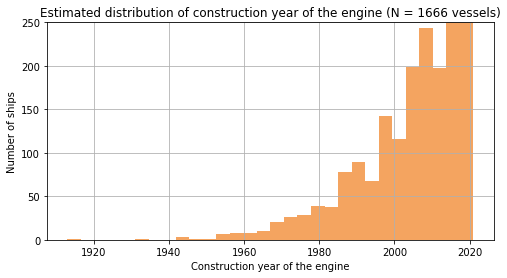

In [105]:
df_ship['c_year'].hist(bins=30, figsize=(8,4), color = 'sandybrown')
plt.ylim(0, 250)
plt.title('Estimated distribution of construction year of the engine (N = 1666 vessels)')
plt.xlabel('Construction year of the engine')
plt.ylabel('Number of ships')

In [106]:
df_ship_old = df_ship[df_ship['c_year'] < 2008]

df_ship_2020 = df_ship[df_ship['c_year'] == 2020]

In [107]:
len(df_ship_old), len(df_ship_2020)

(939, 72)

### 8.1 Motor vessels

#### M2 vessels

In [108]:
df_M2 = df_ship[df_ship['RWS class'] == 'M2']

In [109]:
len(df_M2)

55

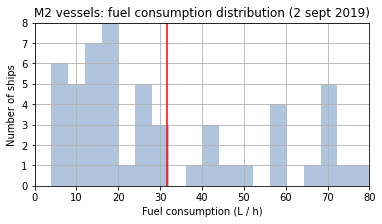

In [110]:
df_M2['fuel_L_h'].hist(bins=20, figsize=(6,3), color = 'lightsteelblue')
plt.xlim(0, 80)
plt.ylim(0, 8)
plt.title('M2 vessels: fuel consumption distribution (2 sept 2019)')
plt.xlabel('Fuel consumption (L / h)')
plt.ylabel('Number of ships')
plt.axvline(df_M2['fuel_L_h'].mean(), 0, 350, color='red')

In [111]:
print('The average fuel consumption of M2 vessels in the dataset is', df_M2.fuel_L_h.mean(), 'L/h')

The average fuel consumption of M2 vessels in the dataset is 31.535256555882874 L/h


In [112]:
df_M2_high = df_M2[df_M2['fuel_L_h'] > 100]

In [113]:
print('The fuel consumptionof M2 vessels above 100 L/h is', len(df_M2_high) / len(df_M2) * 100, 'procent of the total datapoints')

The fuel consumptionof M2 vessels above 100 L/h is 0.0 procent of the total datapoints


In [114]:
print('The average velocity of M2 vessels in the dataset is', df_M2.velocity.mean(), 'm/s, which is', df_M2.velocity.mean() * 3.6, 'km/h')

The average velocity of M2 vessels in the dataset is 3.416691487225092 m/s, which is 12.300089354010332 km/h


#### M3 vessels

In [115]:
df_M3 = df_ship[df_ship['RWS class'] == 'M3']

In [116]:
len(df_M3)

127

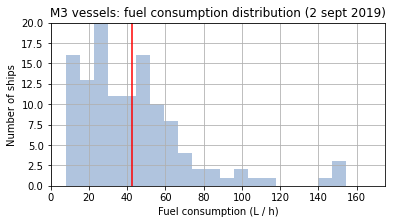

In [117]:
df_M3['fuel_L_h'].hist(bins=20, figsize=(6,3), color = 'lightsteelblue')
plt.xlim(0, 175)
plt.ylim(0, 20)
plt.title('M3 vessels: fuel consumption distribution (2 sept 2019)')
plt.xlabel('Fuel consumption (L / h)')
plt.ylabel('Number of ships')
plt.axvline(df_M3['fuel_L_h'].mean(), 0, 350, color='red')

In [118]:
print('The average fuel consumption of M3 vessels in the dataset is', df_M3.fuel_L_h.mean(), 'L/h')

The average fuel consumption of M3 vessels in the dataset is 42.54181719288827 L/h


In [119]:
print('The average velocity of M3 vessels in the dataset is', df_M3.velocity.mean(), 'm/s, which is', df_M3.velocity.mean() * 3.6, 'km/h')

The average velocity of M3 vessels in the dataset is 3.4551769403520236 m/s, which is 12.438636985267285 km/h


#### M4 vessels

In [120]:
df_M4 = df_ship[df_ship['RWS class'] == 'M4']

In [121]:
len(df_M4)

72

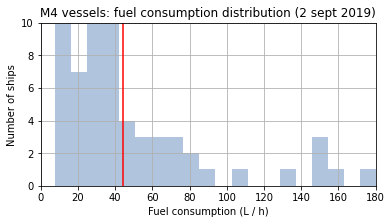

In [122]:
df_M4['fuel_L_h'].hist(bins=20, figsize=(6,3), color = 'lightsteelblue')
plt.xlim(0, 180)
plt.ylim(0, 10)
plt.title('M4 vessels: fuel consumption distribution (2 sept 2019)')
plt.xlabel('Fuel consumption (L / h)')
plt.ylabel('Number of ships')
plt.axvline(df_M4['fuel_L_h'].mean(), 0, 350, color='red')

In [123]:
print('The average fuel consumption of M4 vessels in the dataset is', df_M4.fuel_L_h.mean(), 'L/h')

The average fuel consumption of M4 vessels in the dataset is 44.340734965739216 L/h


In [124]:
print('The average velocity of M4 vessels in the dataset is', df_M4.velocity.mean(), 'm/s, which is', df_M4.velocity.mean() * 3.6, 'km/h')

The average velocity of M4 vessels in the dataset is 3.1833987029954085 m/s, which is 11.46023533078347 km/h


#### M5 vessels

In [125]:
df_M5 = df_ship[df_ship['RWS class'] == 'M5']

In [126]:
len(df_M5)

70

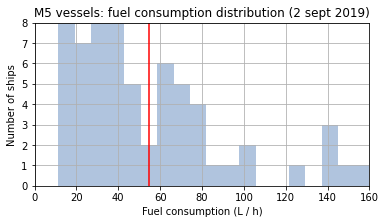

In [127]:
df_M5['fuel_L_h'].hist(bins=20, figsize=(6,3), color = 'lightsteelblue')
plt.xlim(0, 160)
plt.ylim(0, 8)
plt.title('M5 vessels: fuel consumption distribution (2 sept 2019)')
plt.xlabel('Fuel consumption (L / h)')
plt.ylabel('Number of ships')
plt.axvline(df_M5['fuel_L_h'].mean(), 0, 350, color='red')

In [128]:
print('The average fuel consumption of M5 vessels in the dataset is', df_M5.fuel_L_h.mean(), 'L/h')

The average fuel consumption of M5 vessels in the dataset is 54.6143706521135 L/h


In [129]:
print('The average velocity of M5 vessels in the dataset is', df_M5.velocity.mean(), 'm/s, which is', df_M5.velocity.mean() * 3.6, 'km/h')

The average velocity of M5 vessels in the dataset is 3.4779990814524298 m/s, which is 12.520796693228748 km/h


#### M6 vessels

In [130]:
df_M6 = df_ship[df_ship['RWS class'] == 'M6']

In [131]:
len(df_M6)

143

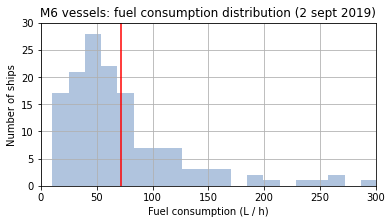

In [132]:
df_M6['fuel_L_h'].hist(bins=20, figsize=(6,3), color = 'lightsteelblue')
plt.xlim(0, 300)
plt.ylim(0, 30)
plt.title('M6 vessels: fuel consumption distribution (2 sept 2019)')
plt.xlabel('Fuel consumption (L / h)')
plt.ylabel('Number of ships')
plt.axvline(df_M6['fuel_L_h'].mean(), 0, 350, color='red')

In [133]:
print('The average fuel consumption of M6 vessels in the dataset is', df_M6.fuel_L_h.mean(), 'L/h')

The average fuel consumption of M6 vessels in the dataset is 72.1311969604026 L/h


In [134]:
print('The average velocity of M6 vessels in the dataset is', df_M6.velocity.mean(), 'm/s, which is', df_M6.velocity.mean() * 3.6, 'km/h')

The average velocity of M6 vessels in the dataset is 3.6092086847023213 m/s, which is 12.993151264928358 km/h


#### M7 vessels

In [135]:
df_M7 = df_ship[df_ship['RWS class'] == 'M7']
len(df_M7)

18

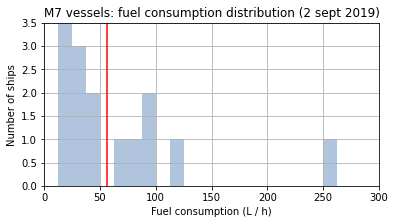

In [136]:
df_M7['fuel_L_h'].hist(bins=20, figsize=(6,3), color = 'lightsteelblue')
plt.xlim(0, 300)
plt.ylim(0, 3.5)
plt.title('M7 vessels: fuel consumption distribution (2 sept 2019)')
plt.xlabel('Fuel consumption (L / h)')
plt.ylabel('Number of ships')
plt.axvline(df_M7['fuel_L_h'].mean(), 0, 350, color='red')

In [137]:
print('The average fuel consumption of M7 vessels in the dataset is', df_M7.fuel_L_h.mean(), 'L/h')

The average fuel consumption of M7 vessels in the dataset is 55.8838569599934 L/h


In [138]:
print('The average velocity of M7 vessels in the dataset is', df_M7.velocity.mean(), 'm/s, which is', df_M7.velocity.mean() * 3.6, 'km/h')

The average velocity of M7 vessels in the dataset is 2.6532742518695906 m/s, which is 9.551787306730526 km/h


#### M8 vessels

In [139]:
df_M8 = df_ship[df_ship['RWS class'] == 'M8']
len(df_M8)

306

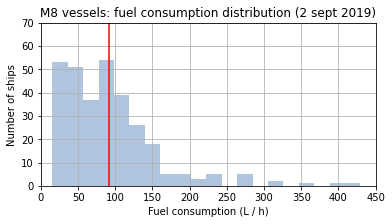

In [140]:
df_M8['fuel_L_h'].hist(bins=20, figsize=(6,3), color = 'lightsteelblue')
plt.xlim(0, 450)
plt.ylim(0, 70)
plt.title('M8 vessels: fuel consumption distribution (2 sept 2019)')
plt.xlabel('Fuel consumption (L / h)')
plt.ylabel('Number of ships')
plt.axvline(df_M8['fuel_L_h'].mean(), 0, 350, color='red')

In [141]:
print('The average fuel consumption of M8 vessels in the dataset is', df_M8.fuel_L_h.mean(), 'L/h')

The average fuel consumption of M8 vessels in the dataset is 91.42091065136816 L/h


In [142]:
print('The average velocity of M8 vessels in the dataset is', df_M8.velocity.mean(), 'm/s, which is', df_M8.velocity.mean() * 3.6, 'km/h')

The average velocity of M8 vessels in the dataset is 3.405767648527486 m/s, which is 12.260763534698949 km/h


#### M9 vessels

In [143]:
df_M9 = df_ship[df_ship['RWS class'] == 'M9']
len(df_M9)

59

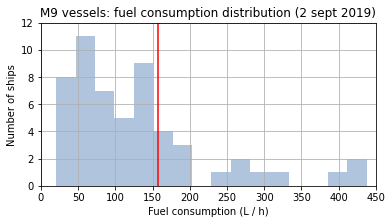

In [144]:
df_M9['fuel_L_h'].hist(bins=20, figsize=(6,3), color = 'lightsteelblue')
plt.xlim(0, 450)
plt.ylim(0, 12)
plt.title('M9 vessels: fuel consumption distribution (2 sept 2019)')
plt.xlabel('Fuel consumption (L / h)')
plt.ylabel('Number of ships')
plt.axvline(df_M9['fuel_L_h'].mean(), 0, 350, color='red')

In [145]:
print('The average fuel consumption of M9 vessels in the dataset is', df_M9.fuel_L_h.mean(), 'L/h')

The average fuel consumption of M9 vessels in the dataset is 157.39640071619792 L/h


In [146]:
print('The average velocity of M9 vessels in the dataset is', df_M9.velocity.mean(), 'm/s, which is', df_M9.velocity.mean() * 3.6, 'km/h')

The average velocity of M9 vessels in the dataset is 3.5348870342976126 m/s, which is 12.725593323471406 km/h


#### M10 vessels

In [147]:
df_M10 = df_ship[df_ship['RWS class'] == 'M10']
len(df_M10)

320

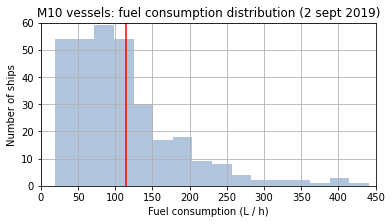

In [148]:
df_M10['fuel_L_h'].hist(bins=20, figsize=(6,3), color = 'lightsteelblue')
plt.xlim(0, 450)
plt.ylim(0, 60)
plt.title('M10 vessels: fuel consumption distribution (2 sept 2019)')
plt.xlabel('Fuel consumption (L / h)')
plt.ylabel('Number of ships')
plt.axvline(df_M10['fuel_L_h'].mean(), 0, 350, color='red')

In [149]:
print('The average fuel consumption of M10 vessels in the dataset is', df_M10.fuel_L_h.mean(), 'L/h')

The average fuel consumption of M10 vessels in the dataset is 114.30534150489139 L/h


In [150]:
print('The average velocity of M10 vessels in the dataset is', df_M10.velocity.mean(), 'm/s, which is', df_M10.velocity.mean() * 3.6, 'km/h')

The average velocity of M10 vessels in the dataset is 3.4173341210881665 m/s, which is 12.3024028359174 km/h


#### M11 vessels

In [151]:
df_M11 = df_ship[df_ship['RWS class'] == 'M11']
len(df_M11)

132

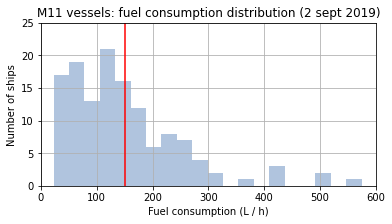

In [152]:
df_M11['fuel_L_h'].hist(bins=20, figsize=(6,3), color = 'lightsteelblue')
plt.xlim(0, 600)
plt.ylim(0, 25)
plt.title('M11 vessels: fuel consumption distribution (2 sept 2019)')
plt.xlabel('Fuel consumption (L / h)')
plt.ylabel('Number of ships')
plt.axvline(df_M11['fuel_L_h'].mean(), 0, 350, color='red')

In [153]:
print('The average fuel consumption of M11 vessels in the dataset is', df_M11.fuel_L_h.mean(), 'L/h')

The average fuel consumption of M11 vessels in the dataset is 150.6855686258228 L/h


In [154]:
print('The average velocity of M11 vessels in the dataset is', df_M11.velocity.mean(), 'm/s, which is', df_M11.velocity.mean() * 3.6, 'km/h')

The average velocity of M11 vessels in the dataset is 3.5883122107105763 m/s, which is 12.917923958558076 km/h


#### M12 vessels

In [155]:
df_M12 = df_ship[df_ship['RWS class'] == 'M12']
len(df_M12)

116

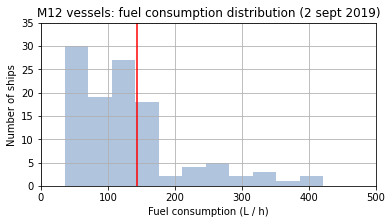

In [156]:
df_M12['fuel_L_h'].hist(bins=20, figsize=(6,3), color = 'lightsteelblue')
plt.xlim(0, 500)
plt.ylim(0, 35)
plt.title('M12 vessels: fuel consumption distribution (2 sept 2019)')
plt.xlabel('Fuel consumption (L / h)')
plt.ylabel('Number of ships')
plt.axvline(df_M12['fuel_L_h'].mean(), 0, 350, color='red')

In [157]:
print('The average fuel consumption of M12 vessels in the dataset is', df_M12.fuel_L_h.mean(), 'L/h')

The average fuel consumption of M12 vessels in the dataset is 144.1740540566826 L/h


In [158]:
print('The average velocity of M12 vessels in the dataset is', df_M12.velocity.mean(), 'm/s, which is', df_M12.velocity.mean() * 3.6, 'km/h')

The average velocity of M12 vessels in the dataset is 3.1489294696954073 m/s, which is 11.336146090903467 km/h


### 8.2 Barges

In [159]:
df_BI = df_ship[df_ship['RWS class'] == 'BI']
len(df_BI)

6

In [160]:
df_B01 = df_ship[df_ship['RWS class'] == 'B01']
len(df_B01)

2

In [161]:
df_B02 = df_ship[df_ship['RWS class'] == 'B02']
len(df_B02)

7

In [162]:
df_B03 = df_ship[df_ship['RWS class'] == 'B03']
len(df_B03)

4

In [163]:
df_B04 = df_ship[df_ship['RWS class'] == 'B04']
len(df_B04)

15

In [164]:
df_BII_6l = df_ship[df_ship['RWS class'] == 'BII-6l']
len(df_BII_6l)

0

#### BII-2l vessels

In [165]:
df_BII_2l = df_ship[df_ship['RWS class'] == 'BII-2l']
len(df_BII_2l)

17

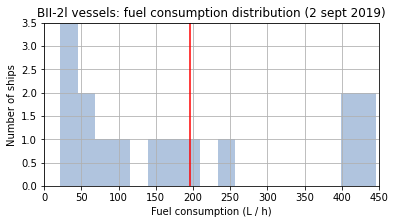

In [166]:
df_BII_2l['fuel_L_h'].hist(bins=20, figsize=(6,3), color = 'lightsteelblue')
plt.xlim(0, 450)
plt.ylim(0, 3.5)
plt.title('BII-2l vessels: fuel consumption distribution (2 sept 2019)')
plt.xlabel('Fuel consumption (L / h)')
plt.ylabel('Number of ships')
plt.axvline(df_BII_2l['fuel_L_h'].mean(), 0, 350, color='red')

In [167]:
print('The average fuel consumption of BII-2l vessels in the dataset is', df_BII_2l.fuel_L_h.mean(), 'L/h')

The average fuel consumption of BII-2l vessels in the dataset is 196.28471679828831 L/h


In [168]:
print('The average velocity of BII-2l vessels in the dataset is', df_BII_2l.velocity.mean(), 'm/s, which is', df_BII_2l.velocity.mean() * 3.6, 'km/h')

The average velocity of BII-2l vessels in the dataset is 3.2066174385350887 m/s, which is 11.54382277872632 km/h


#### BII-2b vessels

In [169]:
df_BII_2b = df_ship[df_ship['RWS class'] == 'BII-2b']
len(df_BII_2b)

38

The average fuel consumption of BII-2b vessels in the dataset is 182.38885660994686 L/h
The average velocity of BII-2b vessels in the dataset is 3.245637111595439 m/s, which is 11.684293601743581 km/h


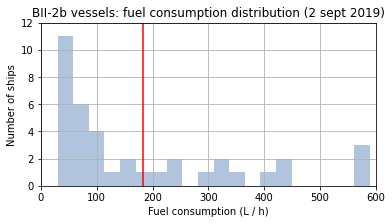

In [170]:
df_BII_2b['fuel_L_h'].hist(bins=20, figsize=(6,3), color = 'lightsteelblue')
plt.xlim(0, 600)
plt.ylim(0, 12)
plt.title('BII-2b vessels: fuel consumption distribution (2 sept 2019)')
plt.xlabel('Fuel consumption (L / h)')
plt.ylabel('Number of ships')
plt.axvline(df_BII_2b['fuel_L_h'].mean(), 0, 350, color='red')

print('The average fuel consumption of BII-2b vessels in the dataset is', df_BII_2b.fuel_L_h.mean(), 'L/h')
print('The average velocity of BII-2b vessels in the dataset is', df_BII_2b.velocity.mean(), 'm/s, which is', df_BII_2b.velocity.mean() * 3.6, 'km/h')

In [171]:
df_BII_4 = df_ship[df_ship['RWS class'] == 'BII-4']
len(df_BII_4)

8

#### BII-1 vessels 

In [172]:
df_BII_1 = df_ship[df_ship['RWS class'] == 'BII-1']
len(df_BII_1)

126

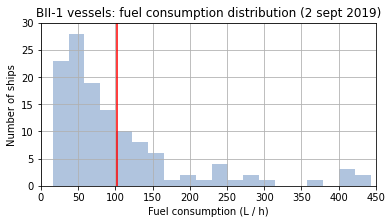

In [173]:
df_BII_1['fuel_L_h'].hist(bins=20, figsize=(6,3), color = 'lightsteelblue')
plt.xlim(0, 450)
plt.ylim(0, 30)
plt.title('BII-1 vessels: fuel consumption distribution (2 sept 2019)')
plt.xlabel('Fuel consumption (L / h)')
plt.ylabel('Number of ships')
plt.axvline(df_BII_1['fuel_L_h'].mean(), 0, 350, color='red')

In [174]:
print('The average fuel consumption of BII-1 vessels in the dataset is', df_BII_1.fuel_L_h.mean(), 'L/h')

The average fuel consumption of BII-1 vessels in the dataset is 102.79230919465876 L/h


In [175]:
print('The average velocity of BII-1 vessels in the dataset is', df_BII_1.velocity.mean(), 'm/s, which is', df_BII_1.velocity.mean() * 3.6, 'km/h')

The average velocity of BII-1 vessels in the dataset is 3.3732516054502195 m/s, which is 12.14370577962079 km/h


#### BII-6b vessels

In [176]:
df_BII_6b = df_ship[df_ship['RWS class'] == 'BII-6b']
len(df_BII_6b)

53

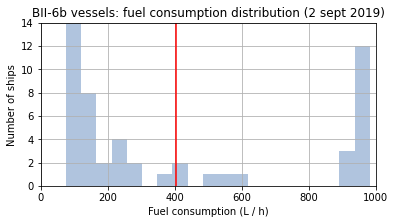

In [177]:
df_BII_6b['fuel_L_h'].hist(bins=20, figsize=(6,3), color = 'lightsteelblue')
plt.xlim(0, 1000)
plt.ylim(0, 14)
plt.title('BII-6b vessels: fuel consumption distribution (2 sept 2019)')
plt.xlabel('Fuel consumption (L / h)')
plt.ylabel('Number of ships')
plt.axvline(df_BII_6b['fuel_L_h'].mean(), 0, 350, color='red')

In [178]:
print('The average fuel consumption of BII-6b vessels in the dataset is', df_BII_6b.fuel_L_h.mean(), 'L/h')

The average fuel consumption of BII-6b vessels in the dataset is 404.5370365692443 L/h


In [179]:
print('The average velocity of BII-6b vessels in the dataset is', df_BII_6b.velocity.mean(), 'm/s, which is', df_BII_6b.velocity.mean() * 3.6, 'km/h')

The average velocity of BII-6b vessels in the dataset is 3.6498449195710316 m/s, which is 13.139441710455714 km/h


### 8.3 Convoys

In [180]:
df_C1l = df_ship[df_ship['RWS class'] == 'C1l']
len(df_C1l)

2

#### C1b 

In [181]:
df_C1b = df_ship[df_ship['RWS class'] == 'C1b']
len(df_C1b)

30

The average fuel consumption of C1b vessels in the dataset is 24.494215738345698 L/h
The average velocity of C1b vessels in the dataset is 3.128403187055397 m/s, which is 11.262251473399429 km/h


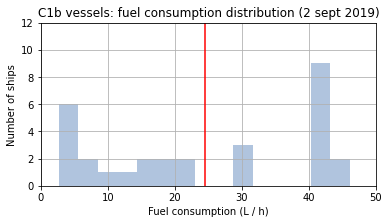

In [182]:
df_C1b['fuel_L_h'].hist(bins=15, figsize=(6,3), color = 'lightsteelblue')
plt.xlim(0, 50)
plt.ylim(0, 12)
plt.title('C1b vessels: fuel consumption distribution (2 sept 2019)')
plt.xlabel('Fuel consumption (L / h)')
plt.ylabel('Number of ships')
plt.axvline(df_C1b['fuel_L_h'].mean(), 0, 350, color='red')

print('The average fuel consumption of C1b vessels in the dataset is', df_C1b.fuel_L_h.mean(), 'L/h')
print('The average velocity of C1b vessels in the dataset is', df_C1b.velocity.mean(), 'm/s, which is', df_C1b.velocity.mean() * 3.6, 'km/h')

In [183]:
df_C2l = df_ship[df_ship['RWS class'] == 'C2l']
len(df_C2l)

13

#### C2b vessels

In [184]:
df_C2b = df_ship[df_ship['RWS class'] == 'C2b']
len(df_C2b)

32

The average fuel consumption of C2b vessels in the dataset is 107.92421993265707 L/h
The average velocity of C2b vessels in the dataset is 3.4826733436453337 m/s, which is 12.537624037123202 km/h


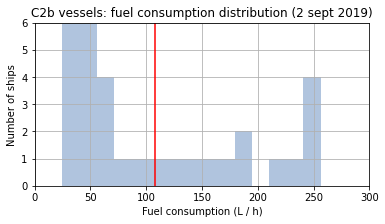

In [185]:
df_C2b['fuel_L_h'].hist(bins=15, figsize=(6,3), color = 'lightsteelblue')
plt.xlim(0, 300)
plt.ylim(0, 6)
plt.title('C2b vessels: fuel consumption distribution (2 sept 2019)')
plt.xlabel('Fuel consumption (L / h)')
plt.ylabel('Number of ships')
plt.axvline(df_C2b['fuel_L_h'].mean(), 0, 350, color='red')

print('The average fuel consumption of C2b vessels in the dataset is', df_C2b.fuel_L_h.mean(), 'L/h')
print('The average velocity of C2b vessels in the dataset is', df_C2b.velocity.mean(), 'm/s, which is', df_C2b.velocity.mean() * 3.6, 'km/h')

#### C3b vessels

In [186]:
df_C3b = df_ship[df_ship['RWS class'] == 'C3b']
len(df_C3b)

23

#### C3l vessels

In [187]:
df_C3l = df_ship[df_ship['RWS class'] == 'C3l']
len(df_C3l)

28

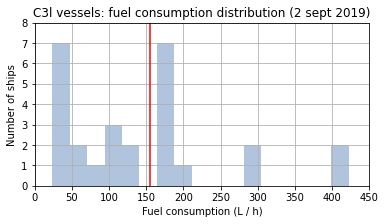

In [188]:
df_C3l['fuel_L_h'].hist(bins=20, figsize=(6,3), color = 'lightsteelblue')
plt.xlim(0, 450)
plt.ylim(0, 8)
plt.title('C3l vessels: fuel consumption distribution (2 sept 2019)')
plt.xlabel('Fuel consumption (L / h)')
plt.ylabel('Number of ships')
plt.axvline(df_C3l['fuel_L_h'].mean(), 0, 350, color='red')

#fig.suptitle('CO2 emission rate versus velocity, for different water depths \n (type = M9, L = 135 m, B = 11.75 m, T = 2.75 m, c_year = 1990)')

In [189]:
print('The average fuel consumption of C3l vessels in the dataset is', df_C3l.fuel_L_h.mean(), 'L/h')

The average fuel consumption of C3l vessels in the dataset is 155.2429610720555 L/h


In [190]:
print('The average velocity of C3l vessels in the dataset is', df_C3l.velocity.mean(), 'm/s, which is', df_C3l.velocity.mean() * 3.6, 'km/h')

The average velocity of C3l vessels in the dataset is 3.221943301130292 m/s, which is 11.598995884069051 km/h


#### C4 vessels

In [191]:
df_C4 = df_ship[df_ship['RWS class'] == 'C4']
len(df_C4)

36

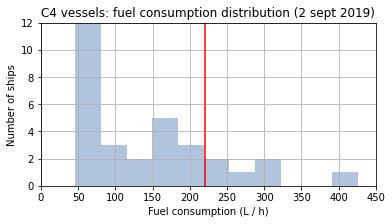

In [192]:
df_C4['fuel_L_h'].hist(bins=20, figsize=(6,3), color = 'lightsteelblue')
plt.xlim(0, 450)
plt.ylim(0, 12)
plt.title('C4 vessels: fuel consumption distribution (2 sept 2019)')
plt.xlabel('Fuel consumption (L / h)')
plt.ylabel('Number of ships')
plt.axvline(df_C4['fuel_L_h'].mean(), 0, 350, color='red')

In [193]:
print('The average fuel consumption of C4 vessels in the dataset is', df_C4.fuel_L_h.mean(), 'L/h')

The average fuel consumption of C4 vessels in the dataset is 220.82665916444637 L/h


In [194]:
print('The average velocity of C4 vessels in the dataset is', df_C4.velocity.mean(), 'm/s, which is', df_C4.velocity.mean() * 3.6, 'km/h')

The average velocity of C4 vessels in the dataset is 3.3243611473457584 m/s, which is 11.967700130444731 km/h
